In [1]:
import numpy as np
import pandas as pd
import wfdb
import numpy as np
import os
import matplotlib.pyplot as plt
from IPython.display import display

In [2]:
import wfdb
import numpy as np
import matplotlib.pyplot as plt
# %matplotlib notebook
%matplotlib inline

In [3]:
import os
files = os.listdir("/home/rishabkhincha/acads/3-2/sop/datasets/apnea-ecg")
len(files)

399

In [11]:
ECGFiles = [] # An List with all the ECG Signal filenames
for root, dirs, files in os.walk("/home/rishabkhincha/acads/3-2/sop/datasets/apnea-ecg"):
    for file in files:
        if file.endswith('.dat'):
            parts = file.split('.')  #split the file using . as separator
            ECGFiles.append(parts[0])  # append only the first part of the file without the extension

In [14]:
len(ECGFiles), ECGFiles

(35,
 ['c02',
  'c08',
  'c09',
  'a09',
  'a08',
  'a10',
  'a04',
  'a14',
  'c06',
  'a19',
  'c05',
  'b05',
  'a06',
  'a20',
  'b03',
  'c10',
  'a17',
  'c03',
  'a05',
  'a01',
  'a02',
  'c01',
  'a13',
  'b01',
  'a15',
  'a18',
  'c04',
  'a03',
  'a07',
  'b02',
  'a12',
  'a11',
  'c07',
  'b04',
  'a16'])

In [13]:
ECGFiles = [item.split('.')[0] for item in files if (item.startswith('a') or item.startswith('b') or item.startswith('c')) and item.endswith('.dat') and not item.endswith('r.dat')]


In [15]:
# !mkdir Labelled
# !cd Labelled

In [16]:
# cd Labelled/

In [17]:
def ECG_Segment(ECG_Signal_file):
    record = wfdb.rdrecord(ECG_Signal_file)
    bfunc = np.asarray(record.p_signal)
    rawECGFunc = []
    for i in range(int(bfunc.size / 6000)-2):
        rawECGFunc.append(bfunc[i*6000:((i*6000)+18000)])
    return rawECGFunc

In [18]:
# Create list containing the data
AllDataSegmented = []
for i in ECGFiles:
    print(i)
    Seg = ECG_Segment("/home/rishabkhincha/acads/3-2/sop/datasets/apnea-ecg/"+i)
    AllDataSegmented.append(Seg)


c02
c08
c09
a09
a08
a10
a04
a14
c06
a19
c05
b05
a06
a20
b03
c10
a17
c03
a05
a01
a02
c01
a13
b01
a15
a18
c04
a03
a07
b02
a12
a11
c07
b04
a16


[[-0.07 ]
 [-0.075]
 [-0.08 ]
 ...
 [-0.045]
 [-0.02 ]
 [-0.015]]


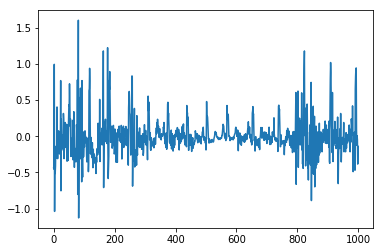

In [20]:
print(AllDataSegmented[1][5])
L = AllDataSegmented[1][5][16000:17000, 0]
plt.plot(L)
plt.show()

In [22]:
import numpy as np
import pandas as pd
from scipy import signal
import matplotlib.pyplot as plt
def sine_generator(fs, sinefreq, duration):
    T = duration
    nsamples = fs * T
    w = 2. * np.pi * sinefreq
    t_sine = np.linspace(0, T, nsamples, endpoint=False)
    y_sine = np.sin(w * t_sine)
    result = pd.DataFrame({ 
        'data' : y_sine} ,index=t_sine)
    return result

#High Pass filter

def butter_highpass(cutoff, fs, order=15):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = signal.butter(order, normal_cutoff, btype='high', analog=False)
    return b, a

def butter_highpass_filter(data, cutoff, fs, order=1):
    b, a = butter_highpass(cutoff, fs, order=order)
    y = signal.filtfilt(b, a, data)
    return y


In [23]:
L = AllDataSegmented[4][3][:18000,0]    

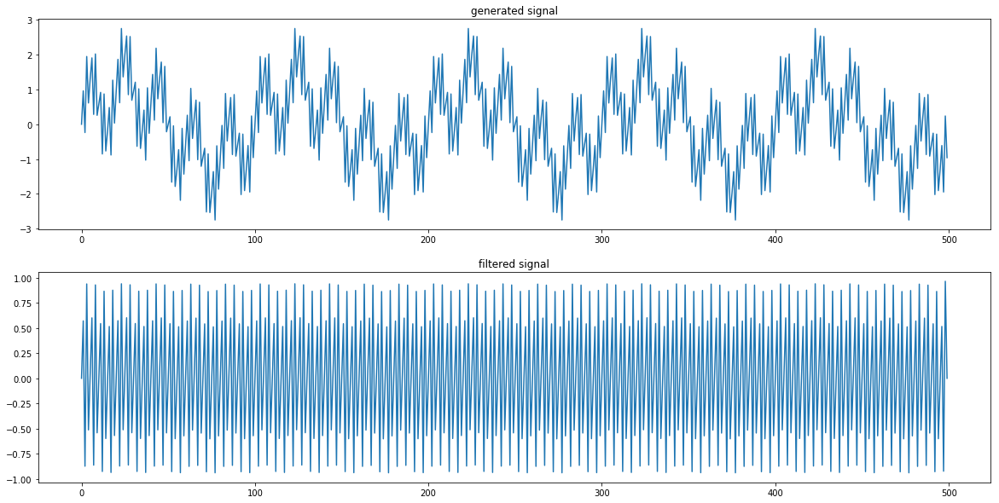

In [24]:
fps = 100
sine_fq = 5 #Hz
duration = 5 #seconds
sine_5Hz = sine_generator(fps,sine_fq,duration)
sine_fq = 1 #Hz
duration = 5 #seconds
sine_1Hz = sine_generator(fps,sine_fq,duration)

sine_fq = 40 #Hz
duration = 5 #seconds
sine_40Hz = sine_generator(fps,sine_fq,duration)

sine = sine_5Hz + sine_1Hz + sine_40Hz

filtered_sine = butter_highpass_filter(sine.data,20,fps)

plt.figure(figsize=(20,10))
plt.subplot(211)
plt.plot(range(len(sine)),sine)
plt.title('generated signal')
plt.subplot(212)
plt.plot(range(len(filtered_sine)),filtered_sine)
plt.title('filtered signal')
plt.show()

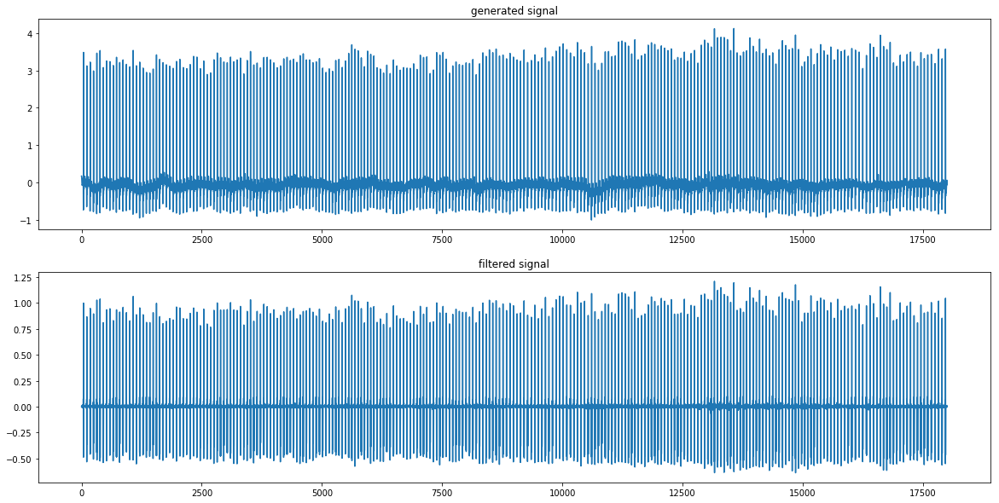

In [16]:
# Filtering using high pass filter to allow any frequency above 0.5 
# should remove respiratory artifacts (0.12Hz to 0.50HZ) ie 8-30 breaths per minute
#### BUT found that 20Hz cut off gave better suppression of non-R peak aspects of the ECG

# Trying data filtering
t_ECG = np.linspace(0,10, 18000, endpoint=False)
ECG = pd.DataFrame({'data' : L}, index=t_ECG)

filtered_ecg = butter_highpass_filter(ECG.data,20,fps)   # 20 here is the 20Hz cutoff

plt.figure(figsize=(20,10))
plt.subplot(211)
plt.plot(range(len(ECG)),ECG)
plt.title('generated signal')
plt.subplot(212)
plt.plot(range(len(filtered_ecg)),filtered_ecg)
plt.title('filtered signal')
plt.show()

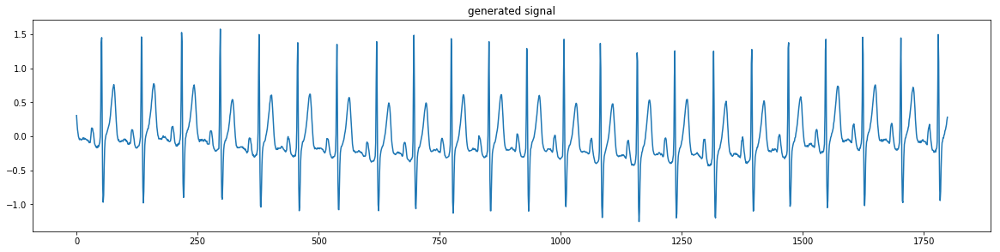

In [17]:
# Plot an example of one of the data segments and its filtered version

plt.figure(figsize=(20,10))
plt.subplot(211)
plt.plot(range(len(AllDataSegmented[16][3][:1800])),AllDataSegmented[16][3][:1800])
plt.title('generated signal')
# plt.subplot(212)
# plt.plot(range(len(AllDataFiltered[16][3])),AllDataFiltered[16][3])
# plt.title('filtered signal')
plt.show()

In [25]:
MidDataSegments = []
for i in AllDataSegmented:
    MidSeg = i[75:(len(i))-75]
    MidDataSegments.append(MidSeg)

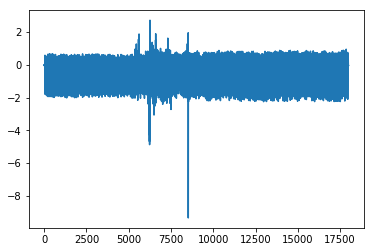

In [26]:
#L = MidDataSegments[0][1][10000:12000,0]
L = MidDataSegments[0][5]
plt.plot(L)
plt.show()

In [20]:
AllDataFiltered = []
t_ECG = np.linspace(0,180, 18000, endpoint=False)    # Setup the index for the dataframe used
for i in MidDataSegments:
    SegmentsFiltered = []
    for j in i:
        TempSig = j[:18000,0]
        ECG = pd.DataFrame({'data' : TempSig}, index=t_ECG)
        filtered_ecg = butter_highpass_filter(ECG.data,20,fps)
        SegmentsFiltered.append(filtered_ecg)
    AllDataFiltered.append(SegmentsFiltered)

In [21]:
pwd

'/home/rishabkhincha/acads/3-2/sop/Labelled'

In [ ]:
#Create pkl file represenation of filtered data (Note it's 2.2GB in size)

import joblib
iterate =0
for i in AllDataFiltered:
    filename = 'AllDataFiltered'
    filenumber = str(iterate)
    fileextension = '.pkl'
    name = filename+filenumber+fileextension
    joblib.dump(AllDataFiltered[iterate], name, compress=3)  
    print(name)
    iterate = iterate + 1


In [27]:
ls

'Apnea ECG.ipynb'          datasets/   git-repos/             train_data.pkl
 create_dataset.ipynb      ECG_IOT/    heartbeat_data.ipynb   Untitled.ipynb
 DataPreProcessing.ipynb   filtered/   sleep_apnea/


In [22]:
# Load pickle file fitlered data

import joblib
iterate = 0
AllDataFilteredTest = []
while iterate < 35:
    filename = 'AllDataFiltered'
    filenumber = str(iterate)
    fileextension = '.pkl'
    name = filename+filenumber+fileextension
    AllDataFilteredTest.append(joblib.load(name))
    iterate = iterate + 1




In [23]:
def RRInterval(SegmentIn):
    overThres = [] 
    mean = SegmentIn.mean()
    std = SegmentIn.std()
    Thres = mean + (2 * std) # use criteria that peaks are at least 2 X std deviation above mean
    print(Thres)
    for i in SegmentIn:
        overThres.append(1*(i>Thres))    # Find those over the threshold 
    overThresnp = np.array(overThres)
    changes = overThresnp[2:18000]-overThresnp[1:17999]
    ndx = []
    for i in range(17998):
        if changes[i] > 0:
            ndx.append(i+2) 
    ndxlen=len(ndx)
    npndx =np.array(ndx)
    RRIntervals = npndx[2:ndxlen]-npndx[1:ndxlen-1]
    lenRR = len(RRIntervals)
    HRs = []
    for i in range(lenRR):
        HRs.append (6000/RRIntervals[i])
    return RRIntervals, HRs

In [24]:
def RRCorrection (RRIntervalValues):
    Anp = np.array(RRIntervalValues)
    Amean = Anp.mean()
    A = RRIntervalValues
    for c in range(len(A)):
        if A[c] > Amean+(Amean/3):
            print(A[c])
            A[c] = Amean
            print(A[c])
        if A[c] < Amean-(Amean/3):
            print(A[c])
            A[c] = Amean
            print(A[c])
    return A

In [25]:
def GetHeartRates (FilteredSig):
    AllHeartRates = []
    AllRRs = []
    SegmentRRs = []
    SegmentHRs = []
    iterate2 = 0
    for j in FilteredSig:
        print("...")
        print(iterate2)
        iterate2 = iterate2 + 1
        TempSig = j[:18000]
        TempRR, TempHR = RRInterval(TempSig)
        TempCorrectedHR = RRCorrection(TempHR)
        TempCorrectedRRInt = RRCorrection(TempRR)
        SegmentHRs.append(TempCorrectedHR)
        SegmentRRs.append(TempCorrectedRRInt)
    AllHeartRates.append(SegmentHRs)
    AllRRs.append(SegmentRRs)
    return AllRRs, AllHeartRates

In [26]:
# These take some time to run
RRa01, HRa01 = GetHeartRates (AllDataFiltered[0])

...
0
0.1639446869699027
72.28915662650603
540.7341510326512
1000.0
540.7341510326512
68.18181818181819
540.7341510326512
1000.0
540.7341510326512
68.96551724137932
540.7341510326512
1000.0
540.7341510326512
68.96551724137932
540.7341510326512
1000.0
540.7341510326512
67.41573033707866
540.7341510326512
1200.0
540.7341510326512
68.18181818181819
540.7341510326512
1000.0
540.7341510326512
73.17073170731707
540.7341510326512
1000.0
540.7341510326512
64.51612903225806
540.7341510326512
1000.0
540.7341510326512
65.93406593406593
540.7341510326512
1000.0
540.7341510326512
63.829787234042556
540.7341510326512
1200.0
540.7341510326512
65.21739130434783
540.7341510326512
1000.0
540.7341510326512
71.42857142857143
540.7341510326512
1000.0
540.7341510326512
65.21739130434783
540.7341510326512
1200.0
540.7341510326512
66.66666666666667
540.7341510326512
1000.0
540.7341510326512
67.41573033707866
540.7341510326512
1000.0
540.7341510326512
68.18181818181819
540.7341510326512
1000.0
540.734151032651

67.41573033707866
535.8240693884742
1000.0
535.8240693884742
67.41573033707866
535.8240693884742
1000.0
535.8240693884742
68.18181818181819
535.8240693884742
1000.0
535.8240693884742
71.42857142857143
535.8240693884742
1000.0
535.8240693884742
67.41573033707866
535.8240693884742
1000.0
535.8240693884742
66.66666666666667
535.8240693884742
1000.0
535.8240693884742
65.21739130434783
535.8240693884742
1000.0
535.8240693884742
65.93406593406593
535.8240693884742
1000.0
535.8240693884742
70.58823529411765
535.8240693884742
1000.0
535.8240693884742
66.66666666666667
535.8240693884742
1000.0
535.8240693884742
67.41573033707866
535.8240693884742
1000.0
535.8240693884742
67.41573033707866
535.8240693884742
1000.0
535.8240693884742
68.18181818181819
535.8240693884742
1000.0
535.8240693884742
66.66666666666667
535.8240693884742
1000.0
535.8240693884742
67.41573033707866
535.8240693884742
1000.0
535.8240693884742
65.93406593406593
535.8240693884742
1200.0
535.8240693884742
67.41573033707866
535.82

538.131563695749
76.92307692307692
538.131563695749
1000.0
538.131563695749
80.0
538.131563695749
1000.0
538.131563695749
2000.0
538.131563695749
117.6470588235294
538.131563695749
1000.0
538.131563695749
146.34146341463415
538.131563695749
176.47058823529412
538.131563695749
1200.0
538.131563695749
77.92207792207792
538.131563695749
1200.0
538.131563695749
81.08108108108108
538.131563695749
1000.0
538.131563695749
82.1917808219178
538.131563695749
1200.0
538.131563695749
84.50704225352112
538.131563695749
1000.0
538.131563695749
2000.0
538.131563695749
90
46
6
46
89
46
6
46
83
46
6
46
87
46
6
46
92
46
5
46
88
46
6
46
84
46
95
46
6
46
88
46
6
46
89
46
6
46
84
46
6
46
85
46
6
46
90
46
6
46
87
46
6
46
88
46
5
46
85
46
6
46
86
46
6
46
87
46
6
46
87
46
6
46
87
46
6
46
85
46
94
46
6
46
89
46
6
46
90
46
5
46
90
46
6
46
84
46
6
46
89
46
6
46
85
46
6
46
88
46
6
46
84
46
6
46
84
46
6
46
83
46
6
46
85
46
6
46
82
46
6
46
81
46
6
46
80
46
6
46
83
46
6
46
87
46
6
46
86
46
6
46
85
46
6
46
89
46
6
46

70.58823529411765
583.8210611926992
1200.0
583.8210611926992
71.42857142857143
583.8210611926992
1200.0
583.8210611926992
75.0
583.8210611926992
69.76744186046511
583.8210611926992
1200.0
583.8210611926992
73.17073170731707
583.8210611926992
1200.0
583.8210611926992
70.58823529411765
583.8210611926992
65.21739130434783
583.8210611926992
1200.0
583.8210611926992
69.76744186046511
583.8210611926992
65.93406593406593
583.8210611926992
66.66666666666667
583.8210611926992
1200.0
583.8210611926992
74.07407407407408
583.8210611926992
1000.0
583.8210611926992
77.92207792207792
583.8210611926992
1000.0
583.8210611926992
76.92307692307692
583.8210611926992
70.58823529411765
583.8210611926992
1000.0
583.8210611926992
71.42857142857143
583.8210611926992
1200.0
583.8210611926992
70.58823529411765
583.8210611926992
1200.0
583.8210611926992
71.42857142857143
583.8210611926992
1000.0
583.8210611926992
72.28915662650603
583.8210611926992
1200.0
583.8210611926992
75.0
583.8210611926992
1000.0
583.821061

1200.0
486.0913459248726
70.58823529411765
486.0913459248726
1200.0
486.0913459248726
75.9493670886076
486.0913459248726
1200.0
486.0913459248726
72.28915662650603
486.0913459248726
65.21739130434783
486.0913459248726
1200.0
486.0913459248726
69.76744186046511
486.0913459248726
1200.0
486.0913459248726
72.28915662650603
486.0913459248726
1000.0
486.0913459248726
75.0
486.0913459248726
1200.0
486.0913459248726
75.0
486.0913459248726
68.96551724137932
486.0913459248726
1000.0
486.0913459248726
69.76744186046511
486.0913459248726
1200.0
486.0913459248726
68.96551724137932
486.0913459248726
1200.0
486.0913459248726
68.96551724137932
486.0913459248726
1200.0
486.0913459248726
72.28915662650603
486.0913459248726
1200.0
486.0913459248726
71.42857142857143
486.0913459248726
1200.0
486.0913459248726
66.66666666666667
486.0913459248726
1200.0
486.0913459248726
68.96551724137932
486.0913459248726
1200.0
486.0913459248726
65.93406593406593
486.0913459248726
1200.0
486.0913459248726
71.428571428571

470.1732331839754
1200.0
470.1732331839754
70.58823529411765
470.1732331839754
1200.0
470.1732331839754
71.42857142857143
470.1732331839754
1200.0
470.1732331839754
72.28915662650603
470.1732331839754
68.96551724137932
470.1732331839754
1000.0
470.1732331839754
68.96551724137932
470.1732331839754
1200.0
470.1732331839754
69.76744186046511
470.1732331839754
63.829787234042556
470.1732331839754
1000.0
470.1732331839754
72.28915662650603
470.1732331839754
1200.0
470.1732331839754
69.76744186046511
470.1732331839754
1000.0
470.1732331839754
65.93406593406593
470.1732331839754
1000.0
470.1732331839754
68.96551724137932
470.1732331839754
61.855670103092784
470.1732331839754
1200.0
470.1732331839754
72.28915662650603
470.1732331839754
68.18181818181819
470.1732331839754
67.41573033707866
470.1732331839754
1200.0
470.1732331839754
71.42857142857143
470.1732331839754
60.60606060606061
470.1732331839754
65.21739130434783
470.1732331839754
64.51612903225806
470.1732331839754
91
55
6
55
85
55
5
55

483.2828821228405
69.76744186046511
483.2828821228405
63.1578947368421
483.2828821228405
1200.0
483.2828821228405
66.66666666666667
483.2828821228405
62.5
483.2828821228405
1200.0
483.2828821228405
71.42857142857143
483.2828821228405
1200.0
483.2828821228405
70.58823529411765
483.2828821228405
1000.0
483.2828821228405
72.28915662650603
483.2828821228405
1200.0
483.2828821228405
71.42857142857143
483.2828821228405
1000.0
483.2828821228405
70.58823529411765
483.2828821228405
1200.0
483.2828821228405
71.42857142857143
483.2828821228405
1200.0
483.2828821228405
68.18181818181819
483.2828821228405
1000.0
483.2828821228405
68.18181818181819
483.2828821228405
1200.0
483.2828821228405
67.41573033707866
483.2828821228405
67.41573033707866
483.2828821228405
68.96551724137932
483.2828821228405
66.66666666666667
483.2828821228405
1000.0
483.2828821228405
68.96551724137932
483.2828821228405
1000.0
483.2828821228405
74.07407407407408
483.2828821228405
1200.0
483.2828821228405
73.17073170731707
483.2

73.17073170731707
492.99889192430163
1000.0
492.99889192430163
70.58823529411765
492.99889192430163
63.829787234042556
492.99889192430163
69.76744186046511
492.99889192430163
1200.0
492.99889192430163
72.28915662650603
492.99889192430163
1200.0
492.99889192430163
74.07407407407408
492.99889192430163
1200.0
492.99889192430163
72.28915662650603
492.99889192430163
67.41573033707866
492.99889192430163
1000.0
492.99889192430163
68.96551724137932
492.99889192430163
1200.0
492.99889192430163
72.28915662650603
492.99889192430163
1000.0
492.99889192430163
73.17073170731707
492.99889192430163
1200.0
492.99889192430163
67.41573033707866
492.99889192430163
63.829787234042556
492.99889192430163
1200.0
492.99889192430163
66.66666666666667
492.99889192430163
1000.0
492.99889192430163
71.42857142857143
492.99889192430163
65.93406593406593
492.99889192430163
1000.0
492.99889192430163
68.18181818181819
492.99889192430163
1200.0
492.99889192430163
66.66666666666667
492.99889192430163
1200.0
492.998891924

511.8951314255645
66.66666666666667
511.8951314255645
1200.0
511.8951314255645
67.41573033707866
511.8951314255645
1200.0
511.8951314255645
68.18181818181819
511.8951314255645
1000.0
511.8951314255645
67.41573033707866
511.8951314255645
1200.0
511.8951314255645
72.28915662650603
511.8951314255645
1200.0
511.8951314255645
70.58823529411765
511.8951314255645
1200.0
511.8951314255645
72.28915662650603
511.8951314255645
1200.0
511.8951314255645
73.17073170731707
511.8951314255645
1000.0
511.8951314255645
68.96551724137932
511.8951314255645
1200.0
511.8951314255645
65.21739130434783
511.8951314255645
1000.0
511.8951314255645
65.93406593406593
511.8951314255645
1000.0
511.8951314255645
68.18181818181819
511.8951314255645
1200.0
511.8951314255645
69.76744186046511
511.8951314255645
62.5
511.8951314255645
1200.0
511.8951314255645
68.18181818181819
511.8951314255645
1000.0
511.8951314255645
68.18181818181819
511.8951314255645
1000.0
511.8951314255645
71.42857142857143
511.8951314255645
68.96551

72.28915662650603
501.59312595624897
1000.0
501.59312595624897
69.76744186046511
501.59312595624897
1000.0
501.59312595624897
75.0
501.59312595624897
63.1578947368421
501.59312595624897
63.1578947368421
501.59312595624897
1200.0
501.59312595624897
67.41573033707866
501.59312595624897
1000.0
501.59312595624897
69.76744186046511
501.59312595624897
64.51612903225806
501.59312595624897
1200.0
501.59312595624897
63.829787234042556
501.59312595624897
1000.0
501.59312595624897
68.18181818181819
501.59312595624897
1200.0
501.59312595624897
64.51612903225806
501.59312595624897
1200.0
501.59312595624897
72.28915662650603
501.59312595624897
1000.0
501.59312595624897
65.93406593406593
501.59312595624897
1000.0
501.59312595624897
72.28915662650603
501.59312595624897
64.51612903225806
501.59312595624897
62.5
501.59312595624897
1200.0
501.59312595624897
73.17073170731707
501.59312595624897
1200.0
501.59312595624897
69.76744186046511
501.59312595624897
66.66666666666667
501.59312595624897
1200.0
501.5

90
54
5
54
85
54
5
54
86
54
88
54
87
54
6
54
85
54
5
54
90
54
6
54
82
54
88
54
6
54
93
54
92
54
5
54
92
54
5
54
82
54
5
54
87
54
5
54
86
54
96
54
88
54
5
54
84
54
93
54
6
54
87
54
5
54
84
54
6
54
84
54
5
54
86
54
97
54
5
54
85
54
92
54
6
54
84
54
5
54
88
54
5
54
92
54
6
54
84
54
91
54
90
54
5
54
89
54
5
54
88
54
5
54
89
54
95
54
5
54
87
54
5
54
96
54
5
54
85
54
6
54
89
54
5
54
86
54
92
54
6
54
92
54
6
54
88
54
6
54
83
54
92
54
96
54
5
54
88
54
6
54
86
54
6
54
84
54
91
54
6
54
91
54
5
54
87
54
93
54
5
54
85
54
5
54
87
54
5
54
92
54
89
54
6
54
83
54
91
54
91
54
5
54
87
54
5
54
84
54
96
54
90
54
98
54
5
54
83
54
6
54
92
54
5
54
84
54
6
54
89
54
6
54
86
54
90
54
6
54
93
54
5
54
89
54
96
54
5
54
83
54
6
54
83
54
6
54
88
54
5
54
88
54
6
54
88
54
5
54
84
54
5
54
...
19
0.20330299079513378
1000.0
502.18707139058927
65.21739130434783
502.18707139058927
1200.0
502.18707139058927
73.17073170731707
502.18707139058927
1000.0
502.18707139058927
70.58823529411765
502.18707139058927
1000.0
502.1870713

493.29483132328005
65.93406593406593
493.29483132328005
1000.0
493.29483132328005
70.58823529411765
493.29483132328005
68.96551724137932
493.29483132328005
1200.0
493.29483132328005
72.28915662650603
493.29483132328005
1200.0
493.29483132328005
70.58823529411765
493.29483132328005
1000.0
493.29483132328005
84
54
93
54
6
54
87
54
5
54
84
54
6
54
84
54
5
54
86
54
97
54
5
54
85
54
92
54
6
54
84
54
5
54
88
54
5
54
92
54
6
54
84
54
91
54
90
54
5
54
89
54
5
54
88
54
5
54
89
54
95
54
5
54
87
54
5
54
96
54
5
54
85
54
6
54
89
54
5
54
86
54
92
54
6
54
92
54
6
54
88
54
6
54
83
54
92
54
96
54
5
54
88
54
6
54
86
54
6
54
84
54
91
54
6
54
91
54
5
54
87
54
93
54
5
54
85
54
5
54
87
54
5
54
92
54
89
54
6
54
83
54
91
54
91
54
5
54
87
54
5
54
84
54
96
54
90
54
98
54
5
54
83
54
6
54
92
54
5
54
84
54
6
54
89
54
6
54
86
54
90
54
6
54
93
54
5
54
89
54
96
54
5
54
83
54
6
54
83
54
6
54
88
54
5
54
88
54
6
54
88
54
5
54
84
54
5
54
90
54
94
54
96
54
5
54
86
54
5
54
84
54
5
54
85
54
93
54
89
54
5
54
82
54
6
54
87
5

53
6
53
84
53
91
53
6
53
86
53
89
53
88
53
91
53
93
53
6
53
88
53
5
53
83
53
6
53
83
53
5
53
86
53
5
53
83
53
6
53
80
53
87
53
5
53
80
53
6
53
77
53
81
53
80
53
80
53
6
53
77
53
5
53
77
53
5
53
77
53
6
53
80
53
88
53
6
53
85
53
6
53
85
53
5
53
87
53
6
53
88
53
6
53
90
53
6
53
90
53
5
53
87
53
5
53
86
53
5
53
91
53
90
53
5
53
86
53
91
53
6
53
83
53
96
53
5
53
88
53
5
53
84
53
5
53
86
53
5
53
86
53
6
53
91
53
5
53
89
53
5
53
84
53
90
53
95
53
6
53
86
53
6
53
84
53
5
53
83
53
90
53
5
53
84
53
5
53
88
53
6
53
81
53
5
53
82
53
6
53
84
53
90
53
5
53
89
53
5
53
82
53
6
53
82
53
6
53
86
53
5
53
87
53
92
53
5
53
83
53
88
53
5
53
84
53
6
53
84
53
6
53
86
53
5
53
84
53
87
53
91
53
6
53
84
53
6
53
84
53
5
53
86
53
6
53
82
53
6
53
82
53
89
53
6
53
85
53
5
53
85
53
6
53
84
53
5
53
82
53
88
53
5
53
84
53
5
53
88
53
6
53
85
53
6
53
84
53
92
53
5
53
87
53
5
53
91
53
85
53
6
53
81
53
6
53
84
53
5
53
83
53
88
53
6
53
82
53
5
53
83
53
6
53
...
23
0.20324300820647442
73.17073170731707
501.3899472083883
100

5
53
95
53
5
53
87
53
5
53
85
53
5
53
83
53
6
53
84
53
6
53
91
53
6
53
83
53
5
53
84
53
6
53
90
53
94
53
6
53
84
53
6
53
84
53
89
53
6
53
...
25
0.20133854283116812
68.18181818181819
501.45710546173547
1000.0
501.45710546173547
69.76744186046511
501.45710546173547
1000.0
501.45710546173547
74.07407407407408
501.45710546173547
65.21739130434783
501.45710546173547
1200.0
501.45710546173547
66.66666666666667
501.45710546173547
63.829787234042556
501.45710546173547
1000.0
501.45710546173547
71.42857142857143
501.45710546173547
1000.0
501.45710546173547
74.07407407407408
501.45710546173547
1000.0
501.45710546173547
69.76744186046511
501.45710546173547
1200.0
501.45710546173547
68.96551724137932
501.45710546173547
1200.0
501.45710546173547
69.76744186046511
501.45710546173547
1000.0
501.45710546173547
72.28915662650603
501.45710546173547
1200.0
501.45710546173547
67.41573033707866
501.45710546173547
1200.0
501.45710546173547
65.93406593406593
501.45710546173547
1200.0
501.45710546173547
64.5

6
55
86
55
5
55
87
55
6
55
84
55
6
55
84
55
5
55
87
55
5
55
87
55
5
55
84
55
6
55
85
55
6
55
85
55
97
55
90
55
89
55
6
55
85
55
5
55
83
55
95
55
6
55
88
55
6
55
88
55
6
55
82
55
5
55
88
55
5
55
95
55
5
55
87
55
5
55
85
55
5
55
83
55
6
55
84
55
6
55
91
55
6
55
83
55
5
55
84
55
6
55
90
55
94
55
6
55
84
55
6
55
84
55
89
55
6
55
89
55
5
55
90
55
91
55
6
55
84
55
6
55
85
55
5
55
87
55
5
55
86
55
91
55
87
55
91
55
5
55
90
55
5
55
86
55
5
55
85
55
5
55
83
55
5
55
85
55
90
55
6
55
82
55
6
55
83
55
5
55
85
55
6
55
90
55
89
55
91
55
95
55
5
55
83
55
5
55
91
55
6
55
81
55
5
55
90
55
5
55
85
55
92
55
6
55
84
55
5
55
83
55
5
55
90
55
6
55
87
55
6
55
89
55
5
55
81
55
5
55
86
55
5
55
85
55
6
55
93
55
5
55
84
55
89
55
5
55
86
55
5
55
85
55
5
55
84
55
88
55
6
55
82
55
5
55
84
55
5
55
86
55
90
55
88
55
6
55
91
55
5
55
83
55
93
55
5
55
83
55
93
55
5
55
89
55
6
55
85
55
6
55
90
55
5
55
83
55
5
55
85
55
5
55
90
55
5
55
88
55
5
55
85
55
88
55
92
55
94
55
6
55
82
55
88
55
89
55
89
55
6
55
85
55
89
55
5
55
83

468.62423327681904
1200.0
468.62423327681904
74.07407407407408
468.62423327681904
67.41573033707866
468.62423327681904
67.41573033707866
468.62423327681904
1200.0
468.62423327681904
66.66666666666667
468.62423327681904
1200.0
468.62423327681904
74.07407407407408
468.62423327681904
1000.0
468.62423327681904
74.07407407407408
468.62423327681904
1000.0
468.62423327681904
69.76744186046511
468.62423327681904
1200.0
468.62423327681904
69.76744186046511
468.62423327681904
1200.0
468.62423327681904
66.66666666666667
468.62423327681904
1200.0
468.62423327681904
74.07407407407408
468.62423327681904
1000.0
468.62423327681904
71.42857142857143
468.62423327681904
1200.0
468.62423327681904
65.21739130434783
468.62423327681904
1200.0
468.62423327681904
70.58823529411765
468.62423327681904
1000.0
468.62423327681904
65.93406593406593
468.62423327681904
1200.0
468.62423327681904
72.28915662650603
468.62423327681904
1200.0
468.62423327681904
72.28915662650603
468.62423327681904
1000.0
468.62423327681904

73.17073170731707
499.9564655069968
68.96551724137932
499.9564655069968
1000.0
499.9564655069968
74.07407407407408
499.9564655069968
65.93406593406593
499.9564655069968
1000.0
499.9564655069968
65.93406593406593
499.9564655069968
1000.0
499.9564655069968
67.41573033707866
499.9564655069968
1200.0
499.9564655069968
72.28915662650603
499.9564655069968
66.66666666666667
499.9564655069968
61.224489795918366
499.9564655069968
65.93406593406593
499.9564655069968
1000.0
499.9564655069968
64.51612903225806
499.9564655069968
1200.0
499.9564655069968
71.42857142857143
499.9564655069968
1200.0
499.9564655069968
66.66666666666667
499.9564655069968
1000.0
499.9564655069968
71.42857142857143
499.9564655069968
1000.0
499.9564655069968
68.96551724137932
499.9564655069968
1000.0
499.9564655069968
73.17073170731707
499.9564655069968
1000.0
499.9564655069968
68.18181818181819
499.9564655069968
63.829787234042556
499.9564655069968
64.51612903225806
499.9564655069968
67.41573033707866
499.9564655069968
120

1000.0
523.4780308368717
73.17073170731707
523.4780308368717
1000.0
523.4780308368717
68.96551724137932
523.4780308368717
1200.0
523.4780308368717
73.17073170731707
523.4780308368717
1000.0
523.4780308368717
74.07407407407408
523.4780308368717
1200.0
523.4780308368717
72.28915662650603
523.4780308368717
67.41573033707866
523.4780308368717
1000.0
523.4780308368717
70.58823529411765
523.4780308368717
1200.0
523.4780308368717
75.0
523.4780308368717
1200.0
523.4780308368717
74.07407407407408
523.4780308368717
1000.0
523.4780308368717
75.0
523.4780308368717
1000.0
523.4780308368717
72.28915662650603
523.4780308368717
1200.0
523.4780308368717
73.17073170731707
523.4780308368717
70.58823529411765
523.4780308368717
1200.0
523.4780308368717
71.42857142857143
523.4780308368717
1200.0
523.4780308368717
72.28915662650603
523.4780308368717
1000.0
523.4780308368717
67.41573033707866
523.4780308368717
65.21739130434783
523.4780308368717
1000.0
523.4780308368717
74.07407407407408
523.4780308368717
100

52
5
52
85
52
5
52
85
52
6
52
87
52
6
52
83
52
89
52
6
52
85
52
6
52
90
52
89
52
88
52
6
52
86
52
6
52
86
52
6
52
84
52
88
52
6
52
83
52
6
52
83
52
6
52
88
52
5
52
80
52
87
52
6
52
83
52
5
52
84
52
88
52
6
52
81
52
5
52
83
52
89
52
95
52
5
52
82
52
5
52
83
52
92
52
5
52
85
52
5
52
90
52
6
52
79
52
6
52
88
52
6
52
82
52
6
52
87
52
5
52
82
52
91
52
6
52
...
34
0.2020615637596798
70.58823529411765
501.126012454239
68.96551724137932
501.126012454239
1000.0
501.126012454239
74.07407407407408
501.126012454239
1200.0
501.126012454239
73.17073170731707
501.126012454239
1200.0
501.126012454239
72.28915662650603
501.126012454239
1200.0
501.126012454239
73.17073170731707
501.126012454239
69.76744186046511
501.126012454239
1000.0
501.126012454239
73.17073170731707
501.126012454239
68.96551724137932
501.126012454239
1200.0
501.126012454239
66.66666666666667
501.126012454239
1000.0
501.126012454239
77.92207792207792
501.126012454239
1000.0
501.126012454239
74.07407407407408
501.126012454239
68.96551

5
52
84
52
91
52
5
52
84
52
6
52
80
52
89
52
6
52
83
52
6
52
88
52
5
52
81
52
6
52
85
52
6
52
89
52
93
52
5
52
84
52
5
52
83
52
93
52
5
52
84
52
5
52
86
52
87
52
6
52
85
52
5
52
86
52
6
52
86
52
6
52
82
52
91
52
91
52
6
52
93
52
90
52
5
52
85
52
5
52
84
52
91
52
5
52
84
52
90
52
88
52
89
52
90
52
5
52
92
52
5
52
84
52
86
52
6
52
89
52
5
52
86
52
90
52
6
52
86
52
5
52
83
52
6
52
88
52
5
52
85
52
6
52
83
52
88
52
5
52
82
52
90
52
90
52
6
52
82
52
87
52
94
52
5
52
87
52
5
52
87
52
5
52
81
52
6
52
85
52
5
52
86
52
5
52
88
52
5
52
83
52
6
52
84
52
6
52
87
52
5
52
87
52
5
52
83
52
6
52
82
52
5
52
84
52
6
52
89
52
89
52
5
52
83
52
5
52
86
52
91
52
6
52
87
52
6
52
82
52
6
52
82
52
5
52
82
52
88
52
5
52
88
52
5
52
80
52
6
52
82
52
5
52
85
52
5
52
86
52
5
52
87
52
5
52
81
52
87
52
6
52
85
52
5
52
85
52
5
52
86
52
6
52
79
52
5
52
79
52
6
52
81
52
6
52
82
52
5
52
85
52
5
52
81
52
5
52
81
52
90
52
6
52
83
52
6
52
85
52
5
52
81
52
89
52
6
52
87
52
5
52
87
52
6
52
85
52
6
52
...
36
0.2017795860332040

85
52
6
52
81
52
90
52
5
52
82
52
6
52
84
52
87
52
87
52
5
52
86
52
5
52
86
52
92
52
93
52
87
52
5
52
88
52
5
52
89
52
5
52
89
52
90
52
90
52
6
52
87
52
91
52
6
52
88
52
5
52
84
52
5
52
87
52
5
52
85
52
6
52
88
52
5
52
84
52
87
52
93
52
91
52
6
52
88
52
5
52
83
52
5
52
84
52
5
52
87
52
90
52
6
52
84
52
6
52
79
52
87
52
5
52
81
52
6
52
87
52
88
52
6
52
84
52
5
52
86
52
6
52
91
52
5
52
86
52
6
52
90
52
6
52
80
52
6
52
85
52
5
52
85
52
93
52
6
52
83
52
89
52
6
52
89
52
5
52
88
52
95
52
90
52
95
52
5
52
90
52
6
52
90
52
6
52
85
52
5
52
83
52
5
52
86
52
90
52
5
52
87
52
5
52
81
52
6
52
82
52
6
52
84
52
97
52
5
52
86
52
97
52
88
52
5
52
84
52
5
52
86
52
6
52
84
52
6
52
85
52
89
52
5
52
87
52
5
52
86
52
6
52
85
52
87
52
87
52
89
52
6
52
83
52
6
52
87
52
86
52
5
52
83
52
89
52
5
52
91
52
5
52
82
52
6
52
83
52
5
52
88
52
6
52
86
52
6
52
85
52
87
52
88
52
5
52
84
52
6
52
86
52
5
52
83
52
5
52
83
52
90
52
92
52
91
52
6
52
80
52
5
52
80
52
88
52
89
52
5
52
82
52
5
52
81
52
5
52
83
52
5
52
87
52
5


51
5
51
91
51
5
51
89
51
6
51
86
51
5
51
85
51
6
51
89
51
5
51
87
51
6
51
84
51
91
51
5
51
88
51
5
51
86
51
91
51
87
51
6
51
83
51
5
51
85
51
90
51
5
51
81
51
6
51
82
51
6
51
82
51
6
51
88
51
5
51
80
51
86
51
88
51
5
51
83
51
88
51
86
51
6
51
80
51
88
51
5
51
84
51
5
51
81
51
6
51
80
51
6
51
82
51
6
51
84
51
5
51
84
51
5
51
84
51
5
51
82
51
87
51
6
51
86
51
6
51
82
51
5
51
82
51
5
51
82
51
5
51
85
51
5
51
83
51
92
51
6
51
81
51
89
51
5
51
87
51
88
51
6
51
85
51
5
51
80
51
5
51
82
51
5
51
84
51
90
51
5
51
82
51
86
51
6
51
83
51
5
51
83
51
6
51
90
51
5
51
82
51
5
51
87
51
6
51
88
51
5
51
90
51
89
51
91
51
5
51
86
51
5
51
86
51
90
51
6
51
82
51
5
51
86
51
98
51
5
51
85
51
5
51
85
51
5
51
92
51
5
51
84
51
92
51
5
51
82
51
6
51
81
51
6
51
85
51
5
51
85
51
6
51
85
51
5
51
83
51
5
51
85
51
6
51
90
51
90
51
6
51
83
51
6
51
82
51
5
51
83
51
...
40
0.20111214674440764
68.96551724137932
514.0969919361477
1200.0
514.0969919361477
72.28915662650603
514.0969919361477
1200.0
514.0969919361477
71.4285

52
6
52
88
52
5
52
90
52
89
52
91
52
5
52
86
52
5
52
86
52
90
52
88
52
5
52
86
52
98
52
5
52
85
52
5
52
85
52
5
52
92
52
5
52
84
52
92
52
5
52
82
52
6
52
81
52
6
52
85
52
5
52
85
52
6
52
85
52
5
52
83
52
5
52
85
52
6
52
90
52
90
52
6
52
83
52
6
52
82
52
5
52
83
52
6
52
86
52
5
52
84
52
89
52
5
52
81
52
5
52
84
52
91
52
5
52
83
52
5
52
82
52
87
52
5
52
82
52
87
52
86
52
86
52
88
52
5
52
84
52
6
52
83
52
88
52
5
52
81
52
6
52
82
52
92
52
5
52
91
52
5
52
79
52
5
52
82
52
5
52
85
52
5
52
89
52
6
52
88
52
5
52
83
52
6
52
86
52
100
52
5
52
88
52
6
52
91
52
5
52
85
52
5
52
87
52
94
52
5
52
87
52
5
52
84
52
91
52
6
52
89
52
5
52
85
52
6
52
85
52
5
52
84
52
92
52
5
52
85
52
88
52
89
52
5
52
82
52
6
52
84
52
6
52
82
52
5
52
81
52
6
52
81
52
6
52
84
52
5
52
83
52
5
52
82
52
5
52
83
52
5
52
85
52
89
52
91
52
5
52
83
52
5
52
84
52
91
52
94
52
88
52
5
52
84
52
90
52
5
52
84
52
6
52
88
52
5
52
83
52
6
52
85
52
92
52
6
52
84
52
6
52
85
52
5
52
82
52
88
52
6
52
83
52
6
52
85
52
91
52
5
52
83
52
90
52
5

73.17073170731707
508.06319119113965
1000.0
508.06319119113965
72.28915662650603
508.06319119113965
1200.0
508.06319119113965
71.42857142857143
508.06319119113965
1200.0
508.06319119113965
73.17073170731707
508.06319119113965
67.41573033707866
508.06319119113965
1000.0
508.06319119113965
72.28915662650603
508.06319119113965
1000.0
508.06319119113965
67.41573033707866
508.06319119113965
1200.0
508.06319119113965
72.28915662650603
508.06319119113965
1000.0
508.06319119113965
73.17073170731707
508.06319119113965
67.41573033707866
508.06319119113965
1200.0
508.06319119113965
72.28915662650603
508.06319119113965
1200.0
508.06319119113965
68.96551724137932
508.06319119113965
69.76744186046511
508.06319119113965
68.96551724137932
508.06319119113965
66.66666666666667
508.06319119113965
1200.0
508.06319119113965
71.42857142857143
508.06319119113965
1000.0
508.06319119113965
66.66666666666667
508.06319119113965
1000.0
508.06319119113965
74.07407407407408
508.06319119113965
66.66666666666667
508.

1000.0
516.5273411644386
71.42857142857143
516.5273411644386
1200.0
516.5273411644386
71.42857142857143
516.5273411644386
68.96551724137932
516.5273411644386
1000.0
516.5273411644386
72.28915662650603
516.5273411644386
65.93406593406593
516.5273411644386
1200.0
516.5273411644386
69.76744186046511
516.5273411644386
1200.0
516.5273411644386
74.07407407407408
516.5273411644386
1000.0
516.5273411644386
75.0
516.5273411644386
1000.0
516.5273411644386
73.17073170731707
516.5273411644386
1200.0
516.5273411644386
73.17073170731707
516.5273411644386
1000.0
516.5273411644386
68.96551724137932
516.5273411644386
67.41573033707866
516.5273411644386
1200.0
516.5273411644386
73.17073170731707
516.5273411644386
1200.0
516.5273411644386
74.07407407407408
516.5273411644386
1000.0
516.5273411644386
69.76744186046511
516.5273411644386
65.21739130434783
516.5273411644386
1200.0
516.5273411644386
74.07407407407408
516.5273411644386
1200.0
516.5273411644386
73.17073170731707
516.5273411644386
1200.0
516.5273

98
51
5
51
83
51
89
51
6
51
84
51
90
51
...
47
0.20172135348580741
69.76744186046511
500.394294421117
1200.0
500.394294421117
73.17073170731707
500.394294421117
1200.0
500.394294421117
74.07407407407408
500.394294421117
1000.0
500.394294421117
71.42857142857143
500.394294421117
1200.0
500.394294421117
70.58823529411765
500.394294421117
1000.0
500.394294421117
72.28915662650603
500.394294421117
1200.0
500.394294421117
75.0
500.394294421117
1000.0
500.394294421117
72.28915662650603
500.394294421117
1000.0
500.394294421117
71.42857142857143
500.394294421117
1000.0
500.394294421117
71.42857142857143
500.394294421117
1200.0
500.394294421117
72.28915662650603
500.394294421117
1200.0
500.394294421117
73.17073170731707
500.394294421117
1200.0
500.394294421117
72.28915662650603
500.394294421117
1200.0
500.394294421117
70.58823529411765
500.394294421117
1200.0
500.394294421117
73.17073170731707
500.394294421117
1000.0
500.394294421117
73.17073170731707
500.394294421117
63.829787234042556
500.394

1000.0
493.7827223893668
72.28915662650603
493.7827223893668
1200.0
493.7827223893668
66.66666666666667
493.7827223893668
1200.0
493.7827223893668
73.17073170731707
493.7827223893668
1200.0
493.7827223893668
71.42857142857143
493.7827223893668
1200.0
493.7827223893668
70.58823529411765
493.7827223893668
62.5
493.7827223893668
1200.0
493.7827223893668
69.76744186046511
493.7827223893668
1200.0
493.7827223893668
74.07407407407408
493.7827223893668
69.76744186046511
493.7827223893668
1000.0
493.7827223893668
73.17073170731707
493.7827223893668
1000.0
493.7827223893668
69.76744186046511
493.7827223893668
1200.0
493.7827223893668
72.28915662650603
493.7827223893668
1200.0
493.7827223893668
73.17073170731707
493.7827223893668
1000.0
493.7827223893668
70.58823529411765
493.7827223893668
1200.0
493.7827223893668
70.58823529411765
493.7827223893668
1200.0
493.7827223893668
69.76744186046511
493.7827223893668
1200.0
493.7827223893668
71.42857142857143
493.7827223893668
69.76744186046511
493.7827

87
53
5
53
80
53
88
53
91
53
90
53
5
53
80
53
5
53
82
53
5
53
84
53
88
53
91
53
6
53
79
53
6
53
81
53
5
53
85
53
95
53
6
53
87
53
6
53
84
53
6
53
86
53
5
53
89
53
5
53
89
53
94
53
5
53
84
53
89
53
6
53
85
53
6
53
84
53
5
53
81
53
6
53
82
53
6
53
83
53
6
53
86
53
5
53
82
53
6
53
81
53
5
53
83
53
5
53
83
53
88
53
86
53
86
53
5
53
82
53
89
53
6
53
84
53
5
53
82
53
89
53
5
53
83
53
5
53
85
53
92
53
5
53
80
53
6
53
84
53
92
53
94
53
6
53
82
53
5
53
84
53
6
53
86
53
6
53
84
53
91
53
6
53
82
53
6
53
85
53
5
53
85
53
91
53
5
53
84
53
5
53
81
53
88
53
89
53
6
53
86
53
89
53
87
53
91
53
94
53
94
53
5
53
84
53
94
53
6
53
88
53
5
53
88
53
5
53
83
53
6
53
83
53
90
53
6
53
84
53
6
53
84
53
87
53
5
53
85
53
91
53
93
53
5
53
81
53
6
53
81
53
88
53
88
53
6
53
84
53
88
53
88
53
91
53
5
53
87
53
5
53
84
53
87
53
5
53
82
53
5
53
83
53
5
53
85
53
5
53
84
53
5
53
83
53
5
53
83
53
5
53
83
53
92
53
5
53
81
53
6
53
80
53
5
53
88
53
94
53
5
53
89
53
6
53
87
53
89
53
98
53
5
53
89
53
5
53
89
53
6
53
82
53
6
53
8

67.41573033707866
508.01434954744235
1000.0
508.01434954744235
68.96551724137932
508.01434954744235
67.41573033707866
508.01434954744235
61.224489795918366
508.01434954744235
1200.0
508.01434954744235
67.41573033707866
508.01434954744235
1200.0
508.01434954744235
67.41573033707866
508.01434954744235
1000.0
508.01434954744235
73.17073170731707
508.01434954744235
1000.0
508.01434954744235
69.76744186046511
508.01434954744235
63.1578947368421
508.01434954744235
64.51612903225806
508.01434954744235
1200.0
508.01434954744235
72.28915662650603
508.01434954744235
1200.0
508.01434954744235
72.28915662650603
508.01434954744235
66.66666666666667
508.01434954744235
65.21739130434783
508.01434954744235
1200.0
508.01434954744235
71.42857142857143
508.01434954744235
1000.0
508.01434954744235
73.17073170731707
508.01434954744235
1200.0
508.01434954744235
74.07407407407408
508.01434954744235
1000.0
508.01434954744235
72.28915662650603
508.01434954744235
1200.0
508.01434954744235
71.42857142857143
508.

1200.0
496.15384500545883
71.42857142857143
496.15384500545883
1200.0
496.15384500545883
70.58823529411765
496.15384500545883
1200.0
496.15384500545883
70.58823529411765
496.15384500545883
1200.0
496.15384500545883
74.07407407407408
496.15384500545883
1000.0
496.15384500545883
74.07407407407408
496.15384500545883
1200.0
496.15384500545883
72.28915662650603
496.15384500545883
67.41573033707866
496.15384500545883
1000.0
496.15384500545883
73.17073170731707
496.15384500545883
1200.0
496.15384500545883
71.42857142857143
496.15384500545883
1200.0
496.15384500545883
74.07407407407408
496.15384500545883
68.18181818181819
496.15384500545883
1200.0
496.15384500545883
70.58823529411765
496.15384500545883
1000.0
496.15384500545883
65.93406593406593
496.15384500545883
68.96551724137932
496.15384500545883
65.21739130434783
496.15384500545883
1000.0
496.15384500545883
68.96551724137932
496.15384500545883
1000.0
496.15384500545883
66.66666666666667
496.15384500545883
66.66666666666667
496.15384500545

52
6
52
80
52
5
52
84
52
6
52
87
52
5
52
85
52
91
52
6
52
...
54
0.20049309058615306
63.829787234042556
522.853483931323
1200.0
522.853483931323
71.42857142857143
522.853483931323
1000.0
522.853483931323
73.17073170731707
522.853483931323
68.96551724137932
522.853483931323
67.41573033707866
522.853483931323
1200.0
522.853483931323
72.28915662650603
522.853483931323
64.51612903225806
522.853483931323
1200.0
522.853483931323
75.0
522.853483931323
67.41573033707866
522.853483931323
67.41573033707866
522.853483931323
1200.0
522.853483931323
71.42857142857143
522.853483931323
1000.0
522.853483931323
74.07407407407408
522.853483931323
1200.0
522.853483931323
72.28915662650603
522.853483931323
1200.0
522.853483931323
69.76744186046511
522.853483931323
1000.0
522.853483931323
70.58823529411765
522.853483931323
1000.0
522.853483931323
71.42857142857143
522.853483931323
68.96551724137932
522.853483931323
66.66666666666667
522.853483931323
1200.0
522.853483931323
68.96551724137932
522.85348393132

72.28915662650603
496.41056450417375
64.51612903225806
496.41056450417375
1200.0
496.41056450417375
70.58823529411765
496.41056450417375
1000.0
496.41056450417375
68.96551724137932
496.41056450417375
69.76744186046511
496.41056450417375
1000.0
496.41056450417375
69.76744186046511
496.41056450417375
1200.0
496.41056450417375
66.66666666666667
496.41056450417375
1200.0
496.41056450417375
69.76744186046511
496.41056450417375
68.18181818181819
496.41056450417375
1200.0
496.41056450417375
73.17073170731707
496.41056450417375
1200.0
496.41056450417375
71.42857142857143
496.41056450417375
1200.0
496.41056450417375
70.58823529411765
496.41056450417375
68.18181818181819
496.41056450417375
1200.0
496.41056450417375
75.0
496.41056450417375
68.96551724137932
496.41056450417375
68.18181818181819
496.41056450417375
1000.0
496.41056450417375
70.58823529411765
496.41056450417375
1200.0
496.41056450417375
73.17073170731707
496.41056450417375
1000.0
496.41056450417375
74.07407407407408
496.4105645041737

82
53
...
58
0.20423989163012324
75.9493670886076
497.4076492762607
1000.0
497.4076492762607
74.07407407407408
497.4076492762607
1200.0
497.4076492762607
72.28915662650603
497.4076492762607
1200.0
497.4076492762607
72.28915662650603
497.4076492762607
1200.0
497.4076492762607
73.17073170731707
497.4076492762607
1000.0
497.4076492762607
75.0
497.4076492762607
71.42857142857143
497.4076492762607
1000.0
497.4076492762607
75.9493670886076
497.4076492762607
1000.0
497.4076492762607
75.0
497.4076492762607
1000.0
497.4076492762607
74.07407407407408
497.4076492762607
1000.0
497.4076492762607
73.17073170731707
497.4076492762607
1200.0
497.4076492762607
75.9493670886076
497.4076492762607
1200.0
497.4076492762607
75.9493670886076
497.4076492762607
1200.0
497.4076492762607
74.07407407407408
497.4076492762607
1200.0
497.4076492762607
74.07407407407408
497.4076492762607
1000.0
497.4076492762607
75.0
497.4076492762607
1200.0
497.4076492762607
75.0
497.4076492762607
1200.0
497.4076492762607
76.92307692

53
81
53
85
53
86
53
87
53
5
53
81
53
5
53
77
53
6
53
75
53
6
53
73
53
5
53
5
53
74
53
6
53
90
53
95
53
5
53
88
53
5
53
89
53
5
53
94
53
5
53
94
53
5
53
94
53
96
53
6
53
88
53
93
53
5
53
88
53
94
53
6
53
86
53
90
53
5
53
85
53
5
53
83
53
5
53
82
53
6
53
81
53
86
53
6
53
82
53
91
53
5
53
85
53
5
53
85
53
5
53
85
53
6
53
84
53
5
53
88
53
5
53
85
53
5
53
84
53
6
53
86
53
5
53
86
53
93
53
5
53
88
53
6
53
87
53
5
53
94
53
6
53
84
53
5
53
89
53
90
53
94
53
5
53
87
53
94
53
6
53
...
60
0.2018828127737203
65.93406593406593
507.0106664489966
1200.0
507.0106664489966
74.07407407407408
507.0106664489966
1200.0
507.0106664489966
71.42857142857143
507.0106664489966
65.93406593406593
507.0106664489966
1000.0
507.0106664489966
68.18181818181819
507.0106664489966
1200.0
507.0106664489966
70.58823529411765
507.0106664489966
64.51612903225806
507.0106664489966
68.96551724137932
507.0106664489966
1000.0
507.0106664489966
67.41573033707866
507.0106664489966
1200.0
507.0106664489966
68.96551724137932
507.0

52
98
52
5
52
86
52
6
52
88
52
5
52
87
52
5
52
86
52
6
52
88
52
5
52
87
52
5
52
86
52
90
52
5
52
87
52
92
52
6
52
87
52
5
52
87
52
90
52
93
52
91
52
6
52
85
52
91
52
5
52
89
52
6
52
88
52
5
52
86
52
5
52
86
52
92
52
5
52
88
52
6
52
84
52
5
52
83
52
5
52
85
52
89
52
6
52
87
52
88
52
5
52
88
52
92
52
94
52
90
52
5
52
85
52
5
52
85
52
5
52
83
52
5
52
82
52
86
52
5
52
82
52
5
52
82
52
88
52
86
52
85
52
87
52
87
52
5
52
81
52
85
52
6
52
80
52
86
52
87
52
5
52
80
52
5
52
79
52
5
52
79
52
5
52
79
52
6
52
81
52
5
52
82
52
6
52
82
52
5
52
83
52
5
52
87
52
5
52
88
52
5
52
86
52
5
52
84
52
6
52
86
52
5
52
87
52
91
52
5
52
83
52
5
52
88
52
5
52
87
52
5
52
84
52
5
52
86
52
5
52
86
52
6
52
89
52
5
52
87
52
5
52
87
52
93
52
5
52
84
52
6
52
85
52
5
52
87
52
6
52
86
52
89
52
96
52
5
52
89
52
90
52
91
52
92
52
6
52
86
52
6
52
83
52
6
52
84
52
92
52
92
52
6
52
88
52
5
52
85
52
6
52
83
52
5
52
85
52
6
52
84
52
5
52
84
52
6
52
82
52
5
52
82
52
5
52
83
52
89
52
5
52
85
52
90
52
6
52
82
52
91
52
5
52
86
52
5

1200.0
495.84131577489774
72.28915662650603
495.84131577489774
1200.0
495.84131577489774
71.42857142857143
495.84131577489774
1200.0
495.84131577489774
72.28915662650603
495.84131577489774
67.41573033707866
495.84131577489774
1200.0
495.84131577489774
70.58823529411765
495.84131577489774
1200.0
495.84131577489774
68.96551724137932
495.84131577489774
65.93406593406593
495.84131577489774
1200.0
495.84131577489774
73.17073170731707
495.84131577489774
1000.0
495.84131577489774
69.76744186046511
495.84131577489774
1200.0
495.84131577489774
71.42857142857143
495.84131577489774
1200.0
495.84131577489774
70.58823529411765
495.84131577489774
1000.0
495.84131577489774
73.17073170731707
495.84131577489774
1000.0
495.84131577489774
73.17073170731707
495.84131577489774
1000.0
495.84131577489774
73.17073170731707
495.84131577489774
1000.0
495.84131577489774
74.07407407407408
495.84131577489774
68.18181818181819
495.84131577489774
69.76744186046511
495.84131577489774
69.76744186046511
495.84131577489

73.17073170731707
502.73170699524803
67.41573033707866
502.73170699524803
1200.0
502.73170699524803
72.28915662650603
502.73170699524803
1000.0
502.73170699524803
72.28915662650603
502.73170699524803
1200.0
502.73170699524803
71.42857142857143
502.73170699524803
1200.0
502.73170699524803
73.17073170731707
502.73170699524803
1200.0
502.73170699524803
73.17073170731707
502.73170699524803
1200.0
502.73170699524803
71.42857142857143
502.73170699524803
1200.0
502.73170699524803
69.76744186046511
502.73170699524803
65.93406593406593
502.73170699524803
1200.0
502.73170699524803
70.58823529411765
502.73170699524803
68.18181818181819
502.73170699524803
1200.0
502.73170699524803
70.58823529411765
502.73170699524803
1200.0
502.73170699524803
72.28915662650603
502.73170699524803
1000.0
502.73170699524803
72.28915662650603
502.73170699524803
1000.0
502.73170699524803
71.42857142857143
502.73170699524803
1200.0
502.73170699524803
72.28915662650603
502.73170699524803
68.18181818181819
502.73170699524

50
5
50
81
50
88
50
5
50
82
50
5
50
82
50
6
50
82
50
86
50
5
50
84
50
5
50
84
50
5
50
83
50
6
50
82
50
5
50
82
50
89
50
5
50
83
50
6
50
83
50
5
50
84
50
5
50
82
50
5
50
82
50
5
50
84
50
5
50
86
50
91
50
5
50
85
50
88
50
5
50
85
50
5
50
83
50
6
50
83
50
6
50
84
50
5
50
83
50
88
50
6
50
84
50
91
50
5
50
84
50
88
50
6
50
82
50
5
50
83
50
90
50
6
50
83
50
5
50
81
50
87
50
6
50
80
50
6
50
82
50
5
50
81
50
87
50
89
50
5
50
84
50
6
50
83
50
6
50
82
50
6
50
84
50
5
50
83
50
5
50
84
50
5
50
82
50
6
50
80
50
5
50
81
50
6
50
80
50
86
50
5
50
80
50
5
50
80
50
6
50
81
50
5
50
81
50
87
50
5
50
83
50
5
50
84
50
90
50
89
50
86
50
6
50
83
50
6
50
83
50
5
50
83
50
5
50
82
50
6
50
81
50
6
50
82
50
5
50
83
50
5
50
82
50
87
50
6
50
83
50
90
50
5
50
86
50
5
50
83
50
5
50
83
50
6
50
84
50
5
50
84
50
5
50
83
50
88
50
6
50
84
50
91
50
6
50
85
50
5
50
83
50
5
50
86
50
5
50
85
50
5
50
87
50
5
50
86
50
5
50
83
50
90
50
6
50
85
50
92
50
5
50
85
50
90
50
6
50
86
50
93
50
5
50
86
50
6
50
85
50
5
50
87
50
5
50
88
50


50
83
50
5
50
82
50
6
50
83
50
5
50
84
50
6
50
83
50
5
50
82
50
6
50
80
50
6
50
80
50
88
50
5
50
82
50
5
50
84
50
5
50
85
50
5
50
83
50
5
50
82
50
5
50
83
50
6
50
84
50
5
50
83
50
6
50
82
50
87
50
5
50
82
50
5
50
81
50
88
50
88
50
6
50
82
50
5
50
81
50
6
50
84
50
5
50
83
50
6
50
82
50
5
50
82
50
5
50
81
50
6
50
83
50
5
50
84
50
88
50
6
50
81
50
6
50
83
50
89
50
89
50
5
50
84
50
92
50
5
50
88
50
95
50
5
50
89
50
93
50
94
50
5
50
88
50
5
50
87
50
94
50
5
50
88
50
93
50
5
50
87
50
6
50
89
50
5
50
87
50
5
50
88
50
95
50
5
50
88
50
5
50
87
50
5
50
87
50
5
50
87
50
5
50
85
50
88
50
6
50
84
50
5
50
84
50
6
50
83
50
5
50
83
50
5
50
83
50
6
50
83
50
5
50
83
50
6
50
82
50
87
50
87
50
88
50
5
50
81
50
6
50
80
50
86
50
5
50
79
50
83
50
5
50
76
50
6
50
77
50
85
50
5
50
79
50
87
50
87
50
6
50
82
50
5
50
84
50
5
50
87
50
5
50
84
50
6
50
83
50
89
50
5
50
85
50
5
50
83
50
6
50
82
50
6
50
84
50
5
50
84
50
5
50
86
50
6
50
86
50
5
50
85
50
91
50
5
50
87
50
5
50
87
50
5
50
88
50
5
50
86
50
92
50
5
50
88
50

52
6
52
86
52
90
52
5
52
86
52
93
52
6
52
88
52
6
52
87
52
5
52
85
52
94
52
5
52
89
52
94
52
5
52
86
52
5
52
85
52
5
52
86
52
6
52
87
52
5
52
86
52
5
52
85
52
6
52
84
52
5
52
86
52
5
52
87
52
6
52
85
52
6
52
84
52
5
52
83
52
89
52
5
52
84
52
5
52
83
52
87
52
86
52
6
52
82
52
5
52
82
52
89
52
5
52
82
52
5
52
82
52
88
52
90
52
5
52
84
52
6
52
82
52
86
52
6
52
82
52
5
52
83
52
5
52
83
52
5
52
82
52
5
52
82
52
88
52
5
52
82
52
89
52
5
52
83
52
87
52
89
52
88
52
5
52
83
52
6
52
83
52
86
52
6
52
80
52
85
52
85
52
85
52
5
52
79
52
86
52
5
52
81
52
88
52
88
52
5
52
82
52
6
52
81
52
87
52
5
52
81
52
86
52
86
52
85
52
6
52
81
52
6
52
81
52
5
52
81
52
84
52
6
52
78
52
5
52
79
52
5
52
79
52
84
52
83
52
5
52
78
52
5
52
80
52
6
52
83
52
5
52
88
52
94
52
5
52
87
52
90
52
6
52
86
52
5
52
86
52
5
52
...
72
0.20817350581938185
74.07407407407408
495.11385865587494
1000.0
495.11385865587494
73.17073170731707
495.11385865587494
1200.0
495.11385865587494
72.28915662650603
495.11385865587494
68.1818181818181

1200.0
494.3133008495003
73.17073170731707
494.3133008495003
1000.0
494.3133008495003
73.17073170731707
494.3133008495003
1200.0
494.3133008495003
73.17073170731707
494.3133008495003
1200.0
494.3133008495003
70.58823529411765
494.3133008495003
1200.0
494.3133008495003
71.42857142857143
494.3133008495003
1200.0
494.3133008495003
71.42857142857143
494.3133008495003
67.41573033707866
494.3133008495003
1200.0
494.3133008495003
74.07407407407408
494.3133008495003
1200.0
494.3133008495003
75.0
494.3133008495003
1200.0
494.3133008495003
74.07407407407408
494.3133008495003
68.96551724137932
494.3133008495003
1200.0
494.3133008495003
73.17073170731707
494.3133008495003
1200.0
494.3133008495003
73.17073170731707
494.3133008495003
68.96551724137932
494.3133008495003
70.58823529411765
494.3133008495003
1000.0
494.3133008495003
74.07407407407408
494.3133008495003
1200.0
494.3133008495003
73.17073170731707
494.3133008495003
1200.0
494.3133008495003
72.28915662650603
494.3133008495003
1000.0
494.3133

661.2515897326433
1200.0
661.2515897326433
68.96551724137932
661.2515897326433
65.21739130434783
661.2515897326433
1000.0
661.2515897326433
71.42857142857143
661.2515897326433
66.66666666666667
661.2515897326433
66.66666666666667
661.2515897326433
1200.0
661.2515897326433
70.58823529411765
661.2515897326433
67.41573033707866
661.2515897326433
1000.0
661.2515897326433
72.28915662650603
661.2515897326433
64.51612903225806
661.2515897326433
1200.0
661.2515897326433
63.1578947368421
661.2515897326433
61.855670103092784
661.2515897326433
62.5
661.2515897326433
64.51612903225806
661.2515897326433
65.93406593406593
661.2515897326433
65.93406593406593
661.2515897326433
65.93406593406593
661.2515897326433
1200.0
661.2515897326433
72.28915662650603
661.2515897326433
1200.0
661.2515897326433
71.42857142857143
661.2515897326433
1200.0
661.2515897326433
73.17073170731707
661.2515897326433
68.96551724137932
661.2515897326433
69.76744186046511
661.2515897326433
1000.0
661.2515897326433
72.28915662650

687.6856931887651
1000.0
687.6856931887651
2000.0
687.6856931887651
2000.0
687.6856931887651
1200.0
687.6856931887651
3000.0
687.6856931887651
3000.0
687.6856931887651
2000.0
687.6856931887651
2000.0
687.6856931887651
3000.0
687.6856931887651
2000.0
687.6856931887651
1000.0
687.6856931887651
3000.0
687.6856931887651
2000.0
687.6856931887651
2000.0
687.6856931887651
3000.0
687.6856931887651
1500.0
687.6856931887651
3000.0
687.6856931887651
2000.0
687.6856931887651
1500.0
687.6856931887651
1200.0
687.6856931887651
1000.0
687.6856931887651
3000.0
687.6856931887651
2000.0
687.6856931887651
171.42857142857142
687.6856931887651
1500.0
687.6856931887651
400.0
687.6856931887651
111.11111111111111
687.6856931887651
1200.0
687.6856931887651
95.23809523809524
687.6856931887651
1500.0
687.6856931887651
3000.0
687.6856931887651
1000.0
687.6856931887651
2000.0
687.6856931887651
2000.0
687.6856931887651
1200.0
687.6856931887651
3000.0
687.6856931887651
2000.0
687.6856931887651
352.94117647058823
687.

554.1204922987419
74.07407407407408
554.1204922987419
1000.0
554.1204922987419
80.0
554.1204922987419
1000.0
554.1204922987419
81.08108108108108
554.1204922987419
1200.0
554.1204922987419
81.08108108108108
554.1204922987419
1000.0
554.1204922987419
78.94736842105263
554.1204922987419
1000.0
554.1204922987419
77.92207792207792
554.1204922987419
1000.0
554.1204922987419
74.07407407407408
554.1204922987419
1000.0
554.1204922987419
69.76744186046511
554.1204922987419
1200.0
554.1204922987419
67.41573033707866
554.1204922987419
1000.0
554.1204922987419
66.66666666666667
554.1204922987419
1000.0
554.1204922987419
65.93406593406593
554.1204922987419
62.5
554.1204922987419
1200.0
554.1204922987419
63.829787234042556
554.1204922987419
1200.0
554.1204922987419
62.5
554.1204922987419
1200.0
554.1204922987419
62.5
554.1204922987419
1200.0
554.1204922987419
61.855670103092784
554.1204922987419
1000.0
554.1204922987419
61.855670103092784
554.1204922987419
1200.0
554.1204922987419
63.1578947368421
55

66.66666666666667
559.688874237338
1000.0
559.688874237338
68.18181818181819
559.688874237338
1200.0
559.688874237338
65.21739130434783
559.688874237338
1000.0
559.688874237338
64.51612903225806
559.688874237338
1200.0
559.688874237338
63.829787234042556
559.688874237338
1000.0
559.688874237338
65.21739130434783
559.688874237338
1000.0
559.688874237338
65.93406593406593
559.688874237338
1000.0
559.688874237338
62.5
559.688874237338
1200.0
559.688874237338
63.829787234042556
559.688874237338
1000.0
559.688874237338
63.829787234042556
559.688874237338
1000.0
559.688874237338
65.93406593406593
559.688874237338
61.224489795918366
559.688874237338
1000.0
559.688874237338
65.21739130434783
559.688874237338
1000.0
559.688874237338
67.41573033707866
559.688874237338
1000.0
559.688874237338
68.18181818181819
559.688874237338
1000.0
559.688874237338
68.96551724137932
559.688874237338
1000.0
559.688874237338
65.21739130434783
559.688874237338
1000.0
559.688874237338
63.1578947368421
559.688874237

63.1578947368421
564.4250786263259
1200.0
564.4250786263259
62.5
564.4250786263259
1000.0
564.4250786263259
62.5
564.4250786263259
1000.0
564.4250786263259
62.5
564.4250786263259
60.0
564.4250786263259
1200.0
564.4250786263259
65.93406593406593
564.4250786263259
1000.0
564.4250786263259
63.829787234042556
564.4250786263259
1200.0
564.4250786263259
63.829787234042556
564.4250786263259
1000.0
564.4250786263259
64.51612903225806
564.4250786263259
1200.0
564.4250786263259
65.93406593406593
564.4250786263259
1000.0
564.4250786263259
66.66666666666667
564.4250786263259
1000.0
564.4250786263259
64.51612903225806
564.4250786263259
1000.0
564.4250786263259
63.1578947368421
564.4250786263259
1000.0
564.4250786263259
64.51612903225806
564.4250786263259
1200.0
564.4250786263259
64.51612903225806
564.4250786263259
1000.0
564.4250786263259
63.829787234042556
564.4250786263259
1000.0
564.4250786263259
64.51612903225806
564.4250786263259
1000.0
564.4250786263259
63.1578947368421
564.4250786263259
1200

65.21739130434783
556.1948054956644
1200.0
556.1948054956644
65.21739130434783
556.1948054956644
1200.0
556.1948054956644
65.93406593406593
556.1948054956644
61.224489795918366
556.1948054956644
1200.0
556.1948054956644
64.51612903225806
556.1948054956644
1000.0
556.1948054956644
64.51612903225806
556.1948054956644
1000.0
556.1948054956644
65.21739130434783
556.1948054956644
1200.0
556.1948054956644
66.66666666666667
556.1948054956644
62.5
556.1948054956644
1000.0
556.1948054956644
65.93406593406593
556.1948054956644
1000.0
556.1948054956644
65.21739130434783
556.1948054956644
1000.0
556.1948054956644
65.93406593406593
556.1948054956644
1000.0
556.1948054956644
67.41573033707866
556.1948054956644
1000.0
556.1948054956644
65.93406593406593
556.1948054956644
1200.0
556.1948054956644
65.21739130434783
556.1948054956644
1000.0
556.1948054956644
64.51612903225806
556.1948054956644
1200.0
556.1948054956644
64.51612903225806
556.1948054956644
1000.0
556.1948054956644
65.93406593406593
556.194

65.21739130434783
556.3821969100122
1000.0
556.3821969100122
65.21739130434783
556.3821969100122
1000.0
556.3821969100122
66.66666666666667
556.3821969100122
1000.0
556.3821969100122
65.93406593406593
556.3821969100122
1000.0
556.3821969100122
65.21739130434783
556.3821969100122
1000.0
556.3821969100122
64.51612903225806
556.3821969100122
1200.0
556.3821969100122
64.51612903225806
556.3821969100122
63.1578947368421
556.3821969100122
1000.0
556.3821969100122
66.66666666666667
556.3821969100122
1000.0
556.3821969100122
65.93406593406593
556.3821969100122
1200.0
556.3821969100122
65.21739130434783
556.3821969100122
1000.0
556.3821969100122
66.66666666666667
556.3821969100122
1000.0
556.3821969100122
65.21739130434783
556.3821969100122
1200.0
556.3821969100122
64.51612903225806
556.3821969100122
1000.0
556.3821969100122
65.93406593406593
556.3821969100122
1200.0
556.3821969100122
65.93406593406593
556.3821969100122
1200.0
556.3821969100122
63.829787234042556
556.3821969100122
61.2244897959

65.21739130434783
554.8422261227025
61.855670103092784
554.8422261227025
1000.0
554.8422261227025
65.93406593406593
554.8422261227025
1000.0
554.8422261227025
66.66666666666667
554.8422261227025
1000.0
554.8422261227025
67.41573033707866
554.8422261227025
1000.0
554.8422261227025
65.21739130434783
554.8422261227025
1200.0
554.8422261227025
65.21739130434783
554.8422261227025
1000.0
554.8422261227025
65.21739130434783
554.8422261227025
1200.0
554.8422261227025
66.66666666666667
554.8422261227025
1000.0
554.8422261227025
66.66666666666667
554.8422261227025
1000.0
554.8422261227025
64.51612903225806
554.8422261227025
1200.0
554.8422261227025
64.51612903225806
554.8422261227025
62.5
554.8422261227025
1000.0
554.8422261227025
65.93406593406593
554.8422261227025
1000.0
554.8422261227025
65.21739130434783
554.8422261227025
1000.0
554.8422261227025
64.51612903225806
554.8422261227025
1200.0
554.8422261227025
64.51612903225806
554.8422261227025
1000.0
554.8422261227025
66.66666666666667
554.842

63.1578947368421
553.9056580428153
1000.0
553.9056580428153
64.51612903225806
553.9056580428153
1200.0
553.9056580428153
63.829787234042556
553.9056580428153
1000.0
553.9056580428153
65.21739130434783
553.9056580428153
1000.0
553.9056580428153
64.51612903225806
553.9056580428153
1200.0
553.9056580428153
64.51612903225806
553.9056580428153
1000.0
553.9056580428153
64.51612903225806
553.9056580428153
1000.0
553.9056580428153
65.93406593406593
553.9056580428153
1000.0
553.9056580428153
65.21739130434783
553.9056580428153
1200.0
553.9056580428153
64.51612903225806
553.9056580428153
1000.0
553.9056580428153
63.1578947368421
553.9056580428153
1200.0
553.9056580428153
65.21739130434783
553.9056580428153
1200.0
553.9056580428153
64.51612903225806
553.9056580428153
1200.0
553.9056580428153
66.66666666666667
553.9056580428153
1000.0
553.9056580428153
67.41573033707866
553.9056580428153
1000.0
553.9056580428153
66.66666666666667
553.9056580428153
1000.0
553.9056580428153
64.51612903225806
553.905

553.4423002729486
1000.0
553.4423002729486
65.21739130434783
553.4423002729486
1000.0
553.4423002729486
66.66666666666667
553.4423002729486
63.829787234042556
553.4423002729486
1000.0
553.4423002729486
65.93406593406593
553.4423002729486
1000.0
553.4423002729486
65.93406593406593
553.4423002729486
62.5
553.4423002729486
1200.0
553.4423002729486
65.21739130434783
553.4423002729486
1000.0
553.4423002729486
63.829787234042556
553.4423002729486
1200.0
553.4423002729486
63.1578947368421
553.4423002729486
1200.0
553.4423002729486
64.51612903225806
553.4423002729486
1000.0
553.4423002729486
65.21739130434783
553.4423002729486
1200.0
553.4423002729486
64.51612903225806
553.4423002729486
1000.0
553.4423002729486
65.21739130434783
553.4423002729486
1000.0
553.4423002729486
64.51612903225806
553.4423002729486
1200.0
553.4423002729486
65.93406593406593
553.4423002729486
1200.0
553.4423002729486
65.21739130434783
553.4423002729486
1000.0
553.4423002729486
65.21739130434783
553.4423002729486
1200.0


64.51612903225806
560.2631220451804
1000.0
560.2631220451804
65.21739130434783
560.2631220451804
1000.0
560.2631220451804
65.21739130434783
560.2631220451804
1000.0
560.2631220451804
64.51612903225806
560.2631220451804
1000.0
560.2631220451804
65.21739130434783
560.2631220451804
1000.0
560.2631220451804
65.93406593406593
560.2631220451804
1000.0
560.2631220451804
65.21739130434783
560.2631220451804
1000.0
560.2631220451804
65.93406593406593
560.2631220451804
1000.0
560.2631220451804
65.93406593406593
560.2631220451804
1000.0
560.2631220451804
64.51612903225806
560.2631220451804
1000.0
560.2631220451804
63.1578947368421
560.2631220451804
1000.0
560.2631220451804
63.1578947368421
560.2631220451804
1200.0
560.2631220451804
63.829787234042556
560.2631220451804
59.40594059405941
560.2631220451804
1000.0
560.2631220451804
63.1578947368421
560.2631220451804
1200.0
560.2631220451804
62.5
560.2631220451804
1000.0
560.2631220451804
64.51612903225806
560.2631220451804
1000.0
560.2631220451804
63.

63.829787234042556
561.9034682117892
1200.0
561.9034682117892
63.829787234042556
561.9034682117892
1200.0
561.9034682117892
63.829787234042556
561.9034682117892
1000.0
561.9034682117892
64.51612903225806
561.9034682117892
1200.0
561.9034682117892
66.66666666666667
561.9034682117892
1000.0
561.9034682117892
63.829787234042556
561.9034682117892
1000.0
561.9034682117892
63.829787234042556
561.9034682117892
1000.0
561.9034682117892
63.1578947368421
561.9034682117892
1000.0
561.9034682117892
64.51612903225806
561.9034682117892
1200.0
561.9034682117892
64.51612903225806
561.9034682117892
1000.0
561.9034682117892
65.21739130434783
561.9034682117892
1200.0
561.9034682117892
64.51612903225806
561.9034682117892
1200.0
561.9034682117892
65.93406593406593
561.9034682117892
1200.0
561.9034682117892
64.51612903225806
561.9034682117892
1000.0
561.9034682117892
64.51612903225806
561.9034682117892
1000.0
561.9034682117892
64.51612903225806
561.9034682117892
1000.0
561.9034682117892
67.41573033707866
56

65.93406593406593
556.7126814167523
1000.0
556.7126814167523
66.66666666666667
556.7126814167523
1000.0
556.7126814167523
63.829787234042556
556.7126814167523
1200.0
556.7126814167523
63.829787234042556
556.7126814167523
1000.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
65.21739130434783
556.7126814167523
1000.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
66.66666666666667
556.7126814167523
1000.0
556.7126814167523
63.829787234042556
556.7126814167523
1000.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
65.21739130434783
556.7126814167523
1200.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
64.51612903225806
556.7126814167523
1000.0
556.7126814167523
63.1578947368421
556.

65.93406593406593
560.5100923757749
1200.0
560.5100923757749
63.829787234042556
560.5100923757749
1200.0
560.5100923757749
63.829787234042556
560.5100923757749
1000.0
560.5100923757749
63.829787234042556
560.5100923757749
1200.0
560.5100923757749
65.93406593406593
560.5100923757749
1200.0
560.5100923757749
65.21739130434783
560.5100923757749
1000.0
560.5100923757749
65.93406593406593
560.5100923757749
1200.0
560.5100923757749
65.93406593406593
560.5100923757749
1000.0
560.5100923757749
66.66666666666667
560.5100923757749
1000.0
560.5100923757749
65.93406593406593
560.5100923757749
1000.0
560.5100923757749
63.829787234042556
560.5100923757749
1200.0
560.5100923757749
63.829787234042556
560.5100923757749
1000.0
560.5100923757749
65.93406593406593
560.5100923757749
1000.0
560.5100923757749
65.93406593406593
560.5100923757749
1000.0
560.5100923757749
66.66666666666667
560.5100923757749
1000.0
560.5100923757749
65.21739130434783
560.5100923757749
1200.0
560.5100923757749
65.21739130434783
5

1200.0
564.3696634419628
65.21739130434783
564.3696634419628
1000.0
564.3696634419628
65.93406593406593
564.3696634419628
1000.0
564.3696634419628
67.41573033707866
564.3696634419628
1000.0
564.3696634419628
66.66666666666667
564.3696634419628
1000.0
564.3696634419628
66.66666666666667
564.3696634419628
1200.0
564.3696634419628
66.66666666666667
564.3696634419628
1200.0
564.3696634419628
65.93406593406593
564.3696634419628
1000.0
564.3696634419628
65.93406593406593
564.3696634419628
1200.0
564.3696634419628
65.21739130434783
564.3696634419628
1000.0
564.3696634419628
65.93406593406593
564.3696634419628
1200.0
564.3696634419628
65.93406593406593
564.3696634419628
1000.0
564.3696634419628
66.66666666666667
564.3696634419628
1000.0
564.3696634419628
64.51612903225806
564.3696634419628
1000.0
564.3696634419628
63.829787234042556
564.3696634419628
1000.0
564.3696634419628
64.51612903225806
564.3696634419628
1000.0
564.3696634419628
65.21739130434783
564.3696634419628
1000.0
564.369663441962

65.21739130434783
546.4629996240159
61.855670103092784
546.4629996240159
1200.0
546.4629996240159
65.93406593406593
546.4629996240159
1200.0
546.4629996240159
63.829787234042556
546.4629996240159
1000.0
546.4629996240159
62.5
546.4629996240159
1000.0
546.4629996240159
64.51612903225806
546.4629996240159
1200.0
546.4629996240159
63.829787234042556
546.4629996240159
1200.0
546.4629996240159
64.51612903225806
546.4629996240159
1000.0
546.4629996240159
66.66666666666667
546.4629996240159
1000.0
546.4629996240159
64.51612903225806
546.4629996240159
1000.0
546.4629996240159
65.21739130434783
546.4629996240159
1000.0
546.4629996240159
64.51612903225806
546.4629996240159
1200.0
546.4629996240159
64.51612903225806
546.4629996240159
1200.0
546.4629996240159
63.1578947368421
546.4629996240159
1200.0
546.4629996240159
62.5
546.4629996240159
1000.0
546.4629996240159
62.5
546.4629996240159
1000.0
546.4629996240159
63.829787234042556
546.4629996240159
1000.0
546.4629996240159
63.1578947368421
546.462

64.51612903225806
556.9702014967603
1000.0
556.9702014967603
65.21739130434783
556.9702014967603
1000.0
556.9702014967603
66.66666666666667
556.9702014967603
1000.0
556.9702014967603
65.93406593406593
556.9702014967603
1200.0
556.9702014967603
64.51612903225806
556.9702014967603
1000.0
556.9702014967603
64.51612903225806
556.9702014967603
1000.0
556.9702014967603
65.21739130434783
556.9702014967603
1000.0
556.9702014967603
64.51612903225806
556.9702014967603
1200.0
556.9702014967603
64.51612903225806
556.9702014967603
1000.0
556.9702014967603
65.93406593406593
556.9702014967603
1000.0
556.9702014967603
66.66666666666667
556.9702014967603
1000.0
556.9702014967603
63.829787234042556
556.9702014967603
1000.0
556.9702014967603
63.829787234042556
556.9702014967603
1200.0
556.9702014967603
63.1578947368421
556.9702014967603
1000.0
556.9702014967603
65.21739130434783
556.9702014967603
1000.0
556.9702014967603
64.51612903225806
556.9702014967603
1000.0
556.9702014967603
64.51612903225806
556.9

568.8298406610401
65.21739130434783
568.8298406610401
1000.0
568.8298406610401
65.93406593406593
568.8298406610401
1000.0
568.8298406610401
65.93406593406593
568.8298406610401
1000.0
568.8298406610401
64.51612903225806
568.8298406610401
1200.0
568.8298406610401
63.1578947368421
568.8298406610401
1200.0
568.8298406610401
64.51612903225806
568.8298406610401
1000.0
568.8298406610401
65.21739130434783
568.8298406610401
1200.0
568.8298406610401
65.93406593406593
568.8298406610401
1000.0
568.8298406610401
63.829787234042556
568.8298406610401
1000.0
568.8298406610401
63.1578947368421
568.8298406610401
1200.0
568.8298406610401
64.51612903225806
568.8298406610401
1200.0
568.8298406610401
63.1578947368421
568.8298406610401
1200.0
568.8298406610401
62.5
568.8298406610401
1000.0
568.8298406610401
64.51612903225806
568.8298406610401
1000.0
568.8298406610401
65.21739130434783
568.8298406610401
1000.0
568.8298406610401
64.51612903225806
568.8298406610401
1200.0
568.8298406610401
63.829787234042556
56

1200.0
557.4886592748499
61.224489795918366
557.4886592748499
1000.0
557.4886592748499
61.224489795918366
557.4886592748499
1000.0
557.4886592748499
61.224489795918366
557.4886592748499
1200.0
557.4886592748499
61.224489795918366
557.4886592748499
1200.0
557.4886592748499
62.5
557.4886592748499
1200.0
557.4886592748499
61.855670103092784
557.4886592748499
1000.0
557.4886592748499
62.5
557.4886592748499
1200.0
557.4886592748499
63.1578947368421
557.4886592748499
1200.0
557.4886592748499
64.51612903225806
557.4886592748499
1200.0
557.4886592748499
63.829787234042556
557.4886592748499
1000.0
557.4886592748499
64.51612903225806
557.4886592748499
1000.0
557.4886592748499
65.21739130434783
557.4886592748499
1200.0
557.4886592748499
68.96551724137932
557.4886592748499
1000.0
557.4886592748499
66.66666666666667
557.4886592748499
1000.0
557.4886592748499
66.66666666666667
557.4886592748499
1000.0
557.4886592748499
65.93406593406593
557.4886592748499
1000.0
557.4886592748499
65.21739130434783
55

1000.0
555.1667748349323
90.9090909090909
555.1667748349323
1000.0
555.1667748349323
90.9090909090909
555.1667748349323
1000.0
555.1667748349323
90.9090909090909
555.1667748349323
1000.0
555.1667748349323
89.55223880597015
555.1667748349323
1200.0
555.1667748349323
86.95652173913044
555.1667748349323
1200.0
555.1667748349323
86.95652173913044
555.1667748349323
1000.0
555.1667748349323
85.71428571428571
555.1667748349323
1200.0
555.1667748349323
84.50704225352112
555.1667748349323
1000.0
555.1667748349323
83.33333333333333
555.1667748349323
1200.0
555.1667748349323
83.33333333333333
555.1667748349323
1000.0
555.1667748349323
83.33333333333333
555.1667748349323
1000.0
555.1667748349323
83.33333333333333
555.1667748349323
1000.0
555.1667748349323
82.1917808219178
555.1667748349323
1200.0
555.1667748349323
81.08108108108108
555.1667748349323
1200.0
555.1667748349323
81.08108108108108
555.1667748349323
1000.0
555.1667748349323
83.33333333333333
555.1667748349323
1000.0
555.1667748349323
82.

554.0757234383357
1000.0
554.0757234383357
61.855670103092784
554.0757234383357
1000.0
554.0757234383357
61.855670103092784
554.0757234383357
1000.0
554.0757234383357
62.5
554.0757234383357
1200.0
554.0757234383357
66.66666666666667
554.0757234383357
1200.0
554.0757234383357
68.18181818181819
554.0757234383357
1200.0
554.0757234383357
68.96551724137932
554.0757234383357
1000.0
554.0757234383357
71.42857142857143
554.0757234383357
1000.0
554.0757234383357
74.07407407407408
554.0757234383357
1200.0
554.0757234383357
74.07407407407408
554.0757234383357
1000.0
554.0757234383357
74.07407407407408
554.0757234383357
1000.0
554.0757234383357
75.9493670886076
554.0757234383357
72.28915662650603
554.0757234383357
1000.0
554.0757234383357
80.0
554.0757234383357
1000.0
554.0757234383357
80.0
554.0757234383357
1000.0
554.0757234383357
80.0
554.0757234383357
1000.0
554.0757234383357
80.0
554.0757234383357
1000.0
554.0757234383357
81.08108108108108
554.0757234383357
1200.0
554.0757234383357
81.081081

557.2498851917452
65.93406593406593
557.2498851917452
1000.0
557.2498851917452
65.93406593406593
557.2498851917452
1200.0
557.2498851917452
63.1578947368421
557.2498851917452
1200.0
557.2498851917452
61.855670103092784
557.2498851917452
1000.0
557.2498851917452
61.855670103092784
557.2498851917452
1200.0
557.2498851917452
63.1578947368421
557.2498851917452
1000.0
557.2498851917452
63.1578947368421
557.2498851917452
1000.0
557.2498851917452
62.5
557.2498851917452
1000.0
557.2498851917452
63.1578947368421
557.2498851917452
1000.0
557.2498851917452
64.51612903225806
557.2498851917452
61.224489795918366
557.2498851917452
1000.0
557.2498851917452
64.51612903225806
557.2498851917452
1000.0
557.2498851917452
63.829787234042556
557.2498851917452
1000.0
557.2498851917452
65.93406593406593
557.2498851917452
1000.0
557.2498851917452
64.51612903225806
557.2498851917452
1200.0
557.2498851917452
65.21739130434783
557.2498851917452
1000.0
557.2498851917452
65.21739130434783
557.2498851917452
1000.0
5

63.1578947368421
563.2703867949409
1000.0
563.2703867949409
65.21739130434783
563.2703867949409
1000.0
563.2703867949409
63.829787234042556
563.2703867949409
1000.0
563.2703867949409
63.1578947368421
563.2703867949409
1200.0
563.2703867949409
62.5
563.2703867949409
1200.0
563.2703867949409
64.51612903225806
563.2703867949409
1000.0
563.2703867949409
65.21739130434783
563.2703867949409
1200.0
563.2703867949409
65.93406593406593
563.2703867949409
1000.0
563.2703867949409
65.93406593406593
563.2703867949409
1000.0
563.2703867949409
67.41573033707866
563.2703867949409
1000.0
563.2703867949409
69.76744186046511
563.2703867949409
1000.0
563.2703867949409
68.18181818181819
563.2703867949409
1000.0
563.2703867949409
67.41573033707866
563.2703867949409
1000.0
563.2703867949409
67.41573033707866
563.2703867949409
1000.0
563.2703867949409
70.58823529411765
563.2703867949409
1000.0
563.2703867949409
71.42857142857143
563.2703867949409
1000.0
563.2703867949409
68.18181818181819
563.2703867949409
12

65.21739130434783
568.3147942168589
1200.0
568.3147942168589
63.829787234042556
568.3147942168589
1000.0
568.3147942168589
63.829787234042556
568.3147942168589
1200.0
568.3147942168589
64.51612903225806
568.3147942168589
1000.0
568.3147942168589
64.51612903225806
568.3147942168589
1200.0
568.3147942168589
62.5
568.3147942168589
1200.0
568.3147942168589
62.5
568.3147942168589
1000.0
568.3147942168589
63.1578947368421
568.3147942168589
1000.0
568.3147942168589
64.51612903225806
568.3147942168589
1000.0
568.3147942168589
63.1578947368421
568.3147942168589
1200.0
568.3147942168589
62.5
568.3147942168589
1200.0
568.3147942168589
64.51612903225806
568.3147942168589
1000.0
568.3147942168589
65.21739130434783
568.3147942168589
1200.0
568.3147942168589
65.21739130434783
568.3147942168589
1000.0
568.3147942168589
65.21739130434783
568.3147942168589
1200.0
568.3147942168589
65.93406593406593
568.3147942168589
63.1578947368421
568.3147942168589
1200.0
568.3147942168589
67.41573033707866
568.314794

50
6
50
91
50
5
50
94
50
6
50
95
50
5
50
94
50
6
50
92
50
6
50
93
50
6
50
96
50
6
50
93
50
6
50
89
50
5
50
87
50
5
50
89
50
6
50
91
50
6
50
92
50
6
50
89
50
5
50
96
50
6
50
97
50
6
50
99
50
6
50
97
50
6
50
100
50
6
50
102
50
5
50
100
50
6
50
97
50
6
50
97
50
6
50
97
50
6
50
95
50
5
50
92
50
5
50
94
50
6
50
94
50
5
50
93
50
6
50
93
50
5
50
96
50
5
50
96
50
6
50
95
50
6
50
93
50
6
50
95
50
5
50
96
50
5
50
93
50
6
50
92
50
5
50
92
50
6
50
92
50
5
50
91
50
95
50
5
50
89
50
5
50
92
50
6
50
92
50
6
50
91
50
5
50
90
50
6
50
93
50
5
50
94
50
6
50
94
50
5
50
91
50
98
50
6
50
93
50
5
50
94
50
6
50
92
50
6
50
92
50
6
50
95
50
6
50
95
50
6
50
94
50
6
50
93
50
6
50
95
50
6
50
95
50
101
50
5
50
92
50
6
50
89
50
6
50
92
50
6
50
92
50
6
50
93
50
5
50
89
50
6
50
90
50
6
50
91
50
6
50
91
50
6
50
89
50
6
50
90
50
6
50
93
50
99
50
6
50
91
50
6
50
91
50
5
50
93
50
5
50
92
50
6
50
92
50
5
50
90
50
6
50
87
50
6
50
91
50
5
50
91
50
6
50
90
50
5
50
88
50
6
50
91
50
5
50
93
50
6
50
93
50
5
50
92
50
6
50
95
50
6

64.51612903225806
558.1315961558739
61.224489795918366
558.1315961558739
62.5
558.1315961558739
1200.0
558.1315961558739
65.93406593406593
558.1315961558739
1000.0
558.1315961558739
67.41573033707866
558.1315961558739
1000.0
558.1315961558739
68.18181818181819
558.1315961558739
1000.0
558.1315961558739
69.76744186046511
558.1315961558739
1000.0
558.1315961558739
70.58823529411765
558.1315961558739
1200.0
558.1315961558739
68.18181818181819
558.1315961558739
1200.0
558.1315961558739
68.18181818181819
558.1315961558739
1000.0
558.1315961558739
68.96551724137932
558.1315961558739
63.829787234042556
558.1315961558739
1000.0
558.1315961558739
64.51612903225806
558.1315961558739
1000.0
558.1315961558739
61.224489795918366
558.1315961558739
1000.0
558.1315961558739
62.5
558.1315961558739
1200.0
558.1315961558739
60.0
558.1315961558739
1200.0
558.1315961558739
59.40594059405941
558.1315961558739
1200.0
558.1315961558739
60.60606060606061
558.1315961558739
1000.0
558.1315961558739
61.8556701030

66.66666666666667
548.3267896658999
1200.0
548.3267896658999
68.96551724137932
548.3267896658999
1000.0
548.3267896658999
71.42857142857143
548.3267896658999
1000.0
548.3267896658999
72.28915662650603
548.3267896658999
1200.0
548.3267896658999
73.17073170731707
548.3267896658999
1200.0
548.3267896658999
73.17073170731707
548.3267896658999
1000.0
548.3267896658999
73.17073170731707
548.3267896658999
1000.0
548.3267896658999
75.0
548.3267896658999
1000.0
548.3267896658999
76.92307692307692
548.3267896658999
1200.0
548.3267896658999
77.92207792207792
548.3267896658999
1000.0
548.3267896658999
80.0
548.3267896658999
1000.0
548.3267896658999
81.08108108108108
548.3267896658999
1000.0
548.3267896658999
82.1917808219178
548.3267896658999
1000.0
548.3267896658999
82.1917808219178
548.3267896658999
1200.0
548.3267896658999
82.1917808219178
548.3267896658999
1200.0
548.3267896658999
83.33333333333333
548.3267896658999
1200.0
548.3267896658999
84.50704225352112
548.3267896658999
1200.0
548.326789

62.5
563.8447103589513
1000.0
563.8447103589513
65.21739130434783
563.8447103589513
1200.0
563.8447103589513
62.5
563.8447103589513
1200.0
563.8447103589513
63.1578947368421
563.8447103589513
1000.0
563.8447103589513
64.51612903225806
563.8447103589513
1000.0
563.8447103589513
68.18181818181819
563.8447103589513
1000.0
563.8447103589513
68.96551724137932
563.8447103589513
1000.0
563.8447103589513
68.18181818181819
563.8447103589513
1200.0
563.8447103589513
67.41573033707866
563.8447103589513
1000.0
563.8447103589513
65.93406593406593
563.8447103589513
1000.0
563.8447103589513
66.66666666666667
563.8447103589513
1000.0
563.8447103589513
65.93406593406593
563.8447103589513
1000.0
563.8447103589513
64.51612903225806
563.8447103589513
1000.0
563.8447103589513
64.51612903225806
563.8447103589513
1200.0
563.8447103589513
65.21739130434783
563.8447103589513
1000.0
563.8447103589513
68.18181818181819
563.8447103589513
1200.0
563.8447103589513
70.58823529411765
563.8447103589513
1000.0
563.8447

1200.0
572.7650571711624
63.829787234042556
572.7650571711624
1200.0
572.7650571711624
64.51612903225806
572.7650571711624
1200.0
572.7650571711624
66.66666666666667
572.7650571711624
1000.0
572.7650571711624
69.76744186046511
572.7650571711624
1000.0
572.7650571711624
70.58823529411765
572.7650571711624
1000.0
572.7650571711624
70.58823529411765
572.7650571711624
1000.0
572.7650571711624
70.58823529411765
572.7650571711624
1000.0
572.7650571711624
70.58823529411765
572.7650571711624
1000.0
572.7650571711624
68.96551724137932
572.7650571711624
1200.0
572.7650571711624
64.51612903225806
572.7650571711624
1000.0
572.7650571711624
63.829787234042556
572.7650571711624
1000.0
572.7650571711624
63.1578947368421
572.7650571711624
1000.0
572.7650571711624
63.829787234042556
572.7650571711624
1000.0
572.7650571711624
62.5
572.7650571711624
1200.0
572.7650571711624
61.224489795918366
572.7650571711624
1200.0
572.7650571711624
61.855670103092784
572.7650571711624
60.60606060606061
572.76505717116

64.51612903225806
572.2883798240424
1200.0
572.2883798240424
62.5
572.2883798240424
1200.0
572.2883798240424
63.1578947368421
572.2883798240424
1200.0
572.2883798240424
62.5
572.2883798240424
1000.0
572.2883798240424
61.855670103092784
572.2883798240424
1000.0
572.2883798240424
60.60606060606061
572.2883798240424
1200.0
572.2883798240424
61.855670103092784
572.2883798240424
1000.0
572.2883798240424
62.5
572.2883798240424
1200.0
572.2883798240424
61.855670103092784
572.2883798240424
1200.0
572.2883798240424
64.51612903225806
572.2883798240424
1000.0
572.2883798240424
66.66666666666667
572.2883798240424
1000.0
572.2883798240424
66.66666666666667
572.2883798240424
1000.0
572.2883798240424
65.21739130434783
572.2883798240424
1200.0
572.2883798240424
63.829787234042556
572.2883798240424
1000.0
572.2883798240424
66.66666666666667
572.2883798240424
1000.0
572.2883798240424
68.18181818181819
572.2883798240424
1000.0
572.2883798240424
65.21739130434783
572.2883798240424
1200.0
572.2883798240424

64.51612903225806
566.7932026330324
1200.0
566.7932026330324
64.51612903225806
566.7932026330324
1000.0
566.7932026330324
65.93406593406593
566.7932026330324
1200.0
566.7932026330324
64.51612903225806
566.7932026330324
1200.0
566.7932026330324
63.1578947368421
566.7932026330324
1200.0
566.7932026330324
63.829787234042556
566.7932026330324
1000.0
566.7932026330324
64.51612903225806
566.7932026330324
1000.0
566.7932026330324
64.51612903225806
566.7932026330324
1000.0
566.7932026330324
63.829787234042556
566.7932026330324
1000.0
566.7932026330324
62.5
566.7932026330324
1000.0
566.7932026330324
63.1578947368421
566.7932026330324
1200.0
566.7932026330324
65.93406593406593
566.7932026330324
1200.0
566.7932026330324
64.51612903225806
566.7932026330324
1000.0
566.7932026330324
63.829787234042556
566.7932026330324
1200.0
566.7932026330324
63.1578947368421
566.7932026330324
1000.0
566.7932026330324
65.21739130434783
566.7932026330324
60.0
566.7932026330324
1200.0
566.7932026330324
62.5
566.79320

66.66666666666667
571.0823004011078
1200.0
571.0823004011078
63.1578947368421
571.0823004011078
1000.0
571.0823004011078
63.829787234042556
571.0823004011078
1200.0
571.0823004011078
62.5
571.0823004011078
1200.0
571.0823004011078
64.51612903225806
571.0823004011078
1200.0
571.0823004011078
63.829787234042556
571.0823004011078
1200.0
571.0823004011078
63.829787234042556
571.0823004011078
1000.0
571.0823004011078
64.51612903225806
571.0823004011078
1200.0
571.0823004011078
65.21739130434783
571.0823004011078
1000.0
571.0823004011078
65.93406593406593
571.0823004011078
1000.0
571.0823004011078
64.51612903225806
571.0823004011078
1000.0
571.0823004011078
62.5
571.0823004011078
1000.0
571.0823004011078
63.1578947368421
571.0823004011078
1000.0
571.0823004011078
64.51612903225806
571.0823004011078
1200.0
571.0823004011078
61.224489795918366
571.0823004011078
1200.0
571.0823004011078
61.855670103092784
571.0823004011078
1200.0
571.0823004011078
62.5
571.0823004011078
1200.0
571.0823004011078

67.41573033707866
567.6035851976939
1000.0
567.6035851976939
65.93406593406593
567.6035851976939
1000.0
567.6035851976939
65.21739130434783
567.6035851976939
1000.0
567.6035851976939
65.21739130434783
567.6035851976939
1200.0
567.6035851976939
66.66666666666667
567.6035851976939
1000.0
567.6035851976939
65.21739130434783
567.6035851976939
1200.0
567.6035851976939
65.21739130434783
567.6035851976939
1000.0
567.6035851976939
65.21739130434783
567.6035851976939
1000.0
567.6035851976939
67.41573033707866
567.6035851976939
1200.0
567.6035851976939
67.41573033707866
567.6035851976939
1000.0
567.6035851976939
67.41573033707866
567.6035851976939
1000.0
567.6035851976939
69.76744186046511
567.6035851976939
1000.0
567.6035851976939
69.76744186046511
567.6035851976939
1200.0
567.6035851976939
69.76744186046511
567.6035851976939
1000.0
567.6035851976939
70.58823529411765
567.6035851976939
1000.0
567.6035851976939
68.18181818181819
567.6035851976939
1000.0
567.6035851976939
67.41573033707866
567.60

61.855670103092784
569.5748709833695
1200.0
569.5748709833695
63.829787234042556
569.5748709833695
1000.0
569.5748709833695
61.855670103092784
569.5748709833695
1200.0
569.5748709833695
62.5
569.5748709833695
1000.0
569.5748709833695
63.1578947368421
569.5748709833695
1000.0
569.5748709833695
65.21739130434783
569.5748709833695
1000.0
569.5748709833695
65.21739130434783
569.5748709833695
1000.0
569.5748709833695
63.1578947368421
569.5748709833695
1000.0
569.5748709833695
63.1578947368421
569.5748709833695
1000.0
569.5748709833695
63.829787234042556
569.5748709833695
1000.0
569.5748709833695
64.51612903225806
569.5748709833695
1000.0
569.5748709833695
62.5
569.5748709833695
1200.0
569.5748709833695
63.829787234042556
569.5748709833695
1000.0
569.5748709833695
65.93406593406593
569.5748709833695
1000.0
569.5748709833695
68.18181818181819
569.5748709833695
1000.0
569.5748709833695
66.66666666666667
569.5748709833695
1200.0
569.5748709833695
68.96551724137932
569.5748709833695
1000.0
569.5

70.58823529411765
562.5866413787126
1000.0
562.5866413787126
69.76744186046511
562.5866413787126
1000.0
562.5866413787126
69.76744186046511
562.5866413787126
1000.0
562.5866413787126
68.96551724137932
562.5866413787126
1200.0
562.5866413787126
66.66666666666667
562.5866413787126
1200.0
562.5866413787126
65.93406593406593
562.5866413787126
1200.0
562.5866413787126
66.66666666666667
562.5866413787126
1000.0
562.5866413787126
68.18181818181819
562.5866413787126
1000.0
562.5866413787126
68.18181818181819
562.5866413787126
1200.0
562.5866413787126
67.41573033707866
562.5866413787126
1200.0
562.5866413787126
65.93406593406593
562.5866413787126
1200.0
562.5866413787126
66.66666666666667
562.5866413787126
1000.0
562.5866413787126
65.93406593406593
562.5866413787126
1200.0
562.5866413787126
67.41573033707866
562.5866413787126
1000.0
562.5866413787126
66.66666666666667
562.5866413787126
1000.0
562.5866413787126
66.66666666666667
562.5866413787126
1200.0
562.5866413787126
65.21739130434783
562.58

65.21739130434783
568.8012889929823
1200.0
568.8012889929823
67.41573033707866
568.8012889929823
1000.0
568.8012889929823
65.93406593406593
568.8012889929823
1200.0
568.8012889929823
65.93406593406593
568.8012889929823
1200.0
568.8012889929823
65.21739130434783
568.8012889929823
1200.0
568.8012889929823
64.51612903225806
568.8012889929823
1000.0
568.8012889929823
65.21739130434783
568.8012889929823
1000.0
568.8012889929823
65.93406593406593
568.8012889929823
1000.0
568.8012889929823
64.51612903225806
568.8012889929823
1000.0
568.8012889929823
63.829787234042556
568.8012889929823
1200.0
568.8012889929823
65.21739130434783
568.8012889929823
1000.0
568.8012889929823
67.41573033707866
568.8012889929823
1200.0
568.8012889929823
65.93406593406593
568.8012889929823
1000.0
568.8012889929823
65.93406593406593
568.8012889929823
1000.0
568.8012889929823
65.21739130434783
568.8012889929823
1000.0
568.8012889929823
65.93406593406593
568.8012889929823
1200.0
568.8012889929823
63.1578947368421
568.80

564.129825015647
62.5
564.129825015647
1200.0
564.129825015647
61.855670103092784
564.129825015647
1200.0
564.129825015647
62.5
564.129825015647
1200.0
564.129825015647
63.1578947368421
564.129825015647
1200.0
564.129825015647
60.60606060606061
564.129825015647
1000.0
564.129825015647
60.0
564.129825015647
1000.0
564.129825015647
63.1578947368421
564.129825015647
1000.0
564.129825015647
61.224489795918366
564.129825015647
1000.0
564.129825015647
61.224489795918366
564.129825015647
1000.0
564.129825015647
61.224489795918366
564.129825015647
1200.0
564.129825015647
61.224489795918366
564.129825015647
1000.0
564.129825015647
61.224489795918366
564.129825015647
59.40594059405941
564.129825015647
1200.0
564.129825015647
64.51612903225806
564.129825015647
1000.0
564.129825015647
63.1578947368421
564.129825015647
1000.0
564.129825015647
63.1578947368421
564.129825015647
1000.0
564.129825015647
64.51612903225806
564.129825015647
1000.0
564.129825015647
64.51612903225806
564.129825015647
1000.0

566.8866409722531
1000.0
566.8866409722531
65.93406593406593
566.8866409722531
62.5
566.8866409722531
1000.0
566.8866409722531
64.51612903225806
566.8866409722531
1200.0
566.8866409722531
65.21739130434783
566.8866409722531
1200.0
566.8866409722531
64.51612903225806
566.8866409722531
1200.0
566.8866409722531
65.93406593406593
566.8866409722531
1200.0
566.8866409722531
67.41573033707866
566.8866409722531
1000.0
566.8866409722531
64.51612903225806
566.8866409722531
1000.0
566.8866409722531
64.51612903225806
566.8866409722531
1200.0
566.8866409722531
65.21739130434783
566.8866409722531
1200.0
566.8866409722531
66.66666666666667
566.8866409722531
1200.0
566.8866409722531
66.66666666666667
566.8866409722531
1000.0
566.8866409722531
65.21739130434783
566.8866409722531
1000.0
566.8866409722531
65.21739130434783
566.8866409722531
1200.0
566.8866409722531
66.66666666666667
566.8866409722531
1000.0
566.8866409722531
65.93406593406593
566.8866409722531
1000.0
566.8866409722531
70.58823529411765
5

67.41573033707866
549.4406387257343
1200.0
549.4406387257343
66.66666666666667
549.4406387257343
1000.0
549.4406387257343
65.93406593406593
549.4406387257343
1000.0
549.4406387257343
67.41573033707866
549.4406387257343
1000.0
549.4406387257343
68.96551724137932
549.4406387257343
63.829787234042556
549.4406387257343
1200.0
549.4406387257343
66.66666666666667
549.4406387257343
1200.0
549.4406387257343
65.93406593406593
549.4406387257343
1000.0
549.4406387257343
66.66666666666667
549.4406387257343
1000.0
549.4406387257343
64.51612903225806
549.4406387257343
1200.0
549.4406387257343
64.51612903225806
549.4406387257343
1000.0
549.4406387257343
64.51612903225806
549.4406387257343
1200.0
549.4406387257343
65.93406593406593
549.4406387257343
1200.0
549.4406387257343
64.51612903225806
549.4406387257343
1000.0
549.4406387257343
66.66666666666667
549.4406387257343
1000.0
549.4406387257343
68.18181818181819
549.4406387257343
1000.0
549.4406387257343
68.18181818181819
549.4406387257343
1000.0
549.4

1000.0
554.2588161101584
69.76744186046511
554.2588161101584
1000.0
554.2588161101584
68.18181818181819
554.2588161101584
1200.0
554.2588161101584
68.18181818181819
554.2588161101584
1000.0
554.2588161101584
68.18181818181819
554.2588161101584
1000.0
554.2588161101584
68.96551724137932
554.2588161101584
1000.0
554.2588161101584
68.96551724137932
554.2588161101584
1000.0
554.2588161101584
68.18181818181819
554.2588161101584
1000.0
554.2588161101584
68.18181818181819
554.2588161101584
1000.0
554.2588161101584
68.18181818181819
554.2588161101584
1200.0
554.2588161101584
68.96551724137932
554.2588161101584
64.51612903225806
554.2588161101584
1000.0
554.2588161101584
68.96551724137932
554.2588161101584
1000.0
554.2588161101584
68.96551724137932
554.2588161101584
1200.0
554.2588161101584
69.76744186046511
554.2588161101584
1000.0
554.2588161101584
70.58823529411765
554.2588161101584
1200.0
554.2588161101584
69.76744186046511
554.2588161101584
1000.0
554.2588161101584
72.28915662650603
554.25

96
48
6
48
94
48
6
48
95
48
6
48
94
48
6
48
92
48
5
48
91
48
5
48
93
48
5
48
88
48
6
48
87
48
6
48
85
48
6
48
89
48
5
48
90
48
6
48
89
48
6
48
90
48
6
48
93
48
6
48
94
48
5
48
94
48
5
48
94
48
5
48
92
48
6
48
91
48
5
48
91
48
6
48
90
48
6
48
90
48
6
48
91
48
95
48
6
48
90
48
6
48
92
48
5
48
91
48
6
48
89
48
5
48
88
48
6
48
...
155
0.1709402654495148
64.51612903225806
572.4117806203867
1000.0
572.4117806203867
66.66666666666667
572.4117806203867
1000.0
572.4117806203867
68.18181818181819
572.4117806203867
1000.0
572.4117806203867
67.41573033707866
572.4117806203867
1200.0
572.4117806203867
68.18181818181819
572.4117806203867
1000.0
572.4117806203867
70.58823529411765
572.4117806203867
1000.0
572.4117806203867
71.42857142857143
572.4117806203867
1000.0
572.4117806203867
68.96551724137932
572.4117806203867
1000.0
572.4117806203867
68.96551724137932
572.4117806203867
1200.0
572.4117806203867
69.76744186046511
572.4117806203867
1000.0
572.4117806203867
69.76744186046511
572.4117806203867
12

6
48
88
48
5
48
91
48
6
48
92
48
6
48
93
48
5
48
98
48
6
48
96
48
6
48
95
48
5
48
94
48
5
48
94
48
6
48
92
48
96
48
5
48
88
48
5
48
84
48
6
48
82
48
6
48
84
48
5
48
83
48
6
48
83
48
6
48
82
48
6
48
88
48
5
48
94
48
5
48
95
48
6
48
94
48
6
48
...
157
0.17310132900584133
68.18181818181819
571.7674448653956
1000.0
571.7674448653956
66.66666666666667
571.7674448653956
1000.0
571.7674448653956
68.18181818181819
571.7674448653956
1200.0
571.7674448653956
67.41573033707866
571.7674448653956
1000.0
571.7674448653956
67.41573033707866
571.7674448653956
1000.0
571.7674448653956
68.18181818181819
571.7674448653956
1200.0
571.7674448653956
68.96551724137932
571.7674448653956
1000.0
571.7674448653956
73.17073170731707
571.7674448653956
1000.0
571.7674448653956
74.07407407407408
571.7674448653956
1000.0
571.7674448653956
74.07407407407408
571.7674448653956
1000.0
571.7674448653956
74.07407407407408
571.7674448653956
1000.0
571.7674448653956
72.28915662650603
571.7674448653956
1200.0
571.767444865395

47
5
47
89
47
6
47
88
47
6
47
88
47
6
47
88
47
5
47
87
47
6
47
85
47
5
47
84
47
6
47
86
47
5
47
88
47
5
47
88
47
6
47
88
47
6
47
90
47
6
47
92
47
6
47
92
47
5
47
93
47
6
47
91
47
5
47
92
47
6
47
91
47
5
47
91
47
6
47
90
47
5
47
...
159
0.17399194399797174
62.5
571.2992317453587
1000.0
571.2992317453587
63.829787234042556
571.2992317453587
1000.0
571.2992317453587
66.66666666666667
571.2992317453587
1000.0
571.2992317453587
68.18181818181819
571.2992317453587
1000.0
571.2992317453587
65.21739130434783
571.2992317453587
1200.0
571.2992317453587
65.93406593406593
571.2992317453587
1000.0
571.2992317453587
65.93406593406593
571.2992317453587
1200.0
571.2992317453587
64.51612903225806
571.2992317453587
1000.0
571.2992317453587
65.21739130434783
571.2992317453587
1000.0
571.2992317453587
65.21739130434783
571.2992317453587
1000.0
571.2992317453587
63.1578947368421
571.2992317453587
1200.0
571.2992317453587
63.1578947368421
571.2992317453587
1200.0
571.2992317453587
65.21739130434783
571.2992

48
67
48
73
48
5
48
67
48
73
48
73
48
...
161
0.21000963575875262
65.93406593406593
480.9448399885703
1200.0
480.9448399885703
65.93406593406593
480.9448399885703
63.829787234042556
480.9448399885703
1000.0
480.9448399885703
67.41573033707866
480.9448399885703
1200.0
480.9448399885703
68.18181818181819
480.9448399885703
63.1578947368421
480.9448399885703
64.51612903225806
480.9448399885703
1000.0
480.9448399885703
66.66666666666667
480.9448399885703
1200.0
480.9448399885703
67.41573033707866
480.9448399885703
63.1578947368421
480.9448399885703
1200.0
480.9448399885703
66.66666666666667
480.9448399885703
62.5
480.9448399885703
1200.0
480.9448399885703
67.41573033707866
480.9448399885703
1000.0
480.9448399885703
65.21739130434783
480.9448399885703
63.1578947368421
480.9448399885703
62.5
480.9448399885703
1200.0
480.9448399885703
63.829787234042556
480.9448399885703
1000.0
480.9448399885703
60.0
480.9448399885703
1200.0
480.9448399885703
61.855670103092784
480.9448399885703
1000.0
480.944

81.08108108108108
439.4068092929887
1200.0
439.4068092929887
77.92207792207792
439.4068092929887
1200.0
439.4068092929887
76.92307692307692
439.4068092929887
1200.0
439.4068092929887
75.9493670886076
439.4068092929887
1200.0
439.4068092929887
75.9493670886076
439.4068092929887
70.58823529411765
439.4068092929887
1200.0
439.4068092929887
75.0
439.4068092929887
1200.0
439.4068092929887
75.0
439.4068092929887
1200.0
439.4068092929887
74.07407407407408
439.4068092929887
1200.0
439.4068092929887
74.07407407407408
439.4068092929887
1200.0
439.4068092929887
73.17073170731707
439.4068092929887
1200.0
439.4068092929887
72.28915662650603
439.4068092929887
1200.0
439.4068092929887
73.17073170731707
439.4068092929887
1200.0
439.4068092929887
75.9493670886076
439.4068092929887
1200.0
439.4068092929887
78.94736842105263
439.4068092929887
74.07407407407408
439.4068092929887
73.17073170731707
439.4068092929887
75.0
439.4068092929887
1200.0
439.4068092929887
81.08108108108108
439.4068092929887
77.92207

453.196775343035
71.42857142857143
453.196775343035
1200.0
453.196775343035
75.0
453.196775343035
1200.0
453.196775343035
75.9493670886076
453.196775343035
69.76744186046511
453.196775343035
71.42857142857143
453.196775343035
1000.0
453.196775343035
77.92207792207792
453.196775343035
69.76744186046511
453.196775343035
68.18181818181819
453.196775343035
1200.0
453.196775343035
70.58823529411765
453.196775343035
1200.0
453.196775343035
72.28915662650603
453.196775343035
1200.0
453.196775343035
74.07407407407408
453.196775343035
67.41573033707866
453.196775343035
68.18181818181819
453.196775343035
67.41573033707866
453.196775343035
1200.0
453.196775343035
73.17073170731707
453.196775343035
1200.0
453.196775343035
75.9493670886076
453.196775343035
69.76744186046511
453.196775343035
1200.0
453.196775343035
74.07407407407408
453.196775343035
1200.0
453.196775343035
74.07407407407408
453.196775343035
69.76744186046511
453.196775343035
68.18181818181819
453.196775343035
1200.0
453.196775343035

69.76744186046511
479.7377418312508
69.76744186046511
479.7377418312508
1000.0
479.7377418312508
72.28915662650603
479.7377418312508
1200.0
479.7377418312508
69.76744186046511
479.7377418312508
1200.0
479.7377418312508
68.96551724137932
479.7377418312508
1200.0
479.7377418312508
70.58823529411765
479.7377418312508
64.51612903225806
479.7377418312508
1200.0
479.7377418312508
68.18181818181819
479.7377418312508
1200.0
479.7377418312508
68.18181818181819
479.7377418312508
1200.0
479.7377418312508
68.96551724137932
479.7377418312508
63.829787234042556
479.7377418312508
65.93406593406593
479.7377418312508
1200.0
479.7377418312508
73.17073170731707
479.7377418312508
1000.0
479.7377418312508
72.28915662650603
479.7377418312508
1200.0
479.7377418312508
71.42857142857143
479.7377418312508
1200.0
479.7377418312508
70.58823529411765
479.7377418312508
1200.0
479.7377418312508
70.58823529411765
479.7377418312508
1200.0
479.7377418312508
72.28915662650603
479.7377418312508
65.93406593406593
479.7377

85
57
5
57
83
57
5
57
85
57
91
57
91
57
5
57
84
57
89
57
90
57
5
57
85
57
5
57
83
57
5
57
83
57
5
57
84
57
5
57
84
57
5
57
83
57
5
57
82
57
5
57
82
57
90
57
5
57
85
57
5
57
84
57
5
57
83
57
90
57
5
57
84
57
6
57
82
57
5
57
82
57
6
57
84
57
90
57
88
57
87
57
88
57
6
57
84
57
5
57
85
57
5
57
83
57
5
57
82
57
88
57
90
57
5
57
83
57
88
57
5
57
84
57
91
57
91
57
5
57
84
57
5
57
85
57
90
57
5
57
86
57
5
57
83
57
88
57
5
57
84
57
5
57
85
57
5
57
85
57
5
57
83
57
6
57
81
57
5
57
84
57
5
57
83
57
6
57
85
57
5
57
82
57
89
57
5
57
83
57
90
57
89
57
86
57
6
57
82
57
5
57
84
57
91
57
90
57
89
57
92
57
5
57
88
57
93
57
5
57
84
57
90
57
91
57
5
57
85
57
5
57
84
57
88
57
5
57
85
57
5
57
84
57
89
57
6
57
82
57
88
57
5
57
82
57
88
57
86
57
6
57
79
57
6
57
81
57
5
57
82
57
87
57
87
57
5
57
82
57
5
57
85
57
5
57
85
57
92
57
90
57
92
57
93
57
5
57
88
57
92
57
5
57
85
57
5
57
87
57
5
57
87
57
92
57
89
57
88
57
5
57
84
57
91
57
5
57
86
57
90
57
5
57
84
57
93
57
5
57
87
57
5
57
85
57
6
57
84
57
5
57
82
57
90


69.76744186046511
456.3986734916906
64.51612903225806
456.3986734916906
1200.0
456.3986734916906
68.18181818181819
456.3986734916906
63.829787234042556
456.3986734916906
1200.0
456.3986734916906
70.58823529411765
456.3986734916906
67.41573033707866
456.3986734916906
65.93406593406593
456.3986734916906
1200.0
456.3986734916906
70.58823529411765
456.3986734916906
1200.0
456.3986734916906
70.58823529411765
456.3986734916906
68.18181818181819
456.3986734916906
69.76744186046511
456.3986734916906
68.18181818181819
456.3986734916906
1200.0
456.3986734916906
69.76744186046511
456.3986734916906
1200.0
456.3986734916906
67.41573033707866
456.3986734916906
1200.0
456.3986734916906
69.76744186046511
456.3986734916906
64.51612903225806
456.3986734916906
63.1578947368421
456.3986734916906
62.5
456.3986734916906
1200.0
456.3986734916906
67.41573033707866
456.3986734916906
65.21739130434783
456.3986734916906
1200.0
456.3986734916906
69.76744186046511
456.3986734916906
65.93406593406593
456.3986734916

69.76744186046511
465.63534731690834
68.18181818181819
465.63534731690834
68.18181818181819
465.63534731690834
1000.0
465.63534731690834
71.42857142857143
465.63534731690834
66.66666666666667
465.63534731690834
1200.0
465.63534731690834
72.28915662650603
465.63534731690834
1000.0
465.63534731690834
74.07407407407408
465.63534731690834
68.96551724137932
465.63534731690834
67.41573033707866
465.63534731690834
1200.0
465.63534731690834
70.58823529411765
465.63534731690834
65.93406593406593
465.63534731690834
67.41573033707866
465.63534731690834
66.66666666666667
465.63534731690834
1200.0
465.63534731690834
69.76744186046511
465.63534731690834
1200.0
465.63534731690834
70.58823529411765
465.63534731690834
67.41573033707866
465.63534731690834
1200.0
465.63534731690834
73.17073170731707
465.63534731690834
1200.0
465.63534731690834
73.17073170731707
465.63534731690834
1200.0
465.63534731690834
73.17073170731707
465.63534731690834
1200.0
465.63534731690834
73.17073170731707
465.63534731690834


56
94
56
95
56
5
56
87
56
5
56
87
56
5
56
89
56
5
56
89
56
6
56
87
56
91
56
5
56
87
56
93
56
5
56
88
56
5
56
84
56
6
56
85
56
6
56
87
56
5
56
88
56
6
56
85
56
6
56
84
56
91
56
91
56
5
56
84
56
88
56
5
56
81
56
88
56
89
56
5
56
84
56
5
56
82
56
5
56
83
56
6
56
83
56
90
56
5
56
82
56
5
56
84
56
5
56
85
56
5
56
86
56
90
56
5
56
83
56
90
56
91
56
5
56
85
56
89
56
5
56
82
56
5
56
84
56
91
56
5
56
86
56
5
56
83
56
6
56
85
56
5
56
86
56
91
56
5
56
86
56
89
56
6
56
86
56
5
56
86
56
92
56
5
56
85
56
6
56
83
56
6
56
85
56
5
56
87
56
5
56
86
56
89
56
91
56
5
56
87
56
5
56
86
56
91
56
89
56
5
56
85
56
5
56
85
56
91
56
89
56
87
56
5
56
83
56
90
56
5
56
84
56
88
56
89
56
5
56
85
56
5
56
86
56
93
56
6
56
85
56
91
56
6
56
88
56
5
56
89
56
5
56
86
56
90
56
90
56
6
56
85
56
90
56
88
56
90
56
6
56
85
56
91
56
90
56
5
56
83
56
5
56
85
56
92
56
5
56
85
56
90
56
5
56
84
56
90
56
89
56
89
56
5
56
81
56
5
56
84
56
91
56
6
56
86
56
6
56
86
56
91
56
92
56
93
56
5
56
87
56
5
56
84
56
5
56
84
56
5
56
84
56
5
56
8

57
5
57
84
57
5
57
84
57
5
57
83
57
5
57
81
57
6
57
80
57
88
57
...
179
0.21180697865715672
67.41573033707866
467.312414649249
65.93406593406593
467.312414649249
64.51612903225806
467.312414649249
65.21739130434783
467.312414649249
67.41573033707866
467.312414649249
65.93406593406593
467.312414649249
65.93406593406593
467.312414649249
1200.0
467.312414649249
69.76744186046511
467.312414649249
1000.0
467.312414649249
71.42857142857143
467.312414649249
1200.0
467.312414649249
72.28915662650603
467.312414649249
1200.0
467.312414649249
71.42857142857143
467.312414649249
66.66666666666667
467.312414649249
1200.0
467.312414649249
71.42857142857143
467.312414649249
68.18181818181819
467.312414649249
1200.0
467.312414649249
75.0
467.312414649249
68.96551724137932
467.312414649249
1200.0
467.312414649249
72.28915662650603
467.312414649249
1200.0
467.312414649249
71.42857142857143
467.312414649249
1200.0
467.312414649249
73.17073170731707
467.312414649249
66.66666666666667
467.312414649249
65.93

6
56
82
56
91
56
5
56
86
56
91
56
90
56
6
56
81
56
6
56
83
56
90
56
90
56
6
56
82
56
6
56
84
56
5
56
84
56
...
181
0.2126276739149429
68.96551724137932
457.80443221834656
1000.0
457.80443221834656
71.42857142857143
457.80443221834656
1200.0
457.80443221834656
70.58823529411765
457.80443221834656
65.93406593406593
457.80443221834656
1200.0
457.80443221834656
72.28915662650603
457.80443221834656
68.18181818181819
457.80443221834656
65.93406593406593
457.80443221834656
1200.0
457.80443221834656
68.96551724137932
457.80443221834656
1200.0
457.80443221834656
70.58823529411765
457.80443221834656
67.41573033707866
457.80443221834656
1200.0
457.80443221834656
70.58823529411765
457.80443221834656
1200.0
457.80443221834656
68.18181818181819
457.80443221834656
1200.0
457.80443221834656
69.76744186046511
457.80443221834656
1200.0
457.80443221834656
72.28915662650603
457.80443221834656
1000.0
457.80443221834656
69.76744186046511
457.80443221834656
1200.0
457.80443221834656
68.18181818181819
457.804

69.76744186046511
435.2294267877645
1200.0
435.2294267877645
72.28915662650603
435.2294267877645
1200.0
435.2294267877645
69.76744186046511
435.2294267877645
1200.0
435.2294267877645
68.96551724137932
435.2294267877645
1200.0
435.2294267877645
68.96551724137932
435.2294267877645
1200.0
435.2294267877645
71.42857142857143
435.2294267877645
67.41573033707866
435.2294267877645
1200.0
435.2294267877645
71.42857142857143
435.2294267877645
67.41573033707866
435.2294267877645
66.66666666666667
435.2294267877645
1200.0
435.2294267877645
74.07407407407408
435.2294267877645
68.18181818181819
435.2294267877645
68.18181818181819
435.2294267877645
1200.0
435.2294267877645
72.28915662650603
435.2294267877645
1000.0
435.2294267877645
73.17073170731707
435.2294267877645
69.76744186046511
435.2294267877645
67.41573033707866
435.2294267877645
1200.0
435.2294267877645
70.58823529411765
435.2294267877645
65.93406593406593
435.2294267877645
68.18181818181819
435.2294267877645
66.66666666666667
435.22942678

1200.0
443.2892050238412
73.17073170731707
443.2892050238412
68.96551724137932
443.2892050238412
68.18181818181819
443.2892050238412
1200.0
443.2892050238412
71.42857142857143
443.2892050238412
66.66666666666667
443.2892050238412
1200.0
443.2892050238412
73.17073170731707
443.2892050238412
1200.0
443.2892050238412
72.28915662650603
443.2892050238412
67.41573033707866
443.2892050238412
66.66666666666667
443.2892050238412
1200.0
443.2892050238412
71.42857142857143
443.2892050238412
1200.0
443.2892050238412
72.28915662650603
443.2892050238412
1200.0
443.2892050238412
73.17073170731707
443.2892050238412
5
58
86
58
5
58
83
58
87
58
5
58
80
58
85
58
5
58
86
58
89
58
89
58
5
58
84
58
96
58
97
58
5
58
91
58
5
58
88
58
5
58
87
58
94
58
94
58
92
58
5
58
85
58
5
58
86
58
5
58
86
58
6
58
86
58
90
58
91
58
5
58
86
58
92
58
90
58
5
58
85
58
91
58
5
58
84
58
88
58
5
58
82
58
88
58
89
58
5
58
82
58
86
58
6
58
79
58
6
58
80
58
5
58
81
58
5
58
80
58
6
58
80
58
88
58
5
58
85
58
5
58
82
58
89
58
90
58
5
5

83
57
88
57
5
57
84
57
89
57
5
57
86
57
5
57
84
57
89
57
5
57
85
57
90
57
91
57
5
57
83
57
6
57
82
57
89
57
89
57
5
57
81
57
6
57
83
57
90
57
89
57
6
57
81
57
5
57
83
57
6
57
84
57
5
57
83
57
5
57
81
57
89
57
6
57
84
57
5
57
84
57
5
57
82
57
91
57
89
57
5
57
85
57
89
57
6
57
81
57
89
57
91
57
5
57
...
188
0.21193770103442183
69.76744186046511
461.0669834331354
1200.0
461.0669834331354
72.28915662650603
461.0669834331354
1000.0
461.0669834331354
70.58823529411765
461.0669834331354
1000.0
461.0669834331354
69.76744186046511
461.0669834331354
1200.0
461.0669834331354
66.66666666666667
461.0669834331354
65.93406593406593
461.0669834331354
1200.0
461.0669834331354
68.96551724137932
461.0669834331354
64.51612903225806
461.0669834331354
64.51612903225806
461.0669834331354
1000.0
461.0669834331354
69.76744186046511
461.0669834331354
1200.0
461.0669834331354
69.76744186046511
461.0669834331354
63.829787234042556
461.0669834331354
1000.0
461.0669834331354
68.18181818181819
461.0669834331354
1000

57
5
57
88
57
92
57
89
57
6
57
87
57
92
57
5
57
86
57
5
57
84
57
91
57
5
57
85
57
90
57
89
57
5
57
85
57
5
57
89
57
5
57
88
57
94
57
5
57
86
57
6
57
88
57
5
57
87
57
90
57
92
57
92
57
92
57
6
57
84
57
91
57
5
57
85
57
6
57
84
57
5
57
83
57
6
57
80
57
6
57
82
57
5
57
82
57
5
57
82
57
87
57
89
57
91
57
6
57
88
57
92
57
6
57
85
57
94
57
5
57
...
190
0.2109126418805647
68.96551724137932
459.38793732525704
1200.0
459.38793732525704
69.76744186046511
459.38793732525704
1000.0
459.38793732525704
68.96551724137932
459.38793732525704
63.829787234042556
459.38793732525704
1200.0
459.38793732525704
70.58823529411765
459.38793732525704
1200.0
459.38793732525704
69.76744186046511
459.38793732525704
1000.0
459.38793732525704
69.76744186046511
459.38793732525704
1200.0
459.38793732525704
69.76744186046511
459.38793732525704
67.41573033707866
459.38793732525704
67.41573033707866
459.38793732525704
1200.0
459.38793732525704
70.58823529411765
459.38793732525704
65.21739130434783
459.38793732525704
1200.

65.93406593406593
450.4669779769741
64.51612903225806
450.4669779769741
63.1578947368421
450.4669779769741
1000.0
450.4669779769741
66.66666666666667
450.4669779769741
1000.0
450.4669779769741
68.96551724137932
450.4669779769741
1200.0
450.4669779769741
68.18181818181819
450.4669779769741
64.51612903225806
450.4669779769741
62.5
450.4669779769741
65.21739130434783
450.4669779769741
1000.0
450.4669779769741
70.58823529411765
450.4669779769741
64.51612903225806
450.4669779769741
1200.0
450.4669779769741
68.18181818181819
450.4669779769741
1200.0
450.4669779769741
71.42857142857143
450.4669779769741
1000.0
450.4669779769741
72.28915662650603
450.4669779769741
67.41573033707866
450.4669779769741
67.41573033707866
450.4669779769741
1200.0
450.4669779769741
71.42857142857143
450.4669779769741
68.96551724137932
450.4669779769741
1000.0
450.4669779769741
74.07407407407408
450.4669779769741
67.41573033707866
450.4669779769741
1200.0
450.4669779769741
69.76744186046511
450.4669779769741
67.41573

67.41573033707866
460.5852798522121
1200.0
460.5852798522121
68.18181818181819
460.5852798522121
1200.0
460.5852798522121
70.58823529411765
460.5852798522121
67.41573033707866
460.5852798522121
66.66666666666667
460.5852798522121
65.21739130434783
460.5852798522121
65.93406593406593
460.5852798522121
1200.0
460.5852798522121
71.42857142857143
460.5852798522121
66.66666666666667
460.5852798522121
65.21739130434783
460.5852798522121
1200.0
460.5852798522121
68.18181818181819
460.5852798522121
1200.0
460.5852798522121
69.76744186046511
460.5852798522121
65.93406593406593
460.5852798522121
63.829787234042556
460.5852798522121
1200.0
460.5852798522121
67.41573033707866
460.5852798522121
63.829787234042556
460.5852798522121
1200.0
460.5852798522121
71.42857142857143
460.5852798522121
1000.0
460.5852798522121
68.96551724137932
460.5852798522121
1200.0
460.5852798522121
68.96551724137932
460.5852798522121
1200.0
460.5852798522121
68.96551724137932
460.5852798522121
66.66666666666667
460.585279

469.6220334440431
1200.0
469.6220334440431
70.58823529411765
469.6220334440431
1200.0
469.6220334440431
70.58823529411765
469.6220334440431
1000.0
469.6220334440431
70.58823529411765
469.6220334440431
66.66666666666667
469.6220334440431
1200.0
469.6220334440431
73.17073170731707
469.6220334440431
1200.0
469.6220334440431
69.76744186046511
469.6220334440431
64.51612903225806
469.6220334440431
63.829787234042556
469.6220334440431
65.93406593406593
469.6220334440431
1200.0
469.6220334440431
68.18181818181819
469.6220334440431
1200.0
469.6220334440431
67.41573033707866
469.6220334440431
1000.0
469.6220334440431
68.18181818181819
469.6220334440431
1000.0
469.6220334440431
69.76744186046511
469.6220334440431
1200.0
469.6220334440431
68.96551724137932
469.6220334440431
64.51612903225806
469.6220334440431
65.21739130434783
469.6220334440431
1000.0
469.6220334440431
70.58823529411765
469.6220334440431
1200.0
469.6220334440431
72.28915662650603
469.6220334440431
66.66666666666667
469.62203344404

82
56
89
56
5
56
84
56
89
56
87
56
89
56
5
56
83
56
88
56
5
56
81
56
86
56
5
56
83
56
90
56
5
56
83
56
5
56
82
56
89
56
92
56
5
56
84
56
5
56
82
56
89
56
89
56
90
56
89
56
5
56
82
56
89
56
90
56
5
56
85
56
5
56
83
56
88
56
5
56
84
56
90
56
91
56
5
56
83
56
89
56
90
56
5
56
86
56
5
56
83
56
5
56
85
56
5
56
85
56
88
56
6
56
81
56
5
56
83
56
6
56
83
56
5
56
82
56
5
56
81
56
5
56
82
56
6
56
83
56
91
56
90
56
88
56
91
56
5
56
85
56
6
56
85
56
5
56
82
56
5
56
84
56
5
56
84
56
5
56
85
56
5
56
82
56
6
56
83
56
90
56
6
56
85
56
5
56
84
56
5
56
83
56
5
56
84
56
6
56
85
56
5
56
86
56
5
56
82
56
87
56
88
56
88
56
87
56
5
56
81
56
5
56
83
56
90
56
5
56
85
56
6
56
83
56
5
56
85
56
93
56
5
56
85
56
87
56
89
56
6
56
85
56
5
56
85
56
6
56
82
56
6
56
81
56
5
56
83
56
91
56
5
56
87
56
5
56
83
56
91
56
5
56
87
56
5
56
87
56
91
56
88
56
5
56
81
56
5
56
81
56
5
56
84
56
5
56
84
56
...
199
0.21186225848653623
1200.0
475.381382536665
73.17073170731707
475.381382536665
69.76744186046511
475.381382536665
68.181

67.41573033707866
480.327134318086
61.224489795918366
480.327134318086
1200.0
480.327134318086
65.21739130434783
480.327134318086
1200.0
480.327134318086
68.18181818181819
480.327134318086
62.5
480.327134318086
61.855670103092784
480.327134318086
1200.0
480.327134318086
65.93406593406593
480.327134318086
63.829787234042556
480.327134318086
65.21739130434783
480.327134318086
63.829787234042556
480.327134318086
63.1578947368421
480.327134318086
1200.0
480.327134318086
68.96551724137932
480.327134318086
66.66666666666667
480.327134318086
1200.0
480.327134318086
70.58823529411765
480.327134318086
1000.0
480.327134318086
71.42857142857143
480.327134318086
1000.0
480.327134318086
69.76744186046511
480.327134318086
1200.0
480.327134318086
69.76744186046511
480.327134318086
1200.0
480.327134318086
72.28915662650603
480.327134318086
1200.0
480.327134318086
69.76744186046511
480.327134318086
1200.0
480.327134318086
69.76744186046511
480.327134318086
66.66666666666667
480.327134318086
1000.0
480.

1200.0
483.4515017776018
69.76744186046511
483.4515017776018
65.93406593406593
483.4515017776018
1200.0
483.4515017776018
69.76744186046511
483.4515017776018
67.41573033707866
483.4515017776018
1200.0
483.4515017776018
70.58823529411765
483.4515017776018
66.66666666666667
483.4515017776018
1200.0
483.4515017776018
68.96551724137932
483.4515017776018
67.41573033707866
483.4515017776018
1000.0
483.4515017776018
71.42857142857143
483.4515017776018
66.66666666666667
483.4515017776018
64.51612903225806
483.4515017776018
1200.0
483.4515017776018
70.58823529411765
483.4515017776018
1200.0
483.4515017776018
71.42857142857143
483.4515017776018
66.66666666666667
483.4515017776018
1000.0
483.4515017776018
70.58823529411765
483.4515017776018
65.93406593406593
483.4515017776018
1000.0
483.4515017776018
72.28915662650603
483.4515017776018
1200.0
483.4515017776018
71.42857142857143
483.4515017776018
1200.0
483.4515017776018
70.58823529411765
483.4515017776018
1200.0
483.4515017776018
69.7674418604651

66.66666666666667
476.31532925617194
67.41573033707866
476.31532925617194
68.96551724137932
476.31532925617194
67.41573033707866
476.31532925617194
68.18181818181819
476.31532925617194
1200.0
476.31532925617194
70.58823529411765
476.31532925617194
1200.0
476.31532925617194
74.07407407407408
476.31532925617194
68.18181818181819
476.31532925617194
68.96551724137932
476.31532925617194
1000.0
476.31532925617194
72.28915662650603
476.31532925617194
1200.0
476.31532925617194
72.28915662650603
476.31532925617194
1200.0
476.31532925617194
74.07407407407408
476.31532925617194
68.18181818181819
476.31532925617194
65.93406593406593
476.31532925617194
1200.0
476.31532925617194
69.76744186046511
476.31532925617194
66.66666666666667
476.31532925617194
67.41573033707866
476.31532925617194
66.66666666666667
476.31532925617194
65.93406593406593
476.31532925617194
67.41573033707866
476.31532925617194
66.66666666666667
476.31532925617194
66.66666666666667
476.31532925617194
1200.0
476.31532925617194
70.5

57
5
57
84
57
6
57
81
57
89
57
89
57
6
57
85
57
5
57
82
57
88
57
88
57
6
57
83
57
5
57
83
57
85
57
86
57
87
57
89
57
87
57
90
57
5
57
85
57
93
57
5
57
85
57
91
57
92
57
6
57
87
57
5
57
87
57
90
57
91
57
5
57
86
57
6
57
84
57
88
57
86
57
87
57
88
57
6
57
85
57
5
57
85
57
88
57
5
57
86
57
91
57
92
57
5
57
86
57
5
57
84
57
90
57
5
57
86
57
5
57
85
57
5
57
84
57
87
57
88
57
89
57
5
57
83
57
87
57
5
57
80
57
6
57
82
57
89
57
5
57
84
57
6
57
83
57
5
57
82
57
5
57
83
57
5
57
84
57
5
57
83
57
89
57
5
57
86
57
5
57
88
57
5
57
85
57
6
57
86
57
95
57
5
57
90
57
5
57
89
57
6
57
87
57
6
57
89
57
96
57
5
57
87
57
91
57
5
57
88
57
5
57
87
57
93
57
5
57
84
57
5
57
84
57
5
57
85
57
92
57
5
57
86
57
5
57
85
57
92
57
5
57
87
57
91
57
5
57
82
57
6
57
83
57
89
57
5
57
84
57
87
57
89
57
5
57
83
57
91
57
5
57
84
57
5
57
82
57
88
57
89
57
90
57
5
57
82
57
...
208
0.21215826694169615
1200.0
450.59894032492707
71.42857142857143
450.59894032492707
1200.0
450.59894032492707
73.17073170731707
450.59894032492707
67

1200.0
394.7952109442707
71.42857142857143
394.7952109442707
68.18181818181819
394.7952109442707
68.18181818181819
394.7952109442707
67.41573033707866
394.7952109442707
1000.0
394.7952109442707
69.76744186046511
394.7952109442707
1200.0
394.7952109442707
71.42857142857143
394.7952109442707
68.18181818181819
394.7952109442707
1200.0
394.7952109442707
72.28915662650603
394.7952109442707
1200.0
394.7952109442707
71.42857142857143
394.7952109442707
65.93406593406593
394.7952109442707
1200.0
394.7952109442707
71.42857142857143
394.7952109442707
68.18181818181819
394.7952109442707
65.93406593406593
394.7952109442707
64.51612903225806
394.7952109442707
65.21739130434783
394.7952109442707
1200.0
394.7952109442707
68.18181818181819
394.7952109442707
1200.0
394.7952109442707
71.42857142857143
394.7952109442707
65.93406593406593
394.7952109442707
1200.0
394.7952109442707
70.58823529411765
394.7952109442707
65.93406593406593
394.7952109442707
1000.0
394.7952109442707
72.28915662650603
394.79521094

497.571896617267
86.95652173913044
497.571896617267
1200.0
497.571896617267
85.71428571428571
497.571896617267
1000.0
497.571896617267
84.50704225352112
497.571896617267
1000.0
497.571896617267
81.08108108108108
497.571896617267
66.66666666666667
497.571896617267
1000.0
497.571896617267
66.66666666666667
497.571896617267
65.21739130434783
497.571896617267
1200.0
497.571896617267
72.28915662650603
497.571896617267
1000.0
497.571896617267
75.0
497.571896617267
1200.0
497.571896617267
77.92207792207792
497.571896617267
1000.0
497.571896617267
83.33333333333333
497.571896617267
1000.0
497.571896617267
85.71428571428571
497.571896617267
1000.0
497.571896617267
88.23529411764706
497.571896617267
1000.0
497.571896617267
86.95652173913044
497.571896617267
1000.0
497.571896617267
86.95652173913044
497.571896617267
1000.0
497.571896617267
82.1917808219178
497.571896617267
1000.0
497.571896617267
75.0
497.571896617267
1200.0
497.571896617267
71.42857142857143
497.571896617267
1000.0
497.571896617

520.1892204753939
1000.0
520.1892204753939
81.08108108108108
520.1892204753939
1000.0
520.1892204753939
80.0
520.1892204753939
1000.0
520.1892204753939
77.92207792207792
520.1892204753939
74.07407407407408
520.1892204753939
1000.0
520.1892204753939
78.94736842105263
520.1892204753939
1000.0
520.1892204753939
81.08108108108108
520.1892204753939
1000.0
520.1892204753939
81.08108108108108
520.1892204753939
1000.0
520.1892204753939
81.08108108108108
520.1892204753939
1000.0
520.1892204753939
81.08108108108108
520.1892204753939
1000.0
520.1892204753939
80.0
520.1892204753939
1000.0
520.1892204753939
82.1917808219178
520.1892204753939
1000.0
520.1892204753939
83.33333333333333
520.1892204753939
1000.0
520.1892204753939
84.50704225352112
520.1892204753939
1000.0
520.1892204753939
85.71428571428571
520.1892204753939
1000.0
520.1892204753939
85.71428571428571
520.1892204753939
1000.0
520.1892204753939
85.71428571428571
520.1892204753939
81.08108108108108
520.1892204753939
1000.0
520.18922047539

1000.0
516.8832478926067
70.58823529411765
516.8832478926067
1000.0
516.8832478926067
68.18181818181819
516.8832478926067
1200.0
516.8832478926067
65.93406593406593
516.8832478926067
1000.0
516.8832478926067
66.66666666666667
516.8832478926067
1000.0
516.8832478926067
67.41573033707866
516.8832478926067
1000.0
516.8832478926067
68.96551724137932
516.8832478926067
67.41573033707866
516.8832478926067
1000.0
516.8832478926067
72.28915662650603
516.8832478926067
1000.0
516.8832478926067
71.42857142857143
516.8832478926067
1200.0
516.8832478926067
71.42857142857143
516.8832478926067
1000.0
516.8832478926067
73.17073170731707
516.8832478926067
1000.0
516.8832478926067
75.9493670886076
516.8832478926067
1000.0
516.8832478926067
75.0
516.8832478926067
1000.0
516.8832478926067
72.28915662650603
516.8832478926067
1000.0
516.8832478926067
69.76744186046511
516.8832478926067
1000.0
516.8832478926067
69.76744186046511
516.8832478926067
1000.0
516.8832478926067
71.42857142857143
516.8832478926067
10

1200.0
527.3514466230131
68.18181818181819
527.3514466230131
1000.0
527.3514466230131
67.41573033707866
527.3514466230131
1000.0
527.3514466230131
70.58823529411765
527.3514466230131
66.66666666666667
527.3514466230131
1000.0
527.3514466230131
70.58823529411765
527.3514466230131
1000.0
527.3514466230131
68.18181818181819
527.3514466230131
1000.0
527.3514466230131
68.96551724137932
527.3514466230131
1000.0
527.3514466230131
71.42857142857143
527.3514466230131
1000.0
527.3514466230131
74.07407407407408
527.3514466230131
1000.0
527.3514466230131
73.17073170731707
527.3514466230131
1000.0
527.3514466230131
72.28915662650603
527.3514466230131
1000.0
527.3514466230131
68.96551724137932
527.3514466230131
1200.0
527.3514466230131
69.76744186046511
527.3514466230131
1000.0
527.3514466230131
70.58823529411765
527.3514466230131
1000.0
527.3514466230131
66.66666666666667
527.3514466230131
1000.0
527.3514466230131
64.51612903225806
527.3514466230131
1200.0
527.3514466230131
66.66666666666667
527.35

533.5389154269393
69.76744186046511
533.5389154269393
1000.0
533.5389154269393
68.96551724137932
533.5389154269393
1000.0
533.5389154269393
68.96551724137932
533.5389154269393
1000.0
533.5389154269393
69.76744186046511
533.5389154269393
1000.0
533.5389154269393
69.76744186046511
533.5389154269393
1000.0
533.5389154269393
67.41573033707866
533.5389154269393
1200.0
533.5389154269393
68.18181818181819
533.5389154269393
1000.0
533.5389154269393
68.18181818181819
533.5389154269393
1000.0
533.5389154269393
71.42857142857143
533.5389154269393
1000.0
533.5389154269393
69.76744186046511
533.5389154269393
1000.0
533.5389154269393
69.76744186046511
533.5389154269393
1000.0
533.5389154269393
70.58823529411765
533.5389154269393
1000.0
533.5389154269393
72.28915662650603
533.5389154269393
1000.0
533.5389154269393
72.28915662650603
533.5389154269393
1000.0
533.5389154269393
69.76744186046511
533.5389154269393
1000.0
533.5389154269393
68.18181818181819
533.5389154269393
1000.0
533.5389154269393
65.934

72.28915662650603
532.2395127114721
1000.0
532.2395127114721
73.17073170731707
532.2395127114721
1200.0
532.2395127114721
72.28915662650603
532.2395127114721
1000.0
532.2395127114721
71.42857142857143
532.2395127114721
1000.0
532.2395127114721
72.28915662650603
532.2395127114721
1000.0
532.2395127114721
74.07407407407408
532.2395127114721
1000.0
532.2395127114721
73.17073170731707
532.2395127114721
1000.0
532.2395127114721
72.28915662650603
532.2395127114721
1000.0
532.2395127114721
68.96551724137932
532.2395127114721
1000.0
532.2395127114721
69.76744186046511
532.2395127114721
1000.0
532.2395127114721
70.58823529411765
532.2395127114721
1000.0
532.2395127114721
72.28915662650603
532.2395127114721
1000.0
532.2395127114721
70.58823529411765
532.2395127114721
1000.0
532.2395127114721
70.58823529411765
532.2395127114721
1000.0
532.2395127114721
69.76744186046511
532.2395127114721
1000.0
532.2395127114721
68.96551724137932
532.2395127114721
1000.0
532.2395127114721
73.17073170731707
532.23

1000.0
518.0190591547881
70.58823529411765
518.0190591547881
1000.0
518.0190591547881
68.18181818181819
518.0190591547881
1000.0
518.0190591547881
66.66666666666667
518.0190591547881
1200.0
518.0190591547881
65.93406593406593
518.0190591547881
1000.0
518.0190591547881
67.41573033707866
518.0190591547881
1000.0
518.0190591547881
68.96551724137932
518.0190591547881
1000.0
518.0190591547881
67.41573033707866
518.0190591547881
1000.0
518.0190591547881
68.96551724137932
518.0190591547881
1000.0
518.0190591547881
68.96551724137932
518.0190591547881
1000.0
518.0190591547881
69.76744186046511
518.0190591547881
1000.0
518.0190591547881
71.42857142857143
518.0190591547881
1000.0
518.0190591547881
69.76744186046511
518.0190591547881
1000.0
518.0190591547881
69.76744186046511
518.0190591547881
1000.0
518.0190591547881
68.96551724137932
518.0190591547881
1000.0
518.0190591547881
70.58823529411765
518.0190591547881
1000.0
518.0190591547881
71.42857142857143
518.0190591547881
65.93406593406593
518.01

69.76744186046511
524.8000654550402
1000.0
524.8000654550402
73.17073170731707
524.8000654550402
1000.0
524.8000654550402
71.42857142857143
524.8000654550402
1000.0
524.8000654550402
71.42857142857143
524.8000654550402
1000.0
524.8000654550402
69.76744186046511
524.8000654550402
1000.0
524.8000654550402
69.76744186046511
524.8000654550402
1000.0
524.8000654550402
71.42857142857143
524.8000654550402
1000.0
524.8000654550402
69.76744186046511
524.8000654550402
65.93406593406593
524.8000654550402
1000.0
524.8000654550402
68.96551724137932
524.8000654550402
1000.0
524.8000654550402
70.58823529411765
524.8000654550402
1000.0
524.8000654550402
73.17073170731707
524.8000654550402
1000.0
524.8000654550402
72.28915662650603
524.8000654550402
1000.0
524.8000654550402
73.17073170731707
524.8000654550402
1000.0
524.8000654550402
72.28915662650603
524.8000654550402
1000.0
524.8000654550402
74.07407407407408
524.8000654550402
1000.0
524.8000654550402
74.07407407407408
524.8000654550402
67.4157303370

65.21739130434783
530.3751508955921
1000.0
530.3751508955921
66.66666666666667
530.3751508955921
1000.0
530.3751508955921
68.18181818181819
530.3751508955921
1000.0
530.3751508955921
67.41573033707866
530.3751508955921
1000.0
530.3751508955921
66.66666666666667
530.3751508955921
1000.0
530.3751508955921
68.18181818181819
530.3751508955921
1000.0
530.3751508955921
69.76744186046511
530.3751508955921
1000.0
530.3751508955921
67.41573033707866
530.3751508955921
1000.0
530.3751508955921
66.66666666666667
530.3751508955921
1000.0
530.3751508955921
68.18181818181819
530.3751508955921
1000.0
530.3751508955921
67.41573033707866
530.3751508955921
1000.0
530.3751508955921
66.66666666666667
530.3751508955921
1000.0
530.3751508955921
68.18181818181819
530.3751508955921
1000.0
530.3751508955921
70.58823529411765
530.3751508955921
1000.0
530.3751508955921
69.76744186046511
530.3751508955921
1200.0
530.3751508955921
69.76744186046511
530.3751508955921
1000.0
530.3751508955921
71.42857142857143
530.37

0.23280572840397154
70.58823529411765
526.1464246951515
1000.0
526.1464246951515
70.58823529411765
526.1464246951515
1000.0
526.1464246951515
71.42857142857143
526.1464246951515
1000.0
526.1464246951515
72.28915662650603
526.1464246951515
1000.0
526.1464246951515
73.17073170731707
526.1464246951515
1000.0
526.1464246951515
73.17073170731707
526.1464246951515
1200.0
526.1464246951515
72.28915662650603
526.1464246951515
1200.0
526.1464246951515
74.07407407407408
526.1464246951515
1000.0
526.1464246951515
75.0
526.1464246951515
1200.0
526.1464246951515
75.9493670886076
526.1464246951515
1000.0
526.1464246951515
77.92207792207792
526.1464246951515
1000.0
526.1464246951515
78.94736842105263
526.1464246951515
1000.0
526.1464246951515
80.0
526.1464246951515
1000.0
526.1464246951515
81.08108108108108
526.1464246951515
1000.0
526.1464246951515
82.1917808219178
526.1464246951515
77.92207792207792
526.1464246951515
1000.0
526.1464246951515
85.71428571428571
526.1464246951515
1000.0
526.1464246951

46
6
46
84
46
6
46
88
46
6
46
89
46
6
46
89
46
6
46
87
46
89
46
6
46
84
46
6
46
84
46
5
46
84
46
6
46
85
46
5
46
85
46
5
46
82
46
6
46
84
46
6
46
84
46
6
46
86
46
6
46
86
46
6
46
83
46
6
46
84
46
6
46
84
46
6
46
84
46
6
46
83
46
86
46
6
46
81
46
6
46
81
46
6
46
...
232
0.23295643710399563
69.76744186046511
528.4847614504973
64.51612903225806
528.4847614504973
1000.0
528.4847614504973
68.96551724137932
528.4847614504973
1000.0
528.4847614504973
69.76744186046511
528.4847614504973
1000.0
528.4847614504973
72.28915662650603
528.4847614504973
1000.0
528.4847614504973
72.28915662650603
528.4847614504973
1000.0
528.4847614504973
71.42857142857143
528.4847614504973
1000.0
528.4847614504973
68.18181818181819
528.4847614504973
1000.0
528.4847614504973
68.96551724137932
528.4847614504973
1000.0
528.4847614504973
69.76744186046511
528.4847614504973
1000.0
528.4847614504973
71.42857142857143
528.4847614504973
1000.0
528.4847614504973
71.42857142857143
528.4847614504973
1000.0
528.4847614504973
70.

46
6
46
82
46
6
46
82
46
6
46
83
46
6
46
86
46
6
46
85
46
6
46
84
46
6
46
82
46
6
46
82
46
6
46
82
46
6
46
83
46
6
46
85
46
6
46
83
46
87
46
6
46
85
46
5
46
87
46
6
46
87
46
6
46
87
46
6
46
84
46
6
46
86
46
6
46
86
46
6
46
86
46
6
46
87
46
91
46
6
46
85
46
6
46
83
46
6
46
83
46
6
46
83
46
6
46
84
46
6
46
82
46
6
46
81
46
6
46
84
46
6
46
86
46
6
46
87
46
6
46
86
46
6
46
86
46
92
46
6
46
87
46
6
46
88
46
6
46
...
234
0.22997164561987782
71.42857142857143
533.0882227473481
1000.0
533.0882227473481
74.07407407407408
533.0882227473481
1000.0
533.0882227473481
72.28915662650603
533.0882227473481
1000.0
533.0882227473481
72.28915662650603
533.0882227473481
1200.0
533.0882227473481
72.28915662650603
533.0882227473481
1000.0
533.0882227473481
73.17073170731707
533.0882227473481
1000.0
533.0882227473481
75.9493670886076
533.0882227473481
1000.0
533.0882227473481
74.07407407407408
533.0882227473481
1000.0
533.0882227473481
73.17073170731707
533.0882227473481
1000.0
533.0882227473481
69.7674418604

85
47
6
47
82
47
6
47
84
47
6
47
85
47
6
47
85
47
6
47
83
47
6
47
85
47
6
47
86
47
6
47
89
47
5
47
89
47
5
47
85
47
6
47
88
47
6
47
87
47
6
47
87
47
6
47
85
47
6
47
83
47
6
47
84
47
6
47
85
47
6
47
85
47
6
47
83
47
6
47
82
47
6
47
83
47
90
47
6
47
86
47
6
47
84
47
6
47
86
47
5
47
87
47
6
47
87
47
6
47
86
47
90
47
6
47
87
47
6
47
87
47
6
47
86
47
6
47
89
47
95
47
6
47
88
47
6
47
84
47
6
47
82
47
6
47
84
47
6
47
85
47
6
47
87
47
5
47
85
47
91
47
6
47
87
47
6
47
87
47
6
47
87
47
6
47
84
47
6
47
...
236
0.2297423091010852
70.58823529411765
538.9695073402346
1000.0
538.9695073402346
68.96551724137932
538.9695073402346
1200.0
538.9695073402346
68.96551724137932
538.9695073402346
1000.0
538.9695073402346
69.76744186046511
538.9695073402346
1200.0
538.9695073402346
72.28915662650603
538.9695073402346
1000.0
538.9695073402346
73.17073170731707
538.9695073402346
1000.0
538.9695073402346
72.28915662650603
538.9695073402346
1000.0
538.9695073402346
71.42857142857143
538.9695073402346
1000.0
538.96

6
46
88
46
6
46
90
46
5
46
88
46
6
46
86
46
5
46
88
46
6
46
88
46
6
46
88
46
6
46
88
46
6
46
86
46
6
46
87
46
6
46
87
46
6
46
85
46
6
46
86
46
5
46
88
46
6
46
91
46
6
46
89
46
6
46
88
46
6
46
85
46
6
46
88
46
6
46
89
46
6
46
88
46
5
46
86
46
6
46
83
46
6
46
85
46
6
46
86
46
6
46
87
46
6
46
85
46
92
46
6
46
88
46
6
46
88
46
6
46
86
46
6
46
83
46
6
46
84
46
6
46
85
46
6
46
86
46
6
46
84
46
6
46
81
46
5
46
82
46
88
46
6
46
83
46
6
46
85
46
6
46
82
46
6
46
84
46
5
46
85
46
6
46
85
46
6
46
84
46
6
46
82
46
6
46
82
46
6
46
83
46
6
46
84
46
6
46
83
46
6
46
83
46
6
46
86
46
6
46
90
46
6
46
91
46
6
46
89
46
6
46
...
238
0.22852680504616563
73.17073170731707
537.5250689263045
1200.0
537.5250689263045
72.28915662650603
537.5250689263045
1000.0
537.5250689263045
71.42857142857143
537.5250689263045
1000.0
537.5250689263045
73.17073170731707
537.5250689263045
1000.0
537.5250689263045
71.42857142857143
537.5250689263045
1000.0
537.5250689263045
68.96551724137932
537.5250689263045
1000.0
537.525068926

48
89
48
6
48
89
48
6
48
86
48
6
48
83
48
6
48
84
48
6
48
86
48
6
48
88
48
6
48
89
48
6
48
85
48
6
48
89
48
6
48
90
48
6
48
91
48
6
48
87
48
6
48
89
48
5
48
89
48
6
48
90
48
6
48
90
48
5
48
86
48
6
48
85
48
5
48
86
48
6
48
85
48
6
48
87
48
6
48
86
48
6
48
84
48
6
48
86
48
6
48
88
48
6
48
91
48
6
48
85
48
6
48
85
48
6
48
86
48
6
48
87
48
6
48
87
48
6
48
85
48
91
48
6
48
85
48
5
48
87
48
6
48
88
48
6
48
85
48
6
48
86
48
6
48
87
48
6
48
88
48
6
48
89
48
90
48
6
48
87
48
6
48
87
48
6
48
88
48
92
48
6
48
83
48
89
48
6
48
84
48
89
48
6
48
82
48
87
48
6
48
84
48
5
48
86
48
5
48
85
48
6
48
86
48
6
48
87
48
6
48
...
240
0.22704265983228616
1000.0
528.5576467852085
68.18181818181819
528.5576467852085
1200.0
528.5576467852085
65.93406593406593
528.5576467852085
1000.0
528.5576467852085
68.96551724137932
528.5576467852085
1000.0
528.5576467852085
66.66666666666667
528.5576467852085
1000.0
528.5576467852085
65.93406593406593
528.5576467852085
1200.0
528.5576467852085
65.21739130434783
528.557646785

48
6
48
87
48
6
48
89
48
6
48
88
48
6
48
88
48
6
48
87
48
6
48
88
48
6
48
89
48
6
48
88
48
6
48
84
48
6
48
87
48
6
48
89
48
6
48
90
48
6
48
88
48
6
48
88
48
6
48
88
48
6
48
88
48
6
48
87
48
6
48
85
48
6
48
84
48
6
48
87
48
6
48
89
48
6
48
86
48
6
48
86
48
6
48
88
48
6
48
90
48
5
48
90
48
6
48
86
48
6
48
86
48
5
48
85
48
6
48
86
48
6
48
88
48
6
48
86
48
6
48
87
48
6
48
87
48
6
48
88
48
6
48
88
48
6
48
86
48
6
48
87
48
6
48
88
48
6
48
89
48
6
48
86
48
6
48
85
48
5
48
87
48
6
48
87
48
6
48
91
48
5
48
88
48
6
48
85
48
6
48
87
48
6
48
89
48
6
48
89
48
6
48
87
48
6
48
84
48
6
48
86
48
6
48
88
48
6
48
88
48
6
48
86
48
6
48
85
48
6
48
86
48
6
48
85
48
6
48
85
48
6
48
84
48
6
48
82
48
89
48
6
48
85
48
6
48
85
48
6
48
83
48
6
48
86
48
6
48
86
48
6
48
88
48
6
48
...
242
0.22789883510560263
66.66666666666667
530.7753051697425
1000.0
530.7753051697425
71.42857142857143
530.7753051697425
1000.0
530.7753051697425
70.58823529411765
530.7753051697425
66.66666666666667
530.7753051697425
1000.0
530.77530

1000.0
521.1821115546968
68.96551724137932
521.1821115546968
63.1578947368421
521.1821115546968
1200.0
521.1821115546968
67.41573033707866
521.1821115546968
1000.0
521.1821115546968
68.18181818181819
521.1821115546968
1000.0
521.1821115546968
68.18181818181819
521.1821115546968
66.66666666666667
521.1821115546968
1000.0
521.1821115546968
69.76744186046511
521.1821115546968
1200.0
521.1821115546968
69.76744186046511
521.1821115546968
1000.0
521.1821115546968
69.76744186046511
521.1821115546968
1000.0
521.1821115546968
70.58823529411765
521.1821115546968
68.18181818181819
521.1821115546968
1000.0
521.1821115546968
69.76744186046511
521.1821115546968
64.51612903225806
521.1821115546968
1000.0
521.1821115546968
68.18181818181819
521.1821115546968
1000.0
521.1821115546968
68.96551724137932
521.1821115546968
66.66666666666667
521.1821115546968
1000.0
521.1821115546968
71.42857142857143
521.1821115546968
1200.0
521.1821115546968
70.58823529411765
521.1821115546968
1000.0
521.1821115546968
71.

48
6
48
87
48
6
48
88
48
5
48
86
48
89
48
6
48
85
48
6
48
86
48
6
48
85
48
6
48
83
48
89
48
6
48
82
48
6
48
84
48
6
48
85
48
6
48
82
48
6
48
85
48
6
48
86
48
6
48
87
48
6
48
85
48
92
48
5
48
87
48
5
48
88
48
5
48
87
48
5
48
84
48
6
48
85
48
6
48
85
48
6
48
86
48
6
48
84
48
6
48
82
48
6
48
84
48
6
48
...
245
0.23106296686276964
68.96551724137932
517.6947448017293
66.66666666666667
517.6947448017293
1000.0
517.6947448017293
72.28915662650603
517.6947448017293
1000.0
517.6947448017293
69.76744186046511
517.6947448017293
64.51612903225806
517.6947448017293
1000.0
517.6947448017293
68.18181818181819
517.6947448017293
1000.0
517.6947448017293
69.76744186046511
517.6947448017293
65.21739130434783
517.6947448017293
1000.0
517.6947448017293
68.18181818181819
517.6947448017293
1000.0
517.6947448017293
68.18181818181819
517.6947448017293
1000.0
517.6947448017293
68.96551724137932
517.6947448017293
66.66666666666667
517.6947448017293
1000.0
517.6947448017293
68.96551724137932
517.6947448017293
100

6
47
87
47
6
47
87
47
6
47
88
47
6
47
86
47
6
47
85
47
6
47
86
47
6
47
87
47
6
47
87
47
6
47
84
47
6
47
86
47
6
47
85
47
6
47
87
47
5
47
85
47
6
47
83
47
6
47
86
47
93
47
6
47
88
47
91
47
89
47
6
47
85
47
6
47
86
47
6
47
85
47
6
47
83
47
89
47
6
47
82
47
6
47
84
47
6
47
85
47
6
47
82
47
6
47
85
47
6
47
86
47
6
47
87
47
6
47
85
47
92
47
5
47
87
47
5
47
88
47
5
47
87
47
5
47
84
47
6
47
85
47
6
47
85
47
6
47
86
47
6
47
84
47
6
47
82
47
6
47
84
47
6
47
85
47
6
47
87
47
5
47
86
47
6
47
84
47
91
47
6
47
86
47
6
47
87
47
6
47
86
47
6
47
84
47
91
47
6
47
87
47
6
47
87
47
5
47
87
47
6
47
84
47
6
47
84
47
5
47
85
47
6
47
86
47
6
47
87
47
6
47
85
47
6
47
83
47
6
47
84
47
6
47
85
47
5
47
86
47
6
47
85
47
6
47
83
47
90
47
6
47
85
47
6
47
86
47
6
47
83
47
6
47
84
47
6
47
85
47
6
47
86
47
6
47
87
47
5
47
85
47
6
47
84
47
6
47
84
47
90
47
6
47
83
47
6
47
82
47
6
47
84
47
6
47
85
47
6
47
86
47
6
47
85
47
6
47
83
47
90
47
6
47
86
47
5
47
87
47
6
47
88
47
6
47
85
47
6
47
85
47
6
47
87
47
6
47
87
47
6
47


47
83
47
6
47
84
47
6
47
85
47
5
47
86
47
6
47
85
47
6
47
83
47
90
47
6
47
85
47
6
47
86
47
6
47
83
47
6
47
84
47
6
47
85
47
6
47
86
47
6
47
87
47
5
47
85
47
6
47
84
47
6
47
84
47
90
47
6
47
83
47
6
47
82
47
6
47
84
47
6
47
85
47
6
47
86
47
6
47
85
47
6
47
83
47
90
47
6
47
86
47
5
47
87
47
6
47
88
47
6
47
85
47
6
47
85
47
6
47
87
47
6
47
87
47
6
47
87
47
6
47
84
47
6
47
86
47
6
47
85
47
6
47
85
47
5
47
84
47
6
47
84
47
6
47
86
47
6
47
86
47
93
47
6
47
83
47
6
47
82
47
6
47
83
47
6
47
85
47
5
47
86
47
6
47
84
47
6
47
84
47
5
47
86
47
5
47
88
47
6
47
87
47
5
47
87
47
6
47
84
47
6
47
84
47
6
47
85
47
6
47
85
47
6
47
87
47
90
47
6
47
86
47
6
47
87
47
6
47
88
47
6
47
87
47
6
47
84
47
6
47
86
47
6
47
86
47
6
47
85
47
5
47
84
47
6
47
84
47
6
47
86
47
6
47
86
47
6
47
83
47
6
47
81
47
6
47
82
47
89
47
5
47
86
47
5
47
85
47
6
47
83
47
5
47
86
47
6
47
88
47
5
47
88
47
6
47
86
47
92
47
6
47
87
47
6
47
88
47
6
47
88
47
5
47
85
47
90
47
6
47
85
47
6
47
86
47
6
47
87
47
6
47
83
47
6
47
86
47
5
47
86


68.96551724137932
535.4160235501644
1000.0
535.4160235501644
69.76744186046511
535.4160235501644
1000.0
535.4160235501644
71.42857142857143
535.4160235501644
1000.0
535.4160235501644
70.58823529411765
535.4160235501644
1000.0
535.4160235501644
70.58823529411765
535.4160235501644
1000.0
535.4160235501644
70.58823529411765
535.4160235501644
1000.0
535.4160235501644
72.28915662650603
535.4160235501644
1000.0
535.4160235501644
72.28915662650603
535.4160235501644
1200.0
535.4160235501644
70.58823529411765
535.4160235501644
1000.0
535.4160235501644
70.58823529411765
535.4160235501644
1000.0
535.4160235501644
69.76744186046511
535.4160235501644
1000.0
535.4160235501644
71.42857142857143
535.4160235501644
1000.0
535.4160235501644
73.17073170731707
535.4160235501644
1000.0
535.4160235501644
71.42857142857143
535.4160235501644
67.41573033707866
535.4160235501644
1000.0
535.4160235501644
69.76744186046511
535.4160235501644
1200.0
535.4160235501644
68.96551724137932
535.4160235501644
67.4157303370

71.42857142857143
530.0417054585788
1000.0
530.0417054585788
70.58823529411765
530.0417054585788
1000.0
530.0417054585788
72.28915662650603
530.0417054585788
1000.0
530.0417054585788
73.17073170731707
530.0417054585788
1000.0
530.0417054585788
71.42857142857143
530.0417054585788
1200.0
530.0417054585788
69.76744186046511
530.0417054585788
1000.0
530.0417054585788
69.76744186046511
530.0417054585788
1000.0
530.0417054585788
70.58823529411765
530.0417054585788
66.66666666666667
530.0417054585788
1000.0
530.0417054585788
69.76744186046511
530.0417054585788
1000.0
530.0417054585788
69.76744186046511
530.0417054585788
1000.0
530.0417054585788
68.96551724137932
530.0417054585788
1000.0
530.0417054585788
71.42857142857143
530.0417054585788
1000.0
530.0417054585788
71.42857142857143
530.0417054585788
1000.0
530.0417054585788
71.42857142857143
530.0417054585788
1200.0
530.0417054585788
73.17073170731707
530.0417054585788
1000.0
530.0417054585788
74.07407407407408
530.0417054585788
1000.0
530.04

5
48
90
48
5
48
87
48
90
48
6
48
86
48
6
48
88
48
5
48
89
48
89
48
6
48
84
48
6
48
84
48
6
48
85
48
5
48
85
48
87
48
6
48
84
48
6
48
83
48
6
48
85
48
6
48
84
48
6
48
84
48
6
48
85
48
6
48
85
48
6
48
84
48
90
48
6
48
84
48
6
48
86
48
92
48
6
48
84
48
6
48
87
48
6
48
87
48
6
48
89
48
5
48
89
48
5
48
85
48
6
48
87
48
6
48
87
48
6
48
89
48
6
48
85
48
6
48
84
48
6
48
86
48
91
48
6
48
87
48
6
48
86
48
6
48
82
48
6
48
85
48
6
48
86
48
6
48
86
48
6
48
83
48
6
48
85
48
6
48
86
48
6
48
87
48
6
48
86
48
5
48
84
48
90
48
6
48
85
48
6
48
87
48
5
48
85
48
6
48
84
48
6
48
86
48
6
48
87
48
6
48
87
48
6
48
85
48
6
48
84
48
6
48
84
48
6
48
86
48
6
48
88
48
5
48
85
48
6
48
...
253
0.23097711012364813
68.18181818181819
519.8045665549829
63.829787234042556
519.8045665549829
1000.0
519.8045665549829
69.76744186046511
519.8045665549829
1000.0
519.8045665549829
71.42857142857143
519.8045665549829
1000.0
519.8045665549829
68.96551724137932
519.8045665549829
1000.0
519.8045665549829
68.18181818181819
519.804566

68.96551724137932
527.4045213484923
1000.0
527.4045213484923
67.41573033707866
527.4045213484923
1200.0
527.4045213484923
66.66666666666667
527.4045213484923
1200.0
527.4045213484923
68.96551724137932
527.4045213484923
66.66666666666667
527.4045213484923
1000.0
527.4045213484923
69.76744186046511
527.4045213484923
1000.0
527.4045213484923
68.18181818181819
527.4045213484923
1200.0
527.4045213484923
67.41573033707866
527.4045213484923
67.41573033707866
527.4045213484923
1000.0
527.4045213484923
71.42857142857143
527.4045213484923
1000.0
527.4045213484923
71.42857142857143
527.4045213484923
1000.0
527.4045213484923
70.58823529411765
527.4045213484923
1200.0
527.4045213484923
70.58823529411765
527.4045213484923
68.96551724137932
527.4045213484923
1000.0
527.4045213484923
71.42857142857143
527.4045213484923
1000.0
527.4045213484923
72.28915662650603
527.4045213484923
1000.0
527.4045213484923
70.58823529411765
527.4045213484923
1000.0
527.4045213484923
71.42857142857143
527.4045213484923
10

68.18181818181819
527.4791404363979
1000.0
527.4791404363979
67.41573033707866
527.4791404363979
1000.0
527.4791404363979
67.41573033707866
527.4791404363979
1000.0
527.4791404363979
68.96551724137932
527.4791404363979
1000.0
527.4791404363979
65.93406593406593
527.4791404363979
1000.0
527.4791404363979
66.66666666666667
527.4791404363979
1000.0
527.4791404363979
66.66666666666667
527.4791404363979
1000.0
527.4791404363979
69.76744186046511
527.4791404363979
64.51612903225806
527.4791404363979
1000.0
527.4791404363979
68.18181818181819
527.4791404363979
63.829787234042556
527.4791404363979
1000.0
527.4791404363979
68.96551724137932
527.4791404363979
1000.0
527.4791404363979
70.58823529411765
527.4791404363979
65.21739130434783
527.4791404363979
1000.0
527.4791404363979
68.18181818181819
527.4791404363979
1200.0
527.4791404363979
68.18181818181819
527.4791404363979
1000.0
527.4791404363979
69.76744186046511
527.4791404363979
1000.0
527.4791404363979
72.28915662650603
527.4791404363979
1

6
48
93
48
6
48
92
48
6
48
91
48
5
48
94
48
6
48
92
48
6
48
90
48
6
48
86
48
93
48
6
48
88
48
5
48
88
48
6
48
85
48
6
48
84
48
89
48
6
48
80
48
6
48
80
48
6
48
80
48
6
48
79
48
87
48
6
48
90
48
6
48
97
48
6
48
96
48
6
48
92
48
6
48
98
48
6
48
96
48
6
48
95
48
6
48
91
48
6
48
87
48
6
48
89
48
6
48
86
48
6
48
86
48
6
48
85
48
6
48
84
48
93
48
6
48
91
48
6
48
91
48
6
48
93
48
6
48
90
48
6
48
92
48
6
48
92
48
5
48
92
48
6
48
89
48
6
48
88
48
6
48
88
48
6
48
91
48
6
48
91
48
5
48
89
48
6
48
86
48
6
48
87
48
6
48
90
48
5
48
91
48
6
48
86
48
6
48
87
48
6
48
89
48
6
48
88
48
5
48
88
48
6
48
85
48
90
48
6
48
85
48
5
48
86
48
6
48
85
48
6
48
86
48
5
48
88
48
6
48
88
48
6
48
85
48
6
48
85
48
6
48
87
48
6
48
89
48
6
48
88
48
6
48
85
48
93
48
6
48
88
48
6
48
88
48
6
48
86
48
88
48
6
48
85
48
6
48
86
48
6
48
86
48
6
48
84
48
6
48
82
48
6
48
84
48
6
48
85
48
5
48
86
48
5
48
84
48
6
48
85
48
6
48
86
48
6
48
91
48
6
48
89
48
6
48
88
48
6
48
85
48
6
48
86
48
6
48
86
48
6
48
86
48
6
48
88
48
91
48
6
48
8

70.58823529411765
532.0825239379891
1200.0
532.0825239379891
68.18181818181819
532.0825239379891
1200.0
532.0825239379891
66.66666666666667
532.0825239379891
1000.0
532.0825239379891
66.66666666666667
532.0825239379891
1000.0
532.0825239379891
68.96551724137932
532.0825239379891
1000.0
532.0825239379891
66.66666666666667
532.0825239379891
1000.0
532.0825239379891
66.66666666666667
532.0825239379891
1000.0
532.0825239379891
65.93406593406593
532.0825239379891
1000.0
532.0825239379891
68.96551724137932
532.0825239379891
1000.0
532.0825239379891
68.18181818181819
532.0825239379891
1000.0
532.0825239379891
67.41573033707866
532.0825239379891
1000.0
532.0825239379891
68.18181818181819
532.0825239379891
65.93406593406593
532.0825239379891
65.21739130434783
532.0825239379891
1000.0
532.0825239379891
69.76744186046511
532.0825239379891
1000.0
532.0825239379891
71.42857142857143
532.0825239379891
1000.0
532.0825239379891
72.28915662650603
532.0825239379891
67.41573033707866
532.0825239379891
10

47
6
47
87
47
6
47
89
47
6
47
89
47
5
47
87
47
5
47
84
47
6
47
85
47
6
47
86
47
5
47
89
47
6
47
86
47
91
47
6
47
87
47
5
47
90
47
6
47
88
47
6
47
87
47
6
47
86
47
6
47
87
47
6
47
88
47
6
47
86
47
6
47
84
47
6
47
86
47
6
47
88
47
6
47
88
47
6
47
84
47
6
47
85
47
6
47
86
47
6
47
87
47
6
47
86
47
6
47
83
47
6
47
83
47
6
47
86
47
6
47
88
47
5
47
87
47
6
47
86
47
6
47
88
47
6
47
89
47
6
47
87
47
6
47
84
47
6
47
85
47
6
47
86
47
6
47
87
47
6
47
85
47
6
47
83
47
5
47
85
47
5
47
84
47
6
47
83
47
6
47
82
47
...
260
0.2286935060554877
63.829787234042556
532.3785496519538
1000.0
532.3785496519538
64.51612903225806
532.3785496519538
1200.0
532.3785496519538
66.66666666666667
532.3785496519538
1000.0
532.3785496519538
68.18181818181819
532.3785496519538
1000.0
532.3785496519538
71.42857142857143
532.3785496519538
67.41573033707866
532.3785496519538
1000.0
532.3785496519538
69.76744186046511
532.3785496519538
1000.0
532.3785496519538
68.18181818181819
532.3785496519538
1000.0
532.3785496519538
68.18

68.96551724137932
527.1096399134207
1000.0
527.1096399134207
67.41573033707866
527.1096399134207
1000.0
527.1096399134207
65.93406593406593
527.1096399134207
1000.0
527.1096399134207
67.41573033707866
527.1096399134207
63.829787234042556
527.1096399134207
1000.0
527.1096399134207
68.18181818181819
527.1096399134207
1000.0
527.1096399134207
68.18181818181819
527.1096399134207
1000.0
527.1096399134207
68.18181818181819
527.1096399134207
67.41573033707866
527.1096399134207
1000.0
527.1096399134207
69.76744186046511
527.1096399134207
1200.0
527.1096399134207
69.76744186046511
527.1096399134207
1000.0
527.1096399134207
69.76744186046511
527.1096399134207
1000.0
527.1096399134207
71.42857142857143
527.1096399134207
1000.0
527.1096399134207
70.58823529411765
527.1096399134207
1000.0
527.1096399134207
70.58823529411765
527.1096399134207
1000.0
527.1096399134207
69.76744186046511
527.1096399134207
1000.0
527.1096399134207
69.76744186046511
527.1096399134207
1000.0
527.1096399134207
72.289156626

67.41573033707866
523.7735667496445
1000.0
523.7735667496445
66.66666666666667
523.7735667496445
1000.0
523.7735667496445
66.66666666666667
523.7735667496445
1000.0
523.7735667496445
69.76744186046511
523.7735667496445
1000.0
523.7735667496445
70.58823529411765
523.7735667496445
1000.0
523.7735667496445
70.58823529411765
523.7735667496445
65.93406593406593
523.7735667496445
1200.0
523.7735667496445
69.76744186046511
523.7735667496445
1000.0
523.7735667496445
72.28915662650603
523.7735667496445
1000.0
523.7735667496445
71.42857142857143
523.7735667496445
1000.0
523.7735667496445
69.76744186046511
523.7735667496445
1000.0
523.7735667496445
68.96551724137932
523.7735667496445
66.66666666666667
523.7735667496445
1000.0
523.7735667496445
70.58823529411765
523.7735667496445
1000.0
523.7735667496445
69.76744186046511
523.7735667496445
1000.0
523.7735667496445
69.76744186046511
523.7735667496445
1000.0
523.7735667496445
68.18181818181819
523.7735667496445
1000.0
523.7735667496445
70.5882352941

66.66666666666667
522.6458896037254
1200.0
522.6458896037254
69.76744186046511
522.6458896037254
1000.0
522.6458896037254
68.96551724137932
522.6458896037254
1000.0
522.6458896037254
71.42857142857143
522.6458896037254
1000.0
522.6458896037254
70.58823529411765
522.6458896037254
65.21739130434783
522.6458896037254
1200.0
522.6458896037254
69.76744186046511
522.6458896037254
1000.0
522.6458896037254
69.76744186046511
522.6458896037254
1000.0
522.6458896037254
72.28915662650603
522.6458896037254
1000.0
522.6458896037254
69.76744186046511
522.6458896037254
1200.0
522.6458896037254
70.58823529411765
522.6458896037254
1000.0
522.6458896037254
69.76744186046511
522.6458896037254
1000.0
522.6458896037254
71.42857142857143
522.6458896037254
68.18181818181819
522.6458896037254
1000.0
522.6458896037254
69.76744186046511
522.6458896037254
1000.0
522.6458896037254
68.96551724137932
522.6458896037254
1200.0
522.6458896037254
68.18181818181819
522.6458896037254
1000.0
522.6458896037254
69.7674418604

6
47
81
47
6
47
86
47
6
47
89
47
6
47
92
47
93
47
6
47
86
47
6
47
88
47
95
47
6
47
88
47
6
47
84
47
6
47
86
47
6
47
86
47
6
47
88
47
5
47
84
47
6
47
83
47
6
47
82
47
6
47
84
47
6
47
86
47
6
47
83
47
6
47
84
47
6
47
85
47
6
47
88
47
6
47
87
47
89
47
6
47
87
47
5
47
88
47
5
47
88
47
5
47
85
47
6
47
85
47
6
47
86
47
6
47
88
47
5
47
88
47
6
47
88
47
6
47
85
47
6
47
86
47
6
47
86
47
6
47
85
47
6
47
85
47
6
47
87
47
5
47
87
47
6
47
88
47
6
47
85
47
6
47
85
47
5
47
86
47
92
47
92
47
89
47
89
47
5
47
84
47
6
47
84
47
6
47
83
47
6
47
81
47
6
47
84
47
6
47
86
47
6
47
86
47
6
47
85
47
6
47
84
47
6
47
86
47
93
47
6
47
88
47
6
47
84
47
6
47
84
47
6
47
84
47
6
47
85
47
6
47
86
47
6
47
83
47
6
47
86
47
6
47
87
47
6
47
88
47
6
47
88
47
6
47
85
47
6
47
86
47
6
47
87
47
6
47
88
47
6
47
86
47
6
47
85
47
6
47
86
47
6
47
86
47
6
47
86
47
88
47
6
47
84
47
6
47
83
47
6
47
85
47
6
47
85
47
6
47
83
47
90
47
6
47
85
47
6
47
87
47
6
47
84
47
6
47
83
47
6
47
85
47
91
47
6
47
84
47
6
47
82
47
6
47
83
47
5
47
83
47

72.28915662650603
523.7551642157929
1000.0
523.7551642157929
70.58823529411765
523.7551642157929
1200.0
523.7551642157929
69.76744186046511
523.7551642157929
1000.0
523.7551642157929
71.42857142857143
523.7551642157929
1000.0
523.7551642157929
73.17073170731707
523.7551642157929
1000.0
523.7551642157929
72.28915662650603
523.7551642157929
1200.0
523.7551642157929
72.28915662650603
523.7551642157929
1200.0
523.7551642157929
70.58823529411765
523.7551642157929
1000.0
523.7551642157929
72.28915662650603
523.7551642157929
1000.0
523.7551642157929
72.28915662650603
523.7551642157929
66.66666666666667
523.7551642157929
1000.0
523.7551642157929
70.58823529411765
523.7551642157929
1000.0
523.7551642157929
69.76744186046511
523.7551642157929
1000.0
523.7551642157929
71.42857142857143
523.7551642157929
1000.0
523.7551642157929
69.76744186046511
523.7551642157929
1000.0
523.7551642157929
69.76744186046511
523.7551642157929
1000.0
523.7551642157929
68.18181818181819
523.7551642157929
1000.0
523.75

73.17073170731707
517.0933929117384
1000.0
517.0933929117384
70.58823529411765
517.0933929117384
1000.0
517.0933929117384
68.18181818181819
517.0933929117384
1000.0
517.0933929117384
68.18181818181819
517.0933929117384
1000.0
517.0933929117384
70.58823529411765
517.0933929117384
1000.0
517.0933929117384
72.28915662650603
517.0933929117384
1000.0
517.0933929117384
70.58823529411765
517.0933929117384
1000.0
517.0933929117384
67.41573033707866
517.0933929117384
1000.0
517.0933929117384
68.96551724137932
517.0933929117384
1000.0
517.0933929117384
69.76744186046511
517.0933929117384
1000.0
517.0933929117384
68.18181818181819
517.0933929117384
1000.0
517.0933929117384
66.66666666666667
517.0933929117384
1000.0
517.0933929117384
67.41573033707866
517.0933929117384
1000.0
517.0933929117384
68.96551724137932
517.0933929117384
1000.0
517.0933929117384
71.42857142857143
517.0933929117384
1000.0
517.0933929117384
70.58823529411765
517.0933929117384
66.66666666666667
517.0933929117384
66.6666666666

77.92207792207792
604.5336836236042
73.17073170731707
604.5336836236042
73.17073170731707
604.5336836236042
1200.0
604.5336836236042
81.08108108108108
604.5336836236042
76.92307692307692
604.5336836236042
75.9493670886076
604.5336836236042
1200.0
604.5336836236042
80.0
604.5336836236042
1200.0
604.5336836236042
76.92307692307692
604.5336836236042
1200.0
604.5336836236042
73.17073170731707
604.5336836236042
65.93406593406593
604.5336836236042
1200.0
604.5336836236042
68.96551724137932
604.5336836236042
1200.0
604.5336836236042
68.96551724137932
604.5336836236042
63.829787234042556
604.5336836236042
63.829787234042556
604.5336836236042
1200.0
604.5336836236042
69.76744186046511
604.5336836236042
1000.0
604.5336836236042
68.96551724137932
604.5336836236042
63.829787234042556
604.5336836236042
1200.0
604.5336836236042
68.96551724137932
604.5336836236042
1200.0
604.5336836236042
72.28915662650603
604.5336836236042
1000.0
604.5336836236042
72.28915662650603
604.5336836236042
65.9340659340659

90.9090909090909
594.6240071552293
1000.0
594.6240071552293
90.9090909090909
594.6240071552293
84.50704225352112
594.6240071552293
84.50704225352112
594.6240071552293
85.71428571428571
594.6240071552293
1000.0
594.6240071552293
105.26315789473684
594.6240071552293
1000.0
594.6240071552293
857.1428571428571
594.6240071552293
96.7741935483871
594.6240071552293
86.95652173913044
594.6240071552293
1000.0
594.6240071552293
3000.0
594.6240071552293
1200.0
594.6240071552293
3000.0
594.6240071552293
3000.0
594.6240071552293
2000.0
594.6240071552293
1200.0
594.6240071552293
2000.0
594.6240071552293
84.50704225352112
594.6240071552293
83.33333333333333
594.6240071552293
83.33333333333333
594.6240071552293
83.33333333333333
594.6240071552293
82.1917808219178
594.6240071552293
1000.0
594.6240071552293
89.55223880597015
594.6240071552293
1000.0
594.6240071552293
88.23529411764706
594.6240071552293
1000.0
594.6240071552293
90.9090909090909
594.6240071552293
1000.0
594.6240071552293
90.9090909090909


6
49
84
49
5
49
85
49
6
49
85
49
6
49
85
49
6
49
82
49
6
49
81
49
6
49
81
49
6
49
83
49
6
49
84
49
5
49
86
49
5
49
83
49
6
49
85
49
6
49
87
49
6
49
89
49
97
49
5
49
89
49
93
49
93
49
6
49
88
49
6
49
86
49
6
49
88
49
90
49
6
49
83
49
5
49
85
49
6
49
88
49
6
49
89
49
6
49
87
49
5
49
84
49
6
49
87
49
93
49
6
49
89
49
92
49
6
49
84
49
6
49
82
49
90
49
6
49
86
49
5
49
86
49
6
49
84
49
6
49
82
49
90
49
6
49
86
49
6
49
86
49
6
49
83
49
6
49
81
49
6
49
82
49
87
49
6
49
82
49
6
49
80
49
6
49
80
49
5
49
83
49
89
49
6
49
84
49
88
49
86
49
6
49
84
49
6
49
87
49
6
49
86
49
6
49
85
49
6
49
85
49
6
49
87
49
6
49
87
49
6
49
87
49
90
49
6
49
82
49
88
49
6
49
84
49
6
49
86
49
93
49
6
49
88
49
6
49
85
49
90
49
6
49
85
49
6
49
86
49
6
49
86
49
5
49
84
49
5
49
82
49
6
49
84
49
6
49
84
49
91
49
5
49
86
49
6
49
83
49
6
49
83
49
6
49
83
49
6
49
85
49
6
49
84
49
6
49
82
49
6
49
79
49
6
49
80
49
6
49
81
49
5
49
83
49
5
49
83
49
87
49
6
49
83
49
6
49
85
49
6
49
85
49
6
49
86
49
6
49
83
49
6
49
82
49
6
49
82
49
6

69.76744186046511
510.1178579983304
1200.0
510.1178579983304
69.76744186046511
510.1178579983304
1000.0
510.1178579983304
71.42857142857143
510.1178579983304
1000.0
510.1178579983304
73.17073170731707
510.1178579983304
66.66666666666667
510.1178579983304
1000.0
510.1178579983304
69.76744186046511
510.1178579983304
1000.0
510.1178579983304
69.76744186046511
510.1178579983304
1000.0
510.1178579983304
72.28915662650603
510.1178579983304
1000.0
510.1178579983304
74.07407407407408
510.1178579983304
1000.0
510.1178579983304
73.17073170731707
510.1178579983304
68.96551724137932
510.1178579983304
1000.0
510.1178579983304
73.17073170731707
510.1178579983304
1000.0
510.1178579983304
75.0
510.1178579983304
1000.0
510.1178579983304
75.0
510.1178579983304
1200.0
510.1178579983304
72.28915662650603
510.1178579983304
67.41573033707866
510.1178579983304
1000.0
510.1178579983304
71.42857142857143
510.1178579983304
68.18181818181819
510.1178579983304
69.76744186046511
510.1178579983304
1000.0
510.117857

67.41573033707866
524.7665046136385
1000.0
524.7665046136385
68.96551724137932
524.7665046136385
1000.0
524.7665046136385
70.58823529411765
524.7665046136385
1000.0
524.7665046136385
67.41573033707866
524.7665046136385
1200.0
524.7665046136385
67.41573033707866
524.7665046136385
1000.0
524.7665046136385
66.66666666666667
524.7665046136385
1000.0
524.7665046136385
66.66666666666667
524.7665046136385
66.66666666666667
524.7665046136385
1000.0
524.7665046136385
69.76744186046511
524.7665046136385
1200.0
524.7665046136385
68.96551724137932
524.7665046136385
1000.0
524.7665046136385
70.58823529411765
524.7665046136385
1000.0
524.7665046136385
71.42857142857143
524.7665046136385
1000.0
524.7665046136385
74.07407407407408
524.7665046136385
1000.0
524.7665046136385
73.17073170731707
524.7665046136385
1000.0
524.7665046136385
73.17073170731707
524.7665046136385
1000.0
524.7665046136385
71.42857142857143
524.7665046136385
1000.0
524.7665046136385
72.28915662650603
524.7665046136385
1000.0
524.76

0.22787284486673062
68.18181818181819
514.7408693240293
1000.0
514.7408693240293
68.18181818181819
514.7408693240293
1000.0
514.7408693240293
72.28915662650603
514.7408693240293
1000.0
514.7408693240293
69.76744186046511
514.7408693240293
1000.0
514.7408693240293
67.41573033707866
514.7408693240293
1200.0
514.7408693240293
65.93406593406593
514.7408693240293
1000.0
514.7408693240293
66.66666666666667
514.7408693240293
1000.0
514.7408693240293
69.76744186046511
514.7408693240293
1000.0
514.7408693240293
68.96551724137932
514.7408693240293
1000.0
514.7408693240293
68.96551724137932
514.7408693240293
1000.0
514.7408693240293
69.76744186046511
514.7408693240293
1000.0
514.7408693240293
68.96551724137932
514.7408693240293
67.41573033707866
514.7408693240293
68.18181818181819
514.7408693240293
1200.0
514.7408693240293
71.42857142857143
514.7408693240293
1000.0
514.7408693240293
69.76744186046511
514.7408693240293
1000.0
514.7408693240293
68.96551724137932
514.7408693240293
1000.0
514.7408693

1000.0
520.9850151619105
67.41573033707866
520.9850151619105
1000.0
520.9850151619105
67.41573033707866
520.9850151619105
1000.0
520.9850151619105
67.41573033707866
520.9850151619105
1000.0
520.9850151619105
71.42857142857143
520.9850151619105
1000.0
520.9850151619105
69.76744186046511
520.9850151619105
1000.0
520.9850151619105
69.76744186046511
520.9850151619105
1000.0
520.9850151619105
68.18181818181819
520.9850151619105
1000.0
520.9850151619105
67.41573033707866
520.9850151619105
1000.0
520.9850151619105
68.96551724137932
520.9850151619105
1000.0
520.9850151619105
68.96551724137932
520.9850151619105
1000.0
520.9850151619105
67.41573033707866
520.9850151619105
1000.0
520.9850151619105
68.18181818181819
520.9850151619105
1000.0
520.9850151619105
66.66666666666667
520.9850151619105
1200.0
520.9850151619105
67.41573033707866
520.9850151619105
1000.0
520.9850151619105
70.58823529411765
520.9850151619105
1000.0
520.9850151619105
68.18181818181819
520.9850151619105
1000.0
520.9850151619105

65.93406593406593
524.2580696780184
1200.0
524.2580696780184
69.76744186046511
524.2580696780184
1000.0
524.2580696780184
69.76744186046511
524.2580696780184
1000.0
524.2580696780184
68.96551724137932
524.2580696780184
1000.0
524.2580696780184
67.41573033707866
524.2580696780184
1000.0
524.2580696780184
69.76744186046511
524.2580696780184
65.93406593406593
524.2580696780184
63.829787234042556
524.2580696780184
1000.0
524.2580696780184
66.66666666666667
524.2580696780184
1000.0
524.2580696780184
65.93406593406593
524.2580696780184
1000.0
524.2580696780184
67.41573033707866
524.2580696780184
1000.0
524.2580696780184
69.76744186046511
524.2580696780184
1000.0
524.2580696780184
68.18181818181819
524.2580696780184
1000.0
524.2580696780184
67.41573033707866
524.2580696780184
1200.0
524.2580696780184
66.66666666666667
524.2580696780184
1000.0
524.2580696780184
68.96551724137932
524.2580696780184
1000.0
524.2580696780184
68.96551724137932
524.2580696780184
1000.0
524.2580696780184
66.666666666

6
50
87
50
6
50
85
50
6
50
84
50
6
50
86
50
6
50
86
50
6
50
87
50
5
50
84
50
88
50
6
50
83
50
6
50
85
50
6
50
84
50
5
50
81
50
6
50
82
50
5
50
82
50
6
50
83
50
6
50
82
50
6
50
80
50
6
50
81
50
6
50
82
50
6
50
83
50
6
50
85
50
6
50
83
50
89
50
6
50
86
50
6
50
88
50
5
50
88
50
6
50
85
50
6
50
87
50
6
50
87
50
94
50
5
50
86
50
6
50
86
50
6
50
88
50
6
50
91
50
6
50
91
50
92
50
6
50
90
50
6
50
90
50
6
50
89
50
90
50
6
50
82
50
6
50
85
50
5
50
87
50
6
50
92
50
5
50
91
50
5
50
87
50
94
50
6
50
90
50
6
50
89
50
6
50
86
50
6
50
85
50
6
50
85
50
6
50
87
50
6
50
89
50
6
50
85
50
6
50
85
50
6
50
85
50
6
50
88
50
94
50
5
50
87
50
6
50
86
50
6
50
88
50
5
50
89
50
6
50
89
50
5
50
85
50
6
50
86
50
6
50
86
50
6
50
89
50
6
50
88
50
6
50
88
50
6
50
84
50
6
50
86
50
6
50
87
50
6
50
89
50
6
50
90
50
5
50
88
50
6
50
87
50
6
50
89
50
95
50
5
50
91
50
6
50
85
50
6
50
88
50
93
50
6
50
88
50
6
50
87
50
6
50
85
50
6
50
86
50
6
50
84
50
6
50
85
50
5
50
85
50
88
50
6
50
85
50
5
50
89
50
5
50
94
50
97
50
5
50
88
50

1000.0
507.38591043643174
69.76744186046511
507.38591043643174
1200.0
507.38591043643174
69.76744186046511
507.38591043643174
68.18181818181819
507.38591043643174
1000.0
507.38591043643174
69.76744186046511
507.38591043643174
1200.0
507.38591043643174
69.76744186046511
507.38591043643174
1000.0
507.38591043643174
69.76744186046511
507.38591043643174
1000.0
507.38591043643174
68.96551724137932
507.38591043643174
1000.0
507.38591043643174
70.58823529411765
507.38591043643174
1000.0
507.38591043643174
72.28915662650603
507.38591043643174
1000.0
507.38591043643174
70.58823529411765
507.38591043643174
65.93406593406593
507.38591043643174
1000.0
507.38591043643174
69.76744186046511
507.38591043643174
65.93406593406593
507.38591043643174
66.66666666666667
507.38591043643174
1000.0
507.38591043643174
68.96551724137932
507.38591043643174
1200.0
507.38591043643174
68.18181818181819
507.38591043643174
1000.0
507.38591043643174
67.41573033707866
507.38591043643174
63.829787234042556
507.3859104364

68.18181818181819
524.0183997381508
1000.0
524.0183997381508
68.18181818181819
524.0183997381508
63.829787234042556
524.0183997381508
1000.0
524.0183997381508
65.93406593406593
524.0183997381508
1200.0
524.0183997381508
67.41573033707866
524.0183997381508
1000.0
524.0183997381508
70.58823529411765
524.0183997381508
1000.0
524.0183997381508
68.96551724137932
524.0183997381508
1200.0
524.0183997381508
68.18181818181819
524.0183997381508
1000.0
524.0183997381508
68.18181818181819
524.0183997381508
1000.0
524.0183997381508
68.18181818181819
524.0183997381508
1000.0
524.0183997381508
70.58823529411765
524.0183997381508
1000.0
524.0183997381508
69.76744186046511
524.0183997381508
1000.0
524.0183997381508
69.76744186046511
524.0183997381508
1000.0
524.0183997381508
69.76744186046511
524.0183997381508
1000.0
524.0183997381508
72.28915662650603
524.0183997381508
1000.0
524.0183997381508
72.28915662650603
524.0183997381508
1000.0
524.0183997381508
72.28915662650603
524.0183997381508
1000.0
524.0

5
49
86
49
6
49
89
49
6
49
87
49
6
49
86
49
6
49
87
49
6
49
88
49
91
49
93
49
6
49
88
49
6
49
86
49
6
49
85
49
93
49
96
49
6
49
88
49
6
49
88
49
6
49
89
49
6
49
92
49
6
49
87
49
6
49
90
49
6
49
90
49
6
49
87
49
6
49
87
49
6
49
87
49
6
49
88
49
6
49
86
49
6
49
87
49
6
49
88
49
91
49
6
49
88
49
5
49
88
49
6
49
87
49
93
49
5
49
87
49
6
49
86
49
6
49
84
49
6
49
86
49
92
49
6
49
85
49
6
49
83
49
88
49
6
49
81
49
5
49
82
49
6
49
81
49
84
49
83
49
6
49
78
49
6
49
80
49
84
49
6
49
...
292
0.22193567064190375
68.18181818181819
496.1006967944789
1200.0
496.1006967944789
67.41573033707866
496.1006967944789
1000.0
496.1006967944789
65.93406593406593
496.1006967944789
1000.0
496.1006967944789
66.66666666666667
496.1006967944789
1000.0
496.1006967944789
65.93406593406593
496.1006967944789
1000.0
496.1006967944789
63.1578947368421
496.1006967944789
1000.0
496.1006967944789
65.21739130434783
496.1006967944789
1000.0
496.1006967944789
66.66666666666667
496.1006967944789
1000.0
496.1006967944789
65.9340

58
97
58
97
58
95
58
94
58
93
58
93
58
94
58
93
58
95
58
96
58
97
58
95
58
93
58
92
58
93
58
93
58
92
58
90
58
89
58
93
58
95
58
5
58
90
58
94
58
91
58
92
58
91
58
92
58
90
58
90
58
93
58
96
58
96
58
96
58
94
58
91
58
92
58
93
58
93
58
90
58
90
58
89
58
91
58
93
58
93
58
5
58
87
58
90
58
91
58
91
58
93
58
90
58
5
58
85
58
90
58
91
58
5
58
83
58
5
58
82
58
89
58
89
58
86
58
86
58
85
58
88
58
87
58
88
58
87
58
89
58
90
58
91
58
...
294
0.1992553173244558
80.0
449.676754598611
1000.0
449.676754598611
80.0
449.676754598611
1200.0
449.676754598611
81.08108108108108
449.676754598611
77.92207792207792
449.676754598611
80.0
449.676754598611
1000.0
449.676754598611
600.0
449.676754598611
1200.0
449.676754598611
3000.0
449.676754598611
1500.0
449.676754598611
2000.0
449.676754598611
1500.0
449.676754598611
750.0
449.676754598611
1200.0
449.676754598611
222.22222222222223
449.676754598611
82.1917808219178
449.676754598611
83.33333333333333
449.676754598611
83.33333333333333
449.676754598611
85.71

70.58823529411765
414.36155801651694
68.96551724137932
414.36155801651694
67.41573033707866
414.36155801651694
66.66666666666667
414.36155801651694
65.93406593406593
414.36155801651694
66.66666666666667
414.36155801651694
66.66666666666667
414.36155801651694
1200.0
414.36155801651694
69.76744186046511
414.36155801651694
66.66666666666667
414.36155801651694
65.93406593406593
414.36155801651694
1200.0
414.36155801651694
69.76744186046511
414.36155801651694
1000.0
414.36155801651694
68.18181818181819
414.36155801651694
1200.0
414.36155801651694
69.76744186046511
414.36155801651694
1000.0
414.36155801651694
68.18181818181819
414.36155801651694
1200.0
414.36155801651694
68.96551724137932
414.36155801651694
65.21739130434783
414.36155801651694
1200.0
414.36155801651694
69.76744186046511
414.36155801651694
1200.0
414.36155801651694
72.28915662650603
414.36155801651694
68.96551724137932
414.36155801651694
1000.0
414.36155801651694
74.07407407407408
414.36155801651694
67.41573033707866
414.3615

1200.0
566.5120470076658
68.96551724137932
566.5120470076658
65.21739130434783
566.5120470076658
65.21739130434783
566.5120470076658
1200.0
566.5120470076658
71.42857142857143
566.5120470076658
1000.0
566.5120470076658
68.96551724137932
566.5120470076658
1200.0
566.5120470076658
68.18181818181819
566.5120470076658
1000.0
566.5120470076658
68.18181818181819
566.5120470076658
1200.0
566.5120470076658
68.96551724137932
566.5120470076658
65.21739130434783
566.5120470076658
1000.0
566.5120470076658
68.96551724137932
566.5120470076658
65.93406593406593
566.5120470076658
66.66666666666667
566.5120470076658
1000.0
566.5120470076658
68.96551724137932
566.5120470076658
1200.0
566.5120470076658
68.18181818181819
566.5120470076658
1000.0
566.5120470076658
68.96551724137932
566.5120470076658
65.93406593406593
566.5120470076658
1200.0
566.5120470076658
70.58823529411765
566.5120470076658
1200.0
566.5120470076658
69.76744186046511
566.5120470076658
64.51612903225806
566.5120470076658
1200.0
566.51204

66.66666666666667
572.3215192122715
1200.0
572.3215192122715
68.18181818181819
572.3215192122715
1000.0
572.3215192122715
66.66666666666667
572.3215192122715
1200.0
572.3215192122715
65.93406593406593
572.3215192122715
1000.0
572.3215192122715
63.829787234042556
572.3215192122715
1200.0
572.3215192122715
63.1578947368421
572.3215192122715
1200.0
572.3215192122715
66.66666666666667
572.3215192122715
1000.0
572.3215192122715
65.93406593406593
572.3215192122715
1200.0
572.3215192122715
66.66666666666667
572.3215192122715
1000.0
572.3215192122715
65.93406593406593
572.3215192122715
1200.0
572.3215192122715
67.41573033707866
572.3215192122715
1200.0
572.3215192122715
68.96551724137932
572.3215192122715
1000.0
572.3215192122715
68.96551724137932
572.3215192122715
1000.0
572.3215192122715
68.96551724137932
572.3215192122715
1000.0
572.3215192122715
67.41573033707866
572.3215192122715
1000.0
572.3215192122715
68.18181818181819
572.3215192122715
1200.0
572.3215192122715
68.18181818181819
572.32

63.829787234042556
575.9150802964084
1000.0
575.9150802964084
65.21739130434783
575.9150802964084
1000.0
575.9150802964084
66.66666666666667
575.9150802964084
1200.0
575.9150802964084
67.41573033707866
575.9150802964084
1200.0
575.9150802964084
66.66666666666667
575.9150802964084
1200.0
575.9150802964084
67.41573033707866
575.9150802964084
1200.0
575.9150802964084
68.18181818181819
575.9150802964084
1000.0
575.9150802964084
70.58823529411765
575.9150802964084
1000.0
575.9150802964084
68.18181818181819
575.9150802964084
1200.0
575.9150802964084
66.66666666666667
575.9150802964084
1200.0
575.9150802964084
67.41573033707866
575.9150802964084
1200.0
575.9150802964084
68.96551724137932
575.9150802964084
1000.0
575.9150802964084
68.18181818181819
575.9150802964084
1000.0
575.9150802964084
66.66666666666667
575.9150802964084
1000.0
575.9150802964084
65.93406593406593
575.9150802964084
1000.0
575.9150802964084
65.93406593406593
575.9150802964084
1200.0
575.9150802964084
65.93406593406593
575.9

1000.0
582.5082062838544
65.21739130434783
582.5082062838544
1000.0
582.5082062838544
65.93406593406593
582.5082062838544
1000.0
582.5082062838544
65.93406593406593
582.5082062838544
1000.0
582.5082062838544
68.18181818181819
582.5082062838544
1000.0
582.5082062838544
65.93406593406593
582.5082062838544
1200.0
582.5082062838544
66.66666666666667
582.5082062838544
1000.0
582.5082062838544
67.41573033707866
582.5082062838544
1000.0
582.5082062838544
68.18181818181819
582.5082062838544
1200.0
582.5082062838544
67.41573033707866
582.5082062838544
1200.0
582.5082062838544
65.21739130434783
582.5082062838544
1200.0
582.5082062838544
65.21739130434783
582.5082062838544
1200.0
582.5082062838544
66.66666666666667
582.5082062838544
1000.0
582.5082062838544
67.41573033707866
582.5082062838544
1200.0
582.5082062838544
68.18181818181819
582.5082062838544
1200.0
582.5082062838544
66.66666666666667
582.5082062838544
1200.0
582.5082062838544
67.41573033707866
582.5082062838544
1000.0
582.5082062838544

578.6761165592247
70.58823529411765
578.6761165592247
1000.0
578.6761165592247
65.93406593406593
578.6761165592247
1200.0
578.6761165592247
63.829787234042556
578.6761165592247
1000.0
578.6761165592247
62.5
578.6761165592247
1200.0
578.6761165592247
63.1578947368421
578.6761165592247
1000.0
578.6761165592247
63.1578947368421
578.6761165592247
1000.0
578.6761165592247
63.829787234042556
578.6761165592247
1000.0
578.6761165592247
65.93406593406593
578.6761165592247
1000.0
578.6761165592247
62.5
578.6761165592247
1200.0
578.6761165592247
61.855670103092784
578.6761165592247
1000.0
578.6761165592247
62.5
578.6761165592247
1000.0
578.6761165592247
63.1578947368421
578.6761165592247
1000.0
578.6761165592247
60.60606060606061
578.6761165592247
1000.0
578.6761165592247
61.855670103092784
578.6761165592247
1200.0
578.6761165592247
61.224489795918366
578.6761165592247
1200.0
578.6761165592247
60.60606060606061
578.6761165592247
1000.0
578.6761165592247
60.60606060606061
578.6761165592247
1200.0


583.1615329885714
1200.0
583.1615329885714
67.41573033707866
583.1615329885714
1000.0
583.1615329885714
66.66666666666667
583.1615329885714
1000.0
583.1615329885714
67.41573033707866
583.1615329885714
1000.0
583.1615329885714
68.18181818181819
583.1615329885714
1000.0
583.1615329885714
68.18181818181819
583.1615329885714
1200.0
583.1615329885714
66.66666666666667
583.1615329885714
1000.0
583.1615329885714
68.96551724137932
583.1615329885714
1000.0
583.1615329885714
67.41573033707866
583.1615329885714
1200.0
583.1615329885714
66.66666666666667
583.1615329885714
63.829787234042556
583.1615329885714
1200.0
583.1615329885714
66.66666666666667
583.1615329885714
1200.0
583.1615329885714
67.41573033707866
583.1615329885714
1000.0
583.1615329885714
68.96551724137932
583.1615329885714
1000.0
583.1615329885714
68.18181818181819
583.1615329885714
1200.0
583.1615329885714
66.66666666666667
583.1615329885714
1200.0
583.1615329885714
66.66666666666667
583.1615329885714
1200.0
583.1615329885714
65.93

65.93406593406593
588.9283690503031
1000.0
588.9283690503031
63.829787234042556
588.9283690503031
1200.0
588.9283690503031
64.51612903225806
588.9283690503031
1200.0
588.9283690503031
65.93406593406593
588.9283690503031
1200.0
588.9283690503031
65.21739130434783
588.9283690503031
1200.0
588.9283690503031
65.93406593406593
588.9283690503031
1000.0
588.9283690503031
65.93406593406593
588.9283690503031
1200.0
588.9283690503031
64.51612903225806
588.9283690503031
1200.0
588.9283690503031
64.51612903225806
588.9283690503031
1000.0
588.9283690503031
65.93406593406593
588.9283690503031
1000.0
588.9283690503031
65.21739130434783
588.9283690503031
1200.0
588.9283690503031
61.855670103092784
588.9283690503031
1000.0
588.9283690503031
63.1578947368421
588.9283690503031
1000.0
588.9283690503031
63.829787234042556
588.9283690503031
1200.0
588.9283690503031
63.1578947368421
588.9283690503031
1200.0
588.9283690503031
62.5
588.9283690503031
1000.0
588.9283690503031
63.829787234042556
588.9283690503031

63.829787234042556
579.461561361996
1000.0
579.461561361996
65.93406593406593
579.461561361996
1000.0
579.461561361996
66.66666666666667
579.461561361996
1000.0
579.461561361996
64.51612903225806
579.461561361996
1000.0
579.461561361996
64.51612903225806
579.461561361996
1200.0
579.461561361996
65.21739130434783
579.461561361996
1200.0
579.461561361996
66.66666666666667
579.461561361996
1200.0
579.461561361996
65.93406593406593
579.461561361996
1200.0
579.461561361996
68.18181818181819
579.461561361996
1200.0
579.461561361996
71.42857142857143
579.461561361996
1000.0
579.461561361996
73.17073170731707
579.461561361996
1200.0
579.461561361996
75.0
579.461561361996
1000.0
579.461561361996
77.92207792207792
579.461561361996
1000.0
579.461561361996
80.0
579.461561361996
1000.0
579.461561361996
81.08108108108108
579.461561361996
1200.0
579.461561361996
82.1917808219178
579.461561361996
1200.0
579.461561361996
84.50704225352112
579.461561361996
1200.0
579.461561361996
103.44827586206897
579.

68.18181818181819
570.6997140248214
1200.0
570.6997140248214
67.41573033707866
570.6997140248214
63.1578947368421
570.6997140248214
1000.0
570.6997140248214
68.18181818181819
570.6997140248214
1000.0
570.6997140248214
69.76744186046511
570.6997140248214
1200.0
570.6997140248214
67.41573033707866
570.6997140248214
1200.0
570.6997140248214
67.41573033707866
570.6997140248214
1200.0
570.6997140248214
68.18181818181819
570.6997140248214
65.93406593406593
570.6997140248214
1000.0
570.6997140248214
69.76744186046511
570.6997140248214
1200.0
570.6997140248214
68.18181818181819
570.6997140248214
1200.0
570.6997140248214
67.41573033707866
570.6997140248214
1200.0
570.6997140248214
67.41573033707866
570.6997140248214
1000.0
570.6997140248214
68.96551724137932
570.6997140248214
1200.0
570.6997140248214
65.93406593406593
570.6997140248214
1200.0
570.6997140248214
65.21739130434783
570.6997140248214
1000.0
570.6997140248214
65.21739130434783
570.6997140248214
1200.0
570.6997140248214
65.21739130434

1200.0
584.9841217788236
67.41573033707866
584.9841217788236
1200.0
584.9841217788236
68.18181818181819
584.9841217788236
1000.0
584.9841217788236
67.41573033707866
584.9841217788236
1000.0
584.9841217788236
68.18181818181819
584.9841217788236
1200.0
584.9841217788236
68.96551724137932
584.9841217788236
1000.0
584.9841217788236
68.18181818181819
584.9841217788236
1000.0
584.9841217788236
66.66666666666667
584.9841217788236
1200.0
584.9841217788236
66.66666666666667
584.9841217788236
1000.0
584.9841217788236
68.18181818181819
584.9841217788236
1200.0
584.9841217788236
69.76744186046511
584.9841217788236
64.51612903225806
584.9841217788236
1000.0
584.9841217788236
68.96551724137932
584.9841217788236
1200.0
584.9841217788236
67.41573033707866
584.9841217788236
1200.0
584.9841217788236
68.96551724137932
584.9841217788236
1200.0
584.9841217788236
69.76744186046511
584.9841217788236
1000.0
584.9841217788236
66.66666666666667
584.9841217788236
1200.0
584.9841217788236
64.51612903225806
584.98

68.18181818181819
587.2870564011688
1000.0
587.2870564011688
67.41573033707866
587.2870564011688
1000.0
587.2870564011688
65.93406593406593
587.2870564011688
1200.0
587.2870564011688
64.51612903225806
587.2870564011688
1000.0
587.2870564011688
65.93406593406593
587.2870564011688
1000.0
587.2870564011688
66.66666666666667
587.2870564011688
1200.0
587.2870564011688
63.829787234042556
587.2870564011688
1000.0
587.2870564011688
65.93406593406593
587.2870564011688
1000.0
587.2870564011688
67.41573033707866
587.2870564011688
1000.0
587.2870564011688
68.18181818181819
587.2870564011688
1200.0
587.2870564011688
68.96551724137932
587.2870564011688
1200.0
587.2870564011688
68.96551724137932
587.2870564011688
1200.0
587.2870564011688
67.41573033707866
587.2870564011688
1200.0
587.2870564011688
65.93406593406593
587.2870564011688
1200.0
587.2870564011688
68.18181818181819
587.2870564011688
1200.0
587.2870564011688
68.96551724137932
587.2870564011688
1200.0
587.2870564011688
65.93406593406593
587.2

91
47
6
47
97
47
5
47
96
47
6
47
95
47
6
47
94
47
5
47
90
47
5
47
94
47
5
47
92
47
6
47
93
47
6
47
90
47
6
47
89
47
5
47
97
47
5
47
95
47
5
47
95
47
5
47
93
47
5
47
90
47
6
47
94
47
6
47
95
47
5
47
96
47
6
47
94
47
6
47
92
47
5
47
95
47
5
47
95
47
5
47
94
47
6
47
90
47
5
47
89
47
5
47
91
47
6
47
91
47
5
47
92
47
5
47
89
47
5
47
87
47
6
47
90
47
5
47
91
47
5
47
91
47
6
47
90
47
5
47
89
47
6
47
89
47
6
47
90
47
6
47
90
47
5
47
88
47
6
47
89
47
6
47
91
47
5
47
91
47
6
47
89
47
6
47
88
47
6
47
89
47
5
47
90
47
6
47
91
47
5
47
90
47
6
47
89
47
6
47
86
47
6
47
88
47
6
47
89
47
6
47
91
47
5
47
89
47
5
47
88
47
6
47
90
47
6
47
92
47
6
47
94
47
6
47
92
47
6
47
93
47
6
47
96
47
6
47
93
47
6
47
94
47
5
47
94
47
6
47
89
47
6
47
86
47
6
47
88
47
5
47
90
47
6
47
91
47
6
47
91
47
6
47
93
47
5
47
93
47
6
47
93
47
6
47
90
47
6
47
89
47
5
47
96
47
6
47
97
47
5
47
100
47
5
47
99
47
6
47
98
47
5
47
100
47
5
47
98
47
6
47
98
47
6
47
96
47
6
47
92
47
6
47
95
47
6
47
94
47
6
47
92
47
91
47
6
47
83
47
6
47
82

1000.0
565.3956524994348
66.66666666666667
565.3956524994348
1000.0
565.3956524994348
64.51612903225806
565.3956524994348
1000.0
565.3956524994348
64.51612903225806
565.3956524994348
1000.0
565.3956524994348
65.93406593406593
565.3956524994348
1200.0
565.3956524994348
67.41573033707866
565.3956524994348
1000.0
565.3956524994348
65.93406593406593
565.3956524994348
1200.0
565.3956524994348
65.21739130434783
565.3956524994348
1200.0
565.3956524994348
63.829787234042556
565.3956524994348
1000.0
565.3956524994348
65.21739130434783
565.3956524994348
1000.0
565.3956524994348
65.93406593406593
565.3956524994348
1200.0
565.3956524994348
90
48
5
48
88
48
6
48
89
48
6
48
91
48
5
48
91
48
6
48
89
48
6
48
88
48
6
48
89
48
5
48
90
48
6
48
91
48
5
48
90
48
6
48
89
48
6
48
86
48
6
48
88
48
6
48
89
48
6
48
91
48
5
48
89
48
5
48
88
48
6
48
90
48
6
48
92
48
6
48
94
48
6
48
92
48
6
48
93
48
6
48
96
48
6
48
93
48
6
48
94
48
5
48
94
48
6
48
89
48
6
48
86
48
6
48
88
48
5
48
90
48
6
48
91
48
6
48
91
48
6
48
9

6
48
86
48
5
48
88
48
6
48
88
48
5
48
87
48
6
48
87
48
5
48
92
48
6
48
92
48
6
48
91
48
6
48
88
48
6
48
88
48
5
48
89
48
6
48
89
48
6
48
90
48
6
48
88
48
6
48
89
48
6
48
91
48
6
48
93
48
5
48
95
48
6
48
93
48
5
48
95
48
5
48
94
48
5
48
95
48
6
48
92
48
6
48
90
48
6
48
91
48
6
48
90
48
6
48
90
48
5
48
92
48
5
48
95
48
5
48
96
48
5
48
94
48
5
48
90
48
6
48
91
48
6
48
91
48
6
48
92
48
5
48
89
48
6
48
87
48
6
48
90
48
6
48
90
48
6
48
91
48
6
48
89
48
6
48
91
48
5
48
91
48
5
48
89
48
6
48
88
48
6
48
97
48
5
48
96
48
5
48
95
48
6
48
90
48
6
48
93
48
6
48
93
48
6
48
91
48
5
48
89
48
6
48
91
48
5
48
92
48
5
48
94
48
6
48
92
48
6
48
91
48
5
48
96
48
5
48
93
48
5
48
94
48
6
48
92
48
6
48
94
48
5
48
95
48
6
48
96
48
6
48
93
48
6
48
92
48
6
48
94
48
5
48
94
48
6
48
96
48
6
48
89
48
6
48
88
48
6
48
90
48
5
48
91
48
6
48
90
48
6
48
87
48
6
48
90
48
5
48
90
48
6
48
88
48
6
48
87
48
6
48
88
48
6
48
88
48
6
48
86
48
6
48
84
48
5
48
82
48
5
48
83
48
6
48
84
48
5
48
86
48
6
48
87
48
5
48
94
48
6
48
95
48

48
94
48
6
48
92
48
6
48
90
48
5
48
90
48
6
48
92
48
6
48
96
48
6
48
96
48
5
48
96
48
5
48
93
48
6
48
94
48
5
48
95
48
6
48
94
48
6
48
92
48
5
48
92
48
5
48
92
48
6
48
92
48
5
48
92
48
6
48
88
48
6
48
87
48
6
48
90
48
6
48
92
48
5
48
90
48
6
48
93
48
5
48
95
48
6
48
95
48
6
48
91
48
6
48
88
48
5
48
90
48
5
48
90
48
6
48
90
48
6
48
89
48
6
48
88
48
5
48
92
48
5
48
93
48
5
48
92
48
6
48
92
48
5
48
92
48
5
48
87
48
5
48
90
48
5
48
89
48
5
48
89
48
6
48
88
48
6
48
90
48
5
48
93
48
5
48
92
48
5
48
88
48
6
48
89
48
6
48
89
48
6
48
91
48
6
48
90
48
5
48
91
48
5
48
93
48
5
48
93
48
6
48
92
48
6
48
94
48
6
48
95
48
6
48
94
48
6
48
92
48
5
48
93
48
5
48
91
48
6
48
92
48
6
48
89
48
6
48
88
48
5
48
91
48
5
48
91
48
6
48
90
48
6
48
89
48
5
48
88
48
6
48
93
48
6
48
94
48
6
48
97
48
5
48
94
48
6
48
93
48
5
48
95
48
5
48
94
48
5
48
96
48
6
48
91
48
5
48
91
48
6
48
92
48
6
48
94
48
6
48
92
48
6
48
91
48
6
48
95
48
6
48
94
48
6
48
94
48
6
48
92
48
6
48
92
48
6
48
92
48
5
48
91
48
6
48
89
48
6
48
90
48
6

48
93
48
5
48
92
48
5
48
90
48
6
48
93
48
6
48
93
48
6
48
93
48
6
48
91
48
6
48
94
48
6
48
93
48
6
48
93
48
6
48
90
48
6
48
92
48
6
48
92
48
6
48
93
48
6
48
93
48
5
48
93
48
6
48
89
48
6
48
88
48
6
48
91
48
5
48
91
48
5
48
92
48
6
48
90
48
6
48
90
48
5
48
92
48
5
48
91
48
5
48
91
48
6
48
87
48
6
48
86
48
5
48
88
48
6
48
89
48
6
48
89
48
5
48
89
48
5
48
89
48
6
48
91
48
5
48
90
48
6
48
89
48
5
48
87
48
6
48
88
48
6
48
89
48
6
48
91
48
6
48
91
48
5
48
90
48
5
48
91
48
5
48
92
48
6
48
94
48
5
48
92
48
6
48
88
48
6
48
91
48
5
48
91
48
5
48
89
48
6
48
86
48
5
48
86
48
6
48
84
48
6
48
84
48
6
48
85
48
6
48
88
48
6
48
90
48
5
48
90
48
6
48
89
48
5
48
91
48
5
48
92
48
6
48
92
48
5
48
90
48
6
48
87
48
6
48
91
48
5
48
91
48
5
48
89
48
5
48
92
48
6
48
91
48
5
48
91
48
6
48
90
48
6
48
87
48
6
48
88
48
6
48
89
48
5
48
90
48
6
48
87
48
6
48
92
48
5
48
93
48
5
48
92
48
6
48
90
48
6
48
91
48
6
48
91
48
5
48
90
48
6
48
88
48
6
48
85
48
6
48
89
48
6
48
92
48
5
48
87
48
6
48
85
48
5
48
86
48
6
48
87
48
6

94
49
6
49
95
49
5
49
93
49
6
49
91
49
6
49
90
49
6
49
93
49
5
49
96
49
5
49
94
49
6
49
90
49
5
49
93
49
5
49
92
49
5
49
89
49
5
49
90
49
95
49
5
49
98
49
5
49
96
49
5
49
96
49
99
49
6
49
95
49
5
49
95
49
5
49
95
49
6
49
91
49
5
49
94
49
6
49
93
49
6
49
92
49
6
49
90
49
5
49
90
49
6
49
92
49
5
49
92
49
6
49
92
49
6
49
91
49
5
49
91
49
5
49
91
49
6
49
92
49
5
49
89
49
5
49
92
49
6
49
92
49
6
49
92
49
96
49
6
49
91
49
6
49
90
49
6
49
90
49
5
49
89
49
6
49
92
49
5
49
92
49
6
49
93
49
6
49
89
49
6
49
92
49
5
49
91
49
6
49
90
49
5
49
88
49
6
49
88
49
6
49
90
49
6
49
93
49
6
49
92
49
5
49
92
49
6
49
99
49
5
49
96
49
6
49
96
49
6
49
92
49
101
49
6
49
96
49
6
49
96
49
5
49
94
49
6
49
94
49
6
49
95
49
6
49
94
49
6
49
91
49
5
49
90
49
6
49
92
49
5
49
93
49
6
49
93
49
5
49
90
49
6
49
91
49
5
49
91
49
6
49
89
49
6
49
87
49
6
49
88
49
6
49
90
49
6
49
90
49
5
49
90
49
6
49
88
49
6
49
91
49
5
49
91
49
5
49
90
49
6
49
88
49
6
49
86
49
5
49
88
49
6
49
86
49
6
49
85
49
6
49
84
49
5
49
89
49
6
49
95
49
5

89
48
5
48
93
48
5
48
93
48
6
48
94
48
6
48
93
48
5
48
91
48
6
48
93
48
5
48
96
48
6
48
95
48
6
48
94
48
6
48
94
48
5
48
93
48
6
48
91
48
6
48
91
48
5
48
88
48
6
48
89
48
6
48
92
48
5
48
92
48
5
48
91
48
6
48
93
48
5
48
95
48
5
48
97
48
5
48
93
48
5
48
93
48
6
48
92
48
6
48
94
48
6
48
89
48
6
48
87
48
6
48
90
48
6
48
92
48
5
48
92
48
5
48
89
48
5
48
93
48
5
48
92
48
6
48
91
48
5
48
89
48
6
48
90
48
6
48
91
48
6
48
93
48
6
48
89
48
6
48
88
48
5
48
90
48
5
48
90
48
6
48
90
48
5
48
89
48
5
48
90
48
6
48
92
48
6
48
94
48
5
48
91
48
5
48
87
48
6
48
86
48
6
48
87
48
5
48
89
48
6
48
89
48
6
48
92
48
5
48
97
48
6
48
96
48
5
48
94
48
6
48
97
48
5
48
95
48
6
48
93
48
6
48
91
48
5
48
94
48
5
48
93
48
6
48
92
48
6
48
90
48
6
48
90
48
6
48
88
48
5
48
89
48
6
48
91
48
6
48
95
48
5
48
93
48
6
48
90
48
6
48
95
48
5
48
92
48
6
48
92
48
6
48
91
48
5
48
91
48
6
48
92
48
6
48
93
48
5
48
93
48
6
48
89
48
6
48
89
48
5
48
90
48
5
48
90
48
6
48
87
48
6
48
89
48
6
48
90
48
5
48
91
48
5
48
90
48
5
48
95
48
5
48

572.4259564260038
64.51612903225806
572.4259564260038
1000.0
572.4259564260038
63.829787234042556
572.4259564260038
1000.0
572.4259564260038
63.829787234042556
572.4259564260038
1200.0
572.4259564260038
67.41573033707866
572.4259564260038
1000.0
572.4259564260038
66.66666666666667
572.4259564260038
1200.0
572.4259564260038
65.93406593406593
572.4259564260038
1000.0
572.4259564260038
66.66666666666667
572.4259564260038
1000.0
572.4259564260038
67.41573033707866
572.4259564260038
1000.0
572.4259564260038
68.18181818181819
572.4259564260038
1200.0
572.4259564260038
67.41573033707866
572.4259564260038
1000.0
572.4259564260038
65.93406593406593
572.4259564260038
1200.0
572.4259564260038
64.51612903225806
572.4259564260038
1000.0
572.4259564260038
65.93406593406593
572.4259564260038
1000.0
572.4259564260038
64.51612903225806
572.4259564260038
1000.0
572.4259564260038
64.51612903225806
572.4259564260038
1200.0
572.4259564260038
65.21739130434783
572.4259564260038
1200.0
572.4259564260038
67.4

570.7841452416628
66.66666666666667
570.7841452416628
1000.0
570.7841452416628
65.93406593406593
570.7841452416628
1000.0
570.7841452416628
65.21739130434783
570.7841452416628
1200.0
570.7841452416628
66.66666666666667
570.7841452416628
1000.0
570.7841452416628
68.96551724137932
570.7841452416628
1000.0
570.7841452416628
65.21739130434783
570.7841452416628
1000.0
570.7841452416628
64.51612903225806
570.7841452416628
1200.0
570.7841452416628
64.51612903225806
570.7841452416628
1000.0
570.7841452416628
66.66666666666667
570.7841452416628
1000.0
570.7841452416628
67.41573033707866
570.7841452416628
1200.0
570.7841452416628
65.93406593406593
570.7841452416628
1200.0
570.7841452416628
66.66666666666667
570.7841452416628
1000.0
570.7841452416628
66.66666666666667
570.7841452416628
1000.0
570.7841452416628
68.18181818181819
570.7841452416628
1000.0
570.7841452416628
66.66666666666667
570.7841452416628
1000.0
570.7841452416628
66.66666666666667
570.7841452416628
1200.0
570.7841452416628
65.934

1200.0
571.3092944115259
65.93406593406593
571.3092944115259
1000.0
571.3092944115259
66.66666666666667
571.3092944115259
1000.0
571.3092944115259
68.18181818181819
571.3092944115259
1000.0
571.3092944115259
63.829787234042556
571.3092944115259
1000.0
571.3092944115259
65.21739130434783
571.3092944115259
1000.0
571.3092944115259
65.21739130434783
571.3092944115259
1000.0
571.3092944115259
66.66666666666667
571.3092944115259
1200.0
571.3092944115259
64.51612903225806
571.3092944115259
1000.0
571.3092944115259
65.93406593406593
571.3092944115259
1000.0
571.3092944115259
64.51612903225806
571.3092944115259
1200.0
571.3092944115259
66.66666666666667
571.3092944115259
1000.0
571.3092944115259
67.41573033707866
571.3092944115259
1000.0
571.3092944115259
65.93406593406593
571.3092944115259
1000.0
571.3092944115259
64.51612903225806
571.3092944115259
1200.0
571.3092944115259
64.51612903225806
571.3092944115259
1000.0
571.3092944115259
67.41573033707866
571.3092944115259
1000.0
571.309294411525

65.21739130434783
567.9944669867688
1000.0
567.9944669867688
65.21739130434783
567.9944669867688
1000.0
567.9944669867688
65.93406593406593
567.9944669867688
1200.0
567.9944669867688
67.41573033707866
567.9944669867688
1000.0
567.9944669867688
65.21739130434783
567.9944669867688
1200.0
567.9944669867688
65.21739130434783
567.9944669867688
1000.0
567.9944669867688
65.21739130434783
567.9944669867688
1000.0
567.9944669867688
67.41573033707866
567.9944669867688
1000.0
567.9944669867688
67.41573033707866
567.9944669867688
1000.0
567.9944669867688
68.18181818181819
567.9944669867688
1000.0
567.9944669867688
67.41573033707866
567.9944669867688
1000.0
567.9944669867688
68.96551724137932
567.9944669867688
1200.0
567.9944669867688
68.96551724137932
567.9944669867688
1000.0
567.9944669867688
67.41573033707866
567.9944669867688
1000.0
567.9944669867688
66.66666666666667
567.9944669867688
1000.0
567.9944669867688
66.66666666666667
567.9944669867688
1000.0
567.9944669867688
67.41573033707866
567.99

570.9271036746413
68.18181818181819
570.9271036746413
1200.0
570.9271036746413
66.66666666666667
570.9271036746413
1000.0
570.9271036746413
68.18181818181819
570.9271036746413
1000.0
570.9271036746413
66.66666666666667
570.9271036746413
1000.0
570.9271036746413
64.51612903225806
570.9271036746413
1000.0
570.9271036746413
63.1578947368421
570.9271036746413
1000.0
570.9271036746413
63.829787234042556
570.9271036746413
1200.0
570.9271036746413
65.93406593406593
570.9271036746413
1000.0
570.9271036746413
65.93406593406593
570.9271036746413
1000.0
570.9271036746413
65.93406593406593
570.9271036746413
1000.0
570.9271036746413
66.66666666666667
570.9271036746413
1000.0
570.9271036746413
67.41573033707866
570.9271036746413
1000.0
570.9271036746413
90
48
6
48
93
48
6
48
91
48
6
48
91
48
6
48
90
48
5
48
89
48
6
48
92
48
5
48
95
48
5
48
95
48
5
48
91
48
5
48
91
48
6
48
93
48
6
48
93
48
5
48
90
48
6
48
90
48
5
48
92
48
6
48
92
48
6
48
91
48
5
48
90
48
5
48
91
48
6
48
89
48
6
48
90
48
5
48
87
48
6


573.793282715552
1200.0
573.793282715552
70.58823529411765
573.793282715552
1200.0
573.793282715552
68.96551724137932
573.793282715552
1200.0
573.793282715552
67.41573033707866
573.793282715552
1200.0
573.793282715552
68.18181818181819
573.793282715552
1000.0
573.793282715552
69.76744186046511
573.793282715552
1200.0
573.793282715552
90
48
5
48
87
48
5
48
87
48
5
48
88
48
6
48
88
48
6
48
87
48
6
48
89
48
5
48
92
48
5
48
93
48
5
48
93
48
5
48
90
48
6
48
92
48
6
48
92
48
5
48
91
48
5
48
90
48
5
48
89
48
6
48
92
48
5
48
91
48
6
48
96
48
6
48
92
48
5
48
93
48
5
48
91
48
5
48
91
48
5
48
94
48
5
48
92
48
6
48
95
48
6
48
95
48
6
48
95
48
6
48
95
48
5
48
91
48
6
48
93
48
6
48
93
48
6
48
94
48
6
48
93
48
5
48
92
48
5
48
92
48
6
48
93
48
5
48
91
48
6
48
90
48
5
48
93
48
5
48
92
48
5
48
88
48
6
48
85
48
6
48
86
48
6
48
88
48
5
48
88
48
5
48
86
48
6
48
85
48
6
48
87
48
6
48
88
48
5
48
90
48
6
48
88
48
6
48
90
48
6
48
93
48
6
48
95
48
6
48
94
48
5
48
91
48
6
48
91
48
6
48
91
48
6
48
90
48
6
48
89
4

65.93406593406593
567.2452638225499
1000.0
567.2452638225499
65.21739130434783
567.2452638225499
1200.0
567.2452638225499
66.66666666666667
567.2452638225499
1000.0
567.2452638225499
66.66666666666667
567.2452638225499
1200.0
567.2452638225499
64.51612903225806
567.2452638225499
1000.0
567.2452638225499
63.829787234042556
567.2452638225499
1000.0
567.2452638225499
65.21739130434783
567.2452638225499
1000.0
567.2452638225499
65.93406593406593
567.2452638225499
1000.0
567.2452638225499
63.829787234042556
567.2452638225499
1000.0
567.2452638225499
63.1578947368421
567.2452638225499
1000.0
567.2452638225499
63.1578947368421
567.2452638225499
1000.0
567.2452638225499
65.21739130434783
567.2452638225499
1000.0
567.2452638225499
65.21739130434783
567.2452638225499
1200.0
567.2452638225499
65.21739130434783
567.2452638225499
1000.0
567.2452638225499
65.21739130434783
567.2452638225499
1200.0
567.2452638225499
65.93406593406593
567.2452638225499
1000.0
567.2452638225499
63.1578947368421
567.245

65.93406593406593
565.1082836127996
1000.0
565.1082836127996
67.41573033707866
565.1082836127996
1000.0
565.1082836127996
66.66666666666667
565.1082836127996
1000.0
565.1082836127996
65.93406593406593
565.1082836127996
1000.0
565.1082836127996
63.829787234042556
565.1082836127996
1000.0
565.1082836127996
65.21739130434783
565.1082836127996
1200.0
565.1082836127996
64.51612903225806
565.1082836127996
1000.0
565.1082836127996
62.5
565.1082836127996
1200.0
565.1082836127996
61.224489795918366
565.1082836127996
1000.0
565.1082836127996
63.1578947368421
565.1082836127996
1000.0
565.1082836127996
65.21739130434783
565.1082836127996
1000.0
565.1082836127996
63.1578947368421
565.1082836127996
1200.0
565.1082836127996
63.1578947368421
565.1082836127996
1200.0
565.1082836127996
61.855670103092784
565.1082836127996
1000.0
565.1082836127996
63.829787234042556
565.1082836127996
1200.0
565.1082836127996
63.829787234042556
565.1082836127996
1000.0
565.1082836127996
65.93406593406593
565.1082836127996

In [27]:
RRa02, HRa02 = GetHeartRates (AllDataFiltered[1])

...
0
0.0613223945886476
78.94736842105263
1410.8421553565138
2000.0
1410.8421553565138
3000.0
1410.8421553565138
80.0
1410.8421553565138
3000.0
1410.8421553565138
83.33333333333333
1410.8421553565138
2000.0
1410.8421553565138
3000.0
1410.8421553565138
72.28915662650603
1410.8421553565138
69.76744186046511
1410.8421553565138
68.96551724137932
1410.8421553565138
2000.0
1410.8421553565138
3000.0
1410.8421553565138
65.93406593406593
1410.8421553565138
62.5
1410.8421553565138
71.42857142857143
1410.8421553565138
2000.0
1410.8421553565138
3000.0
1410.8421553565138
67.41573033707866
1410.8421553565138
3000.0
1410.8421553565138
65.93406593406593
1410.8421553565138
3000.0
1410.8421553565138
65.93406593406593
1410.8421553565138
65.21739130434783
1410.8421553565138
3000.0
1410.8421553565138
65.21739130434783
1410.8421553565138
2000.0
1410.8421553565138
3000.0
1410.8421553565138
63.1578947368421
1410.8421553565138
2000.0
1410.8421553565138
3000.0
1410.8421553565138
63.1578947368421
1410.842155356

1445.078108007165
67.41573033707866
1445.078108007165
3000.0
1445.078108007165
65.93406593406593
1445.078108007165
61.855670103092784
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
66.66666666666667
1445.078108007165
3000.0
1445.078108007165
100.0
1445.078108007165
300.0
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
78.94736842105263
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
76.92307692307692
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
73.17073170731707
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
75.0
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
68.18181818181819
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
64.51612903225806
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
63.829787234042556
1445.078108007165
2000.0
1445.078108007165
3000.0
1445.078108007165
68.18181818181819
1445.078108007165
72.2891566265

2
42
98
42
2
42
98
42
5
42
100
42
3
42
2
42
97
42
2
42
91
42
3
42
2
42
96
42
2
42
91
42
2
42
87
42
2
42
95
42
2
42
97
42
3
42
2
42
102
42
2
42
100
42
99
42
2
42
98
42
2
42
99
42
2
42
97
42
99
42
2
42
99
42
2
42
94
42
3
42
2
42
94
42
2
42
94
42
2
42
91
42
3
42
2
42
94
42
2
42
92
42
92
42
2
42
91
42
2
42
88
42
3
42
2
42
84
42
3
42
2
42
85
42
3
42
2
42
88
42
3
42
2
42
88
42
2
42
82
42
83
42
2
42
75
42
3
42
2
42
74
42
5
42
72
42
3
42
2
42
76
42
3
42
2
42
82
42
3
42
2
42
86
42
91
42
90
42
2
42
90
42
2
42
85
42
2
42
83
42
2
42
81
42
3
42
2
42
88
42
2
42
86
42
2
42
90
42
2
42
91
42
5
42
96
42
2
42
86
42
3
42
2
42
90
42
3
42
2
42
93
42
3
42
2
42
92
42
2
42
83
42
3
42
2
42
85
42
3
42
2
42
90
42
2
42
86
42
2
42
90
42
2
42
92
42
5
42
93
42
3
42
2
42
91
42
94
42
93
42
3
42
2
42
95
42
2
42
92
42
3
42
2
42
98
42
2
42
91
42
5
42
88
42
2
42
80
42
3
42
2
42
87
42
93
42
2
42
95
42
2
42
91
42
2
42
90
42
3
42
2
42
92
42
2
42
92
42
2
42
86
42
2
42
87
42
3
42
2
42
88
42
3
42
2
42
89
42
3
42
2
42
85
42
3
42


71.42857142857143
1463.4238118650098
2000.0
1463.4238118650098
3000.0
1463.4238118650098
68.18181818181819
1463.4238118650098
2000.0
1463.4238118650098
3000.0
1463.4238118650098
62.5
1463.4238118650098
3000.0
1463.4238118650098
63.1578947368421
1463.4238118650098
3000.0
1463.4238118650098
65.93406593406593
1463.4238118650098
3000.0
1463.4238118650098
65.93406593406593
1463.4238118650098
2000.0
1463.4238118650098
3000.0
1463.4238118650098
61.855670103092784
1463.4238118650098
62.5
1463.4238118650098
73.17073170731707
1463.4238118650098
2000.0
1463.4238118650098
3000.0
1463.4238118650098
72.28915662650603
1463.4238118650098
2000.0
1463.4238118650098
3000.0
1463.4238118650098
68.18181818181819
1463.4238118650098
3000.0
1463.4238118650098
69.76744186046511
1463.4238118650098
67.41573033707866
1463.4238118650098
68.96551724137932
1463.4238118650098
2000.0
1463.4238118650098
3000.0
1463.4238118650098
62.5
1463.4238118650098
57.69230769230769
1463.4238118650098
3000.0
1463.4238118650098
59.40

94
41
3
41
2
41
92
41
5
41
95
41
3
41
2
41
101
41
2
41
...
5
0.05545474666273108
65.93406593406593
1457.342976850387
65.21739130434783
1457.342976850387
2000.0
1457.342976850387
3000.0
1457.342976850387
65.21739130434783
1457.342976850387
3000.0
1457.342976850387
69.76744186046511
1457.342976850387
2000.0
1457.342976850387
3000.0
1457.342976850387
68.96551724137932
1457.342976850387
2000.0
1457.342976850387
3000.0
1457.342976850387
68.18181818181819
1457.342976850387
2000.0
1457.342976850387
3000.0
1457.342976850387
68.96551724137932
1457.342976850387
2000.0
1457.342976850387
3000.0
1457.342976850387
72.28915662650603
1457.342976850387
2000.0
1457.342976850387
3000.0
1457.342976850387
65.93406593406593
1457.342976850387
3000.0
1457.342976850387
62.5
1457.342976850387
3000.0
1457.342976850387
58.8235294117647
1457.342976850387
60.0
1457.342976850387
3000.0
1457.342976850387
60.0
1457.342976850387
2000.0
1457.342976850387
3000.0
1457.342976850387
60.0
1457.342976850387
2000.0
1457.342976

42
2
42
104
42
3
42
2
42
106
42
2
42
106
42
3
42
2
42
111
42
2
42
108
42
103
42
3
42
2
42
102
42
3
42
2
42
101
42
2
42
96
42
2
42
92
42
3
42
2
42
93
42
5
42
93
42
3
42
2
42
92
42
2
42
92
42
2
42
89
42
3
42
2
42
89
42
3
42
2
42
88
42
2
42
91
42
2
42
91
42
3
42
2
42
94
42
3
42
2
42
100
42
95
42
2
42
100
42
97
42
3
42
2
42
96
42
3
42
2
42
105
42
110
42
2
42
109
42
2
42
99
42
3
42
2
42
100
42
5
42
97
42
3
42
2
42
95
42
3
42
2
42
...
6
0.05442823168505098
3000.0
1410.4148234203867
65.21739130434783
1410.4148234203867
66.66666666666667
1410.4148234203867
65.93406593406593
1410.4148234203867
63.829787234042556
1410.4148234203867
3000.0
1410.4148234203867
60.60606060606061
1410.4148234203867
2000.0
1410.4148234203867
3000.0
1410.4148234203867
55.55555555555556
1410.4148234203867
3000.0
1410.4148234203867
58.8235294117647
1410.4148234203867
2000.0
1410.4148234203867
3000.0
1410.4148234203867
58.8235294117647
1410.4148234203867
2000.0
1410.4148234203867
3000.0
1410.4148234203867
57.1428571428571

44
2
44
113
44
109
44
3
44
2
44
109
44
3
44
2
44
107
44
3
44
2
44
101
44
5
44
104
44
2
44
97
44
3
44
2
44
95
44
90
44
2
44
92
44
2
44
90
44
3
44
2
44
92
44
2
44
86
44
3
44
2
44
91
44
3
44
2
44
3
44
2
44
91
44
3
44
2
44
83
44
5
44
83
44
3
44
2
44
97
44
3
44
2
44
110
44
5
44
106
44
3
44
2
44
102
44
3
44
2
44
109
44
3
44
2
44
111
44
2
44
104
44
3
44
2
44
104
44
6
44
104
44
2
44
97
44
2
44
98
44
2
44
95
44
3
44
2
44
101
44
95
44
2
44
89
44
3
44
2
44
96
44
3
44
2
44
102
44
2
44
98
44
3
44
2
44
99
44
103
44
2
44
103
44
5
44
104
44
5
44
103
44
104
44
3
44
2
44
110
44
2
44
104
44
2
44
...
7
0.053524938411565796
60.60606060606061
1373.1226544388776
3000.0
1373.1226544388776
60.60606060606061
1373.1226544388776
3000.0
1373.1226544388776
62.5
1373.1226544388776
61.224489795918366
1373.1226544388776
62.5
1373.1226544388776
2000.0
1373.1226544388776
3000.0
1373.1226544388776
62.5
1373.1226544388776
2000.0
1373.1226544388776
3000.0
1373.1226544388776
60.60606060606061
1373.1226544388776
2000.0
1373.

5
45
95
45
5
45
93
45
3
45
2
45
95
45
3
45
2
45
102
45
97
45
5
45
94
45
5
45
100
45
95
45
3
45
2
45
94
45
5
45
95
45
84
45
2
45
82
45
3
45
2
45
91
45
3
45
2
45
104
45
3
45
2
45
106
45
2
45
106
45
3
45
2
45
111
45
2
45
108
45
103
45
3
45
2
45
102
45
3
45
2
45
101
45
2
45
96
45
2
45
92
45
3
45
2
45
93
45
5
45
93
45
3
45
2
45
92
45
2
45
92
45
2
45
89
45
3
45
2
45
89
45
3
45
2
45
85
45
3
45
2
45
91
45
2
45
91
45
3
45
2
45
94
45
3
45
2
45
100
45
92
45
3
45
2
45
100
45
97
45
3
45
2
45
96
45
3
45
2
45
100
45
5
45
110
45
2
45
109
45
2
45
99
45
3
45
2
45
100
45
5
45
97
45
3
45
2
45
95
45
3
45
2
45
91
45
5
45
99
45
2
45
102
45
2
45
97
45
5
45
98
45
100
45
98
45
3
45
2
45
102
45
2
45
98
45
2
45
100
45
2
45
101
45
101
45
108
45
110
45
3
45
2
45
113
45
109
45
3
45
2
45
109
45
3
45
2
45
107
45
3
45
2
45
101
45
5
45
104
45
2
45
97
45
3
45
2
45
95
45
90
45
2
45
92
45
2
45
90
45
3
45
2
45
89
45
3
45
2
45
86
45
3
45
2
45
91
45
3
45
2
45
3
45
2
45
91
45
3
45
2
45
83
45
5
45
83
45
3
45
2
45
97
45
3
45
2
4

2
46
101
46
101
46
108
46
110
46
3
46
2
46
113
46
109
46
3
46
2
46
109
46
3
46
2
46
107
46
3
46
2
46
101
46
5
46
104
46
2
46
97
46
3
46
2
46
95
46
90
46
2
46
92
46
2
46
90
46
3
46
2
46
92
46
2
46
86
46
3
46
2
46
91
46
3
46
2
46
3
46
2
46
91
46
3
46
2
46
83
46
5
46
83
46
3
46
2
46
97
46
3
46
2
46
110
46
5
46
106
46
3
46
2
46
102
46
3
46
2
46
109
46
3
46
2
46
111
46
2
46
104
46
3
46
2
46
104
46
6
46
104
46
2
46
97
46
2
46
98
46
2
46
95
46
3
46
2
46
101
46
95
46
2
46
89
46
3
46
2
46
96
46
3
46
2
46
102
46
2
46
98
46
3
46
2
46
99
46
103
46
2
46
103
46
5
46
104
46
5
46
103
46
104
46
3
46
2
46
110
46
2
46
104
46
2
46
104
46
97
46
5
46
104
46
97
46
3
46
2
46
97
46
2
46
97
46
5
46
101
46
2
46
99
46
2
46
96
46
3
46
2
46
95
46
5
46
99
46
2
46
93
46
95
46
2
46
95
46
98
46
2
46
91
46
3
46
2
46
95
46
3
46
2
46
102
46
2
46
102
46
2
46
99
46
2
46
104
46
98
46
3
46
2
46
100
46
2
46
97
46
93
46
3
46
2
46
102
46
2
46
107
46
105
46
2
46
97
46
3
46
2
46
98
46
5
46
106
46
105
46
98
46
2
46
88
46
3
46
2
46


3000.0
1433.2392240496908
57.69230769230769
1433.2392240496908
3000.0
1433.2392240496908
61.224489795918366
1433.2392240496908
3000.0
1433.2392240496908
61.855670103092784
1433.2392240496908
3000.0
1433.2392240496908
59.40594059405941
1433.2392240496908
3000.0
1433.2392240496908
57.69230769230769
1433.2392240496908
3000.0
1433.2392240496908
61.224489795918366
1433.2392240496908
2000.0
1433.2392240496908
3000.0
1433.2392240496908
56.074766355140184
1433.2392240496908
58.25242718446602
1433.2392240496908
3000.0
1433.2392240496908
62.5
1433.2392240496908
2000.0
1433.2392240496908
3000.0
1433.2392240496908
63.1578947368421
1433.2392240496908
3000.0
1433.2392240496908
63.1578947368421
1433.2392240496908
3000.0
1433.2392240496908
63.1578947368421
1433.2392240496908
3000.0
1433.2392240496908
63.829787234042556
1433.2392240496908
2000.0
1433.2392240496908
3000.0
1433.2392240496908
63.1578947368421
1433.2392240496908
61.224489795918366
1433.2392240496908
65.21739130434783
1433.2392240496908
200

3000.0
1431.7010980043087
63.1578947368421
1431.7010980043087
60.0
1431.7010980043087
3000.0
1431.7010980043087
63.829787234042556
1431.7010980043087
2000.0
1431.7010980043087
3000.0
1431.7010980043087
63.1578947368421
1431.7010980043087
62.5
1431.7010980043087
61.224489795918366
1431.7010980043087
2000.0
1431.7010980043087
3000.0
1431.7010980043087
59.40594059405941
1431.7010980043087
3000.0
1431.7010980043087
65.21739130434783
1431.7010980043087
2000.0
1431.7010980043087
3000.0
1431.7010980043087
60.0
1431.7010980043087
3000.0
1431.7010980043087
60.60606060606061
1431.7010980043087
2000.0
1431.7010980043087
3000.0
1431.7010980043087
58.8235294117647
1431.7010980043087
3000.0
1431.7010980043087
60.0
1431.7010980043087
56.60377358490566
1431.7010980043087
59.40594059405941
1431.7010980043087
2000.0
1431.7010980043087
3000.0
1431.7010980043087
56.60377358490566
1431.7010980043087
3000.0
1431.7010980043087
65.93406593406593
1431.7010980043087
2000.0
1431.7010980043087
3000.0
1431.7010980

0.05921806036183561
2000.0
1454.6371973965424
3000.0
1454.6371973965424
64.51612903225806
1454.6371973965424
2000.0
1454.6371973965424
3000.0
1454.6371973965424
68.18181818181819
1454.6371973965424
2000.0
1454.6371973965424
3000.0
1454.6371973965424
65.93406593406593
1454.6371973965424
2000.0
1454.6371973965424
3000.0
1454.6371973965424
62.5
1454.6371973965424
58.8235294117647
1454.6371973965424
3000.0
1454.6371973965424
63.829787234042556
1454.6371973965424
67.41573033707866
1454.6371973965424
2000.0
1454.6371973965424
3000.0
1454.6371973965424
62.5
1454.6371973965424
56.074766355140184
1454.6371973965424
3000.0
1454.6371973965424
56.60377358490566
1454.6371973965424
62.5
1454.6371973965424
2000.0
1454.6371973965424
3000.0
1454.6371973965424
58.8235294117647
1454.6371973965424
3000.0
1454.6371973965424
65.21739130434783
1454.6371973965424
2000.0
1454.6371973965424
3000.0
1454.6371973965424
61.224489795918366
1454.6371973965424
3000.0
1454.6371973965424
63.829787234042556
1454.63719739

2
41
111
41
2
41
104
41
3
41
2
41
102
41
99
41
3
41
2
41
99
41
2
41
96
41
3
41
2
41
97
41
3
41
2
41
112
41
109
41
3
41
2
41
105
41
3
41
2
41
103
41
3
41
2
41
101
41
2
41
95
41
93
41
2
41
94
41
3
41
2
41
101
41
3
41
2
41
104
41
2
41
93
41
3
41
2
41
92
41
3
41
2
41
95
41
3
41
2
41
...
13
0.060234947992194796
75.0
1464.6809805558955
2000.0
1464.6809805558955
3000.0
1464.6809805558955
65.21739130434783
1464.6809805558955
68.96551724137932
1464.6809805558955
2000.0
1464.6809805558955
3000.0
1464.6809805558955
74.07407407407408
1464.6809805558955
2000.0
1464.6809805558955
3000.0
1464.6809805558955
63.829787234042556
1464.6809805558955
2000.0
1464.6809805558955
3000.0
1464.6809805558955
58.8235294117647
1464.6809805558955
3000.0
1464.6809805558955
65.93406593406593
1464.6809805558955
2000.0
1464.6809805558955
3000.0
1464.6809805558955
63.829787234042556
1464.6809805558955
2000.0
1464.6809805558955
3000.0
1464.6809805558955
60.0
1464.6809805558955
61.855670103092784
1464.6809805558955
65.93406

3
41
2
41
100
41
3
41
2
41
114
41
2
41
118
41
2
41
115
41
3
41
2
41
112
41
2
41
108
41
3
41
2
41
105
41
2
41
98
41
2
41
95
41
2
41
94
41
2
41
93
41
2
41
86
41
3
41
2
41
90
41
2
41
96
41
2
41
99
41
103
41
2
41
114
41
2
41
106
41
3
41
2
41
94
41
5
41
96
41
3
41
2
41
107
41
2
41
111
41
2
41
108
41
2
41
110
41
5
41
111
41
3
41
2
41
112
41
103
41
3
41
2
41
108
41
2
41
107
41
2
41
105
41
2
41
96
41
3
41
2
41
93
41
3
41
2
41
96
41
2
41
92
41
2
41
88
41
2
41
86
41
2
41
83
41
3
41
2
41
100
41
103
41
5
41
106
41
2
41
93
41
3
41
2
41
90
41
3
41
2
41
11
41
19
41
2
41
79
41
82
41
2
41
84
41
2
41
88
41
5
41
88
41
3
41
2
41
83
41
4
41
3
41
2
41
5
41
7
41
17
41
3
41
3
41
2
41
78
41
2
41
73
41
3
41
2
41
74
41
2
41
74
41
2
41
69
41
3
41
2
41
71
41
3
41
2
41
79
41
2
41
80
41
2
41
87
41
94
41
2
41
90
41
3
41
2
41
94
41
...
14
0.05706158413306937
61.224489795918366
1461.420270816887
2000.0
1461.420270816887
3000.0
1461.420270816887
60.0
1461.420270816887
55.55555555555556
1461.420270816887
3000.0
1461.4202

1461.420270816887
2000.0
1461.420270816887
3000.0
1461.420270816887
57.69230769230769
1461.420270816887
2000.0
1461.420270816887
3000.0
1461.420270816887
59.40594059405941
1461.420270816887
2000.0
1461.420270816887
3000.0
1461.420270816887
59.40594059405941
1461.420270816887
3000.0
1461.420270816887
62.5
1461.420270816887
3000.0
1461.420270816887
63.1578947368421
1461.420270816887
3000.0
1461.420270816887
67.41573033707866
1461.420270816887
2000.0
1461.420270816887
3000.0
1461.420270816887
63.1578947368421
1461.420270816887
61.855670103092784
1461.420270816887
2000.0
1461.420270816887
3000.0
1461.420270816887
63.829787234042556
1461.420270816887
2000.0
1461.420270816887
3000.0
1461.420270816887
63.829787234042556
1461.420270816887
60.60606060606061
1461.420270816887
3000.0
1461.420270816887
55.55555555555556
1461.420270816887
3000.0
1461.420270816887
55.04587155963303
1461.420270816887
62.5
1461.420270816887
3000.0
1461.420270816887
64.51612903225806
1461.420270816887
66.66666666666667

1352.1796704322232
3000.0
1352.1796704322232
58.8235294117647
1352.1796704322232
3000.0
1352.1796704322232
62.5
1352.1796704322232
3000.0
1352.1796704322232
63.1578947368421
1352.1796704322232
61.855670103092784
1352.1796704322232
3000.0
1352.1796704322232
63.1578947368421
1352.1796704322232
2000.0
1352.1796704322232
3000.0
1352.1796704322232
63.829787234042556
1352.1796704322232
3000.0
1352.1796704322232
62.5
1352.1796704322232
3000.0
1352.1796704322232
61.224489795918366
1352.1796704322232
3000.0
1352.1796704322232
64.51612903225806
1352.1796704322232
82.1917808219178
1352.1796704322232
84.50704225352112
1352.1796704322232
171.42857142857142
1352.1796704322232
171.42857142857142
1352.1796704322232
3000.0
1352.1796704322232
146.34146341463415
1352.1796704322232
545.4545454545455
1352.1796704322232
545.4545454545455
1352.1796704322232
750.0
1352.1796704322232
857.1428571428571
1352.1796704322232
3000.0
1352.1796704322232
375.0
1352.1796704322232
166.66666666666666
1352.1796704322232
46

56.60377358490566
1338.6521096404826
2000.0
1338.6521096404826
3000.0
1338.6521096404826
54.54545454545455
1338.6521096404826
3000.0
1338.6521096404826
55.55555555555556
1338.6521096404826
57.142857142857146
1338.6521096404826
3000.0
1338.6521096404826
60.60606060606061
1338.6521096404826
3000.0
1338.6521096404826
58.25242718446602
1338.6521096404826
3000.0
1338.6521096404826
59.40594059405941
1338.6521096404826
2000.0
1338.6521096404826
3000.0
1338.6521096404826
61.224489795918366
1338.6521096404826
2000.0
1338.6521096404826
3000.0
1338.6521096404826
61.855670103092784
1338.6521096404826
3000.0
1338.6521096404826
64.51612903225806
1338.6521096404826
2000.0
1338.6521096404826
3000.0
1338.6521096404826
63.1578947368421
1338.6521096404826
2000.0
1338.6521096404826
3000.0
1338.6521096404826
60.60606060606061
1338.6521096404826
3000.0
1338.6521096404826
62.5
1338.6521096404826
3000.0
1338.6521096404826
63.1578947368421
1338.6521096404826
2000.0
1338.6521096404826
3000.0
1338.6521096404826


72.28915662650603
1409.2123191615592
3000.0
1409.2123191615592
75.9493670886076
1409.2123191615592
2000.0
1409.2123191615592
3000.0
1409.2123191615592
73.17073170731707
1409.2123191615592
3000.0
1409.2123191615592
71.42857142857143
1409.2123191615592
2000.0
1409.2123191615592
3000.0
1409.2123191615592
68.18181818181819
1409.2123191615592
2000.0
1409.2123191615592
3000.0
1409.2123191615592
71.42857142857143
1409.2123191615592
2000.0
1409.2123191615592
3000.0
1409.2123191615592
74.07407407407408
1409.2123191615592
2000.0
1409.2123191615592
3000.0
1409.2123191615592
70.58823529411765
1409.2123191615592
2000.0
1409.2123191615592
3000.0
1409.2123191615592
65.93406593406593
1409.2123191615592
2000.0
1409.2123191615592
3000.0
1409.2123191615592
61.224489795918366
1409.2123191615592
3000.0
1409.2123191615592
63.829787234042556
1409.2123191615592
3000.0
1409.2123191615592
65.21739130434783
1409.2123191615592
3000.0
1409.2123191615592
65.93406593406593
1409.2123191615592
2000.0
1409.212319161559

3
44
2
44
104
44
5
44
107
44
100
44
3
44
2
44
95
44
5
44
92
44
92
44
2
44
89
44
3
44
2
44
91
44
...
19
0.05364757955688721
60.60606060606061
1372.8156750291057
3000.0
1372.8156750291057
56.074766355140184
1372.8156750291057
57.142857142857146
1372.8156750291057
3000.0
1372.8156750291057
60.0
1372.8156750291057
61.855670103092784
1372.8156750291057
63.1578947368421
1372.8156750291057
2000.0
1372.8156750291057
3000.0
1372.8156750291057
60.0
1372.8156750291057
2000.0
1372.8156750291057
3000.0
1372.8156750291057
58.8235294117647
1372.8156750291057
2000.0
1372.8156750291057
3000.0
1372.8156750291057
61.855670103092784
1372.8156750291057
3000.0
1372.8156750291057
63.829787234042556
1372.8156750291057
2000.0
1372.8156750291057
3000.0
1372.8156750291057
56.60377358490566
1372.8156750291057
3000.0
1372.8156750291057
56.60377358490566
1372.8156750291057
55.55555555555556
1372.8156750291057
3000.0
1372.8156750291057
55.04587155963303
1372.8156750291057
60.0
1372.8156750291057
2000.0
1372.81567502

46
93
46
93
46
3
46
2
46
99
46
5
46
109
46
101
46
3
46
2
46
110
46
107
46
3
46
2
46
...
20
0.05480883645017186
3000.0
1401.7587475941934
72.28915662650603
1401.7587475941934
72.28915662650603
1401.7587475941934
3000.0
1401.7587475941934
76.92307692307692
1401.7587475941934
73.17073170731707
1401.7587475941934
3000.0
1401.7587475941934
73.17073170731707
1401.7587475941934
2000.0
1401.7587475941934
3000.0
1401.7587475941934
59.40594059405941
1401.7587475941934
2000.0
1401.7587475941934
3000.0
1401.7587475941934
50.42016806722689
1401.7587475941934
3000.0
1401.7587475941934
50.42016806722689
1401.7587475941934
3000.0
1401.7587475941934
50.847457627118644
1401.7587475941934
2000.0
1401.7587475941934
3000.0
1401.7587475941934
51.282051282051285
1401.7587475941934
2000.0
1401.7587475941934
3000.0
1401.7587475941934
55.04587155963303
1401.7587475941934
2000.0
1401.7587475941934
3000.0
1401.7587475941934
56.074766355140184
1401.7587475941934
57.142857142857146
1401.7587475941934
3000.0
1401.75

3
45
2
45
98
45
2
45
95
45
3
45
2
45
105
45
2
45
106
45
3
45
2
45
104
45
5
45
99
45
3
45
2
45
103
45
2
45
99
45
3
45
2
45
97
45
3
45
2
45
96
45
3
45
2
45
96
45
5
45
100
45
3
45
2
45
101
45
2
45
100
45
3
45
2
45
104
45
3
45
2
45
110
45
102
45
3
45
2
45
102
45
3
45
2
45
102
45
2
45
96
45
3
45
2
45
95
45
3
45
2
45
95
45
2
45
93
45
86
45
5
45
91
45
3
45
2
45
102
45
2
45
103
45
2
45
102
45
100
45
5
45
108
45
94
45
3
45
2
45
94
45
2
45
89
45
3
45
2
45
94
45
2
45
87
45
3
45
2
45
86
45
3
45
2
45
92
45
3
45
2
45
102
45
5
45
103
45
2
45
104
45
2
45
101
45
5
45
98
45
3
45
2
45
102
45
2
45
103
45
2
45
101
45
2
45
94
45
3
45
2
45
97
45
5
45
99
45
3
45
2
45
95
45
2
45
90
45
2
45
91
45
3
45
2
45
96
45
3
45
2
45
98
45
2
45
89
45
3
45
2
45
92
45
5
45
...
21
0.055644648415727825
3000.0
1435.3655734865893
63.1578947368421
1435.3655734865893
62.5
1435.3655734865893
2000.0
1435.3655734865893
3000.0
1435.3655734865893
62.5
1435.3655734865893
3000.0
1435.3655734865893
63.829787234042556
1435.3655734865893
30

2
44
87
44
3
44
2
44
86
44
3
44
2
44
92
44
3
44
2
44
102
44
5
44
103
44
2
44
104
44
2
44
101
44
5
44
98
44
3
44
2
44
102
44
2
44
103
44
2
44
101
44
2
44
94
44
3
44
2
44
97
44
5
44
99
44
3
44
2
44
95
44
2
44
90
44
2
44
91
44
3
44
2
44
96
44
3
44
2
44
98
44
2
44
89
44
3
44
2
44
92
44
5
44
95
44
3
44
2
44
96
44
2
44
95
44
2
44
96
44
3
44
2
44
103
44
2
44
100
44
2
44
93
44
5
44
94
44
3
44
2
44
97
44
2
44
96
44
2
44
89
44
3
44
2
44
95
44
90
44
3
44
2
44
91
44
3
44
2
44
89
44
3
44
2
44
86
44
3
44
2
44
89
44
3
44
2
44
94
44
2
44
88
44
3
44
2
44
93
44
3
44
2
44
97
44
5
44
101
44
2
44
97
44
3
44
2
44
107
44
108
44
2
44
102
44
2
44
99
44
3
44
2
44
100
44
3
44
2
44
104
44
2
44
97
44
3
44
2
44
101
44
2
44
100
44
3
44
2
44
103
44
94
44
95
44
91
44
3
44
2
44
99
44
2
44
98
44
2
44
97
44
3
44
2
44
96
44
3
44
2
44
101
44
96
44
92
44
3
44
2
44
94
44
2
44
92
44
93
44
2
44
96
44
2
44
92
44
88
44
3
44
2
44
94
44
3
44
2
44
103
44
2
44
101
44
98
44
2
44
98
44
3
44
2
44
101
44
5
44
104
44
97
44
3
44
2
44
98
4

1457.43532083423
65.21739130434783
1457.43532083423
2000.0
1457.43532083423
3000.0
1457.43532083423
63.829787234042556
1457.43532083423
2000.0
1457.43532083423
3000.0
1457.43532083423
63.1578947368421
1457.43532083423
3000.0
1457.43532083423
61.855670103092784
1457.43532083423
3000.0
1457.43532083423
59.40594059405941
1457.43532083423
3000.0
1457.43532083423
58.25242718446602
1457.43532083423
3000.0
1457.43532083423
60.0
1457.43532083423
3000.0
1457.43532083423
57.69230769230769
1457.43532083423
3000.0
1457.43532083423
60.0
1457.43532083423
2000.0
1457.43532083423
3000.0
1457.43532083423
58.8235294117647
1457.43532083423
3000.0
1457.43532083423
63.829787234042556
1457.43532083423
2000.0
1457.43532083423
3000.0
1457.43532083423
60.0
1457.43532083423
3000.0
1457.43532083423
65.93406593406593
1457.43532083423
66.66666666666667
1457.43532083423
3000.0
1457.43532083423
72.28915662650603
1457.43532083423
2000.0
1457.43532083423
3000.0
1457.43532083423
69.76744186046511
1457.43532083423
2000.

60.60606060606061
1447.7255810922018
3000.0
1447.7255810922018
64.51612903225806
1447.7255810922018
2000.0
1447.7255810922018
3000.0
1447.7255810922018
67.41573033707866
1447.7255810922018
3000.0
1447.7255810922018
66.66666666666667
1447.7255810922018
65.21739130434783
1447.7255810922018
2000.0
1447.7255810922018
3000.0
1447.7255810922018
63.829787234042556
1447.7255810922018
2000.0
1447.7255810922018
3000.0
1447.7255810922018
63.1578947368421
1447.7255810922018
3000.0
1447.7255810922018
61.855670103092784
1447.7255810922018
3000.0
1447.7255810922018
59.40594059405941
1447.7255810922018
3000.0
1447.7255810922018
58.25242718446602
1447.7255810922018
3000.0
1447.7255810922018
60.0
1447.7255810922018
3000.0
1447.7255810922018
57.69230769230769
1447.7255810922018
3000.0
1447.7255810922018
60.0
1447.7255810922018
2000.0
1447.7255810922018
3000.0
1447.7255810922018
58.8235294117647
1447.7255810922018
3000.0
1447.7255810922018
63.829787234042556
1447.7255810922018
2000.0
1447.7255810922018
30

2000.0
1413.6067420540624
3000.0
1413.6067420540624
63.1578947368421
1413.6067420540624
2000.0
1413.6067420540624
3000.0
1413.6067420540624
62.5
1413.6067420540624
2000.0
1413.6067420540624
3000.0
1413.6067420540624
62.5
1413.6067420540624
3000.0
1413.6067420540624
62.5
1413.6067420540624
2000.0
1413.6067420540624
3000.0
1413.6067420540624
59.40594059405941
1413.6067420540624
2000.0
1413.6067420540624
3000.0
1413.6067420540624
59.40594059405941
1413.6067420540624
3000.0
1413.6067420540624
61.855670103092784
1413.6067420540624
2000.0
1413.6067420540624
3000.0
1413.6067420540624
62.5
1413.6067420540624
2000.0
1413.6067420540624
3000.0
1413.6067420540624
62.5
1413.6067420540624
67.41573033707866
1413.6067420540624
63.1578947368421
1413.6067420540624
3000.0
1413.6067420540624
61.224489795918366
1413.6067420540624
3000.0
1413.6067420540624
61.224489795918366
1413.6067420540624
60.60606060606061
1413.6067420540624
61.224489795918366
1413.6067420540624
2000.0
1413.6067420540624
3000.0
1413.60

2000.0
1424.0042779502276
3000.0
1424.0042779502276
61.855670103092784
1424.0042779502276
2000.0
1424.0042779502276
3000.0
1424.0042779502276
61.224489795918366
1424.0042779502276
2000.0
1424.0042779502276
3000.0
1424.0042779502276
60.60606060606061
1424.0042779502276
2000.0
1424.0042779502276
3000.0
1424.0042779502276
58.8235294117647
1424.0042779502276
3000.0
1424.0042779502276
61.855670103092784
1424.0042779502276
2000.0
1424.0042779502276
3000.0
1424.0042779502276
60.0
1424.0042779502276
57.142857142857146
1424.0042779502276
59.40594059405941
1424.0042779502276
2000.0
1424.0042779502276
3000.0
1424.0042779502276
58.8235294117647
1424.0042779502276
2000.0
1424.0042779502276
3000.0
1424.0042779502276
57.142857142857146
1424.0042779502276
3000.0
1424.0042779502276
61.855670103092784
1424.0042779502276
3000.0
1424.0042779502276
65.93406593406593
1424.0042779502276
2000.0
1424.0042779502276
3000.0
1424.0042779502276
63.829787234042556
1424.0042779502276
2000.0
1424.0042779502276
3000.0


2000.0
1432.9181248058337
3000.0
1432.9181248058337
63.1578947368421
1432.9181248058337
3000.0
1432.9181248058337
62.5
1432.9181248058337
2000.0
1432.9181248058337
3000.0
1432.9181248058337
59.40594059405941
1432.9181248058337
3000.0
1432.9181248058337
59.40594059405941
1432.9181248058337
63.1578947368421
1432.9181248058337
2000.0
1432.9181248058337
3000.0
1432.9181248058337
61.224489795918366
1432.9181248058337
2000.0
1432.9181248058337
3000.0
1432.9181248058337
61.855670103092784
1432.9181248058337
3000.0
1432.9181248058337
63.1578947368421
1432.9181248058337
68.18181818181819
1432.9181248058337
3000.0
1432.9181248058337
67.41573033707866
1432.9181248058337
3000.0
1432.9181248058337
67.41573033707866
1432.9181248058337
2000.0
1432.9181248058337
3000.0
1432.9181248058337
65.21739130434783
1432.9181248058337
3000.0
1432.9181248058337
65.21739130434783
1432.9181248058337
3000.0
1432.9181248058337
61.855670103092784
1432.9181248058337
2000.0
1432.9181248058337
3000.0
1432.9181248058337
5

3
45
2
45
92
45
3
45
2
45
94
45
3
45
2
45
102
45
2
45
100
45
2
45
...
28
0.05789729754102828
60.60606060606061
1455.9540919600652
3000.0
1455.9540919600652
60.0
1455.9540919600652
2000.0
1455.9540919600652
3000.0
1455.9540919600652
60.0
1455.9540919600652
63.1578947368421
1455.9540919600652
2000.0
1455.9540919600652
3000.0
1455.9540919600652
63.829787234042556
1455.9540919600652
2000.0
1455.9540919600652
3000.0
1455.9540919600652
62.5
1455.9540919600652
62.5
1455.9540919600652
63.1578947368421
1455.9540919600652
2000.0
1455.9540919600652
3000.0
1455.9540919600652
61.224489795918366
1455.9540919600652
3000.0
1455.9540919600652
58.25242718446602
1455.9540919600652
2000.0
1455.9540919600652
3000.0
1455.9540919600652
55.04587155963303
1455.9540919600652
3000.0
1455.9540919600652
60.0
1455.9540919600652
2000.0
1455.9540919600652
3000.0
1455.9540919600652
61.855670103092784
1455.9540919600652
2000.0
1455.9540919600652
3000.0
1455.9540919600652
57.69230769230769
1455.9540919600652
3000.0
1455

44
3
44
2
44
85
44
3
44
2
44
89
44
3
44
2
44
93
44
2
44
98
44
98
44
3
44
2
44
98
44
3
44
2
44
97
44
2
44
94
44
3
44
2
44
100
44
2
44
93
44
2
44
90
44
3
44
2
44
93
44
2
44
95
44
89
44
3
44
2
44
93
44
5
44
104
44
2
44
100
44
2
44
94
44
3
44
2
44
96
44
5
44
97
44
3
44
2
44
89
44
3
44
2
44
88
44
3
44
2
44
96
44
2
44
...
29
0.05744003418808422
2000.0
1430.8726181566656
3000.0
1430.8726181566656
60.0
1430.8726181566656
3000.0
1430.8726181566656
61.224489795918366
1430.8726181566656
61.855670103092784
1430.8726181566656
63.829787234042556
1430.8726181566656
2000.0
1430.8726181566656
3000.0
1430.8726181566656
62.5
1430.8726181566656
2000.0
1430.8726181566656
3000.0
1430.8726181566656
61.855670103092784
1430.8726181566656
2000.0
1430.8726181566656
3000.0
1430.8726181566656
63.1578947368421
1430.8726181566656
3000.0
1430.8726181566656
67.41573033707866
1430.8726181566656
2000.0
1430.8726181566656
3000.0
1430.8726181566656
64.51612903225806
1430.8726181566656
3000.0
1430.8726181566656
64.51612903

45
2
45
101
45
3
45
2
45
106
45
2
45
101
45
2
45
105
45
104
45
2
45
98
45
2
45
99
45
95
45
5
45
100
45
2
45
95
45
2
45
96
45
2
45
99
45
2
45
103
45
2
45
97
45
2
45
96
45
5
45
100
45
3
45
2
45
104
45
97
45
2
45
90
45
3
45
2
45
93
45
2
45
91
45
3
45
2
45
89
45
3
45
2
45
92
45
3
45
2
45
94
45
3
45
2
45
97
45
94
45
2
45
95
45
2
45
98
45
95
45
2
45
90
45
3
45
2
45
93
45
3
45
2
45
96
45
2
45
96
45
97
45
5
45
97
45
3
45
2
45
94
45
2
45
91
45
5
45
96
45
2
45
98
45
2
45
97
45
2
45
...
30
0.05702753182171126
3000.0
1426.0223369580306
60.0
1426.0223369580306
56.60377358490566
1426.0223369580306
3000.0
1426.0223369580306
59.40594059405941
1426.0223369580306
3000.0
1426.0223369580306
59.40594059405941
1426.0223369580306
3000.0
1426.0223369580306
61.855670103092784
1426.0223369580306
2000.0
1426.0223369580306
3000.0
1426.0223369580306
58.25242718446602
1426.0223369580306
62.5
1426.0223369580306
65.21739130434783
1426.0223369580306
2000.0
1426.0223369580306
3000.0
1426.0223369580306
63.1578947368421


2
45
94
45
2
45
91
45
5
45
96
45
2
45
98
45
2
45
97
45
2
45
93
45
3
45
2
45
101
45
2
45
101
45
2
45
98
45
98
45
2
45
98
45
2
45
92
45
3
45
2
45
95
45
2
45
96
45
2
45
95
45
3
45
2
45
96
45
2
45
93
45
3
45
2
45
94
45
3
45
2
45
92
45
3
45
2
45
97
45
95
45
3
45
2
45
90
45
3
45
2
45
88
45
2
45
89
45
91
45
2
45
93
45
95
45
2
45
94
45
3
45
2
45
97
45
2
45
90
45
3
45
2
45
99
45
2
45
100
45
94
45
2
45
85
45
3
45
2
45
92
45
2
45
94
45
91
45
95
45
94
45
2
45
91
45
2
45
94
45
2
45
90
45
3
45
2
45
96
45
2
45
92
45
2
45
89
45
3
45
2
45
92
45
3
45
2
45
94
45
2
45
88
45
3
45
2
45
92
45
3
45
2
45
95
45
2
45
93
45
2
45
95
45
2
45
92
45
3
45
2
45
93
45
5
45
90
45
3
45
2
45
93
45
2
45
93
45
2
45
91
45
2
45
91
45
2
45
90
45
3
45
2
45
97
45
95
45
90
45
3
45
2
45
97
45
2
45
96
45
3
45
2
45
98
45
96
45
2
45
...
31
0.057446468524967466
61.224489795918366
1432.01759392685
61.224489795918366
1432.01759392685
3000.0
1432.01759392685
61.855670103092784
1432.01759392685
3000.0
1432.01759392685
64.51612903225806
143

98
45
90
45
3
45
2
45
91
45
3
45
2
45
92
45
3
45
2
45
96
45
92
45
5
45
100
45
3
45
2
45
106
45
2
45
100
45
2
45
97
45
2
45
98
45
3
45
2
45
96
45
3
45
2
45
94
45
3
45
2
45
94
45
2
45
97
45
99
45
2
45
98
45
2
45
94
45
2
45
95
45
3
45
2
45
95
45
5
45
98
45
2
45
89
45
3
45
2
45
93
45
3
45
2
45
96
45
3
45
2
45
95
45
2
45
92
45
3
45
2
45
95
45
3
45
2
45
96
45
3
45
2
45
96
45
2
45
97
45
2
45
101
45
102
45
99
45
2
45
103
45
98
45
3
45
2
45
99
45
2
45
92
45
3
45
2
45
97
45
5
45
101
45
2
45
97
45
92
45
3
45
2
45
92
45
5
45
92
45
3
45
2
45
91
45
2
45
85
45
3
45
2
45
89
45
3
45
2
45
99
45
96
45
3
45
2
45
98
45
3
45
2
45
103
45
2
45
104
45
100
45
96
45
2
45
98
45
2
45
94
45
3
45
2
45
90
45
3
45
2
45
...
32
0.05879814832619347
3000.0
1451.4608411675572
59.40594059405941
1451.4608411675572
3000.0
1451.4608411675572
59.40594059405941
1451.4608411675572
3000.0
1451.4608411675572
61.224489795918366
1451.4608411675572
61.224489795918366
1451.4608411675572
3000.0
1451.4608411675572
61.224489795918366
1451

1451.4608411675572
63.829787234042556
1451.4608411675572
64.51612903225806
1451.4608411675572
2000.0
1451.4608411675572
3000.0
1451.4608411675572
61.855670103092784
1451.4608411675572
3000.0
1451.4608411675572
65.21739130434783
1451.4608411675572
2000.0
1451.4608411675572
3000.0
1451.4608411675572
61.855670103092784
1451.4608411675572
61.224489795918366
1451.4608411675572
60.0
1451.4608411675572
63.829787234042556
1451.4608411675572
3000.0
1451.4608411675572
64.51612903225806
1451.4608411675572
60.0
1451.4608411675572
63.829787234042556
1451.4608411675572
3000.0
1451.4608411675572
65.21739130434783
1451.4608411675572
3000.0
1451.4608411675572
2
44
101
44
2
44
101
44
2
44
98
44
98
44
2
44
98
44
2
44
95
44
2
44
95
44
2
44
96
44
2
44
95
44
3
44
2
44
96
44
2
44
93
44
3
44
2
44
94
44
3
44
2
44
92
44
3
44
2
44
97
44
95
44
3
44
2
44
90
44
3
44
2
44
88
44
2
44
89
44
91
44
2
44
93
44
95
44
2
44
94
44
3
44
2
44
97
44
2
44
90
44
3
44
2
44
99
44
2
44
100
44
94
44
2
44
85
44
3
44
2
44
92
44
2
44
94

97
43
2
43
98
43
3
43
2
43
96
43
3
43
2
43
97
43
2
43
94
43
2
43
97
43
99
43
2
43
98
43
2
43
94
43
2
43
95
43
3
43
2
43
95
43
5
43
98
43
2
43
89
43
3
43
2
43
93
43
3
43
2
43
96
43
3
43
2
43
95
43
2
43
92
43
3
43
2
43
95
43
3
43
2
43
96
43
3
43
2
43
96
43
2
43
97
43
2
43
101
43
102
43
99
43
2
43
103
43
98
43
3
43
2
43
99
43
2
43
95
43
2
43
102
43
101
43
2
43
97
43
92
43
3
43
2
43
92
43
5
43
92
43
3
43
2
43
91
43
2
43
85
43
3
43
2
43
89
43
3
43
2
43
99
43
96
43
3
43
2
43
98
43
3
43
2
43
103
43
2
43
104
43
100
43
96
43
2
43
98
43
2
43
94
43
3
43
2
43
93
43
2
43
94
43
92
43
3
43
2
43
93
43
3
43
2
43
94
43
2
43
93
43
2
43
92
43
3
43
2
43
92
43
3
43
2
43
88
43
3
43
2
43
87
43
5
43
89
43
3
43
2
43
95
43
97
43
2
43
96
43
3
43
2
43
101
43
94
43
3
43
2
43
94
43
3
43
2
43
95
43
3
43
2
43
92
43
2
43
93
43
2
43
90
43
5
43
94
43
2
43
87
43
3
43
2
43
88
43
3
43
2
43
95
43
93
43
3
43
2
43
93
43
3
43
2
43
98
43
2
43
97
43
5
43
105
43
99
43
2
43
94
43
2
43
91
43
3
43
2
43
91
43
3
43
2
43
94
43
94
43
96


62.5
1451.9053292646315
2000.0
1451.9053292646315
3000.0
1451.9053292646315
60.0
1451.9053292646315
63.1578947368421
1451.9053292646315
3000.0
1451.9053292646315
69.76744186046511
1451.9053292646315
2000.0
1451.9053292646315
3000.0
1451.9053292646315
66.66666666666667
1451.9053292646315
3000.0
1451.9053292646315
66.66666666666667
1451.9053292646315
3000.0
1451.9053292646315
69.76744186046511
1451.9053292646315
2000.0
1451.9053292646315
3000.0
1451.9053292646315
66.66666666666667
1451.9053292646315
3000.0
1451.9053292646315
65.21739130434783
1451.9053292646315
2000.0
1451.9053292646315
3000.0
1451.9053292646315
60.60606060606061
1451.9053292646315
3000.0
1451.9053292646315
60.0
1451.9053292646315
61.224489795918366
1451.9053292646315
2000.0
1451.9053292646315
3000.0
1451.9053292646315
61.855670103092784
1451.9053292646315
2000.0
1451.9053292646315
3000.0
1451.9053292646315
61.855670103092784
1451.9053292646315
62.5
1451.9053292646315
3000.0
1451.9053292646315
60.60606060606061
1451.9053

65.21739130434783
1469.6690587761452
2000.0
1469.6690587761452
3000.0
1469.6690587761452
65.21739130434783
1469.6690587761452
2000.0
1469.6690587761452
3000.0
1469.6690587761452
61.224489795918366
1469.6690587761452
65.21739130434783
1469.6690587761452
3000.0
1469.6690587761452
66.66666666666667
1469.6690587761452
2000.0
1469.6690587761452
3000.0
1469.6690587761452
62.5
1469.6690587761452
63.829787234042556
1469.6690587761452
3000.0
1469.6690587761452
67.41573033707866
1469.6690587761452
3000.0
1469.6690587761452
66.66666666666667
1469.6690587761452
3000.0
1469.6690587761452
64.51612903225806
1469.6690587761452
3000.0
1469.6690587761452
61.224489795918366
1469.6690587761452
61.855670103092784
1469.6690587761452
3000.0
1469.6690587761452
65.93406593406593
1469.6690587761452
2000.0
1469.6690587761452
3000.0
1469.6690587761452
61.224489795918366
1469.6690587761452
3000.0
1469.6690587761452
60.60606060606061
1469.6690587761452
3000.0
1469.6690587761452
61.224489795918366
1469.6690587761452

63.829787234042556
1276.9428472398965
63.1578947368421
1276.9428472398965
3000.0
1276.9428472398965
61.855670103092784
1276.9428472398965
3000.0
1276.9428472398965
63.1578947368421
1276.9428472398965
3000.0
1276.9428472398965
63.829787234042556
1276.9428472398965
3000.0
1276.9428472398965
61.855670103092784
1276.9428472398965
3000.0
1276.9428472398965
61.855670103092784
1276.9428472398965
3000.0
1276.9428472398965
63.1578947368421
1276.9428472398965
63.829787234042556
1276.9428472398965
3000.0
1276.9428472398965
63.829787234042556
1276.9428472398965
3000.0
1276.9428472398965
63.829787234042556
1276.9428472398965
65.93406593406593
1276.9428472398965
3000.0
1276.9428472398965
62.5
1276.9428472398965
3000.0
1276.9428472398965
59.40594059405941
1276.9428472398965
3000.0
1276.9428472398965
60.0
1276.9428472398965
58.8235294117647
1276.9428472398965
3000.0
1276.9428472398965
57.69230769230769
1276.9428472398965
3000.0
1276.9428472398965
60.0
1276.9428472398965
65.93406593406593
1276.94284723

0.07947748547446566
63.829787234042556
1123.1948315481638
3000.0
1123.1948315481638
65.93406593406593
1123.1948315481638
3000.0
1123.1948315481638
65.21739130434783
1123.1948315481638
3000.0
1123.1948315481638
64.51612903225806
1123.1948315481638
3000.0
1123.1948315481638
65.21739130434783
1123.1948315481638
63.1578947368421
1123.1948315481638
3000.0
1123.1948315481638
60.60606060606061
1123.1948315481638
3000.0
1123.1948315481638
60.60606060606061
1123.1948315481638
3000.0
1123.1948315481638
63.829787234042556
1123.1948315481638
3000.0
1123.1948315481638
63.1578947368421
1123.1948315481638
3000.0
1123.1948315481638
61.224489795918366
1123.1948315481638
60.60606060606061
1123.1948315481638
3000.0
1123.1948315481638
63.829787234042556
1123.1948315481638
3000.0
1123.1948315481638
61.855670103092784
1123.1948315481638
63.829787234042556
1123.1948315481638
3000.0
1123.1948315481638
65.93406593406593
1123.1948315481638
3000.0
1123.1948315481638
67.41573033707866
1123.1948315481638
3000.0
11

65.93406593406593
951.6554529026633
3000.0
951.6554529026633
63.829787234042556
951.6554529026633
3000.0
951.6554529026633
60.60606060606061
951.6554529026633
3000.0
951.6554529026633
61.855670103092784
951.6554529026633
3000.0
951.6554529026633
63.829787234042556
951.6554529026633
3000.0
951.6554529026633
63.1578947368421
951.6554529026633
3000.0
951.6554529026633
63.1578947368421
951.6554529026633
3000.0
951.6554529026633
64.51612903225806
951.6554529026633
65.21739130434783
951.6554529026633
62.5
951.6554529026633
59.40594059405941
951.6554529026633
3000.0
951.6554529026633
61.224489795918366
951.6554529026633
3000.0
951.6554529026633
59.40594059405941
951.6554529026633
3000.0
951.6554529026633
61.855670103092784
951.6554529026633
3000.0
951.6554529026633
63.1578947368421
951.6554529026633
3000.0
951.6554529026633
70.58823529411765
951.6554529026633
3000.0
951.6554529026633
74.07407407407408
951.6554529026633
82.1917808219178
951.6554529026633
2000.0
951.6554529026633
3000.0
951.655

2
48
80
48
76
48
2
48
73
48
2
48
6
48
4
48
3
48
32
48
3
48
3
48
2
48
2
48
18
48
14
48
21
48
3
48
6
48
6
48
3
48
2
48
3
48
2
48
7
48
3
48
8
48
3
48
7
48
25
48
6
48
2
48
73
48
72
48
72
48
71
48
71
48
3
48
66
48
71
48
74
48
76
48
83
48
91
48
92
48
93
48
2
48
90
48
94
48
97
48
94
48
100
48
103
48
106
48
103
48
107
48
108
48
96
48
90
48
92
48
96
48
98
48
96
48
96
48
101
48
104
48
102
48
105
48
104
48
102
48
2
48
93
48
96
48
98
48
97
48
2
48
91
48
93
48
97
48
97
48
2
48
92
48
97
48
96
48
91
48
2
48
85
48
86
48
89
48
82
48
80
48
77
48
81
48
88
48
89
48
96
48
99
48
100
48
2
48
94
48
95
48
98
48
98
48
2
48
98
48
103
48
104
48
101
48
2
48
99
48
104
48
102
48
2
48
99
48
104
48
106
48
2
48
98
48
100
48
96
48
98
48
96
48
101
48
97
48
100
48
95
48
101
48
106
48
2
48
102
48
2
48
98
48
100
48
99
48
93
48
89
48
89
48
92
48
92
48
2
48
94
48
102
48
103
48
2
48
97
48
98
48
98
48
96
48
2
48
95
48
100
48
...
41
0.06430035477346094
2000.0
981.3403275694415
70.58823529411765
981.3403275694415
64.5161290322580

3000.0
992.4693419125546
63.1578947368421
992.4693419125546
3000.0
992.4693419125546
65.21739130434783
992.4693419125546
3000.0
992.4693419125546
65.21739130434783
992.4693419125546
2000.0
992.4693419125546
62.5
992.4693419125546
65.93406593406593
992.4693419125546
3000.0
992.4693419125546
70.58823529411765
992.4693419125546
69.76744186046511
992.4693419125546
1500.0
992.4693419125546
71.42857142857143
992.4693419125546
1500.0
992.4693419125546
75.9493670886076
992.4693419125546
75.9493670886076
992.4693419125546
1500.0
992.4693419125546
81.08108108108108
992.4693419125546
2000.0
992.4693419125546
76.92307692307692
992.4693419125546
68.18181818181819
992.4693419125546
67.41573033707866
992.4693419125546
1500.0
992.4693419125546
65.21739130434783
992.4693419125546
2000.0
992.4693419125546
62.5
992.4693419125546
60.0
992.4693419125546
3000.0
992.4693419125546
63.829787234042556
992.4693419125546
3000.0
992.4693419125546
64.51612903225806
992.4693419125546
1500.0
992.4693419125546
63.8297

58.25242718446602
916.7152748455397
58.25242718446602
916.7152748455397
3000.0
916.7152748455397
60.60606060606061
916.7152748455397
2000.0
916.7152748455397
61.224489795918366
916.7152748455397
2000.0
916.7152748455397
60.60606060606061
916.7152748455397
63.1578947368421
916.7152748455397
3000.0
916.7152748455397
70.58823529411765
916.7152748455397
1500.0
916.7152748455397
70.58823529411765
916.7152748455397
65.93406593406593
916.7152748455397
62.5
916.7152748455397
3000.0
916.7152748455397
63.829787234042556
916.7152748455397
3000.0
916.7152748455397
61.224489795918366
916.7152748455397
58.25242718446602
916.7152748455397
57.69230769230769
916.7152748455397
3000.0
916.7152748455397
61.855670103092784
916.7152748455397
3000.0
916.7152748455397
63.1578947368421
916.7152748455397
3000.0
916.7152748455397
65.93406593406593
916.7152748455397
3000.0
916.7152748455397
67.41573033707866
916.7152748455397
63.829787234042556
916.7152748455397
64.51612903225806
916.7152748455397
65.217391304347

1136.6236652612959
3000.0
1136.6236652612959
61.224489795918366
1136.6236652612959
3000.0
1136.6236652612959
65.21739130434783
1136.6236652612959
3000.0
1136.6236652612959
64.51612903225806
1136.6236652612959
2000.0
1136.6236652612959
64.51612903225806
1136.6236652612959
3000.0
1136.6236652612959
64.51612903225806
1136.6236652612959
60.60606060606061
1136.6236652612959
56.074766355140184
1136.6236652612959
3000.0
1136.6236652612959
60.0
1136.6236652612959
58.8235294117647
1136.6236652612959
59.40594059405941
1136.6236652612959
63.1578947368421
1136.6236652612959
68.18181818181819
1136.6236652612959
68.96551724137932
1136.6236652612959
69.76744186046511
1136.6236652612959
67.41573033707866
1136.6236652612959
68.18181818181819
1136.6236652612959
3000.0
1136.6236652612959
65.93406593406593
1136.6236652612959
60.60606060606061
1136.6236652612959
3000.0
1136.6236652612959
61.855670103092784
1136.6236652612959
3000.0
1136.6236652612959
63.1578947368421
1136.6236652612959
2000.0
1136.62366526

58
2
58
96
58
96
58
3
58
2
58
98
58
96
58
2
58
93
58
2
58
90
58
2
58
91
58
2
58
90
58
99
58
3
58
105
58
2
58
112
58
2
58
106
58
2
58
101
58
2
58
104
58
3
58
99
58
2
58
97
58
96
58
3
58
2
58
97
58
96
58
2
58
93
58
3
58
92
58
102
58
2
58
100
58
2
58
97
58
97
58
3
58
95
58
98
58
2
58
93
58
2
58
89
58
2
58
92
58
3
58
2
58
99
58
103
58
2
58
96
58
89
58
89
58
90
58
2
58
86
58
93
58
2
58
90
58
3
58
2
58
101
58
2
58
103
58
117
58
2
58
116
58
110
58
109
58
2
58
105
58
103
58
2
58
97
58
2
58
97
58
3
58
93
58
94
58
93
58
2
58
94
58
96
58
2
58
94
58
97
58
2
58
98
58
98
58
2
58
93
58
2
58
93
58
3
58
96
58
3
58
94
58
2
58
95
58
2
58
98
58
3
58
97
58
2
58
95
58
94
58
95
58
2
58
92
58
2
58
91
58
96
58
3
58
109
58
2
58
107
58
2
58
100
58
2
58
95
58
2
58
...
47
0.056569723264031126
63.1578947368421
1177.0806221653584
2000.0
1177.0806221653584
61.224489795918366
1177.0806221653584
61.855670103092784
1177.0806221653584
3000.0
1177.0806221653584
65.21739130434783
1177.0806221653584
67.41573033707866
1177.0

1158.9541364891627
2000.0
1158.9541364891627
63.1578947368421
1158.9541364891627
61.224489795918366
1158.9541364891627
3000.0
1158.9541364891627
65.21739130434783
1158.9541364891627
3000.0
1158.9541364891627
68.96551724137932
1158.9541364891627
2000.0
1158.9541364891627
68.18181818181819
1158.9541364891627
62.5
1158.9541364891627
3000.0
1158.9541364891627
61.224489795918366
1158.9541364891627
62.5
1158.9541364891627
2000.0
1158.9541364891627
62.5
1158.9541364891627
57.69230769230769
1158.9541364891627
59.40594059405941
1158.9541364891627
3000.0
1158.9541364891627
61.855670103092784
1158.9541364891627
2000.0
1158.9541364891627
58.8235294117647
1158.9541364891627
3000.0
1158.9541364891627
60.0
1158.9541364891627
3000.0
1158.9541364891627
62.5
1158.9541364891627
2000.0
1158.9541364891627
64.51612903225806
1158.9541364891627
2000.0
1158.9541364891627
65.21739130434783
1158.9541364891627
2000.0
1158.9541364891627
66.66666666666667
1158.9541364891627
3000.0
1158.9541364891627
68.965517241379

3000.0
1128.6427178516274
62.5
1128.6427178516274
3000.0
1128.6427178516274
63.1578947368421
1128.6427178516274
2000.0
1128.6427178516274
61.224489795918366
1128.6427178516274
58.25242718446602
1128.6427178516274
3000.0
1128.6427178516274
59.40594059405941
1128.6427178516274
3000.0
1128.6427178516274
61.855670103092784
1128.6427178516274
3000.0
1128.6427178516274
60.60606060606061
1128.6427178516274
60.0
1128.6427178516274
57.69230769230769
1128.6427178516274
3000.0
1128.6427178516274
60.60606060606061
1128.6427178516274
57.142857142857146
1128.6427178516274
2000.0
1128.6427178516274
60.0
1128.6427178516274
58.25242718446602
1128.6427178516274
61.224489795918366
1128.6427178516274
2000.0
1128.6427178516274
61.224489795918366
1128.6427178516274
2000.0
1128.6427178516274
60.60606060606061
1128.6427178516274
3000.0
1128.6427178516274
61.224489795918366
1128.6427178516274
61.224489795918366
1128.6427178516274
2000.0
1128.6427178516274
62.5
1128.6427178516274
59.40594059405941
1128.64271785

1111.986992895244
61.224489795918366
1111.986992895244
3000.0
1111.986992895244
63.829787234042556
1111.986992895244
65.93406593406593
1111.986992895244
2000.0
1111.986992895244
63.1578947368421
1111.986992895244
2000.0
1111.986992895244
64.51612903225806
1111.986992895244
65.21739130434783
1111.986992895244
2000.0
1111.986992895244
68.96551724137932
1111.986992895244
2000.0
1111.986992895244
71.42857142857143
1111.986992895244
3000.0
1111.986992895244
75.9493670886076
1111.986992895244
3000.0
1111.986992895244
76.92307692307692
1111.986992895244
74.07407407407408
1111.986992895244
1500.0
1111.986992895244
68.18181818181819
1111.986992895244
58.8235294117647
1111.986992895244
3000.0
1111.986992895244
52.63157894736842
1111.986992895244
2000.0
1111.986992895244
54.054054054054056
1111.986992895244
3000.0
1111.986992895244
58.8235294117647
1111.986992895244
65.93406593406593
1111.986992895244
68.96551724137932
1111.986992895244
2000.0
1111.986992895244
63.829787234042556
1111.98699289524

55
94
55
2
55
92
55
3
55
87
55
3
55
86
55
2
55
89
55
3
55
92
55
3
55
95
55
2
55
97
55
2
55
109
55
3
55
118
55
2
55
117
55
2
55
110
55
114
55
3
55
106
55
3
55
2
55
106
55
3
55
98
55
4
55
95
55
91
55
85
55
2
55
88
55
3
55
92
55
95
55
90
55
98
55
108
55
107
55
4
55
109
55
3
55
2
55
117
55
113
55
2
55
107
55
2
55
108
55
110
55
104
55
2
55
101
55
3
55
99
55
2
55
97
55
98
55
3
55
2
55
102
55
102
55
2
55
95
55
95
55
3
55
96
55
2
55
98
55
97
55
2
55
98
55
3
55
98
55
3
55
97
55
94
55
2
55
89
55
3
55
95
55
3
55
88
55
2
55
83
55
2
55
81
55
85
55
3
55
77
55
79
55
2
55
76
55
3
55
76
55
3
55
91
55
2
55
101
55
4
55
116
55
2
55
2
55
117
55
111
55
114
55
2
55
113
55
110
55
2
55
102
55
3
55
2
55
105
55
102
55
2
55
99
55
3
55
96
55
3
55
2
55
100
55
2
55
95
55
2
55
93
55
3
55
2
55
100
55
3
55
102
55
102
55
99
55
2
55
100
55
3
55
2
55
104
55
3
55
2
55
103
55
2
55
96
55
98
55
2
55
97
55
2
55
93
55
2
55
94
55
3
55
96
55
3
55
94
55
96
55
97
55
3
55
92
55
2
55
90
55
92
55
3
55
92
55
92
55
2
55
97
55
3
55
101
5

55
97
55
91
55
3
55
85
55
3
55
2
55
93
55
2
55
93
55
2
55
86
55
3
55
90
55
3
55
84
55
2
55
83
55
3
55
86
55
3
55
106
55
108
55
2
55
109
55
3
55
109
55
3
55
104
55
108
55
3
55
108
55
3
55
108
55
2
55
102
55
2
55
101
55
104
55
2
55
98
55
99
55
103
55
3
55
100
55
98
55
2
55
98
55
3
55
102
55
102
55
2
55
100
55
2
55
102
55
2
55
101
55
98
55
2
55
97
55
3
55
95
55
2
55
96
55
2
55
95
55
3
55
96
55
3
55
96
55
2
55
94
55
2
55
94
55
2
55
91
55
3
55
90
55
92
55
92
55
3
55
95
55
3
55
102
55
2
55
104
55
109
55
109
55
102
55
2
55
99
55
4
55
100
55
3
55
96
55
2
55
102
55
104
55
3
55
2
55
106
55
101
55
3
55
94
55
2
55
94
55
2
55
93
55
94
55
3
55
95
55
2
55
103
55
102
55
2
55
95
55
4
55
91
55
3
55
89
55
2
55
87
55
97
55
4
55
105
55
106
55
2
55
100
55
3
55
107
55
103
55
97
55
2
55
99
55
3
55
105
55
3
55
107
55
109
55
3
55
104
55
3
55
2
55
114
55
2
55
107
55
103
55
3
55
2
55
104
55
2
55
101
55
100
55
3
55
99
55
99
55
3
55
2
55
97
55
2
55
91
55
2
55
92
55
3
55
96
55
98
55
2
55
100
55
3
55
103
55
107
55
96

103
54
97
54
94
54
3
54
...
59
0.055436380892354024
60.0
1155.7838110242672
2000.0
1155.7838110242672
56.60377358490566
1155.7838110242672
3000.0
1155.7838110242672
58.25242718446602
1155.7838110242672
3000.0
1155.7838110242672
63.829787234042556
1155.7838110242672
3000.0
1155.7838110242672
63.1578947368421
1155.7838110242672
59.40594059405941
1155.7838110242672
2000.0
1155.7838110242672
60.0
1155.7838110242672
3000.0
1155.7838110242672
62.5
1155.7838110242672
3000.0
1155.7838110242672
65.21739130434783
1155.7838110242672
2000.0
1155.7838110242672
60.0
1155.7838110242672
2000.0
1155.7838110242672
62.5
1155.7838110242672
3000.0
1155.7838110242672
65.21739130434783
1155.7838110242672
2000.0
1155.7838110242672
65.21739130434783
1155.7838110242672
2000.0
1155.7838110242672
66.66666666666667
1155.7838110242672
2000.0
1155.7838110242672
3000.0
1155.7838110242672
64.51612903225806
1155.7838110242672
68.96551724137932
1155.7838110242672
2000.0
1155.7838110242672
3000.0
1155.7838110242672
66.66

51
3
51
94
51
3
51
94
51
2
51
92
51
96
51
3
51
97
51
4
51
97
51
2
51
93
51
90
51
4
51
84
51
3
51
90
51
2
51
87
51
3
51
89
51
3
51
4
51
...
61
0.05520334022797778
3000.0
1141.3177282888937
63.829787234042556
1141.3177282888937
3000.0
1141.3177282888937
65.93406593406593
1141.3177282888937
3000.0
1141.3177282888937
65.93406593406593
1141.3177282888937
2000.0
1141.3177282888937
59.40594059405941
1141.3177282888937
2000.0
1141.3177282888937
64.51612903225806
1141.3177282888937
3000.0
1141.3177282888937
61.855670103092784
1141.3177282888937
2000.0
1141.3177282888937
61.224489795918366
1141.3177282888937
57.142857142857146
1141.3177282888937
62.5
1141.3177282888937
3000.0
1141.3177282888937
62.5
1141.3177282888937
62.5
1141.3177282888937
2000.0
1141.3177282888937
65.93406593406593
1141.3177282888937
3000.0
1141.3177282888937
68.18181818181819
1141.3177282888937
3000.0
1141.3177282888937
65.93406593406593
1141.3177282888937
2000.0
1141.3177282888937
69.76744186046511
1141.3177282888937
71.428

3000.0
1109.623736514212
62.5
1109.623736514212
3000.0
1109.623736514212
64.51612903225806
1109.623736514212
1500.0
1109.623736514212
65.21739130434783
1109.623736514212
2000.0
1109.623736514212
56.60377358490566
1109.623736514212
56.60377358490566
1109.623736514212
3000.0
1109.623736514212
60.0
1109.623736514212
58.8235294117647
1109.623736514212
2000.0
1109.623736514212
61.855670103092784
1109.623736514212
31.914893617021278
1109.623736514212
2000.0
1109.623736514212
63.829787234042556
1109.623736514212
2000.0
1109.623736514212
63.829787234042556
1109.623736514212
65.93406593406593
1109.623736514212
3000.0
1109.623736514212
67.41573033707866
1109.623736514212
2000.0
1109.623736514212
60.60606060606061
1109.623736514212
2000.0
1109.623736514212
61.855670103092784
1109.623736514212
64.51612903225806
1109.623736514212
3000.0
1109.623736514212
66.66666666666667
1109.623736514212
2000.0
1109.623736514212
60.0
1109.623736514212
3000.0
1109.623736514212
60.60606060606061
1109.623736514212
3

64.51612903225806
1110.4201476140593
64.51612903225806
1110.4201476140593
2000.0
1110.4201476140593
3000.0
1110.4201476140593
64.51612903225806
1110.4201476140593
3000.0
1110.4201476140593
66.66666666666667
1110.4201476140593
3000.0
1110.4201476140593
64.51612903225806
1110.4201476140593
2000.0
1110.4201476140593
65.21739130434783
1110.4201476140593
2000.0
1110.4201476140593
3000.0
1110.4201476140593
62.5
1110.4201476140593
3000.0
1110.4201476140593
64.51612903225806
1110.4201476140593
65.93406593406593
1110.4201476140593
2000.0
1110.4201476140593
61.224489795918366
1110.4201476140593
2000.0
1110.4201476140593
63.829787234042556
1110.4201476140593
3000.0
1110.4201476140593
65.93406593406593
1110.4201476140593
3000.0
1110.4201476140593
64.51612903225806
1110.4201476140593
2000.0
1110.4201476140593
62.5
1110.4201476140593
2000.0
1110.4201476140593
62.5
1110.4201476140593
3000.0
1110.4201476140593
65.21739130434783
1110.4201476140593
3000.0
1110.4201476140593
64.51612903225806
1110.420147

1035.5312919706557
3000.0
1035.5312919706557
63.1578947368421
1035.5312919706557
2000.0
1035.5312919706557
63.1578947368421
1035.5312919706557
2000.0
1035.5312919706557
61.224489795918366
1035.5312919706557
2000.0
1035.5312919706557
3000.0
1035.5312919706557
63.1578947368421
1035.5312919706557
63.829787234042556
1035.5312919706557
2000.0
1035.5312919706557
63.829787234042556
1035.5312919706557
2000.0
1035.5312919706557
62.5
1035.5312919706557
2000.0
1035.5312919706557
66.66666666666667
1035.5312919706557
67.41573033707866
1035.5312919706557
3000.0
1035.5312919706557
70.58823529411765
1035.5312919706557
2000.0
1035.5312919706557
64.51612903225806
1035.5312919706557
3000.0
1035.5312919706557
67.41573033707866
1035.5312919706557
3000.0
1035.5312919706557
65.93406593406593
1035.5312919706557
2000.0
1035.5312919706557
65.21739130434783
1035.5312919706557
2000.0
1035.5312919706557
64.51612903225806
1035.5312919706557
3000.0
1035.5312919706557
67.41573033707866
1035.5312919706557
3000.0
1035.

3000.0
1128.1220966377743
68.18181818181819
1128.1220966377743
3000.0
1128.1220966377743
64.51612903225806
1128.1220966377743
3000.0
1128.1220966377743
65.93406593406593
1128.1220966377743
3000.0
1128.1220966377743
70.58823529411765
1128.1220966377743
3000.0
1128.1220966377743
68.18181818181819
1128.1220966377743
64.51612903225806
1128.1220966377743
3000.0
1128.1220966377743
62.5
1128.1220966377743
3000.0
1128.1220966377743
64.51612903225806
1128.1220966377743
3000.0
1128.1220966377743
61.224489795918366
1128.1220966377743
3000.0
1128.1220966377743
28.30188679245283
1128.1220966377743
3000.0
1128.1220966377743
93
43
95
43
2
43
89
43
2
43
94
43
100
43
102
43
2
43
97
43
105
43
106
43
101
43
2
43
90
43
93
43
94
43
88
43
87
43
94
43
97
43
188
43
100
43
99
43
2
43
91
43
93
43
95
43
95
43
2
43
87
43
90
43
3
43
92
43
99
43
94
43
91
43
93
43
97
43
98
43
95
43
101
43
105
43
103
43
99
43
100
43
292
43
95
43
97
43
94
43
2
43
85
43
89
43
92
43
94
43
91
43
93
43
94
43
96
43
2
43
89
43
2
43
92
43
96

62.5
1396.856639205653
3000.0
1396.856639205653
66.66666666666667
1396.856639205653
2000.0
1396.856639205653
3000.0
1396.856639205653
65.93406593406593
1396.856639205653
2000.0
1396.856639205653
3000.0
1396.856639205653
65.93406593406593
1396.856639205653
3000.0
1396.856639205653
68.18181818181819
1396.856639205653
35.08771929824562
1396.856639205653
2000.0
1396.856639205653
3000.0
1396.856639205653
78.94736842105263
1396.856639205653
2000.0
1396.856639205653
3000.0
1396.856639205653
68.18181818181819
1396.856639205653
2000.0
1396.856639205653
56.074766355140184
1396.856639205653
2000.0
1396.856639205653
3000.0
1396.856639205653
54.054054054054056
1396.856639205653
3000.0
1396.856639205653
51.724137931034484
1396.856639205653
52.17391304347826
1396.856639205653
3000.0
1396.856639205653
59.40594059405941
1396.856639205653
3000.0
1396.856639205653
61.224489795918366
1396.856639205653
62.5
1396.856639205653
3000.0
1396.856639205653
68.18181818181819
1396.856639205653
3000.0
1396.856639205

54.054054054054056
1165.1503004788847
50.847457627118644
1165.1503004788847
52.17391304347826
1165.1503004788847
3000.0
1165.1503004788847
59.40594059405941
1165.1503004788847
3000.0
1165.1503004788847
61.224489795918366
1165.1503004788847
62.5
1165.1503004788847
3000.0
1165.1503004788847
68.18181818181819
1165.1503004788847
3000.0
1165.1503004788847
66.66666666666667
1165.1503004788847
3000.0
1165.1503004788847
65.21739130434783
1165.1503004788847
2000.0
1165.1503004788847
3000.0
1165.1503004788847
59.40594059405941
1165.1503004788847
58.25242718446602
1165.1503004788847
3000.0
1165.1503004788847
60.60606060606061
1165.1503004788847
60.60606060606061
1165.1503004788847
2000.0
1165.1503004788847
3000.0
1165.1503004788847
56.60377358490566
1165.1503004788847
59.40594059405941
1165.1503004788847
3000.0
1165.1503004788847
64.51612903225806
1165.1503004788847
3000.0
1165.1503004788847
63.829787234042556
1165.1503004788847
60.60606060606061
1165.1503004788847
2000.0
1165.1503004788847
3000.

3000.0
1143.8394614067588
61.224489795918366
1143.8394614067588
3000.0
1143.8394614067588
61.855670103092784
1143.8394614067588
3000.0
1143.8394614067588
62.5
1143.8394614067588
64.51612903225806
1143.8394614067588
3000.0
1143.8394614067588
65.93406593406593
1143.8394614067588
3000.0
1143.8394614067588
62.5
1143.8394614067588
3000.0
1143.8394614067588
58.8235294117647
1143.8394614067588
57.69230769230769
1143.8394614067588
3000.0
1143.8394614067588
56.60377358490566
1143.8394614067588
58.25242718446602
1143.8394614067588
3000.0
1143.8394614067588
61.224489795918366
1143.8394614067588
3000.0
1143.8394614067588
59.40594059405941
1143.8394614067588
3000.0
1143.8394614067588
57.69230769230769
1143.8394614067588
56.60377358490566
1143.8394614067588
58.8235294117647
1143.8394614067588
3000.0
1143.8394614067588
58.8235294117647
1143.8394614067588
55.04587155963303
1143.8394614067588
56.60377358490566
1143.8394614067588
3000.0
1143.8394614067588
58.25242718446602
1143.8394614067588
3000.0
1143

59.40594059405941
1179.5039450934678
3000.0
1179.5039450934678
57.69230769230769
1179.5039450934678
59.40594059405941
1179.5039450934678
3000.0
1179.5039450934678
62.5
1179.5039450934678
3000.0
1179.5039450934678
65.93406593406593
1179.5039450934678
66.66666666666667
1179.5039450934678
3000.0
1179.5039450934678
66.66666666666667
1179.5039450934678
65.21739130434783
1179.5039450934678
3000.0
1179.5039450934678
64.51612903225806
1179.5039450934678
3000.0
1179.5039450934678
59.40594059405941
1179.5039450934678
56.60377358490566
1179.5039450934678
55.55555555555556
1179.5039450934678
57.142857142857146
1179.5039450934678
55.04587155963303
1179.5039450934678
58.25242718446602
1179.5039450934678
3000.0
1179.5039450934678
62.5
1179.5039450934678
62.5
1179.5039450934678
64.51612903225806
1179.5039450934678
3000.0
1179.5039450934678
68.96551724137932
1179.5039450934678
3000.0
1179.5039450934678
73.17073170731707
1179.5039450934678
3000.0
1179.5039450934678
73.17073170731707
1179.5039450934678
3

64.51612903225806
1176.2126163464266
2000.0
1176.2126163464266
3000.0
1176.2126163464266
62.5
1176.2126163464266
3000.0
1176.2126163464266
61.855670103092784
1176.2126163464266
3000.0
1176.2126163464266
64.51612903225806
1176.2126163464266
3000.0
1176.2126163464266
63.829787234042556
1176.2126163464266
61.224489795918366
1176.2126163464266
3000.0
1176.2126163464266
64.51612903225806
1176.2126163464266
3000.0
1176.2126163464266
65.93406593406593
1176.2126163464266
2000.0
1176.2126163464266
3000.0
1176.2126163464266
63.829787234042556
1176.2126163464266
2000.0
1176.2126163464266
3000.0
1176.2126163464266
62.5
1176.2126163464266
3000.0
1176.2126163464266
65.21739130434783
1176.2126163464266
63.1578947368421
1176.2126163464266
63.1578947368421
1176.2126163464266
2000.0
1176.2126163464266
3000.0
1176.2126163464266
62.5
1176.2126163464266
62.5
1176.2126163464266
3000.0
1176.2126163464266
61.855670103092784
1176.2126163464266
62.5
1176.2126163464266
2000.0
1176.2126163464266
3000.0
1176.21261

60
88
60
3
60
94
60
3
60
2
60
95
60
96
60
95
60
3
60
2
60
99
60
97
60
94
60
3
60
101
60
2
60
100
60
2
60
92
60
2
60
91
60
95
60
96
60
2
60
90
60
2
60
89
60
3
60
93
60
94
60
2
60
88
60
88
60
88
60
88
60
2
60
86
60
88
60
93
60
3
60
103
60
101
60
104
60
97
60
2
60
89
60
88
60
83
60
2
60
82
60
2
60
90
60
96
60
2
60
103
60
109
60
3
60
2
60
113
60
109
60
102
60
2
60
102
60
102
60
2
60
97
60
95
60
2
60
93
60
96
60
3
60
2
60
103
60
102
60
2
60
99
60
2
60
95
60
97
60
98
60
2
60
98
60
103
60
3
60
2
60
106
60
2
60
101
60
103
60
3
60
2
60
106
60
104
60
2
60
97
60
2
60
96
60
100
60
101
60
97
60
2
60
89
60
3
60
91
60
3
60
2
60
90
60
2
60
88
60
98
60
111
60
113
60
106
60
2
60
99
60
3
60
108
60
105
60
...
82
0.06032410508329624
66.66666666666667
1109.7146770223947
2000.0
1109.7146770223947
3000.0
1109.7146770223947
62.5
1109.7146770223947
3000.0
1109.7146770223947
64.51612903225806
1109.7146770223947
3000.0
1109.7146770223947
66.66666666666667
1109.7146770223947
2000.0
1109.7146770223947
3000.0
1109.7

62
93
62
94
62
2
62
88
62
88
62
88
62
88
62
2
62
86
62
88
62
93
62
3
62
103
62
101
62
104
62
97
62
2
62
89
62
88
62
2
62
3
62
2
62
90
62
96
62
2
62
103
62
109
62
3
62
2
62
113
62
109
62
102
62
2
62
102
62
102
62
2
62
97
62
95
62
2
62
93
62
96
62
3
62
2
62
103
62
102
62
2
62
99
62
2
62
95
62
97
62
98
62
2
62
98
62
103
62
3
62
2
62
106
62
2
62
101
62
103
62
3
62
2
62
106
62
104
62
2
62
97
62
2
62
96
62
97
62
3
62
101
62
97
62
2
62
89
62
3
62
91
62
3
62
2
62
90
62
2
62
88
62
98
62
111
62
113
62
106
62
2
62
99
62
3
62
108
62
105
62
100
62
2
62
99
62
3
62
2
62
97
62
2
62
89
62
2
62
85
62
87
62
89
62
2
62
88
62
89
62
93
62
94
62
2
62
88
62
2
62
87
62
3
62
101
62
2
62
106
62
103
62
2
62
107
62
2
62
110
62
2
62
107
62
2
62
102
62
101
62
100
62
2
62
94
62
2
62
96
62
100
62
97
62
3
62
2
62
96
62
94
62
2
62
97
62
95
62
2
62
89
62
2
62
86
62
2
62
92
62
102
62
2
62
103
62
2
62
104
62
107
62
2
62
106
62
2
62
103
62
103
62
100
62
100
62
2
62
93
62
2
62
93
62
95
62
2
62
92
62
96
62
2
62
99
62
2
62
101

2
62
97
62
98
62
95
62
3
62
2
62
96
62
2
62
92
62
91
62
91
62
2
62
87
62
2
62
90
62
91
62
3
62
102
62
2
62
101
62
109
62
109
62
2
62
103
62
97
62
3
62
101
62
96
62
2
62
92
62
2
62
89
62
89
62
2
62
84
62
2
62
83
62
3
62
95
62
3
62
108
62
2
62
104
62
108
62
3
62
113
62
106
62
2
62
95
62
3
62
98
62
94
62
2
62
88
62
2
62
90
62
3
62
100
62
2
62
99
62
96
62
2
62
99
62
102
62
98
62
2
62
97
62
101
62
103
62
97
62
2
62
93
62
3
62
101
62
2
62
98
62
2
62
96
62
...
86
0.060002934600065054
3000.0
1084.2339838936489
51.724137931034484
1084.2339838936489
2000.0
1084.2339838936489
3000.0
1084.2339838936489
47.61904761904762
1084.2339838936489
49.586776859504134
1084.2339838936489
3000.0
1084.2339838936489
54.054054054054056
1084.2339838936489
3000.0
1084.2339838936489
56.074766355140184
1084.2339838936489
3000.0
1084.2339838936489
56.60377358490566
1084.2339838936489
58.25242718446602
1084.2339838936489
61.224489795918366
1084.2339838936489
3000.0
1084.2339838936489
65.21739130434783
1084.233983893648

61.224489795918366
1011.7560544725102
3000.0
1011.7560544725102
64.51612903225806
1011.7560544725102
3000.0
1011.7560544725102
64.51612903225806
1011.7560544725102
63.1578947368421
1011.7560544725102
2000.0
1011.7560544725102
3000.0
1011.7560544725102
60.0
1011.7560544725102
60.0
1011.7560544725102
3000.0
1011.7560544725102
60.60606060606061
1011.7560544725102
57.69230769230769
1011.7560544725102
60.0
1011.7560544725102
62.5
1011.7560544725102
3000.0
1011.7560544725102
63.1578947368421
1011.7560544725102
3000.0
1011.7560544725102
62.5
1011.7560544725102
3000.0
1011.7560544725102
61.855670103092784
1011.7560544725102
63.1578947368421
1011.7560544725102
61.224489795918366
1011.7560544725102
59.40594059405941
1011.7560544725102
3000.0
1011.7560544725102
60.60606060606061
1011.7560544725102
3000.0
1011.7560544725102
62.5
1011.7560544725102
3000.0
1011.7560544725102
63.829787234042556
1011.7560544725102
2000.0
1011.7560544725102
3000.0
1011.7560544725102
61.855670103092784
1011.756054472510

55.55555555555556
987.9160823576177
59.40594059405941
987.9160823576177
60.0
987.9160823576177
59.40594059405941
987.9160823576177
58.8235294117647
987.9160823576177
56.60377358490566
987.9160823576177
53.57142857142857
987.9160823576177
3000.0
987.9160823576177
53.097345132743364
987.9160823576177
3000.0
987.9160823576177
55.55555555555556
987.9160823576177
54.54545454545455
987.9160823576177
55.04587155963303
987.9160823576177
3000.0
987.9160823576177
57.142857142857146
987.9160823576177
3000.0
987.9160823576177
56.60377358490566
987.9160823576177
3000.0
987.9160823576177
59.40594059405941
987.9160823576177
3000.0
987.9160823576177
60.0
987.9160823576177
57.69230769230769
987.9160823576177
3000.0
987.9160823576177
58.8235294117647
987.9160823576177
3000.0
987.9160823576177
60.0
987.9160823576177
60.0
987.9160823576177
3000.0
987.9160823576177
58.25242718446602
987.9160823576177
59.40594059405941
987.9160823576177
3000.0
987.9160823576177
60.0
987.9160823576177
3000.0
987.916082357617

2
58
82
58
82
58
83
58
85
58
91
58
100
58
115
58
107
58
102
58
2
58
95
58
2
58
93
58
2
58
95
58
2
58
95
58
97
58
2
58
101
58
3
58
2
58
111
58
3
58
2
58
117
58
113
58
115
58
114
58
106
58
3
58
2
58
105
58
108
58
108
58
3
58
2
58
106
58
2
58
104
58
3
58
2
58
108
58
102
58
3
58
2
58
101
58
3
58
2
58
106
58
109
58
103
58
2
58
100
58
2
58
98
58
3
58
2
58
97
58
2
58
94
58
3
58
2
58
99
58
92
58
3
58
2
58
88
58
2
58
83
58
82
58
2
58
80
58
79
58
81
58
90
58
2
58
103
58
3
58
110
58
117
58
113
58
3
58
113
58
3
58
114
58
2
58
104
58
2
58
98
58
100
58
100
58
98
58
98
58
97
58
97
58
95
58
2
58
98
58
107
58
112
58
2
58
105
58
106
58
2
58
103
58
102
58
106
58
103
58
100
58
3
58
2
58
102
58
3
58
2
58
102
58
2
58
100
58
3
58
2
58
107
58
101
58
2
58
93
58
3
58
2
58
97
58
3
58
2
58
102
58
3
58
2
58
103
58
99
58
101
58
3
58
2
58
103
58
2
58
104
58
100
58
96
58
3
58
2
58
101
58
104
58
101
58
95
58
3
58
2
58
94
58
2
58
90
58
88
58
2
58
91
58
99
58
2
58
104
58
118
58
126
58
3
58
2
58
119
58
2
58
115
58
3
58
1

3000.0
1198.919262977166
55.04587155963303
1198.919262977166
57.142857142857146
1198.919262977166
2000.0
1198.919262977166
57.69230769230769
1198.919262977166
56.60377358490566
1198.919262977166
58.8235294117647
1198.919262977166
3000.0
1198.919262977166
64.51612903225806
1198.919262977166
2000.0
1198.919262977166
3000.0
1198.919262977166
61.224489795918366
1198.919262977166
3000.0
1198.919262977166
60.60606060606061
1198.919262977166
60.60606060606061
1198.919262977166
58.8235294117647
1198.919262977166
60.0
1198.919262977166
2000.0
1198.919262977166
3000.0
1198.919262977166
59.40594059405941
1198.919262977166
3000.0
1198.919262977166
61.855670103092784
1198.919262977166
3000.0
1198.919262977166
61.224489795918366
1198.919262977166
2000.0
1198.919262977166
3000.0
1198.919262977166
58.8235294117647
1198.919262977166
57.69230769230769
1198.919262977166
62.5
1198.919262977166
3000.0
1198.919262977166
65.21739130434783
1198.919262977166
61.224489795918366
1198.919262977166
58.823529411764

3000.0
1288.0826354633566
57.69230769230769
1288.0826354633566
55.55555555555556
1288.0826354633566
54.54545454545455
1288.0826354633566
3000.0
1288.0826354633566
54.54545454545455
1288.0826354633566
3000.0
1288.0826354633566
59.40594059405941
1288.0826354633566
3000.0
1288.0826354633566
61.224489795918366
1288.0826354633566
2000.0
1288.0826354633566
3000.0
1288.0826354633566
60.0
1288.0826354633566
2000.0
1288.0826354633566
3000.0
1288.0826354633566
56.60377358490566
1288.0826354633566
54.54545454545455
1288.0826354633566
55.55555555555556
1288.0826354633566
3000.0
1288.0826354633566
60.0
1288.0826354633566
3000.0
1288.0826354633566
60.0
1288.0826354633566
3000.0
1288.0826354633566
61.224489795918366
1288.0826354633566
3000.0
1288.0826354633566
65.21739130434783
1288.0826354633566
2000.0
1288.0826354633566
3000.0
1288.0826354633566
66.66666666666667
1288.0826354633566
3000.0
1288.0826354633566
69.76744186046511
1288.0826354633566
2000.0
1288.0826354633566
3000.0
1288.0826354633566
62.

54.054054054054056
1221.7874888657234
56.60377358490566
1221.7874888657234
2000.0
1221.7874888657234
3000.0
1221.7874888657234
55.04587155963303
1221.7874888657234
58.8235294117647
1221.7874888657234
3000.0
1221.7874888657234
58.8235294117647
1221.7874888657234
58.25242718446602
1221.7874888657234
61.855670103092784
1221.7874888657234
3000.0
1221.7874888657234
61.855670103092784
1221.7874888657234
60.0
1221.7874888657234
3000.0
1221.7874888657234
56.60377358490566
1221.7874888657234
3000.0
1221.7874888657234
55.55555555555556
1221.7874888657234
3000.0
1221.7874888657234
60.0
1221.7874888657234
2000.0
1221.7874888657234
3000.0
1221.7874888657234
57.69230769230769
1221.7874888657234
2000.0
1221.7874888657234
3000.0
1221.7874888657234
55.04587155963303
1221.7874888657234
3000.0
1221.7874888657234
57.142857142857146
1221.7874888657234
58.8235294117647
1221.7874888657234
60.0
1221.7874888657234
2000.0
1221.7874888657234
3000.0
1221.7874888657234
57.142857142857146
1221.7874888657234
58.8235

62
2
62
102
62
2
62
101
62
106
62
104
62
2
62
101
62
108
62
109
62
103
62
2
62
96
62
101
62
107
62
2
62
109
62
102
62
106
62
109
62
2
62
108
62
2
62
108
62
112
62
2
62
107
62
104
62
100
62
2
62
101
62
2
62
99
62
101
62
2
62
100
62
95
62
2
62
101
62
108
62
2
62
100
62
2
62
96
62
3
62
2
62
102
62
102
62
100
62
2
62
99
62
2
62
102
62
2
62
101
62
98
62
97
62
2
62
99
62
94
62
99
62
97
62
2
62
90
62
2
62
87
62
2
62
87
62
14
62
8
62
7
62
10
62
2
62
2
62
2
62
2
62
3
62
3
62
3
62
4
62
3
62
2
62
3
62
3
62
5
62
3
62
6
62
2
62
3
62
22
62
5
62
6
62
2
62
3
62
3
62
5
62
4
62
2
62
3
62
3
62
84
62
2
62
2
62
84
62
95
62
105
62
125
62
2
62
125
62
2
62
116
62
122
62
118
62
112
62
2
62
105
62
2
62
110
62
2
62
111
62
2
62
109
62
105
62
109
62
114
62
2
62
108
62
2
62
107
62
2
62
112
62
114
62
117
62
2
62
110
62
2
62
105
62
2
62
108
62
2
62
113
62
110
62
2
62
101
62
2
62
99
62
102
62
103
62
113
62
2
62
119
62
2
62
116
62
110
62
115
62
113
62
107
62
2
62
109
62
2
62
110
62
2
62
103
62
2
62
103
62
104
62
2
62
1

56
100
56
3
56
2
56
102
56
3
56
2
56
100
56
3
56
2
56
104
56
2
56
103
56
103
56
3
56
2
56
...
104
0.05537900814079355
57.69230769230769
1304.0758356302508
61.855670103092784
1304.0758356302508
2000.0
1304.0758356302508
3000.0
1304.0758356302508
59.40594059405941
1304.0758356302508
61.855670103092784
1304.0758356302508
67.41573033707866
1304.0758356302508
2000.0
1304.0758356302508
3000.0
1304.0758356302508
67.41573033707866
1304.0758356302508
2000.0
1304.0758356302508
3000.0
1304.0758356302508
57.69230769230769
1304.0758356302508
53.57142857142857
1304.0758356302508
54.054054054054056
1304.0758356302508
3000.0
1304.0758356302508
56.60377358490566
1304.0758356302508
2000.0
1304.0758356302508
3000.0
1304.0758356302508
58.25242718446602
1304.0758356302508
2000.0
1304.0758356302508
3000.0
1304.0758356302508
51.724137931034484
1304.0758356302508
3000.0
1304.0758356302508
51.724137931034484
1304.0758356302508
2000.0
1304.0758356302508
3000.0
1304.0758356302508
53.097345132743364
1304.07583563

3000.0
1314.0568237408982
58.25242718446602
1314.0568237408982
3000.0
1314.0568237408982
59.40594059405941
1314.0568237408982
2000.0
1314.0568237408982
3000.0
1314.0568237408982
57.142857142857146
1314.0568237408982
2000.0
1314.0568237408982
3000.0
1314.0568237408982
57.69230769230769
1314.0568237408982
60.0
1314.0568237408982
3000.0
1314.0568237408982
58.8235294117647
1314.0568237408982
58.8235294117647
1314.0568237408982
61.224489795918366
1314.0568237408982
3000.0
1314.0568237408982
62.5
1314.0568237408982
2000.0
1314.0568237408982
3000.0
1314.0568237408982
57.142857142857146
1314.0568237408982
56.074766355140184
1314.0568237408982
3000.0
1314.0568237408982
60.60606060606061
1314.0568237408982
2000.0
1314.0568237408982
3000.0
1314.0568237408982
56.60377358490566
1314.0568237408982
2000.0
1314.0568237408982
3000.0
1314.0568237408982
57.142857142857146
1314.0568237408982
3000.0
1314.0568237408982
60.0
1314.0568237408982
2000.0
1314.0568237408982
61.224489795918366
1314.0568237408982
6

0.055589371058551725
3000.0
1297.258694583325
60.60606060606061
1297.258694583325
3000.0
1297.258694583325
61.855670103092784
1297.258694583325
58.8235294117647
1297.258694583325
2000.0
1297.258694583325
3000.0
1297.258694583325
58.8235294117647
1297.258694583325
2000.0
1297.258694583325
3000.0
1297.258694583325
60.60606060606061
1297.258694583325
3000.0
1297.258694583325
61.224489795918366
1297.258694583325
60.0
1297.258694583325
61.855670103092784
1297.258694583325
2000.0
1297.258694583325
3000.0
1297.258694583325
65.93406593406593
1297.258694583325
2000.0
1297.258694583325
3000.0
1297.258694583325
61.855670103092784
1297.258694583325
59.40594059405941
1297.258694583325
3000.0
1297.258694583325
64.51612903225806
1297.258694583325
2000.0
1297.258694583325
3000.0
1297.258694583325
64.51612903225806
1297.258694583325
3000.0
1297.258694583325
65.21739130434783
1297.258694583325
2000.0
1297.258694583325
3000.0
1297.258694583325
60.0
1297.258694583325
3000.0
1297.258694583325
63.8297872340

1281.4557853664567
62.5
1281.4557853664567
2000.0
1281.4557853664567
3000.0
1281.4557853664567
60.60606060606061
1281.4557853664567
3000.0
1281.4557853664567
59.40594059405941
1281.4557853664567
3000.0
1281.4557853664567
57.69230769230769
1281.4557853664567
3000.0
1281.4557853664567
58.8235294117647
1281.4557853664567
3000.0
1281.4557853664567
62.5
1281.4557853664567
2000.0
1281.4557853664567
3000.0
1281.4557853664567
59.40594059405941
1281.4557853664567
57.69230769230769
1281.4557853664567
3000.0
1281.4557853664567
61.224489795918366
1281.4557853664567
2000.0
1281.4557853664567
3000.0
1281.4557853664567
58.25242718446602
1281.4557853664567
59.40594059405941
1281.4557853664567
2000.0
1281.4557853664567
3000.0
1281.4557853664567
62.5
1281.4557853664567
3000.0
1281.4557853664567
61.855670103092784
1281.4557853664567
58.8235294117647
1281.4557853664567
60.60606060606061
1281.4557853664567
60.60606060606061
1281.4557853664567
3000.0
1281.4557853664567
61.855670103092784
1281.4557853664567


1229.7774256200698
3000.0
1229.7774256200698
61.224489795918366
1229.7774256200698
2000.0
1229.7774256200698
3000.0
1229.7774256200698
58.25242718446602
1229.7774256200698
58.25242718446602
1229.7774256200698
3000.0
1229.7774256200698
61.855670103092784
1229.7774256200698
2000.0
1229.7774256200698
63.1578947368421
1229.7774256200698
3000.0
1229.7774256200698
60.0
1229.7774256200698
63.1578947368421
1229.7774256200698
61.855670103092784
1229.7774256200698
2000.0
1229.7774256200698
63.829787234042556
1229.7774256200698
60.60606060606061
1229.7774256200698
64.51612903225806
1229.7774256200698
3000.0
1229.7774256200698
66.66666666666667
1229.7774256200698
2000.0
1229.7774256200698
3000.0
1229.7774256200698
61.224489795918366
1229.7774256200698
58.25242718446602
1229.7774256200698
59.40594059405941
1229.7774256200698
3000.0
1229.7774256200698
63.829787234042556
1229.7774256200698
2000.0
1229.7774256200698
3000.0
1229.7774256200698
61.224489795918366
1229.7774256200698
2000.0
1229.7774256200

1227.104123236478
3000.0
1227.104123236478
65.21739130434783
1227.104123236478
2000.0
1227.104123236478
3000.0
1227.104123236478
60.0
1227.104123236478
58.8235294117647
1227.104123236478
60.0
1227.104123236478
3000.0
1227.104123236478
60.0
1227.104123236478
3000.0
1227.104123236478
58.25242718446602
1227.104123236478
3000.0
1227.104123236478
61.224489795918366
1227.104123236478
3000.0
1227.104123236478
61.855670103092784
1227.104123236478
2000.0
1227.104123236478
3000.0
1227.104123236478
60.0
1227.104123236478
3000.0
1227.104123236478
61.224489795918366
1227.104123236478
3000.0
1227.104123236478
63.829787234042556
1227.104123236478
3000.0
1227.104123236478
63.1578947368421
1227.104123236478
3000.0
1227.104123236478
64.51612903225806
1227.104123236478
2000.0
1227.104123236478
3000.0
1227.104123236478
60.0
1227.104123236478
61.855670103092784
1227.104123236478
59.40594059405941
1227.104123236478
3000.0
1227.104123236478
59.40594059405941
1227.104123236478
60.0
1227.104123236478
60.0
1227

2
59
93
59
3
59
2
59
100
59
97
59
101
59
2
59
101
59
100
59
100
59
102
59
99
59
3
59
2
59
97
59
96
59
94
59
3
59
2
59
99
59
95
59
2
59
98
59
102
59
2
59
99
59
102
59
103
59
3
59
2
59
101
59
100
59
3
59
2
59
104
59
2
59
100
59
2
59
98
59
100
59
2
59
98
59
3
59
2
59
101
59
96
59
3
59
2
59
99
59
2
59
97
59
2
59
95
59
2
59
95
59
103
59
103
59
3
59
2
59
100
59
2
59
101
59
2
59
102
59
2
59
100
59
2
59
96
59
2
59
98
59
98
59
3
59
2
59
98
59
103
59
106
59
2
59
101
59
2
59
97
59
103
59
104
59
94
59
2
59
91
59
3
59
2
59
96
59
95
59
2
59
93
59
2
59
99
59
99
59
3
59
2
59
103
59
105
59
104
59
3
59
2
59
101
59
2
59
99
59
102
59
3
59
2
59
104
59
100
59
99
59
100
59
98
59
3
59
2
59
94
59
2
59
95
59
96
59
2
59
98
59
2
59
95
59
2
59
98
59
102
59
105
59
2
59
99
59
2
59
101
59
3
59
2
59
105
59
103
59
100
59
2
59
98
59
2
59
94
59
2
59
93
59
97
59
101
59
2
59
96
59
2
59
95
59
3
59
2
59
102
59
2
59
99
59
2
59
97
59
101
59
99
59
3
59
2
59
99
59
98
59
100
59
103
59
2
59
97
59
97
59
99
59
98
59
2
59
95
59
107
5

57.69230769230769
1179.16125381297
3000.0
1179.16125381297
60.60606060606061
1179.16125381297
3000.0
1179.16125381297
63.829787234042556
1179.16125381297
2000.0
1179.16125381297
3000.0
1179.16125381297
58.8235294117647
1179.16125381297
59.40594059405941
1179.16125381297
63.1578947368421
1179.16125381297
2000.0
1179.16125381297
3000.0
1179.16125381297
59.40594059405941
1179.16125381297
62.5
1179.16125381297
2000.0
1179.16125381297
3000.0
1179.16125381297
62.5
1179.16125381297
62.5
1179.16125381297
63.1578947368421
1179.16125381297
2000.0
1179.16125381297
3000.0
1179.16125381297
60.0
1179.16125381297
60.60606060606061
1179.16125381297
60.0
1179.16125381297
2000.0
1179.16125381297
62.5
1179.16125381297
59.40594059405941
1179.16125381297
61.224489795918366
1179.16125381297
3000.0
1179.16125381297
61.224489795918366
1179.16125381297
3000.0
1179.16125381297
60.60606060606061
1179.16125381297
60.60606060606061
1179.16125381297
62.5
1179.16125381297
63.1578947368421
1179.16125381297
2000.0
117

56
112
56
106
56
2
56
99
56
3
56
98
56
102
56
100
56
97
56
99
56
2
56
98
56
97
56
2
56
98
56
3
56
2
56
104
56
101
56
93
56
3
56
2
56
97
56
99
56
2
56
94
56
93
56
3
56
2
56
100
56
94
56
3
56
2
56
96
56
98
56
2
56
96
56
2
56
94
56
2
56
93
56
3
56
2
56
98
56
3
56
2
56
98
56
98
56
2
56
101
56
3
56
2
56
108
56
2
56
100
56
2
56
95
56
3
56
2
56
97
56
3
56
2
56
99
56
95
56
3
56
2
56
97
56
99
56
2
56
94
56
92
56
3
56
2
56
94
56
3
56
2
56
99
56
98
56
2
56
96
56
3
56
2
56
99
56
3
56
2
56
99
56
2
56
95
56
2
56
95
56
97
56
2
56
95
56
94
56
92
56
3
56
2
56
93
56
3
56
2
56
98
56
95
56
96
56
3
56
2
56
99
56
98
56
2
56
97
56
102
56
104
56
96
56
94
56
3
56
2
56
97
56
100
56
2
56
92
56
3
56
2
56
100
56
104
56
102
56
99
56
3
56
2
56
106
56
110
56
101
56
99
56
3
56
99
56
105
56
2
56
97
56
3
56
2
56
103
56
109
56
3
56
2
56
108
56
109
56
108
56
3
56
2
56
108
56
2
56
100
56
2
56
99
56
3
56
99
56
102
56
94
56
3
56
2
56
99
56
3
56
97
56
3
56
2
56
101
56
99
56
2
56
95
56
101
56
...
121
0.05408382586135592
3000.0

54
2
54
90
54
3
54
2
54
96
54
2
54
94
54
3
54
2
54
93
54
3
54
2
54
101
54
107
54
103
54
97
54
3
54
2
54
97
54
3
54
2
54
100
54
94
54
3
54
2
54
96
54
101
54
95
54
2
54
97
54
105
54
106
54
2
54
102
54
98
54
3
54
2
54
104
54
105
54
2
54
98
54
101
54
101
54
97
54
96
54
3
54
2
54
100
54
104
54
97
54
3
54
95
54
3
54
2
54
102
54
2
54
99
54
102
54
103
54
3
54
2
54
102
54
2
54
101
54
106
54
104
54
2
54
96
54
3
54
2
54
103
54
102
54
3
54
2
54
102
54
99
54
2
54
98
54
99
54
3
54
2
54
102
54
2
54
94
54
3
54
2
54
97
54
2
54
98
54
3
54
2
54
104
54
102
54
2
54
99
54
3
54
2
54
102
54
3
54
2
54
105
54
98
54
96
54
3
54
2
54
97
54
3
54
2
54
97
54
3
54
2
54
99
54
3
54
2
54
111
54
115
54
2
54
110
54
2
54
113
54
116
54
107
54
2
54
96
54
3
54
2
54
99
54
98
54
96
54
3
54
95
54
2
54
100
54
97
54
2
54
97
54
99
54
3
54
2
54
102
54
2
54
99
54
100
54
3
54
2
54
100
54
3
54
2
54
101
54
2
54
95
54
100
54
95
54
4
54
95
54
3
54
2
54
94
54
3
54
2
54
97
54
3
54
2
54
106
54
103
54
2
54
102
54
3
54
103
54
105
54
2
54
99
54


2000.0
1273.819881498066
3000.0
1273.819881498066
58.8235294117647
1273.819881498066
3000.0
1273.819881498066
60.0
1273.819881498066
3000.0
1273.819881498066
58.8235294117647
1273.819881498066
55.04587155963303
1273.819881498066
58.25242718446602
1273.819881498066
60.60606060606061
1273.819881498066
3000.0
1273.819881498066
62.5
1273.819881498066
63.1578947368421
1273.819881498066
2000.0
1273.819881498066
3000.0
1273.819881498066
65.21739130434783
1273.819881498066
2000.0
1273.819881498066
3000.0
1273.819881498066
67.41573033707866
1273.819881498066
2000.0
1273.819881498066
3000.0
1273.819881498066
64.51612903225806
1273.819881498066
2000.0
1273.819881498066
3000.0
1273.819881498066
62.5
1273.819881498066
2000.0
1273.819881498066
3000.0
1273.819881498066
65.93406593406593
1273.819881498066
2000.0
1273.819881498066
3000.0
1273.819881498066
63.1578947368421
1273.819881498066
61.224489795918366
1273.819881498066
60.0
1273.819881498066
61.855670103092784
1273.819881498066
61.22448979591836

104
53
2
53
106
53
2
53
102
53
100
53
100
53
2
53
102
53
99
53
2
53
97
53
100
53
100
53
96
53
101
53
101
53
98
53
97
53
99
53
103
53
102
53
99
53
2
53
103
53
2
53
105
53
98
53
2
53
96
53
97
53
2
53
98
53
98
53
2
53
101
53
2
53
106
53
105
53
2
53
100
53
107
53
2
53
100
53
2
53
98
53
99
53
107
53
107
53
2
53
98
53
2
53
101
53
107
53
105
53
106
53
106
53
104
53
99
53
101
53
101
53
2
53
99
53
2
53
93
53
95
53
97
53
100
53
93
53
94
53
98
53
101
53
2
53
100
53
95
53
2
53
97
53
101
53
98
53
102
53
103
53
107
53
100
53
105
53
106
53
102
53
98
53
2
53
101
53
2
53
105
53
101
53
103
53
2
53
105
53
105
53
98
53
98
53
102
53
103
53
2
53
97
53
101
53
2
53
104
53
102
53
102
53
106
53
100
53
98
53
100
53
101
53
98
53
2
53
94
53
2
53
99
53
99
53
101
53
95
53
98
53
2
53
100
53
2
53
96
53
2
53
96
53
102
53
108
53
101
53
103
53
109
53
2
53
111
53
104
53
97
53
100
53
97
53
98
53
2
53
102
53
106
53
102
53
100
53
102
53
2
53
99
53
99
53
103
53
103
53
100
53
2
53
99
53
108
53
2
53
107
53
97
53
2
53
98
53
99
5

989.5420621735549
3000.0
989.5420621735549
1500.0
989.5420621735549
2000.0
989.5420621735549
3000.0
989.5420621735549
1500.0
989.5420621735549
2000.0
989.5420621735549
2000.0
989.5420621735549
3000.0
989.5420621735549
2000.0
989.5420621735549
1500.0
989.5420621735549
2000.0
989.5420621735549
1500.0
989.5420621735549
1500.0
989.5420621735549
2000.0
989.5420621735549
1500.0
989.5420621735549
1500.0
989.5420621735549
3000.0
989.5420621735549
1500.0
989.5420621735549
1500.0
989.5420621735549
2000.0
989.5420621735549
3000.0
989.5420621735549
1500.0
989.5420621735549
3000.0
989.5420621735549
2000.0
989.5420621735549
3000.0
989.5420621735549
2000.0
989.5420621735549
2000.0
989.5420621735549
1500.0
989.5420621735549
2000.0
989.5420621735549
3000.0
989.5420621735549
545.4545454545455
989.5420621735549
2000.0
989.5420621735549
2000.0
989.5420621735549
2000.0
989.5420621735549
3000.0
989.5420621735549
2000.0
989.5420621735549
2000.0
989.5420621735549
2000.0
989.5420621735549
600.0
989.54206217355

58
3
58
2
58
115
58
113
58
5
58
111
58
2
58
106
58
107
58
104
58
103
58
97
58
3
58
2
58
100
58
3
58
2
58
103
58
5
58
102
58
3
58
2
58
106
58
107
58
5
58
109
58
2
58
101
58
4
58
111
58
113
58
103
58
92
58
3
58
2
58
88
58
3
58
2
58
83
58
3
58
2
58
88
58
95
58
3
58
2
58
99
58
106
58
123
58
123
58
117
58
2
58
110
58
3
58
2
58
111
58
102
58
3
58
2
58
97
58
3
58
2
58
99
58
5
58
104
58
5
58
104
58
106
58
101
58
5
58
96
58
3
58
2
58
95
58
3
58
2
58
99
58
99
58
103
58
111
58
110
58
2
58
95
58
3
58
2
58
89
58
3
58
2
58
92
58
92
58
5
58
97
58
95
58
3
58
2
58
93
58
3
58
2
58
96
58
3
58
2
58
113
58
118
58
5
58
116
58
3
58
2
58
115
58
2
58
116
58
111
58
106
58
3
58
2
58
109
58
109
58
109
58
3
58
2
58
117
58
108
58
3
58
2
58
105
58
105
58
3
58
2
58
106
58
103
58
3
58
2
58
102
58
105
58
4
58
105
58
3
58
2
58
103
58
110
58
109
58
5
58
107
58
109
58
110
58
111
58
100
58
3
58
2
58
105
58
5
58
111
58
109
58
109
58
3
58
2
58
113
58
100
58
92
58
92
58
93
58
5
58
97
58
3
58
2
58
115
58
5
58
131
58
125
58
2
5

3
58
2
58
104
58
102
58
100
58
3
58
2
58
99
58
4
58
98
58
3
58
2
58
101
58
5
58
109
58
106
58
105
58
3
58
2
58
106
58
101
58
3
58
2
58
103
58
97
58
5
58
96
58
4
58
98
58
89
58
3
58
2
58
91
58
89
58
3
58
2
58
92
58
106
58
123
58
119
58
3
58
2
58
119
58
5
58
119
58
113
58
3
58
2
58
114
58
108
58
3
58
2
58
103
58
3
58
2
58
105
58
5
58
105
58
110
58
110
58
107
58
95
58
3
58
2
58
92
58
5
58
95
58
98
58
112
58
122
58
5
58
120
58
119
58
126
58
123
58
111
58
3
58
2
58
112
58
112
58
103
58
3
58
2
58
100
58
5
58
105
58
3
58
2
58
98
58
3
58
2
58
95
58
4
58
91
58
3
58
2
58
89
58
3
58
2
58
86
58
3
58
86
58
3
58
2
58
88
58
3
58
2
58
101
58
110
58
2
58
124
58
3
58
2
58
122
58
5
58
114
58
5
58
114
58
3
58
2
58
114
58
109
58
105
58
...
133
0.054645856699034455
58.8235294117647
1037.412766588544
55.55555555555556
1037.412766588544
52.17391304347826
1037.412766588544
54.54545454545455
1037.412766588544
2000.0
1037.412766588544
3000.0
1037.412766588544
52.63157894736842
1037.412766588544
2000.0
1037.41276

2000.0
1105.1349434927963
3000.0
1105.1349434927963
62.5
1105.1349434927963
2000.0
1105.1349434927963
3000.0
1105.1349434927963
63.1578947368421
1105.1349434927963
2000.0
1105.1349434927963
3000.0
1105.1349434927963
58.8235294117647
1105.1349434927963
56.60377358490566
1105.1349434927963
58.8235294117647
1105.1349434927963
1500.0
1105.1349434927963
58.8235294117647
1105.1349434927963
2000.0
1105.1349434927963
3000.0
1105.1349434927963
56.074766355140184
1105.1349434927963
2000.0
1105.1349434927963
3000.0
1105.1349434927963
60.0
1105.1349434927963
64.51612903225806
1105.1349434927963
63.1578947368421
1105.1349434927963
61.224489795918366
1105.1349434927963
2000.0
1105.1349434927963
3000.0
1105.1349434927963
56.60377358490566
1105.1349434927963
54.54545454545455
1105.1349434927963
51.724137931034484
1105.1349434927963
49.586776859504134
1105.1349434927963
54.54545454545455
1105.1349434927963
2000.0
1105.1349434927963
3000.0
1105.1349434927963
56.60377358490566
1105.1349434927963
2000.0
1

1127.387595969007
3000.0
1127.387595969007
63.829787234042556
1127.387595969007
60.0
1127.387595969007
60.0
1127.387595969007
63.1578947368421
1127.387595969007
62.5
1127.387595969007
2000.0
1127.387595969007
3000.0
1127.387595969007
62.5
1127.387595969007
62.5
1127.387595969007
65.21739130434783
1127.387595969007
65.21739130434783
1127.387595969007
2000.0
1127.387595969007
3000.0
1127.387595969007
58.8235294117647
1127.387595969007
3000.0
1127.387595969007
57.142857142857146
1127.387595969007
56.074766355140184
1127.387595969007
54.054054054054056
1127.387595969007
2000.0
1127.387595969007
3000.0
1127.387595969007
55.04587155963303
1127.387595969007
2000.0
1127.387595969007
3000.0
1127.387595969007
57.142857142857146
1127.387595969007
58.8235294117647
1127.387595969007
63.1578947368421
1127.387595969007
2000.0
1127.387595969007
3000.0
1127.387595969007
62.5
1127.387595969007
61.224489795918366
1127.387595969007
2000.0
1127.387595969007
3000.0
1127.387595969007
57.69230769230769
1127.3

57.69230769230769
1053.9157960150592
3000.0
1053.9157960150592
56.074766355140184
1053.9157960150592
56.60377358490566
1053.9157960150592
57.69230769230769
1053.9157960150592
56.074766355140184
1053.9157960150592
57.142857142857146
1053.9157960150592
58.25242718446602
1053.9157960150592
58.25242718446602
1053.9157960150592
59.40594059405941
1053.9157960150592
61.855670103092784
1053.9157960150592
61.224489795918366
1053.9157960150592
59.40594059405941
1053.9157960150592
3000.0
1053.9157960150592
59.40594059405941
1053.9157960150592
3000.0
1053.9157960150592
62.5
1053.9157960150592
63.829787234042556
1053.9157960150592
63.829787234042556
1053.9157960150592
63.1578947368421
1053.9157960150592
61.224489795918366
1053.9157960150592
59.40594059405941
1053.9157960150592
59.40594059405941
1053.9157960150592
3000.0
1053.9157960150592
58.25242718446602
1053.9157960150592
3000.0
1053.9157960150592
58.25242718446602
1053.9157960150592
59.40594059405941
1053.9157960150592
61.855670103092784
1053.9

1172.174149984975
3000.0
1172.174149984975
28.037383177570092
1172.174149984975
58.25242718446602
1172.174149984975
27.397260273972602
1172.174149984975
57.69230769230769
1172.174149984975
61.224489795918366
1172.174149984975
64.51612903225806
1172.174149984975
3000.0
1172.174149984975
63.1578947368421
1172.174149984975
57.142857142857146
1172.174149984975
60.60606060606061
1172.174149984975
3000.0
1172.174149984975
18.181818181818183
1172.174149984975
60.0
1172.174149984975
3000.0
1172.174149984975
58.25242718446602
1172.174149984975
3000.0
1172.174149984975
114
45
109
45
113
45
2
45
112
45
106
45
2
45
104
45
107
45
2
45
107
45
104
45
101
45
104
45
2
45
102
45
2
45
101
45
2
45
104
45
109
45
109
45
110
45
2
45
113
45
111
45
108
45
2
45
107
45
2
45
107
45
2
45
104
45
104
45
2
45
107
45
106
45
104
45
107
45
105
45
103
45
103
45
101
45
97
45
98
45
101
45
2
45
101
45
2
45
96
45
94
45
94
45
95
45
98
45
101
45
101
45
2
45
103
45
2
45
103
45
101
45
97
45
100
45
93
45
89
45
2
45
85
45
7
45
15


1390.860008402458
61.855670103092784
1390.860008402458
3000.0
1390.860008402458
62.5
1390.860008402458
60.0
1390.860008402458
3000.0
1390.860008402458
65.21739130434783
1390.860008402458
2000.0
1390.860008402458
3000.0
1390.860008402458
63.1578947368421
1390.860008402458
2000.0
1390.860008402458
3000.0
1390.860008402458
63.1578947368421
1390.860008402458
2000.0
1390.860008402458
3000.0
1390.860008402458
61.855670103092784
1390.860008402458
64.51612903225806
1390.860008402458
3000.0
1390.860008402458
67.41573033707866
1390.860008402458
2000.0
1390.860008402458
3000.0
1390.860008402458
66.66666666666667
1390.860008402458
67.41573033707866
1390.860008402458
76.92307692307692
1390.860008402458
2000.0
1390.860008402458
3000.0
1390.860008402458
75.9493670886076
1390.860008402458
3000.0
1390.860008402458
80.0
1390.860008402458
2000.0
1390.860008402458
3000.0
1390.860008402458
73.17073170731707
1390.860008402458
69.76744186046511
1390.860008402458
2000.0
1390.860008402458
3000.0
1390.860008402

50.0
1431.8720099229247
3000.0
1431.8720099229247
52.17391304347826
1431.8720099229247
3000.0
1431.8720099229247
53.097345132743364
1431.8720099229247
2000.0
1431.8720099229247
56.60377358490566
1431.8720099229247
3000.0
1431.8720099229247
60.0
1431.8720099229247
3000.0
1431.8720099229247
61.855670103092784
1431.8720099229247
3000.0
1431.8720099229247
62.5
1431.8720099229247
60.0
1431.8720099229247
3000.0
1431.8720099229247
65.21739130434783
1431.8720099229247
2000.0
1431.8720099229247
3000.0
1431.8720099229247
63.1578947368421
1431.8720099229247
2000.0
1431.8720099229247
3000.0
1431.8720099229247
63.1578947368421
1431.8720099229247
2000.0
1431.8720099229247
3000.0
1431.8720099229247
61.855670103092784
1431.8720099229247
64.51612903225806
1431.8720099229247
3000.0
1431.8720099229247
67.41573033707866
1431.8720099229247
2000.0
1431.8720099229247
3000.0
1431.8720099229247
66.66666666666667
1431.8720099229247
67.41573033707866
1431.8720099229247
76.92307692307692
1431.8720099229247
2000.0

2000.0
1443.5515679868488
60.60606060606061
1443.5515679868488
3000.0
1443.5515679868488
63.1578947368421
1443.5515679868488
3000.0
1443.5515679868488
60.60606060606061
1443.5515679868488
3000.0
1443.5515679868488
61.224489795918366
1443.5515679868488
2000.0
1443.5515679868488
3000.0
1443.5515679868488
62.5
1443.5515679868488
2000.0
1443.5515679868488
3000.0
1443.5515679868488
64.51612903225806
1443.5515679868488
2000.0
1443.5515679868488
3000.0
1443.5515679868488
60.60606060606061
1443.5515679868488
2000.0
1443.5515679868488
58.25242718446602
1443.5515679868488
58.8235294117647
1443.5515679868488
61.855670103092784
1443.5515679868488
61.224489795918366
1443.5515679868488
2000.0
1443.5515679868488
3000.0
1443.5515679868488
54.54545454545455
1443.5515679868488
3000.0
1443.5515679868488
50.847457627118644
1443.5515679868488
3000.0
1443.5515679868488
55.55555555555556
1443.5515679868488
2000.0
1443.5515679868488
3000.0
1443.5515679868488
50.847457627118644
1443.5515679868488
54.0540540540

3000.0
1482.5498199249091
68.96551724137932
1482.5498199249091
3000.0
1482.5498199249091
70.58823529411765
1482.5498199249091
3000.0
1482.5498199249091
70.58823529411765
1482.5498199249091
2000.0
1482.5498199249091
3000.0
1482.5498199249091
64.51612903225806
1482.5498199249091
3000.0
1482.5498199249091
65.21739130434783
1482.5498199249091
58.8235294117647
1482.5498199249091
2000.0
1482.5498199249091
3000.0
1482.5498199249091
53.097345132743364
1482.5498199249091
3000.0
1482.5498199249091
51.724137931034484
1482.5498199249091
53.097345132743364
1482.5498199249091
2000.0
1482.5498199249091
3000.0
1482.5498199249091
50.42016806722689
1482.5498199249091
51.282051282051285
1482.5498199249091
2000.0
1482.5498199249091
3000.0
1482.5498199249091
50.847457627118644
1482.5498199249091
3000.0
1482.5498199249091
51.724137931034484
1482.5498199249091
3000.0
1482.5498199249091
49.586776859504134
1482.5498199249091
3000.0
1482.5498199249091
55.55555555555556
1482.5498199249091
2000.0
1482.54981992490

68.96551724137932
1463.587099705601
70.58823529411765
1463.587099705601
3000.0
1463.587099705601
75.0
1463.587099705601
2000.0
1463.587099705601
3000.0
1463.587099705601
74.07407407407408
1463.587099705601
2000.0
1463.587099705601
3000.0
1463.587099705601
72.28915662650603
1463.587099705601
3000.0
1463.587099705601
71.42857142857143
1463.587099705601
73.17073170731707
1463.587099705601
3000.0
1463.587099705601
71.42857142857143
1463.587099705601
73.17073170731707
1463.587099705601
3000.0
1463.587099705601
73.17073170731707
1463.587099705601
3000.0
1463.587099705601
73.17073170731707
1463.587099705601
3000.0
1463.587099705601
72.28915662650603
1463.587099705601
71.42857142857143
1463.587099705601
74.07407407407408
1463.587099705601
2000.0
1463.587099705601
3000.0
1463.587099705601
72.28915662650603
1463.587099705601
2000.0
1463.587099705601
3000.0
1463.587099705601
66.66666666666667
1463.587099705601
3000.0
1463.587099705601
61.224489795918366
1463.587099705601
59.40594059405941
1463.58

65.21739130434783
1391.8243290639848
3000.0
1391.8243290639848
62.5
1391.8243290639848
61.224489795918366
1391.8243290639848
3000.0
1391.8243290639848
65.21739130434783
1391.8243290639848
3000.0
1391.8243290639848
65.21739130434783
1391.8243290639848
67.41573033707866
1391.8243290639848
2000.0
1391.8243290639848
3000.0
1391.8243290639848
67.41573033707866
1391.8243290639848
3000.0
1391.8243290639848
67.41573033707866
1391.8243290639848
3000.0
1391.8243290639848
67.41573033707866
1391.8243290639848
2000.0
1391.8243290639848
3000.0
1391.8243290639848
64.51612903225806
1391.8243290639848
2000.0
1391.8243290639848
3000.0
1391.8243290639848
63.1578947368421
1391.8243290639848
3000.0
1391.8243290639848
63.1578947368421
1391.8243290639848
3000.0
1391.8243290639848
63.1578947368421
1391.8243290639848
2000.0
1391.8243290639848
3000.0
1391.8243290639848
60.60606060606061
1391.8243290639848
60.0
1391.8243290639848
2000.0
1391.8243290639848
3000.0
1391.8243290639848
59.40594059405941
1391.82432906

63.829787234042556
1430.4830376584578
3000.0
1430.4830376584578
65.21739130434783
1430.4830376584578
3000.0
1430.4830376584578
68.18181818181819
1430.4830376584578
3000.0
1430.4830376584578
71.42857142857143
1430.4830376584578
2000.0
1430.4830376584578
3000.0
1430.4830376584578
68.18181818181819
1430.4830376584578
68.96551724137932
1430.4830376584578
70.58823529411765
1430.4830376584578
3000.0
1430.4830376584578
71.42857142857143
1430.4830376584578
2000.0
1430.4830376584578
3000.0
1430.4830376584578
69.76744186046511
1430.4830376584578
2000.0
1430.4830376584578
3000.0
1430.4830376584578
65.93406593406593
1430.4830376584578
3000.0
1430.4830376584578
65.21739130434783
1430.4830376584578
3000.0
1430.4830376584578
62.5
1430.4830376584578
62.5
1430.4830376584578
3000.0
1430.4830376584578
65.21739130434783
1430.4830376584578
3000.0
1430.4830376584578
63.1578947368421
1430.4830376584578
3000.0
1430.4830376584578
63.829787234042556
1430.4830376584578
62.5
1430.4830376584578
3000.0
1430.4830376

0.06786467714119956
75.9493670886076
1366.9044441710919
2000.0
1366.9044441710919
3000.0
1366.9044441710919
74.07407407407408
1366.9044441710919
3000.0
1366.9044441710919
75.9493670886076
1366.9044441710919
3000.0
1366.9044441710919
77.92207792207792
1366.9044441710919
3000.0
1366.9044441710919
77.92207792207792
1366.9044441710919
3000.0
1366.9044441710919
80.0
1366.9044441710919
3000.0
1366.9044441710919
80.0
1366.9044441710919
3000.0
1366.9044441710919
82.1917808219178
1366.9044441710919
3000.0
1366.9044441710919
83.33333333333333
1366.9044441710919
3000.0
1366.9044441710919
83.33333333333333
1366.9044441710919
2000.0
1366.9044441710919
89.55223880597015
1366.9044441710919
2000.0
1366.9044441710919
3000.0
1366.9044441710919
84.50704225352112
1366.9044441710919
3000.0
1366.9044441710919
85.71428571428571
1366.9044441710919
3000.0
1366.9044441710919
89.55223880597015
1366.9044441710919
2000.0
1366.9044441710919
3000.0
1366.9044441710919
85.71428571428571
1366.9044441710919
3000.0
1366.

82
42
2
42
83
42
86
42
85
42
2
42
87
42
2
42
87
42
177
42
2
42
89
42
2
42
90
42
87
42
88
42
2
42
87
42
2
42
87
42
2
42
85
42
2
42
84
42
2
42
86
42
2
42
89
42
2
42
89
42
2
42
88
42
85
42
2
42
86
42
85
42
2
42
85
42
2
42
85
42
2
42
87
42
87
42
2
42
88
42
2
42
89
42
87
42
86
42
87
42
2
42
86
42
2
42
86
42
2
42
86
42
86
42
2
42
84
42
3
42
2
42
87
42
2
42
86
42
83
42
2
42
81
42
2
42
82
42
80
42
80
42
169
42
2
42
87
42
2
42
86
42
90
42
88
42
2
42
13
42
3
42
2
42
83
42
2
42
81
42
2
42
80
42
2
42
79
42
2
42
77
42
2
42
20
42
2
42
74
42
2
42
74
42
23
42
10
42
61
42
2
42
3
42
4
42
9
42
2
42
70
42
2
42
3
42
69
42
71
42
2
42
2
42
13
42
12
42
2
42
6
42
7
42
2
42
3
42
4
42
71
42
67
42
72
42
7
42
64
42
72
42
72
42
2
42
2
42
137
42
7
42
2
42
13
42
130
42
68
42
2
42
67
42
2
42
69
42
67
42
13
42
22
42
19
42
10
42
3
42
2
42
64
42
3
42
2
42
16
42
9
42
2
42
5
42
7
42
3
42
9
42
3
42
3
42
6
42
5
42
2
42
19
42
12
42
6
42
7
42
4
42
2
42
18
42
4
42
2
42
23
42
7
42
4
42
16
42
5
42
11
42
6
42
3
42
2
42
59
42
9
42


994.9204664905017
3000.0
994.9204664905017
2000.0
994.9204664905017
300.0
994.9204664905017
2000.0
994.9204664905017
1500.0
994.9204664905017
3000.0
994.9204664905017
3000.0
994.9204664905017
3000.0
994.9204664905017
2000.0
994.9204664905017
3000.0
994.9204664905017
3000.0
994.9204664905017
3000.0
994.9204664905017
2000.0
994.9204664905017
2000.0
994.9204664905017
3000.0
994.9204664905017
2000.0
994.9204664905017
2000.0
994.9204664905017
1500.0
994.9204664905017
2000.0
994.9204664905017
2000.0
994.9204664905017
2000.0
994.9204664905017
2000.0
994.9204664905017
1500.0
994.9204664905017
1500.0
994.9204664905017
2000.0
994.9204664905017
2000.0
994.9204664905017
3000.0
994.9204664905017
500.0
994.9204664905017
2000.0
994.9204664905017
1500.0
994.9204664905017
2000.0
994.9204664905017
1500.0
994.9204664905017
3000.0
994.9204664905017
1500.0
994.9204664905017
3000.0
994.9204664905017
3000.0
994.9204664905017
1500.0
994.9204664905017
3000.0
994.9204664905017
3000.0
994.9204664905017
3000.0
99

122.44897959183673
1536.4508004724887
375.0
1536.4508004724887
375.0
1536.4508004724887
75.9493670886076
1536.4508004724887
1000.0
1536.4508004724887
600.0
1536.4508004724887
428.57142857142856
1536.4508004724887
666.6666666666666
1536.4508004724887
200.0
1536.4508004724887
88.23529411764706
1536.4508004724887
750.0
1536.4508004724887
666.6666666666666
1536.4508004724887
750.0
1536.4508004724887
3000.0
1536.4508004724887
857.1428571428571
1536.4508004724887
3000.0
1536.4508004724887
500.0
1536.4508004724887
1000.0
1536.4508004724887
3000.0
1536.4508004724887
3000.0
1536.4508004724887
857.1428571428571
1536.4508004724887
130.43478260869566
1536.4508004724887
666.6666666666666
1536.4508004724887
230.76923076923077
1536.4508004724887
600.0
1536.4508004724887
3000.0
1536.4508004724887
3000.0
1536.4508004724887
34.48275862068966
1536.4508004724887
545.4545454545455
1536.4508004724887
750.0
1536.4508004724887
1000.0
1536.4508004724887
3000.0
1536.4508004724887
3000.0
1536.4508004724887
3000.

51
93
51
2
51
96
51
92
51
93
51
4
51
91
51
94
51
91
51
2
51
95
51
102
51
4
51
102
51
101
51
97
51
4
51
95
51
2
51
98
51
96
51
97
51
97
51
4
51
95
51
94
51
92
51
2
51
97
51
105
51
3
51
99
51
101
51
4
51
99
51
2
51
99
51
2
51
94
51
2
51
89
51
91
51
2
51
85
51
2
51
80
51
2
51
77
51
2
51
79
51
2
51
87
51
92
51
2
51
100
51
106
51
4
51
90
51
2
51
5
51
2
51
5
51
3
51
3
51
4
51
2
51
2
51
3
51
14
51
4
51
11
51
2
51
19
51
6
51
4
51
4
51
3
51
17
51
18
51
8
51
2
51
2
51
3
51
2
51
3
51
70
51
76
51
74
51
73
51
71
51
2
51
69
51
2
51
70
51
3
51
13
51
73
51
2
51
70
51
4
51
70
51
2
51
80
51
97
51
89
51
92
51
2
51
86
51
2
51
82
51
82
51
4
51
84
51
2
51
98
51
2
51
102
51
2
51
2
51
97
51
2
51
99
51
4
51
100
51
4
51
97
51
98
51
92
51
83
51
2
51
80
51
2
51
2
51
76
51
78
51
4
51
79
51
4
51
96
51
104
51
2
51
99
51
2
51
104
51
4
51
102
51
2
51
102
51
2
51
89
51
90
51
86
51
82
51
2
51
78
51
4
51
76
51
85
51
93
51
2
51
96
51
4
51
104
51
109
51
2
51
99
51
99
51
4
51
96
51
2
51
97
51
94
51
94
51
4
51
96
51
100
51
2

50
87
50
2
50
82
50
82
50
83
50
87
50
86
50
2
50
94
50
4
50
101
50
102
50
2
50
94
50
97
50
4
50
97
50
2
50
101
50
2
50
95
50
2
50
95
50
96
50
92
50
86
50
82
50
2
50
82
50
86
50
87
50
2
50
89
50
95
50
2
50
97
50
96
50
90
50
2
50
87
50
87
50
2
50
84
50
83
50
2
50
79
50
78
50
2
50
19
50
16
50
3
50
5
50
3
50
3
50
30
50
81
50
82
50
85
50
2
50
85
50
2
50
86
50
85
50
2
50
2
50
2
50
25
50
4
50
7
50
6
50
4
50
8
50
4
50
5
50
6
50
6
50
3
50
4
50
2
50
9
50
78
50
76
50
76
50
4
50
71
50
4
50
71
50
4
50
70
50
75
50
76
50
4
50
74
50
2
50
78
50
4
50
79
50
2
50
79
50
85
50
85
50
2
50
80
50
2
50
78
50
2
50
78
50
84
50
100
50
2
50
104
50
2
50
100
50
2
50
104
50
100
50
4
50
95
50
2
50
5
50
2
50
19
50
14
50
19
50
14
50
3
50
9
50
2
50
5
50
3
50
5
50
6
50
16
50
3
50
7
50
3
50
2
50
81
50
82
50
2
50
81
50
3
50
81
50
2
50
86
50
87
50
2
50
87
50
2
50
91
50
4
50
90
50
93
50
90
50
95
50
97
50
2
50
94
50
2
50
88
50
94
50
88
50
3
50
80
50
81
50
2
50
78
50
4
50
82
50
97
50
100
50
111
50
112
50
4
50
104
50
101
50
2
50


2
56
88
56
94
56
88
56
3
56
80
56
81
56
2
56
78
56
4
56
82
56
97
56
100
56
111
56
112
56
108
56
101
56
2
56
99
56
4
56
95
56
95
56
2
56
88
56
92
56
95
56
93
56
87
56
2
56
83
56
2
56
91
56
101
56
2
56
97
56
2
56
102
56
107
56
2
56
104
56
101
56
2
56
93
56
2
56
96
56
2
56
96
56
2
56
99
56
98
56
96
56
2
56
101
56
4
56
103
56
103
56
2
56
96
56
2
56
98
56
100
56
2
56
95
56
2
56
91
56
95
56
101
56
2
56
102
56
2
56
97
56
2
56
100
56
2
56
101
56
99
56
97
56
99
56
100
56
99
56
92
56
2
56
95
56
2
56
100
56
105
56
98
56
2
56
100
56
104
56
101
56
2
56
94
56
100
56
4
56
98
56
93
56
87
56
82
56
2
56
78
56
2
56
81
56
89
56
2
56
19
56
9
56
3
56
2
56
3
56
4
56
3
56
3
56
87
56
4
56
84
56
86
56
84
56
2
56
79
56
2
56
78
56
2
56
84
56
92
56
2
56
90
56
97
56
4
56
99
56
2
56
102
56
103
56
98
56
102
56
2
56
103
56
2
56
101
56
2
56
90
56
2
56
91
56
97
56
101
56
2
56
90
56
84
56
2
56
81
56
89
56
99
56
2
56
97
56
2
56
111
56
111
56
107
56
92
56
91
56
2
56
87
56
84
56
82
56
2
56
79
56
90
56
103
56
2
56
105
56
2
5

0.14227483313758904
63.1578947368421
1055.87024290691
65.21739130434783
1055.87024290691
58.8235294117647
1055.87024290691
60.0
1055.87024290691
33.70786516853933
1055.87024290691
71.42857142857143
1055.87024290691
70.58823529411765
1055.87024290691
70.58823529411765
1055.87024290691
65.93406593406593
1055.87024290691
58.8235294117647
1055.87024290691
58.8235294117647
1055.87024290691
30.150753768844222
1055.87024290691
59.40594059405941
1055.87024290691
31.088082901554404
1055.87024290691
64.51612903225806
1055.87024290691
65.21739130434783
1055.87024290691
66.66666666666667
1055.87024290691
71.42857142857143
1055.87024290691
73.17073170731707
1055.87024290691
35.92814371257485
1055.87024290691
111.11111111111111
1055.87024290691
1500.0
1055.87024290691
3000.0
1055.87024290691
2000.0
1055.87024290691
3000.0
1055.87024290691
2000.0
1055.87024290691
3000.0
1055.87024290691
3000.0
1055.87024290691
1500.0
1055.87024290691
2000.0
1055.87024290691
1500.0
1055.87024290691
2000.0
1055.8702429

3000.0
1457.4300993553618
61.855670103092784
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
62.5
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
62.5
1457.4300993553618
3000.0
1457.4300993553618
66.66666666666667
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
60.0
1457.4300993553618
61.855670103092784
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
61.224489795918366
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
61.224489795918366
1457.4300993553618
66.66666666666667
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
62.5
1457.4300993553618
58.8235294117647
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
59.40594059405941
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457.4300993553618
60.60606060606061
1457.4300993553618
3000.0
1457.4300993553618
65.93406593406593
1457.4300993553618
2000.0
1457.4300993553618
3000.0
1457

38
99
38
2
38
92
38
2
38
91
38
5
38
92
38
3
38
2
38
95
38
3
38
2
38
92
38
3
38
2
38
101
38
105
38
2
38
106
38
101
38
2
38
99
38
3
38
2
38
102
38
5
38
105
38
98
38
3
38
2
38
100
38
3
38
2
38
107
38
103
38
99
38
3
38
2
38
98
38
3
38
2
38
94
38
3
38
2
38
90
38
3
38
2
38
99
38
2
38
101
38
3
38
2
38
100
38
3
38
2
38
98
38
3
38
2
38
101
38
5
38
102
38
3
38
2
38
102
38
94
38
3
38
2
38
100
38
98
38
3
38
2
38
95
38
3
38
2
38
95
38
98
38
92
38
3
38
2
38
96
38
3
38
2
38
100
38
98
38
5
38
101
38
3
38
2
38
97
38
3
38
2
38
93
38
3
38
2
38
97
38
3
38
2
38
101
38
3
38
2
38
104
38
96
38
5
38
100
38
3
38
2
38
100
38
3
38
2
38
98
38
3
38
2
38
98
38
98
38
3
38
2
38
102
38
98
38
2
38
102
38
103
38
3
38
2
38
103
38
3
38
2
38
100
38
3
38
2
38
101
38
3
38
2
38
96
38
3
38
2
38
90
38
3
38
2
38
88
38
2
38
89
38
3
38
2
38
92
38
3
38
2
38
87
38
3
38
2
38
10
38
24
38
83
38
3
38
79
38
3
38
2
38
86
38
2
38
59
38
3
38
2
38
4
38
4
38
3
38
4
38
4
38
15
38
68
38
5
38
10
38
65
38
3
38
62
38
5
38
...
176
0.0629128154646694

3
38
2
38
107
38
103
38
99
38
3
38
2
38
98
38
3
38
2
38
97
38
2
38
90
38
3
38
2
38
99
38
2
38
104
38
2
38
103
38
2
38
98
38
3
38
2
38
106
38
105
38
2
38
102
38
97
38
2
38
100
38
98
38
3
38
2
38
95
38
3
38
2
38
95
38
98
38
92
38
3
38
2
38
96
38
3
38
2
38
100
38
103
38
101
38
3
38
2
38
100
38
2
38
96
38
2
38
97
38
3
38
2
38
101
38
3
38
2
38
104
38
101
38
100
38
3
38
2
38
100
38
3
38
2
38
101
38
2
38
98
38
98
38
3
38
2
38
102
38
98
38
2
38
102
38
103
38
3
38
2
38
106
38
2
38
100
38
3
38
2
38
101
38
3
38
2
38
99
38
2
38
93
38
2
38
88
38
2
38
89
38
3
38
2
38
92
38
3
38
2
38
90
38
2
38
10
38
73
38
83
38
3
38
79
38
3
38
2
38
86
38
2
38
59
38
3
38
2
38
4
38
4
38
3
38
4
38
4
38
2
38
117
38
65
38
65
38
5
38
5
38
3
38
4
38
4
38
2
38
3
38
2
38
3
38
3
38
3
38
7
38
3
38
2
38
5
38
7
38
3
38
2
38
8
38
2
38
14
38
5
38
2
38
13
38
3
38
55
38
5
38
2
38
76
38
60
38
5
38
4
38
4
38
2
38
3
38
6
38
2
38
7
38
3
38
3
38
3
38
3
38
5
38
2
38
3
38
2
38
4
38
2
38
4
38
3
38
8
38
2
38
7
38
2
38
5
38
66
38
3
38
18
38
2

3000.0
1526.562552461134
58.25242718446602
1526.562552461134
59.40594059405941
1526.562552461134
3000.0
1526.562552461134
63.1578947368421
1526.562552461134
3000.0
1526.562552461134
61.855670103092784
1526.562552461134
3000.0
1526.562552461134
61.224489795918366
1526.562552461134
59.40594059405941
1526.562552461134
3000.0
1526.562552461134
63.1578947368421
1526.562552461134
3000.0
1526.562552461134
64.51612903225806
1526.562552461134
3000.0
1526.562552461134
65.93406593406593
1526.562552461134
3000.0
1526.562552461134
59.40594059405941
1526.562552461134
3000.0
1526.562552461134
57.69230769230769
1526.562552461134
55.55555555555556
1526.562552461134
3000.0
1526.562552461134
53.57142857142857
1526.562552461134
54.054054054054056
1526.562552461134
3000.0
1526.562552461134
60.0
1526.562552461134
57.142857142857146
1526.562552461134
3000.0
1526.562552461134
56.074766355140184
1526.562552461134
3000.0
1526.562552461134
58.8235294117647
1526.562552461134
60.0
1526.562552461134
3000.0
1526.562

1454.4135652935042
57.142857142857146
1454.4135652935042
3000.0
1454.4135652935042
61.224489795918366
1454.4135652935042
2000.0
1454.4135652935042
3000.0
1454.4135652935042
58.25242718446602
1454.4135652935042
3000.0
1454.4135652935042
61.855670103092784
1454.4135652935042
2000.0
1454.4135652935042
3000.0
1454.4135652935042
63.829787234042556
1454.4135652935042
2000.0
1454.4135652935042
3000.0
1454.4135652935042
64.51612903225806
1454.4135652935042
61.855670103092784
1454.4135652935042
3000.0
1454.4135652935042
59.40594059405941
1454.4135652935042
3000.0
1454.4135652935042
60.60606060606061
1454.4135652935042
2000.0
1454.4135652935042
3000.0
1454.4135652935042
60.60606060606061
1454.4135652935042
2000.0
1454.4135652935042
3000.0
1454.4135652935042
57.69230769230769
1454.4135652935042
2000.0
1454.4135652935042
3000.0
1454.4135652935042
58.25242718446602
1454.4135652935042
61.224489795918366
1454.4135652935042
3000.0
1454.4135652935042
58.25242718446602
1454.4135652935042
64.516129032258

1470.8539341715632
53.57142857142857
1470.8539341715632
3000.0
1470.8539341715632
58.25242718446602
1470.8539341715632
62.5
1470.8539341715632
2000.0
1470.8539341715632
3000.0
1470.8539341715632
61.224489795918366
1470.8539341715632
3000.0
1470.8539341715632
65.21739130434783
1470.8539341715632
68.96551724137932
1470.8539341715632
2000.0
1470.8539341715632
3000.0
1470.8539341715632
71.42857142857143
1470.8539341715632
2000.0
1470.8539341715632
3000.0
1470.8539341715632
157.89473684210526
1470.8539341715632
240.0
1470.8539341715632
857.1428571428571
1470.8539341715632
2000.0
1470.8539341715632
3000.0
1470.8539341715632
2000.0
1470.8539341715632
3000.0
1470.8539341715632
72.28915662650603
1470.8539341715632
3000.0
1470.8539341715632
75.0
1470.8539341715632
3000.0
1470.8539341715632
171.42857142857142
1470.8539341715632
146.34146341463415
1470.8539341715632
2000.0
1470.8539341715632
3000.0
1470.8539341715632
74.07407407407408
1470.8539341715632
3000.0
1470.8539341715632
240.0
1470.8539341

58.25242718446602
1444.7369225649988
2000.0
1444.7369225649988
3000.0
1444.7369225649988
51.724137931034484
1444.7369225649988
3000.0
1444.7369225649988
50.42016806722689
1444.7369225649988
51.724137931034484
1444.7369225649988
3000.0
1444.7369225649988
54.054054054054056
1444.7369225649988
3000.0
1444.7369225649988
51.282051282051285
1444.7369225649988
3000.0
1444.7369225649988
51.724137931034484
1444.7369225649988
54.054054054054056
1444.7369225649988
3000.0
1444.7369225649988
58.8235294117647
1444.7369225649988
2000.0
1444.7369225649988
58.8235294117647
1444.7369225649988
3000.0
1444.7369225649988
55.55555555555556
1444.7369225649988
58.25242718446602
1444.7369225649988
3000.0
1444.7369225649988
53.57142857142857
1444.7369225649988
3000.0
1444.7369225649988
57.69230769230769
1444.7369225649988
3000.0
1444.7369225649988
60.0
1444.7369225649988
3000.0
1444.7369225649988
64.51612903225806
1444.7369225649988
3000.0
1444.7369225649988
69.76744186046511
1444.7369225649988
3000.0
1444.7369

55.55555555555556
1430.5611677878985
56.60377358490566
1430.5611677878985
2000.0
1430.5611677878985
3000.0
1430.5611677878985
56.60377358490566
1430.5611677878985
3000.0
1430.5611677878985
59.40594059405941
1430.5611677878985
3000.0
1430.5611677878985
60.0
1430.5611677878985
3000.0
1430.5611677878985
53.097345132743364
1430.5611677878985
3000.0
1430.5611677878985
50.42016806722689
1430.5611677878985
3000.0
1430.5611677878985
52.17391304347826
1430.5611677878985
54.054054054054056
1430.5611677878985
2000.0
1430.5611677878985
3000.0
1430.5611677878985
52.63157894736842
1430.5611677878985
54.54545454545455
1430.5611677878985
3000.0
1430.5611677878985
60.60606060606061
1430.5611677878985
3000.0
1430.5611677878985
62.5
1430.5611677878985
3000.0
1430.5611677878985
63.1578947368421
1430.5611677878985
3000.0
1430.5611677878985
61.224489795918366
1430.5611677878985
3000.0
1430.5611677878985
61.855670103092784
1430.5611677878985
58.8235294117647
1430.5611677878985
3000.0
1430.5611677878985
56.60

3000.0
1426.3904253934845
68.18181818181819
1426.3904253934845
3000.0
1426.3904253934845
63.1578947368421
1426.3904253934845
2000.0
1426.3904253934845
3000.0
1426.3904253934845
60.60606060606061
1426.3904253934845
3000.0
1426.3904253934845
64.51612903225806
1426.3904253934845
3000.0
1426.3904253934845
63.829787234042556
1426.3904253934845
2000.0
1426.3904253934845
3000.0
1426.3904253934845
60.0
1426.3904253934845
3000.0
1426.3904253934845
58.8235294117647
1426.3904253934845
68.18181818181819
1426.3904253934845
3000.0
1426.3904253934845
72.28915662650603
1426.3904253934845
2000.0
1426.3904253934845
3000.0
1426.3904253934845
68.18181818181819
1426.3904253934845
63.829787234042556
1426.3904253934845
3000.0
1426.3904253934845
57.142857142857146
1426.3904253934845
3000.0
1426.3904253934845
56.60377358490566
1426.3904253934845
3000.0
1426.3904253934845
52.63157894736842
1426.3904253934845
2000.0
1426.3904253934845
52.17391304347826
1426.3904253934845
52.17391304347826
1426.3904253934845
58.2

110
43
2
43
106
43
2
43
107
43
3
43
2
43
115
43
2
43
106
43
2
43
102
43
3
43
2
43
113
43
117
43
2
43
112
43
112
43
2
43
108
43
3
43
2
43
106
43
2
43
100
43
2
43
99
43
3
43
2
43
226
43
2
43
231
43
121
43
2
43
118
43
111
43
108
43
2
43
107
43
2
43
101
43
2
43
103
43
3
43
2
43
112
43
111
43
2
43
102
43
2
43
209
43
3
43
2
43
109
43
3
43
2
43
106
43
106
43
...
191
0.06095569717945738
53.57142857142857
1417.2567213003867
3000.0
1417.2567213003867
55.55555555555556
1417.2567213003867
3000.0
1417.2567213003867
59.40594059405941
1417.2567213003867
3000.0
1417.2567213003867
58.25242718446602
1417.2567213003867
3000.0
1417.2567213003867
57.69230769230769
1417.2567213003867
3000.0
1417.2567213003867
57.142857142857146
1417.2567213003867
3000.0
1417.2567213003867
58.25242718446602
1417.2567213003867
57.142857142857146
1417.2567213003867
3000.0
1417.2567213003867
56.60377358490566
1417.2567213003867
3000.0
1417.2567213003867
61.855670103092784
1417.2567213003867
3000.0
1417.2567213003867
59.40594059

1459.869514336119
2000.0
1459.869514336119
3000.0
1459.869514336119
56.074766355140184
1459.869514336119
3000.0
1459.869514336119
59.40594059405941
1459.869514336119
3000.0
1459.869514336119
58.25242718446602
1459.869514336119
2000.0
1459.869514336119
3000.0
1459.869514336119
53.57142857142857
1459.869514336119
55.55555555555556
1459.869514336119
2000.0
1459.869514336119
3000.0
1459.869514336119
58.8235294117647
1459.869514336119
3000.0
1459.869514336119
56.074766355140184
1459.869514336119
58.8235294117647
1459.869514336119
2000.0
1459.869514336119
3000.0
1459.869514336119
55.04587155963303
1459.869514336119
2000.0
1459.869514336119
3000.0
1459.869514336119
56.60377358490566
1459.869514336119
56.60377358490566
1459.869514336119
58.25242718446602
1459.869514336119
2000.0
1459.869514336119
3000.0
1459.869514336119
55.55555555555556
1459.869514336119
58.8235294117647
1459.869514336119
3000.0
1459.869514336119
58.25242718446602
1459.869514336119
2000.0
1459.869514336119
3000.0
1459.869514

1474.9425440921143
3000.0
1474.9425440921143
62.5
1474.9425440921143
60.60606060606061
1474.9425440921143
2000.0
1474.9425440921143
3000.0
1474.9425440921143
58.25242718446602
1474.9425440921143
2000.0
1474.9425440921143
3000.0
1474.9425440921143
54.054054054054056
1474.9425440921143
3000.0
1474.9425440921143
54.54545454545455
1474.9425440921143
3000.0
1474.9425440921143
53.097345132743364
1474.9425440921143
2000.0
1474.9425440921143
3000.0
1474.9425440921143
51.282051282051285
1474.9425440921143
3000.0
1474.9425440921143
55.55555555555556
1474.9425440921143
2000.0
1474.9425440921143
3000.0
1474.9425440921143
55.55555555555556
1474.9425440921143
2000.0
1474.9425440921143
3000.0
1474.9425440921143
55.04587155963303
1474.9425440921143
58.8235294117647
1474.9425440921143
3000.0
1474.9425440921143
56.60377358490566
1474.9425440921143
52.63157894736842
1474.9425440921143
51.282051282051285
1474.9425440921143
2000.0
1474.9425440921143
3000.0
1474.9425440921143
52.63157894736842
1474.94254409

54.54545454545455
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
47.61904761904762
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
49.18032786885246
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
47.24409448818898
1464.6456422179735
100.0
1464.6456422179735
92.3076923076923
1464.6456422179735
3000.0
1464.6456422179735
56.60377358490566
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
60.60606060606061
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
57.142857142857146
1464.6456422179735
58.25242718446602
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
55.55555555555556
1464.6456422179735
3000.0
1464.6456422179735
57.142857142857146
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
54.54545454545455
1464.6456422179735
2000.0
1464.6456422179735
3000.0
1464.6456422179735
53.097345132743364
1464.6456422179735
2000.0
1464.645642217973

3000.0
1444.6040262478093
64.51612903225806
1444.6040262478093
2000.0
1444.6040262478093
3000.0
1444.6040262478093
53.57142857142857
1444.6040262478093
3000.0
1444.6040262478093
50.847457627118644
1444.6040262478093
3000.0
1444.6040262478093
54.54545454545455
1444.6040262478093
3000.0
1444.6040262478093
52.63157894736842
1444.6040262478093
3000.0
1444.6040262478093
51.724137931034484
1444.6040262478093
2000.0
1444.6040262478093
3000.0
1444.6040262478093
53.097345132743364
1444.6040262478093
3000.0
1444.6040262478093
58.25242718446602
1444.6040262478093
61.855670103092784
1444.6040262478093
3000.0
1444.6040262478093
63.829787234042556
1444.6040262478093
3000.0
1444.6040262478093
61.855670103092784
1444.6040262478093
53.097345132743364
1444.6040262478093
2000.0
1444.6040262478093
3000.0
1444.6040262478093
49.18032786885246
1444.6040262478093
52.17391304347826
1444.6040262478093
3000.0
1444.6040262478093
57.142857142857146
1444.6040262478093
2000.0
1444.6040262478093
3000.0
1444.604026247

1505.4216798732832
3000.0
1505.4216798732832
56.074766355140184
1505.4216798732832
3000.0
1505.4216798732832
55.55555555555556
1505.4216798732832
3000.0
1505.4216798732832
59.40594059405941
1505.4216798732832
3000.0
1505.4216798732832
58.25242718446602
1505.4216798732832
3000.0
1505.4216798732832
62.5
1505.4216798732832
3000.0
1505.4216798732832
59.40594059405941
1505.4216798732832
3000.0
1505.4216798732832
57.69230769230769
1505.4216798732832
3000.0
1505.4216798732832
59.40594059405941
1505.4216798732832
3000.0
1505.4216798732832
62.5
1505.4216798732832
3000.0
1505.4216798732832
62.5
1505.4216798732832
65.93406593406593
1505.4216798732832
3000.0
1505.4216798732832
66.66666666666667
1505.4216798732832
3000.0
1505.4216798732832
61.855670103092784
1505.4216798732832
3000.0
1505.4216798732832
50.42016806722689
1505.4216798732832
50.0
1505.4216798732832
3000.0
1505.4216798732832
49.586776859504134
1505.4216798732832
3000.0
1505.4216798732832
50.0
1505.4216798732832
3000.0
1505.421679873283

1363.6465955274282
333.3333333333333
1363.6465955274282
400.0
1363.6465955274282
2000.0
1363.6465955274282
2000.0
1363.6465955274282
2000.0
1363.6465955274282
3000.0
1363.6465955274282
2000.0
1363.6465955274282
2000.0
1363.6465955274282
750.0
1363.6465955274282
2000.0
1363.6465955274282
3000.0
1363.6465955274282
272.72727272727275
1363.6465955274282
2000.0
1363.6465955274282
3000.0
1363.6465955274282
857.1428571428571
1363.6465955274282
187.5
1363.6465955274282
101.69491525423729
1363.6465955274282
545.4545454545455
1363.6465955274282
3000.0
1363.6465955274282
171.42857142857142
1363.6465955274282
500.0
1363.6465955274282
600.0
1363.6465955274282
2000.0
1363.6465955274282
545.4545454545455
1363.6465955274282
545.4545454545455
1363.6465955274282
545.4545454545455
1363.6465955274282
461.53846153846155
1363.6465955274282
500.0
1363.6465955274282
285.7142857142857
1363.6465955274282
3000.0
1363.6465955274282
90
45
2
45
97
45
2
45
239
45
2
45
121
45
2
45
125
45
117
45
2
45
108
45
2
45
107
4

59
2
59
4
59
3
59
2
59
4
59
11
59
125
59
80
59
31
59
3
59
2
59
4
59
3
59
2
59
4
59
2
59
28
59
228
59
142
59
137
59
311
59
107
59
194
59
96
59
98
59
89
59
87
59
477
59
103
59
195
59
495
59
402
59
426
59
211
59
195
59
103
59
104
59
421
59
101
59
...
205
0.1547650322961332
461.53846153846155
983.7137009419624
2000.0
983.7137009419624
428.57142857142856
983.7137009419624
3000.0
983.7137009419624
545.4545454545455
983.7137009419624
3000.0
983.7137009419624
2000.0
983.7137009419624
315.7894736842105
983.7137009419624
2000.0
983.7137009419624
315.7894736842105
983.7137009419624
600.0
983.7137009419624
181.8181818181818
983.7137009419624
285.7142857142857
983.7137009419624
105.26315789473684
983.7137009419624
82.1917808219178
983.7137009419624
82.1917808219178
983.7137009419624
40.54054054054054
983.7137009419624
146.34146341463415
983.7137009419624
400.0
983.7137009419624
461.53846153846155
983.7137009419624
81.08108108108108
983.7137009419624
81.08108108108108
983.7137009419624
41.0958904109

0.04818024255977328
74.07407407407408
1401.1660974424844
74.07407407407408
1401.1660974424844
3000.0
1401.1660974424844
76.92307692307692
1401.1660974424844
75.0
1401.1660974424844
3000.0
1401.1660974424844
3000.0
1401.1660974424844
61.224489795918366
1401.1660974424844
2000.0
1401.1660974424844
3000.0
1401.1660974424844
60.60606060606061
1401.1660974424844
461.53846153846155
1401.1660974424844
3000.0
1401.1660974424844
57.69230769230769
1401.1660974424844
53.57142857142857
1401.1660974424844
52.63157894736842
1401.1660974424844
3000.0
1401.1660974424844
3000.0
1401.1660974424844
52.63157894736842
1401.1660974424844
55.04587155963303
1401.1660974424844
3000.0
1401.1660974424844
56.074766355140184
1401.1660974424844
58.25242718446602
1401.1660974424844
2000.0
1401.1660974424844
58.25242718446602
1401.1660974424844
3000.0
1401.1660974424844
61.855670103092784
1401.1660974424844
3000.0
1401.1660974424844
57.69230769230769
1401.1660974424844
3000.0
1401.1660974424844
3000.0
1401.1660974424

66.66666666666667
1408.4587420313271
3000.0
1408.4587420313271
59.40594059405941
1408.4587420313271
2000.0
1408.4587420313271
55.55555555555556
1408.4587420313271
2000.0
1408.4587420313271
3000.0
1408.4587420313271
3000.0
1408.4587420313271
55.04587155963303
1408.4587420313271
55.55555555555556
1408.4587420313271
3000.0
1408.4587420313271
3000.0
1408.4587420313271
55.55555555555556
1408.4587420313271
3000.0
1408.4587420313271
3000.0
1408.4587420313271
55.55555555555556
1408.4587420313271
59.40594059405941
1408.4587420313271
3000.0
1408.4587420313271
61.224489795918366
1408.4587420313271
3000.0
1408.4587420313271
3000.0
1408.4587420313271
60.0
1408.4587420313271
3000.0
1408.4587420313271
3000.0
1408.4587420313271
58.8235294117647
1408.4587420313271
2000.0
1408.4587420313271
3000.0
1408.4587420313271
60.0
1408.4587420313271
3000.0
1408.4587420313271
61.224489795918366
1408.4587420313271
57.69230769230769
1408.4587420313271
3000.0
1408.4587420313271
61.855670103092784
1408.4587420313271
3

51.282051282051285
1319.7429217376161
3000.0
1319.7429217376161
49.18032786885246
1319.7429217376161
43.7956204379562
1319.7429217376161
44.776119402985074
1319.7429217376161
49.18032786885246
1319.7429217376161
3000.0
1319.7429217376161
51.282051282051285
1319.7429217376161
3000.0
1319.7429217376161
51.282051282051285
1319.7429217376161
3000.0
1319.7429217376161
53.097345132743364
1319.7429217376161
3000.0
1319.7429217376161
56.60377358490566
1319.7429217376161
56.60377358490566
1319.7429217376161
3000.0
1319.7429217376161
58.25242718446602
1319.7429217376161
3000.0
1319.7429217376161
3000.0
1319.7429217376161
62.5
1319.7429217376161
3000.0
1319.7429217376161
63.829787234042556
1319.7429217376161
62.5
1319.7429217376161
2000.0
1319.7429217376161
3000.0
1319.7429217376161
58.8235294117647
1319.7429217376161
3000.0
1319.7429217376161
57.142857142857146
1319.7429217376161
57.142857142857146
1319.7429217376161
55.55555555555556
1319.7429217376161
56.074766355140184
1319.7429217376161
60.0

57
2
57
101
57
2
57
101
57
110
57
111
57
2
57
105
57
2
57
105
57
4
57
108
57
4
57
98
57
13
57
2
57
106
57
2
57
111
57
115
57
2
57
107
57
2
57
106
57
3
57
2
57
109
57
108
57
105
57
101
57
90
57
13
57
100
57
105
57
3
57
2
57
2
57
108
57
2
57
102
57
2
57
107
57
2
57
109
57
2
57
2
57
107
57
2
57
107
57
113
57
3
57
2
57
107
57
110
57
2
57
100
57
99
57
2
57
98
57
106
57
4
57
109
57
111
57
2
57
118
57
2
57
117
57
2
57
108
57
2
57
109
57
112
57
109
57
2
57
101
57
104
57
2
57
98
57
2
57
93
57
2
57
89
57
2
57
2
57
97
57
110
57
2
57
106
57
2
57
2
57
111
57
111
57
2
57
101
57
107
57
112
57
109
57
2
57
107
57
3
57
2
57
2
57
109
57
3
57
2
57
109
57
2
57
103
57
2
57
107
57
4
57
106
57
105
57
2
57
97
57
2
57
2
57
98
57
4
57
108
57
2
57
110
57
115
57
4
57
113
57
2
57
111
57
2
57
108
57
4
57
109
57
106
57
2
57
99
57
2
57
103
57
2
57
112
57
2
57
110
57
2
57
107
57
2
57
112
57
107
57
102
57
2
57
102
57
2
57
104
57
2
57
98
57
2
57
106
57
2
57
108
57
2
57
110
57
110
57
2
57
105
57
112
57
4
57
104
57
2
57
10

0.04793873852237174
3000.0
1337.965822152933
45.80152671755725
1337.965822152933
3000.0
1337.965822152933
47.24409448818898
1337.965822152933
49.18032786885246
1337.965822152933
47.61904761904762
1337.965822152933
50.42016806722689
1337.965822152933
56.074766355140184
1337.965822152933
3000.0
1337.965822152933
57.142857142857146
1337.965822152933
3000.0
1337.965822152933
55.55555555555556
1337.965822152933
3000.0
1337.965822152933
57.142857142857146
1337.965822152933
54.054054054054056
1337.965822152933
53.097345132743364
1337.965822152933
55.55555555555556
1337.965822152933
3000.0
1337.965822152933
56.074766355140184
1337.965822152933
53.57142857142857
1337.965822152933
3000.0
1337.965822152933
53.097345132743364
1337.965822152933
56.074766355140184
1337.965822152933
3000.0
1337.965822152933
54.054054054054056
1337.965822152933
57.142857142857146
1337.965822152933
60.60606060606061
1337.965822152933
3000.0
1337.965822152933
63.1578947368421
1337.965822152933
58.25242718446602
1337.965

3000.0
1376.5764965040278
55.04587155963303
1376.5764965040278
3000.0
1376.5764965040278
3000.0
1376.5764965040278
53.097345132743364
1376.5764965040278
54.54545454545455
1376.5764965040278
3000.0
1376.5764965040278
60.60606060606061
1376.5764965040278
3000.0
1376.5764965040278
67.41573033707866
1376.5764965040278
71.42857142857143
1376.5764965040278
68.96551724137932
1376.5764965040278
63.1578947368421
1376.5764965040278
3000.0
1376.5764965040278
3000.0
1376.5764965040278
46.15384615384615
1376.5764965040278
46.51162790697674
1376.5764965040278
3000.0
1376.5764965040278
44.776119402985074
1376.5764965040278
2000.0
1376.5764965040278
3000.0
1376.5764965040278
3000.0
1376.5764965040278
45.80152671755725
1376.5764965040278
2000.0
1376.5764965040278
3000.0
1376.5764965040278
48.0
1376.5764965040278
3000.0
1376.5764965040278
49.18032786885246
1376.5764965040278
49.586776859504134
1376.5764965040278
2000.0
1376.5764965040278
3000.0
1376.5764965040278
3000.0
1376.5764965040278
51.28205128205

1322.343613643661
3000.0
1322.343613643661
3000.0
1322.343613643661
56.60377358490566
1322.343613643661
3000.0
1322.343613643661
3000.0
1322.343613643661
57.69230769230769
1322.343613643661
3000.0
1322.343613643661
61.855670103092784
1322.343613643661
3000.0
1322.343613643661
62.5
1322.343613643661
54.54545454545455
1322.343613643661
50.847457627118644
1322.343613643661
53.097345132743364
1322.343613643661
3000.0
1322.343613643661
52.17391304347826
1322.343613643661
3000.0
1322.343613643661
51.282051282051285
1322.343613643661
3000.0
1322.343613643661
3000.0
1322.343613643661
52.63157894736842
1322.343613643661
3000.0
1322.343613643661
57.142857142857146
1322.343613643661
3000.0
1322.343613643661
56.074766355140184
1322.343613643661
62.5
1322.343613643661
461.53846153846155
1322.343613643661
58.25242718446602
1322.343613643661
3000.0
1322.343613643661
61.855670103092784
1322.343613643661
2000.0
1322.343613643661
3000.0
1322.343613643661
3000.0
1322.343613643661
59.40594059405941
1322.3

3
56
127
56
114
56
13
56
2
56
125
56
3
56
2
56
137
56
4
56
129
56
119
56
116
56
107
56
111
56
2
56
103
56
2
56
99
56
102
56
3
56
2
56
102
56
2
56
101
56
110
56
104
56
2
56
103
56
119
56
4
56
123
56
2
56
118
56
115
56
3
56
2
56
2
56
113
56
2
56
109
56
2
56
105
56
3
56
2
56
2
56
108
56
2
56
111
56
108
56
107
56
2
56
2
56
108
56
2
56
108
56
2
56
107
56
3
56
2
56
2
56
109
56
111
56
105
56
2
56
95
56
2
56
94
56
98
56
2
56
100
56
3
56
2
56
122
56
2
56
129
56
2
56
123
56
126
56
2
56
122
56
2
56
2
56
113
56
2
56
112
56
4
56
111
56
4
56
108
56
2
56
103
56
105
56
2
56
102
56
2
56
2
56
98
56
2
56
99
56
2
56
106
56
2
56
2
56
102
56
2
56
99
56
4
56
100
56
97
56
94
56
94
56
103
56
2
56
102
56
13
56
2
56
110
56
2
56
114
56
3
56
2
56
115
56
2
56
119
56
2
56
113
56
2
56
106
56
106
56
102
56
2
56
93
56
2
56
94
56
3
56
2
56
2
56
99
56
2
56
88
56
13
56
106
56
105
56
99
56
2
56
91
56
2
56
94
56
2
56
102
56
2
56
100
56
3
56
2
56
2
56
112
56
120
56
2
56
2
56
110
56
115
56
112
56
110
56
2
56
108
56
2
56
105
5

2
55
109
55
2
55
119
55
4
55
119
55
116
55
2
55
115
55
117
55
110
55
107
55
4
55
106
55
96
55
13
55
2
55
100
55
2
55
98
55
3
55
2
55
2
55
99
55
2
55
2
55
100
55
2
55
99
55
108
55
112
55
2
55
104
55
108
55
106
55
2
55
92
55
89
55
3
55
2
55
96
55
105
55
2
55
109
55
4
55
116
55
2
55
114
55
2
55
114
55
2
55
2
55
...
225
0.0473372954791946
3000.0
1339.5167629555194
68.96551724137932
1339.5167629555194
60.0
1339.5167629555194
49.18032786885246
1339.5167629555194
3000.0
1339.5167629555194
3000.0
1339.5167629555194
51.282051282051285
1339.5167629555194
3000.0
1339.5167629555194
50.0
1339.5167629555194
2000.0
1339.5167629555194
3000.0
1339.5167629555194
3000.0
1339.5167629555194
49.18032786885246
1339.5167629555194
3000.0
1339.5167629555194
54.54545454545455
1339.5167629555194
3000.0
1339.5167629555194
57.69230769230769
1339.5167629555194
56.074766355140184
1339.5167629555194
3000.0
1339.5167629555194
3000.0
1339.5167629555194
57.142857142857146
1339.5167629555194
58.8235294117647
1339.51676295

91
55
107
55
2
55
109
55
2
55
119
55
4
55
119
55
2
55
114
55
2
55
115
55
117
55
110
55
107
55
4
55
106
55
109
55
2
55
100
55
2
55
101
55
2
55
2
55
99
55
2
55
2
55
100
55
2
55
99
55
108
55
112
55
2
55
104
55
108
55
106
55
2
55
92
55
92
55
2
55
96
55
105
55
2
55
110
55
3
55
116
55
2
55
114
55
2
55
114
55
2
55
2
55
114
55
2
55
2
55
113
55
107
55
2
55
107
55
2
55
2
55
103
55
2
55
2
55
101
55
2
55
105
55
4
55
107
55
108
55
2
55
108
55
2
55
107
55
2
55
104
55
2
55
98
55
101
55
3
55
2
55
2
55
100
55
109
55
2
55
101
55
109
55
2
55
112
55
2
55
106
55
2
55
104
55
2
55
2
55
99
55
2
55
97
55
2
55
92
55
4
55
101
55
105
55
2
55
101
55
2
55
108
55
110
55
2
55
103
55
102
55
3
55
2
55
2
55
105
55
2
55
2
55
106
55
2
55
103
55
106
55
3
55
2
55
98
55
13
55
2
55
107
55
2
55
113
55
118
55
112
55
112
55
112
55
103
55
2
55
98
55
3
55
2
55
2
55
103
55
2
55
109
55
2
55
105
55
2
55
115
55
2
55
114
55
118
55
2
55
117
55
2
55
110
55
2
55
103
55
2
55
102
55
98
55
2
55
94
55
100
55
2
55
109
55
2
55
107
55
2
55
104
5

58
109
58
2
58
105
58
104
58
2
58
101
58
3
58
2
58
2
58
105
58
2
58
106
58
2
58
97
58
2
58
96
58
2
58
2
58
88
58
2
58
88
58
104
58
122
58
121
58
2
58
117
58
124
58
2
58
117
58
112
58
4
58
108
58
2
58
103
58
101
58
107
58
111
58
...
229
0.047049072580319665
53.57142857142857
1311.2834194614761
3000.0
1311.2834194614761
3000.0
1311.2834194614761
55.04587155963303
1311.2834194614761
3000.0
1311.2834194614761
57.69230769230769
1311.2834194614761
3000.0
1311.2834194614761
57.142857142857146
1311.2834194614761
55.55555555555556
1311.2834194614761
3000.0
1311.2834194614761
59.40594059405941
1311.2834194614761
3000.0
1311.2834194614761
57.69230769230769
1311.2834194614761
3000.0
1311.2834194614761
56.60377358490566
1311.2834194614761
3000.0
1311.2834194614761
58.8235294117647
1311.2834194614761
3000.0
1311.2834194614761
58.8235294117647
1311.2834194614761
57.142857142857146
1311.2834194614761
63.829787234042556
1311.2834194614761
69.76744186046511
1311.2834194614761
3000.0
1311.2834194614761
7

3000.0
1397.2035630739263
55.04587155963303
1397.2035630739263
54.54545454545455
1397.2035630739263
3000.0
1397.2035630739263
55.55555555555556
1397.2035630739263
53.097345132743364
1397.2035630739263
3000.0
1397.2035630739263
53.57142857142857
1397.2035630739263
3000.0
1397.2035630739263
57.69230769230769
1397.2035630739263
3000.0
1397.2035630739263
58.8235294117647
1397.2035630739263
3000.0
1397.2035630739263
57.69230769230769
1397.2035630739263
52.63157894736842
1397.2035630739263
3000.0
1397.2035630739263
51.724137931034484
1397.2035630739263
50.0
1397.2035630739263
2000.0
1397.2035630739263
3000.0
1397.2035630739263
50.0
1397.2035630739263
3000.0
1397.2035630739263
56.60377358490566
1397.2035630739263
2000.0
1397.2035630739263
3000.0
1397.2035630739263
3000.0
1397.2035630739263
57.69230769230769
1397.2035630739263
56.074766355140184
1397.2035630739263
3000.0
1397.2035630739263
58.8235294117647
1397.2035630739263
2000.0
1397.2035630739263
3000.0
1397.2035630739263
3000.0
1397.20356

1405.8987576806471
3000.0
1405.8987576806471
58.25242718446602
1405.8987576806471
3000.0
1405.8987576806471
56.60377358490566
1405.8987576806471
2000.0
1405.8987576806471
3000.0
1405.8987576806471
3000.0
1405.8987576806471
55.04587155963303
1405.8987576806471
2000.0
1405.8987576806471
3000.0
1405.8987576806471
3000.0
1405.8987576806471
52.63157894736842
1405.8987576806471
3000.0
1405.8987576806471
53.57142857142857
1405.8987576806471
3000.0
1405.8987576806471
53.57142857142857
1405.8987576806471
54.54545454545455
1405.8987576806471
58.8235294117647
1405.8987576806471
3000.0
1405.8987576806471
61.855670103092784
1405.8987576806471
3000.0
1405.8987576806471
60.60606060606061
1405.8987576806471
59.40594059405941
1405.8987576806471
3000.0
1405.8987576806471
61.855670103092784
1405.8987576806471
3000.0
1405.8987576806471
58.8235294117647
1405.8987576806471
58.25242718446602
1405.8987576806471
3000.0
1405.8987576806471
59.40594059405941
1405.8987576806471
56.60377358490566
1405.8987576806471

2
56
104
56
2
56
103
56
102
56
3
56
2
56
101
56
101
56
2
56
93
56
96
56
97
56
2
56
92
56
2
56
86
56
2
56
85
56
3
56
2
56
2
56
97
56
108
56
2
56
100
56
4
56
103
56
109
56
2
56
106
56
2
56
99
56
2
56
2
56
99
56
2
56
103
56
2
56
98
56
2
56
99
56
2
56
103
56
104
56
106
56
3
56
2
56
2
56
109
56
2
56
110
56
2
56
108
56
112
56
4
56
106
56
2
56
103
56
107
56
2
56
105
56
108
56
2
56
101
56
96
56
2
56
88
56
2
56
88
56
98
56
4
56
106
56
111
56
2
56
115
56
121
56
113
56
2
56
117
56
116
56
2
56
105
56
106
56
4
56
107
56
2
56
100
56
2
56
102
56
2
56
108
56
110
56
2
56
108
56
118
56
4
56
107
56
2
56
107
56
2
56
2
56
111
56
105
56
97
56
87
56
3
56
2
56
2
56
89
56
3
56
2
56
2
56
124
56
2
56
122
56
128
56
4
56
129
56
127
56
2
56
120
56
3
56
2
56
2
56
121
56
113
56
2
56
108
56
4
56
107
56
92
56
13
56
101
56
3
56
2
56
2
56
100
56
103
56
101
56
116
56
2
56
113
56
2
56
106
56
2
56
108
56
2
56
103
56
3
56
2
56
109
56
108
56
2
56
106
56
4
56
110
56
2
56
109
56
2
56
104
56
95
56
2
56
2
56
87
56
2
56
2
56
87
56

109
35
109
35
2
35
110
35
2
35
107
35
2
35
105
35
2
35
103
35
98
35
2
35
95
35
2
35
96
35
105
35
103
35
106
35
110
35
110
35
104
35
2
35
105
35
2
35
105
35
101
35
2
35
96
35
2
35
100
35
100
35
2
35
90
35
87
35
86
35
175
35
2
35
125
35
135
35
2
35
124
35
116
35
102
35
94
35
2
35
84
35
2
35
16
35
56
35
7
35
2
35
5
35
6
35
14
35
9
35
5
35
3
35
7
35
10
35
3
35
3
35
9
35
4
35
3
35
2
35
5
35
67
35
77
35
50
35
3
35
2
35
2
35
7
35
8
35
7
35
2
35
4
35
2
35
4
35
3
35
3
35
7
35
7
35
2
35
76
35
76
35
2
35
73
35
2
35
72
35
2
35
58
35
13
35
2
35
21
35
17
35
93
35
13
35
10
35
50
35
7
35
7
35
4
35
4
35
3
35
2
35
4
35
3
35
6
35
3
35
4
35
7
35
9
35
6
35
5
35
4
35
6
35
3
35
57
35
7
35
8
35
12
35
2
35
23
35
85
35
14
35
11
35
2
35
66
35
65
35
3
35
2
35
15
35
2
35
12
35
2
35
55
35
7
35
3
35
3
35
10
35
15
35
11
35
4
35
53
35
11
35
2
35
2
35
65
35
2
35
67
35
2
35
67
35
139
35
68
35
67
35
67
35
2
35
64
35
64
35
65
35
2
35
63
35
133
35
2
35
71
35
2
35
74
35
2
35
167
35
2
35
90
35
2
35
87
35
82
35
81
35
2
35
82


3000.0
1460.2012622574732
89.55223880597015
1460.2012622574732
3000.0
1460.2012622574732
115.38461538461539
1460.2012622574732
857.1428571428571
1460.2012622574732
3000.0
1460.2012622574732
400.0
1460.2012622574732
2000.0
1460.2012622574732
857.1428571428571
1460.2012622574732
285.7142857142857
1460.2012622574732
400.0
1460.2012622574732
95.23809523809524
1460.2012622574732
3000.0
1460.2012622574732
101.69491525423729
1460.2012622574732
2000.0
1460.2012622574732
3000.0
1460.2012622574732
100.0
1460.2012622574732
2000.0
1460.2012622574732
3000.0
1460.2012622574732
100.0
1460.2012622574732
2000.0
1460.2012622574732
2000.0
1460.2012622574732
92.3076923076923
1460.2012622574732
3000.0
1460.2012622574732
73.17073170731707
1460.2012622574732
428.57142857142856
1460.2012622574732
86.95652173913044
1460.2012622574732
3000.0
1460.2012622574732
63.1578947368421
1460.2012622574732
2000.0
1460.2012622574732
3000.0
1460.2012622574732
53.097345132743364
1460.2012622574732
2000.0
1460.2012622574732
3

3
42
2
42
100
42
3
42
2
42
102
42
3
42
2
42
108
42
2
42
102
42
3
42
2
42
99
42
3
42
2
42
103
42
3
42
2
42
105
42
3
42
2
42
108
42
...
241
0.05167557678493317
3000.0
1544.9388233170805
57.69230769230769
1544.9388233170805
3000.0
1544.9388233170805
61.224489795918366
1544.9388233170805
3000.0
1544.9388233170805
64.51612903225806
1544.9388233170805
3000.0
1544.9388233170805
64.51612903225806
1544.9388233170805
3000.0
1544.9388233170805
64.51612903225806
1544.9388233170805
3000.0
1544.9388233170805
57.142857142857146
1544.9388233170805
3000.0
1544.9388233170805
54.54545454545455
1544.9388233170805
3000.0
1544.9388233170805
56.074766355140184
1544.9388233170805
3000.0
1544.9388233170805
57.69230769230769
1544.9388233170805
3000.0
1544.9388233170805
55.55555555555556
1544.9388233170805
58.25242718446602
1544.9388233170805
3000.0
1544.9388233170805
63.829787234042556
1544.9388233170805
69.76744186046511
1544.9388233170805
3000.0
1544.9388233170805
71.42857142857143
1544.9388233170805
3000.0
1

55.55555555555556
1513.5819439191373
57.142857142857146
1513.5819439191373
3000.0
1513.5819439191373
58.25242718446602
1513.5819439191373
3000.0
1513.5819439191373
55.04587155963303
1513.5819439191373
3000.0
1513.5819439191373
57.69230769230769
1513.5819439191373
3000.0
1513.5819439191373
55.55555555555556
1513.5819439191373
3000.0
1513.5819439191373
60.0
1513.5819439191373
3000.0
1513.5819439191373
57.69230769230769
1513.5819439191373
3000.0
1513.5819439191373
60.0
1513.5819439191373
3000.0
1513.5819439191373
59.40594059405941
1513.5819439191373
3000.0
1513.5819439191373
61.224489795918366
1513.5819439191373
3000.0
1513.5819439191373
57.69230769230769
1513.5819439191373
3000.0
1513.5819439191373
57.142857142857146
1513.5819439191373
3000.0
1513.5819439191373
56.074766355140184
1513.5819439191373
3000.0
1513.5819439191373
56.60377358490566
1513.5819439191373
3000.0
1513.5819439191373
56.60377358490566
1513.5819439191373
3000.0
1513.5819439191373
61.224489795918366
1513.5819439191373
30

3000.0
1539.6144892304128
57.69230769230769
1539.6144892304128
3000.0
1539.6144892304128
55.04587155963303
1539.6144892304128
3000.0
1539.6144892304128
58.25242718446602
1539.6144892304128
3000.0
1539.6144892304128
61.855670103092784
1539.6144892304128
3000.0
1539.6144892304128
60.0
1539.6144892304128
3000.0
1539.6144892304128
57.142857142857146
1539.6144892304128
3000.0
1539.6144892304128
61.224489795918366
1539.6144892304128
63.829787234042556
1539.6144892304128
3000.0
1539.6144892304128
57.69230769230769
1539.6144892304128
55.04587155963303
1539.6144892304128
58.25242718446602
1539.6144892304128
3000.0
1539.6144892304128
61.224489795918366
1539.6144892304128
3000.0
1539.6144892304128
60.60606060606061
1539.6144892304128
3000.0
1539.6144892304128
60.0
1539.6144892304128
3000.0
1539.6144892304128
54.054054054054056
1539.6144892304128
3000.0
1539.6144892304128
51.282051282051285
1539.6144892304128
3000.0
1539.6144892304128
51.724137931034484
1539.6144892304128
3000.0
1539.6144892304128

56.60377358490566
1480.7669852649287
3000.0
1480.7669852649287
60.0
1480.7669852649287
3000.0
1480.7669852649287
60.0
1480.7669852649287
3000.0
1480.7669852649287
55.04587155963303
1480.7669852649287
3000.0
1480.7669852649287
53.57142857142857
1480.7669852649287
55.55555555555556
1480.7669852649287
3000.0
1480.7669852649287
55.04587155963303
1480.7669852649287
2000.0
1480.7669852649287
3000.0
1480.7669852649287
54.054054054054056
1480.7669852649287
54.054054054054056
1480.7669852649287
54.54545454545455
1480.7669852649287
2000.0
1480.7669852649287
3000.0
1480.7669852649287
52.63157894736842
1480.7669852649287
2000.0
1480.7669852649287
3000.0
1480.7669852649287
51.282051282051285
1480.7669852649287
3000.0
1480.7669852649287
55.55555555555556
1480.7669852649287
2000.0
1480.7669852649287
3000.0
1480.7669852649287
54.054054054054056
1480.7669852649287
2000.0
1480.7669852649287
3000.0
1480.7669852649287
55.55555555555556
1480.7669852649287
2000.0
1480.7669852649287
3000.0
1480.7669852649287

55.55555555555556
1482.5787771262678
57.69230769230769
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.5787771262678
60.0
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.5787771262678
59.40594059405941
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.5787771262678
61.855670103092784
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.5787771262678
64.51612903225806
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.5787771262678
61.855670103092784
1482.5787771262678
58.25242718446602
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.5787771262678
56.074766355140184
1482.5787771262678
60.60606060606061
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.5787771262678
56.60377358490566
1482.5787771262678
3000.0
1482.5787771262678
55.55555555555556
1482.5787771262678
3000.0
1482.5787771262678
59.40594059405941
1482.5787771262678
3000.0
1482.5787771262678
60.60606060606061
1482.5787771262678
2000.0
1482.5787771262678
3000.0
1482.578777126267

3000.0
1475.098250721652
46.875
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
46.51162790697674
1475.098250721652
3000.0
1475.098250721652
43.16546762589928
1475.098250721652
46.51162790697674
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
47.24409448818898
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
49.18032786885246
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
51.724137931034484
1475.098250721652
3000.0
1475.098250721652
55.04587155963303
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
56.074766355140184
1475.098250721652
3000.0
1475.098250721652
59.40594059405941
1475.098250721652
3000.0
1475.098250721652
61.855670103092784
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
58.8235294117647
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
59.40594059405941
1475.098250721652
2000.0
1475.098250721652
3000.0
1475.098250721652
61.8556701030927

56.60377358490566
1470.1974899932254
2000.0
1470.1974899932254
3000.0
1470.1974899932254
52.63157894736842
1470.1974899932254
3000.0
1470.1974899932254
56.60377358490566
1470.1974899932254
2000.0
1470.1974899932254
3000.0
1470.1974899932254
55.55555555555556
1470.1974899932254
2000.0
1470.1974899932254
3000.0
1470.1974899932254
53.097345132743364
1470.1974899932254
56.074766355140184
1470.1974899932254
3000.0
1470.1974899932254
57.69230769230769
1470.1974899932254
2000.0
1470.1974899932254
3000.0
1470.1974899932254
56.60377358490566
1470.1974899932254
58.8235294117647
1470.1974899932254
3000.0
1470.1974899932254
67.41573033707866
1470.1974899932254
2000.0
1470.1974899932254
3000.0
1470.1974899932254
63.1578947368421
1470.1974899932254
63.1578947368421
1470.1974899932254
2000.0
1470.1974899932254
3000.0
1470.1974899932254
59.40594059405941
1470.1974899932254
3000.0
1470.1974899932254
58.25242718446602
1470.1974899932254
3000.0
1470.1974899932254
55.04587155963303
1470.1974899932254
2000

56.074766355140184
1478.0689227349724
58.25242718446602
1478.0689227349724
3000.0
1478.0689227349724
64.51612903225806
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
60.60606060606061
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
57.142857142857146
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
54.54545454545455
1478.0689227349724
3000.0
1478.0689227349724
50.847457627118644
1478.0689227349724
50.0
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
53.097345132743364
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
52.63157894736842
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
53.57142857142857
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
57.142857142857146
1478.0689227349724
2000.0
1478.0689227349724
3000.0
1478.0689227349724
57.142857142857146
1478.0689227349724
58.25242718446602
1478.0689227349724
3000.0
1478.068922734

3000.0
1491.9151947892467
60.0
1491.9151947892467
3000.0
1491.9151947892467
57.142857142857146
1491.9151947892467
3000.0
1491.9151947892467
55.55555555555556
1491.9151947892467
2000.0
1491.9151947892467
3000.0
1491.9151947892467
54.54545454545455
1491.9151947892467
2000.0
1491.9151947892467
3000.0
1491.9151947892467
56.60377358490566
1491.9151947892467
3000.0
1491.9151947892467
56.60377358490566
1491.9151947892467
3000.0
1491.9151947892467
57.69230769230769
1491.9151947892467
2000.0
1491.9151947892467
3000.0
1491.9151947892467
56.074766355140184
1491.9151947892467
3000.0
1491.9151947892467
60.60606060606061
1491.9151947892467
2000.0
1491.9151947892467
3000.0
1491.9151947892467
60.60606060606061
1491.9151947892467
2000.0
1491.9151947892467
3000.0
1491.9151947892467
57.69230769230769
1491.9151947892467
57.142857142857146
1491.9151947892467
3000.0
1491.9151947892467
60.0
1491.9151947892467
3000.0
1491.9151947892467
61.224489795918366
1491.9151947892467
3000.0
1491.9151947892467
60.0
1491.

3000.0
1534.003283482945
55.04587155963303
1534.003283482945
3000.0
1534.003283482945
55.04587155963303
1534.003283482945
3000.0
1534.003283482945
57.142857142857146
1534.003283482945
58.8235294117647
1534.003283482945
3000.0
1534.003283482945
54.54545454545455
1534.003283482945
3000.0
1534.003283482945
60.0
1534.003283482945
3000.0
1534.003283482945
60.0
1534.003283482945
3000.0
1534.003283482945
58.25242718446602
1534.003283482945
3000.0
1534.003283482945
57.69230769230769
1534.003283482945
3000.0
1534.003283482945
57.142857142857146
1534.003283482945
3000.0
1534.003283482945
55.55555555555556
1534.003283482945
3000.0
1534.003283482945
56.60377358490566
1534.003283482945
3000.0
1534.003283482945
56.60377358490566
1534.003283482945
3000.0
1534.003283482945
61.224489795918366
1534.003283482945
3000.0
1534.003283482945
63.1578947368421
1534.003283482945
63.1578947368421
1534.003283482945
3000.0
1534.003283482945
62.5
1534.003283482945
3000.0
1534.003283482945
62.5
1534.003283482945
3000

41
3
41
2
41
108
41
111
41
2
41
114
41
106
41
2
41
100
41
2
41
91
41
2
41
81
41
3
41
2
41
83
41
80
41
3
41
2
41
84
41
2
41
89
41
2
41
97
41
3
41
2
41
91
41
3
41
2
41
82
41
3
41
2
41
78
41
3
41
2
41
10
41
8
41
3
41
6
41
3
41
6
41
11
41
2
41
73
41
4
41
2
41
72
41
3
41
2
41
3
41
4
41
14
41
3
41
11
41
4
41
2
41
5
41
11
41
2
41
4
41
3
41
10
41
2
41
9
41
4
41
5
41
9
41
3
41
6
41
2
41
8
41
19
41
18
41
3
41
5
41
4
41
2
41
13
41
2
41
58
41
11
41
2
41
5
41
11
41
8
41
6
41
2
41
11
41
8
41
2
41
25
41
4
41
4
41
10
41
3
41
22
41
8
41
9
41
59
41
3
41
67
41
3
41
67
41
68
41
69
41
2
41
2
41
66
41
3
41
67
41
3
41
66
41
4
41
66
41
3
41
66
41
58
41
11
41
2
41
66
41
4
41
64
41
3
41
63
41
2
41
58
41
5
41
2
41
11
41
...
261
0.05923234066950295
54.054054054054056
1318.4296457801863
2000.0
1318.4296457801863
3000.0
1318.4296457801863
53.097345132743364
1318.4296457801863
3000.0
1318.4296457801863
53.57142857142857
1318.4296457801863
55.55555555555556
1318.4296457801863
3000.0
1318.4296457801863
56.603773584905

123
48
2
48
123
48
2
48
117
48
122
48
2
48
107
48
2
48
101
48
105
48
2
48
111
48
114
48
2
48
120
48
124
48
2
48
112
48
107
48
2
48
7
48
97
48
96
48
89
48
88
48
91
48
2
48
116
48
2
48
141
48
2
48
135
48
2
48
132
48
2
48
139
48
2
48
124
48
112
48
99
48
2
48
91
48
2
48
92
48
95
48
2
48
92
48
91
48
2
48
100
48
118
48
2
48
110
48
103
48
112
48
116
48
111
48
2
48
112
48
2
48
108
48
2
48
106
48
105
48
2
48
111
48
2
48
115
48
115
48
2
48
109
48
2
48
114
48
2
48
112
48
2
48
104
48
2
48
104
48
109
48
2
48
108
48
2
48
106
48
111
48
2
48
110
48
107
48
2
48
104
48
111
48
2
48
109
48
2
48
114
48
2
48
119
48
2
48
116
48
112
48
116
48
118
48
...
263
0.05195952549175197
100.0
1248.6643310802945
3000.0
1248.6643310802945
3000.0
1248.6643310802945
285.7142857142857
1248.6643310802945
200.0
1248.6643310802945
95.23809523809524
1248.6643310802945
2000.0
1248.6643310802945
103.44827586206897
1248.6643310802945
103.44827586206897
1248.6643310802945
98.36065573770492
1248.6643310802945
88.23529411764706
1248.

0.06925675997008282
55.55555555555556
1158.3548047890836
54.054054054054056
1158.3548047890836
28.30188679245283
1158.3548047890836
3000.0
1158.3548047890836
60.0
1158.3548047890836
58.8235294117647
1158.3548047890836
58.8235294117647
1158.3548047890836
61.855670103092784
1158.3548047890836
59.40594059405941
1158.3548047890836
52.63157894736842
1158.3548047890836
49.586776859504134
1158.3548047890836
3000.0
1158.3548047890836
53.097345132743364
1158.3548047890836
3000.0
1158.3548047890836
48.78048780487805
1158.3548047890836
48.38709677419355
1158.3548047890836
3000.0
1158.3548047890836
56.074766355140184
1158.3548047890836
3000.0
1158.3548047890836
60.60606060606061
1158.3548047890836
58.25242718446602
1158.3548047890836
60.0
1158.3548047890836
3000.0
1158.3548047890836
63.829787234042556
1158.3548047890836
3000.0
1158.3548047890836
61.855670103092784
1158.3548047890836
53.57142857142857
1158.3548047890836
49.586776859504134
1158.3548047890836
51.724137931034484
1158.3548047890836
300

53.097345132743364
1275.879093595371
51.282051282051285
1275.879093595371
50.847457627118644
1275.879093595371
53.57142857142857
1275.879093595371
3000.0
1275.879093595371
54.54545454545455
1275.879093595371
52.17391304347826
1275.879093595371
55.55555555555556
1275.879093595371
3000.0
1275.879093595371
60.60606060606061
1275.879093595371
57.69230769230769
1275.879093595371
56.074766355140184
1275.879093595371
56.60377358490566
1275.879093595371
58.25242718446602
1275.879093595371
55.55555555555556
1275.879093595371
53.57142857142857
1275.879093595371
54.54545454545455
1275.879093595371
58.8235294117647
1275.879093595371
57.69230769230769
1275.879093595371
57.142857142857146
1275.879093595371
30.150753768844222
1275.879093595371
55.55555555555556
1275.879093595371
54.054054054054056
1275.879093595371
57.69230769230769
1275.879093595371
57.142857142857146
1275.879093595371
56.074766355140184
1275.879093595371
3000.0
1275.879093595371
57.69230769230769
1275.879093595371
53.57142857142857

3000.0
1331.493761152085
54.54545454545455
1331.493761152085
2000.0
1331.493761152085
3000.0
1331.493761152085
51.724137931034484
1331.493761152085
3000.0
1331.493761152085
52.63157894736842
1331.493761152085
58.25242718446602
1331.493761152085
2000.0
1331.493761152085
3000.0
1331.493761152085
57.142857142857146
1331.493761152085
2000.0
1331.493761152085
3000.0
1331.493761152085
54.54545454545455
1331.493761152085
3000.0
1331.493761152085
54.054054054054056
1331.493761152085
3000.0
1331.493761152085
51.282051282051285
1331.493761152085
50.0
1331.493761152085
3000.0
1331.493761152085
53.097345132743364
1331.493761152085
3000.0
1331.493761152085
55.04587155963303
1331.493761152085
3000.0
1331.493761152085
55.04587155963303
1331.493761152085
3000.0
1331.493761152085
54.054054054054056
1331.493761152085
3000.0
1331.493761152085
57.142857142857146
1331.493761152085
2000.0
1331.493761152085
3000.0
1331.493761152085
56.074766355140184
1331.493761152085
3000.0
1331.493761152085
56.603773584905

1379.4582850553763
3000.0
1379.4582850553763
51.282051282051285
1379.4582850553763
3000.0
1379.4582850553763
51.282051282051285
1379.4582850553763
3000.0
1379.4582850553763
58.8235294117647
1379.4582850553763
3000.0
1379.4582850553763
64.51612903225806
1379.4582850553763
3000.0
1379.4582850553763
61.224489795918366
1379.4582850553763
53.57142857142857
1379.4582850553763
49.586776859504134
1379.4582850553763
44.44444444444444
1379.4582850553763
3000.0
1379.4582850553763
45.11278195488722
1379.4582850553763
3000.0
1379.4582850553763
49.18032786885246
1379.4582850553763
2000.0
1379.4582850553763
3000.0
1379.4582850553763
48.0
1379.4582850553763
3000.0
1379.4582850553763
49.18032786885246
1379.4582850553763
52.63157894736842
1379.4582850553763
3000.0
1379.4582850553763
58.25242718446602
1379.4582850553763
2000.0
1379.4582850553763
3000.0
1379.4582850553763
56.60377358490566
1379.4582850553763
3000.0
1379.4582850553763
59.40594059405941
1379.4582850553763
3000.0
1379.4582850553763
59.405940

1298.100700891526
3000.0
1298.100700891526
54.054054054054056
1298.100700891526
3000.0
1298.100700891526
49.586776859504134
1298.100700891526
47.61904761904762
1298.100700891526
50.0
1298.100700891526
49.586776859504134
1298.100700891526
52.17391304347826
1298.100700891526
3000.0
1298.100700891526
56.60377358490566
1298.100700891526
56.60377358490566
1298.100700891526
3000.0
1298.100700891526
57.142857142857146
1298.100700891526
3000.0
1298.100700891526
60.0
1298.100700891526
3000.0
1298.100700891526
63.1578947368421
1298.100700891526
58.25242718446602
1298.100700891526
3000.0
1298.100700891526
58.8235294117647
1298.100700891526
2000.0
1298.100700891526
3000.0
1298.100700891526
56.074766355140184
1298.100700891526
3000.0
1298.100700891526
58.25242718446602
1298.100700891526
55.04587155963303
1298.100700891526
2000.0
1298.100700891526
3000.0
1298.100700891526
53.097345132743364
1298.100700891526
3000.0
1298.100700891526
55.04587155963303
1298.100700891526
3000.0
1298.100700891526
58.823

2000.0
1332.732042805057
3000.0
1332.732042805057
55.04587155963303
1332.732042805057
3000.0
1332.732042805057
56.074766355140184
1332.732042805057
3000.0
1332.732042805057
58.8235294117647
1332.732042805057
56.074766355140184
1332.732042805057
54.054054054054056
1332.732042805057
56.074766355140184
1332.732042805057
3000.0
1332.732042805057
60.60606060606061
1332.732042805057
2000.0
1332.732042805057
3000.0
1332.732042805057
55.55555555555556
1332.732042805057
2000.0
1332.732042805057
3000.0
1332.732042805057
52.17391304347826
1332.732042805057
3000.0
1332.732042805057
57.142857142857146
1332.732042805057
3000.0
1332.732042805057
60.60606060606061
1332.732042805057
2000.0
1332.732042805057
3000.0
1332.732042805057
60.60606060606061
1332.732042805057
60.0
1332.732042805057
60.60606060606061
1332.732042805057
2000.0
1332.732042805057
3000.0
1332.732042805057
60.60606060606061
1332.732042805057
3000.0
1332.732042805057
60.60606060606061
1332.732042805057
57.142857142857146
1332.732042805

102
54
110
54
2
54
109
54
2
54
104
54
105
54
3
54
2
54
109
54
2
54
107
54
2
54
102
54
107
54
111
54
107
54
2
54
99
54
3
54
2
54
111
54
2
54
115
54
2
54
105
54
2
54
102
54
2
54
100
54
99
54
99
54
3
54
2
54
99
54
2
54
99
54
108
54
2
54
111
54
2
54
111
54
2
54
102
54
2
54
101
54
106
54
102
54
2
54
99
54
106
54
113
54
109
54
108
54
115
54
112
54
2
54
106
54
2
54
106
54
3
54
2
54
106
54
2
54
99
54
2
54
101
54
103
54
2
54
102
54
2
54
96
54
101
54
2
54
104
54
2
54
101
54
107
54
2
54
108
54
2
54
104
54
2
54
100
54
2
54
99
54
3
54
2
54
104
54
100
54
2
54
98
54
3
54
2
54
102
54
3
54
2
54
106
54
2
54
99
54
103
54
105
54
2
54
103
54
2
54
102
54
103
54
2
54
105
54
2
54
102
54
2
54
99
54
3
54
2
54
107
54
2
54
104
54
2
54
103
54
109
54
3
54
2
54
111
54
2
54
103
54
2
54
104
54
108
54
105
54
2
54
102
54
108
54
2
54
107
54
2
54
103
54
2
54
102
54
3
54
2
54
108
54
111
54
2
54
103
54
2
54
100
54
3
54
2
54
101
54
3
54
2
54
106
54
2
54
105
54
2
54
100
54
98
54
2
54
93
54
2
54
87
54
2
54
88
54
2
54
84
54
2
5

54
2
54
104
54
2
54
102
54
102
54
3
54
2
54
103
54
2
54
98
54
2
54
93
54
3
54
96
54
3
54
2
54
96
54
2
54
94
54
99
54
3
54
112
54
3
54
2
54
117
54
2
54
106
54
2
54
97
54
3
54
2
54
102
54
3
54
2
54
104
54
2
54
104
54
117
54
114
54
2
54
102
54
2
54
96
54
102
54
2
54
105
54
102
54
2
54
101
54
3
54
2
54
112
54
2
54
111
54
103
54
2
54
106
54
113
54
110
54
2
54
105
54
2
54
107
54
3
54
2
54
115
54
2
54
109
54
2
54
102
54
3
54
2
54
104
54
3
54
2
54
110
54
107
54
2
54
100
54
99
54
104
54
2
54
102
54
114
54
3
54
122
54
121
54
2
54
109
54
111
54
112
54
106
54
2
54
101
54
3
54
105
54
3
54
2
54
109
54
103
54
2
54
100
54
3
54
96
54
3
54
2
54
105
54
102
54
94
54
94
54
3
54
2
54
92
54
3
54
2
54
95
54
2
54
103
54
3
54
123
54
126
54
2
54
112
54
3
54
2
54
120
54
126
54
2
54
116
54
2
54
108
54
3
54
2
54
113
54
3
54
2
54
116
54
2
54
107
54
2
54
100
54
3
54
97
54
109
54
110
54
2
54
...
280
0.05148832129174256
54.54545454545455
1333.5656269819726
57.69230769230769
1333.5656269819726
2000.0
1333.5656269819726


56
3
56
2
56
99
56
2
56
98
56
104
56
3
56
2
56
107
56
2
56
101
56
2
56
103
56
107
56
3
56
2
56
108
56
2
56
102
56
2
56
100
56
3
56
2
56
105
56
3
56
2
56
101
56
2
56
105
56
3
56
105
56
2
56
101
56
2
56
104
56
109
56
3
56
2
56
107
56
2
56
99
56
2
56
98
56
3
56
98
56
2
56
102
56
2
56
97
56
2
56
94
56
3
56
95
56
2
56
90
56
2
56
89
56
102
56
3
56
2
56
114
56
2
56
106
56
2
56
109
56
121
56
3
56
2
56
119
56
2
56
113
56
109
56
3
56
2
56
108
56
104
56
2
56
102
56
3
56
102
56
3
56
2
56
111
56
2
56
103
56
2
56
101
56
3
56
2
56
111
56
111
56
108
56
3
56
2
56
109
56
2
56
111
56
2
56
106
56
2
56
99
56
106
56
112
56
108
56
2
56
107
56
112
56
2
56
108
56
2
56
107
56
108
56
2
56
102
56
2
56
100
56
3
56
2
56
108
56
3
56
2
56
111
56
2
56
106
56
103
56
3
56
2
56
106
56
2
56
104
56
2
56
102
56
3
56
2
56
116
56
118
56
111
56
2
56
106
56
3
56
2
56
113
56
3
56
2
56
112
56
2
56
100
56
3
56
2
56
111
56
116
56
2
56
112
56
105
56
2
56
110
56
116
56
2
56
107
56
98
56
2
56
93
56
3
56
2
56
95
56
92
56
87
56
2
56
4
5

71.42857142857143
1372.1068965598126
2000.0
1372.1068965598126
72.28915662650603
1372.1068965598126
3000.0
1372.1068965598126
68.96551724137932
1372.1068965598126
3000.0
1372.1068965598126
72.28915662650603
1372.1068965598126
2000.0
1372.1068965598126
3000.0
1372.1068965598126
72.28915662650603
1372.1068965598126
3000.0
1372.1068965598126
70.58823529411765
1372.1068965598126
2000.0
1372.1068965598126
69.76744186046511
1372.1068965598126
70.58823529411765
1372.1068965598126
3000.0
1372.1068965598126
70.58823529411765
1372.1068965598126
65.93406593406593
1372.1068965598126
60.60606060606061
1372.1068965598126
3000.0
1372.1068965598126
62.5
1372.1068965598126
3000.0
1372.1068965598126
57.142857142857146
1372.1068965598126
54.54545454545455
1372.1068965598126
2000.0
1372.1068965598126
3000.0
1372.1068965598126
53.57142857142857
1372.1068965598126
3000.0
1372.1068965598126
57.142857142857146
1372.1068965598126
3000.0
1372.1068965598126
60.60606060606061
1372.1068965598126
2000.0
1372.106896

3000.0
1336.9572307013548
57.69230769230769
1336.9572307013548
3000.0
1336.9572307013548
57.69230769230769
1336.9572307013548
2000.0
1336.9572307013548
3000.0
1336.9572307013548
55.04587155963303
1336.9572307013548
55.55555555555556
1336.9572307013548
3000.0
1336.9572307013548
56.074766355140184
1336.9572307013548
2000.0
1336.9572307013548
3000.0
1336.9572307013548
54.54545454545455
1336.9572307013548
2000.0
1336.9572307013548
3000.0
1336.9572307013548
54.54545454545455
1336.9572307013548
3000.0
1336.9572307013548
57.142857142857146
1336.9572307013548
3000.0
1336.9572307013548
57.142857142857146
1336.9572307013548
3000.0
1336.9572307013548
57.69230769230769
1336.9572307013548
58.25242718446602
1336.9572307013548
3000.0
1336.9572307013548
62.5
1336.9572307013548
3000.0
1336.9572307013548
65.93406593406593
1336.9572307013548
2000.0
1336.9572307013548
3000.0
1336.9572307013548
61.224489795918366
1336.9572307013548
2000.0
1336.9572307013548
3000.0
1336.9572307013548
55.55555555555556
1336.

3000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
3000.0
1195.8430517771003
545.4545454545455
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
3000.0
1195.8430517771003
2000.0
1195.8430517771003
600.0
1195.8430517771003
500.0
1195.8430517771003
300

3000.0
1224.710324593007
60.60606060606061
1224.710324593007
61.855670103092784
1224.710324593007
2000.0
1224.710324593007
3000.0
1224.710324593007
60.0
1224.710324593007
3000.0
1224.710324593007
61.224489795918366
1224.710324593007
3000.0
1224.710324593007
58.25242718446602
1224.710324593007
53.57142857142857
1224.710324593007
3000.0
1224.710324593007
56.074766355140184
1224.710324593007
52.17391304347826
1224.710324593007
3000.0
1224.710324593007
55.04587155963303
1224.710324593007
3000.0
1224.710324593007
59.40594059405941
1224.710324593007
3000.0
1224.710324593007
61.855670103092784
1224.710324593007
2000.0
1224.710324593007
3000.0
1224.710324593007
57.69230769230769
1224.710324593007
3000.0
1224.710324593007
58.8235294117647
1224.710324593007
57.69230769230769
1224.710324593007
3000.0
1224.710324593007
61.224489795918366
1224.710324593007
57.69230769230769
1224.710324593007
50.42016806722689
1224.710324593007
2000.0
1224.710324593007
3000.0
1224.710324593007
51.724137931034484
122

59
3
59
2
59
109
59
2
59
115
59
2
59
115
59
3
59
2
59
117
59
2
59
121
59
125
59
126
59
3
59
2
59
134
59
125
59
3
59
129
59
121
59
116
59
3
59
110
59
3
59
2
59
110
59
96
59
3
59
2
59
87
59
3
59
2
59
90
59
2
59
92
59
97
59
2
59
91
59
92
59
3
59
2
59
99
59
3
59
2
59
106
59
2
59
105
59
105
59
3
59
2
59
106
59
3
59
2
59
106
59
3
59
2
59
100
59
...
293
0.052361004731182326
58.25242718446602
1256.4205086737813
56.60377358490566
1256.4205086737813
2000.0
1256.4205086737813
54.54545454545455
1256.4205086737813
57.69230769230769
1256.4205086737813
57.69230769230769
1256.4205086737813
56.60377358490566
1256.4205086737813
57.69230769230769
1256.4205086737813
55.04587155963303
1256.4205086737813
3000.0
1256.4205086737813
54.54545454545455
1256.4205086737813
3000.0
1256.4205086737813
56.60377358490566
1256.4205086737813
60.0
1256.4205086737813
2000.0
1256.4205086737813
3000.0
1256.4205086737813
56.074766355140184
1256.4205086737813
54.54545454545455
1256.4205086737813
3000.0
1256.4205086737813
61.22

2000.0
1280.527708147577
3000.0
1280.527708147577
62.5
1280.527708147577
2000.0
1280.527708147577
3000.0
1280.527708147577
58.25242718446602
1280.527708147577
3000.0
1280.527708147577
60.60606060606061
1280.527708147577
61.224489795918366
1280.527708147577
2000.0
1280.527708147577
3000.0
1280.527708147577
57.142857142857146
1280.527708147577
3000.0
1280.527708147577
58.8235294117647
1280.527708147577
61.855670103092784
1280.527708147577
64.51612903225806
1280.527708147577
2000.0
1280.527708147577
3000.0
1280.527708147577
61.855670103092784
1280.527708147577
62.5
1280.527708147577
3000.0
1280.527708147577
65.93406593406593
1280.527708147577
2000.0
1280.527708147577
3000.0
1280.527708147577
64.51612903225806
1280.527708147577
2000.0
1280.527708147577
3000.0
1280.527708147577
60.60606060606061
1280.527708147577
61.224489795918366
1280.527708147577
61.224489795918366
1280.527708147577
61.224489795918366
1280.527708147577
61.224489795918366
1280.527708147577
3000.0
1280.527708147577
62.5
12

1219.3504217294094
2000.0
1219.3504217294094
3000.0
1219.3504217294094
66.66666666666667
1219.3504217294094
3000.0
1219.3504217294094
68.18181818181819
1219.3504217294094
65.93406593406593
1219.3504217294094
65.21739130434783
1219.3504217294094
67.41573033707866
1219.3504217294094
2000.0
1219.3504217294094
3000.0
1219.3504217294094
65.93406593406593
1219.3504217294094
3000.0
1219.3504217294094
67.41573033707866
1219.3504217294094
65.93406593406593
1219.3504217294094
3000.0
1219.3504217294094
65.93406593406593
1219.3504217294094
3000.0
1219.3504217294094
66.66666666666667
1219.3504217294094
68.18181818181819
1219.3504217294094
2000.0
1219.3504217294094
3000.0
1219.3504217294094
65.21739130434783
1219.3504217294094
62.5
1219.3504217294094
61.224489795918366
1219.3504217294094
58.8235294117647
1219.3504217294094
57.69230769230769
1219.3504217294094
3000.0
1219.3504217294094
57.142857142857146
1219.3504217294094
3000.0
1219.3504217294094
58.8235294117647
1219.3504217294094
56.0747663551401

65.93406593406593
1260.4303718007695
2000.0
1260.4303718007695
3000.0
1260.4303718007695
62.5
1260.4303718007695
3000.0
1260.4303718007695
63.829787234042556
1260.4303718007695
63.829787234042556
1260.4303718007695
3000.0
1260.4303718007695
64.51612903225806
1260.4303718007695
2000.0
1260.4303718007695
65.21739130434783
1260.4303718007695
64.51612903225806
1260.4303718007695
2000.0
1260.4303718007695
3000.0
1260.4303718007695
62.5
1260.4303718007695
3000.0
1260.4303718007695
63.829787234042556
1260.4303718007695
2000.0
1260.4303718007695
3000.0
1260.4303718007695
57.69230769230769
1260.4303718007695
3000.0
1260.4303718007695
56.60377358490566
1260.4303718007695
3000.0
1260.4303718007695
57.142857142857146
1260.4303718007695
57.142857142857146
1260.4303718007695
59.40594059405941
1260.4303718007695
2000.0
1260.4303718007695
3000.0
1260.4303718007695
60.0
1260.4303718007695
3000.0
1260.4303718007695
63.829787234042556
1260.4303718007695
2000.0
1260.4303718007695
3000.0
1260.4303718007695

54
3
54
2
54
98
54
91
54
3
54
2
54
93
54
95
54
94
54
91
54
88
54
3
54
2
54
87
54
3
54
2
54
92
54
92
54
2
54
92
54
102
54
2
54
102
54
102
54
2
54
99
54
97
54
2
54
97
54
99
54
2
54
95
54
3
54
2
54
97
54
3
54
2
54
109
54
128
54
2
54
130
54
2
54
133
54
3
54
2
54
132
54
2
54
126
54
2
54
129
54
3
54
2
54
122
54
2
54
122
54
118
54
2
54
107
54
97
54
98
54
2
54
92
54
3
54
2
54
97
54
104
54
3
54
2
54
116
54
2
54
106
54
3
54
2
54
108
54
109
54
3
54
2
54
106
54
2
54
97
54
2
54
95
54
3
54
89
54
3
54
2
54
92
54
2
54
88
54
90
54
2
54
88
54
3
54
2
54
90
54
89
54
88
54
90
54
88
54
3
54
2
54
91
54
91
54
88
54
2
54
89
54
92
54
88
54
3
54
2
54
90
54
2
54
88
54
2
54
88
54
3
54
2
54
95
54
100
54
94
54
3
54
2
54
97
54
3
54
98
54
101
54
3
54
2
54
102
54
2
54
103
54
2
54
99
54
3
54
2
54
102
54
2
54
94
54
3
54
2
54
96
54
95
54
92
54
3
54
2
54
87
54
3
54
2
54
91
54
92
54
2
54
94
54
100
54
101
54
2
54
96
54
2
54
95
54
3
54
95
54
2
54
94
54
2
54
90
54
2
54
86
54
3
54
2
54
89
54
2
54
91
54
96
54
98
54
103
54
115
54

67.41573033707866
1222.8271732041997
2000.0
1222.8271732041997
3000.0
1222.8271732041997
65.21739130434783
1222.8271732041997
3000.0
1222.8271732041997
68.18181818181819
1222.8271732041997
66.66666666666667
1222.8271732041997
3000.0
1222.8271732041997
68.18181818181819
1222.8271732041997
2000.0
1222.8271732041997
3000.0
1222.8271732041997
66.66666666666667
1222.8271732041997
67.41573033707866
1222.8271732041997
68.18181818181819
1222.8271732041997
66.66666666666667
1222.8271732041997
68.18181818181819
1222.8271732041997
2000.0
1222.8271732041997
3000.0
1222.8271732041997
65.93406593406593
1222.8271732041997
65.93406593406593
1222.8271732041997
68.18181818181819
1222.8271732041997
3000.0
1222.8271732041997
67.41573033707866
1222.8271732041997
65.21739130434783
1222.8271732041997
68.18181818181819
1222.8271732041997
2000.0
1222.8271732041997
3000.0
1222.8271732041997
66.66666666666667
1222.8271732041997
3000.0
1222.8271732041997
68.18181818181819
1222.8271732041997
3000.0
1222.8271732041

1256.4501707598006
55.04587155963303
1256.4501707598006
58.25242718446602
1256.4501707598006
3000.0
1256.4501707598006
61.224489795918366
1256.4501707598006
2000.0
1256.4501707598006
3000.0
1256.4501707598006
59.40594059405941
1256.4501707598006
2000.0
1256.4501707598006
3000.0
1256.4501707598006
57.69230769230769
1256.4501707598006
3000.0
1256.4501707598006
58.25242718446602
1256.4501707598006
3000.0
1256.4501707598006
60.60606060606061
1256.4501707598006
2000.0
1256.4501707598006
3000.0
1256.4501707598006
59.40594059405941
1256.4501707598006
2000.0
1256.4501707598006
3000.0
1256.4501707598006
55.55555555555556
1256.4501707598006
3000.0
1256.4501707598006
56.60377358490566
1256.4501707598006
3000.0
1256.4501707598006
57.69230769230769
1256.4501707598006
57.142857142857146
1256.4501707598006
2000.0
1256.4501707598006
3000.0
1256.4501707598006
56.074766355140184
1256.4501707598006
58.25242718446602
1256.4501707598006
60.0
1256.4501707598006
58.8235294117647
1256.4501707598006
2000.0
125

59.40594059405941
1329.3486613424955
62.5
1329.3486613424955
3000.0
1329.3486613424955
67.41573033707866
1329.3486613424955
2000.0
1329.3486613424955
3000.0
1329.3486613424955
69.76744186046511
1329.3486613424955
2000.0
1329.3486613424955
3000.0
1329.3486613424955
65.93406593406593
1329.3486613424955
61.224489795918366
1329.3486613424955
2000.0
1329.3486613424955
3000.0
1329.3486613424955
57.69230769230769
1329.3486613424955
2000.0
1329.3486613424955
3000.0
1329.3486613424955
57.69230769230769
1329.3486613424955
2000.0
1329.3486613424955
3000.0
1329.3486613424955
55.55555555555556
1329.3486613424955
55.04587155963303
1329.3486613424955
58.25242718446602
1329.3486613424955
3000.0
1329.3486613424955
61.224489795918366
1329.3486613424955
2000.0
1329.3486613424955
3000.0
1329.3486613424955
59.40594059405941
1329.3486613424955
2000.0
1329.3486613424955
3000.0
1329.3486613424955
57.69230769230769
1329.3486613424955
3000.0
1329.3486613424955
58.25242718446602
1329.3486613424955
3000.0
1329.34

62.5
1182.747844460091
62.5
1182.747844460091
2000.0
1182.747844460091
66.66666666666667
1182.747844460091
2000.0
1182.747844460091
3000.0
1182.747844460091
62.5
1182.747844460091
62.5
1182.747844460091
2000.0
1182.747844460091
3000.0
1182.747844460091
65.21739130434783
1182.747844460091
2000.0
1182.747844460091
3000.0
1182.747844460091
67.41573033707866
1182.747844460091
2000.0
1182.747844460091
3000.0
1182.747844460091
65.93406593406593
1182.747844460091
2000.0
1182.747844460091
3000.0
1182.747844460091
61.855670103092784
1182.747844460091
2000.0
1182.747844460091
53.57142857142857
1182.747844460091
3000.0
1182.747844460091
53.57142857142857
1182.747844460091
3000.0
1182.747844460091
49.18032786885246
1182.747844460091
46.15384615384615
1182.747844460091
46.875
1182.747844460091
47.24409448818898
1182.747844460091
52.17391304347826
1182.747844460091
2000.0
1182.747844460091
3000.0
1182.747844460091
47.24409448818898
1182.747844460091
2000.0
1182.747844460091
48.0
1182.747844460091
49

2000.0
1160.752264937419
3000.0
1160.752264937419
54.054054054054056
1160.752264937419
54.054054054054056
1160.752264937419
55.04587155963303
1160.752264937419
2000.0
1160.752264937419
3000.0
1160.752264937419
52.63157894736842
1160.752264937419
53.57142857142857
1160.752264937419
56.60377358490566
1160.752264937419
3000.0
1160.752264937419
63.1578947368421
1160.752264937419
2000.0
1160.752264937419
3000.0
1160.752264937419
61.224489795918366
1160.752264937419
2000.0
1160.752264937419
3000.0
1160.752264937419
59.40594059405941
1160.752264937419
3000.0
1160.752264937419
60.0
1160.752264937419
59.40594059405941
1160.752264937419
57.69230769230769
1160.752264937419
58.8235294117647
1160.752264937419
62.5
1160.752264937419
2000.0
1160.752264937419
3000.0
1160.752264937419
58.25242718446602
1160.752264937419
57.69230769230769
1160.752264937419
61.855670103092784
1160.752264937419
63.1578947368421
1160.752264937419
66.66666666666667
1160.752264937419
2000.0
1160.752264937419
3000.0
1160.7522

62.5
1167.964271305399
63.1578947368421
1167.964271305399
2000.0
1167.964271305399
3000.0
1167.964271305399
61.855670103092784
1167.964271305399
63.1578947368421
1167.964271305399
3000.0
1167.964271305399
65.93406593406593
1167.964271305399
64.51612903225806
1167.964271305399
66.66666666666667
1167.964271305399
2000.0
1167.964271305399
3000.0
1167.964271305399
62.5
1167.964271305399
60.60606060606061
1167.964271305399
61.855670103092784
1167.964271305399
3000.0
1167.964271305399
61.224489795918366
1167.964271305399
61.224489795918366
1167.964271305399
2000.0
1167.964271305399
3000.0
1167.964271305399
58.25242718446602
1167.964271305399
56.074766355140184
1167.964271305399
3000.0
1167.964271305399
61.855670103092784
1167.964271305399
2000.0
1167.964271305399
3000.0
1167.964271305399
62.5
1167.964271305399
2000.0
1167.964271305399
3000.0
1167.964271305399
60.60606060606061
1167.964271305399
59.40594059405941
1167.964271305399
3000.0
1167.964271305399
59.40594059405941
1167.964271305399
3

59.40594059405941
1217.8000343853987
60.0
1217.8000343853987
2000.0
1217.8000343853987
63.1578947368421
1217.8000343853987
2000.0
1217.8000343853987
3000.0
1217.8000343853987
60.60606060606061
1217.8000343853987
2000.0
1217.8000343853987
3000.0
1217.8000343853987
61.855670103092784
1217.8000343853987
3000.0
1217.8000343853987
62.5
1217.8000343853987
3000.0
1217.8000343853987
62.5
1217.8000343853987
59.40594059405941
1217.8000343853987
59.40594059405941
1217.8000343853987
61.855670103092784
1217.8000343853987
61.224489795918366
1217.8000343853987
58.8235294117647
1217.8000343853987
58.8235294117647
1217.8000343853987
2000.0
1217.8000343853987
3000.0
1217.8000343853987
53.097345132743364
1217.8000343853987
3000.0
1217.8000343853987
52.17391304347826
1217.8000343853987
51.724137931034484
1217.8000343853987
52.17391304347826
1217.8000343853987
3000.0
1217.8000343853987
54.54545454545455
1217.8000343853987
2000.0
1217.8000343853987
51.724137931034484
1217.8000343853987
3000.0
1217.800034385

62.5
1249.6968992818995
61.855670103092784
1249.6968992818995
63.829787234042556
1249.6968992818995
2000.0
1249.6968992818995
3000.0
1249.6968992818995
61.855670103092784
1249.6968992818995
58.8235294117647
1249.6968992818995
57.69230769230769
1249.6968992818995
3000.0
1249.6968992818995
59.40594059405941
1249.6968992818995
58.8235294117647
1249.6968992818995
2000.0
1249.6968992818995
3000.0
1249.6968992818995
58.8235294117647
1249.6968992818995
63.829787234042556
1249.6968992818995
2000.0
1249.6968992818995
3000.0
1249.6968992818995
67.41573033707866
1249.6968992818995
2000.0
1249.6968992818995
3000.0
1249.6968992818995
65.93406593406593
1249.6968992818995
2000.0
1249.6968992818995
3000.0
1249.6968992818995
63.829787234042556
1249.6968992818995
63.829787234042556
1249.6968992818995
3000.0
1249.6968992818995
66.66666666666667
1249.6968992818995
67.41573033707866
1249.6968992818995
2000.0
1249.6968992818995
68.18181818181819
1249.6968992818995
66.66666666666667
1249.6968992818995
2000.0

56.60377358490566
1245.2156860739049
3000.0
1245.2156860739049
56.074766355140184
1245.2156860739049
57.142857142857146
1245.2156860739049
2000.0
1245.2156860739049
3000.0
1245.2156860739049
58.8235294117647
1245.2156860739049
62.5
1245.2156860739049
3000.0
1245.2156860739049
65.21739130434783
1245.2156860739049
2000.0
1245.2156860739049
67.41573033707866
1245.2156860739049
2000.0
1245.2156860739049
3000.0
1245.2156860739049
56.60377358490566
1245.2156860739049
56.074766355140184
1245.2156860739049
57.142857142857146
1245.2156860739049
55.04587155963303
1245.2156860739049
54.54545454545455
1245.2156860739049
58.8235294117647
1245.2156860739049
2000.0
1245.2156860739049
3000.0
1245.2156860739049
57.142857142857146
1245.2156860739049
58.25242718446602
1245.2156860739049
3000.0
1245.2156860739049
62.5
1245.2156860739049
62.5
1245.2156860739049
3000.0
1245.2156860739049
63.829787234042556
1245.2156860739049
2000.0
1245.2156860739049
3000.0
1245.2156860739049
61.855670103092784
1245.2156860

57.69230769230769
1234.1770046575805
2000.0
1234.1770046575805
3000.0
1234.1770046575805
60.0
1234.1770046575805
2000.0
1234.1770046575805
3000.0
1234.1770046575805
60.60606060606061
1234.1770046575805
3000.0
1234.1770046575805
63.829787234042556
1234.1770046575805
2000.0
1234.1770046575805
3000.0
1234.1770046575805
60.0
1234.1770046575805
58.8235294117647
1234.1770046575805
60.0
1234.1770046575805
63.1578947368421
1234.1770046575805
3000.0
1234.1770046575805
66.66666666666667
1234.1770046575805
2000.0
1234.1770046575805
3000.0
1234.1770046575805
62.5
1234.1770046575805
59.40594059405941
1234.1770046575805
60.60606060606061
1234.1770046575805
3000.0
1234.1770046575805
63.1578947368421
1234.1770046575805
2000.0
1234.1770046575805
3000.0
1234.1770046575805
58.8235294117647
1234.1770046575805
58.25242718446602
1234.1770046575805
3000.0
1234.1770046575805
58.8235294117647
1234.1770046575805
3000.0
1234.1770046575805
59.40594059405941
1234.1770046575805
3000.0
1234.1770046575805
61.85567010

2000.0
1120.9613429473432
3000.0
1120.9613429473432
58.8235294117647
1120.9613429473432
55.04587155963303
1120.9613429473432
3000.0
1120.9613429473432
57.142857142857146
1120.9613429473432
50.847457627118644
1120.9613429473432
2000.0
1120.9613429473432
3000.0
1120.9613429473432
49.18032786885246
1120.9613429473432
50.42016806722689
1120.9613429473432
3000.0
1120.9613429473432
55.04587155963303
1120.9613429473432
54.54545454545455
1120.9613429473432
53.57142857142857
1120.9613429473432
55.55555555555556
1120.9613429473432
61.224489795918366
1120.9613429473432
2000.0
1120.9613429473432
3000.0
1120.9613429473432
57.69230769230769
1120.9613429473432
55.55555555555556
1120.9613429473432
3000.0
1120.9613429473432
56.60377358490566
1120.9613429473432
3000.0
1120.9613429473432
2
60
112
60
3
60
102
60
3
60
2
60
101
60
2
60
99
60
104
60
107
60
3
60
2
60
109
60
108
60
106
60
2
60
108
60
107
60
2
60
102
60
101
60
3
60
2
60
99
60
3
60
2
60
98
60
2
60
98
60
104
60
102
60
2
60
95
60
2
60
95
60
95
60


57
96
57
2
57
95
57
99
57
3
57
2
57
106
57
2
57
102
57
103
57
3
57
2
57
115
57
115
57
106
57
2
57
98
57
3
57
2
57
99
57
3
57
2
57
104
57
103
57
97
57
96
57
3
57
2
57
103
57
109
57
2
57
102
57
2
57
102
57
...
323
0.054292717214827
56.60377358490566
1236.9317497744685
57.142857142857146
1236.9317497744685
61.224489795918366
1236.9317497744685
2000.0
1236.9317497744685
3000.0
1236.9317497744685
59.40594059405941
1236.9317497744685
2000.0
1236.9317497744685
3000.0
1236.9317497744685
56.60377358490566
1236.9317497744685
3000.0
1236.9317497744685
57.69230769230769
1236.9317497744685
3000.0
1236.9317497744685
61.855670103092784
1236.9317497744685
2000.0
1236.9317497744685
3000.0
1236.9317497744685
60.60606060606061
1236.9317497744685
2000.0
1236.9317497744685
3000.0
1236.9317497744685
56.074766355140184
1236.9317497744685
3000.0
1236.9317497744685
57.142857142857146
1236.9317497744685
58.8235294117647
1236.9317497744685
57.142857142857146
1236.9317497744685
56.074766355140184
1236.93174977446

54
2
54
110
54
105
54
103
54
3
54
2
54
106
54
3
54
2
54
108
54
2
54
100
54
2
54
95
54
3
54
97
54
3
54
2
54
98
54
3
54
2
54
97
54
2
54
96
54
100
54
3
54
2
54
107
54
2
54
102
54
2
54
100
54
3
54
2
54
109
54
108
54
99
54
96
54
3
54
2
54
100
54
99
54
2
54
91
54
88
54
3
54
2
54
92
54
96
54
95
54
2
54
96
54
108
54
3
54
2
54
114
54
2
54
106
54
110
54
3
54
111
54
2
54
111
54
2
54
101
54
2
54
96
54
3
54
2
54
97
54
98
54
3
54
2
54
99
54
2
54
95
54
...
325
0.05488868441512478
3000.0
1292.0097046182836
56.60377358490566
1292.0097046182836
56.074766355140184
1292.0097046182836
3000.0
1292.0097046182836
61.855670103092784
1292.0097046182836
3000.0
1292.0097046182836
64.51612903225806
1292.0097046182836
2000.0
1292.0097046182836
3000.0
1292.0097046182836
62.5
1292.0097046182836
2000.0
1292.0097046182836
3000.0
1292.0097046182836
57.69230769230769
1292.0097046182836
57.69230769230769
1292.0097046182836
3000.0
1292.0097046182836
63.829787234042556
1292.0097046182836
2000.0
1292.0097046182836
3000.0
129

3000.0
1211.3765975574295
64.51612903225806
1211.3765975574295
2000.0
1211.3765975574295
3000.0
1211.3765975574295
58.8235294117647
1211.3765975574295
63.829787234042556
1211.3765975574295
2000.0
1211.3765975574295
3000.0
1211.3765975574295
63.829787234042556
1211.3765975574295
2000.0
1211.3765975574295
3000.0
1211.3765975574295
57.69230769230769
1211.3765975574295
52.17391304347826
1211.3765975574295
51.282051282051285
1211.3765975574295
3000.0
1211.3765975574295
58.25242718446602
1211.3765975574295
2000.0
1211.3765975574295
3000.0
1211.3765975574295
55.04587155963303
1211.3765975574295
54.54545454545455
1211.3765975574295
2000.0
1211.3765975574295
3000.0
1211.3765975574295
56.60377358490566
1211.3765975574295
57.69230769230769
1211.3765975574295
58.25242718446602
1211.3765975574295
2000.0
1211.3765975574295
56.074766355140184
1211.3765975574295
2000.0
1211.3765975574295
3000.0
1211.3765975574295
58.25242718446602
1211.3765975574295
3000.0
1211.3765975574295
60.0
1211.3765975574295
20

1165.6651326425144
3000.0
1165.6651326425144
62.5
1165.6651326425144
65.93406593406593
1165.6651326425144
65.93406593406593
1165.6651326425144
63.1578947368421
1165.6651326425144
61.224489795918366
1165.6651326425144
60.60606060606061
1165.6651326425144
58.25242718446602
1165.6651326425144
2000.0
1165.6651326425144
3000.0
1165.6651326425144
53.097345132743364
1165.6651326425144
2000.0
1165.6651326425144
3000.0
1165.6651326425144
53.097345132743364
1165.6651326425144
57.142857142857146
1165.6651326425144
58.8235294117647
1165.6651326425144
2000.0
1165.6651326425144
3000.0
1165.6651326425144
61.224489795918366
1165.6651326425144
2000.0
1165.6651326425144
3000.0
1165.6651326425144
63.829787234042556
1165.6651326425144
3000.0
1165.6651326425144
62.5
1165.6651326425144
2000.0
1165.6651326425144
63.1578947368421
1165.6651326425144
58.25242718446602
1165.6651326425144
3000.0
1165.6651326425144
60.60606060606061
1165.6651326425144
3000.0
1165.6651326425144
61.224489795918366
1165.6651326425144

105
49
3
49
2
49
107
49
2
49
100
49
2
49
107
49
115
49
2
49
112
49
107
49
109
49
113
49
110
49
2
49
105
49
2
49
109
49
2
49
111
49
2
49
103
49
2
49
98
49
102
49
3
49
2
49
106
49
103
49
2
49
97
49
2
49
99
49
2
49
107
49
106
49
2
49
101
49
104
49
3
49
2
49
108
49
2
49
103
49
101
49
2
49
105
49
107
49
2
49
100
49
97
49
100
49
2
49
103
49
3
49
2
49
103
49
2
49
98
49
2
49
98
49
3
49
2
49
104
49
101
49
2
49
96
49
102
49
2
49
103
49
103
49
97
49
97
49
100
49
107
49
2
49
103
49
109
49
2
49
115
49
2
49
120
49
2
49
109
49
2
49
105
49
115
49
114
49
106
49
2
49
95
49
98
49
100
49
2
49
101
49
2
49
96
49
97
49
2
49
101
49
2
49
107
49
2
49
108
49
2
49
99
49
2
49
100
49
2
49
105
49
2
49
107
49
100
49
2
49
103
49
108
49
2
49
105
49
102
49
2
49
104
49
107
49
2
49
100
49
99
49
101
49
106
49
104
49
100
49
2
49
101
49
3
49
2
49
106
49
2
49
105
49
99
49
2
49
101
49
2
49
103
49
100
49
2
49
100
49
108
49
109
49
103
49
2
49
104
49
108
49
2
49
102
49
2
49
100
49
107
49
112
49
2
49
107
49
102
49
2
49
103
49
2
49

3
49
68
49
3
49
73
49
3
49
24
49
19
49
16
49
2
49
132
49
3
49
3
49
3
49
3
49
3
49
145
49
2
49
77
49
97
49
3
49
108
49
2
49
105
49
2
49
98
49
2
49
99
49
110
49
2
49
108
49
2
49
106
49
120
49
2
49
118
49
113
49
2
49
300
49
2
49
112
49
109
49
2
49
248
49
2
49
127
49
2
49
116
49
2
49
118
49
2
49
124
49
2
49
116
49
109
49
2
49
103
49
108
49
2
49
107
49
2
49
106
49
115
49
119
49
115
49
2
49
105
49
2
49
102
49
102
49
2
49
103
49
105
49
116
49
118
49
2
49
109
49
121
49
117
49
2
49
111
49
106
49
2
49
105
49
2
49
104
49
3
49
2
49
100
49
2
49
93
49
2
49
99
49
116
49
3
49
2
49
123
49
121
49
2
49
126
49
2
49
121
49
2
49
115
49
2
49
109
49
2
49
115
49
108
49
3
49
2
49
103
49
105
49
108
49
116
49
2
49
106
49
2
49
114
49
2
49
117
49
111
49
2
49
105
49
105
49
2
49
101
49
101
49
2
49
108
49
124
49
2
49
124
49
118
49
119
49
2
49
115
49
2
49
112
49
2
49
106
49
2
49
106
49
2
49
106
49
104
49
2
49
100
49
2
49
101
49
3
49
2
49
110
49
108
49
106
49
109
49
2
49
108
49
2
49
102
49
2
49
98
49
104
49
2
49
109
49


0.05083117340151881
3000.0
1295.336373345435
60.60606060606061
1295.336373345435
2000.0
1295.336373345435
3000.0
1295.336373345435
57.142857142857146
1295.336373345435
3000.0
1295.336373345435
58.8235294117647
1295.336373345435
2000.0
1295.336373345435
3000.0
1295.336373345435
57.142857142857146
1295.336373345435
55.04587155963303
1295.336373345435
3000.0
1295.336373345435
58.25242718446602
1295.336373345435
3000.0
1295.336373345435
56.074766355140184
1295.336373345435
52.63157894736842
1295.336373345435
55.04587155963303
1295.336373345435
3000.0
1295.336373345435
58.25242718446602
1295.336373345435
3000.0
1295.336373345435
61.855670103092784
1295.336373345435
2000.0
1295.336373345435
3000.0
1295.336373345435
60.0
1295.336373345435
2000.0
1295.336373345435
3000.0
1295.336373345435
55.55555555555556
1295.336373345435
3000.0
1295.336373345435
58.8235294117647
1295.336373345435
3000.0
1295.336373345435
58.25242718446602
1295.336373345435
3000.0
1295.336373345435
55.55555555555556
1295.336

55
104
55
2
55
101
55
95
55
2
55
98
55
101
55
3
55
2
55
99
55
92
55
3
55
2
55
102
55
3
55
106
55
109
55
2
55
101
55
113
55
110
55
3
55
2
55
103
55
2
55
98
55
3
55
2
55
102
55
3
55
2
55
104
55
3
55
2
55
101
55
2
55
92
55
3
55
2
55
99
55
2
55
104
55
102
55
3
55
2
55
...
338
0.06212674014838425
53.097345132743364
1119.712021663763
50.847457627118644
1119.712021663763
3000.0
1119.712021663763
55.04587155963303
1119.712021663763
3000.0
1119.712021663763
58.25242718446602
1119.712021663763
3000.0
1119.712021663763
57.142857142857146
1119.712021663763
3000.0
1119.712021663763
58.25242718446602
1119.712021663763
3000.0
1119.712021663763
60.0
1119.712021663763
3000.0
1119.712021663763
62.5
1119.712021663763
3000.0
1119.712021663763
60.60606060606061
1119.712021663763
3000.0
1119.712021663763
58.25242718446602
1119.712021663763
56.60377358490566
1119.712021663763
58.25242718446602
1119.712021663763
3000.0
1119.712021663763
56.60377358490566
1119.712021663763
53.097345132743364
1119.712021663763


28.708133971291865
975.2386611382898
52.63157894736842
975.2386611382898
55.55555555555556
975.2386611382898
3000.0
975.2386611382898
54.54545454545455
975.2386611382898
51.724137931034484
975.2386611382898
27.522935779816514
975.2386611382898
28.708133971291865
975.2386611382898
30.927835051546392
975.2386611382898
57.69230769230769
975.2386611382898
57.69230769230769
975.2386611382898
3000.0
975.2386611382898
29.850746268656717
975.2386611382898
57.69230769230769
975.2386611382898
56.074766355140184
975.2386611382898
3000.0
975.2386611382898
57.69230769230769
975.2386611382898
60.0
975.2386611382898
58.25242718446602
975.2386611382898
56.074766355140184
975.2386611382898
54.54545454545455
975.2386611382898
3000.0
975.2386611382898
60.60606060606061
975.2386611382898
60.60606060606061
975.2386611382898
57.142857142857146
975.2386611382898
56.60377358490566
975.2386611382898
18.9873417721519
975.2386611382898
54.54545454545455
975.2386611382898
3000.0
975.2386611382898
58.8235294117647

227
43
2
43
120
43
127
43
2
43
113
43
2
43
...
342
0.05008592644308469
63.1578947368421
1263.6343664767257
55.04587155963303
1263.6343664767257
2000.0
1263.6343664767257
53.57142857142857
1263.6343664767257
3000.0
1263.6343664767257
52.17391304347826
1263.6343664767257
3000.0
1263.6343664767257
56.074766355140184
1263.6343664767257
3000.0
1263.6343664767257
55.04587155963303
1263.6343664767257
54.54545454545455
1263.6343664767257
3000.0
1263.6343664767257
55.55555555555556
1263.6343664767257
55.04587155963303
1263.6343664767257
3000.0
1263.6343664767257
60.60606060606061
1263.6343664767257
3000.0
1263.6343664767257
55.55555555555556
1263.6343664767257
3000.0
1263.6343664767257
56.60377358490566
1263.6343664767257
57.69230769230769
1263.6343664767257
3000.0
1263.6343664767257
61.855670103092784
1263.6343664767257
63.829787234042556
1263.6343664767257
3000.0
1263.6343664767257
58.8235294117647
1263.6343664767257
3000.0
1263.6343664767257
3000.0
1263.6343664767257
54.54545454545455
1263.6

51.282051282051285
1204.3518668225577
3000.0
1204.3518668225577
50.0
1204.3518668225577
50.0
1204.3518668225577
50.42016806722689
1204.3518668225577
53.57142857142857
1204.3518668225577
50.847457627118644
1204.3518668225577
3000.0
1204.3518668225577
51.724137931034484
1204.3518668225577
52.63157894736842
1204.3518668225577
3000.0
1204.3518668225577
55.55555555555556
1204.3518668225577
3000.0
1204.3518668225577
3000.0
1204.3518668225577
56.60377358490566
1204.3518668225577
53.57142857142857
1204.3518668225577
3000.0
1204.3518668225577
57.69230769230769
1204.3518668225577
51.724137931034484
1204.3518668225577
3000.0
1204.3518668225577
49.586776859504134
1204.3518668225577
3000.0
1204.3518668225577
50.42016806722689
1204.3518668225577
3000.0
1204.3518668225577
52.17391304347826
1204.3518668225577
48.78048780487805
1204.3518668225577
3000.0
1204.3518668225577
51.282051282051285
1204.3518668225577
3000.0
1204.3518668225577
55.55555555555556
1204.3518668225577
3000.0
1204.3518668225577
52.63

55.04587155963303
1163.0390964060177
54.54545454545455
1163.0390964060177
3000.0
1163.0390964060177
59.40594059405941
1163.0390964060177
3000.0
1163.0390964060177
61.855670103092784
1163.0390964060177
3000.0
1163.0390964060177
55.04587155963303
1163.0390964060177
2000.0
1163.0390964060177
54.054054054054056
1163.0390964060177
3000.0
1163.0390964060177
55.04587155963303
1163.0390964060177
3000.0
1163.0390964060177
54.54545454545455
1163.0390964060177
52.63157894736842
1163.0390964060177
54.54545454545455
1163.0390964060177
3000.0
1163.0390964060177
57.142857142857146
1163.0390964060177
56.60377358490566
1163.0390964060177
3000.0
1163.0390964060177
56.60377358490566
1163.0390964060177
3000.0
1163.0390964060177
58.25242718446602
1163.0390964060177
3000.0
1163.0390964060177
57.142857142857146
1163.0390964060177
3000.0
1163.0390964060177
55.04587155963303
1163.0390964060177
3000.0
1163.0390964060177
54.54545454545455
1163.0390964060177
57.142857142857146
1163.0390964060177
54.05405405405405

66
2
66
104
66
2
66
115
66
2
66
116
66
2
66
109
66
2
66
108
66
4
66
108
66
2
66
...
349
0.0494046146297091
56.074766355140184
1183.1562748095446
3000.0
1183.1562748095446
55.04587155963303
1183.1562748095446
57.142857142857146
1183.1562748095446
54.54545454545455
1183.1562748095446
2000.0
1183.1562748095446
3000.0
1183.1562748095446
53.097345132743364
1183.1562748095446
3000.0
1183.1562748095446
53.097345132743364
1183.1562748095446
3000.0
1183.1562748095446
57.142857142857146
1183.1562748095446
3000.0
1183.1562748095446
55.04587155963303
1183.1562748095446
3000.0
1183.1562748095446
53.57142857142857
1183.1562748095446
3000.0
1183.1562748095446
57.142857142857146
1183.1562748095446
3000.0
1183.1562748095446
54.54545454545455
1183.1562748095446
56.074766355140184
1183.1562748095446
3000.0
1183.1562748095446
58.25242718446602
1183.1562748095446
55.04587155963303
1183.1562748095446
57.69230769230769
1183.1562748095446
58.25242718446602
1183.1562748095446
55.04587155963303
1183.15627480954

57.69230769230769
1161.8202475669789
53.097345132743364
1161.8202475669789
51.282051282051285
1161.8202475669789
3000.0
1161.8202475669789
54.054054054054056
1161.8202475669789
3000.0
1161.8202475669789
57.142857142857146
1161.8202475669789
3000.0
1161.8202475669789
54.054054054054056
1161.8202475669789
3000.0
1161.8202475669789
54.054054054054056
1161.8202475669789
3000.0
1161.8202475669789
58.8235294117647
1161.8202475669789
3000.0
1161.8202475669789
59.40594059405941
1161.8202475669789
58.25242718446602
1161.8202475669789
3000.0
1161.8202475669789
55.55555555555556
1161.8202475669789
3000.0
1161.8202475669789
58.25242718446602
1161.8202475669789
3000.0
1161.8202475669789
56.074766355140184
1161.8202475669789
57.142857142857146
1161.8202475669789
57.142857142857146
1161.8202475669789
52.63157894736842
1161.8202475669789
3000.0
1161.8202475669789
54.054054054054056
1161.8202475669789
56.60377358490566
1161.8202475669789
3000.0
1161.8202475669789
57.142857142857146
1161.8202475669789
5

2
64
108
64
2
64
107
64
2
64
111
64
2
64
113
64
105
64
2
64
107
64
110
64
2
64
108
64
2
64
108
64
113
64
2
64
113
64
106
64
109
64
4
64
110
64
2
64
114
64
2
64
102
64
2
64
107
64
2
64
110
64
106
64
2
64
105
64
2
64
106
64
103
64
103
64
4
64
103
64
2
64
105
64
2
64
103
64
2
64
105
64
2
64
111
64
108
64
107
64
2
64
112
64
114
64
2
64
107
64
2
64
112
64
111
64
2
64
109
64
2
64
105
64
4
64
109
64
114
64
108
64
2
64
102
64
4
64
103
64
2
64
104
64
2
64
99
64
2
64
103
64
2
64
111
64
105
64
2
64
104
64
107
64
2
64
97
64
2
64
102
64
2
64
104
64
2
64
101
64
2
64
107
64
3
64
109
64
2
64
113
64
2
64
108
64
2
64
111
64
2
64
2
64
107
64
2
64
100
64
2
64
99
64
2
64
104
64
4
64
107
64
112
64
2
64
119
64
2
64
116
64
112
64
112
64
111
64
107
64
2
64
105
64
2
64
109
64
108
64
110
64
2
64
112
64
2
64
107
64
2
64
106
64
2
64
110
64
2
64
110
64
2
64
105
64
2
64
106
64
2
64
104
64
2
64
101
64
2
64
105
64
2
64
109
64
2
64
101
64
101
64
4
64
103
64
2
64
107
64
2
64
108
64
116
64
111
64
109
64
114
64
111
64
2
6

66
103
66
2
66
102
66
2
66
100
66
2
66
105
66
2
66
108
66
2
66
101
66
2
66
104
66
2
66
108
66
112
66
110
66
2
66
112
66
121
66
113
66
112
66
4
66
108
66
2
66
109
66
108
66
112
66
4
66
108
66
104
66
105
66
2
66
107
66
102
66
2
66
108
66
2
66
112
66
2
66
109
66
107
66
2
66
112
66
115
66
2
66
106
66
112
66
2
66
110
66
...
356
0.04910137900955225
57.69230769230769
1151.9804777022705
55.04587155963303
1151.9804777022705
55.04587155963303
1151.9804777022705
3000.0
1151.9804777022705
58.25242718446602
1151.9804777022705
3000.0
1151.9804777022705
56.074766355140184
1151.9804777022705
3000.0
1151.9804777022705
3000.0
1151.9804777022705
57.69230769230769
1151.9804777022705
3000.0
1151.9804777022705
59.40594059405941
1151.9804777022705
58.8235294117647
1151.9804777022705
57.142857142857146
1151.9804777022705
55.55555555555556
1151.9804777022705
3000.0
1151.9804777022705
55.04587155963303
1151.9804777022705
3000.0
1151.9804777022705
50.847457627118644
1151.9804777022705
52.17391304347826
1151.9804

3000.0
1148.5863513228023
57.69230769230769
1148.5863513228023
3000.0
1148.5863513228023
55.55555555555556
1148.5863513228023
3000.0
1148.5863513228023
55.55555555555556
1148.5863513228023
3000.0
1148.5863513228023
59.40594059405941
1148.5863513228023
3000.0
1148.5863513228023
57.69230769230769
1148.5863513228023
3000.0
1148.5863513228023
55.55555555555556
1148.5863513228023
3000.0
1148.5863513228023
57.69230769230769
1148.5863513228023
56.60377358490566
1148.5863513228023
3000.0
1148.5863513228023
54.54545454545455
1148.5863513228023
3000.0
1148.5863513228023
54.54545454545455
1148.5863513228023
56.074766355140184
1148.5863513228023
55.55555555555556
1148.5863513228023
56.60377358490566
1148.5863513228023
58.8235294117647
1148.5863513228023
3000.0
1148.5863513228023
59.40594059405941
1148.5863513228023
54.054054054054056
1148.5863513228023
53.097345132743364
1148.5863513228023
3000.0
1148.5863513228023
58.25242718446602
1148.5863513228023
3000.0
1148.5863513228023
60.0
1148.5863513228

66
115
66
2
66
110
66
2
66
104
66
111
66
110
66
2
66
104
66
2
66
106
66
114
66
111
66
2
66
109
66
4
66
110
66
2
66
110
66
2
66
99
66
2
66
100
66
103
66
106
66
2
66
103
66
2
66
115
66
118
66
2
66
110
66
2
66
110
66
2
66
115
66
112
66
2
66
102
66
108
66
4
66
103
66
2
66
101
66
109
66
112
66
2
66
107
66
112
66
2
66
113
66
2
66
107
66
2
66
108
66
3
66
106
66
106
66
101
66
2
66
103
66
107
66
2
66
103
66
101
66
102
66
2
66
108
66
109
66
2
66
110
66
2
66
114
66
2
66
111
66
2
66
112
66
117
66
112
66
2
66
107
66
2
66
107
66
2
66
106
66
102
66
105
66
2
66
107
66
2
66
103
66
111
66
2
66
109
66
2
66
103
66
2
66
102
66
2
66
105
66
104
66
103
66
2
66
106
66
2
66
113
66
2
66
106
66
2
66
111
66
4
66
111
66
2
66
107
66
105
66
110
66
2
66
106
66
2
66
109
66
2
66
2
66
113
66
118
66
118
66
4
66
121
66
2
66
117
66
115
66
2
66
116
66
2
66
108
66
2
66
106
66
2
66
108
66
2
66
107
66
2
66
104
66
108
66
4
66
109
66
2
66
108
66
2
66
114
66
117
66
2
66
107
66
2
66
110
66
115
66
2
66
106
66
114
66
2
66
112
66
105


In [28]:
RRa03, HRa03 = GetHeartRates (AllDataFiltered[2])

...
0
0.20897973089662553
333.3333333333333
75.24503653448423
18
81
...
1
0.2039362595532651
333.3333333333333
74.5247251178489
18
81
...
2
0.20434335686219157
333.3333333333333
73.11895783684099
18
83
...
3
0.20495565197260998
...
4
0.2067563485186039
...
5
0.20548411721419693
...
6
0.20553929965946524
...
7
0.207609523917974
...
8
0.20892364916500078
...
9
0.20958061117864582
...
10
0.20871846451587114
111.11111111111111
73.3628244769479
206.89655172413794
73.3628244769479
54
82
29
82
...
11
0.2083598508412561
111.11111111111111
73.30532235471563
206.89655172413794
73.30532235471563
54
82
29
82
...
12
0.20933390234771587
111.11111111111111
74.0181742115769
206.89655172413794
74.0181742115769
54
81
29
81
...
13
0.21119370175551766
...
14
0.2124759370521267
...
15
0.21194255483657745
...
16
0.21210622792795583
...
17
0.21270150980148825
352.94117647058823
98.63555209939331
857.1428571428571
98.63555209939331
1200.0
98.63555209939331
1200.0
98.63555209939331
857.1428571428571
98.6355520

67.41573033707866
453.16480591421765
67.41573033707866
453.16480591421765
68.18181818181819
453.16480591421765
68.18181818181819
453.16480591421765
68.96551724137932
453.16480591421765
69.76744186046511
453.16480591421765
69.76744186046511
453.16480591421765
70.58823529411765
453.16480591421765
71.42857142857143
453.16480591421765
74.07407407407408
453.16480591421765
73.17073170731707
453.16480591421765
75.0
453.16480591421765
72.28915662650603
453.16480591421765
68.18181818181819
453.16480591421765
65.93406593406593
453.16480591421765
68.18181818181819
453.16480591421765
67.41573033707866
453.16480591421765
68.18181818181819
453.16480591421765
69.76744186046511
453.16480591421765
71.42857142857143
453.16480591421765
72.28915662650603
453.16480591421765
73.17073170731707
453.16480591421765
73.17073170731707
453.16480591421765
69.76744186046511
453.16480591421765
69.76744186046511
453.16480591421765
67.41573033707866
453.16480591421765
66.66666666666667
453.16480591421765
68.18181818181

68.96551724137932
476.7457339100568
70.58823529411765
476.7457339100568
71.42857142857143
476.7457339100568
73.17073170731707
476.7457339100568
74.07407407407408
476.7457339100568
72.28915662650603
476.7457339100568
70.58823529411765
476.7457339100568
70.58823529411765
476.7457339100568
69.76744186046511
476.7457339100568
71.42857142857143
476.7457339100568
72.28915662650603
476.7457339100568
73.17073170731707
476.7457339100568
73.17073170731707
476.7457339100568
73.17073170731707
476.7457339100568
75.9493670886076
476.7457339100568
75.9493670886076
476.7457339100568
133.33333333333334
476.7457339100568
206.89655172413794
476.7457339100568
83.33333333333333
476.7457339100568
82.1917808219178
476.7457339100568
857.1428571428571
476.7457339100568
127.65957446808511
476.7457339100568
1000.0
476.7457339100568
1500.0
476.7457339100568
206.89655172413794
476.7457339100568
1200.0
476.7457339100568
240.0
476.7457339100568
3000.0
476.7457339100568
2000.0
476.7457339100568
2000.0
476.74573391005

68.18181818181819
355.0673179639503
68.18181818181819
355.0673179639503
69.76744186046511
355.0673179639503
69.76744186046511
355.0673179639503
70.58823529411765
355.0673179639503
70.58823529411765
355.0673179639503
69.76744186046511
355.0673179639503
67.41573033707866
355.0673179639503
64.51612903225806
355.0673179639503
63.829787234042556
355.0673179639503
68.18181818181819
355.0673179639503
67.41573033707866
355.0673179639503
69.76744186046511
355.0673179639503
69.76744186046511
355.0673179639503
70.58823529411765
355.0673179639503
70.58823529411765
355.0673179639503
72.28915662650603
355.0673179639503
72.28915662650603
355.0673179639503
72.28915662650603
355.0673179639503
72.28915662650603
355.0673179639503
72.28915662650603
355.0673179639503
73.17073170731707
355.0673179639503
75.9493670886076
355.0673179639503
78.94736842105263
355.0673179639503
82.1917808219178
355.0673179639503
84.50704225352112
355.0673179639503
83.33333333333333
355.0673179639503
84.50704225352112
355.0673179

3
55
4
55
11
55
2
55
5
55
6
55
2
55
3
55
7
55
5
55
6
55
5
55
10
55
5
55
5
55
9
55
3
55
3
55
5
55
5
55
7
55
6
55
2
55
3
55
13
55
8
55
75
55
23
55
8
55
8
55
16
55
7
55
4
55
4
55
12
55
3
55
6
55
16
55
3
55
4
55
7
55
7
55
3
55
2
55
6
55
3
55
2
55
3
55
7
55
3
55
5
55
2
55
9
55
3
55
3
55
2
55
3
55
2
55
7
55
3
55
5
55
2
55
3
55
15
55
10
55
13
55
8
55
9
55
11
55
9
55
8
55
4
55
5
55
4
55
25
55
13
55
3
55
28
55
35
55
7
55
9
55
13
55
7
55
22
55
76
55
79
55
79
55
78
55
80
55
83
55
84
55
83
55
83
55
81
55
77
55
77
55
82
55
89
55
93
55
90
55
98
55
90
55
92
55
91
55
95
55
93
55
96
55
94
55
91
55
93
55
93
55
89
55
87
55
86
55
90
55
100
55
92
55
91
55
90
55
96
55
100
55
92
55
93
55
89
55
86
55
86
55
88
55
95
55
93
55
90
55
89
55
90
55
91
55
92
55
89
55
88
55
91
55
94
55
93
55
95
55
89
55
88
55
88
55
90
55
89
55
88
55
87
55
89
55
91
55
89
55
86
55
86
55
83
55
81
55
79
55
80
55
79
55
82
55
85
55
88
55
87
55
87
55
92
55
93
55
97
55
94
55
96
55
90
55
91
55
90
55
93
55
88
55
86
55
...
60
0.2552027555113807


50
3
50
14
50
3
50
5
50
7
50
5
50
5
50
14
50
17
50
5
50
3
50
8
50
4
50
3
50
3
50
2
50
3
50
10
50
5
50
10
50
6
50
31
50
13
50
7
50
15
50
3
50
15
50
7
50
10
50
5
50
68
50
69
50
71
50
70
50
72
50
72
50
75
50
75
50
75
50
76
50
75
50
75
50
77
50
78
50
80
50
79
50
81
50
83
50
82
50
85
50
86
50
87
50
86
50
85
50
83
50
82
50
81
50
81
50
84
50
86
50
87
50
85
50
87
50
84
50
82
50
85
50
87
50
93
50
87
50
94
50
87
50
87
50
85
50
85
50
88
50
89
50
91
50
87
50
89
50
88
50
85
50
86
50
95
50
90
50
91
50
91
50
90
50
89
50
87
50
87
50
89
50
90
50
91
50
90
50
87
50
84
50
82
50
82
50
81
50
79
50
76
50
75
50
78
50
80
50
81
50
92
50
92
50
92
50
90
50
89
50
86
50
88
50
89
50
90
50
96
50
89
50
91
50
91
50
92
50
94
50
91
50
...
62
0.220314318926761
80.0
695.2715828398555
81.08108108108108
695.2715828398555
81.08108108108108
695.2715828398555
75.9493670886076
695.2715828398555
72.28915662650603
695.2715828398555
68.96551724137932
695.2715828398555
71.42857142857143
695.2715828398555
69.76744186046511
695.271582

...
66
0.15464790014552512
...
67
0.15431490199697234
...
68
0.15589687715730646
...
69
0.1555302917886001
...
70
0.15520792965443483
...
71
0.1549055599830197
...
72
0.15442730810418612
...
73
0.15488873878873513
...
74
0.15467432936482145
...
75
0.15512987884365245
...
76
0.15618382487242516
...
77
0.1561222893005464
...
78
0.15627427674467273
...
79
0.15560306841153748
...
80
0.15644826036308215
...
81
0.15688826483716492
...
82
0.15643114148344836
...
83
0.1559721837105962
...
84
0.15583691642444092
...
85
0.15620110948626648
...
86
0.15540229970364433
...
87
0.15633011918575032
...
88
0.15633989411941976
...
89
0.15781757147070644
...
90
0.15754060912193463
...
91
0.15804536857069731
...
92
0.1579146132327362
...
93
0.15831019645389385
...
94
0.15869077266322792
...
95
0.15902475217247067
...
96
0.16259576517515786
285.7142857142857
69.51892158987424
96.7741935483871
69.51892158987424
21
87
...
97
0.16445522827652626
285.7142857142857
69.59479340736159
96.7741935483871
69.59479340

74.07407407407408
158.9918562193213
75.9493670886076
158.9918562193213
75.9493670886076
158.9918562193213
77.92207792207792
158.9918562193213
76.92307692307692
158.9918562193213
78.94736842105263
158.9918562193213
260.8695652173913
158.9918562193213
80.0
158.9918562193213
272.72727272727275
158.9918562193213
285.7142857142857
158.9918562193213
1000.0
158.9918562193213
2000.0
158.9918562193213
857.1428571428571
158.9918562193213
428.57142857142856
158.9918562193213
500.0
158.9918562193213
857.1428571428571
158.9918562193213
2000.0
158.9918562193213
857.1428571428571
158.9918562193213
545.4545454545455
158.9918562193213
666.6666666666666
158.9918562193213
666.6666666666666
158.9918562193213
400.0
158.9918562193213
83.33333333333333
158.9918562193213
84.50704225352112
158.9918562193213
92.3076923076923
158.9918562193213
1200.0
158.9918562193213
85.71428571428571
158.9918562193213
88.23529411764706
158.9918562193213
88.23529411764706
158.9918562193213
88.23529411764706
158.9918562193213
89

66.66666666666667
317.1651845443442
64.51612903225806
317.1651845443442
65.21739130434783
317.1651845443442
65.21739130434783
317.1651845443442
66.66666666666667
317.1651845443442
68.96551724137932
317.1651845443442
67.41573033707866
317.1651845443442
68.18181818181819
317.1651845443442
68.18181818181819
317.1651845443442
68.18181818181819
317.1651845443442
69.76744186046511
317.1651845443442
66.66666666666667
317.1651845443442
66.66666666666667
317.1651845443442
66.66666666666667
317.1651845443442
66.66666666666667
317.1651845443442
68.96551724137932
317.1651845443442
67.41573033707866
317.1651845443442
69.76744186046511
317.1651845443442
69.76744186046511
317.1651845443442
70.58823529411765
317.1651845443442
72.28915662650603
317.1651845443442
72.28915662650603
317.1651845443442
69.76744186046511
317.1651845443442
70.58823529411765
317.1651845443442
70.58823529411765
317.1651845443442
71.42857142857143
317.1651845443442
69.76744186046511
317.1651845443442
68.96551724137932
317.165184

98.36065573770492
259.10562921574154
100.0
259.10562921574154
100.0
259.10562921574154
98.36065573770492
259.10562921574154
100.0
259.10562921574154
100.0
259.10562921574154
107.14285714285714
259.10562921574154
1500.0
259.10562921574154
100.0
259.10562921574154
103.44827586206897
259.10562921574154
101.69491525423729
259.10562921574154
101.69491525423729
259.10562921574154
100.0
259.10562921574154
100.0
259.10562921574154
98.36065573770492
259.10562921574154
100.0
259.10562921574154
2000.0
259.10562921574154
1500.0
259.10562921574154
105.26315789473684
259.10562921574154
1500.0
259.10562921574154
101.69491525423729
259.10562921574154
100.0
259.10562921574154
122.44897959183673
259.10562921574154
3000.0
259.10562921574154
1500.0
259.10562921574154
1200.0
259.10562921574154
130.43478260869566
259.10562921574154
666.6666666666666
259.10562921574154
1200.0
259.10562921574154
1200.0
259.10562921574154
1000.0
259.10562921574154
545.4545454545455
259.10562921574154
857.1428571428571
259.1056

240.0
78.39188643477367
120.0
78.39188643477367
285.7142857142857
78.39188643477367
111.11111111111111
78.39188643477367
25
77
50
77
21
77
...
137
0.22823169929116502
285.7142857142857
77.25032506852402
111.11111111111111
77.25032506852402
21
78
...
138
0.23806020980215445
75.9493670886076
271.2257568394226
76.92307692307692
271.2257568394226
76.92307692307692
271.2257568394226
75.9493670886076
271.2257568394226
75.0
271.2257568394226
75.0
271.2257568394226
74.07407407407408
271.2257568394226
75.0
271.2257568394226
75.9493670886076
271.2257568394226
75.0
271.2257568394226
74.07407407407408
271.2257568394226
72.28915662650603
271.2257568394226
71.42857142857143
271.2257568394226
72.28915662650603
271.2257568394226
75.9493670886076
271.2257568394226
78.94736842105263
271.2257568394226
81.08108108108108
271.2257568394226
83.33333333333333
271.2257568394226
82.1917808219178
271.2257568394226
82.1917808219178
271.2257568394226
81.08108108108108
271.2257568394226
77.92207792207792
271.225756

74.07407407407408
258.39363066674713
75.0
258.39363066674713
74.07407407407408
258.39363066674713
75.0
258.39363066674713
72.28915662650603
258.39363066674713
72.28915662650603
258.39363066674713
72.28915662650603
258.39363066674713
73.17073170731707
258.39363066674713
74.07407407407408
258.39363066674713
74.07407407407408
258.39363066674713
73.17073170731707
258.39363066674713
71.42857142857143
258.39363066674713
71.42857142857143
258.39363066674713
72.28915662650603
258.39363066674713
74.07407407407408
258.39363066674713
72.28915662650603
258.39363066674713
72.28915662650603
258.39363066674713
71.42857142857143
258.39363066674713
71.42857142857143
258.39363066674713
74.07407407407408
258.39363066674713
75.0
258.39363066674713
74.07407407407408
258.39363066674713
72.28915662650603
258.39363066674713
71.42857142857143
258.39363066674713
72.28915662650603
258.39363066674713
74.07407407407408
258.39363066674713
74.07407407407408
258.39363066674713
73.17073170731707
258.39363066674713
72.

76.92307692307692
258.6854408733937
75.9493670886076
258.6854408733937
75.0
258.6854408733937
75.0
258.6854408733937
76.92307692307692
258.6854408733937
74.07407407407408
258.6854408733937
75.0
258.6854408733937
73.17073170731707
258.6854408733937
73.17073170731707
258.6854408733937
75.0
258.6854408733937
75.9493670886076
258.6854408733937
75.0
258.6854408733937
75.9493670886076
258.6854408733937
75.0
258.6854408733937
76.92307692307692
258.6854408733937
77.92207792207792
258.6854408733937
77.92207792207792
258.6854408733937
77.92207792207792
258.6854408733937
76.92307692307692
258.6854408733937
75.9493670886076
258.6854408733937
76.92307692307692
258.6854408733937
76.92307692307692
258.6854408733937
76.92307692307692
258.6854408733937
27
64
4
64
3
64
12
64
5
64
22
64
20
64
7
64
2
64
2
64
2
64
2
64
7
64
6
64
17
64
4
64
6
64
2
64
2
64
2
64
5
64
2
64
29
64
21
64
20
64
7
64
11
64
2
64
2
64
24
64
20
64
12
64
9
64
5
64
17
64
41
64
37
64
35
64
5
64
36
64
5
64
21
64
11
64
18
64
88
64
87
64
..

...
151
0.22581082436837385
...
152
0.22652357121865493
...
153
0.22646479732971167
...
154
0.2244831320060661
...
155
0.22337090834609818
...
156
0.22226042585310074
...
157
0.22213511813312148
...
158
0.22177460105619282
...
159
0.22317445630796293
...
160
0.22331187959795015
...
161
0.22355713047727038
...
162
0.22214415326104325
...
163
0.22320932475251218
...
164
0.2224286744597177
...
165
0.22302459792849133
...
166
0.22196918585238032
...
167
0.22246058178401396
...
168
0.2221076245704213
...
169
0.22112604411542583
...
170
0.22137118264025987
...
171
0.2219109028139355
...
172
0.22315553275532793
...
173
0.2224033316364708
...
174
0.22129257703796523
...
175
0.2213159466865242
...
176
0.2202724853423944
...
177
0.2193787151536216
...
178
0.21801680072073729
...
179
0.21768580691178008
...
180
0.21826370986676163
...
181
0.21805737857458393
...
182
0.2182022694808537
...
183
0.21827169463927618
...
184
0.21873646748361184
...
185
0.21831035030646506
...
186
0.2170126079729949
..

68.96551724137932
126.14991732811482
68.96551724137932
126.14991732811482
70.58823529411765
126.14991732811482
70.58823529411765
126.14991732811482
70.58823529411765
126.14991732811482
71.42857142857143
126.14991732811482
70.58823529411765
126.14991732811482
72.28915662650603
126.14991732811482
73.17073170731707
126.14991732811482
72.28915662650603
126.14991732811482
74.07407407407408
126.14991732811482
74.07407407407408
126.14991732811482
73.17073170731707
126.14991732811482
72.28915662650603
126.14991732811482
70.58823529411765
126.14991732811482
71.42857142857143
126.14991732811482
71.42857142857143
126.14991732811482
70.58823529411765
126.14991732811482
69.76744186046511
126.14991732811482
68.18181818181819
126.14991732811482
71.42857142857143
126.14991732811482
70.58823529411765
126.14991732811482
70.58823529411765
126.14991732811482
69.76744186046511
126.14991732811482
70.58823529411765
126.14991732811482
69.76744186046511
126.14991732811482
69.76744186046511
126.14991732811482
6

...
195
0.1858950667962927
...
196
0.18621490153812603
...
197
0.18425027647050732
...
198
0.18222450342057692
...
199
0.1828255682179078
...
200
0.18408081516073904
...
201
0.1852067497930694
...
202
0.18576872195315697
...
203
0.18759558082841457
...
204
0.1881422262367744
...
205
0.18840736886029702
...
206
0.18755624469999263
...
207
0.1891085738853077
...
208
0.18957819209587035
...
209
0.18960230788071084
...
210
0.1882102170782572
...
211
0.18796762890388408
...
212
0.1880508086482154
...
213
0.18809732281877387
...
214
0.18727649730380852
...
215
0.1877252611346785
...
216
0.18950141143464574
...
217
0.1908738394985737
...
218
0.1907170803726551
...
219
0.18942143548117393
...
220
0.18764879664320666
...
221
0.18761747901257242
...
222
0.18758408582908387
...
223
0.18747264026505278
...
224
0.1877262854885204
...
225
0.1867601009578803
...
226
0.18876264082439728
...
227
0.18928952658431553
...
228
0.19056517916155885
...
229
0.18830756068053292
...
230
0.18835715024972433
...


0.20752702516940436
...
242
0.20885382673736516
...
243
0.20809963839297507
...
244
0.20812313698297194
...
245
0.20658564669949608
...
246
0.20447336489265905
...
247
0.20366059222714422
...
248
0.20309537484894244
...
249
0.20272930367177416
...
250
0.20167088308010875
...
251
0.20294670888030772
...
252
0.20326578606463852
...
253
0.20448418019227235
...
254
0.2043399563456928
...
255
0.20534061996549208
...
256
0.20501884430297418
...
257
0.2056230421618501
...
258
0.20569734903789147
...
259
0.206194773600882
...
260
0.20610540813027003
...
261
0.20613213085800738
...
262
0.20553749445449845
...
263
0.20595873082071792
...
264
0.20615135914827828
...
265
0.2071201739826357
...
266
0.20756546708891385
...
267
0.20719028431068737
...
268
0.20670277903202322
...
269
0.20546887644868547
...
270
0.20556479119238152
...
271
0.20527163342665256
...
272
0.20517231540092956
...
273
0.20563207592793187
...
274
0.20495266233856066
...
275
0.2054063010897774
...
276
0.20381165353622385
...
27

68.96551724137932
147.03277762797794
68.18181818181819
147.03277762797794
68.18181818181819
147.03277762797794
69.76744186046511
147.03277762797794
68.18181818181819
147.03277762797794
68.96551724137932
147.03277762797794
68.96551724137932
147.03277762797794
70.58823529411765
147.03277762797794
69.76744186046511
147.03277762797794
69.76744186046511
147.03277762797794
68.18181818181819
147.03277762797794
69.76744186046511
147.03277762797794
69.76744186046511
147.03277762797794
69.76744186046511
147.03277762797794
69.76744186046511
147.03277762797794
69.76744186046511
147.03277762797794
72.28915662650603
147.03277762797794
72.28915662650603
147.03277762797794
72.28915662650603
147.03277762797794
71.42857142857143
147.03277762797794
70.58823529411765
147.03277762797794
72.28915662650603
147.03277762797794
70.58823529411765
147.03277762797794
69.76744186046511
147.03277762797794
68.18181818181819
147.03277762797794
68.18181818181819
147.03277762797794
70.58823529411765
147.03277762797794
6

...
295
0.18196401328949205
...
296
0.17970481273224342
...
297
0.18073603806502278
...
298
0.18309257410225602
...
299
0.19655629810099903
62.5
252.02018723220615
63.1578947368421
252.02018723220615
63.829787234042556
252.02018723220615
63.1578947368421
252.02018723220615
63.1578947368421
252.02018723220615
63.829787234042556
252.02018723220615
65.21739130434783
252.02018723220615
64.51612903225806
252.02018723220615
63.829787234042556
252.02018723220615
63.829787234042556
252.02018723220615
65.21739130434783
252.02018723220615
66.66666666666667
252.02018723220615
66.66666666666667
252.02018723220615
65.21739130434783
252.02018723220615
63.1578947368421
252.02018723220615
61.855670103092784
252.02018723220615
63.829787234042556
252.02018723220615
61.224489795918366
252.02018723220615
60.60606060606061
252.02018723220615
60.0
252.02018723220615
61.224489795918366
252.02018723220615
61.855670103092784
252.02018723220615
63.829787234042556
252.02018723220615
61.855670103092784
252.020187

66.66666666666667
268.9336100900499
67.41573033707866
268.9336100900499
68.96551724137932
268.9336100900499
68.96551724137932
268.9336100900499
69.76744186046511
268.9336100900499
68.18181818181819
268.9336100900499
70.58823529411765
268.9336100900499
69.76744186046511
268.9336100900499
66.66666666666667
268.9336100900499
65.21739130434783
268.9336100900499
64.51612903225806
268.9336100900499
64.51612903225806
268.9336100900499
61.855670103092784
268.9336100900499
61.855670103092784
268.9336100900499
61.224489795918366
268.9336100900499
63.1578947368421
268.9336100900499
62.5
268.9336100900499
67.41573033707866
268.9336100900499
69.76744186046511
268.9336100900499
71.42857142857143
268.9336100900499
72.28915662650603
268.9336100900499
73.17073170731707
268.9336100900499
70.58823529411765
268.9336100900499
67.41573033707866
268.9336100900499
63.829787234042556
268.9336100900499
61.855670103092784
268.9336100900499
62.5
268.9336100900499
64.51612903225806
268.9336100900499
61.85567010309

63.1578947368421
308.9651849329427
65.21739130434783
308.9651849329427
68.96551724137932
308.9651849329427
71.42857142857143
308.9651849329427
72.28915662650603
308.9651849329427
73.17073170731707
308.9651849329427
74.07407407407408
308.9651849329427
75.0
308.9651849329427
75.0
308.9651849329427
75.9493670886076
308.9651849329427
88.23529411764706
308.9651849329427
500.0
308.9651849329427
171.42857142857142
308.9651849329427
600.0
308.9651849329427
666.6666666666666
308.9651849329427
3000.0
308.9651849329427
3000.0
308.9651849329427
1000.0
308.9651849329427
857.1428571428571
308.9651849329427
545.4545454545455
308.9651849329427
500.0
308.9651849329427
428.57142857142856
308.9651849329427
2000.0
308.9651849329427
500.0
308.9651849329427
461.53846153846155
308.9651849329427
545.4545454545455
308.9651849329427
857.1428571428571
308.9651849329427
127.65957446808511
308.9651849329427
166.66666666666666
308.9651849329427
142.85714285714286
308.9651849329427
120.0
308.9651849329427
666.666666

...
305
0.1618196372639695
...
306
0.16091367496164732
...
307
0.15947224356173273
...
308
0.1575982085936916
...
309
0.15863682086106692
...
310
0.160085155366933
...
311
0.16059596671494739
...
312
0.1602212951467891
...
313
0.15928881928357147
...
314
0.1599436247036676


In [29]:
RRa04, HRa04 = GetHeartRates (AllDataFiltered[3])

...
0
0.09414549601371953
...
1
0.09366989069668027
...
2
0.09324421470973544
...
3
0.09301644068790128
92.3076923076923
62.64192876409018
...
4
0.09360333134170574
92.3076923076923
62.97936607247515
...
5
0.09305724640518148
92.3076923076923
62.13768099227585
...
6
0.09258759121645159
...
7
0.09204346525651529
90.9090909090909
61.238782794995686
131
98
...
8
0.09248559870010396
90.9090909090909
61.95516739924627
107.14285714285714
61.95516739924627
131
97
56
97
...
9
0.09157862685475159
90.9090909090909
61.675647226051495
107.14285714285714
61.675647226051495
131
97
56
97
...
10
0.09235728441146365
107.14285714285714
61.51374178521053
56
97
...
11
0.09116585325089181
...
12
0.0908323816453379
...
13
0.09091428812985881
...
14
0.09250314802795626
...
15
0.0911555945155049
...
16
0.09293434803976958
89.55223880597015
60.90442241059856
39.735099337748345
60.90442241059856
151
99
...
17
0.09214575944686115
89.55223880597015
60.68578170111871
39.735099337748345
60.68578170111871
151
100
..

857.1428571428571
68.45334709056536
181.8181818181818
68.45334709056536
115.38461538461539
68.45334709056536
7
93
33
93
52
93
...
45
0.09405360436102475
857.1428571428571
68.43799571996114
181.8181818181818
68.43799571996114
115.38461538461539
68.43799571996114
7
93
33
93
52
93
...
46
0.09609025923146788
857.1428571428571
68.28766283927756
181.8181818181818
68.28766283927756
115.38461538461539
68.28766283927756
7
94
33
94
52
94
...
47
0.09590768412112441
...
48
0.09522117807862863
...
49
0.09447418536149906
...
50
0.09320137930370466
...
51
0.09152663887109758
857.1428571428571
66.54899967258731
7
95
...
52
0.0905077807044884
857.1428571428571
66.88772582197322
7
95
...
53
0.09127336015766374
857.1428571428571
67.32159225342389
7
94
...
54
0.09338044261808248
3000.0
83.7071977859237
857.1428571428571
83.7071977859237
171.42857142857142
83.7071977859237
2
93
7
93
35
93
...
55
0.09424503909195003
857.1428571428571
68.16830320354835
171.42857142857142
68.16830320354835
95.23809523809524
6

470.8928985500809
63.829787234042556
470.8928985500809
63.829787234042556
470.8928985500809
61.855670103092784
470.8928985500809
60.60606060606061
470.8928985500809
61.855670103092784
470.8928985500809
61.224489795918366
470.8928985500809
60.0
470.8928985500809
60.60606060606061
470.8928985500809
61.855670103092784
470.8928985500809
63.1578947368421
470.8928985500809
61.855670103092784
470.8928985500809
61.224489795918366
470.8928985500809
63.1578947368421
470.8928985500809
130.43478260869566
470.8928985500809
666.6666666666666
470.8928985500809
3000.0
470.8928985500809
857.1428571428571
470.8928985500809
1200.0
470.8928985500809
1200.0
470.8928985500809
857.1428571428571
470.8928985500809
1000.0
470.8928985500809
1200.0
470.8928985500809
1000.0
470.8928985500809
1500.0
470.8928985500809
2000.0
470.8928985500809
1200.0
470.8928985500809
666.6666666666666
470.8928985500809
1500.0
470.8928985500809
857.1428571428571
470.8928985500809
2000.0
470.8928985500809
2000.0
470.8928985500809
1200

61.224489795918366
94.37892641724008
62.5
94.37892641724008
62.5
94.37892641724008
62.5
94.37892641724008
62.5
94.37892641724008
61.855670103092784
94.37892641724008
61.224489795918366
94.37892641724008
62.5
94.37892641724008
61.224489795918366
94.37892641724008
60.0
94.37892641724008
60.60606060606061
94.37892641724008
60.0
94.37892641724008
57.69230769230769
94.37892641724008
58.25242718446602
94.37892641724008
58.25242718446602
94.37892641724008
57.69230769230769
94.37892641724008
57.69230769230769
94.37892641724008
58.8235294117647
94.37892641724008
60.0
94.37892641724008
59.40594059405941
94.37892641724008
60.0
94.37892641724008
61.224489795918366
94.37892641724008
61.224489795918366
94.37892641724008
60.60606060606061
94.37892641724008
60.60606060606061
94.37892641724008
60.0
94.37892641724008
61.855670103092784
94.37892641724008
61.224489795918366
94.37892641724008
61.224489795918366
94.37892641724008
61.855670103092784
94.37892641724008
59.40594059405941
94.37892641724008
58.25

113
80
112
80
115
80
116
80
115
80
113
80
111
80
114
80
111
80
112
80
111
80
111
80
109
80
113
80
110
80
109
80
113
80
112
80
113
80
111
80
113
80
112
80
114
80
112
80
110
80
41
80
8
80
48
80
10
80
6
80
7
80
7
80
32
80
7
80
3
80
9
80
10
80
11
80
9
80
3
80
8
80
5
80
3
80
6
80
4
80
5
80
2
80
2
80
8
80
5
80
6
80
15
80
7
80
3
80
5
80
21
80
21
80
16
80
3
80
6
80
7
80
9
80
19
80
6
80
19
80
38
80
...
120
0.097546791122989
65.93406593406593
231.20563779663956
66.66666666666667
231.20563779663956
65.93406593406593
231.20563779663956
65.21739130434783
231.20563779663956
65.93406593406593
231.20563779663956
65.93406593406593
231.20563779663956
65.21739130434783
231.20563779663956
65.21739130434783
231.20563779663956
65.93406593406593
231.20563779663956
65.93406593406593
231.20563779663956
65.21739130434783
231.20563779663956
64.51612903225806
231.20563779663956
63.829787234042556
231.20563779663956
63.829787234042556
231.20563779663956
62.5
231.20563779663956
62.5
231.20563779663956
63.8297872340

...
124
0.09394426206246455
...
125
0.09546922529716484
...
126
0.09488010158566547
...
127
0.09640885992238482
69.76744186046511
108.32843513756875
69.76744186046511
108.32843513756875
68.96551724137932
108.32843513756875
68.96551724137932
108.32843513756875
67.41573033707866
108.32843513756875
68.18181818181819
108.32843513756875
68.18181818181819
108.32843513756875
65.93406593406593
108.32843513756875
66.66666666666667
108.32843513756875
65.93406593406593
108.32843513756875
65.93406593406593
108.32843513756875
66.66666666666667
108.32843513756875
67.41573033707866
108.32843513756875
67.41573033707866
108.32843513756875
67.41573033707866
108.32843513756875
68.18181818181819
108.32843513756875
68.18181818181819
108.32843513756875
68.18181818181819
108.32843513756875
69.76744186046511
108.32843513756875
68.18181818181819
108.32843513756875
68.96551724137932
108.32843513756875
68.18181818181819
108.32843513756875
68.96551724137932
108.32843513756875
68.18181818181819
108.32843513756875


113.20754716981132
80.93319566993891
3000.0
80.93319566993891
48.38709677419355
80.93319566993891
53
90
2
90
124
90
...
134
0.08757432019948941
...
135
0.08628176050260626
...
136
0.08622282283228615
...
137
0.0859318830642458
...
138
0.08625554743596235
3000.0
80.09437480644863
2
91
...
139
0.08551114398843757
3000.0
90.30566481943626
2000.0
90.30566481943626
49.18032786885246
90.30566481943626
2
91
53
91
3
91
122
91
...
140
0.08513109962890732
3000.0
90.32495453695192
2000.0
90.32495453695192
49.18032786885246
90.32495453695192
2
90
53
90
3
90
122
90
...
141
0.08497558624944576
113.20754716981132
75.33859049552186
2000.0
75.33859049552186
49.18032786885246
75.33859049552186
53
91
3
91
122
91
...
142
0.08541018366061408
...
143
0.08546469570936743
...
144
0.08473183860804426
...
145
0.08387373179732847
3000.0
80.24793182044081
2
91
...
146
0.08379345773510583
3000.0
80.23457131704595
2
91
...
147
0.08400119024210487
3000.0
80.10855075692649
2
91
...
148
0.08399774635112874
3000.0
79.7

240.0
103.51729881759239
375.0
103.51729881759239
400.0
103.51729881759239
333.3333333333333
103.51729881759239
461.53846153846155
103.51729881759239
1000.0
103.51729881759239
240.0
103.51729881759239
750.0
103.51729881759239
666.6666666666666
103.51729881759239
333.3333333333333
103.51729881759239
545.4545454545455
103.51729881759239
300.0
103.51729881759239
2000.0
103.51729881759239
250.0
103.51729881759239
857.1428571428571
103.51729881759239
230.76923076923077
103.51729881759239
64.51612903225806
103.51729881759239
64.51612903225806
103.51729881759239
64.51612903225806
103.51729881759239
65.93406593406593
103.51729881759239
65.21739130434783
103.51729881759239
67.41573033707866
103.51729881759239
68.96551724137932
103.51729881759239
68.96551724137932
103.51729881759239
68.18181818181819
103.51729881759239
68.18181818181819
103.51729881759239
66.66666666666667
103.51729881759239
64.51612903225806
103.51729881759239
65.93406593406593
103.51729881759239
63.829787234042556
103.51729881

61.855670103092784
96.19102891390956
61.224489795918366
96.19102891390956
60.60606060606061
96.19102891390956
61.224489795918366
96.19102891390956
62.5
96.19102891390956
61.855670103092784
96.19102891390956
62.5
96.19102891390956
62.5
96.19102891390956
63.829787234042556
96.19102891390956
62.5
96.19102891390956
3000.0
96.19102891390956
45.45454545454545
96.19102891390956
63.829787234042556
96.19102891390956
62.5
96.19102891390956
61.224489795918366
96.19102891390956
61.855670103092784
96.19102891390956
61.224489795918366
96.19102891390956
60.60606060606061
96.19102891390956
60.60606060606061
96.19102891390956
62.5
96.19102891390956
61.224489795918366
96.19102891390956
63.829787234042556
96.19102891390956
63.829787234042556
96.19102891390956
63.829787234042556
96.19102891390956
63.829787234042556
96.19102891390956
62.5
96.19102891390956
3000.0
96.19102891390956
44.44444444444444
96.19102891390956
63.1578947368421
96.19102891390956
61.855670103092784
96.19102891390956
61.855670103092784


61.224489795918366
100.47801791298942
63.1578947368421
100.47801791298942
63.1578947368421
100.47801791298942
63.1578947368421
100.47801791298942
63.1578947368421
100.47801791298942
61.855670103092784
100.47801791298942
61.224489795918366
100.47801791298942
61.855670103092784
100.47801791298942
60.60606060606061
100.47801791298942
60.60606060606061
100.47801791298942
61.224489795918366
100.47801791298942
60.0
100.47801791298942
60.60606060606061
100.47801791298942
61.855670103092784
100.47801791298942
61.224489795918366
100.47801791298942
61.855670103092784
100.47801791298942
61.224489795918366
100.47801791298942
62.5
100.47801791298942
63.829787234042556
100.47801791298942
63.829787234042556
100.47801791298942
63.829787234042556
100.47801791298942
64.51612903225806
100.47801791298942
65.21739130434783
100.47801791298942
65.93406593406593
100.47801791298942
64.51612903225806
100.47801791298942
65.21739130434783
100.47801791298942
65.93406593406593
100.47801791298942
66.66666666666667
1

62.5
125.21228457173831
63.1578947368421
125.21228457173831
64.51612903225806
125.21228457173831
64.51612903225806
125.21228457173831
64.51612903225806
125.21228457173831
63.829787234042556
125.21228457173831
63.829787234042556
125.21228457173831
64.51612903225806
125.21228457173831
62.5
125.21228457173831
61.855670103092784
125.21228457173831
62.5
125.21228457173831
61.224489795918366
125.21228457173831
60.0
125.21228457173831
63.829787234042556
125.21228457173831
63.829787234042556
125.21228457173831
66.66666666666667
125.21228457173831
66.66666666666667
125.21228457173831
66.66666666666667
125.21228457173831
68.18181818181819
125.21228457173831
66.66666666666667
125.21228457173831
66.66666666666667
125.21228457173831
67.41573033707866
125.21228457173831
65.21739130434783
125.21228457173831
65.21739130434783
125.21228457173831
66.66666666666667
125.21228457173831
64.51612903225806
125.21228457173831
65.21739130434783
125.21228457173831
65.93406593406593
125.21228457173831
65.21739130

62.5
96.80955776955089
62.5
96.80955776955089
63.829787234042556
96.80955776955089
61.855670103092784
96.80955776955089
64.51612903225806
96.80955776955089
1000.0
96.80955776955089
545.4545454545455
96.80955776955089
3000.0
96.80955776955089
500.0
96.80955776955089
1500.0
96.80955776955089
63.829787234042556
96.80955776955089
63.829787234042556
96.80955776955089
63.829787234042556
96.80955776955089
62.5
96.80955776955089
62.5
96.80955776955089
61.224489795918366
96.80955776955089
62.5
96.80955776955089
61.224489795918366
96.80955776955089
61.224489795918366
96.80955776955089
61.224489795918366
96.80955776955089
60.0
96.80955776955089
61.224489795918366
96.80955776955089
64.51612903225806
96.80955776955089
63.829787234042556
96.80955776955089
63.829787234042556
96.80955776955089
63.1578947368421
96.80955776955089
63.829787234042556
96.80955776955089
62.5
96.80955776955089
61.855670103092784
96.80955776955089
63.1578947368421
96.80955776955089
63.1578947368421
96.80955776955089
63.157894

61.224489795918366
263.74657259476857
59.40594059405941
263.74657259476857
60.0
263.74657259476857
60.0
263.74657259476857
61.855670103092784
263.74657259476857
61.855670103092784
263.74657259476857
63.829787234042556
263.74657259476857
63.829787234042556
263.74657259476857
63.829787234042556
263.74657259476857
63.1578947368421
263.74657259476857
60.60606060606061
263.74657259476857
62.5
263.74657259476857
60.60606060606061
263.74657259476857
60.0
263.74657259476857
60.0
263.74657259476857
58.8235294117647
263.74657259476857
57.69230769230769
263.74657259476857
58.25242718446602
263.74657259476857
57.69230769230769
263.74657259476857
57.142857142857146
263.74657259476857
57.69230769230769
263.74657259476857
58.8235294117647
263.74657259476857
59.40594059405941
263.74657259476857
60.0
263.74657259476857
61.224489795918366
263.74657259476857
61.224489795918366
263.74657259476857
61.855670103092784
263.74657259476857
62.5
263.74657259476857
63.1578947368421
263.74657259476857
63.829787234

...
229
0.09088470496870313
...
230
0.09070036775922019
...
231
0.08922194943365985
...
232
0.09102919443314178
...
233
0.09026918584002812
...
234
0.091633681328411
113.20754716981132
79.80885344333346
3000.0
79.80885344333346
47.24409448818898
79.80885344333346
53
92
2
92
127
92
...
235
0.09008857966342405
113.20754716981132
79.43501408708553
3000.0
79.43501408708553
47.24409448818898
79.43501408708553
53
93
2
93
127
93
...
236
0.09279825914962947
113.20754716981132
79.58362647762183
3000.0
79.58362647762183
47.24409448818898
79.58362647762183
53
93
2
93
127
93
...
237
0.09165065673854786
...
238
0.0920668848368702
...
239
0.09299632839542837
...
240
0.09280063354892923
63.1578947368421
94.88928354816838
61.855670103092784
94.88928354816838
62.5
94.88928354816838
61.855670103092784
94.88928354816838
61.855670103092784
94.88928354816838
60.60606060606061
94.88928354816838
60.60606060606061
94.88928354816838
61.855670103092784
94.88928354816838
61.855670103092784
94.88928354816838
61.2

0.09073163135157908
3000.0
79.75568144270692
2
92
...
248
0.09209170909562943
...
249
0.09200364378436442
113.20754716981132
79.50287268288601
3000.0
79.50287268288601
46.15384615384615
79.50287268288601
53
93
2
93
130
93
...
250
0.09134794169729982
113.20754716981132
79.10942647872635
3000.0
79.10942647872635
46.15384615384615
79.10942647872635
53
94
2
94
130
94
...
251
0.08926051617983136
113.20754716981132
79.39116810140008
3000.0
79.39116810140008
46.15384615384615
79.39116810140008
107.14285714285714
79.39116810140008
187.5
79.39116810140008
52.63157894736842
79.39116810140008
53
94
2
94
130
94
56
94
32
94
...
252
0.08740797159098257
107.14285714285714
62.59933672216674
187.5
62.59933672216674
56
97
32
97
...
253
0.08690085009011927
105.26315789473684
62.94331122942553
187.5
62.94331122942553
57
96
32
96
...
254
0.08803170551880625
48.38709677419355
79.04498609594535
52.63157894736842
79.04498609594535
111.11111111111111
79.04498609594535
3000.0
79.04498609594535
39.73509933774834

...
282
0.08871001414521654
...
283
0.08788841527241982
...
284
0.08751992036790146
...
285
0.08797994066346504
113.20754716981132
80.29667151679465
3000.0
80.29667151679465
46.875
80.29667151679465
53
91
2
91
128
91
...
286
0.08785762294533367
113.20754716981132
80.4594990002584
3000.0
80.4594990002584
46.875
80.4594990002584
53
91
2
91
128
91
...
287
0.0868556802175369
113.20754716981132
80.38324782060548
3000.0
80.38324782060548
46.875
80.38324782060548
53
91
2
91
128
91
...
288
0.08439611071798821
3000.0
80.26785122594167
2
91
...
289
0.08355609946003217
63.829787234042556
124.54078413110362
63.829787234042556
124.54078413110362
62.5
124.54078413110362
63.1578947368421
124.54078413110362
65.21739130434783
124.54078413110362
65.21739130434783
124.54078413110362
65.93406593406593
124.54078413110362
66.66666666666667
124.54078413110362
68.18181818181819
124.54078413110362
68.18181818181819
124.54078413110362
67.41573033707866
124.54078413110362
68.18181818181819
124.54078413110362
68.

64.51612903225806
110.00278994800628
65.93406593406593
110.00278994800628
65.21739130434783
110.00278994800628
63.829787234042556
110.00278994800628
62.5
110.00278994800628
62.5
110.00278994800628
62.5
110.00278994800628
61.224489795918366
110.00278994800628
61.855670103092784
110.00278994800628
63.1578947368421
110.00278994800628
63.1578947368421
110.00278994800628
63.1578947368421
110.00278994800628
64.51612903225806
110.00278994800628
64.51612903225806
110.00278994800628
64.51612903225806
110.00278994800628
65.93406593406593
110.00278994800628
67.41573033707866
110.00278994800628
66.66666666666667
110.00278994800628
65.93406593406593
110.00278994800628
65.93406593406593
110.00278994800628
66.66666666666667
110.00278994800628
65.21739130434783
110.00278994800628
64.51612903225806
110.00278994800628
64.51612903225806
110.00278994800628
64.51612903225806
110.00278994800628
64.51612903225806
110.00278994800628
63.829787234042556
110.00278994800628
65.21739130434783
110.00278994800628
66

65.93406593406593
120.30023873452902
67.41573033707866
120.30023873452902
67.41573033707866
120.30023873452902
70.58823529411765
120.30023873452902
68.96551724137932
120.30023873452902
2000.0
120.30023873452902
72.28915662650603
120.30023873452902
50.0
120.30023873452902
71.42857142857143
120.30023873452902
71.42857142857143
120.30023873452902
73.17073170731707
120.30023873452902
72.28915662650603
120.30023873452902
50.847457627118644
120.30023873452902
69.76744186046511
120.30023873452902
70.58823529411765
120.30023873452902
68.18181818181819
120.30023873452902
65.93406593406593
120.30023873452902
65.21739130434783
120.30023873452902
65.21739130434783
120.30023873452902
64.51612903225806
120.30023873452902
63.1578947368421
120.30023873452902
61.855670103092784
120.30023873452902
60.60606060606061
120.30023873452902
61.855670103092784
120.30023873452902
62.5
120.30023873452902
61.855670103092784
120.30023873452902
62.5
120.30023873452902
63.1578947368421
120.30023873452902
63.829787234

65.93406593406593
99.38071646977764
65.93406593406593
99.38071646977764
65.21739130434783
99.38071646977764
65.21739130434783
99.38071646977764
65.93406593406593
99.38071646977764
63.829787234042556
99.38071646977764
64.51612903225806
99.38071646977764
65.21739130434783
99.38071646977764
65.93406593406593
99.38071646977764
65.93406593406593
99.38071646977764
65.93406593406593
99.38071646977764
65.21739130434783
99.38071646977764
65.21739130434783
99.38071646977764
64.51612903225806
99.38071646977764
65.21739130434783
99.38071646977764
65.93406593406593
99.38071646977764
65.93406593406593
99.38071646977764
64.51612903225806
99.38071646977764
65.21739130434783
99.38071646977764
64.51612903225806
99.38071646977764
65.93406593406593
99.38071646977764
64.51612903225806
99.38071646977764
63.829787234042556
99.38071646977764
65.93406593406593
99.38071646977764
63.829787234042556
99.38071646977764
63.829787234042556
99.38071646977764
64.51612903225806
99.38071646977764
65.21739130434783
99.380

113.20754716981132
73.04212228135681
44.11764705882353
73.04212228135681
857.1428571428571
73.04212228135681
857.1428571428571
73.04212228135681
53
91
136
91
7
91
7
91
...
310
0.08337979006123006
113.20754716981132
73.41138380342616
44.11764705882353
73.41138380342616
857.1428571428571
73.41138380342616
857.1428571428571
73.41138380342616
53
91
136
91
7
91
7
91
...
311
0.08460428073725139
857.1428571428571
69.969779483614
7
90
...
312
0.08522840891277572
...
313
0.08730623882334423
...
314
0.09332923621516778
68.18181818181819
274.092148825129
66.66666666666667
274.092148825129
68.18181818181819
274.092148825129
67.41573033707866
274.092148825129
65.93406593406593
274.092148825129
66.66666666666667
274.092148825129
67.41573033707866
274.092148825129
67.41573033707866
274.092148825129
68.18181818181819
274.092148825129
68.96551724137932
274.092148825129
68.18181818181819
274.092148825129
68.96551724137932
274.092148825129
70.58823529411765
274.092148825129
68.96551724137932
274.09214882

...
320
0.09238316298691775
...
321
0.09220928590253086
...
322
0.09258783686090155
...
323
0.09378243961722754
...
324
0.09213381858652818
...
325
0.09151792585855874
...
326
0.09076879291173325
...
327
0.09079066472541993
...
328
0.08955711095048645
...
329
0.0903097703247822
40.54054054054054
77.94211207948426
109.0909090909091
77.94211207948426
3000.0
77.94211207948426
48.38709677419355
77.94211207948426
148
96
55
96
2
96
...
330
0.092213532041828
40.54054054054054
78.33934105535081
109.0909090909091
78.33934105535081
3000.0
78.33934105535081
48.38709677419355
78.33934105535081
148
96
55
96
2
96
...
331
0.09281437013923238
40.54054054054054
80.17169369106593
109.0909090909091
80.17169369106593
3000.0
80.17169369106593
48.38709677419355
80.17169369106593
52.63157894736842
80.17169369106593
51.282051282051285
80.17169369106593
50.847457627118644
80.17169369106593
51.282051282051285
80.17169369106593
51.282051282051285
80.17169369106593
52.17391304347826
80.17169369106593
52.173913043

In [30]:
RRa05, HRa05 = GetHeartRates (AllDataFiltered[4])

...
0
0.3979123164153128
43.7956204379562
82.91918838095414
137
73
...
1
0.402181793840485
...
2
0.404949360661965
...
3
0.40757122473585916
...
4
0.40465872309164935
...
5
0.4040009865410657
...
6
0.395385598196342
...
7
0.4038157060387532
...
8
0.40140584983329664
...
9
0.4070684689791014
...
10
0.4014816396785984
...
11
0.4007952493537358
...
12
0.4000130605763358
...
13
0.40000413475499996
...
14
0.40310251138191316
44.776119402985074
81.31418181419097
134
74
...
15
0.39962670207336626
37.735849056603776
80.69987454952326
40.54054054054054
80.69987454952326
159
75
148
75
...
16
0.40313353141348957
37.735849056603776
81.67454747514584
40.54054054054054
81.67454747514584
159
74
148
74
...
17
0.40072276092674025
37.735849056603776
80.73580728156979
40.54054054054054
80.73580728156979
159
75
148
75
...
18
0.4026749840694134
...
19
0.4020464114586266
...
20
0.4035147062006375
36.58536585365854
80.6862900149874
164
75
...
21
0.4044128514776343
36.58536585365854
81.79037735000348
164
74
.

152.90507156255282
86.95652173913044
152.90507156255282
84.50704225352112
152.90507156255282
85.71428571428571
152.90507156255282
85.71428571428571
152.90507156255282
88.23529411764706
152.90507156255282
88.23529411764706
152.90507156255282
89.55223880597015
152.90507156255282
90.9090909090909
152.90507156255282
90.9090909090909
152.90507156255282
93.75
152.90507156255282
92.3076923076923
152.90507156255282
92.3076923076923
152.90507156255282
88.23529411764706
152.90507156255282
86.95652173913044
152.90507156255282
85.71428571428571
152.90507156255282
86.95652173913044
152.90507156255282
89.55223880597015
152.90507156255282
90.9090909090909
152.90507156255282
89.55223880597015
152.90507156255282
92.3076923076923
152.90507156255282
90.9090909090909
152.90507156255282
89.55223880597015
152.90507156255282
88.23529411764706
152.90507156255282
89.55223880597015
152.90507156255282
88.23529411764706
152.90507156255282
86.95652173913044
152.90507156255282
84.50704225352112
152.90507156255282
8

...
41
0.36377256994079143
...
42
0.3612778753617111
...
43
0.3560380626509155
...
44
0.3562262056932221
...
45
0.3535817131800139
...
46
0.3569682167826663
111.11111111111111
82.70417315360295
49.18032786885246
82.70417315360295
122
73
...
47
0.35306785052649164
111.11111111111111
81.51176368623416
49.18032786885246
81.51176368623416
122
74
...
48
0.35762838986889794
111.11111111111111
82.65833700744109
49.18032786885246
82.65833700744109
122
73
...
49
0.3608441561498793
...
50
0.36822317796534165
...
51
0.3696859182838878
...
52
0.36519110005259947
...
53
0.3618358329307412
...
54
0.35769707351621194
...
55
0.3564343960682164
56.074766355140184
84.40109044831793
107
71
...
56
0.3548104942809499
107
71
...
57
0.35393060099380197
107
72
...
58
0.3526502714468347
...
59
0.3520453489279061
...
60
0.3490826110546338
...
61
0.3507100622738134
38.70967741935484
81.56568045951879
155
74
...
62
0.3510564242065128
38.70967741935484
81.88910842907428
155
74
...
63
0.3517244231926051
38.70967741

13
65
22
65
39
65
30
65
18
65
2
65
3
65
8
65
15
65
6
65
22
65
17
65
37
65
23
65
15
65
...
189
0.36539580009694955
80.0
120.6920873472301
77.92207792207792
120.6920873472301
77.92207792207792
120.6920873472301
78.94736842105263
120.6920873472301
80.0
120.6920873472301
461.53846153846155
120.6920873472301
272.72727272727275
120.6920873472301
3000.0
120.6920873472301
2000.0
120.6920873472301
750.0
120.6920873472301
400.0
120.6920873472301
1000.0
120.6920873472301
272.72727272727275
120.6920873472301
352.94117647058823
120.6920873472301
162.16216216216216
120.6920873472301
260.8695652173913
120.6920873472301
13
63
22
63
39
63
2
63
3
63
8
63
15
63
6
63
22
63
17
63
37
63
23
63
...
190
0.36731675025458393
...
191
0.3546233410490455
...
192
0.3497148086221317
...
193
0.34056910631340037
...
194
0.33413973370965333
...
195
0.32667788212453847
...
196
0.3235538172082623
...
197
0.3176966643175748
...
198
0.3166902461478266
...
199
0.31469989358823375
...
200
0.3122999151463374
...
201
0.31467008

...
216
0.34309612525094496
...
217
0.3419940298705988
...
218
0.3375572786322226
...
219
0.33659006147834386
...
220
0.3346902949726763
...
221
0.3342310857420191
37.5
79.5271898985769
160
75
...
222
0.33428545870926113
37.5
79.2097091368176
160
76
...
223
0.3343148948984847
37.5
78.93450182999067
160
76
...
224
0.33910535206821896
...
225
0.33878292818209693
...
226
0.3377555056478077
...
227
0.33604960989482074
...
228
0.33749894902831906
...
229
0.3406228478417032
...
230
0.3466749092329176
250.0
102.93277518753662
1500.0
102.93277518753662
1500.0
102.93277518753662
500.0
102.93277518753662
285.7142857142857
102.93277518753662
352.94117647058823
102.93277518753662
750.0
102.93277518753662
666.6666666666666
102.93277518753662
24
71
4
71
4
71
12
71
21
71
47
71
17
71
8
71
9
71
...
231
0.3654588281990058
71.42857142857143
109.65587097817917
72.28915662650603
109.65587097817917
71.42857142857143
109.65587097817917
71.42857142857143
109.65587097817917
71.42857142857143
109.65587097817917

...
280
0.3417375392519538
...
281
0.3389433262520882
...
282
0.3398970692637063
...
283
0.3374657118791224
...
284
0.33571047618927896
...
285
0.3349218150740051
...
286
0.3355965893702931
...
287
0.3387278287006495
...
288
0.33666746811779164
103
75
...
289
0.33487033339716693
105.26315789473684
78.52836351863353
103
77
...
290
0.3356602878540018
105.26315789473684
78.68289061473054
103
76
...
291
0.33760515023135845
...
292
0.3400993403147402
...
293
0.33925186027860027
...
294
0.3398162906725673
...
295
0.3403913304966051
...
296
0.34265632665406526
...
297
0.34256110158983294
...
298
0.3446920210291477
...
299
0.34393201208892005
...
300
0.34362060235973163
...
301
0.3439280158316634
...
302
0.3450151012225581
...
303
0.34585673704137293
...
304
0.34760194223808993
...
305
0.3463643759822503
...
306
0.34756900731326457
...
307
0.34911057300855114
...
308
0.34897926662629
...
309
0.35063911025150274
...
310
0.34704539029178416
...
311
0.34796567086956953
...
312
0.3480223700217721


In [31]:
RRc01, HRc01 = GetHeartRates (AllDataFiltered[5])

...
0
0.15511717649551765
66.66666666666667
636.3846933403694
1200.0
636.3846933403694
68.96551724137932
636.3846933403694
1200.0
636.3846933403694
64.51612903225806
636.3846933403694
1000.0
636.3846933403694
64.51612903225806
636.3846933403694
1200.0
636.3846933403694
62.5
636.3846933403694
1000.0
636.3846933403694
61.855670103092784
636.3846933403694
1200.0
636.3846933403694
63.1578947368421
636.3846933403694
1200.0
636.3846933403694
62.5
636.3846933403694
1200.0
636.3846933403694
57.69230769230769
636.3846933403694
1200.0
636.3846933403694
55.04587155963303
636.3846933403694
1200.0
636.3846933403694
56.074766355140184
636.3846933403694
1200.0
636.3846933403694
59.40594059405941
636.3846933403694
1200.0
636.3846933403694
65.21739130434783
636.3846933403694
1500.0
636.3846933403694
65.21739130434783
636.3846933403694
1200.0
636.3846933403694
65.21739130434783
636.3846933403694
1200.0
636.3846933403694
65.21739130434783
636.3846933403694
1200.0
636.3846933403694
63.829787234042556
636.

5
49
97
49
5
49
95
49
5
49
92
49
5
49
92
49
6
49
95
49
5
49
99
49
5
49
100
49
5
49
97
49
4
49
92
49
5
49
92
49
6
49
95
49
5
49
97
49
5
49
100
49
5
49
94
49
5
49
90
49
5
49
91
49
5
49
92
49
5
49
93
49
5
49
95
49
5
49
90
49
5
49
89
49
4
49
93
49
5
49
97
49
5
49
96
49
5
49
96
49
4
49
96
49
5
49
99
49
5
49
102
49
5
49
103
49
5
49
97
49
5
49
95
49
4
49
93
49
5
49
96
49
5
49
97
49
5
49
105
49
96
49
5
49
91
49
5
49
91
49
5
49
92
49
5
49
92
49
5
49
96
49
5
49
95
49
5
49
92
49
4
49
93
49
5
49
95
49
5
49
97
49
5
49
98
49
5
49
95
49
4
49
91
49
5
49
92
49
5
49
96
49
5
49
96
49
5
49
94
49
5
49
91
49
5
49
91
49
5
49
94
49
5
49
95
49
5
49
96
49
5
49
91
49
4
49
89
49
4
49
88
49
5
49
91
49
5
49
91
49
6
49
95
49
5
49
90
49
5
49
90
49
5
49
89
49
5
49
94
49
5
49
98
49
5
49
98
49
5
49
93
49
5
49
93
49
5
49
95
49
5
49
95
49
5
49
93
49
5
49
92
49
4
49
91
49
5
49
94
49
5
49
94
49
5
49
94
49
5
49
90
49
4
49
89
49
5
49
88
49
5
49
93
49
5
49
96
49
5
49
98
49
5
49
94
49
5
49
91
49
4
49
90
49
4
49
93
49
5
49
95
49

637.132158012359
64.51612903225806
637.132158012359
1200.0
637.132158012359
64.51612903225806
637.132158012359
1200.0
637.132158012359
64.51612903225806
637.132158012359
1200.0
637.132158012359
61.855670103092784
637.132158012359
1200.0
637.132158012359
60.0
637.132158012359
1200.0
637.132158012359
60.0
637.132158012359
1200.0
637.132158012359
61.855670103092784
637.132158012359
1200.0
637.132158012359
65.93406593406593
637.132158012359
1500.0
637.132158012359
65.93406593406593
637.132158012359
1200.0
637.132158012359
62.5
637.132158012359
66.66666666666667
637.132158012359
1000.0
637.132158012359
68.18181818181819
637.132158012359
1200.0
637.132158012359
69.76744186046511
637.132158012359
1200.0
637.132158012359
68.96551724137932
637.132158012359
1200.0
637.132158012359
67.41573033707866
637.132158012359
1200.0
637.132158012359
65.21739130434783
637.132158012359
1200.0
637.132158012359
63.1578947368421
637.132158012359
1200.0
637.132158012359
64.51612903225806
637.132158012359
1200.0


59.40594059405941
633.7495512224518
1200.0
633.7495512224518
60.60606060606061
633.7495512224518
1200.0
633.7495512224518
61.855670103092784
633.7495512224518
1500.0
633.7495512224518
65.21739130434783
633.7495512224518
1200.0
633.7495512224518
67.41573033707866
633.7495512224518
1200.0
633.7495512224518
67.41573033707866
633.7495512224518
1200.0
633.7495512224518
68.96551724137932
633.7495512224518
1200.0
633.7495512224518
68.96551724137932
633.7495512224518
1200.0
633.7495512224518
69.76744186046511
633.7495512224518
1500.0
633.7495512224518
69.76744186046511
633.7495512224518
1200.0
633.7495512224518
68.96551724137932
633.7495512224518
1200.0
633.7495512224518
64.51612903225806
633.7495512224518
1200.0
633.7495512224518
63.1578947368421
633.7495512224518
1200.0
633.7495512224518
63.829787234042556
633.7495512224518
1200.0
633.7495512224518
64.51612903225806
633.7495512224518
1200.0
633.7495512224518
62.5
633.7495512224518
1200.0
633.7495512224518
62.5
633.7495512224518
1200.0
633.74

65.21739130434783
640.1062798077309
1200.0
640.1062798077309
66.66666666666667
640.1062798077309
1200.0
640.1062798077309
66.66666666666667
640.1062798077309
1200.0
640.1062798077309
66.66666666666667
640.1062798077309
1000.0
640.1062798077309
66.66666666666667
640.1062798077309
1200.0
640.1062798077309
67.41573033707866
640.1062798077309
1500.0
640.1062798077309
67.41573033707866
640.1062798077309
1200.0
640.1062798077309
68.96551724137932
640.1062798077309
1200.0
640.1062798077309
65.93406593406593
640.1062798077309
1200.0
640.1062798077309
65.21739130434783
640.1062798077309
1200.0
640.1062798077309
64.51612903225806
640.1062798077309
1200.0
640.1062798077309
65.93406593406593
640.1062798077309
1200.0
640.1062798077309
65.93406593406593
640.1062798077309
1200.0
640.1062798077309
64.51612903225806
640.1062798077309
1200.0
640.1062798077309
63.1578947368421
640.1062798077309
1200.0
640.1062798077309
65.93406593406593
640.1062798077309
1200.0
640.1062798077309
67.41573033707866
640.106

1500.0
646.709299258719
63.829787234042556
646.709299258719
1200.0
646.709299258719
62.5
646.709299258719
1200.0
646.709299258719
59.40594059405941
646.709299258719
62.5
646.709299258719
1200.0
646.709299258719
66.66666666666667
646.709299258719
1200.0
646.709299258719
66.66666666666667
646.709299258719
1200.0
646.709299258719
66.66666666666667
646.709299258719
1200.0
646.709299258719
66.66666666666667
646.709299258719
1200.0
646.709299258719
65.21739130434783
646.709299258719
1200.0
646.709299258719
66.66666666666667
646.709299258719
1200.0
646.709299258719
68.18181818181819
646.709299258719
1500.0
646.709299258719
68.96551724137932
646.709299258719
1200.0
646.709299258719
67.41573033707866
646.709299258719
1200.0
646.709299258719
62.5
646.709299258719
1200.0
646.709299258719
60.60606060606061
646.709299258719
1200.0
646.709299258719
61.224489795918366
646.709299258719
1200.0
646.709299258719
63.1578947368421
646.709299258719
1500.0
646.709299258719
61.855670103092784
646.709299258719

65.21739130434783
643.7658755341095
1200.0
643.7658755341095
63.829787234042556
643.7658755341095
1200.0
643.7658755341095
63.1578947368421
643.7658755341095
1200.0
643.7658755341095
62.5
643.7658755341095
1200.0
643.7658755341095
64.51612903225806
643.7658755341095
1200.0
643.7658755341095
65.21739130434783
643.7658755341095
1200.0
643.7658755341095
63.829787234042556
643.7658755341095
1200.0
643.7658755341095
62.5
643.7658755341095
1200.0
643.7658755341095
63.829787234042556
643.7658755341095
1200.0
643.7658755341095
65.21739130434783
643.7658755341095
1200.0
643.7658755341095
65.93406593406593
643.7658755341095
1200.0
643.7658755341095
65.21739130434783
643.7658755341095
1000.0
643.7658755341095
65.21739130434783
643.7658755341095
1200.0
643.7658755341095
65.21739130434783
643.7658755341095
1200.0
643.7658755341095
66.66666666666667
643.7658755341095
1200.0
643.7658755341095
65.93406593406593
643.7658755341095
1200.0
643.7658755341095
67.41573033707866
643.7658755341095
1200.0
643.7

65.93406593406593
643.6361083205048
1200.0
643.6361083205048
63.1578947368421
643.6361083205048
64.51612903225806
643.6361083205048
1200.0
643.6361083205048
63.1578947368421
643.6361083205048
1200.0
643.6361083205048
62.5
643.6361083205048
1200.0
643.6361083205048
60.60606060606061
643.6361083205048
63.829787234042556
643.6361083205048
1200.0
643.6361083205048
61.855670103092784
643.6361083205048
1200.0
643.6361083205048
61.855670103092784
643.6361083205048
1000.0
643.6361083205048
63.1578947368421
643.6361083205048
1200.0
643.6361083205048
65.21739130434783
643.6361083205048
1500.0
643.6361083205048
65.93406593406593
643.6361083205048
1200.0
643.6361083205048
65.21739130434783
643.6361083205048
1200.0
643.6361083205048
61.224489795918366
643.6361083205048
65.21739130434783
643.6361083205048
1200.0
643.6361083205048
65.21739130434783
643.6361083205048
1500.0
643.6361083205048
65.93406593406593
643.6361083205048
1200.0
643.6361083205048
65.21739130434783
643.6361083205048
1200.0
643.636

70.58823529411765
630.453996293843
1200.0
630.453996293843
69.76744186046511
630.453996293843
1200.0
630.453996293843
69.76744186046511
630.453996293843
1500.0
630.453996293843
70.58823529411765
630.453996293843
1500.0
630.453996293843
66.66666666666667
630.453996293843
65.93406593406593
630.453996293843
71.42857142857143
630.453996293843
1200.0
630.453996293843
72.28915662650603
630.453996293843
1200.0
630.453996293843
73.17073170731707
630.453996293843
1200.0
630.453996293843
73.17073170731707
630.453996293843
1200.0
630.453996293843
68.96551724137932
630.453996293843
74.07407407407408
630.453996293843
1200.0
630.453996293843
74.07407407407408
630.453996293843
1500.0
630.453996293843
74.07407407407408
630.453996293843
1500.0
630.453996293843
69.76744186046511
630.453996293843
75.0
630.453996293843
1200.0
630.453996293843
69.76744186046511
630.453996293843
73.17073170731707
630.453996293843
1500.0
630.453996293843
73.17073170731707
630.453996293843
1200.0
630.453996293843
72.289156626

70.58823529411765
627.488329140676
1500.0
627.488329140676
69.76744186046511
627.488329140676
1200.0
627.488329140676
68.18181818181819
627.488329140676
73.17073170731707
627.488329140676
1200.0
627.488329140676
74.07407407407408
627.488329140676
1200.0
627.488329140676
75.0
627.488329140676
1200.0
627.488329140676
68.96551724137932
627.488329140676
74.07407407407408
627.488329140676
1200.0
627.488329140676
74.07407407407408
627.488329140676
1200.0
627.488329140676
73.17073170731707
627.488329140676
1500.0
627.488329140676
73.17073170731707
627.488329140676
1200.0
627.488329140676
71.42857142857143
627.488329140676
1200.0
627.488329140676
70.58823529411765
627.488329140676
1200.0
627.488329140676
70.58823529411765
627.488329140676
1500.0
627.488329140676
70.58823529411765
627.488329140676
1200.0
627.488329140676
68.96551724137932
627.488329140676
1200.0
627.488329140676
67.41573033707866
627.488329140676
1200.0
627.488329140676
68.96551724137932
627.488329140676
1200.0
627.488329140676

5
46
82
46
5
46
80
46
5
46
81
46
5
46
81
46
5
46
81
46
5
46
81
46
5
46
81
46
5
46
88
46
87
46
82
46
5
46
81
46
5
46
82
46
4
46
82
46
5
46
83
46
5
46
89
46
83
46
5
46
84
46
4
46
84
46
4
46
85
46
5
46
84
46
5
46
83
46
4
46
83
46
5
46
82
46
5
46
82
46
5
46
86
46
81
46
4
46
81
46
5
46
80
46
5
46
81
46
5
46
87
46
81
46
4
46
83
46
4
46
83
46
5
46
81
46
5
46
82
46
5
46
87
46
82
46
5
46
82
46
4
46
82
46
4
46
81
46
5
46
82
46
5
46
82
46
5
46
82
46
5
46
81
46
5
46
81
46
4
46
80
46
5
46
80
46
5
46
84
46
84
46
83
46
80
46
4
46
82
46
5
46
83
46
5
46
85
46
5
46
91
46
88
46
83
46
5
46
82
46
5
46
82
46
5
46
82
46
5
46
81
46
5
46
80
46
4
46
80
46
4
46
80
46
5
46
81
46
5
46
81
46
4
46
80
46
5
46
81
46
4
46
81
46
5
46
79
46
6
46
78
46
6
46
78
46
5
46
74
46
5
46
77
46
5
46
77
46
5
46
74
46
5
46
74
46
6
46
72
46
6
46
72
46
5
46
70
46
5
46
71
46
5
46
70
46
5
46
74
46
70
46
5
46
71
46
5
46
78
46
80
46
78
46
5
46
80
46
4
46
81
46
5
46
82
46
5
46
83
46
5
46
85
46
5
46
85
46
5
46
83
46
5
46
82
46
5
46
84
46
5
4

47
81
47
5
47
80
47
4
47
80
47
4
47
80
47
5
47
81
47
5
47
81
47
4
47
80
47
5
47
81
47
4
47
81
47
5
47
79
47
6
47
78
47
6
47
78
47
5
47
74
47
5
47
77
47
5
47
77
47
5
47
74
47
5
47
74
47
5
47
73
47
6
47
71
47
5
47
71
47
5
47
71
47
5
47
70
47
5
47
74
47
70
47
5
47
71
47
5
47
78
47
80
47
78
47
5
47
80
47
4
47
81
47
5
47
82
47
5
47
83
47
5
47
85
47
5
47
85
47
5
47
83
47
5
47
82
47
5
47
84
47
5
47
86
47
5
47
88
47
5
47
92
47
5
47
99
47
94
47
5
47
92
47
5
47
91
47
5
47
93
47
5
47
94
47
5
47
93
47
5
47
95
47
5
47
94
47
5
47
99
47
90
47
5
47
88
47
5
47
94
47
93
47
5
47
100
47
101
47
95
47
5
47
91
47
4
47
90
47
5
47
88
47
5
47
92
47
5
47
94
47
5
47
95
47
5
47
94
47
5
47
91
47
4
47
91
47
5
47
93
47
5
47
96
47
5
47
101
47
5
47
98
47
5
47
93
47
5
47
91
47
4
47
93
47
5
47
93
47
6
47
93
47
5
47
93
47
5
47
90
47
4
47
88
47
5
47
90
47
5
47
91
47
5
47
92
47
5
47
95
47
5
47
92
47
5
47
91
47
5
47
94
47
5
47
95
47
5
47
96
47
5
47
93
47
5
47
89
47
5
47
87
47
4
47
90
47
5
47
93
47
5
47
97
47
5
47
98
47
5
47


49
94
49
5
49
93
49
5
49
90
49
4
49
88
49
5
49
90
49
5
49
91
49
5
49
92
49
5
49
95
49
5
49
92
49
5
49
91
49
5
49
94
49
5
49
95
49
5
49
96
49
5
49
93
49
5
49
89
49
4
49
88
49
4
49
90
49
5
49
93
49
5
49
97
49
5
49
98
49
5
49
96
49
5
49
91
49
5
49
89
49
4
49
89
49
5
49
86
49
6
49
88
49
5
49
96
49
92
49
4
49
91
49
5
49
102
49
98
49
5
49
98
49
5
49
92
49
5
49
89
49
5
49
89
49
5
49
88
49
5
49
85
49
5
49
84
49
4
49
84
49
5
49
86
49
5
49
89
49
5
49
91
49
5
49
93
49
5
49
90
49
5
49
89
49
5
49
92
49
5
49
92
49
5
49
93
49
5
49
93
49
5
49
88
49
5
49
87
49
4
49
86
49
5
49
90
49
5
49
89
49
5
49
89
49
5
49
88
49
5
49
91
49
5
49
96
49
5
49
99
49
5
49
102
49
5
49
101
49
5
49
96
49
4
49
91
49
5
49
90
49
5
49
96
49
95
49
94
49
88
49
4
49
89
49
5
49
90
49
5
49
97
49
90
49
5
49
87
49
5
49
87
49
5
49
89
49
5
49
93
49
5
49
95
49
5
49
102
49
5
49
107
49
5
49
103
49
5
49
110
49
5
49
105
49
5
49
101
49
5
49
95
49
5
49
94
49
5
49
103
49
98
49
5
49
98
49
5
49
103
49
5
49
107
49
97
49
5
49
96
49
5
49
99
49
5
49
98

101
50
5
50
95
50
5
50
94
50
5
50
103
50
98
50
5
50
98
50
5
50
103
50
5
50
107
50
97
50
5
50
96
50
5
50
99
50
5
50
98
50
5
50
99
50
5
50
100
50
5
50
96
50
5
50
93
50
5
50
92
50
4
50
95
50
5
50
96
50
5
50
99
50
5
50
95
50
5
50
95
50
4
50
93
50
5
50
94
50
5
50
102
50
102
50
93
50
5
50
90
50
5
50
89
50
5
50
91
50
5
50
95
50
88
50
4
50
86
50
5
50
85
50
4
50
89
50
5
50
90
50
5
50
93
50
5
50
92
50
5
50
91
50
5
50
90
50
5
50
94
50
5
50
95
50
5
50
100
50
5
50
97
50
5
50
101
50
5
50
98
50
6
50
94
50
5
50
92
50
5
50
91
50
5
50
94
50
5
50
95
50
5
50
93
50
5
50
90
50
5
50
89
50
5
50
92
50
6
50
94
50
5
50
98
50
5
50
98
50
5
50
94
50
4
50
97
50
5
50
95
50
5
50
99
50
5
50
103
50
98
50
5
50
93
50
5
50
91
50
5
50
90
50
5
50
91
50
5
50
91
50
5
50
92
50
5
50
88
50
5
50
87
50
5
50
86
50
4
50
87
50
5
50
90
50
5
50
95
50
5
50
96
50
5
50
92
50
4
50
92
50
4
50
91
50
5
50
90
50
5
50
89
50
5
50
87
50
5
50
87
50
4
50
88
50
4
50
90
50
5
50
98
50
97
50
5
50
93
50
5
50
90
50
5
50
87
50
5
50
89
50
5
50
90
50
5
50
90

50
93
50
5
50
95
50
5
50
102
50
5
50
107
50
5
50
103
50
5
50
110
50
5
50
105
50
5
50
101
50
5
50
95
50
5
50
94
50
5
50
103
50
98
50
5
50
98
50
5
50
103
50
5
50
107
50
97
50
5
50
96
50
5
50
99
50
5
50
98
50
5
50
99
50
5
50
100
50
5
50
96
50
5
50
93
50
5
50
92
50
4
50
95
50
5
50
96
50
5
50
99
50
5
50
95
50
5
50
95
50
4
50
93
50
5
50
94
50
5
50
102
50
102
50
93
50
5
50
90
50
5
50
89
50
5
50
91
50
5
50
95
50
88
50
5
50
85
50
5
50
85
50
4
50
89
50
5
50
90
50
5
50
93
50
5
50
92
50
5
50
91
50
5
50
90
50
5
50
94
50
5
50
95
50
5
50
100
50
5
50
97
50
5
50
101
50
5
50
98
50
6
50
94
50
5
50
92
50
5
50
91
50
5
50
94
50
5
50
95
50
5
50
93
50
5
50
90
50
5
50
89
50
5
50
92
50
6
50
94
50
5
50
98
50
5
50
98
50
5
50
94
50
4
50
97
50
5
50
95
50
5
50
99
50
5
50
103
50
98
50
5
50
93
50
5
50
91
50
5
50
90
50
5
50
91
50
5
50
91
50
5
50
92
50
5
50
88
50
5
50
87
50
5
50
86
50
4
50
87
50
5
50
90
50
5
50
95
50
5
50
96
50
5
50
92
50
4
50
92
50
4
50
91
50
5
50
90
50
5
50
89
50
5
50
87
50
5
50
87
50
5
50
87
50
4
50


647.7161561033257
1200.0
647.7161561033257
63.829787234042556
647.7161561033257
1500.0
647.7161561033257
67.41573033707866
647.7161561033257
1200.0
647.7161561033257
68.18181818181819
647.7161561033257
1200.0
647.7161561033257
66.66666666666667
647.7161561033257
1200.0
647.7161561033257
65.21739130434783
647.7161561033257
1200.0
647.7161561033257
64.51612903225806
647.7161561033257
1500.0
647.7161561033257
66.66666666666667
647.7161561033257
1200.0
647.7161561033257
90
48
5
48
93
48
5
48
92
48
5
48
91
48
5
48
90
48
5
48
94
48
5
48
95
48
5
48
100
48
5
48
97
48
5
48
101
48
5
48
98
48
6
48
94
48
5
48
92
48
5
48
91
48
5
48
94
48
5
48
95
48
5
48
93
48
5
48
90
48
5
48
89
48
5
48
98
48
94
48
5
48
98
48
5
48
98
48
5
48
94
48
4
48
97
48
5
48
95
48
5
48
99
48
5
48
103
48
98
48
5
48
93
48
5
48
91
48
5
48
90
48
5
48
91
48
5
48
91
48
5
48
92
48
5
48
88
48
5
48
87
48
5
48
86
48
4
48
87
48
5
48
90
48
5
48
95
48
5
48
96
48
5
48
92
48
4
48
92
48
4
48
91
48
5
48
90
48
5
48
89
48
5
48
87
48
5
48
87
48
5


5
49
86
49
5
49
88
49
4
49
85
49
5
49
85
49
5
49
84
49
4
49
88
49
5
49
92
49
5
49
92
49
4
49
89
49
5
49
88
49
4
49
90
49
5
49
93
49
5
49
101
49
96
49
5
49
90
49
5
49
88
49
5
49
86
49
5
49
94
49
92
49
5
49
93
49
5
49
97
49
88
49
5
49
86
49
5
49
85
49
5
49
88
49
5
49
89
49
5
49
96
49
92
49
5
49
88
49
5
49
87
49
4
49
88
49
5
49
91
49
5
49
99
49
95
49
5
49
90
49
4
49
90
49
4
49
89
49
5
49
92
49
5
49
94
49
5
49
94
49
4
49
89
49
5
49
88
49
5
49
90
49
5
49
92
49
5
49
93
49
5
49
89
49
5
49
88
49
5
49
86
49
4
49
90
49
5
49
98
49
94
49
5
49
92
49
4
49
89
49
5
49
88
49
5
49
92
49
5
49
93
49
5
49
98
49
90
49
5
49
86
49
5
49
84
49
4
49
85
49
5
49
87
49
5
49
88
49
5
49
91
49
5
49
90
49
4
49
90
49
5
49
89
49
5
49
95
49
5
49
97
49
5
49
96
49
5
49
93
49
4
49
91
49
4
49
94
49
5
49
93
49
5
49
94
49
5
49
98
49
88
49
5
49
86
49
4
49
84
49
5
49
87
49
5
49
88
49
5
49
91
49
5
49
86
49
4
49
87
49
4
49
85
49
4
49
86
49
5
49
87
49
5
49
91
49
5
49
87
49
4
49
86
49
5
49
84
49
5
49
90
49
85
49
6
49
84
49
5
49
82
49

4
50
88
50
4
50
88
50
5
50
88
50
5
50
90
50
5
50
89
50
4
50
91
50
4
50
89
50
5
50
92
50
5
50
95
50
5
50
94
50
5
50
95
50
4
50
91
50
5
50
87
50
5
50
85
50
5
50
86
50
5
50
93
50
89
50
4
50
85
50
4
50
84
50
4
50
83
50
5
50
82
50
5
50
90
50
95
50
96
50
5
50
90
50
4
50
91
50
4
50
89
50
4
50
94
50
5
50
94
50
5
50
91
50
5
50
86
50
4
50
85
50
4
50
86
50
4
50
88
50
5
50
94
50
89
50
4
50
87
50
5
50
88
50
5
50
88
50
5
50
99
50
94
50
5
50
92
50
4
50
91
50
4
50
89
50
4
50
87
50
4
50
88
50
5
50
87
50
5
50
86
50
4
50
84
50
5
50
88
50
5
50
94
50
5
50
99
50
5
50
114
50
104
50
5
50
95
50
4
50
92
50
5
50
91
50
5
50
86
50
5
50
83
50
5
50
83
50
4
50
81
50
4
50
81
50
5
50
83
50
5
50
89
50
5
50
94
50
5
50
103
50
96
50
5
50
95
50
5
50
97
50
5
50
99
50
5
50
93
50
5
50
88
50
5
50
86
50
4
50
91
50
5
50
94
50
95
50
5
50
95
50
5
50
98
50
5
50
102
50
95
50
5
50
90
50
5
50
94
50
5
50
93
50
5
50
97
50
5
50
94
50
5
50
93
50
5
50
89
50
4
50
96
50
5
50
94
50
5
50
93
50
5
50
90
50
5
50
89
50
5
50
89
50
5
50
95
50
5
50
94

63.829787234042556
646.1861816529114
64.51612903225806
646.1861816529114
1200.0
646.1861816529114
65.21739130434783
646.1861816529114
1200.0
646.1861816529114
68.18181818181819
646.1861816529114
1200.0
646.1861816529114
68.96551724137932
646.1861816529114
1500.0
646.1861816529114
69.76744186046511
646.1861816529114
1500.0
646.1861816529114
66.66666666666667
646.1861816529114
1200.0
646.1861816529114
64.51612903225806
646.1861816529114
1200.0
646.1861816529114
62.5
646.1861816529114
1500.0
646.1861816529114
65.21739130434783
646.1861816529114
1500.0
646.1861816529114
65.93406593406593
646.1861816529114
1500.0
646.1861816529114
68.18181818181819
646.1861816529114
1200.0
646.1861816529114
66.66666666666667
646.1861816529114
1200.0
646.1861816529114
65.21739130434783
646.1861816529114
1200.0
646.1861816529114
60.60606060606061
646.1861816529114
65.21739130434783
646.1861816529114
1200.0
646.1861816529114
67.41573033707866
646.1861816529114
1500.0
646.1861816529114
68.96551724137932
646.186

635.2692028042065
57.142857142857146
635.2692028042065
1200.0
635.2692028042065
65.21739130434783
635.2692028042065
1500.0
635.2692028042065
68.18181818181819
635.2692028042065
1200.0
635.2692028042065
66.66666666666667
635.2692028042065
1200.0
635.2692028042065
70.58823529411765
635.2692028042065
1200.0
635.2692028042065
74.07407407407408
635.2692028042065
1200.0
635.2692028042065
75.9493670886076
635.2692028042065
1500.0
635.2692028042065
75.0
635.2692028042065
1500.0
635.2692028042065
71.42857142857143
635.2692028042065
1200.0
635.2692028042065
65.93406593406593
635.2692028042065
1200.0
635.2692028042065
60.60606060606061
635.2692028042065
1500.0
635.2692028042065
62.5
635.2692028042065
1200.0
635.2692028042065
66.66666666666667
635.2692028042065
1500.0
635.2692028042065
68.18181818181819
635.2692028042065
1200.0
635.2692028042065
65.21739130434783
635.2692028042065
1200.0
635.2692028042065
64.51612903225806
635.2692028042065
1200.0
635.2692028042065
60.60606060606061
635.2692028042

1500.0
632.6165185166508
68.18181818181819
632.6165185166508
1200.0
632.6165185166508
70.58823529411765
632.6165185166508
1200.0
632.6165185166508
68.18181818181819
632.6165185166508
1200.0
632.6165185166508
67.41573033707866
632.6165185166508
1200.0
632.6165185166508
63.829787234042556
632.6165185166508
1200.0
632.6165185166508
62.5
632.6165185166508
67.41573033707866
632.6165185166508
1500.0
632.6165185166508
68.96551724137932
632.6165185166508
1200.0
632.6165185166508
69.76744186046511
632.6165185166508
1200.0
632.6165185166508
66.66666666666667
632.6165185166508
1200.0
632.6165185166508
62.5
632.6165185166508
62.5
632.6165185166508
64.51612903225806
632.6165185166508
68.96551724137932
632.6165185166508
1500.0
632.6165185166508
70.58823529411765
632.6165185166508
1200.0
632.6165185166508
64.51612903225806
632.6165185166508
63.1578947368421
632.6165185166508
64.51612903225806
632.6165185166508
1200.0
632.6165185166508
61.855670103092784
632.6165185166508
68.18181818181819
632.6165185

64.51612903225806
631.9266579765832
66.66666666666667
631.9266579765832
1200.0
631.9266579765832
61.855670103092784
631.9266579765832
68.18181818181819
631.9266579765832
1200.0
631.9266579765832
68.96551724137932
631.9266579765832
1500.0
631.9266579765832
70.58823529411765
631.9266579765832
1200.0
631.9266579765832
67.41573033707866
631.9266579765832
1200.0
631.9266579765832
65.93406593406593
631.9266579765832
1200.0
631.9266579765832
64.51612903225806
631.9266579765832
1200.0
631.9266579765832
65.93406593406593
631.9266579765832
1200.0
631.9266579765832
69.76744186046511
631.9266579765832
1200.0
631.9266579765832
69.76744186046511
631.9266579765832
1200.0
631.9266579765832
68.96551724137932
631.9266579765832
1200.0
631.9266579765832
63.829787234042556
631.9266579765832
61.224489795918366
631.9266579765832
67.41573033707866
631.9266579765832
1500.0
631.9266579765832
68.18181818181819
631.9266579765832
1500.0
631.9266579765832
68.96551724137932
631.9266579765832
1200.0
631.9266579765832

625.9861274858958
1500.0
625.9861274858958
68.18181818181819
625.9861274858958
1500.0
625.9861274858958
70.58823529411765
625.9861274858958
1500.0
625.9861274858958
68.96551724137932
625.9861274858958
1200.0
625.9861274858958
68.96551724137932
625.9861274858958
1200.0
625.9861274858958
68.18181818181819
625.9861274858958
1200.0
625.9861274858958
68.96551724137932
625.9861274858958
1200.0
625.9861274858958
71.42857142857143
625.9861274858958
1200.0
625.9861274858958
72.28915662650603
625.9861274858958
1200.0
625.9861274858958
73.17073170731707
625.9861274858958
1200.0
625.9861274858958
65.93406593406593
625.9861274858958
68.18181818181819
625.9861274858958
1200.0
625.9861274858958
69.76744186046511
625.9861274858958
1500.0
625.9861274858958
69.76744186046511
625.9861274858958
1500.0
625.9861274858958
71.42857142857143
625.9861274858958
1500.0
625.9861274858958
68.96551724137932
625.9861274858958
1200.0
625.9861274858958
63.829787234042556
625.9861274858958
64.51612903225806
625.98612748

613.0176696353689
1500.0
613.0176696353689
73.17073170731707
613.0176696353689
1500.0
613.0176696353689
73.17073170731707
613.0176696353689
1200.0
613.0176696353689
74.07407407407408
613.0176696353689
1200.0
613.0176696353689
73.17073170731707
613.0176696353689
1200.0
613.0176696353689
75.0
613.0176696353689
1500.0
613.0176696353689
75.0
613.0176696353689
1500.0
613.0176696353689
73.17073170731707
613.0176696353689
1200.0
613.0176696353689
68.18181818181819
613.0176696353689
1200.0
613.0176696353689
68.96551724137932
613.0176696353689
1500.0
613.0176696353689
70.58823529411765
613.0176696353689
1500.0
613.0176696353689
71.42857142857143
613.0176696353689
1500.0
613.0176696353689
72.28915662650603
613.0176696353689
1200.0
613.0176696353689
71.42857142857143
613.0176696353689
1200.0
613.0176696353689
66.66666666666667
613.0176696353689
74.07407407407408
613.0176696353689
1200.0
613.0176696353689
75.9493670886076
613.0176696353689
1200.0
613.0176696353689
76.92307692307692
613.01766963536

75.0
584.0465058360298
1200.0
584.0465058360298
78.94736842105263
584.0465058360298
1200.0
584.0465058360298
80.0
584.0465058360298
1200.0
584.0465058360298
83.33333333333333
584.0465058360298
1200.0
584.0465058360298
80.0
584.0465058360298
1200.0
584.0465058360298
78.94736842105263
584.0465058360298
1200.0
584.0465058360298
82.1917808219178
584.0465058360298
1500.0
584.0465058360298
81.08108108108108
584.0465058360298
1200.0
584.0465058360298
74.07407407407408
584.0465058360298
81.08108108108108
584.0465058360298
1200.0
584.0465058360298
82.1917808219178
584.0465058360298
1200.0
584.0465058360298
80.0
584.0465058360298
1200.0
584.0465058360298
76.92307692307692
584.0465058360298
1200.0
584.0465058360298
68.18181818181819
584.0465058360298
74.07407407407408
584.0465058360298
1200.0
584.0465058360298
74.07407407407408
584.0465058360298
1200.0
584.0465058360298
68.18181818181819
584.0465058360298
1200.0
584.0465058360298
67.41573033707866
584.0465058360298
69.76744186046511
584.046505836

81.08108108108108
563.510459863272
1200.0
563.510459863272
78.94736842105263
563.510459863272
1000.0
563.510459863272
69.76744186046511
563.510459863272
68.18181818181819
563.510459863272
71.42857142857143
563.510459863272
1200.0
563.510459863272
72.28915662650603
563.510459863272
1200.0
563.510459863272
65.21739130434783
563.510459863272
1200.0
563.510459863272
58.8235294117647
563.510459863272
61.224489795918366
563.510459863272
67.41573033707866
563.510459863272
1200.0
563.510459863272
69.76744186046511
563.510459863272
1200.0
563.510459863272
63.829787234042556
563.510459863272
61.855670103092784
563.510459863272
60.0
563.510459863272
59.40594059405941
563.510459863272
63.829787234042556
563.510459863272
65.93406593406593
563.510459863272
80
51
4
51
80
51
4
51
82
51
5
51
88
51
5
51
87
51
4
51
85
51
4
51
83
51
5
51
83
51
5
51
84
51
5
51
90
51
81
51
5
51
79
51
5
51
78
51
5
51
83
51
5
51
86
51
5
51
85
51
4
51
83
51
4
51
81
51
4
51
83
51
5
51
83
51
6
51
83
51
5
51
80
51
4
51
81
51
4
51

52
5
52
76
52
5
52
73
52
4
52
74
52
5
52
81
52
74
52
5
52
73
52
5
52
75
52
5
52
78
52
5
52
84
52
4
52
81
52
5
52
81
52
5
52
88
52
5
52
84
52
5
52
86
52
88
52
90
52
89
52
85
52
80
52
5
52
79
52
5
52
84
52
5
52
92
52
94
52
87
52
5
52
84
52
5
52
82
52
4
52
83
52
5
52
92
52
89
52
5
52
86
52
4
52
86
52
4
52
83
52
5
52
88
52
5
52
94
52
89
52
5
52
84
52
4
52
83
52
4
52
79
52
5
52
86
52
90
52
86
52
5
52
84
52
5
52
82
52
5
52
82
52
5
52
78
52
5
52
77
52
5
52
78
52
5
52
76
52
5
52
76
52
4
52
78
52
5
52
84
52
5
52
83
52
4
52
83
52
4
52
83
52
5
52
87
52
5
52
92
52
5
52
91
52
4
52
86
52
5
52
84
52
5
52
91
52
94
52
89
52
5
52
84
52
4
52
82
52
5
52
87
52
85
52
5
52
92
52
89
52
85
52
4
52
85
52
5
52
87
52
5
52
98
52
99
52
88
52
5
52
86
52
4
52
84
52
5
52
87
52
5
52
92
52
5
52
95
52
5
52
90
52
85
52
5
52
83
52
5
52
94
52
99
52
87
52
5
52
84
52
5
52
88
52
92
52
96
52
87
52
5
52
88
52
5
52
81
52
5
52
78
52
6
52
77
52
6
52
74
52
5
52
74
52
5
52
76
52
6
52
86
52
88
52
84
52
5
52
83
52
5
52
92
52
5
52
102
5

53
5
53
88
53
5
53
97
53
95
53
85
53
5
53
83
53
5
53
80
53
5
53
89
53
92
53
83
53
5
53
82
53
5
53
79
53
4
53
79
53
5
53
88
53
86
53
4
53
86
53
5
53
84
53
4
53
93
53
98
53
96
53
5
53
86
53
5
53
82
53
5
53
85
53
77
53
5
53
73
53
5
53
74
53
5
53
74
53
6
53
75
53
4
53
76
53
5
53
77
53
5
53
83
53
5
53
93
53
86
53
5
53
86
53
5
53
96
53
5
53
105
53
98
53
5
53
89
53
5
53
86
53
5
53
87
53
5
53
93
53
95
53
94
53
89
53
83
53
4
53
82
53
5
53
91
53
93
53
89
53
78
53
4
53
77
53
5
53
81
53
83
53
91
53
87
53
83
53
4
53
83
53
5
53
97
53
102
53
93
53
4
53
87
53
5
53
82
53
5
53
82
53
5
53
79
53
5
53
75
53
4
53
75
53
6
53
74
53
5
53
72
53
4
53
75
53
5
53
75
53
5
53
73
53
5
53
77
53
5
53
72
53
4
53
76
53
5
53
79
53
5
53
84
53
5
53
81
53
5
53
81
53
5
53
84
53
5
53
93
53
88
53
4
53
85
53
4
53
84
53
5
53
88
53
5
53
95
53
101
53
90
53
4
53
92
53
87
53
5
53
92
53
94
53
87
53
5
53
88
53
83
53
5
53
89
53
93
53
97
53
88
53
5
53
86
53
4
53
84
53
5
53
94
53
96
53
95
53
85
53
5
53
83
53
5
53
85
53
5
53
94
53
93
53
84

5
54
5
54
5
54
6
54
5
54
4
54
5
54
78
54
4
54
4
54
73
54
5
54
82
54
82
54
78
54
4
54
78
54
4
54
82
54
77
54
5
54
78
54
4
54
77
54
5
54
78
54
5
54
83
54
5
54
94
54
96
54
99
54
98
54
87
54
4
54
91
54
93
54
93
54
95
54
94
54
92
54
83
54
4
54
86
54
88
54
89
54
95
54
99
54
92
54
86
54
5
54
87
54
5
54
93
54
96
54
95
54
86
54
4
54
91
54
93
54
87
54
5
54
93
54
89
54
86
54
86
54
83
54
81
54
5
54
77
54
5
54
77
54
5
54
81
54
5
54
92
54
86
54
5
54
83
54
5
54
82
54
5
54
92
54
90
54
5
54
95
54
85
54
5
54
82
54
4
54
80
54
5
54
83
54
74
54
4
54
74
54
6
54
75
54
5
54
75
54
5
54
75
54
4
54
76
54
5
54
76
54
5
54
80
54
4
54
73
54
4
54
78
54
77
54
...
33
0.1482864559486788
80.0
523.277971247619
1200.0
523.277971247619
80.0
523.277971247619
1200.0
523.277971247619
82.1917808219178
523.277971247619
1200.0
523.277971247619
77.92207792207792
523.277971247619
84.50704225352112
523.277971247619
1200.0
523.277971247619
83.33333333333333
523.277971247619
1500.0
523.277971247619
78.94736842105263
523.277971247619
1

88
54
5
54
84
54
5
54
89
54
90
54
93
54
83
54
5
54
84
54
5
54
81
54
5
54
...
34
0.14860003646716985
76.92307692307692
528.529189531819
1500.0
528.529189531819
76.92307692307692
528.529189531819
1500.0
528.529189531819
73.17073170731707
528.529189531819
77.92207792207792
528.529189531819
1200.0
528.529189531819
76.92307692307692
528.529189531819
1500.0
528.529189531819
77.92207792207792
528.529189531819
1200.0
528.529189531819
76.92307692307692
528.529189531819
1200.0
528.529189531819
72.28915662650603
528.529189531819
1200.0
528.529189531819
63.829787234042556
528.529189531819
62.5
528.529189531819
60.60606060606061
528.529189531819
61.224489795918366
528.529189531819
68.96551724137932
528.529189531819
1500.0
528.529189531819
65.93406593406593
528.529189531819
64.51612903225806
528.529189531819
64.51612903225806
528.529189531819
63.1578947368421
528.529189531819
63.829787234042556
528.529189531819
65.21739130434783
528.529189531819
72.28915662650603
528.529189531819
1500.0
528.52918953

545.2740437272023
67.41573033707866
545.2740437272023
1200.0
545.2740437272023
70.58823529411765
545.2740437272023
1200.0
545.2740437272023
70.58823529411765
545.2740437272023
1200.0
545.2740437272023
65.21739130434783
545.2740437272023
1200.0
545.2740437272023
61.855670103092784
545.2740437272023
61.224489795918366
545.2740437272023
61.855670103092784
545.2740437272023
62.5
545.2740437272023
70.58823529411765
545.2740437272023
1200.0
545.2740437272023
71.42857142857143
545.2740437272023
1200.0
545.2740437272023
65.21739130434783
545.2740437272023
63.829787234042556
545.2740437272023
62.5
545.2740437272023
60.60606060606061
545.2740437272023
73
52
5
52
73
52
5
52
79
52
5
52
91
52
89
52
5
52
87
52
87
52
85
52
77
52
5
52
77
52
5
52
77
52
5
52
79
52
5
52
89
52
94
52
89
52
84
52
4
52
81
52
5
52
83
52
5
52
85
52
5
52
93
52
94
52
84
52
5
52
81
52
5
52
79
52
5
52
85
52
89
52
95
52
86
52
5
52
84
52
5
52
83
52
5
52
88
52
5
52
98
52
88
52
5
52
86
52
5
52
84
52
5
52
89
52
5
52
96
52
90
52
5
52
83

82
52
5
52
90
52
93
52
87
52
5
52
84
52
5
52
82
52
5
52
88
52
82
52
5
52
87
52
79
52
5
52
80
52
4
52
80
52
5
52
89
52
93
52
85
52
5
52
83
52
5
52
86
52
86
52
5
52
92
52
93
52
82
52
5
52
81
52
5
52
80
52
5
52
89
52
84
52
5
52
82
52
5
52
80
52
5
52
80
52
5
52
77
52
5
52
77
52
4
52
75
52
5
52
74
52
5
52
73
52
5
52
4
52
5
52
78
52
78
52
73
52
5
52
74
52
5
52
83
52
86
52
83
52
5
52
81
52
5
52
87
52
98
52
98
52
5
52
105
52
5
52
92
52
4
52
89
52
5
52
91
52
5
52
93
52
5
52
102
52
89
52
5
52
87
52
80
52
5
52
78
52
5
52
85
52
88
52
92
52
84
52
5
52
84
52
5
52
82
52
5
52
90
52
5
52
91
52
5
52
84
52
5
52
81
52
5
52
80
52
5
52
90
52
87
52
5
52
86
52
4
52
84
52
5
52
93
52
5
52
103
52
91
52
5
52
84
52
4
52
81
52
6
52
82
52
5
52
85
52
5
52
80
52
5
52
86
52
78
52
5
52
76
52
4
52
77
52
5
52
76
52
5
52
74
52
5
52
76
52
5
52
77
52
5
52
74
52
5
52
75
52
5
52
80
52
75
52
5
52
75
52
5
52
74
52
5
52
83
52
84
52
5
52
89
52
5
52
85
52
5
52
85
52
5
52
92
52
5
52
97
52
98
52
97
52
96
52
85
52
5
52
84
52
5
52
92
5

82
53
4
53
82
53
4
53
80
53
6
53
89
53
93
53
83
53
5
53
82
53
5
53
90
53
90
53
83
53
5
53
80
53
4
53
78
53
5
53
83
53
83
53
78
53
5
53
77
53
4
53
75
53
5
53
79
53
72
53
5
53
72
53
5
53
73
53
6
53
71
53
5
53
76
53
5
53
5
53
5
53
5
53
4
53
5
53
72
53
5
53
82
53
88
53
80
53
5
53
80
53
5
53
89
53
90
53
93
53
93
53
92
53
92
53
85
53
83
53
76
53
5
53
81
53
84
53
88
53
94
53
88
53
82
53
5
53
81
53
5
53
84
53
5
53
90
53
5
53
97
53
89
53
4
53
87
53
5
53
92
53
102
53
105
53
5
53
91
53
4
53
86
53
5
53
84
53
5
53
92
53
89
53
5
53
82
53
4
53
79
53
5
53
76
53
5
53
80
53
73
53
5
53
72
53
5
53
74
53
5
53
80
53
5
53
86
53
81
53
5
53
82
53
5
53
88
53
5
53
89
53
5
53
84
53
5
53
81
53
5
53
89
53
91
53
93
53
83
53
5
53
81
53
5
53
81
53
5
53
89
53
90
53
85
53
5
53
85
53
79
53
5
53
77
53
5
53
83
53
86
53
82
53
5
53
80
53
5
53
79
53
5
53
80
53
5
53
90
53
84
53
5
53
82
53
5
53
80
53
5
53
85
53
5
53
96
53
96
53
5
53
88
53
4
53
84
53
5
53
91
53
93
53
86
53
4
53
82
53
5
53
86
53
89
53
81
53
5
53
79
53
4
53
76
53


83
53
86
53
82
53
5
53
80
53
5
53
79
53
5
53
80
53
5
53
90
53
84
53
5
53
82
53
5
53
80
53
5
53
85
53
5
53
96
53
96
53
5
53
88
53
4
53
84
53
5
53
91
53
93
53
86
53
4
53
82
53
5
53
86
53
89
53
81
53
5
53
79
53
4
53
76
53
5
53
74
53
5
53
73
53
5
53
73
53
5
53
73
53
5
53
4
53
4
53
73
53
5
53
72
53
5
53
4
53
5
53
73
53
6
53
80
53
83
53
79
53
5
53
84
53
91
53
96
53
102
53
102
53
102
53
102
53
101
53
89
53
5
53
84
53
5
53
89
53
90
53
91
53
92
53
95
53
89
53
84
53
5
53
81
53
4
53
81
53
5
53
88
53
90
53
82
53
5
53
82
53
4
53
81
53
5
53
90
53
95
53
92
53
5
53
85
53
4
53
84
53
4
53
80
53
6
53
88
53
92
53
87
53
5
53
83
53
5
53
81
53
5
53
81
53
5
53
84
53
5
53
92
53
84
53
5
53
83
53
5
53
94
53
98
53
87
53
4
53
85
53
5
53
86
53
5
53
95
53
90
53
83
53
5
53
80
53
5
53
86
53
88
53
78
53
5
53
83
53
75
53
4
53
75
53
5
53
75
53
5
53
73
53
5
53
72
53
5
53
72
53
6
53
5
53
5
53
6
53
75
53
4
53
4
53
72
53
5
53
78
53
73
53
5
53
...
39
0.15066526808568836
65.93406593406593
525.2094079158139
1500.0
525.209407915

53
71
53
5
53
72
53
4
53
5
53
71
53
5
53
73
53
5
53
73
53
5
53
73
53
4
53
80
53
78
53
5
53
91
53
86
53
5
53
84
53
4
53
83
53
5
53
92
53
94
53
96
53
...
40
0.14854597769676486
70.58823529411765
514.3183643791673
65.93406593406593
514.3183643791673
62.5
514.3183643791673
58.8235294117647
514.3183643791673
58.8235294117647
514.3183643791673
58.8235294117647
514.3183643791673
58.8235294117647
514.3183643791673
59.40594059405941
514.3183643791673
67.41573033707866
514.3183643791673
1200.0
514.3183643791673
71.42857142857143
514.3183643791673
1200.0
514.3183643791673
67.41573033707866
514.3183643791673
66.66666666666667
514.3183643791673
65.93406593406593
514.3183643791673
65.21739130434783
514.3183643791673
63.1578947368421
514.3183643791673
67.41573033707866
514.3183643791673
71.42857142857143
514.3183643791673
1200.0
514.3183643791673
74.07407407407408
514.3183643791673
1500.0
514.3183643791673
74.07407407407408
514.3183643791673
1200.0
514.3183643791673
68.18181818181819
514.318364379167

92
54
90
54
82
54
4
54
80
54
5
54
88
54
89
54
81
54
4
54
80
54
4
54
79
54
5
54
86
54
85
54
5
54
81
54
5
54
79
54
5
54
81
54
5
54
91
54
89
54
5
54
83
54
5
54
80
54
5
54
79
54
5
54
76
54
5
54
74
54
4
54
74
54
5
54
5
54
4
54
5
54
4
54
5
54
5
54
73
54
5
54
73
54
5
54
73
54
4
54
80
54
78
54
5
54
91
54
86
54
5
54
84
54
4
54
83
54
5
54
92
54
94
54
96
54
97
54
85
54
5
54
83
54
5
54
84
54
5
54
89
54
86
54
5
54
92
54
88
54
5
54
82
54
4
54
86
54
79
54
6
54
86
54
85
54
5
54
84
54
5
54
81
54
4
54
79
54
4
54
79
54
5
54
85
54
86
54
81
54
5
54
81
54
5
54
79
54
4
54
78
54
5
54
87
54
82
54
5
54
79
54
5
54
79
54
5
54
78
54
5
54
90
54
90
54
5
54
85
54
4
54
81
54
5
54
81
54
6
54
76
54
5
54
74
54
5
54
80
54
5
54
5
54
73
54
5
54
74
54
5
54
5
54
5
54
5
54
79
54
80
54
77
54
5
54
77
54
5
54
79
54
5
54
86
54
93
54
90
54
5
54
86
54
4
54
87
54
5
54
97
54
99
54
101
54
99
54
98
54
84
54
5
54
84
54
5
54
89
54
83
54
5
54
90
54
90
54
82
54
4
54
82
54
5
54
82
54
5
54
91
54
94
54
...
41
0.14737126735115003
82.19178082191

0.14823007140958006
1200.0
550.7700273522457
72.28915662650603
550.7700273522457
1200.0
550.7700273522457
71.42857142857143
550.7700273522457
1200.0
550.7700273522457
67.41573033707866
550.7700273522457
69.76744186046511
550.7700273522457
1200.0
550.7700273522457
65.21739130434783
550.7700273522457
68.18181818181819
550.7700273522457
1200.0
550.7700273522457
73.17073170731707
550.7700273522457
1500.0
550.7700273522457
69.76744186046511
550.7700273522457
75.9493670886076
550.7700273522457
1000.0
550.7700273522457
69.76744186046511
550.7700273522457
70.58823529411765
550.7700273522457
1200.0
550.7700273522457
71.42857142857143
550.7700273522457
1200.0
550.7700273522457
74.07407407407408
550.7700273522457
1500.0
550.7700273522457
75.9493670886076
550.7700273522457
1500.0
550.7700273522457
75.9493670886076
550.7700273522457
1200.0
550.7700273522457
70.58823529411765
550.7700273522457
69.76744186046511
550.7700273522457
74.07407407407408
550.7700273522457
1200.0
550.7700273522457
74.0740740

51
5
51
78
51
72
51
4
51
72
51
4
51
73
51
5
51
80
51
80
51
5
51
78
51
5
51
79
51
5
51
89
51
90
51
5
51
97
51
5
51
108
51
105
51
5
51
111
51
104
51
89
51
5
51
90
51
88
51
89
51
88
51
80
51
5
51
78
51
5
51
77
51
5
51
79
51
5
51
88
51
84
51
5
51
82
51
4
51
81
51
5
51
92
51
92
51
83
51
5
51
81
51
5
51
78
51
5
51
78
51
6
51
85
51
78
51
5
51
79
51
5
51
85
51
95
51
95
51
85
51
5
51
82
51
5
51
87
51
89
51
87
51
78
51
5
51
76
51
5
51
80
51
82
51
77
51
4
51
76
51
4
51
76
51
6
51
72
51
5
51
72
51
5
51
74
51
4
51
72
51
5
51
5
51
70
51
4
51
73
51
5
51
73
51
4
51
72
51
4
51
73
51
5
51
74
51
5
51
74
51
5
51
74
51
4
51
74
51
5
51
75
51
5
51
83
51
81
51
5
51
79
51
5
51
79
51
5
51
90
51
92
51
92
51
5
51
98
51
95
51
5
51
90
51
5
51
86
51
5
51
85
51
5
51
89
51
81
51
5
51
80
51
4
51
78
51
6
51
80
51
5
51
84
51
5
51
91
51
5
51
88
51
5
51
86
51
4
51
84
51
5
51
84
51
5
51
96
51
91
51
5
51
85
51
5
51
82
51
4
51
79
51
5
51
88
51
88
51
86
51
...
43
0.14905030825131513
64.51612903225806
543.1023789443205
65.93406

51
...
44
0.15259484456710956
72.28915662650603
525.010862785584
1200.0
525.010862785584
74.07407407407408
525.010862785584
1200.0
525.010862785584
76.92307692307692
525.010862785584
1200.0
525.010862785584
76.92307692307692
525.010862785584
1000.0
525.010862785584
70.58823529411765
525.010862785584
76.92307692307692
525.010862785584
1200.0
525.010862785584
75.9493670886076
525.010862785584
1200.0
525.010862785584
70.58823529411765
525.010862785584
63.1578947368421
525.010862785584
62.5
525.010862785584
71.42857142857143
525.010862785584
1200.0
525.010862785584
73.17073170731707
525.010862785584
1200.0
525.010862785584
68.96551724137932
525.010862785584
67.41573033707866
525.010862785584
68.96551724137932
525.010862785584
76.92307692307692
525.010862785584
1200.0
525.010862785584
78.94736842105263
525.010862785584
1200.0
525.010862785584
75.0
525.010862785584
73.17073170731707
525.010862785584
74.07407407407408
525.010862785584
78.94736842105263
525.010862785584
1500.0
525.010862785584

76
52
71
52
4
52
27
52
5
52
5
52
70
52
5
52
4
52
5
52
76
52
78
52
80
52
80
52
5
52
83
52
83
52
85
52
87
52
91
52
91
52
92
52
93
52
94
52
93
52
91
52
93
52
93
52
94
52
93
52
93
52
82
52
6
52
89
52
91
52
91
52
91
52
87
52
80
52
5
52
78
52
5
52
86
52
88
52
94
52
96
52
91
52
85
52
5
52
86
52
83
52
5
52
90
52
93
52
88
52
82
52
4
52
80
52
4
52
81
52
5
52
80
52
5
52
83
52
5
52
79
52
5
52
79
52
5
52
77
52
6
52
85
52
93
52
90
52
5
52
84
52
5
52
82
52
5
52
83
52
5
52
86
52
5
52
93
52
83
52
4
52
81
52
5
52
79
52
6
52
88
52
85
52
5
52
86
52
5
52
82
52
4
52
80
52
5
52
88
52
91
52
85
52
5
52
82
52
4
52
86
52
88
52
89
52
82
52
4
52
80
52
4
52
84
52
77
52
6
52
79
52
5
52
76
52
4
52
76
52
5
52
81
52
78
52
4
52
76
52
4
52
75
52
6
52
76
52
5
52
73
52
5
52
72
52
5
52
77
52
4
52
6
52
6
52
5
52
5
52
4
52
5
52
5
52
5
52
4
52
6
52
75
52
77
52
81
52
76
52
4
52
77
52
5
52
83
52
82
52
5
52
93
52
98
52
96
52
5
52
100
52
5
52
91
52
4
52
86
52
5
52
...
45
0.1539137503000206
76.92307692307692
535.9756787678158
1200.

1500.0
549.3475288844195
75.0
549.3475288844195
1500.0
549.3475288844195
74.07407407407408
549.3475288844195
1200.0
549.3475288844195
75.0
549.3475288844195
1200.0
549.3475288844195
72.28915662650603
549.3475288844195
1200.0
549.3475288844195
75.9493670886076
549.3475288844195
1200.0
549.3475288844195
75.9493670886076
549.3475288844195
1200.0
549.3475288844195
77.92207792207792
549.3475288844195
1000.0
549.3475288844195
70.58823529411765
549.3475288844195
64.51612903225806
549.3475288844195
66.66666666666667
549.3475288844195
1200.0
549.3475288844195
71.42857142857143
549.3475288844195
1200.0
549.3475288844195
73.17073170731707
549.3475288844195
1200.0
549.3475288844195
72.28915662650603
549.3475288844195
1200.0
549.3475288844195
69.76744186046511
549.3475288844195
1200.0
549.3475288844195
64.51612903225806
549.3475288844195
72.28915662650603
549.3475288844195
1500.0
549.3475288844195
74.07407407407408
549.3475288844195
1200.0
549.3475288844195
75.9493670886076
549.3475288844195
1000.0

51
6
51
79
51
5
51
76
51
4
51
76
51
5
51
81
51
78
51
4
51
76
51
4
51
75
51
6
51
76
51
5
51
73
51
5
51
72
51
5
51
71
51
6
51
69
51
4
51
69
51
6
51
6
51
5
51
5
51
4
51
5
51
5
51
5
51
4
51
69
51
6
51
75
51
77
51
81
51
76
51
4
51
77
51
5
51
83
51
82
51
5
51
93
51
98
51
96
51
5
51
100
51
5
51
91
51
4
51
86
51
5
51
97
51
96
51
101
51
99
51
5
51
89
51
5
51
86
51
5
51
88
51
5
51
89
51
5
51
90
51
5
51
85
51
5
51
88
51
80
51
5
51
82
51
5
51
89
51
91
51
87
51
5
51
82
51
5
51
81
51
5
51
84
51
76
51
5
51
74
51
5
51
74
51
5
51
75
51
5
51
76
51
5
51
75
51
4
51
75
51
5
51
82
51
82
51
5
51
86
51
4
51
80
51
5
51
80
51
4
51
83
51
5
51
85
51
5
51
90
51
5
51
85
51
5
51
80
51
5
51
78
51
5
51
76
51
5
51
77
51
5
51
84
51
78
51
4
51
79
51
4
51
77
51
5
51
79
51
5
51
88
51
91
51
82
51
5
51
82
51
4
51
88
51
92
51
88
51
5
51
81
51
5
51
79
51
5
51
78
51
5
51
83
51
5
51
83
51
5
51
80
51
5
51
79
51
6
51
84
51
5
51
86
51
5
51
82
51
4
51
81
51
5
51
83
51
5
51
88
51
5
51
84
51
4
51
81
51
4
51
78
51
5
51
76
51
5
51
74
51

80.0
504.68738431019153
1500.0
504.68738431019153
82.1917808219178
504.68738431019153
1200.0
504.68738431019153
81.08108108108108
504.68738431019153
1200.0
504.68738431019153
75.0
504.68738431019153
80.0
504.68738431019153
1500.0
504.68738431019153
80.0
504.68738431019153
1200.0
504.68738431019153
78.94736842105263
504.68738431019153
1200.0
504.68738431019153
73.17073170731707
504.68738431019153
71.42857142857143
504.68738431019153
77.92207792207792
504.68738431019153
1500.0
504.68738431019153
78.94736842105263
504.68738431019153
1200.0
504.68738431019153
78.94736842105263
504.68738431019153
1200.0
504.68738431019153
70.58823529411765
504.68738431019153
67.41573033707866
504.68738431019153
65.93406593406593
504.68738431019153
1200.0
504.68738431019153
63.829787234042556
504.68738431019153
1200.0
504.68738431019153
60.0
504.68738431019153
68.18181818181819
504.68738431019153
1200.0
504.68738431019153
67.41573033707866
504.68738431019153
72.28915662650603
504.68738431019153
1200.0
504.68

79
54
5
54
87
54
89
54
93
54
93
54
83
54
5
54
82
54
5
54
83
54
5
54
88
54
6
54
97
54
91
54
5
54
86
54
4
54
85
54
5
54
84
54
5
54
88
54
5
54
91
54
5
54
89
54
5
54
83
54
5
54
82
54
4
54
79
54
5
54
82
54
5
54
90
54
83
54
5
54
81
54
4
54
80
54
5
54
89
54
94
54
93
54
5
54
85
54
5
54
83
54
5
54
83
54
5
54
92
54
92
54
83
54
4
54
80
54
4
54
81
54
5
54
88
54
88
54
81
54
4
54
78
54
6
54
77
54
6
54
73
54
5
54
73
54
5
54
79
54
...
49
0.13832901308478263
1200.0
495.2740787242815
83.33333333333333
495.2740787242815
1000.0
495.2740787242815
84.50704225352112
495.2740787242815
1200.0
495.2740787242815
86.95652173913044
495.2740787242815
1200.0
495.2740787242815
84.50704225352112
495.2740787242815
1200.0
495.2740787242815
83.33333333333333
495.2740787242815
1200.0
495.2740787242815
83.33333333333333
495.2740787242815
1200.0
495.2740787242815
85.71428571428571
495.2740787242815
1500.0
495.2740787242815
84.50704225352112
495.2740787242815
1500.0
495.2740787242815
82.1917808219178
495.2740787242815
1000.0

503.7759698998243
1200.0
503.7759698998243
65.93406593406593
503.7759698998243
1200.0
503.7759698998243
67.41573033707866
503.7759698998243
1200.0
503.7759698998243
72.28915662650603
503.7759698998243
1200.0
503.7759698998243
73.17073170731707
503.7759698998243
1500.0
503.7759698998243
75.9493670886076
503.7759698998243
1200.0
503.7759698998243
73.17073170731707
503.7759698998243
1200.0
503.7759698998243
66.66666666666667
503.7759698998243
72.28915662650603
503.7759698998243
1200.0
503.7759698998243
74.07407407407408
503.7759698998243
1500.0
503.7759698998243
75.0
503.7759698998243
1200.0
503.7759698998243
67.41573033707866
503.7759698998243
63.829787234042556
503.7759698998243
64.51612903225806
503.7759698998243
1200.0
503.7759698998243
70.58823529411765
503.7759698998243
1200.0
503.7759698998243
72.28915662650603
503.7759698998243
1200.0
503.7759698998243
72.28915662650603
503.7759698998243
1200.0
503.7759698998243
65.21739130434783
503.7759698998243
65.21739130434783
503.77596989982

55
92
55
91
55
5
55
85
55
4
55
83
55
5
55
88
55
91
55
85
55
5
55
82
55
4
55
80
55
5
55
80
55
5
55
80
55
5
55
80
55
5
55
76
55
5
55
5
55
79
55
4
55
4
55
79
55
5
55
4
55
75
55
5
55
5
55
5
55
4
55
5
55
79
55
84
55
87
55
81
55
4
55
80
55
5
55
81
55
5
55
91
55
91
55
91
55
85
55
78
55
5
55
78
55
5
55
85
55
86
55
89
55
91
55
92
55
...
51
0.14253142681146344
82.1917808219178
490.96573374955824
1500.0
490.96573374955824
81.08108108108108
490.96573374955824
1000.0
490.96573374955824
81.08108108108108
490.96573374955824
1200.0
490.96573374955824
81.08108108108108
490.96573374955824
1500.0
490.96573374955824
75.0
490.96573374955824
80.0
490.96573374955824
1200.0
490.96573374955824
76.92307692307692
490.96573374955824
76.92307692307692
490.96573374955824
86.95652173913044
490.96573374955824
1200.0
490.96573374955824
86.95652173913044
490.96573374955824
1500.0
490.96573374955824
86.95652173913044
490.96573374955824
1200.0
490.96573374955824
78.94736842105263
490.96573374955824
73.17073170731707
490.

5
56
87
56
5
56
95
56
96
56
85
56
5
56
82
56
5
56
80
56
5
56
83
56
5
56
91
56
85
56
4
56
83
56
5
56
80
56
4
56
80
56
6
56
81
56
5
56
88
56
5
56
85
56
5
56
83
56
5
56
82
56
4
56
87
56
92
56
91
56
5
56
85
56
4
56
83
56
5
56
88
56
91
56
85
56
5
56
82
56
4
56
80
56
5
56
80
56
5
56
80
56
5
56
80
56
5
56
76
56
5
56
5
56
79
56
4
56
4
56
79
56
5
56
4
56
5
56
5
56
5
56
4
56
5
56
79
56
84
56
87
56
81
56
4
56
80
56
5
56
81
56
5
56
91
56
91
56
91
56
85
56
78
56
5
56
78
56
5
56
85
56
86
56
89
56
91
56
92
56
91
56
88
56
87
56
82
56
5
56
89
56
90
56
88
56
88
56
91
56
94
56
97
56
97
56
87
56
4
56
86
56
5
56
84
56
5
56
92
56
5
56
102
56
100
56
5
56
89
56
4
56
84
56
5
56
80
56
5
56
82
56
6
56
84
56
5
56
82
56
5
56
82
56
4
56
87
56
88
56
5
56
92
56
5
56
86
56
4
56
84
56
5
56
82
56
5
56
84
56
5
56
80
56
5
56
79
56
4
56
78
56
5
56
78
56
5
56
88
56
86
56
5
56
84
56
5
56
81
56
5
56
86
56
5
56
90
56
5
56
86
56
5
56
82
56
5
56
81
56
5
56
77
56
5
56
6
56
5
56
5
56
5
56
80
56
5
56
4
56
5
56
76
56
4
56
5
56
9
56


51
84
51
5
51
84
51
5
51
84
51
5
51
86
51
5
51
87
51
5
51
92
51
84
51
5
51
83
51
5
51
84
51
5
51
85
51
5
51
93
51
93
51
89
51
5
51
86
51
5
51
84
51
5
51
84
51
5
51
86
51
5
51
89
51
5
51
89
51
5
51
92
51
83
51
5
51
82
51
5
51
85
51
5
51
87
51
5
51
97
51
92
51
89
51
5
51
89
51
5
51
88
51
5
51
85
51
5
51
84
51
5
51
84
51
5
51
87
51
5
51
90
51
5
51
90
51
5
51
89
51
5
51
92
51
5
51
93
51
5
51
97
51
95
51
86
51
5
51
84
51
4
51
84
51
5
51
86
51
5
51
88
51
5
51
90
51
5
51
93
51
84
51
5
51
85
51
5
51
87
51
6
51
87
51
5
51
88
51
5
51
85
51
5
51
84
51
5
51
82
51
6
51
85
51
5
51
87
51
5
51
...
55
0.12613374141059583
1200.0
558.7827857472647
70.58823529411765
558.7827857472647
1200.0
558.7827857472647
72.28915662650603
558.7827857472647
1200.0
558.7827857472647
69.76744186046511
558.7827857472647
1200.0
558.7827857472647
63.1578947368421
558.7827857472647
64.51612903225806
558.7827857472647
1000.0
558.7827857472647
61.855670103092784
558.7827857472647
68.96551724137932
558.7827857472647
1200.0
558.

5
51
83
51
4
51
81
51
5
51
...
57
0.12785960266894594
1200.0
552.3524270548285
72.28915662650603
552.3524270548285
1200.0
552.3524270548285
73.17073170731707
552.3524270548285
1200.0
552.3524270548285
67.41573033707866
552.3524270548285
70.58823529411765
552.3524270548285
1200.0
552.3524270548285
69.76744186046511
552.3524270548285
1200.0
552.3524270548285
65.93406593406593
552.3524270548285
1200.0
552.3524270548285
68.18181818181819
552.3524270548285
1200.0
552.3524270548285
70.58823529411765
552.3524270548285
1200.0
552.3524270548285
71.42857142857143
552.3524270548285
1200.0
552.3524270548285
68.96551724137932
552.3524270548285
1200.0
552.3524270548285
67.41573033707866
552.3524270548285
1200.0
552.3524270548285
65.93406593406593
552.3524270548285
1000.0
552.3524270548285
61.855670103092784
552.3524270548285
66.66666666666667
552.3524270548285
1000.0
552.3524270548285
69.76744186046511
552.3524270548285
1000.0
552.3524270548285
71.42857142857143
552.3524270548285
1200.0
552.35242705

1000.0
534.7831664577225
65.21739130434783
534.7831664577225
70.58823529411765
534.7831664577225
1200.0
534.7831664577225
70.58823529411765
534.7831664577225
1500.0
534.7831664577225
72.28915662650603
534.7831664577225
1000.0
534.7831664577225
70.58823529411765
534.7831664577225
1200.0
534.7831664577225
65.21739130434783
534.7831664577225
68.18181818181819
534.7831664577225
1200.0
534.7831664577225
64.51612903225806
534.7831664577225
70.58823529411765
534.7831664577225
1200.0
534.7831664577225
70.58823529411765
534.7831664577225
1200.0
534.7831664577225
72.28915662650603
534.7831664577225
1200.0
534.7831664577225
70.58823529411765
534.7831664577225
1000.0
534.7831664577225
66.66666666666667
534.7831664577225
66.66666666666667
534.7831664577225
71.42857142857143
534.7831664577225
1200.0
534.7831664577225
72.28915662650603
534.7831664577225
1200.0
534.7831664577225
73.17073170731707
534.7831664577225
1200.0
534.7831664577225
70.58823529411765
534.7831664577225
1200.0
534.7831664577225
68

69.76744186046511
531.7141692008069
1200.0
531.7141692008069
68.96551724137932
531.7141692008069
1000.0
531.7141692008069
64.51612903225806
531.7141692008069
71.42857142857143
531.7141692008069
1200.0
531.7141692008069
73.17073170731707
531.7141692008069
1200.0
531.7141692008069
74.07407407407408
531.7141692008069
1200.0
531.7141692008069
74.07407407407408
531.7141692008069
1200.0
531.7141692008069
71.42857142857143
531.7141692008069
1200.0
531.7141692008069
65.93406593406593
531.7141692008069
63.829787234042556
531.7141692008069
71.42857142857143
531.7141692008069
1200.0
531.7141692008069
73.17073170731707
531.7141692008069
1200.0
531.7141692008069
73.17073170731707
531.7141692008069
1000.0
531.7141692008069
71.42857142857143
531.7141692008069
1200.0
531.7141692008069
70.58823529411765
531.7141692008069
1000.0
531.7141692008069
69.76744186046511
531.7141692008069
1200.0
531.7141692008069
68.18181818181819
531.7141692008069
73.17073170731707
531.7141692008069
1200.0
531.7141692008069
7

1200.0
551.233646885913
66.66666666666667
551.233646885913
1000.0
551.233646885913
66.66666666666667
551.233646885913
1200.0
551.233646885913
63.829787234042556
551.233646885913
69.76744186046511
551.233646885913
1200.0
551.233646885913
71.42857142857143
551.233646885913
1200.0
551.233646885913
70.58823529411765
551.233646885913
1000.0
551.233646885913
69.76744186046511
551.233646885913
1200.0
551.233646885913
68.96551724137932
551.233646885913
1200.0
551.233646885913
64.51612903225806
551.233646885913
71.42857142857143
551.233646885913
1200.0
551.233646885913
72.28915662650603
551.233646885913
1200.0
551.233646885913
73.17073170731707
551.233646885913
1200.0
551.233646885913
71.42857142857143
551.233646885913
1200.0
551.233646885913
71.42857142857143
551.233646885913
1000.0
551.233646885913
70.58823529411765
551.233646885913
1200.0
551.233646885913
65.21739130434783
551.233646885913
71.42857142857143
551.233646885913
1200.0
551.233646885913
74.07407407407408
551.233646885913
1200.0
55

522.9262825075467
72.28915662650603
522.9262825075467
1500.0
522.9262825075467
74.07407407407408
522.9262825075467
1000.0
522.9262825075467
68.96551724137932
522.9262825075467
68.18181818181819
522.9262825075467
69.76744186046511
522.9262825075467
1200.0
522.9262825075467
70.58823529411765
522.9262825075467
1200.0
522.9262825075467
72.28915662650603
522.9262825075467
1200.0
522.9262825075467
74.07407407407408
522.9262825075467
1200.0
522.9262825075467
70.58823529411765
522.9262825075467
71.42857142857143
522.9262825075467
1200.0
522.9262825075467
68.18181818181819
522.9262825075467
68.18181818181819
522.9262825075467
74.07407407407408
522.9262825075467
1200.0
522.9262825075467
75.0
522.9262825075467
1200.0
522.9262825075467
74.07407407407408
522.9262825075467
1000.0
522.9262825075467
72.28915662650603
522.9262825075467
1200.0
522.9262825075467
66.66666666666667
522.9262825075467
66.66666666666667
522.9262825075467
74.07407407407408
522.9262825075467
1200.0
522.9262825075467
73.17073170

55
5
55
82
55
5
55
81
55
5
55
86
55
84
55
5
55
92
55
94
55
94
55
83
55
5
55
82
55
4
55
80
55
5
55
79
55
6
55
85
55
81
55
5
55
81
55
5
55
80
55
5
55
86
55
89
55
91
55
96
55
93
55
92
55
84
55
5
55
80
55
5
55
87
55
88
55
89
55
92
55
82
55
5
55
82
55
5
55
87
55
84
55
5
55
91
55
87
55
5
55
85
55
6
55
82
55
5
55
82
55
5
55
87
55
82
55
5
55
89
55
83
55
6
55
80
55
5
55
80
55
5
55
80
55
6
55
87
55
88
55
92
55
83
55
5
55
84
55
5
55
88
55
85
55
5
55
95
55
96
55
90
55
85
55
5
55
83
55
5
55
90
55
91
55
92
55
92
55
89
55
82
55
5
55
81
55
5
55
89
55
90
55
92
55
98
55
85
55
5
55
83
55
5
55
86
55
87
55
84
55
5
55
93
55
88
55
5
55
86
55
5
55
84
55
6
55
85
55
5
55
89
55
5
55
93
55
92
55
83
55
5
55
82
55
5
55
82
55
6
55
82
55
5
55
89
55
83
55
5
55
81
55
5
55
79
55
6
55
85
55
86
55
88
55
89
55
81
55
5
55
80
55
5
55
89
55
85
55
5
55
90
55
90
55
82
55
5
55
81
55
5
55
85
55
86
55
89
55
85
55
6
55
92
55
89
55
82
55
5
55
81
55
5
55
82
55
5
55
83
55
5
55
84
55
5
55
83
55
6
55
85
55
78
55
5
55
76
55
5
55
77
55
5


70.58823529411765
441.9972101652342
75.0
441.9972101652342
1200.0
441.9972101652342
75.0
441.9972101652342
1200.0
441.9972101652342
68.96551724137932
441.9972101652342
67.41573033707866
441.9972101652342
69.76744186046511
441.9972101652342
1200.0
441.9972101652342
64.51612903225806
441.9972101652342
65.21739130434783
441.9972101652342
69.76744186046511
441.9972101652342
1200.0
441.9972101652342
65.93406593406593
441.9972101652342
67.41573033707866
441.9972101652342
72.28915662650603
441.9972101652342
1200.0
441.9972101652342
68.18181818181819
441.9972101652342
67.41573033707866
441.9972101652342
68.18181818181819
441.9972101652342
67.41573033707866
441.9972101652342
68.96551724137932
441.9972101652342
72.28915662650603
441.9972101652342
1200.0
441.9972101652342
66.66666666666667
441.9972101652342
65.93406593406593
441.9972101652342
67.41573033707866
441.9972101652342
74.07407407407408
441.9972101652342
1200.0
441.9972101652342
75.9493670886076
441.9972101652342
1200.0
441.9972101652342

516.2674220353276
68.18181818181819
516.2674220353276
1200.0
516.2674220353276
66.66666666666667
516.2674220353276
70.58823529411765
516.2674220353276
1000.0
516.2674220353276
67.41573033707866
516.2674220353276
65.21739130434783
516.2674220353276
65.21739130434783
516.2674220353276
70.58823529411765
516.2674220353276
1200.0
516.2674220353276
70.58823529411765
516.2674220353276
1500.0
516.2674220353276
65.21739130434783
516.2674220353276
68.18181818181819
516.2674220353276
1200.0
516.2674220353276
63.1578947368421
516.2674220353276
65.93406593406593
516.2674220353276
70.58823529411765
516.2674220353276
1200.0
516.2674220353276
70.58823529411765
516.2674220353276
1200.0
516.2674220353276
68.96551724137932
516.2674220353276
1200.0
516.2674220353276
67.41573033707866
516.2674220353276
1200.0
516.2674220353276
63.1578947368421
516.2674220353276
69.76744186046511
516.2674220353276
1200.0
516.2674220353276
71.42857142857143
516.2674220353276
1500.0
516.2674220353276
72.28915662650603
516.267

66.66666666666667
528.5023168965571
66.66666666666667
528.5023168965571
74.07407407407408
528.5023168965571
1200.0
528.5023168965571
74.07407407407408
528.5023168965571
1200.0
528.5023168965571
74.07407407407408
528.5023168965571
1200.0
528.5023168965571
72.28915662650603
528.5023168965571
1200.0
528.5023168965571
70.58823529411765
528.5023168965571
1200.0
528.5023168965571
64.51612903225806
528.5023168965571
70.58823529411765
528.5023168965571
1200.0
528.5023168965571
68.18181818181819
528.5023168965571
1200.0
528.5023168965571
69.76744186046511
528.5023168965571
1200.0
528.5023168965571
68.18181818181819
528.5023168965571
1200.0
528.5023168965571
69.76744186046511
528.5023168965571
1200.0
528.5023168965571
70.58823529411765
528.5023168965571
1200.0
528.5023168965571
72.28915662650603
528.5023168965571
1200.0
528.5023168965571
65.21739130434783
528.5023168965571
63.829787234042556
528.5023168965571
65.93406593406593
528.5023168965571
1000.0
528.5023168965571
61.855670103092784
528.502

1200.0
554.3916413225144
75.9493670886076
554.3916413225144
1200.0
554.3916413225144
80.0
554.3916413225144
1200.0
554.3916413225144
81.08108108108108
554.3916413225144
1200.0
554.3916413225144
80.0
554.3916413225144
1200.0
554.3916413225144
75.0
554.3916413225144
76.92307692307692
554.3916413225144
1200.0
554.3916413225144
71.42857142857143
554.3916413225144
74.07407407407408
554.3916413225144
73.17073170731707
554.3916413225144
75.9493670886076
554.3916413225144
75.9493670886076
554.3916413225144
83.33333333333333
554.3916413225144
1200.0
554.3916413225144
83.33333333333333
554.3916413225144
1200.0
554.3916413225144
77.92207792207792
554.3916413225144
81.08108108108108
554.3916413225144
1200.0
554.3916413225144
72.28915662650603
554.3916413225144
68.18181818181819
554.3916413225144
63.829787234042556
554.3916413225144
63.1578947368421
554.3916413225144
60.60606060606061
554.3916413225144
63.829787234042556
554.3916413225144
67.41573033707866
554.3916413225144
73.17073170731707
554.39

60.60606060606061
535.1767365814619
68.18181818181819
535.1767365814619
1200.0
535.1767365814619
69.76744186046511
535.1767365814619
1200.0
535.1767365814619
65.21739130434783
535.1767365814619
63.829787234042556
535.1767365814619
61.224489795918366
535.1767365814619
65.93406593406593
535.1767365814619
69.76744186046511
535.1767365814619
1200.0
535.1767365814619
73.17073170731707
535.1767365814619
1200.0
535.1767365814619
68.96551724137932
535.1767365814619
1200.0
535.1767365814619
64.51612903225806
535.1767365814619
1200.0
535.1767365814619
66.66666666666667
535.1767365814619
1200.0
535.1767365814619
69.76744186046511
535.1767365814619
1200.0
535.1767365814619
70.58823529411765
535.1767365814619
1500.0
535.1767365814619
65.93406593406593
535.1767365814619
63.1578947368421
535.1767365814619
60.0
535.1767365814619
67.41573033707866
535.1767365814619
1500.0
535.1767365814619
68.18181818181819
535.1767365814619
1500.0
535.1767365814619
69.76744186046511
535.1767365814619
1200.0
535.176736

567.240037332315
69.76744186046511
567.240037332315
1200.0
567.240037332315
69.76744186046511
567.240037332315
1200.0
567.240037332315
65.21739130434783
567.240037332315
69.76744186046511
567.240037332315
1200.0
567.240037332315
71.42857142857143
567.240037332315
1500.0
567.240037332315
71.42857142857143
567.240037332315
1500.0
567.240037332315
72.28915662650603
567.240037332315
1200.0
567.240037332315
71.42857142857143
567.240037332315
1200.0
567.240037332315
67.41573033707866
567.240037332315
1200.0
567.240037332315
64.51612903225806
567.240037332315
1200.0
567.240037332315
67.41573033707866
567.240037332315
1500.0
567.240037332315
68.96551724137932
567.240037332315
1200.0
567.240037332315
69.76744186046511
567.240037332315
1200.0
567.240037332315
66.66666666666667
567.240037332315
1200.0
567.240037332315
66.66666666666667
567.240037332315
1200.0
567.240037332315
65.21739130434783
567.240037332315
1200.0
567.240037332315
68.96551724137932
567.240037332315
1200.0
567.240037332315
70.5

72.28915662650603
564.3057423172246
1200.0
564.3057423172246
72.28915662650603
564.3057423172246
1200.0
564.3057423172246
71.42857142857143
564.3057423172246
1200.0
564.3057423172246
67.41573033707866
564.3057423172246
1200.0
564.3057423172246
60.0
564.3057423172246
63.829787234042556
564.3057423172246
1200.0
564.3057423172246
63.1578947368421
564.3057423172246
1200.0
564.3057423172246
64.51612903225806
564.3057423172246
1200.0
564.3057423172246
67.41573033707866
564.3057423172246
1500.0
564.3057423172246
69.76744186046511
564.3057423172246
1200.0
564.3057423172246
71.42857142857143
564.3057423172246
1200.0
564.3057423172246
70.58823529411765
564.3057423172246
1200.0
564.3057423172246
68.96551724137932
564.3057423172246
1200.0
564.3057423172246
65.21739130434783
564.3057423172246
64.51612903225806
564.3057423172246
70.58823529411765
564.3057423172246
1200.0
564.3057423172246
94
53
5
53
99
53
5
53
106
53
100
53
5
53
92
53
4
53
88
53
5
53
90
53
5
53
99
53
94
53
5
53
95
53
5
53
91
53
5
53

5
55
96
55
89
55
5
55
88
55
5
55
87
55
5
55
94
55
91
55
87
55
83
55
5
55
90
55
86
55
5
55
94
55
92
55
92
55
85
55
5
55
85
55
5
55
89
55
84
55
5
55
84
55
5
55
92
55
91
55
83
55
5
55
85
55
5
55
84
55
5
55
90
55
84
55
5
55
84
55
5
55
84
55
5
55
85
55
5
55
84
55
5
55
91
55
90
55
85
55
4
55
85
55
5
55
84
55
5
55
81
55
5
55
78
55
5
55
76
55
5
55
77
55
5
55
77
55
5
55
5
55
75
55
5
55
79
55
5
55
78
55
5
55
82
55
4
55
76
55
4
55
78
55
5
55
78
55
5
55
80
55
5
55
79
55
5
55
79
55
5
55
78
55
5
55
79
55
5
55
80
55
5
55
87
55
88
55
82
55
5
55
81
55
5
55
82
55
5
55
89
55
85
55
5
55
93
55
90
55
5
55
95
55
91
55
86
55
4
55
91
55
92
55
93
55
88
55
5
55
93
55
91
55
93
55
83
55
5
55
83
55
4
55
82
55
5
55
85
55
5
55
87
55
5
55
94
55
96
55
96
55
92
55
5
55
98
55
90
55
5
55
89
55
5
55
97
55
97
55
97
55
94
55
89
55
4
55
90
55
5
55
96
55
96
55
88
55
5
55
88
55
5
55
88
55
5
55
96
55
93
55
88
55
5
55
88
55
5
55
95
55
...
85
0.14186663694957644
1200.0
520.2682997454506
65.93406593406593
520.2682997454506
68.96551

54
91
54
5
54
90
54
5
54
92
54
86
54
4
54
91
54
93
54
88
54
5
54
87
54
5
54
88
54
5
54
87
54
5
54
90
54
5
54
96
54
91
54
85
54
5
54
82
54
5
54
80
54
5
54
79
54
5
54
80
54
5
54
85
54
5
54
82
54
5
54
83
54
5
54
83
54
4
54
85
54
5
54
93
54
94
54
94
54
89
54
4
54
88
54
5
54
89
54
5
54
88
54
5
54
89
54
84
54
5
54
89
54
84
54
5
54
83
54
5
54
82
54
5
54
81
54
5
54
82
54
5
54
88
54
90
54
84
54
5
54
86
54
5
54
91
54
88
54
5
54
90
54
5
54
86
54
5
54
87
54
4
54
92
54
93
54
93
54
89
54
85
54
4
54
84
54
5
54
83
54
5
54
91
54
83
54
5
54
84
54
5
54
84
54
5
54
84
54
5
54
92
54
85
54
5
54
84
54
5
54
83
54
4
54
82
54
5
54
82
54
5
54
89
54
86
54
82
54
4
54
81
54
6
54
83
54
5
54
86
54
5
54
85
54
5
54
85
54
5
54
91
54
92
54
85
54
5
54
83
54
5
54
82
54
5
54
83
54
5
54
83
54
5
54
84
54
5
54
83
54
4
54
83
54
4
54
82
54
5
54
82
54
5
54
83
54
5
54
89
54
82
54
5
54
81
54
5
54
82
54
4
54
81
54
5
54
83
54
5
54
88
54
84
54
5
54
83
54
5
54
81
54
5
54
80
54
5
54
81
54
5
54
87
54
85
54
82
54
5
54
82
54
4
54
87
54
88
5

51
83
51
5
51
84
51
5
51
86
51
5
51
83
51
4
51
84
51
4
51
83
51
5
51
89
51
86
51
5
51
82
51
5
51
81
51
5
51
81
51
5
51
79
51
5
51
79
51
5
51
77
51
5
51
79
51
5
51
83
51
5
51
87
51
5
51
96
51
87
51
5
51
88
51
4
51
89
51
5
51
92
51
5
51
94
51
5
51
92
51
5
51
87
51
4
51
86
51
5
51
85
51
5
51
93
51
94
51
95
51
88
51
4
51
88
51
5
51
95
51
90
51
5
51
88
51
5
51
87
51
5
51
87
51
5
51
91
51
5
51
92
51
5
51
96
51
88
51
5
51
85
51
5
51
85
51
5
51
87
51
5
51
93
51
93
51
90
51
85
51
5
51
84
51
5
51
82
51
5
51
84
51
5
51
92
51
95
51
89
51
5
51
94
51
92
51
5
51
95
51
5
51
97
51
5
51
92
51
5
51
...
89
0.14372129029491532
74.07407407407408
572.9716006812966
1200.0
572.9716006812966
75.0
572.9716006812966
1200.0
572.9716006812966
72.28915662650603
572.9716006812966
1200.0
572.9716006812966
67.41573033707866
572.9716006812966
70.58823529411765
572.9716006812966
1200.0
572.9716006812966
72.28915662650603
572.9716006812966
1200.0
572.9716006812966
74.07407407407408
572.9716006812966
1200.0
572.97160068129

4
51
...
91
0.14249320980212654
63.829787234042556
573.3322679664344
1200.0
573.3322679664344
64.51612903225806
573.3322679664344
1200.0
573.3322679664344
66.66666666666667
573.3322679664344
1200.0
573.3322679664344
65.93406593406593
573.3322679664344
1000.0
573.3322679664344
61.855670103092784
573.3322679664344
65.21739130434783
573.3322679664344
1200.0
573.3322679664344
67.41573033707866
573.3322679664344
1200.0
573.3322679664344
68.18181818181819
573.3322679664344
1200.0
573.3322679664344
67.41573033707866
573.3322679664344
1200.0
573.3322679664344
65.93406593406593
573.3322679664344
1200.0
573.3322679664344
61.855670103092784
573.3322679664344
67.41573033707866
573.3322679664344
1200.0
573.3322679664344
68.18181818181819
573.3322679664344
1200.0
573.3322679664344
68.18181818181819
573.3322679664344
1200.0
573.3322679664344
66.66666666666667
573.3322679664344
1000.0
573.3322679664344
66.66666666666667
573.3322679664344
1200.0
573.3322679664344
68.96551724137932
573.3322679664344
120

68.18181818181819
565.6421607480693
1000.0
565.6421607480693
62.5
565.6421607480693
61.224489795918366
565.6421607480693
65.93406593406593
565.6421607480693
1200.0
565.6421607480693
68.96551724137932
565.6421607480693
1500.0
565.6421607480693
68.96551724137932
565.6421607480693
1500.0
565.6421607480693
70.58823529411765
565.6421607480693
1200.0
565.6421607480693
69.76744186046511
565.6421607480693
1200.0
565.6421607480693
63.829787234042556
565.6421607480693
66.66666666666667
565.6421607480693
1200.0
565.6421607480693
63.829787234042556
565.6421607480693
70.58823529411765
565.6421607480693
1200.0
565.6421607480693
72.28915662650603
565.6421607480693
1200.0
565.6421607480693
72.28915662650603
565.6421607480693
1500.0
565.6421607480693
66.66666666666667
565.6421607480693
65.93406593406593
565.6421607480693
65.93406593406593
565.6421607480693
1200.0
565.6421607480693
60.0
565.6421607480693
60.60606060606061
565.6421607480693
1200.0
565.6421607480693
63.1578947368421
565.6421607480693
1200

68.18181818181819
556.9980164366132
1200.0
556.9980164366132
68.96551724137932
556.9980164366132
1200.0
556.9980164366132
70.58823529411765
556.9980164366132
1200.0
556.9980164366132
65.21739130434783
556.9980164366132
68.96551724137932
556.9980164366132
1200.0
556.9980164366132
65.93406593406593
556.9980164366132
1200.0
556.9980164366132
68.18181818181819
556.9980164366132
1200.0
556.9980164366132
68.96551724137932
556.9980164366132
1200.0
556.9980164366132
69.76744186046511
556.9980164366132
1200.0
556.9980164366132
67.41573033707866
556.9980164366132
1200.0
556.9980164366132
64.51612903225806
556.9980164366132
1200.0
556.9980164366132
60.0
556.9980164366132
67.41573033707866
556.9980164366132
1200.0
556.9980164366132
68.96551724137932
556.9980164366132
1200.0
556.9980164366132
70.58823529411765
556.9980164366132
1200.0
556.9980164366132
65.21739130434783
556.9980164366132
64.51612903225806
556.9980164366132
68.18181818181819
556.9980164366132
1200.0
556.9980164366132
63.157894736842

1200.0
575.1209423875987
72.28915662650603
575.1209423875987
1200.0
575.1209423875987
68.96551724137932
575.1209423875987
1200.0
575.1209423875987
63.1578947368421
575.1209423875987
66.66666666666667
575.1209423875987
1200.0
575.1209423875987
68.96551724137932
575.1209423875987
1200.0
575.1209423875987
68.96551724137932
575.1209423875987
1200.0
575.1209423875987
68.18181818181819
575.1209423875987
1200.0
575.1209423875987
63.829787234042556
575.1209423875987
1200.0
575.1209423875987
57.69230769230769
575.1209423875987
62.5
575.1209423875987
1200.0
575.1209423875987
66.66666666666667
575.1209423875987
1200.0
575.1209423875987
68.96551724137932
575.1209423875987
1200.0
575.1209423875987
70.58823529411765
575.1209423875987
1200.0
575.1209423875987
68.96551724137932
575.1209423875987
1200.0
575.1209423875987
63.829787234042556
575.1209423875987
67.41573033707866
575.1209423875987
1200.0
575.1209423875987
70.58823529411765
575.1209423875987
1500.0
575.1209423875987
70.58823529411765
575.120

568.4685022266899
64.51612903225806
568.4685022266899
68.18181818181819
568.4685022266899
1200.0
568.4685022266899
70.58823529411765
568.4685022266899
1200.0
568.4685022266899
68.96551724137932
568.4685022266899
1200.0
568.4685022266899
68.96551724137932
568.4685022266899
1200.0
568.4685022266899
65.21739130434783
568.4685022266899
65.21739130434783
568.4685022266899
71.42857142857143
568.4685022266899
1200.0
568.4685022266899
72.28915662650603
568.4685022266899
1200.0
568.4685022266899
72.28915662650603
568.4685022266899
1200.0
568.4685022266899
69.76744186046511
568.4685022266899
1200.0
568.4685022266899
66.66666666666667
568.4685022266899
1200.0
568.4685022266899
65.21739130434783
568.4685022266899
1200.0
568.4685022266899
68.18181818181819
568.4685022266899
1200.0
568.4685022266899
69.76744186046511
568.4685022266899
1500.0
568.4685022266899
70.58823529411765
568.4685022266899
1200.0
568.4685022266899
65.21739130434783
568.4685022266899
64.51612903225806
568.4685022266899
64.516129

568.1581501233121
72.28915662650603
568.1581501233121
1500.0
568.1581501233121
73.17073170731707
568.1581501233121
1200.0
568.1581501233121
66.66666666666667
568.1581501233121
68.96551724137932
568.1581501233121
1200.0
568.1581501233121
61.855670103092784
568.1581501233121
68.18181818181819
568.1581501233121
1200.0
568.1581501233121
66.66666666666667
568.1581501233121
1200.0
568.1581501233121
69.76744186046511
568.1581501233121
1500.0
568.1581501233121
68.18181818181819
568.1581501233121
1200.0
568.1581501233121
67.41573033707866
568.1581501233121
1200.0
568.1581501233121
65.93406593406593
568.1581501233121
1200.0
568.1581501233121
66.66666666666667
568.1581501233121
1200.0
568.1581501233121
68.96551724137932
568.1581501233121
1200.0
568.1581501233121
69.76744186046511
568.1581501233121
1200.0
568.1581501233121
68.96551724137932
568.1581501233121
1200.0
568.1581501233121
66.66666666666667
568.1581501233121
1200.0
568.1581501233121
59.40594059405941
568.1581501233121
59.40594059405941
5

60.0
551.747833613793
1200.0
551.747833613793
64.51612903225806
551.747833613793
1500.0
551.747833613793
68.18181818181819
551.747833613793
1200.0
551.747833613793
71.42857142857143
551.747833613793
1200.0
551.747833613793
71.42857142857143
551.747833613793
1200.0
551.747833613793
69.76744186046511
551.747833613793
1200.0
551.747833613793
72.28915662650603
551.747833613793
1500.0
551.747833613793
71.42857142857143
551.747833613793
1200.0
551.747833613793
70.58823529411765
551.747833613793
1200.0
551.747833613793
61.855670103092784
551.747833613793
1200.0
551.747833613793
58.8235294117647
551.747833613793
1200.0
551.747833613793
65.21739130434783
551.747833613793
1200.0
551.747833613793
65.93406593406593
551.747833613793
1200.0
551.747833613793
62.5
551.747833613793
69.76744186046511
551.747833613793
1200.0
551.747833613793
71.42857142857143
551.747833613793
1200.0
551.747833613793
74.07407407407408
551.747833613793
1200.0
551.747833613793
71.42857142857143
551.747833613793
1200.0
551.7

85
53
4
53
85
53
5
53
84
53
5
53
94
53
5
53
101
53
5
53
97
53
4
53
89
53
5
53
89
53
5
53
96
53
83
53
6
53
80
53
5
53
81
53
6
53
77
53
5
53
77
53
4
53
80
53
5
53
80
53
5
53
76
53
5
53
74
53
4
53
73
53
5
53
75
53
5
53
85
53
79
53
5
53
79
53
5
53
82
53
5
53
87
53
5
53
89
53
5
53
86
53
4
53
86
53
5
53
92
53
5
53
97
53
5
53
99
53
5
53
102
53
5
53
93
53
5
53
91
53
5
53
93
53
5
53
95
53
5
53
97
53
96
53
95
53
93
53
91
53
92
53
84
53
5
53
92
53
94
53
96
53
92
53
5
53
98
53
89
53
5
53
88
53
5
53
91
53
5
53
92
53
5
53
93
53
5
53
97
53
96
53
88
53
5
53
86
53
5
53
89
53
5
53
96
53
94
53
95
53
88
53
5
53
86
53
5
53
86
53
6
53
95
53
96
53
91
53
5
53
86
53
5
53
85
53
5
53
86
53
5
53
89
53
5
53
93
53
94
53
85
53
5
53
85
53
5
53
87
53
5
53
90
53
5
53
92
53
5
53
94
53
5
53
91
53
5
53
88
53
4
53
87
53
5
53
90
53
5
53
92
53
6
53
99
53
99
53
99
53
94
53
86
53
5
53
84
53
5
53
87
53
5
53
88
53
5
53
97
53
99
53
99
53
90
53
5
53
89
53
5
53
99
53
94
53
5
53
98
53
92
53
5
53
88
53
5
53
86
53
5
53
87
53
5
53
93
5

53
5
53
84
53
5
53
88
53
5
53
94
53
94
53
87
53
5
53
85
53
5
53
87
53
5
53
92
53
5
53
95
53
5
53
102
53
92
53
5
53
89
53
5
53
86
53
5
53
89
53
5
53
90
53
5
53
95
53
96
53
87
53
4
53
87
53
5
53
83
53
5
53
85
53
5
53
93
53
98
53
88
53
5
53
90
53
5
53
86
53
5
53
88
53
5
53
93
53
96
53
88
53
5
53
87
53
5
53
86
53
4
53
85
53
5
53
87
53
5
53
92
53
5
53
99
53
96
53
5
53
88
53
5
53
88
53
5
53
87
53
5
53
95
53
93
53
5
53
96
53
5
53
90
53
5
53
88
53
5
53
87
53
5
53
88
53
5
53
93
53
5
53
101
53
100
53
91
53
5
53
86
53
5
53
84
53
5
53
86
53
5
53
88
53
5
53
91
53
5
53
91
53
5
53
87
53
5
53
87
53
5
53
85
53
5
53
87
53
5
53
93
53
87
53
5
53
90
53
85
53
5
53
83
53
4
53
81
53
5
53
...
108
0.1349343107112928
63.1578947368421
561.8377659183842
61.224489795918366
561.8377659183842
64.51612903225806
561.8377659183842
1200.0
561.8377659183842
66.66666666666667
561.8377659183842
1200.0
561.8377659183842
69.76744186046511
561.8377659183842
1200.0
561.8377659183842
71.42857142857143
561.8377659183842
1500.0
56

573.2157865036392
69.76744186046511
573.2157865036392
1200.0
573.2157865036392
67.41573033707866
573.2157865036392
1200.0
573.2157865036392
65.93406593406593
573.2157865036392
1200.0
573.2157865036392
64.51612903225806
573.2157865036392
1200.0
573.2157865036392
68.96551724137932
573.2157865036392
1500.0
573.2157865036392
70.58823529411765
573.2157865036392
1200.0
573.2157865036392
72.28915662650603
573.2157865036392
1200.0
573.2157865036392
71.42857142857143
573.2157865036392
1200.0
573.2157865036392
68.96551724137932
573.2157865036392
1200.0
573.2157865036392
62.5
573.2157865036392
69.76744186046511
573.2157865036392
1200.0
573.2157865036392
70.58823529411765
573.2157865036392
1500.0
573.2157865036392
72.28915662650603
573.2157865036392
1200.0
573.2157865036392
67.41573033707866
573.2157865036392
65.21739130434783
573.2157865036392
64.51612903225806
573.2157865036392
1200.0
573.2157865036392
69.76744186046511
573.2157865036392
1500.0
573.2157865036392
70.58823529411765
573.21578650363

4
53
86
53
5
53
93
53
98
53
102
53
96
53
88
53
5
53
84
53
5
53
88
53
80
53
5
53
77
53
4
53
78
53
5
53
82
53
5
53
91
53
86
53
5
53
86
53
5
53
85
53
5
53
94
53
5
53
104
53
94
53
5
53
89
53
5
53
86
53
5
53
89
53
5
53
97
53
100
53
89
53
5
53
85
53
5
53
83
53
5
53
83
53
5
53
86
53
5
53
94
53
93
53
86
53
4
53
85
53
5
53
82
53
5
53
88
53
5
53
98
53
100
53
89
53
5
53
88
53
5
53
83
53
5
53
84
53
5
53
84
53
5
53
80
53
4
53
79
53
5
53
84
53
5
53
92
53
85
53
5
53
84
53
4
53
83
53
5
53
88
53
5
53
97
53
88
53
5
53
87
53
5
53
83
53
5
53
85
53
5
53
87
53
5
53
96
53
89
53
5
53
85
53
5
53
90
53
88
53
5
53
99
53
102
53
108
53
94
53
5
53
91
53
5
53
85
53
5
53
82
53
5
53
85
53
5
53
92
53
93
53
86
53
5
53
85
53
5
53
85
53
5
53
98
53
93
53
5
53
85
53
5
53
84
53
5
53
82
53
6
53
82
53
5
53
80
53
4
53
79
53
5
53
80
53
6
53
77
53
5
53
77
53
5
53
88
53
82
53
77
53
4
53
78
53
5
53
84
53
81
53
77
53
5
53
77
53
5
53
87
53
93
53
97
53
5
53
102
53
5
53
98
53
5
53
90
53
4
53
98
53
95
53
5
53
104
53
101
53
101
53
93
53


81
53
73
53
4
53
73
53
4
53
80
53
78
53
5
53
74
53
5
53
74
53
4
53
78
53
5
53
79
53
5
53
77
53
5
53
77
53
5
53
80
53
5
53
88
53
90
53
87
53
5
53
83
53
4
53
86
53
5
53
88
53
5
53
90
53
5
53
98
53
89
53
5
53
87
53
5
53
87
53
5
53
97
53
97
53
96
53
89
53
5
53
85
53
5
53
94
53
94
53
98
53
100
53
95
53
5
53
101
53
100
53
94
53
86
53
5
53
88
53
5
53
92
53
5
53
98
53
5
53
99
53
5
53
92
53
5
53
97
53
5
53
101
53
93
53
5
53
90
53
5
53
89
53
5
53
85
53
5
53
91
53
5
53
97
53
99
53
90
53
5
53
88
53
4
53
88
53
5
53
86
53
4
53
87
53
5
53
95
53
98
53
100
53
89
53
5
53
87
53
5
53
87
53
4
53
88
53
5
53
92
53
5
53
96
53
5
53
90
53
5
53
88
53
5
53
88
53
4
53
86
53
5
53
88
53
5
53
90
53
5
53
92
53
87
53
4
53
86
53
5
53
88
53
5
53
96
53
5
53
103
53
91
53
5
53
90
53
5
53
89
53
5
53
101
53
...
114
0.13308823912025955
82.1917808219178
552.1293428490693
1200.0
552.1293428490693
75.0
552.1293428490693
76.92307692307692
552.1293428490693
74.07407407407408
552.1293428490693
80.0
552.1293428490693
1200.0
552.12934

52
5
52
90
52
5
52
88
52
4
52
87
52
4
52
86
52
5
52
88
52
5
52
96
52
5
52
98
52
5
52
91
52
5
52
90
52
5
52
89
52
5
52
96
52
5
52
101
52
5
52
91
52
5
52
86
52
5
52
83
52
5
52
78
52
5
52
76
52
5
52
82
52
75
52
5
52
73
52
5
52
73
52
5
52
77
52
6
52
77
52
5
52
74
52
5
52
74
52
5
52
72
52
5
52
73
52
5
52
77
52
5
52
77
52
5
52
78
52
4
52
77
52
4
52
82
52
5
52
82
52
5
52
85
52
85
52
76
52
5
52
80
52
79
52
74
52
5
52
75
52
5
52
77
52
5
52
82
52
5
52
88
52
5
52
92
52
5
52
97
52
5
52
102
52
100
52
93
52
5
52
99
52
92
52
5
52
97
52
90
52
5
52
98
52
100
52
101
52
96
52
5
52
97
52
88
52
5
52
88
52
5
52
92
52
5
52
94
52
5
52
100
52
90
52
5
52
89
52
5
52
90
52
5
52
97
52
5
52
101
52
5
52
101
52
5
52
93
52
4
52
92
52
5
52
95
52
5
52
103
52
96
52
5
52
100
52
90
52
5
52
88
52
4
52
86
52
6
52
87
52
5
52
90
52
5
52
99
52
96
52
5
52
93
52
5
52
94
52
5
52
98
52
5
52
104
52
5
52
113
52
108
52
5
52
107
52
94
52
5
52
94
52
5
52
98
52
92
52
5
52
89
52
5
52
88
52
5
52
87
52
5
52
91
52
5
52
100
52
102
52
94
52
5


52
5
52
93
52
5
52
94
52
5
52
94
52
5
52
90
52
5
52
88
52
5
52
88
52
5
52
98
52
98
52
95
52
87
52
5
52
86
52
5
52
89
52
5
52
92
52
5
52
98
52
92
52
5
52
88
52
5
52
87
52
5
52
87
52
5
52
86
52
5
52
86
52
5
52
84
52
5
52
83
52
5
52
83
52
5
52
86
52
5
52
94
52
96
52
88
52
5
52
86
52
5
52
86
52
5
52
88
52
5
52
92
52
5
52
96
52
5
52
95
52
5
52
91
52
5
52
89
52
5
52
92
52
5
52
91
52
5
52
91
52
5
52
96
52
89
52
5
52
86
52
5
52
84
52
5
52
87
52
5
52
88
52
5
52
96
52
90
52
5
52
88
52
5
52
88
52
5
52
95
52
90
52
5
52
97
52
87
52
5
52
86
52
5
52
85
52
5
52
94
52
93
52
5
52
...
118
0.12476629667714022
66.66666666666667
573.1698603708904
1200.0
573.1698603708904
63.1578947368421
573.1698603708904
69.76744186046511
573.1698603708904
1200.0
573.1698603708904
68.96551724137932
573.1698603708904
1500.0
573.1698603708904
68.96551724137932
573.1698603708904
1200.0
573.1698603708904
62.5
573.1698603708904
65.21739130434783
573.1698603708904
1200.0
573.1698603708904
65.21739130434783
573.1698603708904
1200

61.224489795918366
578.2057081753511
67.41573033707866
578.2057081753511
1200.0
578.2057081753511
68.18181818181819
578.2057081753511
1200.0
578.2057081753511
66.66666666666667
578.2057081753511
1200.0
578.2057081753511
63.829787234042556
578.2057081753511
1200.0
578.2057081753511
61.224489795918366
578.2057081753511
63.829787234042556
578.2057081753511
1200.0
578.2057081753511
66.66666666666667
578.2057081753511
1200.0
578.2057081753511
67.41573033707866
578.2057081753511
1200.0
578.2057081753511
66.66666666666667
578.2057081753511
1200.0
578.2057081753511
61.224489795918366
578.2057081753511
64.51612903225806
578.2057081753511
1200.0
578.2057081753511
63.829787234042556
578.2057081753511
1200.0
578.2057081753511
66.66666666666667
578.2057081753511
1200.0
578.2057081753511
69.76744186046511
578.2057081753511
1200.0
578.2057081753511
70.58823529411765
578.2057081753511
1200.0
578.2057081753511
68.96551724137932
578.2057081753511
1200.0
578.2057081753511
68.18181818181819
578.2057081753

70.58823529411765
580.6268922746826
1200.0
580.6268922746826
68.96551724137932
580.6268922746826
1200.0
580.6268922746826
67.41573033707866
580.6268922746826
1200.0
580.6268922746826
63.1578947368421
580.6268922746826
69.76744186046511
580.6268922746826
1200.0
580.6268922746826
69.76744186046511
580.6268922746826
1200.0
580.6268922746826
70.58823529411765
580.6268922746826
1000.0
580.6268922746826
63.1578947368421
580.6268922746826
65.21739130434783
580.6268922746826
1200.0
580.6268922746826
61.224489795918366
580.6268922746826
61.855670103092784
580.6268922746826
67.41573033707866
580.6268922746826
1200.0
580.6268922746826
68.96551724137932
580.6268922746826
1200.0
580.6268922746826
70.58823529411765
580.6268922746826
1000.0
580.6268922746826
68.96551724137932
580.6268922746826
1200.0
580.6268922746826
67.41573033707866
580.6268922746826
1200.0
580.6268922746826
63.1578947368421
580.6268922746826
66.66666666666667
580.6268922746826
1200.0
580.6268922746826
68.96551724137932
580.626892

65.93406593406593
580.0191582680271
1200.0
580.0191582680271
69.76744186046511
580.0191582680271
1200.0
580.0191582680271
68.96551724137932
580.0191582680271
1200.0
580.0191582680271
69.76744186046511
580.0191582680271
1200.0
580.0191582680271
65.93406593406593
580.0191582680271
1200.0
580.0191582680271
64.51612903225806
580.0191582680271
1200.0
580.0191582680271
60.0
580.0191582680271
61.224489795918366
580.0191582680271
1200.0
580.0191582680271
63.829787234042556
580.0191582680271
1200.0
580.0191582680271
65.93406593406593
580.0191582680271
1500.0
580.0191582680271
62.5
580.0191582680271
61.855670103092784
580.0191582680271
65.21739130434783
580.0191582680271
1200.0
580.0191582680271
61.224489795918366
580.0191582680271
65.93406593406593
580.0191582680271
1200.0
580.0191582680271
69.76744186046511
580.0191582680271
1200.0
580.0191582680271
72.28915662650603
580.0191582680271
1200.0
580.0191582680271
72.28915662650603
580.0191582680271
1200.0
580.0191582680271
71.42857142857143
580.01

1200.0
554.5085491607796
69.76744186046511
554.5085491607796
1200.0
554.5085491607796
65.93406593406593
554.5085491607796
1200.0
554.5085491607796
68.18181818181819
554.5085491607796
1200.0
554.5085491607796
68.18181818181819
554.5085491607796
1200.0
554.5085491607796
67.41573033707866
554.5085491607796
1200.0
554.5085491607796
65.93406593406593
554.5085491607796
1200.0
554.5085491607796
60.60606060606061
554.5085491607796
63.1578947368421
554.5085491607796
1200.0
554.5085491607796
65.21739130434783
554.5085491607796
1200.0
554.5085491607796
66.66666666666667
554.5085491607796
1200.0
554.5085491607796
65.93406593406593
554.5085491607796
1200.0
554.5085491607796
63.1578947368421
554.5085491607796
1200.0
554.5085491607796
60.0
554.5085491607796
60.60606060606061
554.5085491607796
67.41573033707866
554.5085491607796
1200.0
554.5085491607796
68.96551724137932
554.5085491607796
1200.0
554.5085491607796
65.21739130434783
554.5085491607796
68.18181818181819
554.5085491607796
1200.0
554.508549

588.9597526295985
1200.0
588.9597526295985
74.07407407407408
588.9597526295985
1200.0
588.9597526295985
68.96551724137932
588.9597526295985
72.28915662650603
588.9597526295985
1200.0
588.9597526295985
71.42857142857143
588.9597526295985
1000.0
588.9597526295985
73.17073170731707
588.9597526295985
1200.0
588.9597526295985
72.28915662650603
588.9597526295985
1200.0
588.9597526295985
72.28915662650603
588.9597526295985
1200.0
588.9597526295985
63.829787234042556
588.9597526295985
66.66666666666667
588.9597526295985
1200.0
588.9597526295985
61.855670103092784
588.9597526295985
68.18181818181819
588.9597526295985
1200.0
588.9597526295985
69.76744186046511
588.9597526295985
1200.0
588.9597526295985
69.76744186046511
588.9597526295985
1200.0
588.9597526295985
68.96551724137932
588.9597526295985
1200.0
588.9597526295985
67.41573033707866
588.9597526295985
1200.0
588.9597526295985
63.1578947368421
588.9597526295985
63.1578947368421
588.9597526295985
69.76744186046511
588.9597526295985
1200.0
58

70.58823529411765
582.9880896089173
1200.0
582.9880896089173
71.42857142857143
582.9880896089173
1200.0
582.9880896089173
68.18181818181819
582.9880896089173
1200.0
582.9880896089173
65.21739130434783
582.9880896089173
1200.0
582.9880896089173
65.21739130434783
582.9880896089173
1200.0
582.9880896089173
67.41573033707866
582.9880896089173
1200.0
582.9880896089173
68.96551724137932
582.9880896089173
1200.0
582.9880896089173
65.93406593406593
582.9880896089173
1200.0
582.9880896089173
63.1578947368421
582.9880896089173
65.21739130434783
582.9880896089173
1200.0
582.9880896089173
67.41573033707866
582.9880896089173
1200.0
582.9880896089173
65.93406593406593
582.9880896089173
70.58823529411765
582.9880896089173
1500.0
582.9880896089173
71.42857142857143
582.9880896089173
1200.0
582.9880896089173
70.58823529411765
582.9880896089173
1200.0
582.9880896089173
65.93406593406593
582.9880896089173
67.41573033707866
582.9880896089173
68.96551724137932
582.9880896089173
70.58823529411765
582.988089

577.4692560090555
1200.0
577.4692560090555
73.17073170731707
577.4692560090555
1200.0
577.4692560090555
70.58823529411765
577.4692560090555
1200.0
577.4692560090555
68.96551724137932
577.4692560090555
1200.0
577.4692560090555
68.18181818181819
577.4692560090555
1200.0
577.4692560090555
64.51612903225806
577.4692560090555
68.18181818181819
577.4692560090555
1200.0
577.4692560090555
70.58823529411765
577.4692560090555
1200.0
577.4692560090555
72.28915662650603
577.4692560090555
1200.0
577.4692560090555
70.58823529411765
577.4692560090555
1200.0
577.4692560090555
70.58823529411765
577.4692560090555
1200.0
577.4692560090555
65.21739130434783
577.4692560090555
65.93406593406593
577.4692560090555
70.58823529411765
577.4692560090555
1200.0
577.4692560090555
70.58823529411765
577.4692560090555
1500.0
577.4692560090555
72.28915662650603
577.4692560090555
1200.0
577.4692560090555
65.93406593406593
577.4692560090555
68.96551724137932
577.4692560090555
1200.0
577.4692560090555
67.41573033707866
57

1200.0
587.9208624937561
66.66666666666667
587.9208624937561
65.21739130434783
587.9208624937561
68.96551724137932
587.9208624937561
1200.0
587.9208624937561
69.76744186046511
587.9208624937561
1200.0
587.9208624937561
71.42857142857143
587.9208624937561
1200.0
587.9208624937561
72.28915662650603
587.9208624937561
1200.0
587.9208624937561
72.28915662650603
587.9208624937561
1200.0
587.9208624937561
68.96551724137932
587.9208624937561
1200.0
587.9208624937561
65.93406593406593
587.9208624937561
1200.0
587.9208624937561
61.224489795918366
587.9208624937561
65.93406593406593
587.9208624937561
1200.0
587.9208624937561
68.96551724137932
587.9208624937561
1200.0
587.9208624937561
69.76744186046511
587.9208624937561
1200.0
587.9208624937561
70.58823529411765
587.9208624937561
1500.0
587.9208624937561
70.58823529411765
587.9208624937561
1200.0
587.9208624937561
70.58823529411765
587.9208624937561
1200.0
587.9208624937561
65.93406593406593
587.9208624937561
68.96551724137932
587.9208624937561
1

576.6498895327287
69.76744186046511
576.6498895327287
1200.0
576.6498895327287
71.42857142857143
576.6498895327287
1500.0
576.6498895327287
70.58823529411765
576.6498895327287
1200.0
576.6498895327287
67.41573033707866
576.6498895327287
1200.0
576.6498895327287
65.93406593406593
576.6498895327287
1200.0
576.6498895327287
63.1578947368421
576.6498895327287
68.96551724137932
576.6498895327287
1200.0
576.6498895327287
70.58823529411765
576.6498895327287
1200.0
576.6498895327287
71.42857142857143
576.6498895327287
1200.0
576.6498895327287
72.28915662650603
576.6498895327287
1200.0
576.6498895327287
71.42857142857143
576.6498895327287
1200.0
576.6498895327287
71.42857142857143
576.6498895327287
1200.0
576.6498895327287
66.66666666666667
576.6498895327287
74.07407407407408
576.6498895327287
1200.0
576.6498895327287
75.0
576.6498895327287
1200.0
576.6498895327287
75.9493670886076
576.6498895327287
1200.0
576.6498895327287
75.0
576.6498895327287
1200.0
576.6498895327287
72.28915662650603
576.6

583.818103000648
1200.0
583.818103000648
65.93406593406593
583.818103000648
1200.0
583.818103000648
65.21739130434783
583.818103000648
1200.0
583.818103000648
67.41573033707866
583.818103000648
1200.0
583.818103000648
68.96551724137932
583.818103000648
1200.0
583.818103000648
69.76744186046511
583.818103000648
1200.0
583.818103000648
68.18181818181819
583.818103000648
1200.0
583.818103000648
64.51612903225806
583.818103000648
1200.0
583.818103000648
62.5
583.818103000648
1200.0
583.818103000648
61.855670103092784
583.818103000648
68.18181818181819
583.818103000648
1500.0
583.818103000648
70.58823529411765
583.818103000648
1200.0
583.818103000648
72.28915662650603
583.818103000648
1200.0
583.818103000648
69.76744186046511
583.818103000648
1200.0
583.818103000648
67.41573033707866
583.818103000648
1200.0
583.818103000648
61.855670103092784
583.818103000648
66.66666666666667
583.818103000648
1200.0
583.818103000648
67.41573033707866
583.818103000648
1200.0
583.818103000648
69.767441860465

91
51
5
51
89
51
5
51
89
51
5
51
91
51
83
51
5
51
82
51
4
51
81
51
5
51
83
51
5
51
85
51
5
51
89
51
5
51
97
51
93
51
89
51
4
51
89
51
5
51
91
51
5
51
92
51
5
51
89
51
5
51
87
51
5
51
86
51
5
51
88
51
5
51
93
51
5
51
101
51
97
51
88
51
4
51
85
51
5
51
83
51
5
51
86
51
5
51
89
51
5
51
97
51
90
51
5
51
89
51
5
51
86
51
4
51
85
51
5
51
91
51
5
51
95
51
5
51
102
51
91
51
5
51
90
51
4
51
87
51
5
51
89
51
5
51
96
51
92
51
5
51
88
51
5
51
87
51
5
51
85
51
5
51
92
51
5
51
94
51
5
51
91
51
5
51
89
51
5
51
85
51
5
51
84
51
5
51
85
51
5
51
93
51
92
51
90
51
86
51
4
51
85
51
5
51
91
51
5
51
96
51
5
51
94
51
5
51
90
51
5
51
88
51
5
51
85
51
5
51
92
51
89
51
5
51
97
51
87
51
5
51
83
51
5
51
82
51
5
51
91
51
94
51
92
51
5
51
88
51
5
51
86
51
5
51
85
51
5
51
88
51
5
51
92
51
5
51
88
51
5
51
89
51
5
51
87
51
5
51
96
51
5
51
102
51
5
51
106
51
5
51
96
51
5
51
94
51
5
51
88
51
5
51
91
51
5
51
96
51
5
51
102
51
90
51
5
51
97
51
5
51
100
51
94
51
5
51
87
51
5
51
86
51
5
51
83
51
5
51
83
51
5
51
87
51
5
51
9

63.1578947368421
576.1977907793308
1200.0
576.1977907793308
58.8235294117647
576.1977907793308
58.8235294117647
576.1977907793308
63.1578947368421
576.1977907793308
1200.0
576.1977907793308
61.224489795918366
576.1977907793308
66.66666666666667
576.1977907793308
1200.0
576.1977907793308
67.41573033707866
576.1977907793308
1200.0
576.1977907793308
64.51612903225806
576.1977907793308
1200.0
576.1977907793308
60.60606060606061
576.1977907793308
63.1578947368421
576.1977907793308
1200.0
576.1977907793308
60.60606060606061
576.1977907793308
63.829787234042556
576.1977907793308
1200.0
576.1977907793308
61.855670103092784
576.1977907793308
1200.0
576.1977907793308
61.224489795918366
576.1977907793308
1200.0
576.1977907793308
60.60606060606061
576.1977907793308
1200.0
576.1977907793308
63.829787234042556
576.1977907793308
1200.0
576.1977907793308
63.1578947368421
576.1977907793308
1200.0
576.1977907793308
60.60606060606061
576.1977907793308
62.5
576.1977907793308
60.0
576.1977907793308
61.8556

51
94
51
5
51
95
51
5
51
99
51
96
51
100
51
97
51
5
51
99
51
89
51
5
51
90
51
5
51
92
51
5
51
93
51
5
51
89
51
5
51
89
51
5
51
86
51
5
51
88
51
5
51
92
51
5
51
100
51
97
51
91
51
5
51
88
51
5
51
86
51
4
51
87
51
5
51
88
51
5
51
94
51
89
51
5
51
86
51
4
51
86
51
5
51
85
51
5
51
93
51
92
51
5
51
98
51
92
51
4
51
87
51
5
51
84
51
5
51
82
51
5
51
86
51
5
51
94
51
84
51
4
51
87
51
5
51
82
51
5
51
80
51
5
51
83
51
5
51
92
51
91
51
5
51
88
51
5
51
89
51
5
51
87
51
4
51
90
51
5
51
96
51
5
51
99
51
5
51
90
51
5
51
87
51
5
51
85
51
5
51
90
51
5
51
93
51
5
51
100
51
91
51
5
51
88
51
5
51
84
51
5
51
81
51
5
51
83
51
5
51
92
51
96
51
88
51
5
51
88
51
5
51
88
51
5
51
95
51
5
51
105
51
5
51
97
51
5
51
88
51
5
51
84
51
5
51
84
51
6
51
82
51
5
51
79
51
4
51
83
51
5
51
85
51
4
51
82
51
4
51
82
51
4
51
89
51
80
51
4
51
77
51
4
51
77
51
5
51
76
51
4
51
78
51
5
51
75
51
5
51
77
51
5
51
84
51
77
51
5
51
79
51
5
51
82
51
5
51
91
51
93
51
91
51
5
51
99
51
100
51
100
51
101
51
95
51
5
51
93
51
5
51
96
51
91
51

50
5
50
81
50
5
50
83
50
5
50
88
50
5
50
94
50
5
50
89
50
4
50
89
50
5
50
91
50
5
50
97
50
5
50
102
50
5
50
98
50
4
50
89
50
5
50
85
50
5
50
85
50
5
50
90
50
83
50
5
50
81
50
4
50
79
50
5
50
83
50
5
50
81
50
4
50
81
50
4
50
84
50
5
50
83
50
5
50
80
50
4
50
84
50
5
50
82
50
6
50
78
50
5
50
77
50
5
50
73
50
5
50
74
50
4
50
77
50
5
50
87
50
86
50
5
50
99
50
96
50
5
50
90
50
5
50
95
50
5
50
102
50
101
50
96
50
5
50
102
50
93
50
5
50
95
50
94
50
5
50
95
50
5
50
95
50
5
50
95
50
5
50
101
50
96
50
88
50
5
50
87
50
5
50
96
50
100
50
96
50
5
50
103
50
102
50
91
50
5
50
89
50
5
50
92
50
95
50
91
50
5
50
95
50
5
50
94
50
5
50
91
50
5
50
87
50
5
50
85
50
5
50
86
50
5
50
89
50
5
50
99
50
96
50
5
50
90
50
5
50
88
50
5
50
95
50
100
50
96
50
5
50
92
50
5
50
90
50
5
50
88
50
5
50
92
50
5
50
93
50
5
50
95
50
5
50
94
50
88
50
5
50
86
50
4
50
86
50
5
50
89
50
5
50
93
50
5
50
98
50
5
50
92
50
5
50
90
50
5
50
87
50
5
50
84
50
5
50
87
50
5
50
93
50
90
50
5
50
86
50
4
50
86
50
5
50
85
50
5
50
90
50
5
50
98
50

84
51
5
51
85
51
5
51
88
51
5
51
99
51
99
51
92
51
5
51
88
51
5
51
87
51
5
51
89
51
5
51
92
51
5
51
93
51
5
51
87
51
5
51
87
51
5
51
89
51
5
51
95
51
5
51
104
51
5
51
98
51
4
51
91
51
5
51
89
51
5
51
89
51
5
51
94
51
5
51
99
51
5
51
96
51
5
51
88
51
5
51
86
51
5
51
83
51
5
51
85
51
5
51
87
51
5
51
84
51
4
51
83
51
5
51
82
51
5
51
92
51
92
51
5
51
87
51
5
51
90
51
93
51
82
51
5
51
82
51
5
51
84
51
5
51
78
51
4
51
79
51
4
51
83
51
5
51
77
51
4
51
77
51
5
51
80
51
5
51
80
51
5
51
78
51
5
51
76
51
5
51
73
51
4
51
73
51
4
51
73
51
5
51
83
51
83
51
5
51
89
51
5
51
101
51
101
51
5
51
97
51
5
51
92
51
5
51
96
51
5
51
103
51
105
51
105
51
98
51
5
51
99
51
97
51
96
51
...
149
0.1339903711808496
59.40594059405941
564.6682864796383
57.142857142857146
564.6682864796383
59.40594059405941
564.6682864796383
1200.0
564.6682864796383
65.21739130434783
564.6682864796383
1200.0
564.6682864796383
68.18181818181819
564.6682864796383
1200.0
564.6682864796383
70.58823529411765
564.6682864796383
1200.0
564.668

63.1578947368421
579.4493375395707
64.51612903225806
579.4493375395707
62.5
579.4493375395707
63.829787234042556
579.4493375395707
1200.0
579.4493375395707
59.40594059405941
579.4493375395707
58.25242718446602
579.4493375395707
58.8235294117647
579.4493375395707
1200.0
579.4493375395707
58.25242718446602
579.4493375395707
64.51612903225806
579.4493375395707
1200.0
579.4493375395707
69.76744186046511
579.4493375395707
1200.0
579.4493375395707
72.28915662650603
579.4493375395707
1200.0
579.4493375395707
74.07407407407408
579.4493375395707
1200.0
579.4493375395707
71.42857142857143
579.4493375395707
1200.0
579.4493375395707
70.58823529411765
579.4493375395707
1200.0
579.4493375395707
67.41573033707866
579.4493375395707
1200.0
579.4493375395707
69.76744186046511
579.4493375395707
1200.0
579.4493375395707
68.96551724137932
579.4493375395707
1200.0
579.4493375395707
70.58823529411765
579.4493375395707
1500.0
579.4493375395707
69.76744186046511
579.4493375395707
1200.0
579.4493375395707
68.18

1200.0
596.1928928960517
65.93406593406593
596.1928928960517
1200.0
596.1928928960517
66.66666666666667
596.1928928960517
1200.0
596.1928928960517
67.41573033707866
596.1928928960517
1200.0
596.1928928960517
61.855670103092784
596.1928928960517
61.224489795918366
596.1928928960517
60.0
596.1928928960517
62.5
596.1928928960517
1200.0
596.1928928960517
64.51612903225806
596.1928928960517
1200.0
596.1928928960517
67.41573033707866
596.1928928960517
1200.0
596.1928928960517
68.18181818181819
596.1928928960517
1200.0
596.1928928960517
63.829787234042556
596.1928928960517
1200.0
596.1928928960517
60.60606060606061
596.1928928960517
1200.0
596.1928928960517
59.40594059405941
596.1928928960517
1200.0
596.1928928960517
61.855670103092784
596.1928928960517
1500.0
596.1928928960517
63.1578947368421
596.1928928960517
1500.0
596.1928928960517
63.829787234042556
596.1928928960517
1200.0
596.1928928960517
59.40594059405941
596.1928928960517
1000.0
596.1928928960517
54.54545454545455
596.1928928960517

49.586776859504134
595.9712709360684
54.54545454545455
595.9712709360684
1200.0
595.9712709360684
60.60606060606061
595.9712709360684
1200.0
595.9712709360684
64.51612903225806
595.9712709360684
1200.0
595.9712709360684
68.96551724137932
595.9712709360684
1200.0
595.9712709360684
67.41573033707866
595.9712709360684
1200.0
595.9712709360684
61.855670103092784
595.9712709360684
60.60606060606061
595.9712709360684
67.41573033707866
595.9712709360684
1200.0
595.9712709360684
67.41573033707866
595.9712709360684
1200.0
595.9712709360684
61.855670103092784
595.9712709360684
59.40594059405941
595.9712709360684
61.855670103092784
595.9712709360684
1200.0
595.9712709360684
66.66666666666667
595.9712709360684
1200.0
595.9712709360684
68.18181818181819
595.9712709360684
1200.0
595.9712709360684
69.76744186046511
595.9712709360684
1200.0
595.9712709360684
69.76744186046511
595.9712709360684
1200.0
595.9712709360684
64.51612903225806
595.9712709360684
71.42857142857143
595.9712709360684
1000.0
595.9

560.0657130343513
68.96551724137932
560.0657130343513
1200.0
560.0657130343513
65.21739130434783
560.0657130343513
1200.0
560.0657130343513
65.21739130434783
560.0657130343513
1200.0
560.0657130343513
67.41573033707866
560.0657130343513
1200.0
560.0657130343513
69.76744186046511
560.0657130343513
1200.0
560.0657130343513
70.58823529411765
560.0657130343513
1000.0
560.0657130343513
65.93406593406593
560.0657130343513
1200.0
560.0657130343513
63.1578947368421
560.0657130343513
1200.0
560.0657130343513
68.18181818181819
560.0657130343513
1200.0
560.0657130343513
66.66666666666667
560.0657130343513
1500.0
560.0657130343513
69.76744186046511
560.0657130343513
1200.0
560.0657130343513
66.66666666666667
560.0657130343513
1000.0
560.0657130343513
65.21739130434783
560.0657130343513
1200.0
560.0657130343513
62.5
560.0657130343513
1200.0
560.0657130343513
66.66666666666667
560.0657130343513
1500.0
560.0657130343513
68.18181818181819
560.0657130343513
1500.0
560.0657130343513
69.76744186046511
56

72.28915662650603
558.3969779962399
1200.0
558.3969779962399
71.42857142857143
558.3969779962399
1200.0
558.3969779962399
73.17073170731707
558.3969779962399
1500.0
558.3969779962399
68.18181818181819
558.3969779962399
1000.0
558.3969779962399
68.18181818181819
558.3969779962399
1000.0
558.3969779962399
71.42857142857143
558.3969779962399
1200.0
558.3969779962399
75.0
558.3969779962399
1500.0
558.3969779962399
76.92307692307692
558.3969779962399
1200.0
558.3969779962399
75.9493670886076
558.3969779962399
1200.0
558.3969779962399
74.07407407407408
558.3969779962399
1000.0
558.3969779962399
74.07407407407408
558.3969779962399
1200.0
558.3969779962399
74.07407407407408
558.3969779962399
1500.0
558.3969779962399
73.17073170731707
558.3969779962399
1200.0
558.3969779962399
69.76744186046511
558.3969779962399
1200.0
558.3969779962399
65.93406593406593
558.3969779962399
1200.0
558.3969779962399
62.5
558.3969779962399
1200.0
558.3969779962399
62.5
558.3969779962399
1200.0
558.3969779962399
64.

59.40594059405941
514.8072617130154
60.0
514.8072617130154
59.40594059405941
514.8072617130154
62.5
514.8072617130154
65.21739130434783
514.8072617130154
69.76744186046511
514.8072617130154
1200.0
514.8072617130154
70.58823529411765
514.8072617130154
1200.0
514.8072617130154
63.1578947368421
514.8072617130154
61.224489795918366
514.8072617130154
62.5
514.8072617130154
67.41573033707866
514.8072617130154
1500.0
514.8072617130154
68.18181818181819
514.8072617130154
1500.0
514.8072617130154
63.1578947368421
514.8072617130154
61.224489795918366
514.8072617130154
63.1578947368421
514.8072617130154
70.58823529411765
514.8072617130154
1200.0
514.8072617130154
71.42857142857143
514.8072617130154
1200.0
514.8072617130154
65.21739130434783
514.8072617130154
71.42857142857143
514.8072617130154
1200.0
514.8072617130154
73.17073170731707
514.8072617130154
1200.0
514.8072617130154
65.21739130434783
514.8072617130154
65.21739130434783
514.8072617130154
72.28915662650603
514.8072617130154
1500.0
514.8

1500.0
765.2082612844664
60.0
765.2082612844664
1200.0
765.2082612844664
62.5
765.2082612844664
1200.0
765.2082612844664
63.1578947368421
765.2082612844664
1200.0
765.2082612844664
61.855670103092784
765.2082612844664
1500.0
765.2082612844664
3000.0
765.2082612844664
61.855670103092784
765.2082612844664
62.5
765.2082612844664
1200.0
765.2082612844664
60.60606060606061
765.2082612844664
1500.0
765.2082612844664
62.5
765.2082612844664
1200.0
765.2082612844664
3000.0
765.2082612844664
63.829787234042556
765.2082612844664
61.224489795918366
765.2082612844664
1200.0
765.2082612844664
60.0
765.2082612844664
60.0
765.2082612844664
1200.0
765.2082612844664
61.224489795918366
765.2082612844664
1500.0
765.2082612844664
3000.0
765.2082612844664
63.829787234042556
765.2082612844664
63.1578947368421
765.2082612844664
61.224489795918366
765.2082612844664
60.60606060606061
765.2082612844664
60.60606060606061
765.2082612844664
62.5
765.2082612844664
1500.0
765.2082612844664
3000.0
765.2082612844664
63

47
2
47
96
47
6
47
99
47
4
47
2
47
99
47
5
47
99
47
6
47
94
47
5
47
96
47
5
47
98
47
4
47
2
47
97
47
6
47
97
47
6
47
95
47
6
47
95
47
5
47
99
47
5
47
99
47
4
47
2
47
97
47
4
47
2
47
97
47
4
47
2
47
96
47
4
47
2
47
95
47
6
47
98
47
6
47
98
47
5
47
100
47
6
47
98
47
4
47
2
47
96
47
6
47
98
47
6
47
100
47
6
47
100
47
6
47
100
47
4
47
2
47
95
47
4
47
2
47
93
47
5
47
96
47
6
47
96
47
6
47
95
47
5
47
97
47
4
47
2
47
92
47
6
47
93
47
4
47
2
47
97
47
5
47
97
47
5
47
98
47
6
47
94
47
5
47
2
47
93
47
6
47
98
47
4
47
2
47
98
47
6
47
98
47
6
47
94
47
6
47
93
47
6
47
94
47
4
47
2
47
94
47
4
47
2
47
94
47
4
47
2
47
92
47
4
47
2
47
92
47
6
47
96
47
4
47
2
47
99
47
6
47
98
47
6
47
99
47
6
47
99
47
6
47
96
47
6
47
96
47
4
47
2
47
98
47
6
47
97
47
6
47
96
47
6
47
93
47
4
47
2
47
91
47
4
47
2
47
93
47
6
47
91
47
6
47
94
47
6
47
94
47
6
47
91
47
7
47
90
47
6
47
96
47
6
47
98
47
4
47
2
47
96
47
6
47
91
47
6
47
91
47
4
47
2
47
91
47
6
47
95
47
6
47
96
47
6
47
92
47
6
47
90
47
6
47
92
47
6
47
96
47
6
47
99
4

52
6
52
98
52
6
52
99
52
6
52
104
52
5
52
104
52
6
52
97
52
6
52
92
52
6
52
88
52
6
52
89
52
6
52
92
52
6
52
98
52
6
52
95
52
6
52
98
52
6
52
98
52
6
52
107
52
6
52
115
52
5
52
108
52
6
52
99
52
6
52
96
52
6
52
101
52
6
52
105
52
6
52
107
52
6
52
97
52
6
52
98
52
6
52
100
52
6
52
104
52
6
52
108
52
6
52
102
52
6
52
99
52
6
52
101
52
6
52
112
52
6
52
122
52
6
52
114
52
7
52
100
52
6
52
94
52
6
52
92
52
6
52
97
52
6
52
100
52
6
52
95
52
6
52
95
52
6
52
93
52
6
52
99
52
6
52
96
52
6
52
91
52
6
52
93
52
7
52
97
52
6
52
100
52
6
52
99
52
6
52
97
52
6
52
99
52
6
52
107
52
6
52
113
52
6
52
104
52
6
52
95
52
6
52
93
52
6
52
92
52
6
52
101
52
6
52
113
52
6
52
108
52
6
52
100
52
6
52
98
52
7
52
105
52
6
52
110
52
6
52
112
52
6
52
102
52
7
52
99
52
6
52
103
52
6
52
108
52
6
52
119
52
6
52
111
52
6
52
98
52
6
52
95
52
6
52
98
52
6
52
103
52
6
52
111
52
6
52
104
52
7
52
101
52
6
52
100
52
6
52
104
52
6
52
108
52
6
52
111
52
6
52
100
52
7
52
97
52
7
52
99
52
6
52
114
52
6
52
111
52
6
52
114
52
7
52


6
52
106
52
6
52
112
52
6
52
113
52
6
52
103
52
6
52
98
52
6
52
99
52
6
52
102
52
6
52
101
52
6
52
94
52
7
52
93
52
6
52
90
52
6
52
94
52
6
52
96
52
6
52
96
52
6
52
95
52
6
52
93
52
6
52
91
52
6
52
89
52
5
52
90
52
6
52
93
52
6
52
94
52
6
52
94
52
6
52
96
52
6
52
99
52
6
52
100
52
6
52
95
52
6
52
95
52
6
52
102
52
6
52
106
52
6
52
108
52
6
52
101
52
6
52
101
52
6
52
103
52
6
52
104
52
6
52
104
52
6
52
...
170
0.17054745922566444
57.69230769230769
528.6055415185847
1000.0
528.6055415185847
57.69230769230769
528.6055415185847
1000.0
528.6055415185847
59.40594059405941
528.6055415185847
1000.0
528.6055415185847
59.40594059405941
528.6055415185847
1000.0
528.6055415185847
57.69230769230769
528.6055415185847
1000.0
528.6055415185847
58.8235294117647
528.6055415185847
857.1428571428571
528.6055415185847
60.60606060606061
528.6055415185847
1000.0
528.6055415185847
61.855670103092784
528.6055415185847
1000.0
528.6055415185847
61.855670103092784
528.6055415185847
1000.0
528.6055415185847
60.0
5

91
51
6
51
96
51
6
51
94
51
6
51
93
51
6
51
94
51
6
51
100
51
6
51
96
51
6
51
91
51
6
51
91
51
6
51
93
51
6
51
94
51
6
51
92
51
6
51
93
51
6
51
98
51
6
51
105
51
6
51
102
51
6
51
97
51
6
51
96
51
6
51
99
51
6
51
99
51
6
51
96
51
7
51
92
51
6
51
93
51
6
51
90
51
6
51
92
51
6
51
95
51
6
51
101
51
6
51
98
51
6
51
97
51
6
51
101
51
6
51
105
51
6
51
104
51
6
51
100
51
6
51
95
51
6
51
95
51
6
51
96
51
6
51
98
51
6
51
91
51
6
51
90
51
6
51
90
51
6
51
95
51
6
51
98
51
6
51
94
51
6
51
96
51
6
51
95
51
6
51
103
51
6
51
111
51
6
51
105
51
6
51
100
51
6
51
96
51
6
51
100
51
6
51
102
51
6
51
96
51
6
51
96
51
6
51
93
51
6
51
96
51
6
51
95
51
7
51
88
51
6
51
88
51
6
51
90
51
4
51
85
51
5
51
83
51
5
51
82
51
6
51
79
51
6
51
78
51
5
51
79
51
6
51
81
51
6
51
82
51
6
51
83
51
6
51
86
51
6
51
93
51
6
51
105
51
6
51
110
51
6
51
107
51
6
51
104
51
5
51
109
51
6
51
109
51
6
51
110
51
5
51
107
51
7
51
101
51
6
51
100
51
6
51
101
51
6
51
101
51
6
51
101
51
6
51
103
51
6
51
100
51
6
51
101
51
6
51
100
51
6
51
.

542.3373487074423
67.41573033707866
542.3373487074423
1000.0
542.3373487074423
65.21739130434783
542.3373487074423
1000.0
542.3373487074423
63.1578947368421
542.3373487074423
1000.0
542.3373487074423
63.829787234042556
542.3373487074423
1000.0
542.3373487074423
63.1578947368421
542.3373487074423
1000.0
542.3373487074423
65.93406593406593
542.3373487074423
1000.0
542.3373487074423
65.21739130434783
542.3373487074423
1000.0
542.3373487074423
64.51612903225806
542.3373487074423
1000.0
542.3373487074423
68.18181818181819
542.3373487074423
1000.0
542.3373487074423
67.41573033707866
542.3373487074423
857.1428571428571
542.3373487074423
65.21739130434783
542.3373487074423
1000.0
542.3373487074423
63.1578947368421
542.3373487074423
1000.0
542.3373487074423
60.60606060606061
542.3373487074423
1000.0
542.3373487074423
61.855670103092784
542.3373487074423
1000.0
542.3373487074423
105
50
6
50
104
50
6
50
100
50
6
50
95
50
6
50
95
50
6
50
96
50
6
50
98
50
6
50
91
50
6
50
90
50
6
50
90
50
6
50
95
50

68.96551724137932
530.9629693260345
1000.0
530.9629693260345
68.18181818181819
530.9629693260345
1000.0
530.9629693260345
65.21739130434783
530.9629693260345
1000.0
530.9629693260345
62.5
530.9629693260345
1000.0
530.9629693260345
63.829787234042556
530.9629693260345
1000.0
530.9629693260345
62.5
530.9629693260345
1000.0
530.9629693260345
64.51612903225806
530.9629693260345
1000.0
530.9629693260345
62.5
530.9629693260345
1000.0
530.9629693260345
60.60606060606061
530.9629693260345
1000.0
530.9629693260345
59.40594059405941
530.9629693260345
857.1428571428571
530.9629693260345
62.5
530.9629693260345
1000.0
530.9629693260345
63.1578947368421
530.9629693260345
1000.0
530.9629693260345
60.60606060606061
530.9629693260345
1000.0
530.9629693260345
58.25242718446602
530.9629693260345
1000.0
530.9629693260345
59.40594059405941
530.9629693260345
1000.0
530.9629693260345
62.5
530.9629693260345
1000.0
530.9629693260345
65.21739130434783
530.9629693260345
1000.0
530.9629693260345
67.41573033707866

68.18181818181819
533.7734697962251
1000.0
533.7734697962251
65.21739130434783
533.7734697962251
1000.0
533.7734697962251
63.1578947368421
533.7734697962251
1000.0
533.7734697962251
62.5
533.7734697962251
1000.0
533.7734697962251
65.93406593406593
533.7734697962251
1000.0
533.7734697962251
66.66666666666667
533.7734697962251
1000.0
533.7734697962251
67.41573033707866
533.7734697962251
1000.0
533.7734697962251
66.66666666666667
533.7734697962251
1000.0
533.7734697962251
66.66666666666667
533.7734697962251
1000.0
533.7734697962251
68.18181818181819
533.7734697962251
1000.0
533.7734697962251
65.93406593406593
533.7734697962251
1000.0
533.7734697962251
62.5
533.7734697962251
1000.0
533.7734697962251
59.40594059405941
533.7734697962251
1000.0
533.7734697962251
59.40594059405941
533.7734697962251
1000.0
533.7734697962251
60.0
533.7734697962251
1000.0
533.7734697962251
58.25242718446602
533.7734697962251
1000.0
533.7734697962251
57.69230769230769
533.7734697962251
1000.0
533.7734697962251
58.

857.1428571428571
543.7098183845216
65.93406593406593
543.7098183845216
1000.0
543.7098183845216
65.21739130434783
543.7098183845216
1000.0
543.7098183845216
64.51612903225806
543.7098183845216
1000.0
543.7098183845216
61.224489795918366
543.7098183845216
1000.0
543.7098183845216
58.25242718446602
543.7098183845216
1000.0
543.7098183845216
63.829787234042556
543.7098183845216
1000.0
543.7098183845216
63.829787234042556
543.7098183845216
1000.0
543.7098183845216
63.1578947368421
543.7098183845216
1000.0
543.7098183845216
59.40594059405941
543.7098183845216
1000.0
543.7098183845216
57.69230769230769
543.7098183845216
1200.0
543.7098183845216
63.829787234042556
543.7098183845216
1000.0
543.7098183845216
67.41573033707866
543.7098183845216
1000.0
543.7098183845216
68.96551724137932
543.7098183845216
1000.0
543.7098183845216
68.96551724137932
543.7098183845216
1000.0
543.7098183845216
66.66666666666667
543.7098183845216
1000.0
543.7098183845216
66.66666666666667
543.7098183845216
1000.0
543

536.9767403183887
61.224489795918366
536.9767403183887
1000.0
536.9767403183887
61.855670103092784
536.9767403183887
1000.0
536.9767403183887
61.855670103092784
536.9767403183887
1000.0
536.9767403183887
61.855670103092784
536.9767403183887
857.1428571428571
536.9767403183887
60.0
536.9767403183887
1000.0
536.9767403183887
58.8235294117647
536.9767403183887
1000.0
536.9767403183887
60.60606060606061
536.9767403183887
1000.0
536.9767403183887
61.224489795918366
536.9767403183887
1000.0
536.9767403183887
61.855670103092784
536.9767403183887
1000.0
536.9767403183887
61.224489795918366
536.9767403183887
1000.0
536.9767403183887
59.40594059405941
536.9767403183887
1000.0
536.9767403183887
58.25242718446602
536.9767403183887
1000.0
536.9767403183887
59.40594059405941
536.9767403183887
1000.0
536.9767403183887
61.224489795918366
536.9767403183887
1000.0
536.9767403183887
60.60606060606061
536.9767403183887
1000.0
536.9767403183887
60.60606060606061
536.9767403183887
1000.0
536.9767403183887
6

541.589532808108
1000.0
541.589532808108
58.25242718446602
541.589532808108
1000.0
541.589532808108
56.074766355140184
541.589532808108
1000.0
541.589532808108
56.60377358490566
541.589532808108
1000.0
541.589532808108
58.8235294117647
541.589532808108
1000.0
541.589532808108
60.0
541.589532808108
1500.0
541.589532808108
3000.0
541.589532808108
62.5
541.589532808108
1000.0
541.589532808108
63.829787234042556
541.589532808108
1000.0
541.589532808108
63.829787234042556
541.589532808108
1000.0
541.589532808108
61.855670103092784
541.589532808108
1000.0
541.589532808108
58.8235294117647
541.589532808108
1200.0
541.589532808108
59.40594059405941
541.589532808108
1000.0
541.589532808108
61.855670103092784
541.589532808108
1000.0
541.589532808108
61.855670103092784
541.589532808108
1000.0
541.589532808108
59.40594059405941
541.589532808108
1200.0
541.589532808108
60.60606060606061
541.589532808108
1000.0
541.589532808108
59.40594059405941
541.589532808108
1000.0
541.589532808108
60.0
541.5895

84
50
6
50
82
50
5
50
82
50
6
50
79
50
5
50
81
50
6
50
82
50
6
50
79
50
6
50
79
50
6
50
76
50
6
50
78
50
6
50
82
50
6
50
86
50
5
50
91
50
6
50
90
50
6
50
94
50
6
50
102
50
6
50
108
50
6
50
111
50
6
50
105
50
6
50
103
50
6
50
107
50
6
50
106
50
6
50
102
50
6
50
100
50
4
50
2
50
96
50
6
50
94
50
6
50
94
50
6
50
97
50
6
50
102
50
5
50
101
50
6
50
97
50
6
50
97
50
6
50
101
50
5
50
99
50
6
50
101
50
6
50
100
50
6
50
101
50
6
50
102
50
6
50
98
50
6
50
95
50
6
50
98
50
6
50
104
50
6
50
107
50
6
50
104
50
7
50
101
50
7
50
102
50
6
50
107
50
6
50
109
50
6
50
105
50
6
50
104
50
6
50
96
50
6
50
93
50
6
50
94
50
6
50
95
50
6
50
99
50
6
50
107
50
6
50
103
50
6
50
96
50
6
50
95
50
6
50
96
50
6
50
98
50
6
50
101
50
6
50
97
50
6
50
95
50
7
50
96
50
6
50
101
50
6
50
97
50
6
50
94
50
6
50
95
50
6
50
98
50
6
50
99
50
6
50
97
50
6
50
94
50
6
50
92
50
6
50
95
50
6
50
99
50
6
50
98
50
6
50
100
50
6
50
95
50
6
50
93
50
6
50
93
50
6
50
96
50
6
50
93
50
6
50
88
50
6
50
87
50
6
50
86
50
6
50
87
50
6
50
89
50
6


6
50
90
50
6
50
91
50
6
50
91
50
6
50
94
50
6
50
95
50
6
50
93
50
6
50
95
50
6
50
95
50
5
50
96
50
6
50
94
50
6
50
93
50
6
50
90
50
6
50
94
50
6
50
98
50
6
50
99
50
6
50
97
50
6
50
94
50
6
50
96
50
6
50
95
50
6
50
95
50
6
50
92
50
6
50
91
50
6
50
97
50
6
50
104
50
6
50
101
50
6
50
105
50
6
50
100
50
6
50
106
50
99
50
98
50
93
50
6
50
99
50
6
50
104
50
6
50
96
50
6
50
94
50
6
50
96
50
6
50
98
50
6
50
89
50
6
50
88
50
5
50
88
50
6
50
84
50
6
50
84
50
4
50
86
50
4
50
2
50
80
50
4
50
82
50
4
50
82
50
5
50
78
50
4
50
76
50
5
50
74
50
5
50
75
50
5
50
75
50
5
50
78
50
4
50
76
50
5
50
80
50
4
50
81
50
4
50
84
50
5
50
86
50
4
50
87
50
5
50
92
50
5
50
96
50
5
50
103
50
5
50
103
50
5
50
102
50
5
50
97
50
6
50
98
50
6
50
98
50
5
50
97
50
6
50
93
50
5
50
95
50
4
50
2
50
94
50
4
50
2
50
95
50
6
50
97
50
6
50
97
50
6
50
98
50
4
50
2
50
97
50
4
50
2
50
98
50
6
50
101
50
4
50
2
50
98
50
6
50
99
50
6
50
101
50
6
50
104
50
6
50
101
50
6
50
98
50
6
50
93
50
7
50
91
50
6
50
94
50
6
50
99
50
6
50
100
50
6
5

46
102
46
6
46
97
46
7
46
95
46
6
46
96
46
6
46
95
46
6
46
92
46
6
46
92
46
6
46
96
46
6
46
94
46
6
46
93
46
6
46
94
46
5
46
98
46
6
46
99
46
6
46
98
46
6
46
96
46
7
46
98
46
6
46
97
46
6
46
93
46
6
46
92
46
6
46
94
46
6
46
95
46
6
46
93
46
6
46
91
46
6
46
95
46
6
46
96
46
6
46
95
46
6
46
92
46
6
46
91
46
6
46
91
46
6
46
87
46
6
46
86
46
6
46
87
46
6
46
86
46
6
46
87
46
6
46
86
46
6
46
88
46
6
46
89
46
6
46
88
46
6
46
87
46
6
46
89
46
6
46
89
46
6
46
87
46
6
46
85
46
6
46
84
46
6
46
85
46
6
46
81
46
6
46
81
46
6
46
80
46
6
46
79
46
6
46
77
46
6
46
79
46
6
46
79
46
6
46
80
46
6
46
83
46
5
46
84
46
6
46
82
46
6
46
83
46
6
46
82
46
4
46
86
46
77
46
5
46
76
46
5
46
75
46
4
46
74
46
4
46
72
46
4
46
72
46
4
46
71
46
5
46
71
46
5
46
74
46
4
46
75
46
4
46
79
46
4
46
83
46
4
46
85
46
5
46
91
46
4
46
98
46
4
46
103
46
4
46
106
46
4
46
101
46
4
46
101
46
4
46
101
46
5
46
99
46
5
46
95
46
5
46
91
46
4
46
90
46
5
46
92
46
4
46
95
46
4
46
96
46
4
46
98
46
4
46
97
46
4
46
98
46
4
46
96
46
4
46
2
46
9

39
2
39
89
39
6
39
89
39
4
39
2
39
91
39
4
39
2
39
95
39
4
39
2
39
94
39
6
39
96
39
4
39
2
39
96
39
6
39
95
39
6
39
97
39
6
39
97
39
6
39
93
39
4
39
2
39
93
39
4
39
2
39
94
39
4
39
2
39
95
39
6
39
93
39
6
39
95
39
4
39
2
39
95
39
6
39
99
39
6
39
94
39
6
39
94
39
5
39
2
39
94
39
6
39
96
39
4
39
2
39
94
39
4
39
2
39
94
39
4
39
2
39
94
39
6
39
98
39
4
39
2
39
95
39
6
39
92
39
6
39
91
39
6
39
93
39
5
39
91
39
6
39
90
39
6
39
89
39
6
39
91
39
6
39
94
39
4
39
2
39
95
39
4
39
2
39
94
39
4
39
2
39
94
39
6
39
95
39
5
39
2
39
92
39
5
39
2
39
93
39
4
39
2
39
95
39
4
39
2
39
94
39
4
39
2
39
92
39
6
39
93
39
4
39
2
39
94
39
4
39
2
39
95
39
6
39
94
39
4
39
2
39
93
39
6
39
96
39
4
39
98
39
4
39
97
39
4
39
2
39
93
39
4
39
2
39
91
39
6
39
93
39
6
39
93
39
6
39
91
39
6
39
90
39
4
39
2
39
89
39
6
39
89
39
6
39
90
39
4
39
2
39
88
39
6
39
90
39
5
39
94
39
4
39
2
39
93
39
6
39
92
39
4
39
2
39
89
39
6
39
93
39
4
39
2
39
92
39
4
39
2
39
92
39
4
39
2
39
90
39
6
39
93
39
5
39
95
39
4
39
2
39
93
39
4
39
2
39
91


65.93406593406593
1124.6535110598186
65.93406593406593
1124.6535110598186
1500.0
1124.6535110598186
3000.0
1124.6535110598186
68.18181818181819
1124.6535110598186
67.41573033707866
1124.6535110598186
66.66666666666667
1124.6535110598186
1500.0
1124.6535110598186
3000.0
1124.6535110598186
68.96551724137932
1124.6535110598186
69.76744186046511
1124.6535110598186
70.58823529411765
1124.6535110598186
71.42857142857143
1124.6535110598186
70.58823529411765
1124.6535110598186
1500.0
1124.6535110598186
3000.0
1124.6535110598186
70.58823529411765
1124.6535110598186
3000.0
1124.6535110598186
69.76744186046511
1124.6535110598186
67.41573033707866
1124.6535110598186
2
38
92
38
4
38
2
38
92
38
4
38
2
38
90
38
6
38
93
38
5
38
95
38
4
38
2
38
93
38
4
38
2
38
91
38
6
38
93
38
4
38
2
38
93
38
4
38
2
38
91
38
4
38
2
38
90
38
4
38
2
38
91
38
4
38
2
38
91
38
6
38
90
38
4
38
2
38
89
38
6
38
92
38
4
38
2
38
91
38
4
38
2
38
90
38
4
38
2
38
89
38
6
38
92
38
4
38
2
38
91
38
6
38
90
38
4
38
2
38
89
38
6
38
89
3

1500.0
931.4344359614981
3000.0
931.4344359614981
68.96551724137932
931.4344359614981
1500.0
931.4344359614981
3000.0
931.4344359614981
69.76744186046511
931.4344359614981
1500.0
931.4344359614981
3000.0
931.4344359614981
70.58823529411765
931.4344359614981
70.58823529411765
931.4344359614981
72.28915662650603
931.4344359614981
73.17073170731707
931.4344359614981
1500.0
931.4344359614981
73.17073170731707
931.4344359614981
75.0
931.4344359614981
74.07407407407408
931.4344359614981
73.17073170731707
931.4344359614981
71.42857142857143
931.4344359614981
71.42857142857143
931.4344359614981
70.58823529411765
931.4344359614981
68.18181818181819
931.4344359614981
68.96551724137932
931.4344359614981
1500.0
931.4344359614981
3000.0
931.4344359614981
68.18181818181819
931.4344359614981
1500.0
931.4344359614981
3000.0
931.4344359614981
69.76744186046511
931.4344359614981
68.96551724137932
931.4344359614981
69.76744186046511
931.4344359614981
69.76744186046511
931.4344359614981
72.28915662650603


631.485776640946
68.18181818181819
631.485776640946
1200.0
631.485776640946
68.18181818181819
631.485776640946
1000.0
631.485776640946
65.21739130434783
631.485776640946
1200.0
631.485776640946
65.21739130434783
631.485776640946
1000.0
631.485776640946
66.66666666666667
631.485776640946
1200.0
631.485776640946
67.41573033707866
631.485776640946
1200.0
631.485776640946
66.66666666666667
631.485776640946
1200.0
631.485776640946
61.855670103092784
631.485776640946
1200.0
631.485776640946
61.855670103092784
631.485776640946
1000.0
631.485776640946
63.829787234042556
631.485776640946
1200.0
631.485776640946
66.66666666666667
631.485776640946
1200.0
631.485776640946
65.21739130434783
631.485776640946
1200.0
631.485776640946
63.1578947368421
631.485776640946
1200.0
631.485776640946
63.829787234042556
631.485776640946
1000.0
631.485776640946
66.66666666666667
631.485776640946
1500.0
631.485776640946
67.41573033707866
631.485776640946
1200.0
631.485776640946
68.96551724137932
631.485776640946
1

600.7255820596548
60.0
600.7255820596548
1200.0
600.7255820596548
58.25242718446602
600.7255820596548
1200.0
600.7255820596548
61.224489795918366
600.7255820596548
1200.0
600.7255820596548
63.1578947368421
600.7255820596548
1200.0
600.7255820596548
61.855670103092784
600.7255820596548
1000.0
600.7255820596548
61.855670103092784
600.7255820596548
1200.0
600.7255820596548
61.224489795918366
600.7255820596548
1000.0
600.7255820596548
61.224489795918366
600.7255820596548
1200.0
600.7255820596548
60.60606060606061
600.7255820596548
1000.0
600.7255820596548
60.60606060606061
600.7255820596548
1000.0
600.7255820596548
61.855670103092784
600.7255820596548
1000.0
600.7255820596548
63.1578947368421
600.7255820596548
1000.0
600.7255820596548
63.1578947368421
600.7255820596548
1200.0
600.7255820596548
61.855670103092784
600.7255820596548
1000.0
600.7255820596548
60.60606060606061
600.7255820596548
1200.0
600.7255820596548
60.60606060606061
600.7255820596548
1200.0
600.7255820596548
59.405940594059

67.41573033707866
609.9522178527978
1500.0
609.9522178527978
69.76744186046511
609.9522178527978
1200.0
609.9522178527978
68.18181818181819
609.9522178527978
1000.0
609.9522178527978
68.18181818181819
609.9522178527978
1000.0
609.9522178527978
65.93406593406593
609.9522178527978
1200.0
609.9522178527978
67.41573033707866
609.9522178527978
1200.0
609.9522178527978
68.96551724137932
609.9522178527978
1200.0
609.9522178527978
67.41573033707866
609.9522178527978
1200.0
609.9522178527978
65.93406593406593
609.9522178527978
1200.0
609.9522178527978
63.829787234042556
609.9522178527978
1000.0
609.9522178527978
61.855670103092784
609.9522178527978
1200.0
609.9522178527978
63.829787234042556
609.9522178527978
1200.0
609.9522178527978
65.21739130434783
609.9522178527978
1200.0
609.9522178527978
65.93406593406593
609.9522178527978
1200.0
609.9522178527978
64.51612903225806
609.9522178527978
1200.0
609.9522178527978
65.21739130434783
609.9522178527978
1200.0
609.9522178527978
67.41573033707866
609

65.21739130434783
641.2146298312797
1500.0
641.2146298312797
66.66666666666667
641.2146298312797
1500.0
641.2146298312797
68.96551724137932
641.2146298312797
1200.0
641.2146298312797
67.41573033707866
641.2146298312797
1200.0
641.2146298312797
64.51612903225806
641.2146298312797
1200.0
641.2146298312797
62.5
641.2146298312797
1200.0
641.2146298312797
61.224489795918366
641.2146298312797
1200.0
641.2146298312797
65.21739130434783
641.2146298312797
1200.0
641.2146298312797
66.66666666666667
641.2146298312797
1500.0
641.2146298312797
67.41573033707866
641.2146298312797
1500.0
641.2146298312797
64.51612903225806
641.2146298312797
1200.0
641.2146298312797
62.5
641.2146298312797
1000.0
641.2146298312797
62.5
641.2146298312797
1200.0
641.2146298312797
61.855670103092784
641.2146298312797
1200.0
641.2146298312797
65.93406593406593
641.2146298312797
1500.0
641.2146298312797
66.66666666666667
641.2146298312797
1500.0
641.2146298312797
69.76744186046511
641.2146298312797
1200.0
641.2146298312797


644.0326955716162
65.93406593406593
644.0326955716162
1000.0
644.0326955716162
66.66666666666667
644.0326955716162
1200.0
644.0326955716162
68.18181818181819
644.0326955716162
1500.0
644.0326955716162
94
49
5
49
92
49
5
49
89
49
5
49
88
49
4
49
86
49
5
49
89
49
6
49
93
49
5
49
98
49
5
49
97
49
4
49
95
49
4
49
93
49
4
49
90
49
5
49
94
49
6
49
96
49
5
49
98
49
5
49
93
49
5
49
90
49
5
49
89
49
5
49
96
49
5
49
98
49
6
49
101
49
5
49
93
49
5
49
90
49
5
49
94
49
5
49
95
49
5
49
94
49
5
49
89
49
5
49
87
49
4
49
86
49
4
49
89
49
5
49
93
49
5
49
96
49
5
49
92
49
4
49
91
49
4
49
92
49
4
49
93
49
5
49
96
49
5
49
96
49
6
49
96
49
5
49
92
49
4
49
90
49
4
49
87
49
5
49
89
49
5
49
93
49
5
49
96
49
5
49
98
49
5
49
92
49
5
49
90
49
4
49
89
49
5
49
92
49
5
49
97
49
5
49
96
49
5
49
97
49
5
49
91
49
4
49
90
49
4
49
86
49
5
49
89
49
6
49
91
49
5
49
96
49
5
49
96
49
5
49
91
49
5
49
92
49
6
49
95
49
6
49
96
49
6
49
92
49
5
49
89
49
4
49
87
49
4
49
86
49
5
49
93
49
5
49
97
49
6
49
101
49
5
49
96
49
5
49
92
49

58.25242718446602
624.1882964362685
1200.0
624.1882964362685
58.25242718446602
624.1882964362685
1000.0
624.1882964362685
64.51612903225806
624.1882964362685
1200.0
624.1882964362685
66.66666666666667
624.1882964362685
1500.0
624.1882964362685
68.18181818181819
624.1882964362685
1200.0
624.1882964362685
61.855670103092784
624.1882964362685
1200.0
624.1882964362685
60.0
624.1882964362685
1000.0
624.1882964362685
61.855670103092784
624.1882964362685
1200.0
624.1882964362685
65.21739130434783
624.1882964362685
1500.0
624.1882964362685
67.41573033707866
624.1882964362685
1200.0
624.1882964362685
68.18181818181819
624.1882964362685
1000.0
624.1882964362685
63.829787234042556
624.1882964362685
1200.0
624.1882964362685
61.855670103092784
624.1882964362685
1200.0
624.1882964362685
66.66666666666667
624.1882964362685
1200.0
624.1882964362685
68.18181818181819
624.1882964362685
1500.0
624.1882964362685
69.76744186046511
624.1882964362685
1200.0
624.1882964362685
66.66666666666667
624.18829643626

62.5
622.1460238074734
1200.0
622.1460238074734
62.5
622.1460238074734
1200.0
622.1460238074734
61.855670103092784
622.1460238074734
1000.0
622.1460238074734
60.60606060606061
622.1460238074734
1200.0
622.1460238074734
60.60606060606061
622.1460238074734
1200.0
622.1460238074734
60.0
622.1460238074734
1200.0
622.1460238074734
60.60606060606061
622.1460238074734
1200.0
622.1460238074734
60.60606060606061
622.1460238074734
1200.0
622.1460238074734
61.855670103092784
622.1460238074734
1000.0
622.1460238074734
65.93406593406593
622.1460238074734
1200.0
622.1460238074734
63.1578947368421
622.1460238074734
1200.0
622.1460238074734
56.60377358490566
622.1460238074734
1000.0
622.1460238074734
57.142857142857146
622.1460238074734
1200.0
622.1460238074734
58.25242718446602
622.1460238074734
1200.0
622.1460238074734
61.224489795918366
622.1460238074734
1200.0
622.1460238074734
60.60606060606061
622.1460238074734
1500.0
622.1460238074734
57.69230769230769
622.1460238074734
1200.0
622.1460238074734

66.66666666666667
635.8738513111138
1000.0
635.8738513111138
65.21739130434783
635.8738513111138
1200.0
635.8738513111138
64.51612903225806
635.8738513111138
1200.0
635.8738513111138
65.93406593406593
635.8738513111138
1000.0
635.8738513111138
68.18181818181819
635.8738513111138
1200.0
635.8738513111138
68.18181818181819
635.8738513111138
1200.0
635.8738513111138
66.66666666666667
635.8738513111138
1200.0
635.8738513111138
63.829787234042556
635.8738513111138
1000.0
635.8738513111138
63.1578947368421
635.8738513111138
1200.0
635.8738513111138
61.855670103092784
635.8738513111138
1200.0
635.8738513111138
65.21739130434783
635.8738513111138
1200.0
635.8738513111138
65.21739130434783
635.8738513111138
1500.0
635.8738513111138
66.66666666666667
635.8738513111138
1000.0
635.8738513111138
65.21739130434783
635.8738513111138
1000.0
635.8738513111138
63.1578947368421
635.8738513111138
1200.0
635.8738513111138
63.1578947368421
635.8738513111138
1000.0
635.8738513111138
65.93406593406593
635.873

61.224489795918366
642.886877438931
1200.0
642.886877438931
58.25242718446602
642.886877438931
1200.0
642.886877438931
63.1578947368421
642.886877438931
1200.0
642.886877438931
64.51612903225806
642.886877438931
1500.0
642.886877438931
65.93406593406593
642.886877438931
1500.0
642.886877438931
65.21739130434783
642.886877438931
1200.0
642.886877438931
64.51612903225806
642.886877438931
1200.0
642.886877438931
63.1578947368421
642.886877438931
1200.0
642.886877438931
65.21739130434783
642.886877438931
1200.0
642.886877438931
68.18181818181819
642.886877438931
1200.0
642.886877438931
68.96551724137932
642.886877438931
1500.0
642.886877438931
69.76744186046511
642.886877438931
1000.0
642.886877438931
67.41573033707866
642.886877438931
1200.0
642.886877438931
64.51612903225806
642.886877438931
1000.0
642.886877438931
65.21739130434783
642.886877438931
1200.0
642.886877438931
68.18181818181819
642.886877438931
1200.0
642.886877438931
68.18181818181819
642.886877438931
1200.0
642.88687743893

64.51612903225806
630.7875312311797
1200.0
630.7875312311797
66.66666666666667
630.7875312311797
1200.0
630.7875312311797
68.18181818181819
630.7875312311797
1200.0
630.7875312311797
65.21739130434783
630.7875312311797
1200.0
630.7875312311797
63.829787234042556
630.7875312311797
1200.0
630.7875312311797
62.5
630.7875312311797
1200.0
630.7875312311797
67.41573033707866
630.7875312311797
1500.0
630.7875312311797
68.18181818181819
630.7875312311797
1200.0
630.7875312311797
70.58823529411765
630.7875312311797
1200.0
630.7875312311797
68.18181818181819
630.7875312311797
1200.0
630.7875312311797
68.18181818181819
630.7875312311797
1000.0
630.7875312311797
65.93406593406593
630.7875312311797
1000.0
630.7875312311797
67.41573033707866
630.7875312311797
1200.0
630.7875312311797
68.96551724137932
630.7875312311797
1200.0
630.7875312311797
69.76744186046511
630.7875312311797
1500.0
630.7875312311797
70.58823529411765
630.7875312311797
1200.0
630.7875312311797
67.41573033707866
630.7875312311797


63.1578947368421
605.6912465635788
1200.0
605.6912465635788
58.8235294117647
605.6912465635788
1200.0
605.6912465635788
55.55555555555556
605.6912465635788
1000.0
605.6912465635788
54.54545454545455
605.6912465635788
1200.0
605.6912465635788
54.54545454545455
605.6912465635788
1200.0
605.6912465635788
58.25242718446602
605.6912465635788
1200.0
605.6912465635788
61.855670103092784
605.6912465635788
1200.0
605.6912465635788
59.40594059405941
605.6912465635788
1200.0
605.6912465635788
60.0
605.6912465635788
1000.0
605.6912465635788
60.0
605.6912465635788
1200.0
605.6912465635788
58.25242718446602
605.6912465635788
1200.0
605.6912465635788
60.60606060606061
605.6912465635788
1200.0
605.6912465635788
63.829787234042556
605.6912465635788
1200.0
605.6912465635788
65.93406593406593
605.6912465635788
1200.0
605.6912465635788
63.1578947368421
605.6912465635788
1200.0
605.6912465635788
61.224489795918366
605.6912465635788
1000.0
605.6912465635788
59.40594059405941
605.6912465635788
1000.0
605.691

1200.0
603.2327911363353
63.1578947368421
603.2327911363353
1200.0
603.2327911363353
60.60606060606061
603.2327911363353
1200.0
603.2327911363353
59.40594059405941
603.2327911363353
1200.0
603.2327911363353
60.0
603.2327911363353
1000.0
603.2327911363353
63.1578947368421
603.2327911363353
1200.0
603.2327911363353
65.21739130434783
603.2327911363353
1000.0
603.2327911363353
62.5
603.2327911363353
1200.0
603.2327911363353
63.829787234042556
603.2327911363353
1000.0
603.2327911363353
63.1578947368421
603.2327911363353
1000.0
603.2327911363353
65.93406593406593
603.2327911363353
1200.0
603.2327911363353
66.66666666666667
603.2327911363353
1200.0
603.2327911363353
65.93406593406593
603.2327911363353
1200.0
603.2327911363353
63.1578947368421
603.2327911363353
1200.0
603.2327911363353
61.224489795918366
603.2327911363353
1000.0
603.2327911363353
60.0
603.2327911363353
1000.0
603.2327911363353
60.0
603.2327911363353
1000.0
603.2327911363353
63.1578947368421
603.2327911363353
1200.0
603.2327911

599.2150287160333
61.855670103092784
599.2150287160333
1200.0
599.2150287160333
60.60606060606061
599.2150287160333
1000.0
599.2150287160333
59.40594059405941
599.2150287160333
1000.0
599.2150287160333
62.5
599.2150287160333
1200.0
599.2150287160333
62.5
599.2150287160333
1200.0
599.2150287160333
62.5
599.2150287160333
1200.0
599.2150287160333
60.0
599.2150287160333
1200.0
599.2150287160333
60.60606060606061
599.2150287160333
1200.0
599.2150287160333
61.224489795918366
599.2150287160333
1200.0
599.2150287160333
64.51612903225806
599.2150287160333
1200.0
599.2150287160333
65.93406593406593
599.2150287160333
1200.0
599.2150287160333
64.51612903225806
599.2150287160333
1200.0
599.2150287160333
63.829787234042556
599.2150287160333
1200.0
599.2150287160333
63.1578947368421
599.2150287160333
1200.0
599.2150287160333
64.51612903225806
599.2150287160333
1200.0
599.2150287160333
65.21739130434783
599.2150287160333
1000.0
599.2150287160333
65.21739130434783
599.2150287160333
1000.0
599.215028716

598.4054104948705
1000.0
598.4054104948705
65.21739130434783
598.4054104948705
1200.0
598.4054104948705
63.829787234042556
598.4054104948705
1200.0
598.4054104948705
65.93406593406593
598.4054104948705
1200.0
598.4054104948705
66.66666666666667
598.4054104948705
1200.0
598.4054104948705
65.93406593406593
598.4054104948705
1200.0
598.4054104948705
64.51612903225806
598.4054104948705
1000.0
598.4054104948705
63.829787234042556
598.4054104948705
1200.0
598.4054104948705
62.5
598.4054104948705
1200.0
598.4054104948705
65.93406593406593
598.4054104948705
1200.0
598.4054104948705
65.93406593406593
598.4054104948705
1500.0
598.4054104948705
65.93406593406593
598.4054104948705
1200.0
598.4054104948705
63.1578947368421
598.4054104948705
1000.0
598.4054104948705
61.855670103092784
598.4054104948705
1200.0
598.4054104948705
62.5
598.4054104948705
1000.0
598.4054104948705
63.829787234042556
598.4054104948705
1200.0
598.4054104948705
66.66666666666667
598.4054104948705
1200.0
598.4054104948705
68.1

1200.0
603.7006715273781
62.5
603.7006715273781
1000.0
603.7006715273781
64.51612903225806
603.7006715273781
1200.0
603.7006715273781
65.21739130434783
603.7006715273781
1200.0
603.7006715273781
64.51612903225806
603.7006715273781
1000.0
603.7006715273781
65.21739130434783
603.7006715273781
1000.0
603.7006715273781
64.51612903225806
603.7006715273781
1200.0
603.7006715273781
61.855670103092784
603.7006715273781
1200.0
603.7006715273781
65.21739130434783
603.7006715273781
1200.0
603.7006715273781
67.41573033707866
603.7006715273781
1200.0
603.7006715273781
67.41573033707866
603.7006715273781
1000.0
603.7006715273781
65.21739130434783
603.7006715273781
1200.0
603.7006715273781
62.5
603.7006715273781
1000.0
603.7006715273781
63.829787234042556
603.7006715273781
1200.0
603.7006715273781
62.5
603.7006715273781
1000.0
603.7006715273781
65.93406593406593
603.7006715273781
1000.0
603.7006715273781
67.41573033707866
603.7006715273781
1200.0
603.7006715273781
66.66666666666667
603.7006715273781


63.829787234042556
598.5588132970765
1200.0
598.5588132970765
63.1578947368421
598.5588132970765
1000.0
598.5588132970765
61.224489795918366
598.5588132970765
1200.0
598.5588132970765
61.224489795918366
598.5588132970765
1000.0
598.5588132970765
64.51612903225806
598.5588132970765
1200.0
598.5588132970765
65.93406593406593
598.5588132970765
1500.0
598.5588132970765
66.66666666666667
598.5588132970765
1000.0
598.5588132970765
64.51612903225806
598.5588132970765
1000.0
598.5588132970765
62.5
598.5588132970765
1000.0
598.5588132970765
62.5
598.5588132970765
1000.0
598.5588132970765
61.855670103092784
598.5588132970765
1200.0
598.5588132970765
64.51612903225806
598.5588132970765
1200.0
598.5588132970765
65.93406593406593
598.5588132970765
1000.0
598.5588132970765
63.829787234042556
598.5588132970765
1000.0
598.5588132970765
63.829787234042556
598.5588132970765
1000.0
598.5588132970765
101
49
5
49
102
49
5
49
100
49
5
49
96
49
5
49
93
49
5
49
92
49
6
49
93
49
5
49
96
49
6
49
97
49
6
49
95
4

600.6290822631543
66.66666666666667
600.6290822631543
1200.0
600.6290822631543
65.21739130434783
600.6290822631543
1200.0
600.6290822631543
64.51612903225806
600.6290822631543
1000.0
600.6290822631543
62.5
600.6290822631543
1000.0
600.6290822631543
63.1578947368421
600.6290822631543
1200.0
600.6290822631543
65.21739130434783
600.6290822631543
1200.0
600.6290822631543
66.66666666666667
600.6290822631543
1200.0
600.6290822631543
65.21739130434783
600.6290822631543
1200.0
600.6290822631543
63.1578947368421
600.6290822631543
1200.0
600.6290822631543
62.5
600.6290822631543
1000.0
600.6290822631543
61.224489795918366
600.6290822631543
1000.0
600.6290822631543
61.224489795918366
600.6290822631543
1200.0
600.6290822631543
62.5
600.6290822631543
1200.0
600.6290822631543
65.93406593406593
600.6290822631543
1200.0
600.6290822631543
67.41573033707866
600.6290822631543
1200.0
600.6290822631543
65.93406593406593
600.6290822631543
1000.0
600.6290822631543
66.66666666666667
600.6290822631543
1000.0
60

62.5
606.4509336023201
1000.0
606.4509336023201
62.5
606.4509336023201
1200.0
606.4509336023201
61.855670103092784
606.4509336023201
1200.0
606.4509336023201
64.51612903225806
606.4509336023201
1200.0
606.4509336023201
66.66666666666667
606.4509336023201
1200.0
606.4509336023201
67.41573033707866
606.4509336023201
1000.0
606.4509336023201
65.93406593406593
606.4509336023201
1000.0
606.4509336023201
64.51612903225806
606.4509336023201
1000.0
606.4509336023201
63.1578947368421
606.4509336023201
1200.0
606.4509336023201
63.1578947368421
606.4509336023201
1200.0
606.4509336023201
65.21739130434783
606.4509336023201
1200.0
606.4509336023201
65.93406593406593
606.4509336023201
1200.0
606.4509336023201
65.93406593406593
606.4509336023201
1000.0
606.4509336023201
65.21739130434783
606.4509336023201
1000.0
606.4509336023201
63.829787234042556
606.4509336023201
1200.0
606.4509336023201
63.1578947368421
606.4509336023201
1000.0
606.4509336023201
65.93406593406593
606.4509336023201
1200.0
606.4509

69.76744186046511
607.9139256435354
1200.0
607.9139256435354
71.42857142857143
607.9139256435354
1200.0
607.9139256435354
68.18181818181819
607.9139256435354
1000.0
607.9139256435354
68.18181818181819
607.9139256435354
1200.0
607.9139256435354
68.18181818181819
607.9139256435354
1200.0
607.9139256435354
69.76744186046511
607.9139256435354
1500.0
607.9139256435354
68.96551724137932
607.9139256435354
1000.0
607.9139256435354
66.66666666666667
607.9139256435354
1000.0
607.9139256435354
64.51612903225806
607.9139256435354
1200.0
607.9139256435354
61.224489795918366
607.9139256435354
1000.0
607.9139256435354
60.0
607.9139256435354
1200.0
607.9139256435354
64.51612903225806
607.9139256435354
1200.0
607.9139256435354
65.93406593406593
607.9139256435354
1200.0
607.9139256435354
65.21739130434783
607.9139256435354
1200.0
607.9139256435354
65.21739130434783
607.9139256435354
1000.0
607.9139256435354
65.21739130434783
607.9139256435354
1000.0
607.9139256435354
64.51612903225806
607.9139256435354


1200.0
607.8046021832441
64.51612903225806
607.8046021832441
1200.0
607.8046021832441
63.1578947368421
607.8046021832441
1000.0
607.8046021832441
62.5
607.8046021832441
1200.0
607.8046021832441
63.1578947368421
607.8046021832441
1200.0
607.8046021832441
65.93406593406593
607.8046021832441
1200.0
607.8046021832441
66.66666666666667
607.8046021832441
1200.0
607.8046021832441
65.93406593406593
607.8046021832441
1000.0
607.8046021832441
64.51612903225806
607.8046021832441
1000.0
607.8046021832441
64.51612903225806
607.8046021832441
1000.0
607.8046021832441
63.829787234042556
607.8046021832441
1000.0
607.8046021832441
65.93406593406593
607.8046021832441
1200.0
607.8046021832441
66.66666666666667
607.8046021832441
1500.0
607.8046021832441
67.41573033707866
607.8046021832441
1200.0
607.8046021832441
65.93406593406593
607.8046021832441
1000.0
607.8046021832441
65.21739130434783
607.8046021832441
1000.0
607.8046021832441
65.93406593406593
607.8046021832441
1000.0
607.8046021832441
68.1818181818

605.9345114821963
64.51612903225806
605.9345114821963
1000.0
605.9345114821963
64.51612903225806
605.9345114821963
1000.0
605.9345114821963
61.224489795918366
605.9345114821963
1200.0
605.9345114821963
63.1578947368421
605.9345114821963
1200.0
605.9345114821963
64.51612903225806
605.9345114821963
1200.0
605.9345114821963
65.93406593406593
605.9345114821963
1200.0
605.9345114821963
64.51612903225806
605.9345114821963
1200.0
605.9345114821963
63.1578947368421
605.9345114821963
1200.0
605.9345114821963
62.5
605.9345114821963
1200.0
605.9345114821963
62.5
605.9345114821963
1000.0
605.9345114821963
64.51612903225806
605.9345114821963
1200.0
605.9345114821963
65.93406593406593
605.9345114821963
1200.0
605.9345114821963
65.21739130434783
605.9345114821963
1200.0
605.9345114821963
63.829787234042556
605.9345114821963
1000.0
605.9345114821963
63.1578947368421
605.9345114821963
1000.0
605.9345114821963
63.829787234042556
605.9345114821963
1000.0
605.9345114821963
65.93406593406593
605.9345114821

1000.0
607.8237941779993
65.21739130434783
607.8237941779993
1000.0
607.8237941779993
65.21739130434783
607.8237941779993
1200.0
607.8237941779993
66.66666666666667
607.8237941779993
1200.0
607.8237941779993
68.18181818181819
607.8237941779993
1200.0
607.8237941779993
68.18181818181819
607.8237941779993
1200.0
607.8237941779993
66.66666666666667
607.8237941779993
1000.0
607.8237941779993
65.21739130434783
607.8237941779993
1200.0
607.8237941779993
64.51612903225806
607.8237941779993
1000.0
607.8237941779993
65.21739130434783
607.8237941779993
1200.0
607.8237941779993
66.66666666666667
607.8237941779993
1200.0
607.8237941779993
67.41573033707866
607.8237941779993
1200.0
607.8237941779993
65.93406593406593
607.8237941779993
1200.0
607.8237941779993
64.51612903225806
607.8237941779993
1000.0
607.8237941779993
63.1578947368421
607.8237941779993
1200.0
607.8237941779993
64.51612903225806
607.8237941779993
1200.0
607.8237941779993
65.21739130434783
607.8237941779993
1500.0
607.8237941779993


61.855670103092784
602.2635979095364
1200.0
602.2635979095364
65.21739130434783
602.2635979095364
1200.0
602.2635979095364
63.829787234042556
602.2635979095364
1200.0
602.2635979095364
63.1578947368421
602.2635979095364
1000.0
602.2635979095364
61.855670103092784
602.2635979095364
1200.0
602.2635979095364
63.1578947368421
602.2635979095364
1000.0
602.2635979095364
64.51612903225806
602.2635979095364
1200.0
602.2635979095364
66.66666666666667
602.2635979095364
1200.0
602.2635979095364
67.41573033707866
602.2635979095364
1200.0
602.2635979095364
64.51612903225806
602.2635979095364
1200.0
602.2635979095364
63.1578947368421
602.2635979095364
1200.0
602.2635979095364
60.60606060606061
602.2635979095364
1200.0
602.2635979095364
63.1578947368421
602.2635979095364
1000.0
602.2635979095364
65.21739130434783
602.2635979095364
1200.0
602.2635979095364
65.93406593406593
602.2635979095364
1200.0
602.2635979095364
64.51612903225806
602.2635979095364
1200.0
602.2635979095364
63.829787234042556
602.26

63.829787234042556
608.1600636496985
1200.0
608.1600636496985
64.51612903225806
608.1600636496985
1200.0
608.1600636496985
63.1578947368421
608.1600636496985
1200.0
608.1600636496985
61.855670103092784
608.1600636496985
1200.0
608.1600636496985
63.1578947368421
608.1600636496985
1000.0
608.1600636496985
67.41573033707866
608.1600636496985
1200.0
608.1600636496985
69.76744186046511
608.1600636496985
1200.0
608.1600636496985
70.58823529411765
608.1600636496985
1200.0
608.1600636496985
68.96551724137932
608.1600636496985
1000.0
608.1600636496985
68.96551724137932
608.1600636496985
1000.0
608.1600636496985
65.21739130434783
608.1600636496985
1000.0
608.1600636496985
65.21739130434783
608.1600636496985
1000.0
608.1600636496985
66.66666666666667
608.1600636496985
1200.0
608.1600636496985
65.21739130434783
608.1600636496985
1200.0
608.1600636496985
66.66666666666667
608.1600636496985
1200.0
608.1600636496985
63.829787234042556
608.1600636496985
1000.0
608.1600636496985
61.855670103092784
608.

65.93406593406593
611.5241362797304
1200.0
611.5241362797304
63.829787234042556
611.5241362797304
1000.0
611.5241362797304
63.1578947368421
611.5241362797304
1200.0
611.5241362797304
65.21739130434783
611.5241362797304
1200.0
611.5241362797304
64.51612903225806
611.5241362797304
1200.0
611.5241362797304
63.829787234042556
611.5241362797304
1000.0
611.5241362797304
62.5
611.5241362797304
1000.0
611.5241362797304
61.855670103092784
611.5241362797304
1200.0
611.5241362797304
62.5
611.5241362797304
1000.0
611.5241362797304
65.93406593406593
611.5241362797304
1200.0
611.5241362797304
66.66666666666667
611.5241362797304
1200.0
611.5241362797304
65.93406593406593
611.5241362797304
1200.0
611.5241362797304
65.21739130434783
611.5241362797304
1000.0
611.5241362797304
64.51612903225806
611.5241362797304
1200.0
611.5241362797304
65.21739130434783
611.5241362797304
1200.0
611.5241362797304
65.93406593406593
611.5241362797304
1200.0
611.5241362797304
65.21739130434783
611.5241362797304
1000.0
611.5

63.1578947368421
627.4251821611931
1200.0
627.4251821611931
64.51612903225806
627.4251821611931
1200.0
627.4251821611931
61.855670103092784
627.4251821611931
1200.0
627.4251821611931
61.224489795918366
627.4251821611931
1200.0
627.4251821611931
60.60606060606061
627.4251821611931
1000.0
627.4251821611931
63.1578947368421
627.4251821611931
1500.0
627.4251821611931
65.21739130434783
627.4251821611931
1200.0
627.4251821611931
63.829787234042556
627.4251821611931
1000.0
627.4251821611931
63.829787234042556
627.4251821611931
1000.0
627.4251821611931
63.829787234042556
627.4251821611931
1200.0
627.4251821611931
67.41573033707866
627.4251821611931
1200.0
627.4251821611931
66.66666666666667
627.4251821611931
1200.0
627.4251821611931
63.1578947368421
627.4251821611931
1000.0
627.4251821611931
60.60606060606061
627.4251821611931
1200.0
627.4251821611931
59.40594059405941
627.4251821611931
1200.0
627.4251821611931
62.5
627.4251821611931
1200.0
627.4251821611931
63.829787234042556
627.425182161193

78.94736842105263
617.6229273376352
1500.0
617.6229273376352
77.92207792207792
617.6229273376352
1200.0
617.6229273376352
72.28915662650603
617.6229273376352
1200.0
617.6229273376352
70.58823529411765
617.6229273376352
1000.0
617.6229273376352
64.51612903225806
617.6229273376352
1000.0
617.6229273376352
59.40594059405941
617.6229273376352
1000.0
617.6229273376352
60.60606060606061
617.6229273376352
1200.0
617.6229273376352
61.855670103092784
617.6229273376352
1200.0
617.6229273376352
58.8235294117647
617.6229273376352
1200.0
617.6229273376352
56.60377358490566
617.6229273376352
1200.0
617.6229273376352
57.142857142857146
617.6229273376352
1200.0
617.6229273376352
58.25242718446602
617.6229273376352
1200.0
617.6229273376352
60.0
617.6229273376352
1000.0
617.6229273376352
57.69230769230769
617.6229273376352
1200.0
617.6229273376352
56.60377358490566
617.6229273376352
1200.0
617.6229273376352
59.40594059405941
617.6229273376352
1000.0
617.6229273376352
62.5
617.6229273376352
1200.0
617.62

1200.0
639.0170320877179
65.21739130434783
639.0170320877179
1500.0
639.0170320877179
65.93406593406593
639.0170320877179
1500.0
639.0170320877179
66.66666666666667
639.0170320877179
1200.0
639.0170320877179
66.66666666666667
639.0170320877179
1200.0
639.0170320877179
65.93406593406593
639.0170320877179
1200.0
639.0170320877179
67.41573033707866
639.0170320877179
1200.0
639.0170320877179
66.66666666666667
639.0170320877179
1500.0
639.0170320877179
65.21739130434783
639.0170320877179
1200.0
639.0170320877179
61.224489795918366
639.0170320877179
1200.0
639.0170320877179
60.0
639.0170320877179
1200.0
639.0170320877179
61.224489795918366
639.0170320877179
1200.0
639.0170320877179
60.0
639.0170320877179
1200.0
639.0170320877179
60.0
639.0170320877179
1200.0
639.0170320877179
62.5
639.0170320877179
1200.0
639.0170320877179
63.829787234042556
639.0170320877179
1200.0
639.0170320877179
64.51612903225806
639.0170320877179
1200.0
639.0170320877179
63.829787234042556
639.0170320877179
1000.0
639.

68.18181818181819
636.66520282169
1200.0
636.66520282169
69.76744186046511
636.66520282169
1500.0
636.66520282169
68.96551724137932
636.66520282169
1200.0
636.66520282169
68.18181818181819
636.66520282169
1200.0
636.66520282169
67.41573033707866
636.66520282169
1200.0
636.66520282169
67.41573033707866
636.66520282169
1500.0
636.66520282169
68.96551724137932
636.66520282169
1200.0
636.66520282169
70.58823529411765
636.66520282169
1200.0
636.66520282169
69.76744186046511
636.66520282169
1200.0
636.66520282169
71.42857142857143
636.66520282169
1200.0
636.66520282169
73.17073170731707
636.66520282169
1200.0
636.66520282169
73.17073170731707
636.66520282169
1500.0
636.66520282169
73.17073170731707
636.66520282169
1200.0
636.66520282169
74.07407407407408
636.66520282169
1200.0
636.66520282169
75.0
636.66520282169
1200.0
636.66520282169
75.0
636.66520282169
1200.0
636.66520282169
74.07407407407408
636.66520282169
1200.0
636.66520282169
74.07407407407408
636.66520282169
1200.0
636.66520282169


75.9493670886076
652.4925256001096
1000.0
652.4925256001096
76.92307692307692
652.4925256001096
1200.0
652.4925256001096
75.9493670886076
652.4925256001096
1200.0
652.4925256001096
75.9493670886076
652.4925256001096
1200.0
652.4925256001096
75.9493670886076
652.4925256001096
1000.0
652.4925256001096
75.9493670886076
652.4925256001096
1000.0
652.4925256001096
75.9493670886076
652.4925256001096
1200.0
652.4925256001096
75.0
652.4925256001096
1200.0
652.4925256001096
73.17073170731707
652.4925256001096
1000.0
652.4925256001096
73.17073170731707
652.4925256001096
1200.0
652.4925256001096
73.17073170731707
652.4925256001096
1200.0
652.4925256001096
72.28915662650603
652.4925256001096
1200.0
652.4925256001096
71.42857142857143
652.4925256001096
1200.0
652.4925256001096
71.42857142857143
652.4925256001096
1200.0
652.4925256001096
72.28915662650603
652.4925256001096
1200.0
652.4925256001096
73.17073170731707
652.4925256001096
1000.0
652.4925256001096
73.17073170731707
652.4925256001096
1000.0


45
5
45
99
45
6
45
99
45
5
45
98
45
5
45
95
45
5
45
94
45
5
45
96
45
5
45
96
45
6
45
96
45
6
45
...
257
0.13203237513446484
71.42857142857143
627.7568621392955
1200.0
627.7568621392955
70.58823529411765
627.7568621392955
1200.0
627.7568621392955
69.76744186046511
627.7568621392955
1200.0
627.7568621392955
69.76744186046511
627.7568621392955
1200.0
627.7568621392955
70.58823529411765
627.7568621392955
1500.0
627.7568621392955
70.58823529411765
627.7568621392955
1200.0
627.7568621392955
69.76744186046511
627.7568621392955
1000.0
627.7568621392955
70.58823529411765
627.7568621392955
1200.0
627.7568621392955
70.58823529411765
627.7568621392955
1200.0
627.7568621392955
70.58823529411765
627.7568621392955
1500.0
627.7568621392955
70.58823529411765
627.7568621392955
1200.0
627.7568621392955
70.58823529411765
627.7568621392955
1200.0
627.7568621392955
70.58823529411765
627.7568621392955
1200.0
627.7568621392955
72.28915662650603
627.7568621392955
1200.0
627.7568621392955
72.28915662650603
627.

48
91
48
5
48
...
259
0.12909957777031036
57.69230769230769
622.7765314744971
1200.0
622.7765314744971
60.60606060606061
622.7765314744971
1200.0
622.7765314744971
62.5
622.7765314744971
1200.0
622.7765314744971
61.855670103092784
622.7765314744971
1200.0
622.7765314744971
60.0
622.7765314744971
1200.0
622.7765314744971
59.40594059405941
622.7765314744971
1000.0
622.7765314744971
60.0
622.7765314744971
1200.0
622.7765314744971
59.40594059405941
622.7765314744971
1500.0
622.7765314744971
61.224489795918366
622.7765314744971
1200.0
622.7765314744971
59.40594059405941
622.7765314744971
1200.0
622.7765314744971
58.8235294117647
622.7765314744971
1000.0
622.7765314744971
59.40594059405941
622.7765314744971
1000.0
622.7765314744971
59.40594059405941
622.7765314744971
1000.0
622.7765314744971
60.0
622.7765314744971
1200.0
622.7765314744971
61.224489795918366
622.7765314744971
1200.0
622.7765314744971
62.5
622.7765314744971
1500.0
622.7765314744971
61.855670103092784
622.7765314744971
1000.0
6

63.1578947368421
628.0208958464448
1200.0
628.0208958464448
63.1578947368421
628.0208958464448
1200.0
628.0208958464448
64.51612903225806
628.0208958464448
1200.0
628.0208958464448
63.1578947368421
628.0208958464448
1200.0
628.0208958464448
60.60606060606061
628.0208958464448
1200.0
628.0208958464448
60.0
628.0208958464448
1200.0
628.0208958464448
61.855670103092784
628.0208958464448
1200.0
628.0208958464448
62.5
628.0208958464448
1500.0
628.0208958464448
60.60606060606061
628.0208958464448
1200.0
628.0208958464448
60.0
628.0208958464448
1200.0
628.0208958464448
59.40594059405941
628.0208958464448
1200.0
628.0208958464448
63.1578947368421
628.0208958464448
1200.0
628.0208958464448
63.829787234042556
628.0208958464448
1200.0
628.0208958464448
65.21739130434783
628.0208958464448
1200.0
628.0208958464448
63.829787234042556
628.0208958464448
1000.0
628.0208958464448
63.1578947368421
628.0208958464448
1200.0
628.0208958464448
60.60606060606061
628.0208958464448
1200.0
628.0208958464448
60.6

62.5
631.6520673037613
1000.0
631.6520673037613
61.855670103092784
631.6520673037613
1200.0
631.6520673037613
63.1578947368421
631.6520673037613
1200.0
631.6520673037613
63.829787234042556
631.6520673037613
1200.0
631.6520673037613
61.224489795918366
631.6520673037613
1000.0
631.6520673037613
60.60606060606061
631.6520673037613
1200.0
631.6520673037613
62.5
631.6520673037613
1200.0
631.6520673037613
63.829787234042556
631.6520673037613
1200.0
631.6520673037613
64.51612903225806
631.6520673037613
1000.0
631.6520673037613
63.829787234042556
631.6520673037613
1000.0
631.6520673037613
65.21739130434783
631.6520673037613
1000.0
631.6520673037613
68.18181818181819
631.6520673037613
1200.0
631.6520673037613
68.18181818181819
631.6520673037613
1500.0
631.6520673037613
68.96551724137932
631.6520673037613
1200.0
631.6520673037613
68.96551724137932
631.6520673037613
1200.0
631.6520673037613
66.66666666666667
631.6520673037613
1200.0
631.6520673037613
65.21739130434783
631.6520673037613
1200.0
631

66.66666666666667
631.8294237827637
1200.0
631.8294237827637
63.829787234042556
631.8294237827637
1200.0
631.8294237827637
63.829787234042556
631.8294237827637
1000.0
631.8294237827637
63.1578947368421
631.8294237827637
1200.0
631.8294237827637
63.829787234042556
631.8294237827637
1200.0
631.8294237827637
65.21739130434783
631.8294237827637
1200.0
631.8294237827637
63.829787234042556
631.8294237827637
1200.0
631.8294237827637
63.1578947368421
631.8294237827637
1200.0
631.8294237827637
62.5
631.8294237827637
1200.0
631.8294237827637
64.51612903225806
631.8294237827637
1200.0
631.8294237827637
64.51612903225806
631.8294237827637
1200.0
631.8294237827637
62.5
631.8294237827637
1200.0
631.8294237827637
61.855670103092784
631.8294237827637
1200.0
631.8294237827637
62.5
631.8294237827637
1500.0
631.8294237827637
61.855670103092784
631.8294237827637
1200.0
631.8294237827637
61.855670103092784
631.8294237827637
1000.0
631.8294237827637
61.224489795918366
631.8294237827637
1200.0
631.8294237827

48
5
48
93
48
5
48
93
48
5
48
91
48
5
48
91
48
4
48
91
48
5
48
92
48
6
48
92
48
5
48
91
48
5
48
91
48
5
48
92
48
5
48
93
48
5
48
92
48
4
48
92
48
5
48
95
48
5
48
94
48
5
48
91
48
4
48
89
48
4
48
88
48
5
48
88
48
5
48
86
48
5
48
86
48
5
48
86
48
5
48
85
48
4
48
86
48
5
48
89
48
5
48
90
48
5
48
92
48
5
48
90
48
5
48
89
48
5
48
88
48
5
48
88
48
6
48
86
48
6
48
86
48
5
48
84
48
5
48
82
48
4
48
81
48
5
48
81
48
5
48
82
48
5
48
83
48
6
48
83
48
5
48
...
267
0.13730593361987936
61.224489795918366
635.6202096990528
1200.0
635.6202096990528
62.5
635.6202096990528
1200.0
635.6202096990528
61.855670103092784
635.6202096990528
1000.0
635.6202096990528
62.5
635.6202096990528
1200.0
635.6202096990528
64.51612903225806
635.6202096990528
1200.0
635.6202096990528
65.93406593406593
635.6202096990528
1200.0
635.6202096990528
64.51612903225806
635.6202096990528
1000.0
635.6202096990528
63.829787234042556
635.6202096990528
1200.0
635.6202096990528
65.93406593406593
635.6202096990528
1200.0
635.620209699052

5
48
96
48
5
48
95
48
5
48
91
48
5
48
91
48
5
48
92
48
5
48
92
48
6
48
94
48
5
48
92
48
5
48
92
48
5
48
98
48
5
48
98
48
5
48
95
48
5
48
90
48
5
48
89
48
5
48
90
48
6
48
90
48
6
48
92
48
5
48
91
48
5
48
91
48
5
48
95
48
5
48
101
48
5
48
102
48
5
48
99
48
5
48
95
48
5
48
96
48
5
48
96
48
5
48
96
48
6
48
93
48
5
48
91
48
5
48
93
48
6
48
92
48
5
48
93
48
5
48
90
48
5
48
93
48
5
48
93
48
5
48
93
48
5
48
91
48
5
48
90
48
5
48
90
48
6
48
90
48
6
48
...
269
0.13505626455770048
72.28915662650603
620.4439946900475
1200.0
620.4439946900475
72.28915662650603
620.4439946900475
1200.0
620.4439946900475
70.58823529411765
620.4439946900475
1200.0
620.4439946900475
69.76744186046511
620.4439946900475
1200.0
620.4439946900475
66.66666666666667
620.4439946900475
1200.0
620.4439946900475
67.41573033707866
620.4439946900475
1200.0
620.4439946900475
68.96551724137932
620.4439946900475
1200.0
620.4439946900475
67.41573033707866
620.4439946900475
1200.0
620.4439946900475
65.21739130434783
620.4439946900475
1

96
48
6
48
96
48
6
48
96
48
6
48
94
48
5
48
93
48
4
48
95
48
5
48
94
48
6
48
93
48
6
48
94
48
5
48
93
48
5
48
91
48
5
48
93
48
5
48
93
48
6
48
94
48
5
48
95
48
6
48
95
48
5
48
92
48
5
48
95
48
5
48
94
48
5
48
92
48
5
48
90
48
6
48
88
48
4
48
88
48
5
48
90
48
6
48
92
48
5
48
94
48
5
48
91
48
5
48
...
271
0.13504369035508015
66.66666666666667
631.4867462003094
1000.0
631.4867462003094
95.23809523809524
631.4867462003094
1000.0
631.4867462003094
49.586776859504134
631.4867462003094
1200.0
631.4867462003094
64.51612903225806
631.4867462003094
1200.0
631.4867462003094
64.51612903225806
631.4867462003094
1200.0
631.4867462003094
63.1578947368421
631.4867462003094
1200.0
631.4867462003094
62.5
631.4867462003094
1000.0
631.4867462003094
63.1578947368421
631.4867462003094
1200.0
631.4867462003094
63.829787234042556
631.4867462003094
1500.0
631.4867462003094
63.1578947368421
631.4867462003094
1200.0
631.4867462003094
61.224489795918366
631.4867462003094
1200.0
631.4867462003094
61.22448979591836

48
90
48
5
48
89
48
5
48
90
48
4
48
91
48
5
48
92
48
5
48
92
48
5
48
91
48
5
48
90
48
6
48
92
48
5
48
92
48
5
48
92
48
5
48
90
48
5
48
89
48
4
48
90
48
5
48
...
273
0.13830351091945295
61.855670103092784
639.0564654868621
1200.0
639.0564654868621
62.5
639.0564654868621
1200.0
639.0564654868621
63.829787234042556
639.0564654868621
1200.0
639.0564654868621
65.93406593406593
639.0564654868621
1500.0
639.0564654868621
66.66666666666667
639.0564654868621
1500.0
639.0564654868621
68.18181818181819
639.0564654868621
1200.0
639.0564654868621
65.93406593406593
639.0564654868621
1200.0
639.0564654868621
67.41573033707866
639.0564654868621
1200.0
639.0564654868621
67.41573033707866
639.0564654868621
1200.0
639.0564654868621
69.76744186046511
639.0564654868621
1500.0
639.0564654868621
69.76744186046511
639.0564654868621
1200.0
639.0564654868621
66.66666666666667
639.0564654868621
1200.0
639.0564654868621
65.21739130434783
639.0564654868621
1200.0
639.0564654868621
65.21739130434783
639.05646548686

46
5
46
85
46
5
46
83
46
4
46
83
46
5
46
82
46
5
46
84
46
5
46
86
46
5
46
85
46
5
46
87
46
5
46
90
46
5
46
92
46
6
46
94
46
5
46
92
46
4
46
90
46
5
46
88
46
5
46
88
46
5
46
85
46
6
46
84
46
5
46
83
46
5
46
82
46
4
46
82
46
5
46
81
46
5
46
84
46
5
46
86
46
5
46
...
275
0.14175331700521254
65.93406593406593
648.9867405932438
1200.0
648.9867405932438
67.41573033707866
648.9867405932438
1200.0
648.9867405932438
67.41573033707866
648.9867405932438
1500.0
648.9867405932438
67.41573033707866
648.9867405932438
1000.0
648.9867405932438
66.66666666666667
648.9867405932438
1200.0
648.9867405932438
65.21739130434783
648.9867405932438
1200.0
648.9867405932438
66.66666666666667
648.9867405932438
1200.0
648.9867405932438
66.66666666666667
648.9867405932438
1200.0
648.9867405932438
65.93406593406593
648.9867405932438
1000.0
648.9867405932438
65.21739130434783
648.9867405932438
1000.0
648.9867405932438
66.66666666666667
648.9867405932438
1200.0
648.9867405932438
66.66666666666667
648.9867405932438
1500

5
46
90
46
5
46
89
46
5
46
88
46
5
46
91
46
5
46
89
46
6
46
89
46
5
46
88
46
5
46
85
46
4
46
84
46
5
46
82
46
5
46
84
46
5
46
84
46
6
46
85
46
6
46
87
46
6
46
87
46
5
46
88
46
5
46
89
46
5
46
91
46
5
46
91
46
5
46
92
46
5
46
91
46
5
46
90
46
5
46
89
46
4
46
91
46
5
46
91
46
5
46
93
46
6
46
94
46
5
46
92
46
5
46
93
46
5
46
96
46
5
46
96
46
5
46
94
46
5
46
94
46
4
46
94
46
4
46
94
46
5
46
93
46
6
46
93
46
6
46
91
46
5
46
90
46
5
46
88
46
5
46
90
46
5
46
92
46
5
46
93
46
6
46
93
46
5
46
92
46
4
46
...
277
0.13850450167989428
66.66666666666667
642.6720985514619
1200.0
642.6720985514619
67.41573033707866
642.6720985514619
1200.0
642.6720985514619
66.66666666666667
642.6720985514619
1200.0
642.6720985514619
64.51612903225806
642.6720985514619
1200.0
642.6720985514619
64.51612903225806
642.6720985514619
1200.0
642.6720985514619
63.829787234042556
642.6720985514619
1200.0
642.6720985514619
65.93406593406593
642.6720985514619
1200.0
642.6720985514619
66.66666666666667
642.6720985514619
1500.0
6

96
48
5
48
98
48
5
48
97
48
5
48
95
48
5
48
95
48
5
48
98
48
5
48
99
48
6
48
97
48
4
48
96
48
5
48
100
48
6
48
100
48
5
48
100
48
5
48
96
48
5
48
101
48
5
48
101
48
5
48
98
48
4
48
96
48
5
48
94
48
5
48
97
48
5
48
96
48
6
48
92
48
5
48
91
48
5
48
89
48
5
48
90
48
6
48
88
48
6
48
87
48
5
48
88
48
4
48
87
48
5
48
87
48
5
48
88
48
5
48
91
48
5
48
91
48
5
48
88
48
5
48
89
48
5
48
90
48
6
48
...
279
0.1367134897435684
65.21739130434783
631.9457485417909
1200.0
631.9457485417909
62.5
631.9457485417909
1200.0
631.9457485417909
62.5
631.9457485417909
1200.0
631.9457485417909
62.5
631.9457485417909
1500.0
631.9457485417909
64.51612903225806
631.9457485417909
1500.0
631.9457485417909
64.51612903225806
631.9457485417909
1200.0
631.9457485417909
62.5
631.9457485417909
1200.0
631.9457485417909
62.5
631.9457485417909
1200.0
631.9457485417909
62.5
631.9457485417909
1200.0
631.9457485417909
65.93406593406593
631.9457485417909
1200.0
631.9457485417909
66.66666666666667
631.9457485417909
1200.0
631.9457

49
6
49
88
49
6
49
87
49
5
49
88
49
4
49
87
49
5
49
87
49
5
49
88
49
5
49
91
49
5
49
91
49
5
49
88
49
5
49
89
49
5
49
90
49
6
49
91
49
5
49
91
49
5
49
89
49
5
49
86
49
5
49
85
49
5
49
84
49
5
49
83
49
6
49
84
49
6
49
85
49
5
49
84
49
5
49
86
49
5
49
88
49
5
49
91
49
6
49
92
49
6
49
92
49
5
49
90
49
5
49
88
49
5
49
87
49
5
49
89
49
5
49
91
49
5
49
90
49
5
49
86
49
5
49
87
49
4
49
86
49
6
49
88
49
6
49
91
49
6
49
93
49
5
49
90
49
5
49
91
49
4
49
91
49
5
49
93
49
5
49
95
49
5
49
93
49
6
49
90
49
4
49
90
49
5
49
91
49
6
49
92
49
6
49
94
49
5
49
97
49
5
49
97
49
4
49
98
49
5
49
101
49
5
49
103
49
5
49
101
49
5
49
98
49
5
49
99
49
5
49
103
49
6
49
104
49
5
49
102
49
4
49
101
49
4
49
100
49
5
49
103
49
6
49
104
49
5
49
100
49
4
49
99
49
5
49
99
49
6
49
101
49
6
49
101
49
5
49
102
49
5
49
101
49
5
49
103
49
5
49
105
49
5
49
106
49
4
49
104
49
5
49
107
49
6
49
107
49
5
49
104
49
5
49
103
49
5
49
104
49
5
49
103
49
6
49
100
49
5
49
97
49
5
49
98
49
5
49
99
49
5
49
98
49
5
49
94
49
5
49
94
49
4
4

47
89
47
6
47
90
47
5
47
89
47
4
47
89
47
5
47
91
47
5
47
92
47
6
47
90
47
5
47
90
47
4
47
90
47
4
47
92
47
5
47
93
47
5
47
92
47
5
47
90
47
5
47
89
47
5
47
87
47
5
47
90
47
5
47
89
47
5
47
89
47
5
47
86
47
4
47
86
47
5
47
87
47
6
47
86
47
6
47
85
47
5
47
83
47
5
47
83
47
4
47
83
47
5
47
84
47
5
47
85
47
5
47
86
47
5
47
86
47
4
47
85
47
5
47
84
47
5
47
83
47
4
47
84
47
5
47
82
47
6
47
84
47
5
47
83
47
5
47
84
47
4
47
85
47
4
47
84
47
5
47
88
47
5
47
89
47
5
47
90
47
5
47
88
47
5
47
88
47
4
47
86
47
5
47
88
47
5
47
88
47
6
47
89
47
5
47
92
47
5
47
88
47
5
47
88
47
5
47
86
47
5
47
89
47
5
47
90
47
5
47
92
47
5
47
93
47
5
47
91
47
5
47
91
47
5
47
89
47
5
47
95
47
5
47
94
47
5
47
93
47
5
47
88
47
4
47
88
47
5
47
86
47
4
47
88
47
5
47
90
47
6
47
92
47
5
47
93
47
5
47
89
47
4
47
89
47
4
47
90
47
6
47
89
47
5
47
91
47
5
47
88
47
5
47
87
47
5
47
87
47
5
47
90
47
5
47
90
47
5
47
90
47
5
47
88
47
5
47
86
47
5
47
85
47
5
47
85
47
5
47
86
47
5
47
87
47
5
47
90
47
5
47
87
47
5
47
90
47
5
47
96
47
5

67.41573033707866
629.4371336435728
1200.0
629.4371336435728
65.21739130434783
629.4371336435728
1200.0
629.4371336435728
64.51612903225806
629.4371336435728
1000.0
629.4371336435728
64.51612903225806
629.4371336435728
1200.0
629.4371336435728
67.41573033707866
629.4371336435728
1200.0
629.4371336435728
68.18181818181819
629.4371336435728
1500.0
629.4371336435728
68.96551724137932
629.4371336435728
1200.0
629.4371336435728
68.96551724137932
629.4371336435728
1200.0
629.4371336435728
68.96551724137932
629.4371336435728
1200.0
629.4371336435728
70.58823529411765
629.4371336435728
1200.0
629.4371336435728
72.28915662650603
629.4371336435728
1200.0
629.4371336435728
72.28915662650603
629.4371336435728
1500.0
629.4371336435728
72.28915662650603
629.4371336435728
1200.0
629.4371336435728
70.58823529411765
629.4371336435728
1200.0
629.4371336435728
68.18181818181819
629.4371336435728
1200.0
629.4371336435728
68.18181818181819
629.4371336435728
1500.0
629.4371336435728
69.76744186046511
629.43

67.41573033707866
628.4416496244986
1200.0
628.4416496244986
68.96551724137932
628.4416496244986
1200.0
628.4416496244986
68.18181818181819
628.4416496244986
1200.0
628.4416496244986
66.66666666666667
628.4416496244986
1200.0
628.4416496244986
66.66666666666667
628.4416496244986
1200.0
628.4416496244986
69.76744186046511
628.4416496244986
1200.0
628.4416496244986
70.58823529411765
628.4416496244986
1500.0
628.4416496244986
68.18181818181819
628.4416496244986
1200.0
628.4416496244986
67.41573033707866
628.4416496244986
1200.0
628.4416496244986
65.93406593406593
628.4416496244986
1200.0
628.4416496244986
63.1578947368421
628.4416496244986
1200.0
628.4416496244986
64.51612903225806
628.4416496244986
1500.0
628.4416496244986
64.51612903225806
628.4416496244986
1200.0
628.4416496244986
61.224489795918366
628.4416496244986
1200.0
628.4416496244986
58.25242718446602
628.4416496244986
1200.0
628.4416496244986
58.25242718446602
628.4416496244986
1200.0
628.4416496244986
55.04587155963303
628.44

51
90
51
4
51
91
51
5
51
86
51
5
51
85
51
4
51
88
51
5
51
89
51
5
51
91
51
5
51
95
51
5
51
93
51
4
51
93
51
5
51
98
51
5
51
103
51
5
51
103
51
5
51
109
51
104
51
5
51
99
51
5
51
96
51
5
51
104
51
98
51
5
51
97
51
4
51
104
51
98
51
5
51
99
51
5
51
99
51
93
51
5
51
95
51
5
51
95
51
5
51
97
51
5
51
97
51
5
51
93
51
5
51
92
51
5
51
94
51
5
51
97
51
5
51
99
51
5
51
94
51
4
51
94
51
5
51
94
51
5
51
103
51
4
51
107
51
5
51
96
51
5
51
93
51
5
51
90
51
5
51
87
51
5
51
93
51
5
51
97
51
5
51
92
51
4
51
90
51
4
51
90
51
5
51
93
51
6
51
94
51
5
51
88
51
5
51
86
51
5
51
91
51
5
51
90
51
5
51
90
51
4
51
86
51
5
51
87
51
4
51
93
51
5
51
96
51
5
51
102
51
5
51
101
51
5
51
95
51
5
51
91
51
5
51
92
51
5
51
93
51
5
51
93
51
5
51
94
51
5
51
101
51
5
51
101
51
5
51
104
51
5
51
104
51
5
51
104
51
5
51
106
51
5
51
115
51
106
51
5
51
107
51
5
51
105
51
5
51
107
51
5
51
103
51
5
51
104
51
5
51
101
51
5
51
96
51
5
51
92
51
5
51
92
51
4
51
96
51
5
51
101
51
5
51
97
51
5
51
95
51
5
51
94
51
4
51
99
51
5
51
99
51
5

46
5
46
93
46
5
46
92
46
5
46
97
46
5
46
99
46
5
46
99
46
5
46
94
46
5
46
93
46
5
46
94
46
5
46
98
46
6
46
99
46
5
46
94
46
5
46
92
46
5
46
95
46
5
46
86
46
5
46
89
46
84
46
83
46
74
46
6
46
73
46
5
46
72
46
6
46
73
46
68
46
6
46
69
46
5
46
73
46
67
46
6
46
64
46
6
46
69
46
63
46
5
46
64
46
5
46
65
46
5
46
11
46
5
46
64
46
6
46
6
46
4
46
2
46
63
46
5
46
65
46
5
46
67
46
5
46
68
46
5
46
68
46
5
46
68
46
5
46
68
46
5
46
67
46
5
46
69
46
5
46
79
46
75
46
5
46
83
46
79
46
5
46
85
46
5
46
87
46
5
46
89
46
6
46
90
46
5
46
90
46
5
46
98
46
95
46
5
46
96
46
5
46
95
46
5
46
103
46
99
46
5
46
99
46
5
46
102
46
5
46
101
46
5
46
101
46
5
46
95
46
5
46
95
46
5
46
96
46
5
46
100
46
5
46
95
46
4
46
91
46
5
46
91
46
5
46
100
46
5
46
106
46
5
46
98
46
5
46
94
46
5
46
99
46
5
46
98
46
5
46
89
46
5
46
85
46
5
46
90
46
4
46
89
46
5
46
90
46
4
46
74
46
8
46
4
46
82
46
5
46
81
46
6
46
79
46
5
46
77
46
5
46
15
46
3
46
10
46
12
46
3
46
3
46
3
46
10
46
17
46
6
46
75
46
5
46
74
46
6
46
79
46
16
46
63
46
70
46
5

75.9493670886076
642.1721576291111
1200.0
642.1721576291111
77.92207792207792
642.1721576291111
1200.0
642.1721576291111
400.0
642.1721576291111
2000.0
642.1721576291111
1200.0
642.1721576291111
2000.0
642.1721576291111
1500.0
642.1721576291111
2000.0
642.1721576291111
2000.0
642.1721576291111
2000.0
642.1721576291111
352.94117647058823
642.1721576291111
1000.0
642.1721576291111
80.0
642.1721576291111
1200.0
642.1721576291111
81.08108108108108
642.1721576291111
1000.0
642.1721576291111
75.9493670886076
642.1721576291111
139.53488372093022
642.1721576291111
176.47058823529412
642.1721576291111
375.0
642.1721576291111
95.23809523809524
642.1721576291111
85.71428571428571
642.1721576291111
1200.0
642.1721576291111
86.95652173913044
642.1721576291111
1200.0
642.1721576291111
86.95652173913044
642.1721576291111
1200.0
642.1721576291111
88.23529411764706
642.1721576291111
1000.0
642.1721576291111
93.75
642.1721576291111
3000.0
642.1721576291111
1000.0
642.1721576291111
300.0
642.172157629111

63.1578947368421
630.3119462967002
1200.0
630.3119462967002
63.829787234042556
630.3119462967002
1200.0
630.3119462967002
61.224489795918366
630.3119462967002
1200.0
630.3119462967002
62.5
630.3119462967002
1200.0
630.3119462967002
65.93406593406593
630.3119462967002
1200.0
630.3119462967002
66.66666666666667
630.3119462967002
1200.0
630.3119462967002
63.1578947368421
630.3119462967002
1200.0
630.3119462967002
63.1578947368421
630.3119462967002
1200.0
630.3119462967002
67.41573033707866
630.3119462967002
1200.0
630.3119462967002
70.58823529411765
630.3119462967002
1200.0
630.3119462967002
65.21739130434783
630.3119462967002
1000.0
630.3119462967002
64.51612903225806
630.3119462967002
1200.0
630.3119462967002
67.41573033707866
630.3119462967002
1500.0
630.3119462967002
67.41573033707866
630.3119462967002
1000.0
630.3119462967002
63.829787234042556
630.3119462967002
1000.0
630.3119462967002
62.5
630.3119462967002
1200.0
630.3119462967002
64.51612903225806
630.3119462967002
1200.0
630.311

56.60377358490566
638.8194594508728
1200.0
638.8194594508728
55.55555555555556
638.8194594508728
1000.0
638.8194594508728
56.60377358490566
638.8194594508728
1200.0
638.8194594508728
56.074766355140184
638.8194594508728
1200.0
638.8194594508728
57.69230769230769
638.8194594508728
1200.0
638.8194594508728
58.8235294117647
638.8194594508728
1200.0
638.8194594508728
58.8235294117647
638.8194594508728
1200.0
638.8194594508728
57.69230769230769
638.8194594508728
1000.0
638.8194594508728
57.69230769230769
638.8194594508728
1000.0
638.8194594508728
60.0
638.8194594508728
1200.0
638.8194594508728
60.60606060606061
638.8194594508728
1500.0
638.8194594508728
61.224489795918366
638.8194594508728
1200.0
638.8194594508728
58.8235294117647
638.8194594508728
1200.0
638.8194594508728
57.69230769230769
638.8194594508728
1200.0
638.8194594508728
57.69230769230769
638.8194594508728
1200.0
638.8194594508728
59.40594059405941
638.8194594508728
1200.0
638.8194594508728
61.224489795918366
638.8194594508728
1

63.1578947368421
639.0809757949419
1200.0
639.0809757949419
64.51612903225806
639.0809757949419
1500.0
639.0809757949419
65.21739130434783
639.0809757949419
1200.0
639.0809757949419
60.0
639.0809757949419
1200.0
639.0809757949419
60.0
639.0809757949419
1200.0
639.0809757949419
58.8235294117647
639.0809757949419
1200.0
639.0809757949419
63.1578947368421
639.0809757949419
1500.0
639.0809757949419
63.829787234042556
639.0809757949419
1500.0
639.0809757949419
65.93406593406593
639.0809757949419
1500.0
639.0809757949419
64.51612903225806
639.0809757949419
1200.0
639.0809757949419
62.5
639.0809757949419
1200.0
639.0809757949419
60.0
639.0809757949419
1200.0
639.0809757949419
58.8235294117647
639.0809757949419
1200.0
639.0809757949419
63.1578947368421
639.0809757949419
1200.0
639.0809757949419
64.51612903225806
639.0809757949419
1200.0
639.0809757949419
65.93406593406593
639.0809757949419
1200.0
639.0809757949419
63.829787234042556
639.0809757949419
1000.0
639.0809757949419
61.855670103092784

65.93406593406593
647.8797167614608
1200.0
647.8797167614608
66.66666666666667
647.8797167614608
1200.0
647.8797167614608
63.829787234042556
647.8797167614608
1200.0
647.8797167614608
61.855670103092784
647.8797167614608
1000.0
647.8797167614608
58.8235294117647
647.8797167614608
1200.0
647.8797167614608
61.855670103092784
647.8797167614608
1200.0
647.8797167614608
63.829787234042556
647.8797167614608
1500.0
647.8797167614608
64.51612903225806
647.8797167614608
1200.0
647.8797167614608
61.224489795918366
647.8797167614608
1200.0
647.8797167614608
61.224489795918366
647.8797167614608
1200.0
647.8797167614608
60.60606060606061
647.8797167614608
1200.0
647.8797167614608
61.224489795918366
647.8797167614608
1200.0
647.8797167614608
63.829787234042556
647.8797167614608
1200.0
647.8797167614608
65.93406593406593
647.8797167614608
1200.0
647.8797167614608
64.51612903225806
647.8797167614608
1200.0
647.8797167614608
61.224489795918366
647.8797167614608
1200.0
647.8797167614608
60.0
647.8797167

62.5
638.3288125650492
1200.0
638.3288125650492
58.8235294117647
638.3288125650492
1200.0
638.3288125650492
60.60606060606061
638.3288125650492
1200.0
638.3288125650492
63.829787234042556
638.3288125650492
1500.0
638.3288125650492
65.21739130434783
638.3288125650492
1200.0
638.3288125650492
68.18181818181819
638.3288125650492
1200.0
638.3288125650492
63.829787234042556
638.3288125650492
1000.0
638.3288125650492
61.855670103092784
638.3288125650492
1200.0
638.3288125650492
60.0
638.3288125650492
1200.0
638.3288125650492
64.51612903225806
638.3288125650492
1500.0
638.3288125650492
65.21739130434783
638.3288125650492
1500.0
638.3288125650492
65.93406593406593
638.3288125650492
1200.0
638.3288125650492
61.224489795918366
638.3288125650492
1000.0
638.3288125650492
59.40594059405941
638.3288125650492
1000.0
638.3288125650492
57.142857142857146
638.3288125650492
1500.0
638.3288125650492
63.1578947368421
638.3288125650492
1200.0
638.3288125650492
64.51612903225806
638.3288125650492
1200.0
638.

70.58823529411765
616.3033950136266
1200.0
616.3033950136266
75.0
616.3033950136266
1200.0
616.3033950136266
166.66666666666666
616.3033950136266
171.42857142857142
616.3033950136266
2000.0
616.3033950136266
1000.0
616.3033950136266
1200.0
616.3033950136266
272.72727272727275
616.3033950136266
117.6470588235294
616.3033950136266
1000.0
616.3033950136266
85.71428571428571
616.3033950136266
1000.0
616.3033950136266
85.71428571428571
616.3033950136266
1000.0
616.3033950136266
88.23529411764706
616.3033950136266
1000.0
616.3033950136266
88.23529411764706
616.3033950136266
1000.0
616.3033950136266
89.55223880597015
616.3033950136266
1000.0
616.3033950136266
88.23529411764706
616.3033950136266
1200.0
616.3033950136266
88.23529411764706
616.3033950136266
1000.0
616.3033950136266
89.55223880597015
616.3033950136266
1000.0
616.3033950136266
89.55223880597015
616.3033950136266
1000.0
616.3033950136266
89.55223880597015
616.3033950136266
1200.0
616.3033950136266
90.9090909090909
616.3033950136266

65.21739130434783
605.6789495515743
1000.0
605.6789495515743
65.93406593406593
605.6789495515743
1000.0
605.6789495515743
65.21739130434783
605.6789495515743
1200.0
605.6789495515743
66.66666666666667
605.6789495515743
1200.0
605.6789495515743
67.41573033707866
605.6789495515743
1200.0
605.6789495515743
65.21739130434783
605.6789495515743
1000.0
605.6789495515743
63.829787234042556
605.6789495515743
1200.0
605.6789495515743
62.5
605.6789495515743
1200.0
605.6789495515743
60.60606060606061
605.6789495515743
1000.0
605.6789495515743
59.40594059405941
605.6789495515743
1000.0
605.6789495515743
58.8235294117647
605.6789495515743
1200.0
605.6789495515743
59.40594059405941
605.6789495515743
1200.0
605.6789495515743
60.0
605.6789495515743
1200.0
605.6789495515743
61.224489795918366
605.6789495515743
1200.0
605.6789495515743
62.5
605.6789495515743
1200.0
605.6789495515743
63.829787234042556
605.6789495515743
1200.0
605.6789495515743
65.21739130434783
605.6789495515743
1000.0
605.6789495515743


59.40594059405941
611.1510830803313
1000.0
611.1510830803313
61.224489795918366
611.1510830803313
1000.0
611.1510830803313
61.855670103092784
611.1510830803313
1000.0
611.1510830803313
59.40594059405941
611.1510830803313
1200.0
611.1510830803313
58.25242718446602
611.1510830803313
1200.0
611.1510830803313
57.69230769230769
611.1510830803313
1000.0
611.1510830803313
57.142857142857146
611.1510830803313
1200.0
611.1510830803313
61.224489795918366
611.1510830803313
1200.0
611.1510830803313
64.51612903225806
611.1510830803313
1200.0
611.1510830803313
65.21739130434783
611.1510830803313
1000.0
611.1510830803313
61.224489795918366
611.1510830803313
1200.0
611.1510830803313
60.0
611.1510830803313
1000.0
611.1510830803313
58.8235294117647
611.1510830803313
1000.0
611.1510830803313
61.855670103092784
611.1510830803313
1200.0
611.1510830803313
62.5
611.1510830803313
1200.0
611.1510830803313
58.25242718446602
611.1510830803313
1000.0
611.1510830803313
55.55555555555556
611.1510830803313
1000.0
61

1200.0
625.1216338872001
65.21739130434783
625.1216338872001
1200.0
625.1216338872001
61.855670103092784
625.1216338872001
1000.0
625.1216338872001
60.60606060606061
625.1216338872001
1000.0
625.1216338872001
60.0
625.1216338872001
1200.0
625.1216338872001
62.5
625.1216338872001
1200.0
625.1216338872001
64.51612903225806
625.1216338872001
1200.0
625.1216338872001
64.51612903225806
625.1216338872001
1200.0
625.1216338872001
63.1578947368421
625.1216338872001
1200.0
625.1216338872001
61.224489795918366
625.1216338872001
1000.0
625.1216338872001
60.0
625.1216338872001
1000.0
625.1216338872001
61.224489795918366
625.1216338872001
1200.0
625.1216338872001
63.829787234042556
625.1216338872001
1200.0
625.1216338872001
63.829787234042556
625.1216338872001
1200.0
625.1216338872001
60.60606060606061
625.1216338872001
1200.0
625.1216338872001
60.0
625.1216338872001
1200.0
625.1216338872001
60.0
625.1216338872001
1200.0
625.1216338872001
62.5
625.1216338872001
1200.0
625.1216338872001
64.516129032

634.9926767304142
73.17073170731707
634.9926767304142
1200.0
634.9926767304142
73.17073170731707
634.9926767304142
1200.0
634.9926767304142
68.96551724137932
634.9926767304142
1200.0
634.9926767304142
68.18181818181819
634.9926767304142
1000.0
634.9926767304142
65.93406593406593
634.9926767304142
1000.0
634.9926767304142
67.41573033707866
634.9926767304142
1200.0
634.9926767304142
67.41573033707866
634.9926767304142
1500.0
634.9926767304142
68.96551724137932
634.9926767304142
1200.0
634.9926767304142
68.18181818181819
634.9926767304142
1200.0
634.9926767304142
66.66666666666667
634.9926767304142
1200.0
634.9926767304142
64.51612903225806
634.9926767304142
1200.0
634.9926767304142
62.5
634.9926767304142
1200.0
634.9926767304142
65.21739130434783
634.9926767304142
1200.0
634.9926767304142
65.93406593406593
634.9926767304142
1200.0
634.9926767304142
65.21739130434783
634.9926767304142
1200.0
634.9926767304142
61.855670103092784
634.9926767304142
1000.0
634.9926767304142
60.0
634.992676730

629.5888471282723
65.93406593406593
629.5888471282723
1200.0
629.5888471282723
63.829787234042556
629.5888471282723
1000.0
629.5888471282723
63.1578947368421
629.5888471282723
1200.0
629.5888471282723
60.0
629.5888471282723
1200.0
629.5888471282723
57.69230769230769
629.5888471282723
1200.0
629.5888471282723
61.224489795918366
629.5888471282723
1200.0
629.5888471282723
63.1578947368421
629.5888471282723
1200.0
629.5888471282723
59.40594059405941
629.5888471282723
1200.0
629.5888471282723
58.8235294117647
629.5888471282723
1200.0
629.5888471282723
61.224489795918366
629.5888471282723
1200.0
629.5888471282723
65.21739130434783
629.5888471282723
1200.0
629.5888471282723
66.66666666666667
629.5888471282723
1200.0
629.5888471282723
67.41573033707866
629.5888471282723
1200.0
629.5888471282723
62.5
629.5888471282723
1000.0
629.5888471282723
57.69230769230769
629.5888471282723
1200.0
629.5888471282723
56.60377358490566
629.5888471282723
1200.0
629.5888471282723
61.855670103092784
629.588847128

1200.0
631.0703126171563
60.0
631.0703126171563
1200.0
631.0703126171563
61.855670103092784
631.0703126171563
1500.0
631.0703126171563
63.829787234042556
631.0703126171563
1200.0
631.0703126171563
62.5
631.0703126171563
1200.0
631.0703126171563
60.60606060606061
631.0703126171563
1000.0
631.0703126171563
63.1578947368421
631.0703126171563
1200.0
631.0703126171563
65.93406593406593
631.0703126171563
1500.0
631.0703126171563
67.41573033707866
631.0703126171563
1200.0
631.0703126171563
67.41573033707866
631.0703126171563
1200.0
631.0703126171563
63.1578947368421
631.0703126171563
1200.0
631.0703126171563
56.60377358490566
631.0703126171563
1200.0
631.0703126171563
57.142857142857146
631.0703126171563
1200.0
631.0703126171563
59.40594059405941
631.0703126171563
1200.0
631.0703126171563
62.5
631.0703126171563
1200.0
631.0703126171563
58.25242718446602
631.0703126171563
1200.0
631.0703126171563
58.25242718446602
631.0703126171563
1000.0
631.0703126171563
60.60606060606061
631.0703126171563
1

1000.0
636.7621844858668
59.40594059405941
636.7621844858668
1200.0
636.7621844858668
62.5
636.7621844858668
1200.0
636.7621844858668
65.93406593406593
636.7621844858668
1200.0
636.7621844858668
63.1578947368421
636.7621844858668
1200.0
636.7621844858668
61.224489795918366
636.7621844858668
1000.0
636.7621844858668
60.0
636.7621844858668
1200.0
636.7621844858668
62.5
636.7621844858668
1500.0
636.7621844858668
64.51612903225806
636.7621844858668
1200.0
636.7621844858668
103
50
5
50
98
50
5
50
94
50
5
50
96
50
6
50
97
50
6
50
98
50
6
50
98
50
5
50
95
50
5
50
92
50
5
50
98
50
5
50
101
50
5
50
104
50
5
50
100
50
5
50
97
50
4
50
94
50
5
50
96
50
5
50
99
50
6
50
95
50
5
50
91
50
4
50
89
50
5
50
89
50
5
50
95
50
5
50
106
50
5
50
105
50
5
50
101
50
5
50
96
50
5
50
103
50
5
50
103
50
6
50
99
50
5
50
95
50
4
50
91
50
5
50
90
50
5
50
94
50
6
50
96
50
5
50
95
50
5
50
92
50
4
50
93
50
4
50
89
50
5
50
93
50
5
50
86
50
5
50
87
50
6
50
91
50
6
50
88
50
4
50
86
50
4
50
88
50
6
50
86
50
5
50
83
50
4
50


1000.0
632.9401497199908
63.1578947368421
632.9401497199908
1200.0
632.9401497199908
60.0
632.9401497199908
1200.0
632.9401497199908
61.855670103092784
632.9401497199908
1500.0
632.9401497199908
62.5
632.9401497199908
1200.0
632.9401497199908
63.829787234042556
632.9401497199908
1200.0
632.9401497199908
59.40594059405941
632.9401497199908
1200.0
632.9401497199908
58.8235294117647
632.9401497199908
1200.0
632.9401497199908
58.8235294117647
632.9401497199908
1200.0
632.9401497199908
63.829787234042556
632.9401497199908
1500.0
632.9401497199908
64.51612903225806
632.9401497199908
1500.0
632.9401497199908
63.829787234042556
632.9401497199908
1000.0
632.9401497199908
62.5
632.9401497199908
1200.0
632.9401497199908
60.0
632.9401497199908
1000.0
632.9401497199908
59.40594059405941
632.9401497199908
1200.0
632.9401497199908
62.5
632.9401497199908
1200.0
632.9401497199908
62.5
632.9401497199908
1200.0
632.9401497199908
62.5
632.9401497199908
1200.0
632.9401497199908
58.8235294117647
632.9401497

626.7655793444048
1200.0
626.7655793444048
59.40594059405941
626.7655793444048
1200.0
626.7655793444048
60.0
626.7655793444048
1200.0
626.7655793444048
61.224489795918366
626.7655793444048
1200.0
626.7655793444048
61.224489795918366
626.7655793444048
1000.0
626.7655793444048
62.5
626.7655793444048
1000.0
626.7655793444048
64.51612903225806
626.7655793444048
1200.0
626.7655793444048
64.51612903225806
626.7655793444048
1200.0
626.7655793444048
58.8235294117647
626.7655793444048
61.855670103092784
626.7655793444048
1000.0
626.7655793444048
60.60606060606061
626.7655793444048
1200.0
626.7655793444048
61.224489795918366
626.7655793444048
1200.0
626.7655793444048
63.1578947368421
626.7655793444048
1200.0
626.7655793444048
64.51612903225806
626.7655793444048
1000.0
626.7655793444048
60.0
626.7655793444048
1200.0
626.7655793444048
57.142857142857146
626.7655793444048
1200.0
626.7655793444048
55.04587155963303
626.7655793444048
1200.0
626.7655793444048
56.60377358490566
626.7655793444048
1200.0

1500.0
627.3563777563775
68.96551724137932
627.3563777563775
1500.0
627.3563777563775
68.96551724137932
627.3563777563775
1200.0
627.3563777563775
68.96551724137932
627.3563777563775
1000.0
627.3563777563775
70.58823529411765
627.3563777563775
1200.0
627.3563777563775
71.42857142857143
627.3563777563775
1500.0
627.3563777563775
68.96551724137932
627.3563777563775
1000.0
627.3563777563775
65.93406593406593
627.3563777563775
1000.0
627.3563777563775
69.76744186046511
627.3563777563775
1200.0
627.3563777563775
70.58823529411765
627.3563777563775
1500.0
627.3563777563775
69.76744186046511
627.3563777563775
1000.0
627.3563777563775
71.42857142857143
627.3563777563775
1200.0
627.3563777563775
74.07407407407408
627.3563777563775
1200.0
627.3563777563775
75.0
627.3563777563775
1200.0
627.3563777563775
74.07407407407408
627.3563777563775
1200.0
627.3563777563775
72.28915662650603
627.3563777563775
1000.0
627.3563777563775
71.42857142857143
627.3563777563775
1200.0
627.3563777563775
69.767441860

4
50
91
50
5
50
96
50
5
50
98
50
5
50
99
50
5
50
92
50
5
50
91
50
4
50
89
50
4
50
87
50
6
50
93
50
5
50
100
50
6
50
108
50
5
50
104
50
4
50
100
50
4
50
94
50
5
50
103
50
5
50
106
50
5
50
103
50
5
50
94
50
4
50
91
50
5
50
89
50
5
50
91
50
5
50
92
50
4
50
87
50
4
50
87
50
5
50
87
50
6
50
85
50
5
50
84
50
4
50
87
50
6
50
91
50
6
50
86
50
5
50
85
50
4
50
86
50
6
50
84
50
5
50
81
50
5
50
80
50
5
50
81
50
5
50
83
50
6
50
84
50
5
50
86
50
5
50
83
50
5
50
84
50
5
50
85
50
5
50
89
50
6
50
93
50
6
50
95
50
5
50
93
50
4
50
92
50
5
50
97
50
6
50
99
50
5
50
99
50
6
50
99
50
5
50
98
50
5
50
97
50
5
50
93
50
5
50
91
50
5
50
96
50
5
50
98
50
6
50
103
50
5
50
109
50
5
50
110
50
5
50
111
50
6
50
108
50
5
50
107
50
5
50
106
50
6
50
103
50
5
50
101
50
5
50
98
50
5
50
96
50
5
50
96
50
5
50
97
50
5
50
98
50
6
50
98
50
5
50
95
50
5
50
95
50
4
50
95
50
5
50
101
50
5
50
107
50
6
50
107
50
5
50
101
50
4
50
97
50
4
50
93
50
5
50
98
50
5
50
101
50
5
50
104
50
5
50
96
50
5
50
93
50
5
50
93
50
6
50
99
50
5
50
101
5

49
103
49
6
49
103
49
5
49
94
49
5
49
92
49
4
49
90
49
5
49
94
49
5
49
94
49
6
49
93
49
5
49
89
49
5
49
87
49
4
49
87
49
5
49
92
49
6
49
96
49
5
49
101
49
5
49
92
49
5
49
91
49
4
49
88
49
5
49
90
49
6
49
91
49
5
49
92
49
5
49
87
49
4
49
88
49
4
49
86
49
5
49
92
49
6
49
94
49
6
49
101
49
5
49
102
49
5
49
96
49
4
49
92
49
5
49
91
49
5
49
95
49
5
49
98
49
5
49
99
49
5
49
93
49
4
49
91
49
5
49
96
49
6
49
96
49
5
49
96
49
5
49
90
49
5
49
89
49
4
49
87
49
5
49
90
49
5
49
92
49
5
49
96
49
4
49
94
49
5
49
93
49
4
49
94
49
5
49
101
49
6
49
104
49
5
49
103
49
5
49
96
49
5
49
91
49
5
49
92
49
6
49
96
49
5
49
99
49
5
49
97
49
4
49
92
49
5
49
89
49
5
49
91
49
5
49
96
49
5
49
101
49
5
49
94
49
4
49
93
49
5
49
90
49
4
49
92
49
6
49
92
49
5
49
89
49
4
49
85
49
5
49
83
49
4
49
83
49
5
49
82
49
5
49
82
49
5
49
81
49
5
49
85
49
5
49
82
49
5
49
79
49
5
49
79
49
4
49
83
49
5
49
84
49
6
49
86
49
5
49
91
49
4
49
88
49
4
49
87
49
4
49
90
49
5
49
94
49
5
49
97
49
6
49
100
49
6
49
101
49
5
49
98
49
4
49
97
49
5

92
48
5
48
94
48
5
48
98
48
5
48
93
48
5
48
92
48
5
48
90
48
5
48
94
48
6
48
95
48
6
48
100
48
5
48
95
48
4
48
94
48
4
48
94
48
5
48
100
48
5
48
105
48
5
48
111
48
5
48
102
48
4
48
97
48
4
48
96
48
5
48
96
48
5
48
98
48
5
48
98
48
4
48
92
48
5
48
90
48
4
48
89
48
5
48
90
48
6
48
92
48
5
48
96
48
5
48
92
48
4
48
92
48
4
48
93
48
5
48
100
48
5
48
105
48
5
48
96
48
4
48
92
48
5
48
98
48
5
48
96
48
5
48
96
48
5
48
89
48
5
48
89
48
4
48
87
48
5
48
91
48
6
48
94
48
5
48
95
48
5
48
89
48
5
48
89
48
5
48
87
48
5
48
89
48
5
48
85
48
5
48
82
48
5
48
84
48
5
48
83
48
4
48
79
48
5
48
81
48
5
48
84
48
6
48
84
48
4
48
82
48
4
48
85
48
5
48
87
48
5
48
89
48
6
48
92
48
4
48
88
48
4
48
88
48
4
48
90
48
5
48
91
48
5
48
95
48
5
48
91
48
5
48
89
48
5
48
91
48
6
48
93
48
5
48
95
48
5
48
98
48
5
48
105
48
94
48
5
48
92
48
5
48
98
48
6
48
99
48
6
48
101
48
5
48
100
48
5
48
94
48
5
48
91
48
5
48
91
48
6
48
95
48
5
48
97
48
6
48
102
48
6
48
103
48
5
48
96
48
5
48
92
48
5
48
90
48
5
48
96
48
5
48
99
48
5
48
99


61.224489795918366
634.5829251418531
1000.0
634.5829251418531
60.60606060606061
634.5829251418531
1200.0
634.5829251418531
61.855670103092784
634.5829251418531
1200.0
634.5829251418531
64.51612903225806
634.5829251418531
1500.0
634.5829251418531
61.224489795918366
634.5829251418531
1200.0
634.5829251418531
58.8235294117647
634.5829251418531
1200.0
634.5829251418531
57.69230769230769
634.5829251418531
1200.0
634.5829251418531
57.69230769230769
634.5829251418531
1200.0
634.5829251418531
60.0
634.5829251418531
1200.0
634.5829251418531
63.1578947368421
634.5829251418531
1500.0
634.5829251418531
66.66666666666667
634.5829251418531
1200.0
634.5829251418531
65.93406593406593
634.5829251418531
1200.0
634.5829251418531
65.21739130434783
634.5829251418531
1000.0
634.5829251418531
63.1578947368421
634.5829251418531
1200.0
634.5829251418531
60.60606060606061
634.5829251418531
1000.0
634.5829251418531
61.224489795918366
634.5829251418531
1200.0
634.5829251418531
64.51612903225806
634.5829251418531


1200.0
611.979378245672
61.855670103092784
611.979378245672
1200.0
611.979378245672
63.829787234042556
611.979378245672
1200.0
611.979378245672
64.51612903225806
611.979378245672
1200.0
611.979378245672
61.224489795918366
611.979378245672
1200.0
611.979378245672
59.40594059405941
611.979378245672
1200.0
611.979378245672
58.8235294117647
611.979378245672
1200.0
611.979378245672
56.60377358490566
611.979378245672
58.8235294117647
611.979378245672
1200.0
611.979378245672
61.855670103092784
611.979378245672
1200.0
611.979378245672
62.5
611.979378245672
1200.0
611.979378245672
58.8235294117647
611.979378245672
1200.0
611.979378245672
56.074766355140184
611.979378245672
1200.0
611.979378245672
57.142857142857146
611.979378245672
1200.0
611.979378245672
60.0
611.979378245672
1500.0
611.979378245672
61.224489795918366
611.979378245672
1200.0
611.979378245672
59.40594059405941
611.979378245672
1200.0
611.979378245672
56.60377358490566
611.979378245672
1200.0
611.979378245672
56.074766355140184


50
70
50
5
50
70
50
5
50
79
50
5
50
88
50
5
50
101
50
5
50
109
50
5
50
99
50
5
50
99
50
5
50
97
50
5
50
94
50
5
50
93
50
5
50
98
50
5
50
101
50
5
50
102
50
5
50
106
50
102
50
5
50
97
50
5
50
96
50
5
50
102
50
5
50
107
50
5
50
105
50
5
50
100
50
4
50
98
50
5
50
101
50
5
50
106
50
5
50
107
50
5
50
107
50
5
50
100
50
5
50
98
50
5
50
100
50
5
50
102
50
5
50
104
50
5
50
97
50
5
50
93
50
5
50
99
50
5
50
80
50
17
50
5
50
92
50
5
50
93
50
5
50
88
50
5
50
86
50
4
50
81
50
4
50
82
50
5
50
85
50
5
50
84
50
5
50
83
50
5
50
81
50
5
50
77
50
5
50
79
50
4
50
84
50
5
50
87
50
5
50
97
50
5
50
111
50
5
50
109
50
5
50
106
50
5
50
111
50
4
50
111
50
5
50
108
50
5
50
106
50
5
50
100
50
5
50
102
50
5
50
106
50
5
50
110
50
5
50
113
50
5
50
113
50
5
50
109
50
5
50
101
50
5
50
96
50
5
50
89
50
5
50
109
50
5
50
103
50
5
50
108
50
5
50
104
50
5
50
99
50
5
50
98
50
5
50
101
50
5
50
104
50
5
50
102
50
5
50
98
50
4
50
96
50
5
50
97
50
5
50
105
50
5
50
110
50
5
50
103
50
5
50
99
50
5
50
100
50
5
50
109
50
5
50
108
5

603.5221287200721
71.42857142857143
603.5221287200721
1200.0
603.5221287200721
69.76744186046511
603.5221287200721
1200.0
603.5221287200721
66.66666666666667
603.5221287200721
1200.0
603.5221287200721
61.855670103092784
603.5221287200721
1200.0
603.5221287200721
57.69230769230769
603.5221287200721
1500.0
603.5221287200721
55.55555555555556
603.5221287200721
1200.0
603.5221287200721
55.55555555555556
603.5221287200721
1200.0
603.5221287200721
59.40594059405941
603.5221287200721
1200.0
603.5221287200721
59.40594059405941
603.5221287200721
1200.0
603.5221287200721
60.0
603.5221287200721
1200.0
603.5221287200721
62.5
603.5221287200721
1200.0
603.5221287200721
61.855670103092784
603.5221287200721
1200.0
603.5221287200721
61.855670103092784
603.5221287200721
1200.0
603.5221287200721
61.855670103092784
603.5221287200721
1200.0
603.5221287200721
61.855670103092784
603.5221287200721
1200.0
603.5221287200721
63.1578947368421
603.5221287200721
1200.0
603.5221287200721
61.855670103092784
603.52212

690.8736014654477
1500.0
690.8736014654477
58.8235294117647
690.8736014654477
1200.0
690.8736014654477
59.40594059405941
690.8736014654477
1200.0
690.8736014654477
59.40594059405941
690.8736014654477
1200.0
690.8736014654477
59.40594059405941
690.8736014654477
1200.0
690.8736014654477
58.8235294117647
690.8736014654477
1500.0
690.8736014654477
58.25242718446602
690.8736014654477
1200.0
690.8736014654477
58.25242718446602
690.8736014654477
1500.0
690.8736014654477
57.69230769230769
690.8736014654477
1500.0
690.8736014654477
60.0
690.8736014654477
1500.0
690.8736014654477
61.224489795918366
690.8736014654477
1200.0
690.8736014654477
60.60606060606061
690.8736014654477
1200.0
690.8736014654477
59.40594059405941
690.8736014654477
1500.0
690.8736014654477
59.40594059405941
690.8736014654477
1500.0
690.8736014654477
61.855670103092784
690.8736014654477
1200.0
690.8736014654477
62.5
690.8736014654477
1200.0
690.8736014654477
60.0
690.8736014654477
1200.0
690.8736014654477
60.60606060606061
69

60.0
698.5755354562658
1500.0
698.5755354562658
3000.0
698.5755354562658
63.1578947368421
698.5755354562658
1000.0
698.5755354562658
63.829787234042556
698.5755354562658
1200.0
698.5755354562658
60.60606060606061
698.5755354562658
1500.0
698.5755354562658
61.224489795918366
698.5755354562658
1200.0
698.5755354562658
63.1578947368421
698.5755354562658
1000.0
698.5755354562658
63.829787234042556
698.5755354562658
1000.0
698.5755354562658
63.1578947368421
698.5755354562658
1200.0
698.5755354562658
61.224489795918366
698.5755354562658
1200.0
698.5755354562658
60.60606060606061
698.5755354562658
1500.0
698.5755354562658
58.8235294117647
698.5755354562658
1500.0
698.5755354562658
60.0
698.5755354562658
1000.0
698.5755354562658
61.224489795918366
698.5755354562658
1200.0
698.5755354562658
58.25242718446602
698.5755354562658
1200.0
698.5755354562658
57.69230769230769
698.5755354562658
1200.0
698.5755354562658
57.69230769230769
698.5755354562658
1200.0
698.5755354562658
56.60377358490566
698.57

58.25242718446602
753.9848539959031
1200.0
753.9848539959031
58.25242718446602
753.9848539959031
1500.0
753.9848539959031
57.69230769230769
753.9848539959031
1500.0
753.9848539959031
57.69230769230769
753.9848539959031
1500.0
753.9848539959031
57.142857142857146
753.9848539959031
1500.0
753.9848539959031
57.142857142857146
753.9848539959031
1500.0
753.9848539959031
56.60377358490566
753.9848539959031
1500.0
753.9848539959031
58.25242718446602
753.9848539959031
1500.0
753.9848539959031
60.0
753.9848539959031
1500.0
753.9848539959031
61.855670103092784
753.9848539959031
1500.0
753.9848539959031
60.0
753.9848539959031
1200.0
753.9848539959031
58.8235294117647
753.9848539959031
1500.0
753.9848539959031
56.60377358490566
753.9848539959031
1500.0
753.9848539959031
61.224489795918366
753.9848539959031
1200.0
753.9848539959031
62.5
753.9848539959031
1500.0
753.9848539959031
61.855670103092784
753.9848539959031
1500.0
753.9848539959031
57.142857142857146
753.9848539959031
1200.0
753.98485399590

56.60377358490566
742.5683897651141
1500.0
742.5683897651141
56.60377358490566
742.5683897651141
1500.0
742.5683897651141
59.40594059405941
742.5683897651141
1500.0
742.5683897651141
58.8235294117647
742.5683897651141
1500.0
742.5683897651141
58.25242718446602
742.5683897651141
1200.0
742.5683897651141
58.25242718446602
742.5683897651141
1500.0
742.5683897651141
57.69230769230769
742.5683897651141
1500.0
742.5683897651141
58.8235294117647
742.5683897651141
1500.0
742.5683897651141
59.40594059405941
742.5683897651141
1500.0
742.5683897651141
57.142857142857146
742.5683897651141
1500.0
742.5683897651141
56.074766355140184
742.5683897651141
1200.0
742.5683897651141
55.55555555555556
742.5683897651141
1500.0
742.5683897651141
56.60377358490566
742.5683897651141
1500.0
742.5683897651141
58.8235294117647
742.5683897651141
1500.0
742.5683897651141
57.142857142857146
742.5683897651141
1200.0
742.5683897651141
56.60377358490566
742.5683897651141
1500.0
742.5683897651141
55.04587155963303
742.56

746.1999331647746
1500.0
746.1999331647746
58.8235294117647
746.1999331647746
1500.0
746.1999331647746
61.224489795918366
746.1999331647746
1200.0
746.1999331647746
61.855670103092784
746.1999331647746
1200.0
746.1999331647746
59.40594059405941
746.1999331647746
1500.0
746.1999331647746
55.55555555555556
746.1999331647746
1500.0
746.1999331647746
56.074766355140184
746.1999331647746
1500.0
746.1999331647746
57.69230769230769
746.1999331647746
1500.0
746.1999331647746
60.60606060606061
746.1999331647746
1200.0
746.1999331647746
58.8235294117647
746.1999331647746
1500.0
746.1999331647746
58.25242718446602
746.1999331647746
1500.0
746.1999331647746
58.8235294117647
746.1999331647746
1500.0
746.1999331647746
55.55555555555556
746.1999331647746
1500.0
746.1999331647746
58.25242718446602
746.1999331647746
1500.0
746.1999331647746
58.25242718446602
746.1999331647746
1200.0
746.1999331647746
61.224489795918366
746.1999331647746
1200.0
746.1999331647746
57.69230769230769
746.1999331647746
1200.

1200.0
751.907162216751
63.1578947368421
751.907162216751
1500.0
751.907162216751
62.5
751.907162216751
1500.0
751.907162216751
61.224489795918366
751.907162216751
1200.0
751.907162216751
63.1578947368421
751.907162216751
1500.0
751.907162216751
63.1578947368421
751.907162216751
1500.0
751.907162216751
63.1578947368421
751.907162216751
1200.0
751.907162216751
63.1578947368421
751.907162216751
1500.0
751.907162216751
61.855670103092784
751.907162216751
1500.0
751.907162216751
63.1578947368421
751.907162216751
1500.0
751.907162216751
64.51612903225806
751.907162216751
1500.0
751.907162216751
63.829787234042556
751.907162216751
1500.0
751.907162216751
61.855670103092784
751.907162216751
1500.0
751.907162216751
60.60606060606061
751.907162216751
1200.0
751.907162216751
59.40594059405941
751.907162216751
1500.0
751.907162216751
61.855670103092784
751.907162216751
1500.0
751.907162216751
63.829787234042556
751.907162216751
1500.0
751.907162216751
62.5
751.907162216751
1500.0
751.907162216751

48
4
48
94
48
4
48
96
48
4
48
98
48
4
48
97
48
4
48
97
48
4
48
98
48
4
48
100
48
4
48
99
48
5
48
95
48
4
48
96
48
4
48
98
48
4
48
99
48
4
48
97
48
4
48
99
48
4
48
99
48
5
48
100
48
4
48
98
48
4
48
96
48
4
48
98
48
4
48
96
48
4
48
95
48
5
48
94
48
5
48
99
48
4
48
100
48
4
48
98
48
4
48
97
48
4
48
98
48
4
48
99
48
4
48
95
48
4
48
95
48
4
48
97
48
4
48
95
48
4
48
94
48
4
48
95
48
4
48
96
48
4
48
94
48
4
48
92
48
4
48
94
48
4
48
94
48
4
48
92
48
4
48
93
48
5
48
93
48
4
48
91
48
4
48
91
48
4
48
93
48
4
48
91
48
5
48
93
48
4
48
98
48
92
48
5
48
91
48
5
48
91
48
4
48
93
48
5
48
92
48
4
48
90
48
5
48
90
48
4
48
92
48
4
48
91
48
4
48
90
48
4
48
90
48
5
48
91
48
4
48
92
48
4
48
92
48
4
48
90
48
5
48
91
48
4
48
91
48
4
48
90
48
5
48
88
48
4
48
88
48
4
48
87
48
4
48
87
48
4
48
88
48
4
48
88
48
4
48
89
48
4
48
88
48
4
48
87
48
4
48
88
48
4
48
87
48
4
48
87
48
4
48
85
48
5
48
85
48
4
48
86
48
4
48
86
48
4
48
86
48
4
48
85
48
5
48
86
48
4
48
86
48
4
48
86
48
4
48
86
48
4
48
85
48
4
48
84
48
4
48
84
4

825.1472581171197
3000.0
825.1472581171197
66.66666666666667
825.1472581171197
1500.0
825.1472581171197
64.51612903225806
825.1472581171197
1500.0
825.1472581171197
65.93406593406593
825.1472581171197
1500.0
825.1472581171197
67.41573033707866
825.1472581171197
1500.0
825.1472581171197
67.41573033707866
825.1472581171197
1200.0
825.1472581171197
67.41573033707866
825.1472581171197
1200.0
825.1472581171197
67.41573033707866
825.1472581171197
1500.0
825.1472581171197
67.41573033707866
825.1472581171197
1500.0
825.1472581171197
68.18181818181819
825.1472581171197
1500.0
825.1472581171197
67.41573033707866
825.1472581171197
1500.0
825.1472581171197
67.41573033707866
825.1472581171197
1500.0
825.1472581171197
65.93406593406593
825.1472581171197
1500.0
825.1472581171197
65.21739130434783
825.1472581171197
1500.0
825.1472581171197
3000.0
825.1472581171197
65.93406593406593
825.1472581171197
1500.0
825.1472581171197
63.829787234042556
825.1472581171197
1500.0
825.1472581171197
64.5161290322580

87
46
4
46
86
46
4
46
86
46
5
46
86
46
4
46
85
46
4
46
84
46
4
46
85
46
4
46
84
46
4
46
84
46
4
46
85
46
4
46
85
46
4
46
86
46
4
46
90
46
85
46
4
46
86
46
4
46
2
46
83
46
4
46
86
46
4
46
87
46
4
46
86
46
4
46
85
46
4
46
85
46
4
46
86
46
4
46
86
46
4
46
86
46
4
46
86
46
4
46
87
46
4
46
88
46
4
46
88
46
4
46
85
46
4
46
85
46
4
46
86
46
4
46
85
46
4
46
87
46
4
46
90
46
4
46
99
46
99
46
4
46
96
46
4
46
2
46
93
46
5
46
96
46
4
46
96
46
4
46
94
46
4
46
92
46
4
46
91
46
4
46
91
46
4
46
90
46
4
46
88
46
4
46
88
46
4
46
88
46
4
46
88
46
4
46
88
46
4
46
2
46
86
46
4
46
89
46
4
46
90
46
4
46
91
46
4
46
91
46
5
46
91
46
4
46
92
46
4
46
92
46
4
46
91
46
4
46
90
46
4
46
91
46
4
46
91
46
4
46
91
46
4
46
91
46
4
46
2
46
88
46
4
46
90
46
4
46
93
46
4
46
93
46
4
46
94
46
4
46
93
46
4
46
92
46
4
46
92
46
4
46
93
46
4
46
91
46
4
46
89
46
4
46
89
46
5
46
89
46
5
46
89
46
4
46
88
46
5
46
88
46
4
46
89
46
4
46
89
46
4
46
91
46
4
46
92
46
4
46
2
46
91
46
4
46
94
46
4
46
93
46
4
46
92
46
4
46
92
46
4
46
2
46
9

795.3465652242584
63.1578947368421
795.3465652242584
1500.0
795.3465652242584
62.5
795.3465652242584
1500.0
795.3465652242584
62.5
795.3465652242584
1500.0
795.3465652242584
63.829787234042556
795.3465652242584
1200.0
795.3465652242584
63.829787234042556
795.3465652242584
1500.0
795.3465652242584
63.1578947368421
795.3465652242584
1500.0
795.3465652242584
62.5
795.3465652242584
1500.0
795.3465652242584
63.1578947368421
795.3465652242584
1500.0
795.3465652242584
64.51612903225806
795.3465652242584
1500.0
795.3465652242584
64.51612903225806
795.3465652242584
1200.0
795.3465652242584
63.1578947368421
795.3465652242584
1500.0
795.3465652242584
64.51612903225806
795.3465652242584
1500.0
795.3465652242584
65.93406593406593
795.3465652242584
1200.0
795.3465652242584
65.21739130434783
795.3465652242584
1200.0
795.3465652242584
64.51612903225806
795.3465652242584
1500.0
795.3465652242584
63.1578947368421
795.3465652242584
1500.0
795.3465652242584
63.829787234042556
795.3465652242584
1500.0
795.

68.18181818181819
835.4160534189525
1500.0
835.4160534189525
67.41573033707866
835.4160534189525
1500.0
835.4160534189525
68.96551724137932
835.4160534189525
1500.0
835.4160534189525
67.41573033707866
835.4160534189525
1500.0
835.4160534189525
67.41573033707866
835.4160534189525
1500.0
835.4160534189525
67.41573033707866
835.4160534189525
1500.0
835.4160534189525
3000.0
835.4160534189525
68.18181818181819
835.4160534189525
1500.0
835.4160534189525
3000.0
835.4160534189525
66.66666666666667
835.4160534189525
1500.0
835.4160534189525
63.829787234042556
835.4160534189525
1500.0
835.4160534189525
63.1578947368421
835.4160534189525
1500.0
835.4160534189525
63.829787234042556
835.4160534189525
1500.0
835.4160534189525
65.21739130434783
835.4160534189525
1500.0
835.4160534189525
65.21739130434783
835.4160534189525
1500.0
835.4160534189525
66.66666666666667
835.4160534189525
1500.0
835.4160534189525
67.41573033707866
835.4160534189525
1500.0
835.4160534189525
68.96551724137932
835.416053418952

47
4
47
95
47
4
47
100
47
5
47
98
47
4
47
99
47
4
47
94
47
4
47
2
47
91
47
5
47
94
47
4
47
94
47
5
47
96
47
4
47
96
47
4
47
95
47
4
47
95
47
4
47
97
47
4
47
98
47
4
47
96
47
4
47
94
47
4
47
94
47
4
47
96
47
4
47
96
47
4
47
95
47
4
47
94
47
5
47
95
47
5
47
97
47
5
47
97
47
4
47
98
47
4
47
98
47
4
47
2
47
97
47
5
47
101
47
4
47
101
47
4
47
98
47
4
47
97
47
4
47
98
47
4
47
98
47
4
47
97
47
4
47
97
47
4
47
2
47
95
47
4
47
101
47
4
47
101
47
4
47
98
47
4
47
98
47
4
47
102
47
4
47
101
47
5
47
97
47
4
47
95
47
4
47
96
47
4
47
96
47
4
47
99
47
4
47
96
47
4
47
96
47
4
47
98
47
4
47
100
47
4
47
99
47
4
47
98
47
4
47
101
47
5
47
100
47
4
47
98
47
4
47
95
47
4
47
94
47
4
47
95
47
4
47
94
47
5
47
92
47
4
47
93
47
4
47
92
47
4
47
93
47
5
47
92
47
4
47
92
47
4
47
93
47
5
47
94
47
4
47
94
47
4
47
93
47
4
47
94
47
5
47
94
47
4
47
93
47
4
47
90
47
4
47
2
47
88
47
4
47
91
47
4
47
95
47
88
47
4
47
89
47
4
47
88
47
4
47
88
47
4
47
88
47
4
47
86
47
4
47
87
47
4
47
86
47
4
47
85
47
4
47
85
47
4
47
85
47
4
47

45
87
45
5
45
86
45
5
45
91
45
88
45
4
45
89
45
4
45
88
45
4
45
2
45
87
45
4
45
90
45
4
45
94
45
89
45
4
45
2
45
86
45
5
45
88
45
4
45
94
45
88
45
4
45
88
45
4
45
88
45
4
45
2
45
86
45
5
45
94
45
89
45
4
45
89
45
4
45
88
45
4
45
90
45
4
45
88
45
4
45
88
45
4
45
87
45
4
45
87
45
4
45
89
45
4
45
87
45
5
45
88
45
4
45
2
45
87
45
5
45
91
45
4
45
92
45
4
45
90
45
5
45
90
45
4
45
2
45
89
45
4
45
91
45
4
45
91
45
4
45
89
45
4
45
89
45
4
45
89
45
4
45
90
45
4
45
89
45
4
45
88
45
4
45
87
45
5
45
87
45
4
45
87
45
4
45
87
45
4
45
87
45
4
45
87
45
5
45
86
45
4
45
87
45
4
45
87
45
4
45
86
45
5
45
86
45
4
45
87
45
5
45
86
45
4
45
86
45
4
45
86
45
4
45
85
45
5
45
85
45
4
45
86
45
4
45
86
45
4
45
88
45
4
45
88
45
4
45
87
45
4
45
88
45
4
45
88
45
4
45
88
45
4
45
87
45
4
45
87
45
4
45
88
45
4
45
88
45
5
45
86
45
5
45
87
45
4
45
2
45
85
45
4
45
86
45
4
45
85
45
4
45
2
45
82
45
5
45
83
45
5
45
83
45
4
45
2
45
82
45
4
45
2
45
82
45
4
45
86
45
4
45
88
45
4
45
89
45
4
45
89
45
4
45
87
45
4
45
2
45
85
45
4
45

45
4
45
2
45
85
45
4
45
86
45
4
45
2
45
83
45
4
45
2
45
87
45
88
45
83
45
4
45
2
45
82
45
4
45
2
45
82
45
4
45
86
45
4
45
92
45
89
45
4
45
89
45
4
45
87
45
4
45
2
45
85
45
4
45
84
45
4
45
87
45
85
45
82
45
6
45
80
45
6
45
80
45
4
45
82
45
5
45
84
45
4
45
89
45
85
45
6
45
84
45
6
45
85
45
4
45
89
45
4
45
88
45
5
45
86
45
4
45
2
45
82
45
5
45
83
45
6
45
80
45
4
45
79
45
4
45
82
45
77
45
4
45
77
45
4
45
2
45
81
45
81
45
79
45
4
45
80
45
4
45
87
45
86
45
4
45
90
45
4
45
89
45
6
45
87
45
4
45
87
45
4
45
87
45
4
45
87
45
4
45
90
45
4
45
90
45
4
45
91
45
5
45
92
45
4
45
2
45
93
45
4
45
101
45
96
45
4
45
94
45
4
45
2
45
91
45
4
45
94
45
4
45
94
45
4
45
92
45
4
45
2
45
90
45
4
45
93
45
5
45
91
45
4
45
90
45
4
45
2
45
89
45
4
45
97
45
93
45
4
45
98
45
92
45
4
45
2
45
90
45
4
45
94
45
4
45
96
45
5
45
96
45
5
45
96
45
4
45
2
45
95
45
4
45
98
45
4
45
99
45
4
45
97
45
6
45
94
45
4
45
2
45
94
45
4
45
95
45
5
45
92
45
4
45
2
45
90
45
4
45
91
45
4
45
90
45
4
45
89
45
4
45
2
45
89
45
4
45
93
45
4
45
93


72.28915662650603
757.0521956650971
38.21656050955414
757.0521956650971
1500.0
757.0521956650971
80.0
757.0521956650971
1500.0
757.0521956650971
80.0
757.0521956650971
1500.0
757.0521956650971
80.0
757.0521956650971
1200.0
757.0521956650971
78.94736842105263
757.0521956650971
1500.0
757.0521956650971
82.1917808219178
757.0521956650971
1500.0
757.0521956650971
80.0
757.0521956650971
1500.0
757.0521956650971
81.08108108108108
757.0521956650971
1500.0
757.0521956650971
80.0
757.0521956650971
1500.0
757.0521956650971
77.92207792207792
757.0521956650971
1500.0
757.0521956650971
77.92207792207792
757.0521956650971
1500.0
757.0521956650971
75.0
757.0521956650971
1500.0
757.0521956650971
72.28915662650603
757.0521956650971
1500.0
757.0521956650971
68.96551724137932
757.0521956650971
1500.0
757.0521956650971
63.829787234042556
757.0521956650971
1500.0
757.0521956650971
62.5
757.0521956650971
1500.0
757.0521956650971
61.224489795918366
757.0521956650971
1500.0
757.0521956650971
63.1578947368421


In [32]:
RRc02, HRc02 = GetHeartRates (AllDataFiltered[6])

...
0
0.23140116349592976
...
1
0.2314484523992155
130.43478260869566
67.33486384623355
193.5483870967742
67.33486384623355
46
90
31
90
...
2
0.23241641968342586
130.43478260869566
67.83468690077996
193.5483870967742
67.83468690077996
46
89
31
89
...
3
0.23290372245756982
130.43478260869566
67.56981882639283
193.5483870967742
67.56981882639283
46
90
31
90
...
4
0.234342367959695
...
5
0.23357874320868494
103.44827586206897
67.3123322053233
58
89
...
6
0.2312606946787492
103.44827586206897
66.72470357899661
58
90
...
7
0.23787447061784686
61.224489795918366
123.16167396246796
60.0
123.16167396246796
63.1578947368421
123.16167396246796
62.5
123.16167396246796
65.21739130434783
123.16167396246796
69.76744186046511
123.16167396246796
68.96551724137932
123.16167396246796
69.76744186046511
123.16167396246796
71.42857142857143
123.16167396246796
72.28915662650603
123.16167396246796
74.07407407407408
123.16167396246796
74.07407407407408
123.16167396246796
77.92207792207792
123.16167396246796
7

66.66666666666667
122.89906977327439
68.18181818181819
122.89906977327439
69.76744186046511
122.89906977327439
68.18181818181819
122.89906977327439
71.42857142857143
122.89906977327439
71.42857142857143
122.89906977327439
73.17073170731707
122.89906977327439
74.07407407407408
122.89906977327439
73.17073170731707
122.89906977327439
73.17073170731707
122.89906977327439
73.17073170731707
122.89906977327439
72.28915662650603
122.89906977327439
72.28915662650603
122.89906977327439
70.58823529411765
122.89906977327439
68.96551724137932
122.89906977327439
69.76744186046511
122.89906977327439
68.96551724137932
122.89906977327439
67.41573033707866
122.89906977327439
66.66666666666667
122.89906977327439
3
86
3
86
2
86
3
86
9
86
43
86
3
86
42
86
...
9
0.24248191726695867
69.76744186046511
124.79172205972807
67.41573033707866
124.79172205972807
71.42857142857143
124.79172205972807
69.76744186046511
124.79172205972807
67.41573033707866
124.79172205972807
72.28915662650603
124.79172205972807
74.0740

545.4545454545455
68.95195528525815
11
90
...
12
0.23699731274286134
...
13
0.24063955720095323
...
14
0.24171517276718418
...
15
0.24280420027677438
...
16
0.23986004583071277
...
17
0.23988004598095547
...
18
0.2365966099694611
...
19
0.23791415863774337
...
20
0.23613317580342483
600.0
68.30828982278659
10
92
...
21
0.23433607715487959
600.0
68.99757103508124
122
91
10
91
...
22
0.23557076970751387
61.855670103092784
151.9132188654842
62.5
151.9132188654842
64.51612903225806
151.9132188654842
63.829787234042556
151.9132188654842
64.51612903225806
151.9132188654842
63.1578947368421
151.9132188654842
61.224489795918366
151.9132188654842
61.855670103092784
151.9132188654842
63.1578947368421
151.9132188654842
63.1578947368421
151.9132188654842
59.40594059405941
151.9132188654842
54.54545454545455
151.9132188654842
57.69230769230769
151.9132188654842
59.40594059405941
151.9132188654842
57.142857142857146
151.9132188654842
55.55555555555556
151.9132188654842
49.18032786885246
151.91321886

...
26
0.22488066219971067
...
27
0.22877808083881843
...
28
0.2291995442416106
...
29
0.2305835386735431
...
30
0.23026577347718177
...
31
0.22950385217645353
...
32
0.2295223497849849
...
33
0.2306239084028415
98.36065573770492
67.53577667568162
315.7894736842105
67.53577667568162
19
91
...
34
0.22999299955761227
98.36065573770492
67.3737910532379
315.7894736842105
67.3737910532379
19
91
...
35
0.2307740656574819
315.7894736842105
70.40302828700085
157.89473684210526
70.40302828700085
375.0
70.40302828700085
157.89473684210526
70.40302828700085
19
89
38
89
16
89
38
89
...
36
0.22807279637367972
157.89473684210526
68.2689245371173
375.0
68.2689245371173
157.89473684210526
68.2689245371173
38
90
16
90
38
90
...
37
0.22932069271249747
157.89473684210526
68.51089636510872
375.0
68.51089636510872
157.89473684210526
68.51089636510872
38
90
16
90
38
90
...
38
0.22805999362845308
...
39
0.22922875429899878
101.69491525423729
65.53401456920744
59
92
...
40
0.23196547823126387
101.694915254237

25
82
14
82
31
82
19
82
14
82
4
82
13
82
32
82
3
82
40
82
116
82
112
82
...
101
0.24871332610471591
...
102
0.24293488913344335
...
103
0.24225833078845657
...
104
0.23937721446215343
...
105
0.2412309196011018
...
106
0.2392734203511673
...
107
0.24485189301623067
...
108
0.2443110929292065
...
109
0.24614158280406734
...
110
0.24315858904936002
...
111
0.24569141741450806
...
112
0.24268113741598493
...
113
0.23889055178759436
...
114
0.23122768412622088
...
115
0.23051332424637275
...
116
0.22936223537455044
...
117
0.2271825579661297
...
118
0.2270295563591468
...
119
0.22675301272742457
...
120
0.23007168518830867
...
121
0.22907410225900995
...
122
0.2289321238887637
...
123
0.22582497230108192
...
124
0.22691482152367654
...
125
0.22402751885093697
...
126
0.22491115781578352
...
127
0.23524165020138746
58.25242718446602
242.19489256613434
57.69230769230769
242.19489256613434
58.8235294117647
242.19489256613434
57.69230769230769
242.19489256613434
56.60377358490566
242.194892566

...
131
0.22048377762539953
...
132
0.21980170678672498
...
133
0.22280175543592645
...
134
0.2240760034358233
...
135
0.2267632267104412
153.84615384615384
66.38597790221041
461.53846153846155
66.38597790221041
146.34146341463415
66.38597790221041
39
94
13
94
41
94
...
136
0.22400665400456554
153.84615384615384
64.928708428681
461.53846153846155
64.928708428681
146.34146341463415
64.928708428681
39
96
13
96
41
96
...
137
0.21883609449858632
153.84615384615384
64.09513380815041
461.53846153846155
64.09513380815041
146.34146341463415
64.09513380815041
39
98
13
98
41
98
...
138
0.2165908492314986
86.95652173913044
62.714384523553356
352.94117647058823
62.714384523553356
17
98
...
139
0.2163237056321462
86.95652173913044
63.05192098042733
352.94117647058823
63.05192098042733
17
98
...
140
0.2192129862435794
352.94117647058823
63.54237446387294
100.0
63.54237446387294
17
97
60
97
...
141
0.22024504860071248
100.0
66.26834041942651
857.1428571428571
66.26834041942651
60
97
7
97
...
142
0.21

103.44827586206897
63.98603489134693
98.36065573770492
63.98603489134693
222.22222222222223
63.98603489134693
96.7741935483871
63.98603489134693
58
96
61
96
27
96
62
96
...
149
0.22048762496816945
103.44827586206897
63.2508357713536
98.36065573770492
63.2508357713536
222.22222222222223
63.2508357713536
96.7741935483871
63.2508357713536
58
97
61
97
27
97
62
97
...
150
0.2180540487888351
222.22222222222223
62.87145316592238
96.7741935483871
62.87145316592238
27
97
62
97
...
151
0.21757705908639532
...
152
0.2178335782311948
103.44827586206897
61.52321650832734
58
98
...
153
0.22087762232350916
103.44827586206897
61.55457736258134
58
98
...
154
0.22112200582061337
103.44827586206897
62.60169306055526
58
97
...
155
0.22197842174508597
...
156
0.22114403493916127
...
157
0.21993618948720808
...
158
0.2190170166067377
101.69491525423729
62.26104948306231
59
97
...
159
0.22209784771696645
101.69491525423729
66.37504154416173
461.53846153846155
66.37504154416173
142.85714285714286
66.375041544

100.0
60.81775006172301
60
99
...
181
0.22008295893030225
100.0
60.41297154057268
90.9090909090909
60.41297154057268
60
100
66
100
...
182
0.22262216340800206
46.15384615384615
133.97061099899668
49.586776859504134
133.97061099899668
51.724137931034484
133.97061099899668
49.586776859504134
133.97061099899668
47.24409448818898
133.97061099899668
52.63157894736842
133.97061099899668
61.224489795918366
133.97061099899668
59.40594059405941
133.97061099899668
64.51612903225806
133.97061099899668
63.829787234042556
133.97061099899668
63.1578947368421
133.97061099899668
68.18181818181819
133.97061099899668
67.41573033707866
133.97061099899668
69.76744186046511
133.97061099899668
70.58823529411765
133.97061099899668
69.76744186046511
133.97061099899668
67.41573033707866
133.97061099899668
64.51612903225806
133.97061099899668
64.51612903225806
133.97061099899668
63.829787234042556
133.97061099899668
61.855670103092784
133.97061099899668
61.224489795918366
133.97061099899668
61.855670103092784
1

133.95302673033018
56.074766355140184
133.95302673033018
56.60377358490566
133.95302673033018
55.55555555555556
133.95302673033018
52.63157894736842
133.95302673033018
53.57142857142857
133.95302673033018
56.074766355140184
133.95302673033018
53.097345132743364
133.95302673033018
56.60377358490566
133.95302673033018
59.40594059405941
133.95302673033018
61.855670103092784
133.95302673033018
65.21739130434783
133.95302673033018
64.51612903225806
133.95302673033018
67.41573033707866
133.95302673033018
65.93406593406593
133.95302673033018
3000.0
133.95302673033018
3000.0
133.95302673033018
3000.0
133.95302673033018
272.72727272727275
133.95302673033018
3000.0
133.95302673033018
1500.0
133.95302673033018
69.76744186046511
133.95302673033018
72.28915662650603
133.95302673033018
74.07407407407408
133.95302673033018
74.07407407407408
133.95302673033018
70.58823529411765
133.95302673033018
72.28915662650603
133.95302673033018
72.28915662650603
133.95302673033018
70.58823529411765
133.9530267303

...
219
0.21565424646385115
...
220
0.21699038816824825
103.44827586206897
60.65585794017473
166.66666666666666
60.65585794017473
58
101
36
101
...
221
0.218117580071593
103.44827586206897
61.1020731653538
166.66666666666666
61.1020731653538
58
100
36
100
...
222
0.21589189796082164
103.44827586206897
60.67973002476538
166.66666666666666
60.67973002476538
58
100
36
100
...
223
0.21838354676792202
...
224
0.22065232089053569
100.0
61.51654846350292
157.89473684210526
61.51654846350292
60
99
38
99
...
225
0.21971164959636214
100.0
61.546310420515944
157.89473684210526
61.546310420515944
60
99
38
99
...
226
0.21878437799015957
100.0
61.40835301432365
157.89473684210526
61.40835301432365
60
99
38
99
...
227
0.21362670033471515
...
228
0.22185305748552972
...
229
0.22336008341297633
60.0
97.75281714463563
58.25242718446602
97.75281714463563
57.142857142857146
97.75281714463563
57.142857142857146
97.75281714463563
58.25242718446602
97.75281714463563
56.60377358490566
97.75281714463563
55.045

56.074766355140184
134.20912286546724
56.074766355140184
134.20912286546724
57.142857142857146
134.20912286546724
57.69230769230769
134.20912286546724
57.69230769230769
134.20912286546724
58.8235294117647
134.20912286546724
58.25242718446602
134.20912286546724
58.25242718446602
134.20912286546724
56.60377358490566
134.20912286546724
55.04587155963303
134.20912286546724
56.074766355140184
134.20912286546724
56.074766355140184
134.20912286546724
56.074766355140184
134.20912286546724
55.55555555555556
134.20912286546724
54.054054054054056
134.20912286546724
51.724137931034484
134.20912286546724
55.55555555555556
134.20912286546724
57.142857142857146
134.20912286546724
55.04587155963303
134.20912286546724
55.55555555555556
134.20912286546724
54.54545454545455
134.20912286546724
50.0
134.20912286546724
53.57142857142857
134.20912286546724
57.69230769230769
134.20912286546724
1500.0
134.20912286546724
857.1428571428571
134.20912286546724
1500.0
134.20912286546724
3000.0
134.20912286546724
20

...
235
0.21283741301084846
176.47058823529412
60.83087443343294
115.38461538461539
60.83087443343294
34
100
52
100
...
236
0.21875045605598473
176.47058823529412
78.07342062946431
115.38461538461539
78.07342062946431
3000.0
78.07342062946431
166.66666666666666
78.07342062946431
34
98
52
98
60
98
2
98
36
98
...
237
0.22271140128477684
52.17391304347826
78.67272591374154
176.47058823529412
78.67272591374154
115.38461538461539
78.67272591374154
3000.0
78.67272591374154
166.66666666666666
78.67272591374154
50.847457627118644
78.67272591374154
50.42016806722689
78.67272591374154
50.847457627118644
78.67272591374154
49.18032786885246
78.67272591374154
52.17391304347826
78.67272591374154
51.724137931034484
78.67272591374154
51.724137931034484
78.67272591374154
115.38461538461539
78.67272591374154
111.11111111111111
78.67272591374154
34
98
52
98
60
98
2
98
36
98
52
98
54
98
...
238
0.22432496165812024
3000.0
77.73831097564766
166.66666666666666
77.73831097564766
50.847457627118644
77.73831097

273.72325953212544
53.57142857142857
273.72325953212544
54.054054054054056
273.72325953212544
58.25242718446602
273.72325953212544
58.25242718446602
273.72325953212544
56.60377358490566
273.72325953212544
61.224489795918366
273.72325953212544
58.8235294117647
273.72325953212544
62.5
273.72325953212544
63.829787234042556
273.72325953212544
64.51612903225806
273.72325953212544
65.21739130434783
273.72325953212544
66.66666666666667
273.72325953212544
66.66666666666667
273.72325953212544
63.829787234042556
273.72325953212544
62.5
273.72325953212544
61.855670103092784
273.72325953212544
59.40594059405941
273.72325953212544
60.60606060606061
273.72325953212544
60.60606060606061
273.72325953212544
59.40594059405941
273.72325953212544
60.0
273.72325953212544
35
82
5
82
113
82
113
82
112
82
112
82
118
82
120
82
117
82
116
82
113
82
4
82
2
82
4
82
2
82
6
82
4
82
7
82
32
82
2
82
19
82
21
82
17
82
17
82
8
82
7
82
3
82
2
82
3
82
2
82
7
82
9
82
2
82
24
82
21
82
32
82
2
82
2
82
2
82
2
82
41
82
114
82

...
246
0.19101236922436293
...
247
0.19249897402538074
...
248
0.1979498632095446
49.586776859504134
76.04421631711139
50.42016806722689
76.04421631711139
48.38709677419355
76.04421631711139
48.78048780487805
76.04421631711139
50.42016806722689
76.04421631711139
49.18032786885246
76.04421631711139
260.8695652173913
76.04421631711139
2000.0
76.04421631711139
857.1428571428571
76.04421631711139
23
100
3
100
7
100
64
100
...
249
0.19884725065355346
260.8695652173913
76.51565720295407
2000.0
76.51565720295407
857.1428571428571
76.51565720295407
49.586776859504134
76.51565720295407
50.42016806722689
76.51565720295407
50.0
76.51565720295407
48.38709677419355
76.51565720295407
23
99
3
99
7
99
64
99
...
250
0.19753627409681157
260.8695652173913
77.63312412715398
2000.0
77.63312412715398
857.1428571428571
77.63312412715398
51.724137931034484
77.63312412715398
51.724137931034484
77.63312412715398
49.586776859504134
77.63312412715398
50.42016806722689
77.63312412715398
50.0
77.63312412715398
48.

...
256
0.20893609249826148
...
257
0.2093240866113854
...
258
0.2068232716526456
...
259
0.20695453356519974
...
260
0.20580262468083685
...
261
0.20679412527088778
...
262
0.20494974795069598
...
263
0.2077284807116577
...
264
0.20910399258751236
...
265
0.20979512031327507
...
266
0.2120684112053932
...
267
0.2107696058462901
...
268
0.2102598582111094
...
269
0.20871975097021261
...
270
0.20945195422489743
...
271
0.21014100799870108
...
272
0.20979301955789528
...
273
0.21015202156138665
...
274
0.21493671434329933
...
275
0.21819342014122278
500.0
62.53104037717196
12
100
...
276
0.2211888511605273
500.0
63.46177169072415
125.0
63.46177169072415
103.44827586206897
63.46177169072415
12
99
48
99
58
99
...
277
0.21755662022226926
500.0
62.75750377123386
125.0
62.75750377123386
103.44827586206897
62.75750377123386
12
100
48
100
58
100
...
278
0.21270635503096205
125.0
59.46154495687727
103.44827586206897
59.46154495687727
48
102
58
102
...
279
0.2094842703364601
...
280
0.20780706467

67.41573033707866
165.80068640357246
68.18181818181819
165.80068640357246
69.76744186046511
165.80068640357246
68.18181818181819
165.80068640357246
65.93406593406593
165.80068640357246
63.1578947368421
165.80068640357246
61.855670103092784
165.80068640357246
58.25242718446602
165.80068640357246
55.55555555555556
165.80068640357246
54.054054054054056
165.80068640357246
52.17391304347826
165.80068640357246
54.054054054054056
165.80068640357246
55.55555555555556
165.80068640357246
58.25242718446602
165.80068640357246
56.60377358490566
165.80068640357246
56.074766355140184
165.80068640357246
56.60377358490566
165.80068640357246
57.142857142857146
165.80068640357246
55.04587155963303
165.80068640357246
55.55555555555556
165.80068640357246
56.074766355140184
165.80068640357246
55.04587155963303
165.80068640357246
57.142857142857146
165.80068640357246
53.57142857142857
165.80068640357246
55.04587155963303
165.80068640357246
55.55555555555556
165.80068640357246
55.04587155963303
165.8006864035

96.7741935483871
60.99071399341079
461.53846153846155
60.99071399341079
62
102
13
102
...
305
0.21750829748466796
96.7741935483871
61.13667126169089
461.53846153846155
61.13667126169089
62
102
13
102
...
306
0.2165701442078212
...
307
0.21434804119381062
...
308
0.21014469339236186
...
309
0.2097796767963561
...
310
0.21034725813408223
55.55555555555556
94.6470219327331
58.25242718446602
94.6470219327331
61.224489795918366
94.6470219327331
60.60606060606061
94.6470219327331
62.5
94.6470219327331
62.5
94.6470219327331
59.40594059405941
94.6470219327331
58.8235294117647
94.6470219327331
57.69230769230769
94.6470219327331
55.55555555555556
94.6470219327331
54.054054054054056
94.6470219327331
55.04587155963303
94.6470219327331
54.054054054054056
94.6470219327331
57.69230769230769
94.6470219327331
57.142857142857146
94.6470219327331
57.142857142857146
94.6470219327331
56.60377358490566
94.6470219327331
56.074766355140184
94.6470219327331
56.60377358490566
94.6470219327331
56.60377358490566


109.0909090909091
64.1065673044938
96.7741935483871
64.1065673044938
375.0
64.1065673044938
122.44897959183673
64.1065673044938
92.3076923076923
64.1065673044938
132
97
55
97
62
97
16
97
49
97
65
97
...
318
0.21961560976283792
109.0909090909091
63.88691308774286
96.7741935483871
63.88691308774286
375.0
63.88691308774286
122.44897959183673
63.88691308774286
92.3076923076923
63.88691308774286
132
98
55
98
62
98
16
98
49
98
65
98
...
319
0.2210048339805095
109.0909090909091
65.5243729052891
96.7741935483871
65.5243729052891
375.0
65.5243729052891
122.44897959183673
65.5243729052891
92.3076923076923
65.5243729052891
128
95
129
95
132
95
55
95
62
95
16
95
49
95
...
320
0.21767935270372454
...
321
0.21579892135443274
...
322
0.21717673227758455
...
323
0.2179677331739566
90.9090909090909
62.71049157870538
...
324
0.22366385869766153
60.0
126.08891669388535
56.60377358490566
126.08891669388535
54.54545454545455
126.08891669388535
56.074766355140184
126.08891669388535
56.60377358490566
126.088

0.2240121413028174
352.94117647058823
73.33247083062462
1200.0
73.33247083062462
428.57142857142856
73.33247083062462
105.26315789473684
73.33247083062462
315.7894736842105
73.33247083062462
17
95
5
95
14
95
57
95
19
95
...
330
0.22205389283945184
352.94117647058823
73.4149179498336
1200.0
73.4149179498336
428.57142857142856
73.4149179498336
105.26315789473684
73.4149179498336
315.7894736842105
73.4149179498336
17
95
5
95
14
95
57
95
19
95
...
331
0.21801709540332817
352.94117647058823
72.31360986746095
1200.0
72.31360986746095
428.57142857142856
72.31360986746095
105.26315789473684
72.31360986746095
315.7894736842105
72.31360986746095
17
97
5
97
14
97
57
97
19
97
...
332
0.21416572231963882
...
333
0.21616117762155837
...
334
0.2212469027541704
...
335
0.22246177285981997
...
336
0.2188317193766948
...
337
0.21259940841618263
...
338
0.21289397256076012
230.76923076923077
60.644395249806664
26
100
...
339
0.2184030382597179
171.42857142857142
66.64566017234719
1000.0
66.64566017234719

In [33]:
RRc03, HRc03 = GetHeartRates (AllDataFiltered[7])

...
0
0.1400559601122749
76.92307692307692
53.74146803025045
76.92307692307692
53.74146803025045
82.1917808219178
53.74146803025045
86.95652173913044
53.74146803025045
88.23529411764706
53.74146803025045
88.23529411764706
53.74146803025045
80.0
53.74146803025045
76.92307692307692
53.74146803025045
81.08108108108108
53.74146803025045
83.33333333333333
53.74146803025045
81.08108108108108
53.74146803025045
74.07407407407408
53.74146803025045
74.07407407407408
53.74146803025045
73
115
69
115
68
115
68
115
75
115
74
115
72
115
74
115
...
1
0.14031387436618523
83.33333333333333
52.60091924808099
81.08108108108108
52.60091924808099
70.58823529411765
52.60091924808099
70.58823529411765
52.60091924808099
74.07407407407408
52.60091924808099
74.07407407407408
52.60091924808099
76.92307692307692
52.60091924808099
70.58823529411765
52.60091924808099
80.0
52.60091924808099
83.33333333333333
52.60091924808099
82.1917808219178
52.60091924808099
72
117
74
117
159
117
169
117
162
117
78
117
75
117
72
11

156
116
161
116
157
116
...
16
0.13655654333163342
73.17073170731707
52.20684806497891
74.07407407407408
52.20684806497891
69.76744186046511
52.20684806497891
70.58823529411765
52.20684806497891
70.58823529411765
52.20684806497891
70.58823529411765
52.20684806497891
71.42857142857143
52.20684806497891
71.42857142857143
52.20684806497891
161
117
157
117
...
17
0.13635071355228445
70.58823529411765
52.49605391613399
70.58823529411765
52.49605391613399
70.58823529411765
52.49605391613399
71.42857142857143
52.49605391613399
71.42857142857143
52.49605391613399
...
18
0.1343830465994638
70.58823529411765
50.90736696343244
68.18181818181819
50.90736696343244
71.42857142857143
50.90736696343244
71.42857142857143
50.90736696343244
69.76744186046511
50.90736696343244
69.76744186046511
50.90736696343244
168
119
...
19
0.13296217754062206
69.76744186046511
51.588180433800126
69.76744186046511
51.588180433800126
69.76744186046511
51.588180433800126
32.25806451612903
51.588180433800126
68.9655172413

...
33
0.14450058271518024
...
34
0.146210681135072
...
35
0.14627068216537542
...
36
0.14840649907436793
76.92307692307692
55.03365605483755
78.94736842105263
55.03365605483755
77.92207792207792
55.03365605483755
148
110
...
37
0.14706302913722852
76.92307692307692
55.080541979989015
78.94736842105263
55.080541979989015
77.92207792207792
55.080541979989015
...
38
0.147799610080685
76.92307692307692
55.1463591620216
78.94736842105263
55.1463591620216
77.92207792207792
55.1463591620216
...
39
0.14752640509507778
...
40
0.147451121821797
...
41
0.14729393750373715
...
42
0.14718355630568533
73.17073170731707
54.80701127641154
...
43
0.14918857685954456
1000.0
61.15231009764415
6
109
...
44
0.14908533351235034
1000.0
61.141205931299886
6
109
...
45
0.14892071400343249
1000.0
66.75624063255435
44.44444444444444
66.75624063255435
1000.0
66.75624063255435
6
108
6
108
...
46
0.14979527934583778
1000.0
61.071219023582444
6
109
...
47
0.14989850434108512
1000.0
61.35308970599242
6
108
...
48
0.

1000.0
68.8856188305975
1000.0
68.8856188305975
45.45454545454545
68.8856188305975
45.45454545454545
68.8856188305975
6
103
6
103
...
54
0.14902568449699885
78.94736842105263
57.73201638253717
82.1917808219178
57.73201638253717
84.50704225352112
57.73201638253717
84.50704225352112
57.73201638253717
...
55
0.14680052885387707
78.94736842105263
57.6075536787832
82.1917808219178
57.6075536787832
84.50704225352112
57.6075536787832
84.50704225352112
57.6075536787832
...
56
0.1476385843202587
78.94736842105263
57.45251411095009
82.1917808219178
57.45251411095009
84.50704225352112
57.45251411095009
84.50704225352112
57.45251411095009
...
57
0.14594982810389476
250.0
57.28775393186133
24
108
...
58
0.14775316944070518
50.42016806722689
76.25634793472393
48.38709677419355
76.25634793472393
48.38709677419355
76.25634793472393
48.78048780487805
76.25634793472393
48.78048780487805
76.25634793472393
49.586776859504134
76.25634793472393
48.38709677419355
76.25634793472393
50.42016806722689
76.256347

124.37112929701873
352.94117647058823
124.37112929701873
82.1917808219178
124.37112929701873
857.1428571428571
124.37112929701873
285.7142857142857
124.37112929701873
666.6666666666666
124.37112929701873
600.0
124.37112929701873
352.94117647058823
124.37112929701873
78.94736842105263
124.37112929701873
857.1428571428571
124.37112929701873
461.53846153846155
124.37112929701873
461.53846153846155
124.37112929701873
260.8695652173913
124.37112929701873
500.0
124.37112929701873
1500.0
124.37112929701873
76.92307692307692
124.37112929701873
68.18181818181819
124.37112929701873
68.96551724137932
124.37112929701873
60.60606060606061
124.37112929701873
53.57142857142857
124.37112929701873
55.55555555555556
124.37112929701873
55.55555555555556
124.37112929701873
49.586776859504134
124.37112929701873
52.63157894736842
124.37112929701873
53.097345132743364
124.37112929701873
51.282051282051285
124.37112929701873
56.60377358490566
124.37112929701873
53.57142857142857
124.37112929701873
57.14285714

0.1487876373235384
1000.0
63.510676271592644
125.0
63.510676271592644
117.6470588235294
63.510676271592644
98.36065573770492
63.510676271592644
6
105
48
105
51
105
61
105
...
75
0.14955328823792585
125.0
64.37022474461392
117.6470588235294
64.37022474461392
98.36065573770492
64.37022474461392
1200.0
64.37022474461392
48
106
51
106
61
106
5
106
...
76
0.15004405550789537
125.0
82.66145030333088
117.6470588235294
82.66145030333088
46.51162790697674
82.66145030333088
51.724137931034484
82.66145030333088
48.0
82.66145030333088
50.42016806722689
82.66145030333088
51.724137931034484
82.66145030333088
49.18032786885246
82.66145030333088
53.097345132743364
82.66145030333088
51.282051282051285
82.66145030333088
48.78048780487805
82.66145030333088
51.724137931034484
82.66145030333088
52.17391304347826
82.66145030333088
49.586776859504134
82.66145030333088
53.57142857142857
82.66145030333088
53.57142857142857
82.66145030333088
52.17391304347826
82.66145030333088
52.17391304347826
82.6614503033308

53.097345132743364
107.36567127820308
49.18032786885246
107.36567127820308
51.282051282051285
107.36567127820308
55.04587155963303
107.36567127820308
50.847457627118644
107.36567127820308
51.282051282051285
107.36567127820308
52.63157894736842
107.36567127820308
50.42016806722689
107.36567127820308
51.282051282051285
107.36567127820308
56.60377358490566
107.36567127820308
53.57142857142857
107.36567127820308
50.0
107.36567127820308
53.097345132743364
107.36567127820308
48.78048780487805
107.36567127820308
52.17391304347826
107.36567127820308
53.097345132743364
107.36567127820308
50.42016806722689
107.36567127820308
53.57142857142857
107.36567127820308
52.17391304347826
107.36567127820308
49.586776859504134
107.36567127820308
50.42016806722689
107.36567127820308
48.38709677419355
107.36567127820308
49.586776859504134
107.36567127820308
55.55555555555556
107.36567127820308
47.24409448818898
107.36567127820308
55.04587155963303
107.36567127820308
65.93406593406593
107.36567127820308
71.42

105.26315789473684
62.38969445480294
70
107
6
107
57
107
...
90
0.1439333541396781
1000.0
62.39299202164693
105.26315789473684
62.39299202164693
6
106
57
106
...
91
0.14514388240035483
105.26315789473684
58.83565448833255
78.94736842105263
58.83565448833255
78.94736842105263
58.83565448833255
83.33333333333333
58.83565448833255
84.50704225352112
58.83565448833255
84.50704225352112
58.83565448833255
80.0
58.83565448833255
57
104
...
92
0.1446008616510142
78.94736842105263
58.493622453986404
78.94736842105263
58.493622453986404
83.33333333333333
58.493622453986404
84.50704225352112
58.493622453986404
84.50704225352112
58.493622453986404
80.0
58.493622453986404
80.0
58.493622453986404
78.94736842105263
58.493622453986404
81.08108108108108
58.493622453986404
...
93
0.14553329569431953
83.33333333333333
59.46702863395487
84.50704225352112
59.46702863395487
84.50704225352112
59.46702863395487
80.0
59.46702863395487
80.0
59.46702863395487
81.08108108108108
59.46702863395487
...
94
0.144967080

...
107
0.143578214256546
...
108
0.1429173092410263
...
109
0.14156264241598568
...
110
0.14537671047284653
222.22222222222223
61.88495314159376
125.0
61.88495314159376
84.50704225352112
61.88495314159376
84.50704225352112
61.88495314159376
86.95652173913044
61.88495314159376
89.55223880597015
61.88495314159376
89.55223880597015
61.88495314159376
90.9090909090909
61.88495314159376
90.9090909090909
61.88495314159376
92.3076923076923
61.88495314159376
93.75
61.88495314159376
93.75
61.88495314159376
92.3076923076923
61.88495314159376
95.23809523809524
61.88495314159376
96.7741935483871
61.88495314159376
95.23809523809524
61.88495314159376
93.75
61.88495314159376
89.55223880597015
61.88495314159376
86.95652173913044
61.88495314159376
84.50704225352112
61.88495314159376
84.50704225352112
61.88495314159376
27
101
48
101
67
101
67
101
66
101
66
101
65
101
64
101
64
101
65
101
63
101
62
101
63
101
64
101
67
101
...
111
0.14561213449956004
222.22222222222223
61.855097514056496
125.0
61.8550975

75.9493670886076
55.74323974837034
80.0
55.74323974837034
82.1917808219178
55.74323974837034
83.33333333333333
55.74323974837034
80.0
55.74323974837034
80.0
55.74323974837034
76.92307692307692
55.74323974837034
77.92207792207792
55.74323974837034
83.33333333333333
55.74323974837034
84.50704225352112
55.74323974837034
86.95652173913044
55.74323974837034
88.23529411764706
55.74323974837034
86.95652173913044
55.74323974837034
75.0
55.74323974837034
80.0
55.74323974837034
82.1917808219178
55.74323974837034
81.08108108108108
55.74323974837034
78.94736842105263
55.74323974837034
75.9493670886076
55.74323974837034
75.9493670886076
55.74323974837034
81.08108108108108
55.74323974837034
77.92207792207792
55.74323974837034
80.0
55.74323974837034
85.71428571428571
55.74323974837034
92.3076923076923
55.74323974837034
93.75
55.74323974837034
92.3076923076923
55.74323974837034
75
113
73
113
72
113
75
113
75
113
72
113
71
113
69
113
68
113
69
113
75
113
73
113
74
113
74
113
75
113
70
113
65
113
64
113

75.0
55.69111284774924
75.9493670886076
55.69111284774924
...
152
0.1510155506641854
45.80152671755725
68.78740538025448
1500.0
68.78740538025448
107.14285714285714
68.78740538025448
285.7142857142857
68.78740538025448
113.20754716981132
68.78740538025448
230.76923076923077
68.78740538025448
4
104
56
104
21
104
53
104
26
104
69
104
...
153
0.1530728682523978
1500.0
68.57504511515025
107.14285714285714
68.57504511515025
285.7142857142857
68.57504511515025
4
102
56
102
21
102
...
154
0.15153795341247264
1500.0
68.850093671671
107.14285714285714
68.850093671671
285.7142857142857
68.850093671671
45.80152671755725
68.850093671671
4
102
56
102
21
102
...
155
0.15033579816185083
78.94736842105263
58.76828231275504
80.0
58.76828231275504
...
156
0.15066322958249082
78.94736842105263
59.07397817765966
80.0
59.07397817765966
...
157
0.15176382365630936
80.0
59.13333897259186
...
158
0.15309642890811254
...
159
0.15286039166154464
...
160
0.15254502882476437
...
161
0.1500019344691183
...
162
0.1

0.1455192355574353
47.24409448818898
112.87861544112246
52.17391304347826
112.87861544112246
50.42016806722689
112.87861544112246
49.18032786885246
112.87861544112246
51.282051282051285
112.87861544112246
50.42016806722689
112.87861544112246
53.097345132743364
112.87861544112246
53.57142857142857
112.87861544112246
54.054054054054056
112.87861544112246
55.55555555555556
112.87861544112246
58.8235294117647
112.87861544112246
60.0
112.87861544112246
58.25242718446602
112.87861544112246
57.69230769230769
112.87861544112246
57.69230769230769
112.87861544112246
61.224489795918366
112.87861544112246
57.142857142857146
112.87861544112246
53.097345132743364
112.87861544112246
56.074766355140184
112.87861544112246
52.63157894736842
112.87861544112246
51.724137931034484
112.87861544112246
51.724137931034484
112.87861544112246
51.724137931034484
112.87861544112246
53.57142857142857
112.87861544112246
48.78048780487805
112.87861544112246
50.42016806722689
112.87861544112246
50.847457627118644
112.

78.94736842105263
58.90644881199905
78.94736842105263
58.90644881199905
80.0
58.90644881199905
80.0
58.90644881199905
...
195
0.14913028905247522
78.94736842105263
58.9446237517912
78.94736842105263
58.9446237517912
80.0
58.9446237517912
80.0
58.9446237517912
...
196
0.14944141437808126
...
197
0.1504319907352502
80.0
59.330027440228505
82.1917808219178
59.330027440228505
83.33333333333333
59.330027440228505
83.33333333333333
59.330027440228505
84.50704225352112
59.330027440228505
82.1917808219178
59.330027440228505
80.0
59.330027440228505
...
198
0.15132648744954003
80.0
59.54160010091323
82.1917808219178
59.54160010091323
83.33333333333333
59.54160010091323
83.33333333333333
59.54160010091323
84.50704225352112
59.54160010091323
82.1917808219178
59.54160010091323
80.0
59.54160010091323
...
199
0.1521600612390255
82.1917808219178
60.30185401404489
83.33333333333333
60.30185401404489
83.33333333333333
60.30185401404489
84.50704225352112
60.30185401404489
82.1917808219178
60.301854014044

400.0
65.15914496662026
111.11111111111111
65.15914496662026
206.89655172413794
65.15914496662026
1000.0
65.15914496662026
28.169014084507044
65.15914496662026
96.7741935483871
65.15914496662026
15
107
54
107
29
107
6
107
213
107
62
107
...
240
0.14430590927287296
28.169014084507044
57.48654261789037
96.7741935483871
57.48654261789037
80.0
57.48654261789037
81.08108108108108
57.48654261789037
77.92207792207792
57.48654261789037
77.92207792207792
57.48654261789037
80.0
57.48654261789037
78.94736842105263
57.48654261789037
78.94736842105263
57.48654261789037
213
107
62
107
...
241
0.1438746344032688
80.0
57.5679398363872
81.08108108108108
57.5679398363872
77.92207792207792
57.5679398363872
77.92207792207792
57.5679398363872
80.0
57.5679398363872
78.94736842105263
57.5679398363872
78.94736842105263
57.5679398363872
78.94736842105263
57.5679398363872
80.0
57.5679398363872
81.08108108108108
57.5679398363872
77.92207792207792
57.5679398363872
76.92307692307692
57.5679398363872
84.50704225352

76.92307692307692
57.35862976022092
81.08108108108108
57.35862976022092
81.08108108108108
57.35862976022092
78.94736842105263
57.35862976022092
82.1917808219178
57.35862976022092
82.1917808219178
57.35862976022092
83.33333333333333
57.35862976022092
89.55223880597015
57.35862976022092
88.23529411764706
57.35862976022092
92.3076923076923
57.35862976022092
93.75
57.35862976022092
92.3076923076923
57.35862976022092
92.3076923076923
57.35862976022092
86.95652173913044
57.35862976022092
85.71428571428571
57.35862976022092
84.50704225352112
57.35862976022092
83.33333333333333
57.35862976022092
85.71428571428571
57.35862976022092
84.50704225352112
57.35862976022092
84.50704225352112
57.35862976022092
82.1917808219178
57.35862976022092
147
109
73
109
73
109
72
109
67
109
68
109
65
109
64
109
65
109
65
109
69
109
70
109
71
109
72
109
70
109
71
109
71
109
73
109
...
251
0.15134500242315568
41.0958904109589
67.43048957606108
42.5531914893617
67.43048957606108
42.25352112676056
67.43048957606108
4

85
12
85
4
85
...
302
0.15132642638151791
56.60377358490566
256.61813853680934
60.0
256.61813853680934
56.60377358490566
256.61813853680934
52.63157894736842
256.61813853680934
58.25242718446602
256.61813853680934
55.04587155963303
256.61813853680934
55.55555555555556
256.61813853680934
54.54545454545455
256.61813853680934
53.097345132743364
256.61813853680934
55.04587155963303
256.61813853680934
55.55555555555556
256.61813853680934
59.40594059405941
256.61813853680934
69.76744186046511
256.61813853680934
71.42857142857143
256.61813853680934
65.93406593406593
256.61813853680934
63.829787234042556
256.61813853680934
68.18181818181819
256.61813853680934
71.42857142857143
256.61813853680934
70.58823529411765
256.61813853680934
67.41573033707866
256.61813853680934
65.21739130434783
256.61813853680934
68.96551724137932
256.61813853680934
71.42857142857143
256.61813853680934
74.07407407407408
256.61813853680934
76.92307692307692
256.61813853680934
78.94736842105263
256.61813853680934
78.9473

51.724137931034484
99.36746108043305
53.097345132743364
99.36746108043305
50.42016806722689
99.36746108043305
54.54545454545455
99.36746108043305
58.8235294117647
99.36746108043305
54.54545454545455
99.36746108043305
50.847457627118644
99.36746108043305
56.074766355140184
99.36746108043305
61.224489795918366
99.36746108043305
60.0
99.36746108043305
53.57142857142857
99.36746108043305
60.60606060606061
99.36746108043305
2000.0
99.36746108043305
2000.0
99.36746108043305
2000.0
99.36746108043305
750.0
99.36746108043305
750.0
99.36746108043305
58.8235294117647
99.36746108043305
56.60377358490566
99.36746108043305
59.40594059405941
99.36746108043305
65.93406593406593
99.36746108043305
59.40594059405941
99.36746108043305
57.69230769230769
99.36746108043305
61.224489795918366
99.36746108043305
59.40594059405941
99.36746108043305
53.097345132743364
99.36746108043305
51.282051282051285
99.36746108043305
51.282051282051285
99.36746108043305
54.54545454545455
99.36746108043305
56.60377358490566
9

84.50319470120674
49.586776859504134
84.50319470120674
50.0
84.50319470120674
46.15384615384615
84.50319470120674
49.18032786885246
84.50319470120674
54.054054054054056
84.50319470120674
46.875
84.50319470120674
54.054054054054056
84.50319470120674
53.57142857142857
84.50319470120674
50.847457627118644
84.50319470120674
206.89655172413794
84.50319470120674
666.6666666666666
84.50319470120674
51.724137931034484
84.50319470120674
48.38709677419355
84.50319470120674
49.18032786885246
84.50319470120674
1200.0
84.50319470120674
51.282051282051285
84.50319470120674
50.0
84.50319470120674
52.17391304347826
84.50319470120674
48.78048780487805
84.50319470120674
49.18032786885246
84.50319470120674
50.847457627118644
84.50319470120674
47.24409448818898
84.50319470120674
48.0
84.50319470120674
50.847457627118644
84.50319470120674
47.61904761904762
84.50319470120674
47.61904761904762
84.50319470120674
48.38709677419355
84.50319470120674
50.0
84.50319470120674
46.875
84.50319470120674
52.63157894736

146.34146341463415
66.86856679865592
1200.0
66.86856679865592
857.1428571428571
66.86856679865592
68
109
41
109
5
109
7
109
...
327
0.14308213891881452
47.24409448818898
72.93418005802572
1200.0
72.93418005802572
857.1428571428571
72.93418005802572
47.24409448818898
72.93418005802572
46.51162790697674
72.93418005802572
46.875
72.93418005802572
46.51162790697674
72.93418005802572
47.61904761904762
72.93418005802572
46.51162790697674
72.93418005802572
46.15384615384615
72.93418005802572
48.38709677419355
72.93418005802572
47.61904761904762
72.93418005802572
48.0
72.93418005802572
1000.0
72.93418005802572
5
106
7
106
6
106
...
328
0.1421948596829102
1000.0
60.77753153362924
6
109
...
329
0.14212400866564862
1000.0
69.04625264872388
187.5
69.04625264872388
1200.0
69.04625264872388
6
106
32
106
5
106
...
330
0.14093299905056073
187.5
64.10707735858573
1200.0
64.10707735858573
230.76923076923077
64.10707735858573
200.0
64.10707735858573
32
109
72
109
5
109
26
109
30
109
...
331
0.14145363194

1500.0
70.03022835845464
46.15384615384615
70.03022835845464
41.666666666666664
70.03022835845464
45.45454545454545
70.03022835845464
42.5531914893617
70.03022835845464
45.45454545454545
70.03022835845464
44.44444444444444
70.03022835845464
44.11764705882353
70.03022835845464
45.45454545454545
70.03022835845464
46.15384615384615
70.03022835845464
46.51162790697674
70.03022835845464
45.80152671755725
70.03022835845464
44.11764705882353
70.03022835845464
46.15384615384615
70.03022835845464
45.80152671755725
70.03022835845464
43.16546762589928
70.03022835845464
42.5531914893617
70.03022835845464
45.45454545454545
70.03022835845464
1000.0
70.03022835845464
45.80152671755725
70.03022835845464
46.51162790697674
70.03022835845464
44.44444444444444
70.03022835845464
46.51162790697674
70.03022835845464
45.80152671755725
70.03022835845464
46.51162790697674
70.03022835845464
4
111
71
111
73
111
73
111
73
111
72
111
72
111
71
111
71
111
73
111
6
111
...
338
0.142099991610468
43.16546762589928
65.8

93.75
54.89007719002413
93.75
54.89007719002413
93.75
54.89007719002413
93.75
54.89007719002413
93.75
54.89007719002413
93.75
54.89007719002413
90.9090909090909
54.89007719002413
78.94736842105263
54.89007719002413
75.9493670886076
54.89007719002413
77.92207792207792
54.89007719002413
75.0
54.89007719002413
25.0
54.89007719002413
64
113
64
113
64
113
64
113
64
113
64
113
66
113
240
113
...
355
0.14303951092528616
72.28915662650603
53.86576313506246
75.9493670886076
53.86576313506246
77.92207792207792
53.86576313506246
75.0
53.86576313506246
25.0
53.86576313506246
240
113
...
356
0.14409690845688394
25.0
53.75818112893877
240
113
...
357
0.14347657716798565
73.17073170731707
54.45870712374024
73.17073170731707
54.45870712374024
77.92207792207792
54.45870712374024
80.0
54.45870712374024
81.08108108108108
54.45870712374024
80.0
54.45870712374024
74
112
...
358
0.1449571836518086
77.92207792207792
55.5976053167195
80.0
55.5976053167195
81.08108108108108
55.5976053167195
80.0
55.59760531671

In [34]:
RRc04, HRc04 = GetHeartRates (AllDataFiltered[8])

...
0
0.07740356860963485
149
108
156
108
...
1
0.07875973633425845
156
106
143
106
...
2
0.08038931957708245
139
102
139
102
143
102
...
3
0.08037310201575919
143
103
151
103
...
4
0.08046925311149745
151
103
...
5
0.08037091626467155
151
104
148
104
...
6
0.08091389516604633
148
103
...
7
0.08089278704634258
148
103
...
8
0.08071846792186373
150
103
...
9
0.08119363764252593
150
102
...
10
0.0815523474930442
150
101
...
11
0.08204674447306591
...
12
0.08156392914852857
145
100
...
13
0.08174833947412186
145
100
...
14
0.08251521501370841
181.8181818181818
61.86088342672655
122.44897959183673
61.86088342672655
145
98
33
98
49
98
...
15
0.08384247945850028
181.8181818181818
65.80476641645927
122.44897959183673
65.80476641645927
333.3333333333333
65.80476641645927
101.69491525423729
65.80476641645927
33
94
49
94
18
94
59
94
...
16
0.0832089828246242
181.8181818181818
65.78715458308537
122.44897959183673
65.78715458308537
333.3333333333333
65.78715458308537
101.69491525423729
65.78715458

130
97
...
39
0.07618951312518148
130
94
...
40
0.07657094765043596
...
41
0.0761433897191559
...
42
0.07604971187956377
...
43
0.07608913060593032
...
44
0.07724985661641393
...
45
0.07837868551259515
...
46
0.07929669653225031
...
47
0.08055291519399503
...
48
0.08081039255261402
...
49
0.08118073695324748
...
50
0.08040076671462179
315.7894736842105
80.53916858361615
428.57142857142856
80.53916858361615
2000.0
80.53916858361615
171.42857142857142
80.53916858361615
500.0
80.53916858361615
19
91
14
91
3
91
35
91
12
91
...
51
0.07907172251629786
315.7894736842105
79.38998317529413
428.57142857142856
79.38998317529413
2000.0
79.38998317529413
171.42857142857142
79.38998317529413
500.0
79.38998317529413
51.282051282051285
79.38998317529413
52.63157894736842
79.38998317529413
19
93
14
93
3
93
35
93
12
93
...
52
0.07883380266897154
315.7894736842105
78.6915516478978
428.57142857142856
78.6915516478978
2000.0
78.6915516478978
171.42857142857142
78.6915516478978
500.0
78.6915516478978
51.282

132.8729288844358
68.96551724137932
132.8729288844358
67.41573033707866
132.8729288844358
63.829787234042556
132.8729288844358
62.5
132.8729288844358
62.5
132.8729288844358
64.51612903225806
132.8729288844358
63.1578947368421
132.8729288844358
59.40594059405941
132.8729288844358
57.69230769230769
132.8729288844358
57.142857142857146
132.8729288844358
59.40594059405941
132.8729288844358
59.40594059405941
132.8729288844358
61.224489795918366
132.8729288844358
60.0
132.8729288844358
57.69230769230769
132.8729288844358
58.25242718446602
132.8729288844358
58.8235294117647
132.8729288844358
57.69230769230769
132.8729288844358
60.0
132.8729288844358
59.40594059405941
132.8729288844358
59.40594059405941
132.8729288844358
61.224489795918366
132.8729288844358
63.1578947368421
132.8729288844358
65.21739130434783
132.8729288844358
61.224489795918366
132.8729288844358
58.8235294117647
132.8729288844358
56.60377358490566
132.8729288844358
57.142857142857146
132.8729288844358
60.0
132.8729288844358
5

106
64
103
64
95
64
94
64
94
64
92
64
91
64
88
64
89
64
89
64
90
64
96
64
100
64
101
64
99
64
99
64
97
64
98
64
101
64
101
64
101
64
96
64
94
64
99
64
101
64
101
64
97
64
95
64
93
64
91
64
88
64
...
72
0.08602427883042522
61.855670103092784
405.0932566059222
62.5
405.0932566059222
62.5
405.0932566059222
60.60606060606061
405.0932566059222
58.25242718446602
405.0932566059222
61.855670103092784
405.0932566059222
240.0
405.0932566059222
214.28571428571428
405.0932566059222
545.4545454545455
405.0932566059222
69.76744186046511
405.0932566059222
92.3076923076923
405.0932566059222
71.42857142857143
405.0932566059222
74.07407407407408
405.0932566059222
72.28915662650603
405.0932566059222
67.41573033707866
405.0932566059222
68.96551724137932
405.0932566059222
3000.0
405.0932566059222
1200.0
405.0932566059222
150.0
405.0932566059222
1200.0
405.0932566059222
750.0
405.0932566059222
3000.0
405.0932566059222
230.76923076923077
405.0932566059222
750.0
405.0932566059222
666.6666666666666
405.0932566

...
75
0.07831221923950817
...
76
0.07764123718417737
...
77
0.07769489962360913
...
78
0.07782019888397022
...
79
0.07801166013184488
...
80
0.07801452888863733
...
81
0.07747672955895026
...
82
0.07720667973366631
...
83
0.0769090092060673
...
84
0.07671132156939532
...
85
0.07655751559098808
...
86
0.07695813032582995
...
87
0.07707131993954934
...
88
0.0770016290852803
...
89
0.07978967318964038
58.8235294117647
248.40823892160338
57.142857142857146
248.40823892160338
59.40594059405941
248.40823892160338
56.074766355140184
248.40823892160338
55.55555555555556
248.40823892160338
57.69230769230769
248.40823892160338
60.0
248.40823892160338
61.224489795918366
248.40823892160338
60.60606060606061
248.40823892160338
64.51612903225806
248.40823892160338
67.41573033707866
248.40823892160338
68.96551724137932
248.40823892160338
68.18181818181819
248.40823892160338
64.51612903225806
248.40823892160338
61.224489795918366
248.40823892160338
61.855670103092784
248.40823892160338
60.0
248.40823

92.3076923076923
61.5713642942369
65
97
...
94
0.06909702359820119
...
95
0.06940378225971369
...
96
0.06928509280551062
...
97
0.06898768111385964
...
98
0.06907290799230704
...
99
0.0697623351219481
...
100
0.07007655165417327
...
101
0.07007261001994423
...
102
0.0695600880457422
...
103
0.06893941852751909
...
104
0.06897803772130269
...
105
0.06915409034810348
...
106
0.06881460552778636
...
107
0.06827652047057366
...
108
0.06805089444143375
...
109
0.06802651582507514
...
110
0.06756653968711511
...
111
0.06719436509072767
...
112
0.06665591081004742
...
113
0.06649021427977037
...
114
0.06633499063534247
...
115
0.06630040653517728
...
116
0.06660852095587483
...
117
0.06661122030593095
...
118
0.06926352216529302
63.829787234042556
267.8184949754465
66.66666666666667
267.8184949754465
63.1578947368421
267.8184949754465
63.1578947368421
267.8184949754465
63.1578947368421
267.8184949754465
65.21739130434783
267.8184949754465
66.66666666666667
267.8184949754465
65.93406593406593


63.829787234042556
549.9658030383387
63.829787234042556
549.9658030383387
62.5
549.9658030383387
62.5
549.9658030383387
63.1578947368421
549.9658030383387
66.66666666666667
549.9658030383387
65.93406593406593
549.9658030383387
63.1578947368421
549.9658030383387
65.93406593406593
549.9658030383387
65.93406593406593
549.9658030383387
64.51612903225806
549.9658030383387
61.224489795918366
549.9658030383387
59.40594059405941
549.9658030383387
60.60606060606061
549.9658030383387
65.93406593406593
549.9658030383387
65.93406593406593
549.9658030383387
62.5
549.9658030383387
60.60606060606061
549.9658030383387
58.25242718446602
549.9658030383387
62.5
549.9658030383387
61.224489795918366
549.9658030383387
100.0
549.9658030383387
315.7894736842105
549.9658030383387
1200.0
549.9658030383387
1500.0
549.9658030383387
2000.0
549.9658030383387
1500.0
549.9658030383387
1500.0
549.9658030383387
2000.0
549.9658030383387
260.8695652173913
549.9658030383387
1000.0
549.9658030383387
857.1428571428571
549.9

600.0
78.99699695271683
1000.0
78.99699695271683
1200.0
78.99699695271683
10
90
6
90
5
90
...
124
0.06507886072263616
...
125
0.06554405965898966
...
126
0.06612852843519137
...
127
0.06728493515056301
...
128
0.06678816014997642
...
129
0.06675840829624441
...
130
0.06648935339890333
...
131
0.06666888248860017
...
132
0.06642679279911626
...
133
0.07293323199306741
72.28915662650603
386.73313341297495
71.42857142857143
386.73313341297495
65.93406593406593
386.73313341297495
55.55555555555556
386.73313341297495
53.57142857142857
386.73313341297495
56.60377358490566
386.73313341297495
61.855670103092784
386.73313341297495
61.855670103092784
386.73313341297495
61.855670103092784
386.73313341297495
64.51612903225806
386.73313341297495
66.66666666666667
386.73313341297495
63.829787234042556
386.73313341297495
63.829787234042556
386.73313341297495
65.93406593406593
386.73313341297495
63.829787234042556
386.73313341297495
61.855670103092784
386.73313341297495
63.829787234042556
386.73313341

400.1328289120541
69.76744186046511
400.1328289120541
68.96551724137932
400.1328289120541
70.58823529411765
400.1328289120541
69.76744186046511
400.1328289120541
66.66666666666667
400.1328289120541
66.66666666666667
400.1328289120541
66.66666666666667
400.1328289120541
71.42857142857143
400.1328289120541
72.28915662650603
400.1328289120541
74.07407407407408
400.1328289120541
3000.0
400.1328289120541
1000.0
400.1328289120541
666.6666666666666
400.1328289120541
2000.0
400.1328289120541
1200.0
400.1328289120541
2000.0
400.1328289120541
857.1428571428571
400.1328289120541
3000.0
400.1328289120541
2000.0
400.1328289120541
3000.0
400.1328289120541
2000.0
400.1328289120541
857.1428571428571
400.1328289120541
3000.0
400.1328289120541
1500.0
400.1328289120541
1000.0
400.1328289120541
2000.0
400.1328289120541
1000.0
400.1328289120541
666.6666666666666
400.1328289120541
1200.0
400.1328289120541
600.0
400.1328289120541
666.6666666666666
400.1328289120541
2000.0
400.1328289120541
666.6666666666666


...
139
0.06096996720571824
...
140
0.060544049282037396
...
141
0.059983403345075695
...
142
0.05964524657977258
...
143
0.05963661671834211
...
144
0.06009306213633204
153.84615384615384
64.26525322702038
130.43478260869566
64.26525322702038
39
94
46
94
...
145
0.060286336477758
153.84615384615384
63.97906323989717
130.43478260869566
63.97906323989717
39
94
46
94
...
146
0.061396311320211804
64.51612903225806
129.66438030842923
58.25242718446602
129.66438030842923
58.25242718446602
129.66438030842923
59.40594059405941
129.66438030842923
63.829787234042556
129.66438030842923
65.21739130434783
129.66438030842923
64.51612903225806
129.66438030842923
65.93406593406593
129.66438030842923
68.18181818181819
129.66438030842923
68.18181818181819
129.66438030842923
63.829787234042556
129.66438030842923
61.855670103092784
129.66438030842923
61.224489795918366
129.66438030842923
64.51612903225806
129.66438030842923
65.93406593406593
129.66438030842923
64.51612903225806
129.66438030842923
64.5161

...
151
0.058342298769078586
...
152
0.05861982594800447
...
153
0.058837809496407045
...
154
0.05859914195252997
...
155
0.05866113339102195
...
156
0.05853036961102399
...
157
0.05846246952213793
...
158
0.05804785496892445
...
159
0.05824958032092024
...
160
0.05817667388798999
...
161
0.05874252972378089
...
162
0.05883552153229271
...
163
0.05886979123391558
...
164
0.05851803825512235
...
165
0.058392661059920255
...
166
0.05851792956637982
...
167
0.05828222624261744
...
168
0.057904305826130896
...
169
0.057162566772158405
...
170
0.05657234543457628
...
171
0.05625117417946613
...
172
0.05636278789635616
...
173
0.05686193560250916
...
174
0.0567311572316068
...
175
0.05663619460774193
...
176
0.05634022825808255
...
177
0.05650202337665294
...
178
0.05682596491390359
...
179
0.05851596123932222
63.829787234042556
98.35623575102277
60.60606060606061
98.35623575102277
57.142857142857146
98.35623575102277
57.142857142857146
98.35623575102277
57.69230769230769
98.35623575102277
6

56.60377358490566
89.57041046365042
53.57142857142857
89.57041046365042
55.55555555555556
89.57041046365042
58.8235294117647
89.57041046365042
56.60377358490566
89.57041046365042
55.55555555555556
89.57041046365042
57.142857142857146
89.57041046365042
58.8235294117647
89.57041046365042
58.25242718446602
89.57041046365042
58.8235294117647
89.57041046365042
58.8235294117647
89.57041046365042
59.40594059405941
89.57041046365042
56.60377358490566
89.57041046365042
57.69230769230769
89.57041046365042
59.40594059405941
89.57041046365042
57.69230769230769
89.57041046365042
181.8181818181818
89.57041046365042
125.0
89.57041046365042
545.4545454545455
89.57041046365042
1500.0
89.57041046365042
857.1428571428571
89.57041046365042
2000.0
89.57041046365042
166.66666666666666
89.57041046365042
193.5483870967742
89.57041046365042
59.40594059405941
89.57041046365042
56.60377358490566
89.57041046365042
58.25242718446602
89.57041046365042
58.25242718446602
89.57041046365042
59.40594059405941
89.5704104

81
109
81
114
81
116
81
160
81
120
81
111
81
111
81
...
203
0.056193357810030854
37.5
58.80171810720644
160
102
...
204
0.05628436011277753
37.5
58.51895606555322
160
103
...
205
0.05656422654693526
...
206
0.05610716064219219
...
207
0.05629669169757872
...
208
0.05794133652056578
545.4545454545455
67.8641696368933
600.0
67.8641696368933
95.23809523809524
67.8641696368933
428.57142857142856
67.8641696368933
11
99
10
99
63
99
14
99
...
209
0.059208059233833515
545.4545454545455
68.1726518835645
600.0
68.1726518835645
95.23809523809524
68.1726518835645
428.57142857142856
68.1726518835645
11
98
10
98
63
98
14
98
...
210
0.06006502679938971
545.4545454545455
68.32706314692204
600.0
68.32706314692204
95.23809523809524
68.32706314692204
428.57142857142856
68.32706314692204
11
98
10
98
63
98
14
98
...
211
0.05954317536153662
...
212
0.05985796087355292
...
213
0.05953538613413919
...
214
0.059722488488297844
...
215
0.05973473071893812
...
216
0.06045189050456386
...
217
0.061064205173282066

0.09441943401257943
64.51612903225806
630.8772222790209
63.1578947368421
630.8772222790209
60.60606060606061
630.8772222790209
63.1578947368421
630.8772222790209
64.51612903225806
630.8772222790209
59.40594059405941
630.8772222790209
60.60606060606061
630.8772222790209
66.66666666666667
630.8772222790209
68.18181818181819
630.8772222790209
69.76744186046511
630.8772222790209
69.76744186046511
630.8772222790209
69.76744186046511
630.8772222790209
70.58823529411765
630.8772222790209
67.41573033707866
630.8772222790209
187.5
630.8772222790209
2000.0
630.8772222790209
1200.0
630.8772222790209
285.7142857142857
630.8772222790209
200.0
630.8772222790209
65.21739130434783
630.8772222790209
1500.0
630.8772222790209
857.1428571428571
630.8772222790209
857.1428571428571
630.8772222790209
1500.0
630.8772222790209
2000.0
630.8772222790209
375.0
630.8772222790209
3000.0
630.8772222790209
1200.0
630.8772222790209
857.1428571428571
630.8772222790209
400.0
630.8772222790209
1200.0
630.8772222790209
12

36.809815950920246
58.770238004707025
38.21656050955414
58.770238004707025
163
102
157
102
...
232
0.0689621877347064
36.809815950920246
57.65543681949987
38.21656050955414
57.65543681949987
163
104
157
104
...
233
0.06861877694806444
36.809815950920246
57.541063777055435
38.21656050955414
57.541063777055435
36.809815950920246
57.541063777055435
163
105
157
105
163
105
...
234
0.06878485732155135
36.809815950920246
57.10080256141988
163
105
...
235
0.06857760004386855
36.809815950920246
56.939872342514285
163
105
...
236
0.06895913473641212
...
237
0.06922966820067249
...
238
0.06924825374895723
...
239
0.06848660193017046
143
106
...
240
0.0705498528618318
55.55555555555556
144.18111646175507
56.074766355140184
144.18111646175507
56.60377358490566
144.18111646175507
60.60606060606061
144.18111646175507
57.142857142857146
144.18111646175507
55.04587155963303
144.18111646175507
53.097345132743364
144.18111646175507
57.142857142857146
144.18111646175507
59.40594059405941
144.181116461755

90
44
90
41
90
9
90
7
90
6
90
3
90
31
90
27
90
23
90
...
243
0.06928336388108279
56.074766355140184
84.99054570257154
666.6666666666666
84.99054570257154
857.1428571428571
84.99054570257154
1000.0
84.99054570257154
2000.0
84.99054570257154
193.5483870967742
84.99054570257154
222.22222222222223
84.99054570257154
260.8695652173913
84.99054570257154
56.074766355140184
84.99054570257154
54.54545454545455
84.99054570257154
54.54545454545455
84.99054570257154
55.55555555555556
84.99054570257154
55.04587155963303
84.99054570257154
54.054054054054056
84.99054570257154
56.074766355140184
84.99054570257154
54.054054054054056
84.99054570257154
53.097345132743364
84.99054570257154
55.04587155963303
84.99054570257154
55.04587155963303
84.99054570257154
55.04587155963303
84.99054570257154
56.074766355140184
84.99054570257154
56.074766355140184
84.99054570257154
55.55555555555556
84.99054570257154
56.60377358490566
84.99054570257154
55.04587155963303
84.99054570257154
56.074766355140184
84.9905457025

98
55
91
55
88
55
96
55
107
55
95
55
88
55
17
55
20
55
5
55
5
55
11
55
11
55
6
55
17
55
13
55
14
55
8
55
5
55
5
55
2
55
10
55
11
55
4
55
6
55
3
55
18
55
13
55
13
55
6
55
4
55
9
55
6
55
3
55
8
55
6
55
12
55
5
55
8
55
3
55
6
55
14
55
3
55
7
55
9
55
6
55
3
55
8
55
2
55
3
55
3
55
5
55
3
55
4
55
3
55
6
55
3
55
4
55
3
55
6
55
2
55
3
55
2
55
2
55
3
55
7
55
5
55
6
55
6
55
2
55
3
55
3
55
5
55
3
55
3
55
2
55
4
55
5
55
4
55
2
55
4
55
5
55
3
55
2
55
5
55
3
55
2
55
3
55
2
55
2
55
3
55
2
55
3
55
3
55
4
55
2
55
4
55
5
55
3
55
2
55
4
55
2
55
2
55
3
55
2
55
2
55
4
55
4
55
3
55
3
55
2
55
4
55
3
55
2
55
2
55
4
55
5
55
3
55
4
55
3
55
5
55
4
55
3
55
2
55
2
55
2
55
4
55
5
55
3
55
2
55
4
55
3
55
3
55
3
55
3
55
2
55
5
55
3
55
8
55
5
55
5
55
32
55
10
55
24
55
26
55
5
55
2
55
5
55
2
55
3
55
2
55
2
55
2
55
5
55
8
55
8
55
3
55
3
55
2
55
4
55
9
55
2
55
2
55
3
55
75
55
75
55
80
55
86
55
92
55
103
55
111
55
102
55
92
55
98
55
105
55
111
55
117
55
114
55
107
55
104
55
100
55
110
55
124
55
116
55
110
55
102
55
100
55


36.58536585365854
55.88266092898128
164
108
145
108
147
108
...
283
0.06637482146651356
147
108
...
284
0.0661927531287112
147
108
...
285
0.06625357497935087
37.03703703703704
55.64622090526738
162
108
...
286
0.06635028279024822
162
108
160
108
...
287
0.06630424055828794
37.03703703703704
55.715173179593535
36.144578313253014
55.715173179593535
162
108
160
108
166
108
146
108
...
288
0.06658577336210364
36.144578313253014
56.17868116081811
160
107
166
107
146
107
...
289
0.06755296207587967
36.144578313253014
57.626456376497366
166
104
146
104
...
290
0.06832480452866731
...
291
0.06801339796152317
36.144578313253014
59.16697650965082
166
101
149
101
...
292
0.06763668612524096
36.144578313253014
58.66661984834387
166
102
149
102
...
293
0.06751210877019746
36.144578313253014
58.481269147012576
37.03703703703704
58.481269147012576
166
103
149
103
162
103
...
294
0.1296883864454178
59.40594059405941
406.8933898919104
57.69230769230769
406.8933898919104
57.142857142857146
406.89338989

54.054054054054056
177.29332240935386
53.57142857142857
177.29332240935386
56.60377358490566
177.29332240935386
53.57142857142857
177.29332240935386
52.63157894736842
177.29332240935386
53.097345132743364
177.29332240935386
57.69230769230769
177.29332240935386
63.1578947368421
177.29332240935386
62.5
177.29332240935386
61.855670103092784
177.29332240935386
60.0
177.29332240935386
60.0
177.29332240935386
61.855670103092784
177.29332240935386
63.829787234042556
177.29332240935386
59.40594059405941
177.29332240935386
58.25242718446602
177.29332240935386
60.0
177.29332240935386
62.5
177.29332240935386
65.21739130434783
177.29332240935386
62.5
177.29332240935386
61.224489795918366
177.29332240935386
60.0
177.29332240935386
61.855670103092784
177.29332240935386
65.21739130434783
177.29332240935386
62.5
177.29332240935386
62.5
177.29332240935386
60.60606060606061
177.29332240935386
61.855670103092784
177.29332240935386
63.829787234042556
177.29332240935386
61.224489795918366
177.2933224093538

20.97902097902098
808.466177798916
62.5
808.466177798916
32.0855614973262
808.466177798916
64.51612903225806
808.466177798916
63.829787234042556
808.466177798916
65.21739130434783
808.466177798916
31.746031746031747
808.466177798916
21.05263157894737
808.466177798916
11.406844106463879
808.466177798916
9.868421052631579
808.466177798916
5.780346820809249
808.466177798916
16.949152542372882
808.466177798916
68.96551724137932
808.466177798916
62.5
808.466177798916
5.221932114882507
808.466177798916
70.58823529411765
808.466177798916
23.076923076923077
808.466177798916
61.855670103092784
808.466177798916
58.8235294117647
808.466177798916
20.61855670103093
808.466177798916
77.92207792207792
808.466177798916
315.7894736842105
808.466177798916
193.5483870967742
808.466177798916
260.8695652173913
808.466177798916
1200.0
808.466177798916
2000.0
808.466177798916
2000.0
808.466177798916
1500.0
808.466177798916
1200.0
808.466177798916
2000.0
808.466177798916
1200.0
808.466177798916
2000.0
808.466

In [35]:
RRc05, HRc05 = GetHeartRates (AllDataFiltered[9])

...
0
0.292606201173501
...
1
0.2940410794207703
...
2
0.292543389220826
...
3
0.2959197081256964
...
4
0.2943003470333681
...
5
0.303127273478386
...
6
0.302335160484807
...
7
0.3078194468859065
...
8
0.30109101844887104
...
9
0.29856446294173494
...
10
0.2969573818591723
...
11
0.2962409936691719
...
12
0.29430991806549023
...
13
0.29321625402027135
...
14
0.29246166084881425
...
15
0.29838972887734544
...
16
0.29542195674329996
...
17
0.2977234878457605
...
18
0.3019193369693124
...
19
0.3033583697975041
...
20
0.3033280611459351
...
21
0.3295023249198301
64.51612903225806
103.6409454558176
63.829787234042556
103.6409454558176
65.93406593406593
103.6409454558176
65.93406593406593
103.6409454558176
66.66666666666667
103.6409454558176
68.18181818181819
103.6409454558176
68.96551724137932
103.6409454558176
68.96551724137932
103.6409454558176
68.96551724137932
103.6409454558176
68.96551724137932
103.6409454558176
68.18181818181819
103.6409454558176
68.18181818181819
103.6409454558176
67

...
213
0.2687912695752946
...
214
0.271346806218407
...
215
0.27460117116087984
...
216
0.27483716974354133
...
217
0.2736476171951879
...
218
0.27458564206697944
...
219
0.27425338269742866
...
220
0.27261526460741975
...
221
0.26952590198910703
...
222
0.26924197231263103
...
223
0.2729794604138162
...
224
0.27442163818547427
...
225
0.27434154395640303
...
226
0.2735764256281456
...
227
0.2692012347768978
...
228
0.27022324011293064
...
229
0.268090665268088
...
230
0.2708525899781326
...
231
0.27032222044857795
...
232
0.27022423878053964
...
233
0.2705721108710451
...
234
0.27162176290189105
...
235
0.28205908342561087
...
236
0.2875404300718825
...
237
0.28736301883349785
...
238
0.2801466642743241
...
239
0.2736242740840071
...
240
0.273249611433652
...
241
0.27349100990158065
...
242
0.272415451560872
...
243
0.27075363904465233
...
244
0.27029558726209024
...
245
0.2733064463646243
...
246
0.27930526201290923
...
247
0.27525538445859826
...
248
0.27688340968248154
...
249
0.2

1500.0
82.18740824770333
4
78
...
270
0.29279968777461907
1500.0
81.76294673064886
4
79
...
271
0.2952623747753791
1500.0
81.76928228787642
4
79
...
272
0.28876454753316283
...
273
0.28691371175768626
...
274
0.284633394372084
...
275
0.28504293527951513
...
276
0.2858489262973618
...
277
0.2854997140966281
...
278
0.28558210474127144
...
279
0.2855556304891009
...
280
0.2856094400066384
...
281
0.2801531845172836
...
282
0.27941996481873954
...
283
0.279790639975804
...
284
0.2837302252047713
...
285
0.2813081050848332
...
286
0.2791587473441123
...
287
0.2785134032918523
...
288
0.27819314764597336
...
289
0.278115344870671
...
290
0.27839512968887903
...
291
0.2794616466374463
...
292
0.27812655070965453
...
293
0.27772357800857544
...
294
0.277069266772852
...
295
0.27827507978616356
...
296
0.278990753216918
...
297
0.280761037092453
...
298
0.2850712632703372
...
299
0.2954808806570182
...
300
0.2970809573630378
...
301
0.3004867198544429
...
302
0.29618070732595253
...
303
0.298

1500.0
93.28897601085018
1500.0
93.28897601085018
1500.0
93.28897601085018
4
80
4
80
4
80
...
321
0.34228899402542345
...
322
0.34103437253699553
...
323
0.34116595916585835
...
324
0.3362845681623413
...
325
0.3358017904500637
...
326
0.3342531297136443
...
327
0.3356623519170623
...
328
0.3340154394819227
...
329
0.3359938388297403
...
330
0.3341941062425663
...
331
0.33739522775563585
...
332
0.33659374178745444
...
333
0.3391237369701522
...
334
0.3376116681143289
...
335
0.33755197205831167
...
336
0.3399288317496184
...
337
0.3426123555754594
...
338
0.341858816933777
...
339
0.34078413857698414
...
340
0.34003463108390897
...
341
0.3432373897711606
...
342
0.3416575419586964
...
343
0.34354747961119836
...
344
0.3435316964229747
1500.0
83.60334836572147
4
77
...
345
0.3438328377075269
...
346
0.3446937032097562
...
347
0.34463047224567184
...
348
0.3501792883694167
...
349
0.35121458951428225


In [36]:
'''Calc NN50 measure (variant 1), defined as the number of pairs of adjacent RR- intervals 
where the first RR- interval exceeds the second RR- interval by more than 50 ms.
Note my calc is not strictly NN50 because the resolution doesn't show if it's 51ms only if it's 60ms greater
'''

def NN50 (RRintervals):
    NN50_count = 0
    temp = 999
    for i in RRintervals:
        if (temp - i) > 5:
            NN50_count = NN50_count + 1
        temp = i
    return NN50_count


In [37]:
'''The NN50 measure (variant 2), defined as the number of pairs of adjacent RR-intervals where the 
second RR- interval exceeds the first RR interval by more than 50 ms
'''
def NN50_count2 (RRint):
    NN50_count2 = 0
    temp = 999
    for i in RRint:
        if (i - temp) > 5:
            NN50_count2 = NN50_count2 + 1
        temp = i
    return NN50_count2


In [38]:
def HRstats_new(RRArray, HRArray,HRm,HRs,NN501,NN502):
    for i in HRArray:
        #print (i)
        HRm.append(np.mean(i))
        HRs.append(np.std(i))
    for i in RRArray:
        NN501.append(NN50(i))
        NN502.append(NN50_count2(i))
    return HRm,HRs,NN501,NN502

In [39]:
datafeatures = []        #Hashing this out to allow appending the next lot of data
classifys = []           #Hashing this out to allow appending the next lot of data

In [40]:
def prepclassifiercontainers(datafeatures, classifys):
    iterate = 0
    if len(MyAnn) < len(HRmean):
        for i in MyAnn:
            data_features = []
            data_features.append(HRmean[iterate])
            data_features.append(HRstd[iterate])
            data_features.append(NN50Result[iterate])
            data_features.append(NN502Result[iterate])
            classifys.append(MyAnn[iterate])
            iterate=iterate+1
            datafeatures.append(data_features)
    else:
        for i in HRmean:                 
            data_features = []
            data_features.append(HRmean[iterate])
            data_features.append(HRstd[iterate])
            data_features.append(NN50Result[iterate])
            data_features.append(NN502Result[iterate])
            classifys.append(MyAnn[iterate])
            iterate=iterate+1
            datafeatures.append(data_features)
    return datafeatures, classifys

In [41]:
def Annot(sigfile):
    annotation = wfdb.rdann(sigfile, 'apn')
    AnnSym = annotation.symbol
    MyAnn = [] # initialise the container
    for i in range (len(AnnSym)-149):             # Using only the mid section of the signal so taking 75 minutes off each end 
        if AnnSym[i+74] == 'A' or AnnSym[i+75] == 'A' or AnnSym[i+76] == 'A': 
            Ann = 'A'
        else :
            Ann = 'N'
        MyAnn.append(Ann)
    return MyAnn

In [65]:
# !cd apnea-ecg/
!

/home/rishabkhincha/acads/3-2/sop


In [66]:
HRmean = []
HRstd = []
NN50Result = []
NN502Result = []
HRstats_new(RRa03[0], HRa03[0], HRmean, HRstd, NN50Result, NN502Result) 
        ## Change this  to the signal file you're populating featuress from
MyAnn = Annot('/home/rishabkhincha/acads/3-2/sop/datasets/apnea-ecg/a03')   ## Change this each time to the signal file you're populating labels from
datafeatures, classifys = prepclassifiercontainers(datafeatures, classifys)


In [67]:
 len(datafeatures), len(classifys), datafeatures,  classifys

(315,
 315,
 [[74.07190791267129, 4.48127942143418, 2, 4],
  [73.33752966731916, 4.8456441482500265, 2, 4],
  [71.90300281115645, 2.9866699828351253, 2, 1],
  [72.95791515378731, 3.754398229129282, 1, 0],
  [73.48623157051556, 3.7969087895409097, 1, 0],
  [73.43397102164774, 3.8441325185299533, 1, 0],
  [72.58979160586857, 2.428491876307188, 1, 0],
  [73.15656968509873, 1.6803557219081378, 1, 0],
  [73.39599481011739, 1.825846735321104, 1, 0],
  [73.17676849887377, 2.105169645330584, 1, 0],
  [72.56985219046015, 2.6522321557244273, 2, 2],
  [72.51181764117018, 2.3864873294609414, 2, 2],
  [73.23848928308105, 2.503402956508711, 2, 1],
  [73.46746794979555, 2.073724627150934, 1, 1],
  [73.40847596044685, 1.9780072634576233, 1, 1],
  [72.39417545723954, 2.1945474931110382, 1, 0],
  [72.23861481556457, 2.1025028399087815, 1, 0],
  [74.63817005403642, 7.59374976008971, 2, 2],
  [73.99486883156186, 7.752091589496155, 2, 2],
  [275.1681832668902, 10.227194968109803, 8, 8],
  [454.396223822993

In [68]:
iterate = 0
for i in datafeatures:
    i.append(classifys[iterate])
    iterate = iterate + 1

In [69]:
import random
random.shuffle(datafeatures)

In [70]:
classifys = []
iterate = 0
for i in datafeatures:
    classifys.append(i[4])
    i.pop(4)

In [ ]:
import pickle
filename = 'classifys_shuffled.pkl'
pickle.dump(classifys, open(filename, 'wb'))
filename = 'datafeatures_shuffled.pkl'
pickle.dump(datafeatures, open(filename, 'wb'))

In [83]:
# !cd /home/rishabkhincha/acads/3-2/sop/datasets/apnea-ecg/
!pwd

/home/rishabkhincha/acads/3-2/sop


In [84]:
import pickle
filename = '/home/rishabkhincha/acads/3-2/sop/datasets/apnea-ecg/classifys_shuffled.pkl'
classifys = pickle.load(open(filename, 'rb'))
filename = '/home/rishabkhincha/acads/3-2/sop/datasets/apnea-ecg/datafeatures_shuffled.pkl'
datafeatures = pickle.load(open(filename, 'rb'))

In [85]:
dflen = len(datafeatures)
split = int(9*dflen/10)            # Split is 9/10 of the total dataset

In [86]:
#Running the SVM (support vector model)
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix

svm = SVC(C=1.0, gamma='auto', kernel='rbf')
svm.fit(datafeatures[:split], classifys[:split])        # We're training on just the data features up to the split

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [87]:
# Make an array of predictions on the validation set
predictions = svm.predict(datafeatures[split+1:dflen-1])        # getting predictions based on the held back validation

# Output the percentage accuracy, total predicted correctly and the confusion matrix for each model
print(svm.score(datafeatures[split+1:dflen-1], classifys[split+1:dflen-1]))
print(confusion_matrix(predictions, classifys[split+1:dflen-1]))
cm = confusion_matrix(predictions, classifys[split+1:dflen-1])

0.8818897637795275
[[46  7]
 [ 8 66]]


In [88]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
import itertools

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Oranges):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    Source: http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.figure(figsize = (10, 10))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, size = 24)
    plt.colorbar(aspect=4)
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45, size = 14)
    plt.yticks(tick_marks, classes, size = 14)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    
    # Labeling the plot
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), fontsize = 20,
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
        
    plt.grid(None)
    plt.tight_layout()
    plt.ylabel('True label', size = 18)
    plt.xlabel('Predicted label', size = 18)


Confusion matrix, without normalization
[[46  7]
 [ 8 66]]


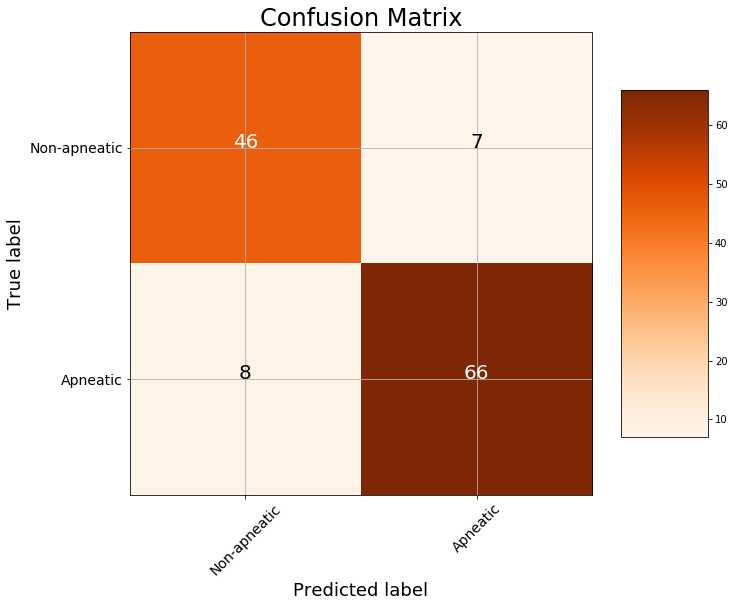

In [89]:
plot_confusion_matrix(cm, classes = ['Non-apneatic', 'Apneatic'], normalize=False, title = 'Confusion Matrix')